<a href="https://colab.research.google.com/github/pp23441/Indian-Classical-Music-Analysis/blob/main/Classifying_Ragas_in_Indian_Classical_Music_using_Neural_Network_Models_Pruthvi_2311349.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
pip install -q visualkeras

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 993.8/993.8 kB 13.1 MB/s eta 0:00:00


In [2]:
pip install scikit-plot

In [3]:
pip install SpeechRecognition pydub


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 32.8/32.8 MB 80.9 MB/s eta 0:00:00


In [4]:
pip install pydub

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
# libraries

# Data preprocessing
import pandas as pd
import numpy as np
import os, librosa
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import cv2

# Visualization
import IPython.display as ipd
import matplotlib.pyplot as plt
import seaborn as sns
from visualkeras import layered_view

# Model
import tensorflow_hub as hub
from tensorflow import keras
from keras.preprocessing.sequence import pad_sequences
from keras.utils import to_categorical
from keras import layers, Sequential
from keras.callbacks import EarlyStopping
from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input

# Suppressing warnings
from warnings import filterwarnings
filterwarnings('ignore')

# Speech recognition
import speech_recognition as sr
from pydub import AudioSegment

In [ ]:
# from pydub import AudioSegment
# from pydub.utils import make_chunks
# import os

# #  the WAV files
# input_directory = "/content/drive/MyDrive/North Indian Music raga by waghmare/Split_Raga_30Sec/yaman_Raga_30Sec"
# output_directory = "/content/drive/MyDrive/North Indian Music raga by waghmare"

# # shape or resize the chunk length in milliseconds (e.g., 1 minute = 60000 ms)
# chunk_length_ms = 3000  # 30 seconds

# os.makedirs(output_directory, exist_ok=True)

# # Process each WAV file in the directory
# for filename in os.listdir(input_directory):
#     if filename.endswith(".wav"):
#         file_path = os.path.join(input_directory, filename)
#         audio = AudioSegment.from_wav(file_path)

#         # chunks of the audio
#         chunks = make_chunks(audio, chunk_length_ms)

#         # all the chunks as separate files
#         for i, chunk in enumerate(chunks):
#             chunk_name = f"{filename[:-4]}_chunk{i+1}.wav"  # Remove '.wav' from filename
#             chunk_path = os.path.join(output_directory, chunk_name)
#             print(f"Exporting {chunk_path}")
#             chunk.export(chunk_path, format="wav")

Exporting /content/drive/MyDrive/North Indian Music raga by waghmare/yaman02_chunk1_chunk1.wav
Exporting /content/drive/MyDrive/North Indian Music raga by waghmare/yaman02_chunk1_chunk2.wav
Exporting /content/drive/MyDrive/North Indian Music raga by waghmare/yaman02_chunk1_chunk3.wav
Exporting /content/drive/MyDrive/North Indian Music raga by waghmare/yaman02_chunk1_chunk4.wav
Exporting /content/drive/MyDrive/North Indian Music raga by waghmare/yaman02_chunk1_chunk5.wav
Exporting /content/drive/MyDrive/North Indian Music raga by waghmare/yaman02_chunk1_chunk6.wav
Exporting /content/drive/MyDrive/North Indian Music raga by waghmare/yaman02_chunk1_chunk7.wav
Exporting /content/drive/MyDrive/North Indian Music raga by waghmare/yaman02_chunk1_chunk8.wav
Exporting /content/drive/MyDrive/North Indian Music raga by waghmare/yaman02_chunk1_chunk9.wav
Exporting /content/drive/MyDrive/North Indian Music raga by waghmare/yaman02_chunk1_chunk10.wav
Exporting /content/drive/MyDrive/North Indian Mus

Tonic Frequency for Bhairavi01_chunk1_chunk1.wav: 1040.845703125 Hz
Detected Notes for Bhairavi01_chunk1_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa']


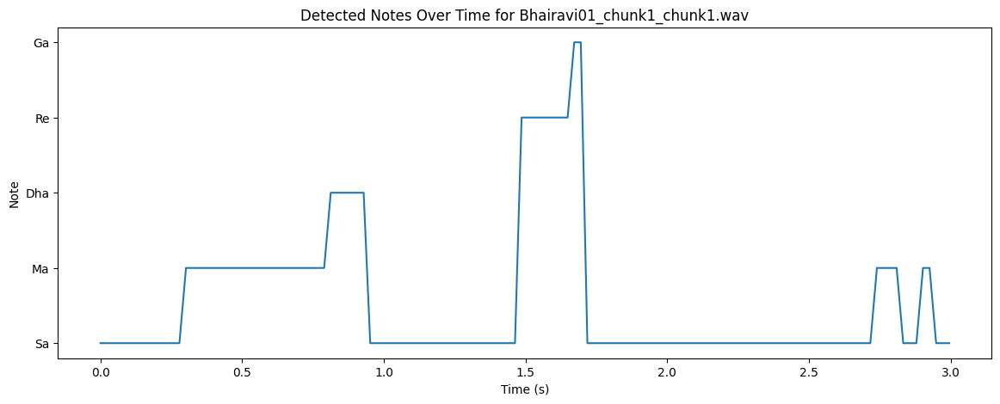

Tonic Frequency for Bhairavi01_chunk1_chunk2.wav: 1079.797607421875 Hz
Detected Notes for Bhairavi01_chunk1_chunk2.wav:  ['Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ga', 'Ga', 'Ga', 'Ma', 'Ma', 'Ma', 'Ma', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


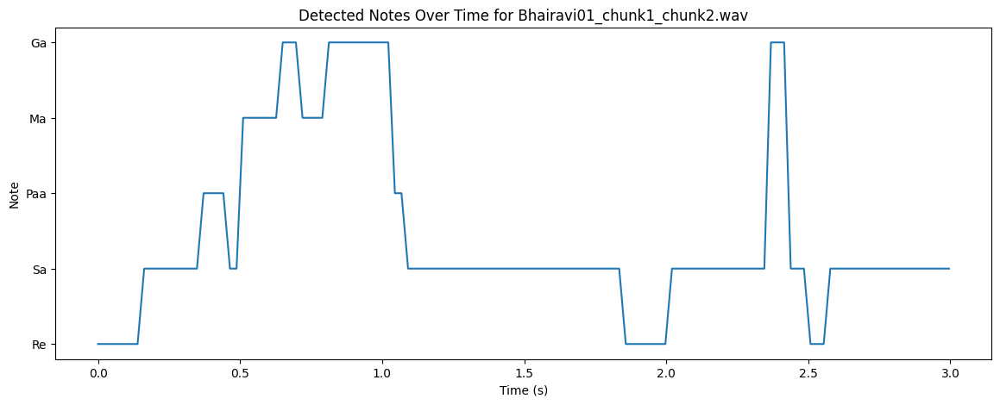

Tonic Frequency for Bhairavi01_chunk1_chunk3.wav: 1139.393798828125 Hz
Detected Notes for Bhairavi01_chunk1_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Re', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re']


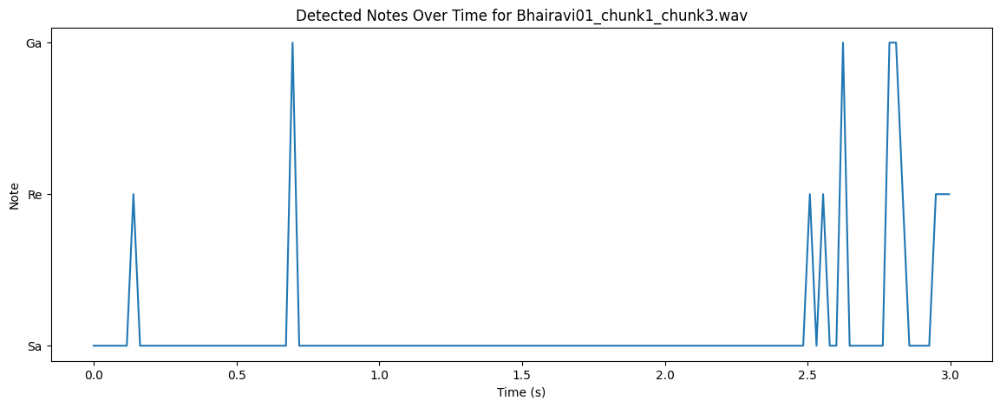

Tonic Frequency for Bhairavi01_chunk1_chunk4.wav: 1105.7803955078125 Hz
Detected Notes for Bhairavi01_chunk1_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Ga', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa']


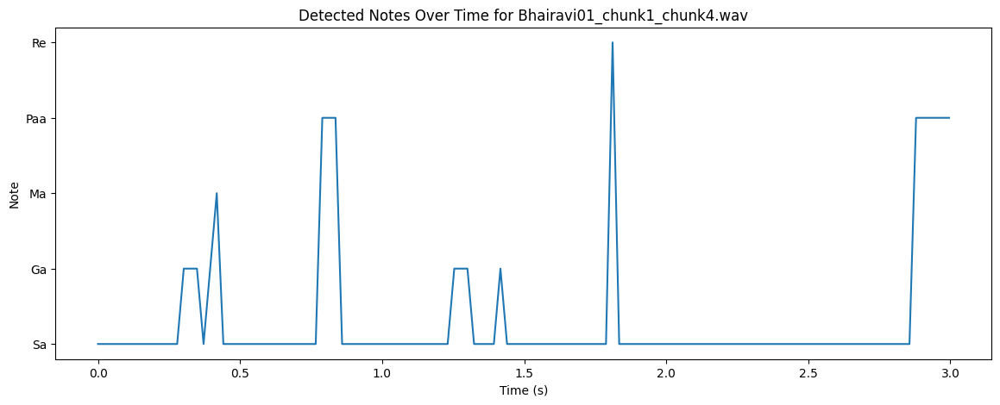

Tonic Frequency for Bhairavi01_chunk1_chunk5.wav: 1040.1875 Hz
Detected Notes for Bhairavi01_chunk1_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa']


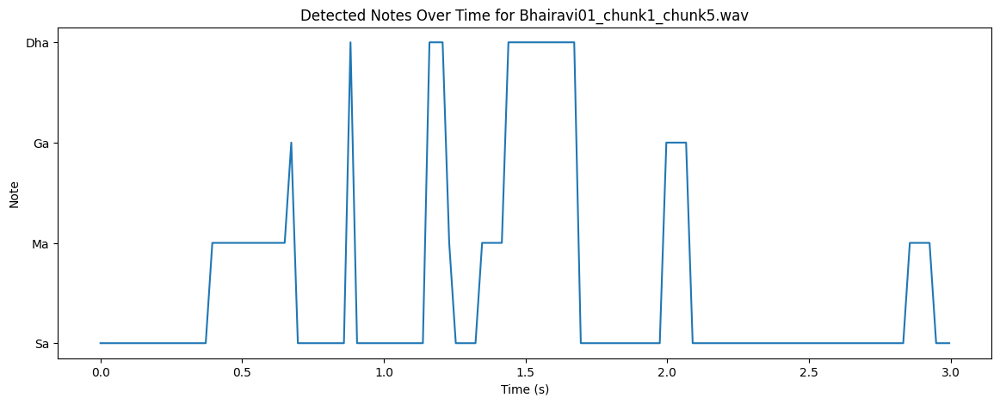

Tonic Frequency for Bhairavi01_chunk1_chunk6.wav: 1128.520263671875 Hz
Detected Notes for Bhairavi01_chunk1_chunk6.wav:  ['Re', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ma', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


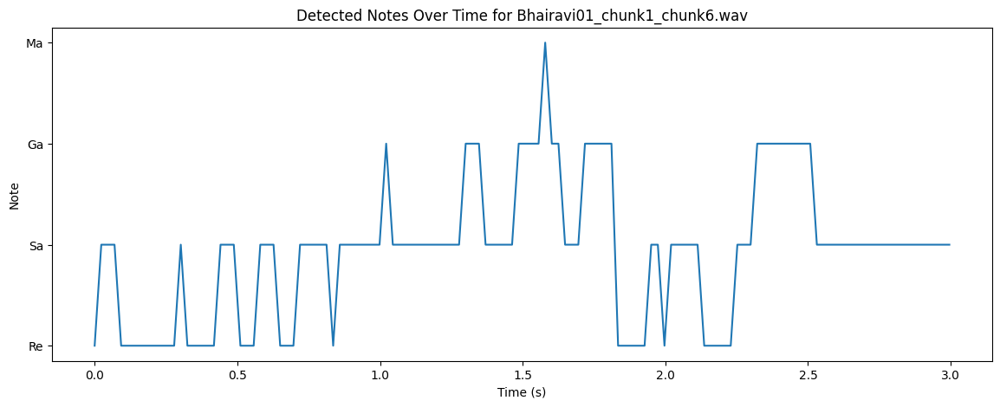

Tonic Frequency for Bhairavi01_chunk1_chunk7.wav: 1143.8160400390625 Hz
Detected Notes for Bhairavi01_chunk1_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


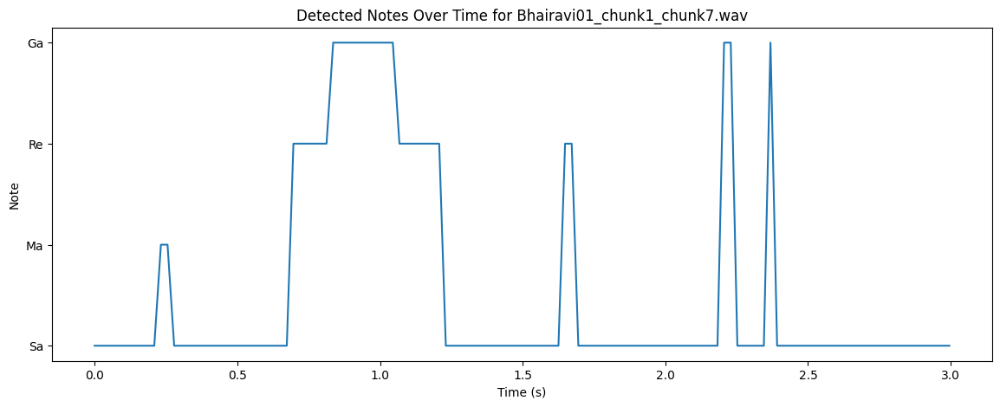

Tonic Frequency for Bhairavi01_chunk1_chunk8.wav: 1040.274658203125 Hz
Detected Notes for Bhairavi01_chunk1_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


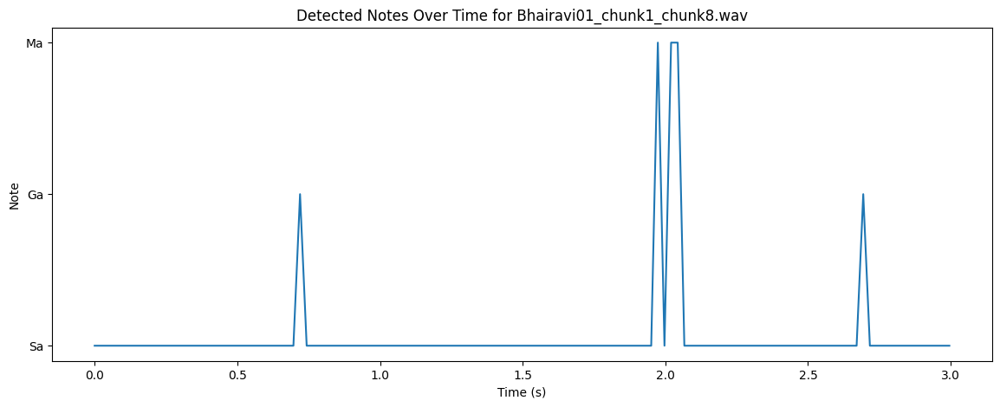

Tonic Frequency for Bhairavi01_chunk1_chunk9.wav: 1040.0660400390625 Hz
Detected Notes for Bhairavi01_chunk1_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa']


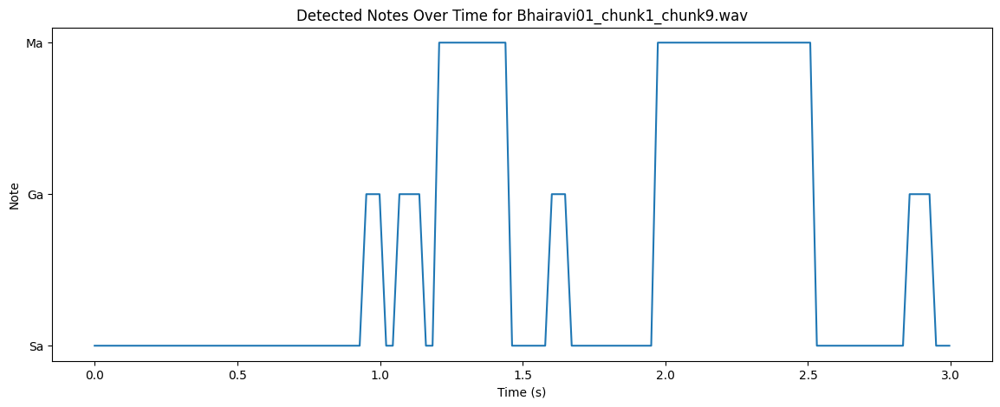

Tonic Frequency for Bhairavi01_chunk1_chunk10.wav: 1183.2867431640625 Hz
Detected Notes for Bhairavi01_chunk1_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


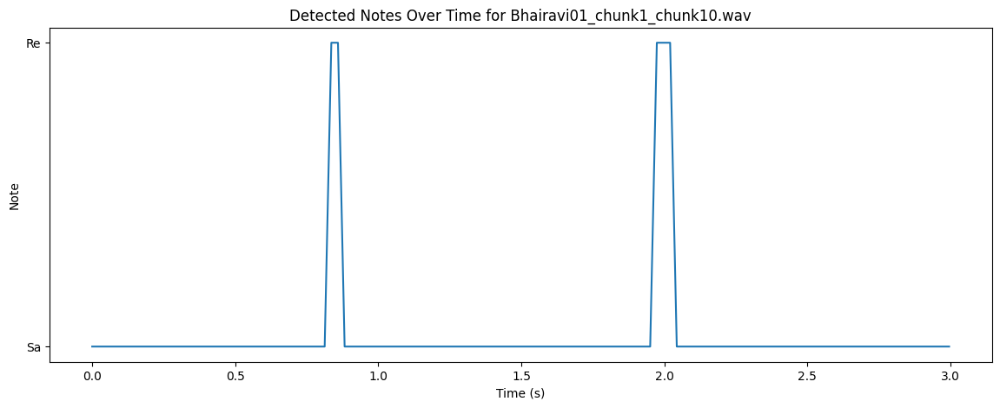

Tonic Frequency for Bhairavi01_chunk2_chunk1.wav: 972.1177978515625 Hz
Detected Notes for Bhairavi01_chunk2_chunk1.wav:  ['Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


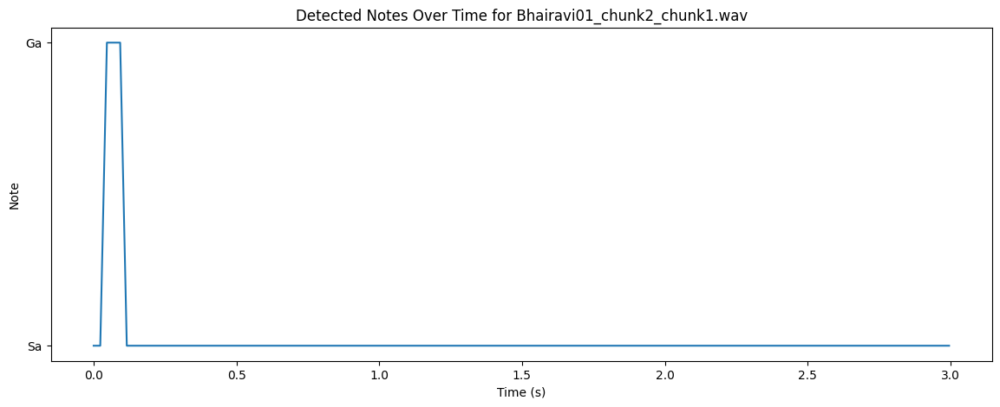

Tonic Frequency for Bhairavi01_chunk2_chunk2.wav: 1226.7625732421875 Hz
Detected Notes for Bhairavi01_chunk2_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Re', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re']


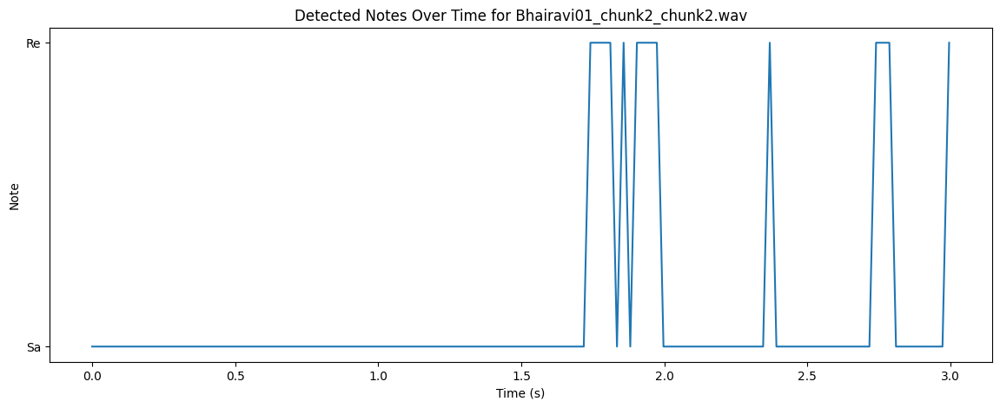

Tonic Frequency for Bhairavi01_chunk2_chunk3.wav: 1041.403076171875 Hz
Detected Notes for Bhairavi01_chunk2_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Ga', 'Ga', 'Ga', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma']


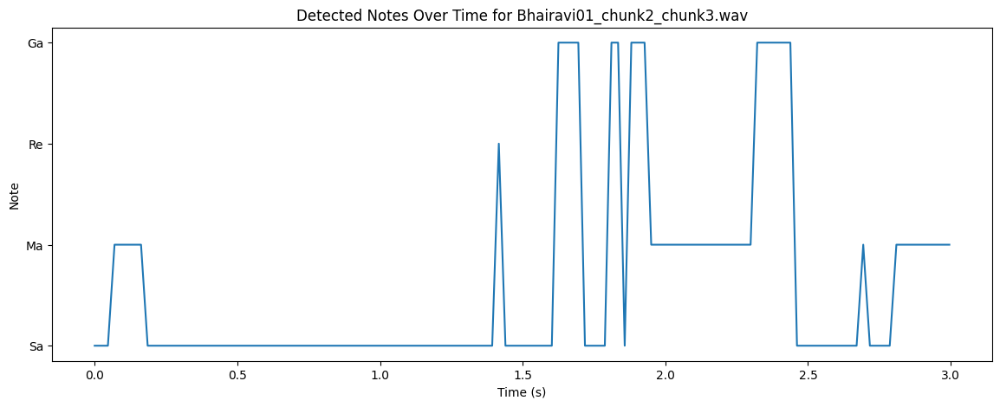

Tonic Frequency for Bhairavi01_chunk2_chunk4.wav: 1109.825927734375 Hz
Detected Notes for Bhairavi01_chunk2_chunk4.wav:  ['Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


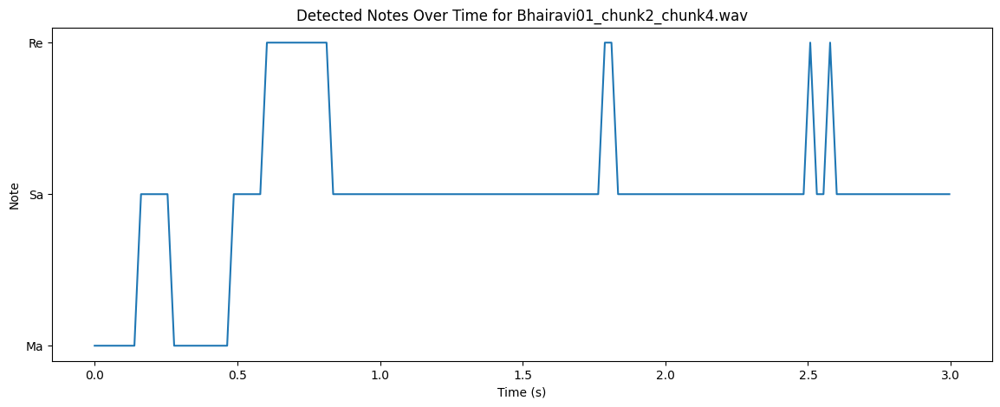

Tonic Frequency for Bhairavi01_chunk2_chunk5.wav: 1042.70703125 Hz
Detected Notes for Bhairavi01_chunk2_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa']


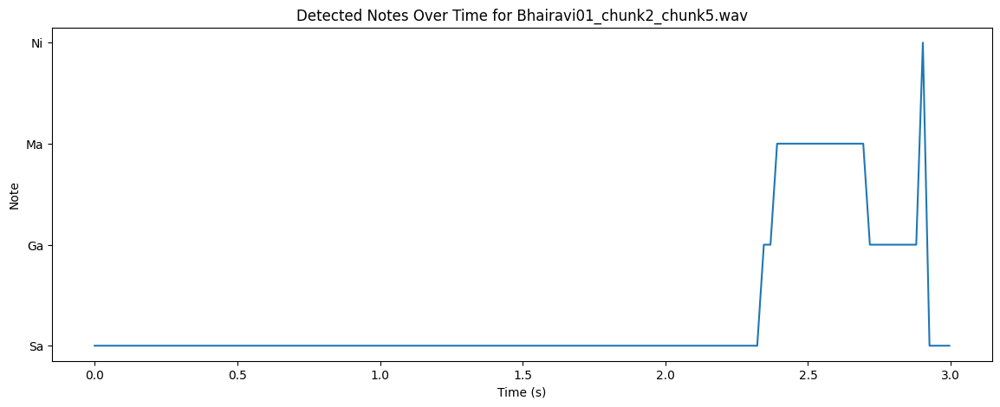

Tonic Frequency for Bhairavi01_chunk2_chunk6.wav: 1039.54931640625 Hz
Detected Notes for Bhairavi01_chunk2_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


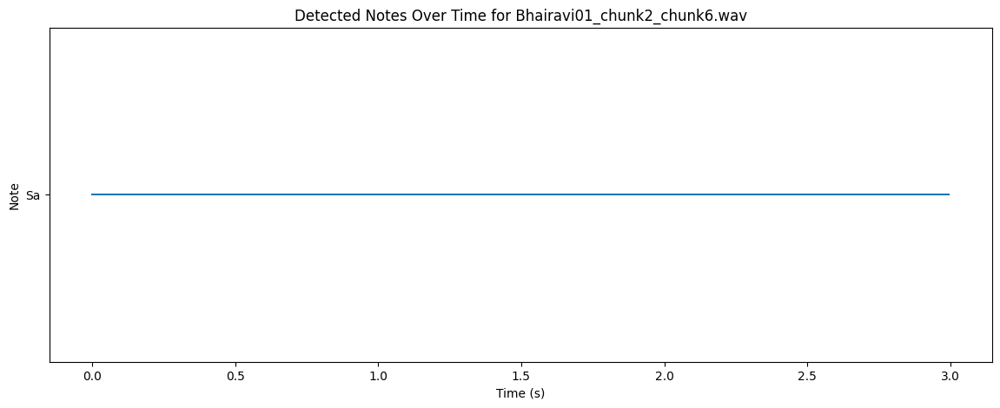

Tonic Frequency for Bhairavi01_chunk2_chunk7.wav: 1039.1611328125 Hz
Detected Notes for Bhairavi01_chunk2_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Ma', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma']


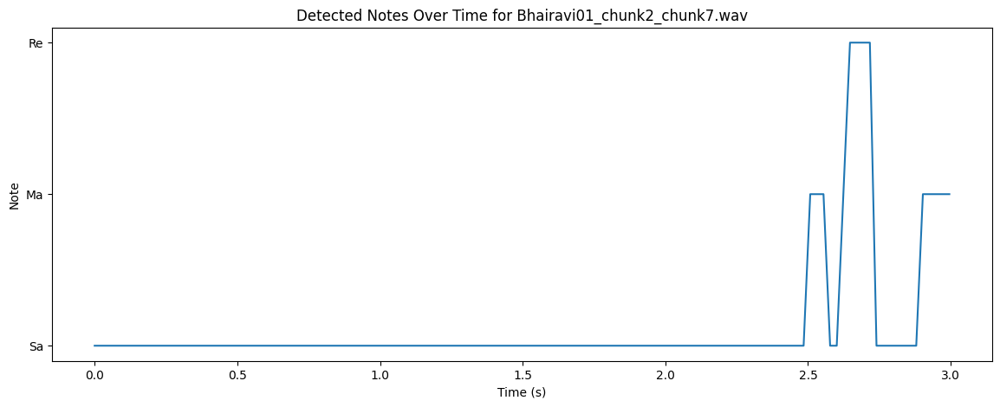

Tonic Frequency for Bhairavi01_chunk2_chunk8.wav: 1110.0201416015625 Hz
Detected Notes for Bhairavi01_chunk2_chunk8.wav:  ['Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ga']


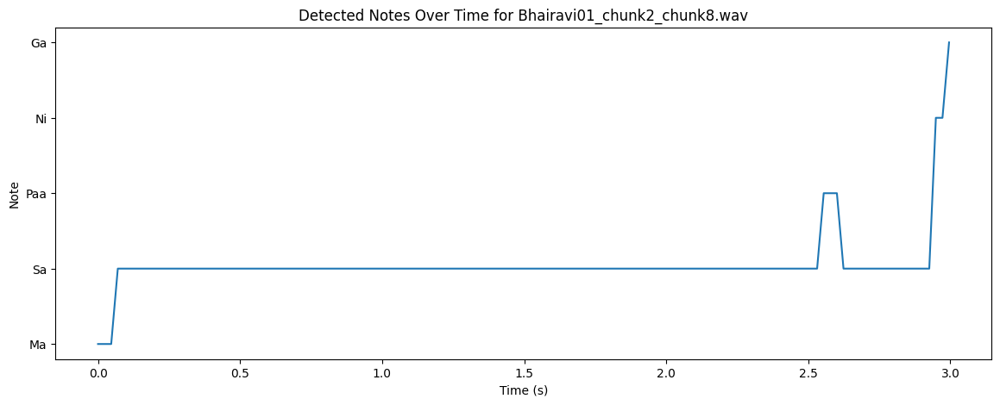

Tonic Frequency for Bhairavi01_chunk2_chunk9.wav: 1019.1536865234375 Hz
Detected Notes for Bhairavi01_chunk2_chunk9.wav:  ['Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


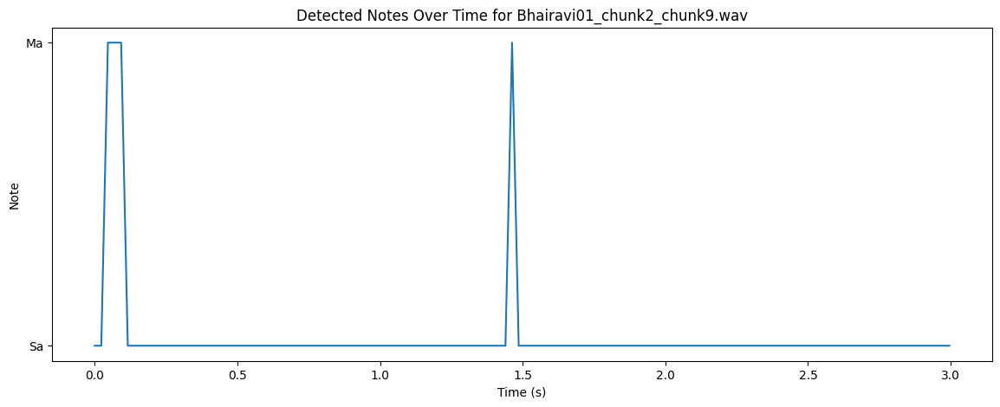

Tonic Frequency for Bhairavi01_chunk2_chunk10.wav: 1102.1558837890625 Hz
Detected Notes for Bhairavi01_chunk2_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma']


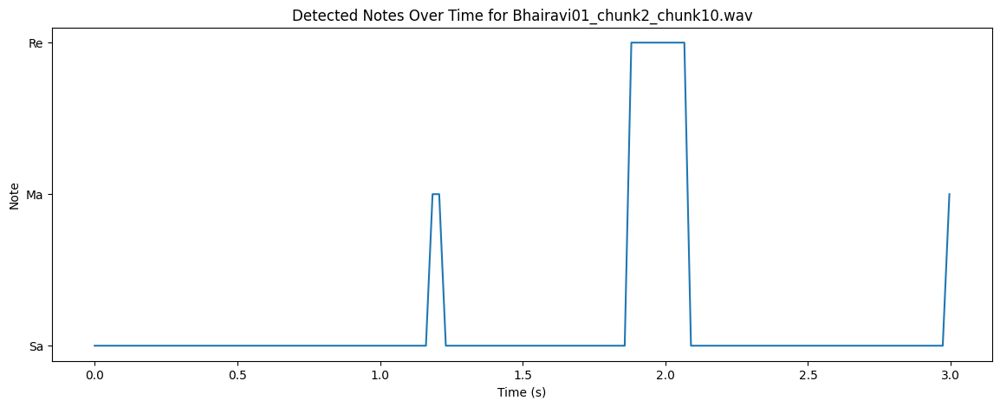

Tonic Frequency for Bhairavi01_chunk3_chunk1.wav: 1138.0943603515625 Hz
Detected Notes for Bhairavi01_chunk3_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa']


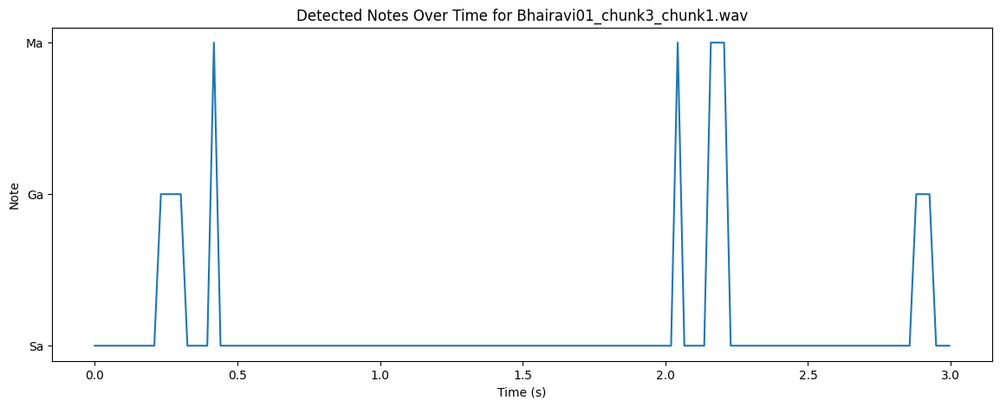

Tonic Frequency for Bhairavi01_chunk3_chunk2.wav: 1149.0074462890625 Hz
Detected Notes for Bhairavi01_chunk3_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


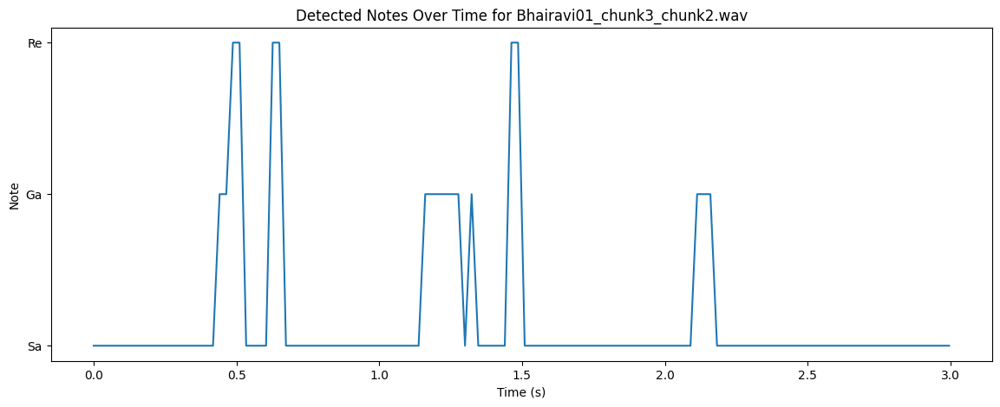

Tonic Frequency for Bhairavi01_chunk3_chunk3.wav: 1041.4981689453125 Hz
Detected Notes for Bhairavi01_chunk3_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Ma', 'Ma', 'Ma', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


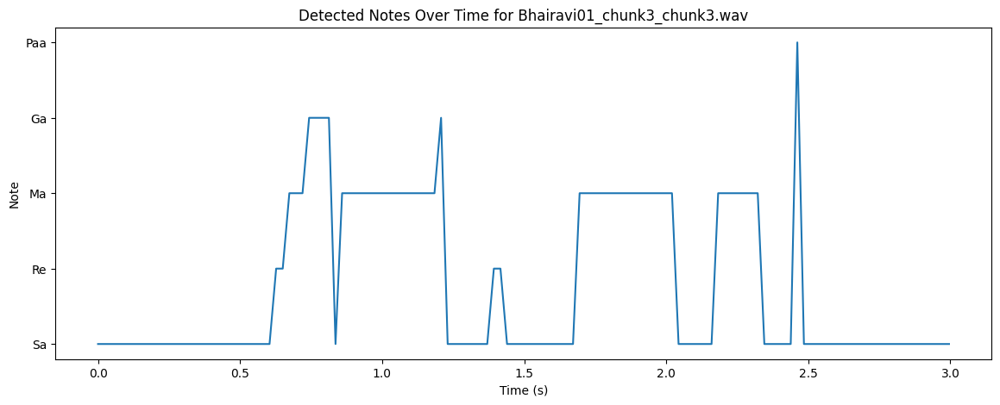

Tonic Frequency for Bhairavi01_chunk3_chunk4.wav: 1205.267578125 Hz
Detected Notes for Bhairavi01_chunk3_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Ga', 'Ga', 'Ga', 'Re', 'Re', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


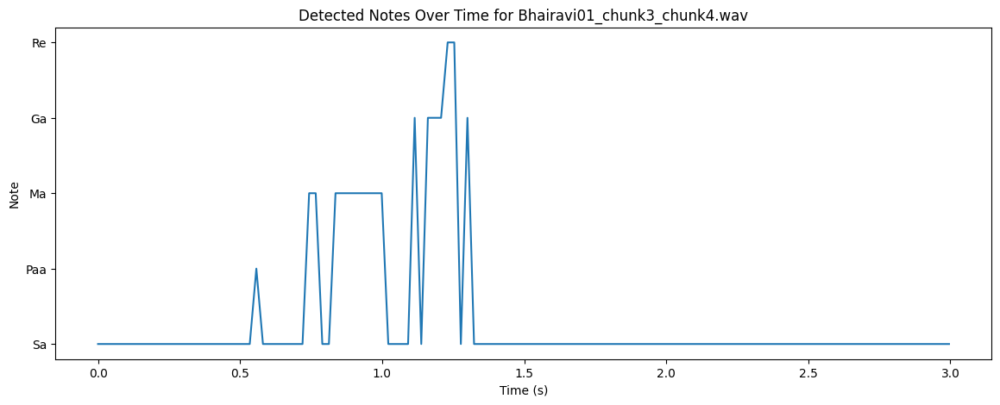

Tonic Frequency for Bhairavi01_chunk3_chunk5.wav: 832.5054931640625 Hz
Detected Notes for Bhairavi01_chunk3_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


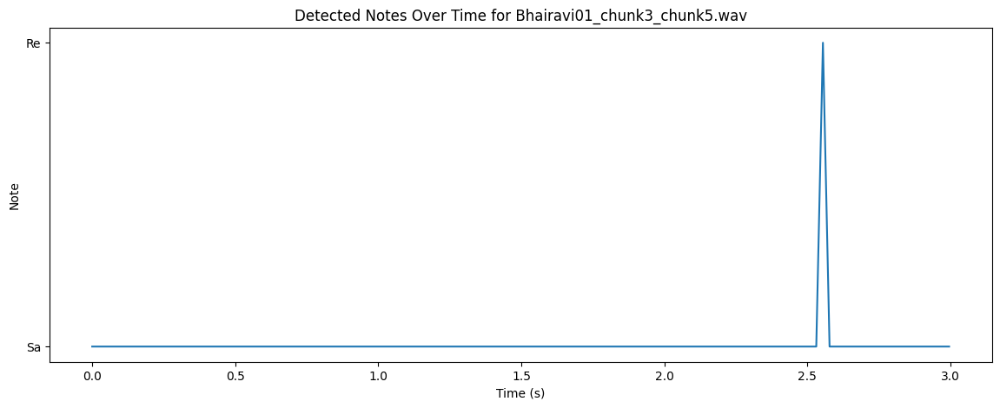

Tonic Frequency for Bhairavi01_chunk3_chunk6.wav: 964.593017578125 Hz
Detected Notes for Bhairavi01_chunk3_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


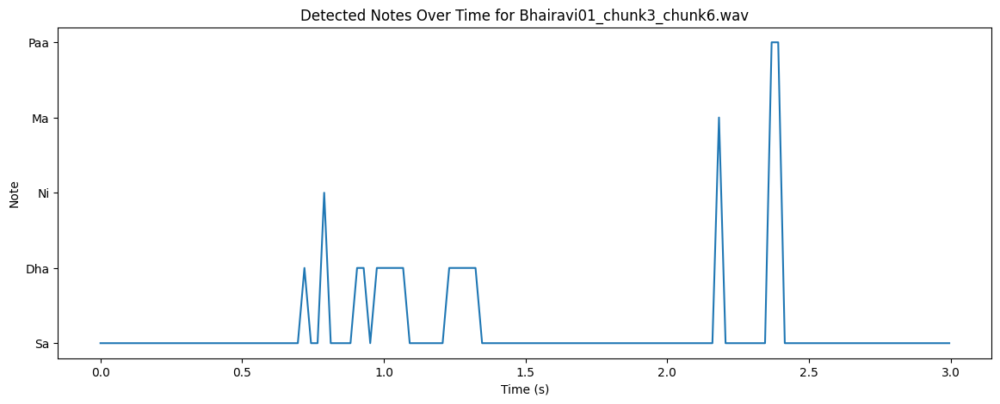

Tonic Frequency for Bhairavi01_chunk3_chunk7.wav: 934.3787841796875 Hz
Detected Notes for Bhairavi01_chunk3_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


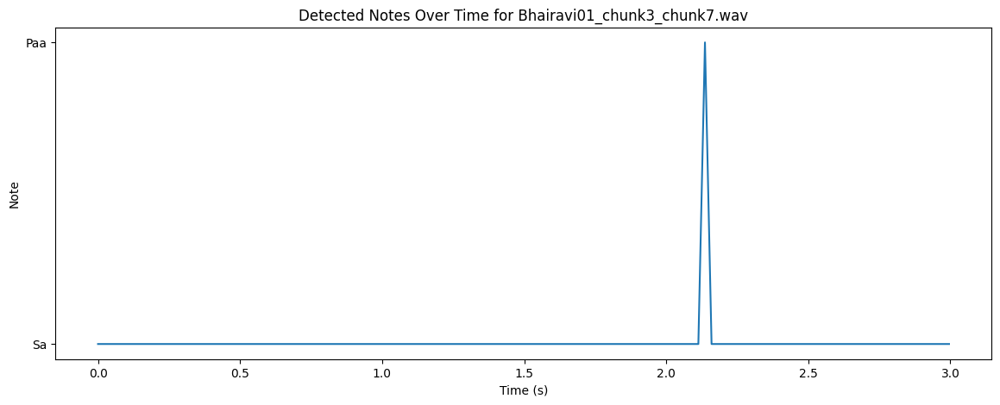

Tonic Frequency for Bhairavi01_chunk3_chunk8.wav: 970.3723754882812 Hz
Detected Notes for Bhairavi01_chunk3_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Paa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Paa', 'Paa', 'Paa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


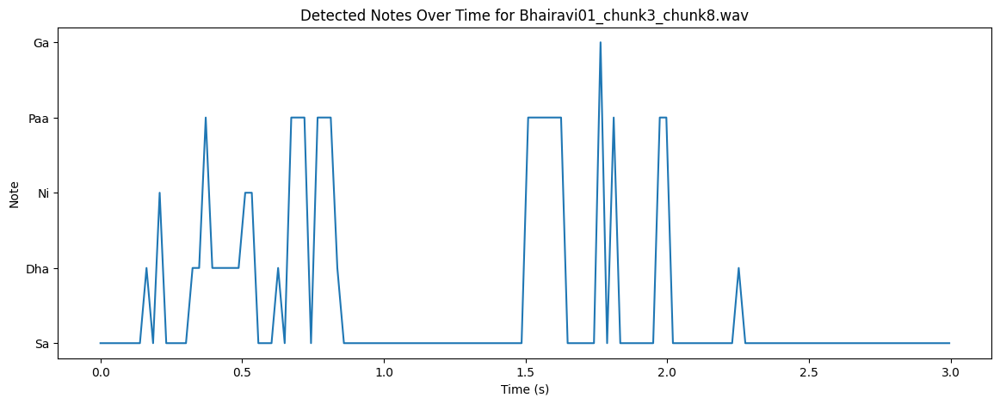

Tonic Frequency for Bhairavi01_chunk3_chunk9.wav: 937.4476318359375 Hz
Detected Notes for Bhairavi01_chunk3_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


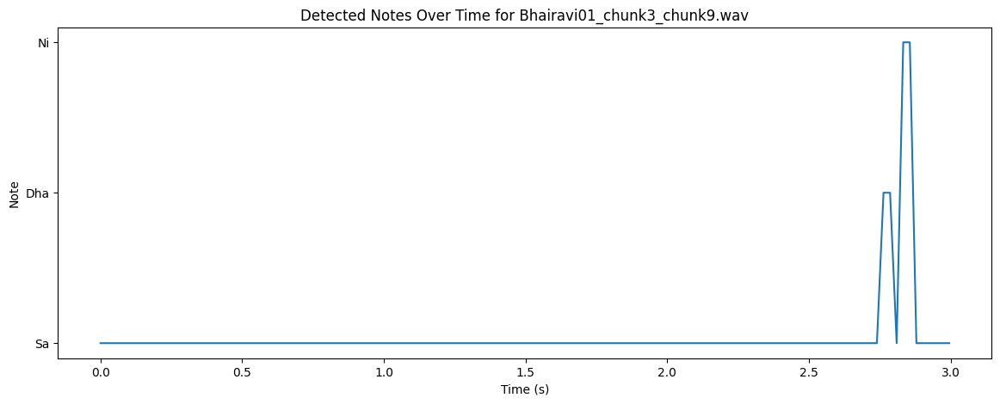

Tonic Frequency for Bhairavi01_chunk3_chunk10.wav: 835.6009521484375 Hz
Detected Notes for Bhairavi01_chunk3_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


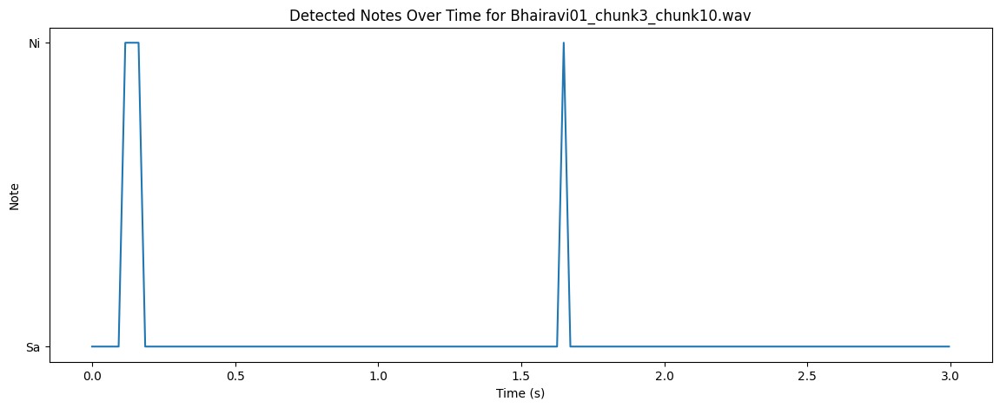

Tonic Frequency for Bhairavi01_chunk4_chunk1.wav: 864.080078125 Hz
Detected Notes for Bhairavi01_chunk4_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


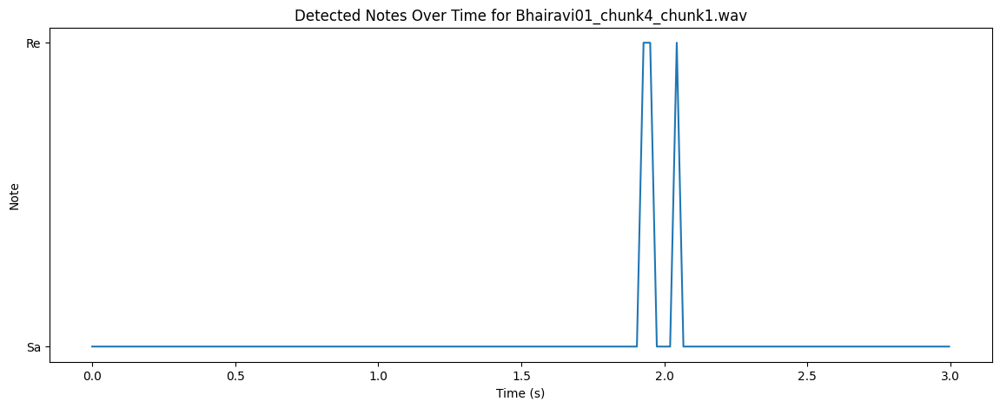

Tonic Frequency for Bhairavi01_chunk4_chunk2.wav: 838.0828857421875 Hz
Detected Notes for Bhairavi01_chunk4_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


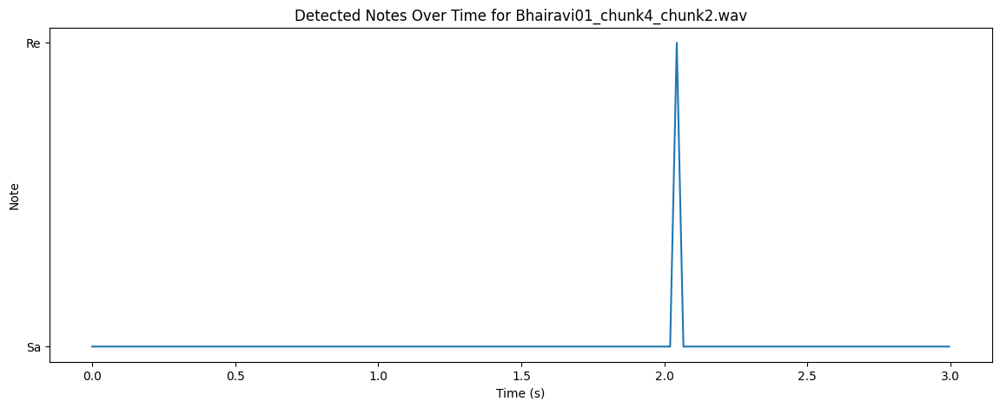

Tonic Frequency for Bhairavi01_chunk4_chunk3.wav: 900.1134643554688 Hz
Detected Notes for Bhairavi01_chunk4_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


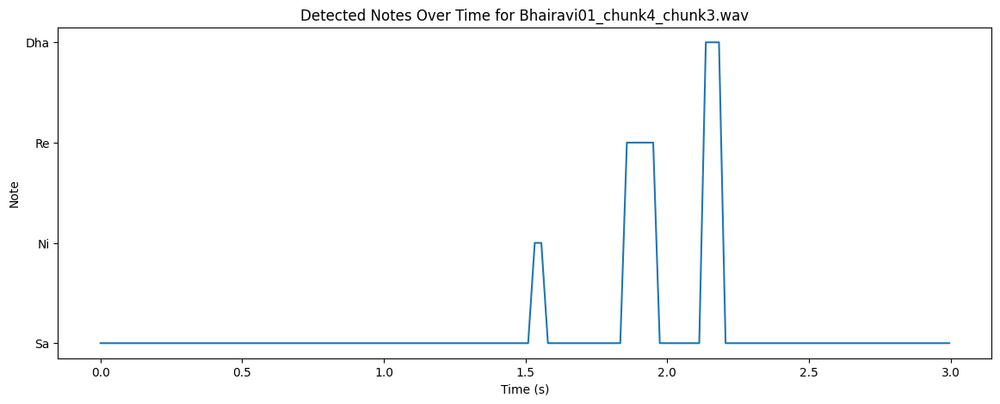

Tonic Frequency for Bhairavi01_chunk4_chunk4.wav: 829.7894287109375 Hz
Detected Notes for Bhairavi01_chunk4_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


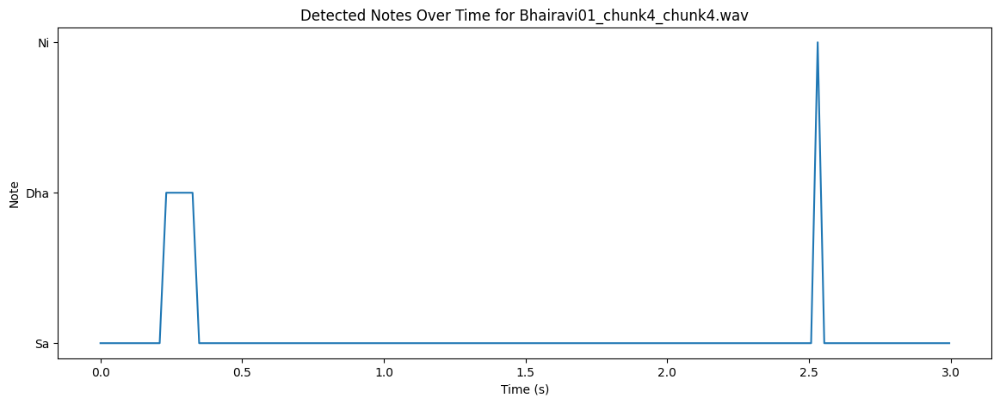

Tonic Frequency for Bhairavi01_chunk4_chunk5.wav: 935.18798828125 Hz
Detected Notes for Bhairavi01_chunk4_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa']


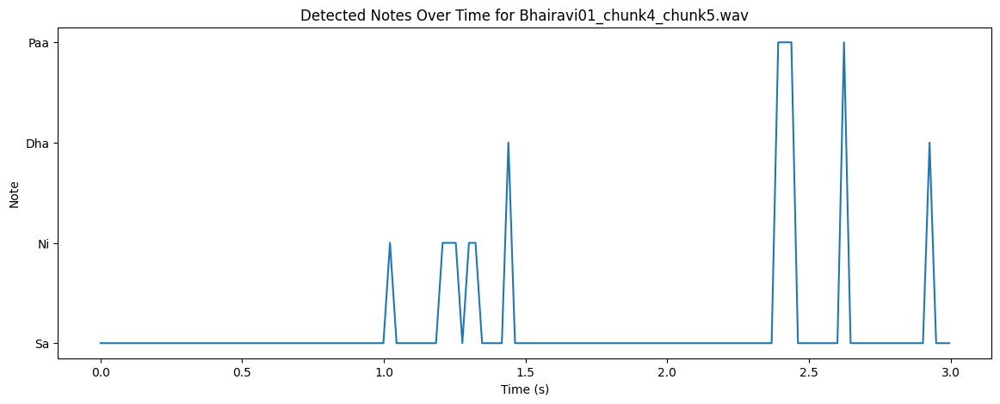

Tonic Frequency for Bhairavi01_chunk4_chunk6.wav: 931.8958129882812 Hz
Detected Notes for Bhairavi01_chunk4_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


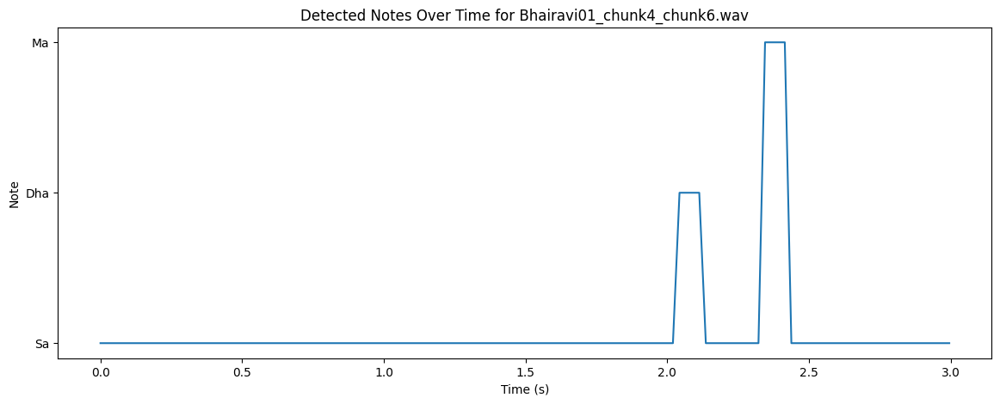

Tonic Frequency for Bhairavi01_chunk4_chunk7.wav: 907.17431640625 Hz
Detected Notes for Bhairavi01_chunk4_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


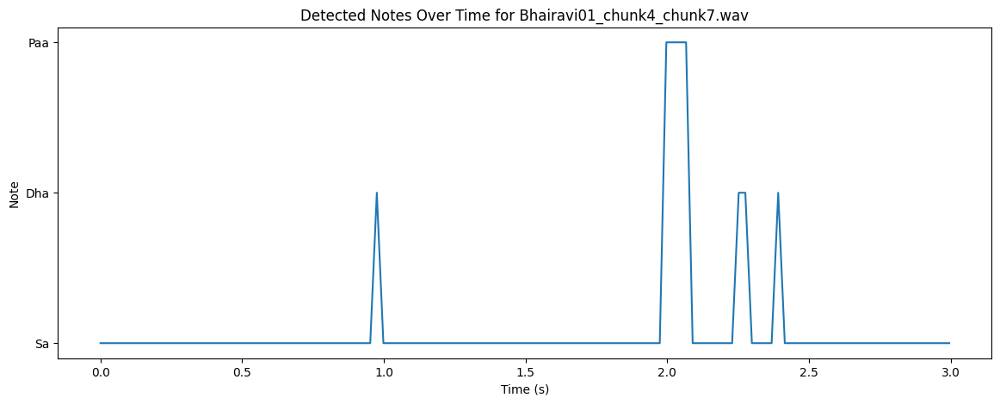

Tonic Frequency for Bhairavi01_chunk4_chunk8.wav: 832.8873291015625 Hz
Detected Notes for Bhairavi01_chunk4_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa']


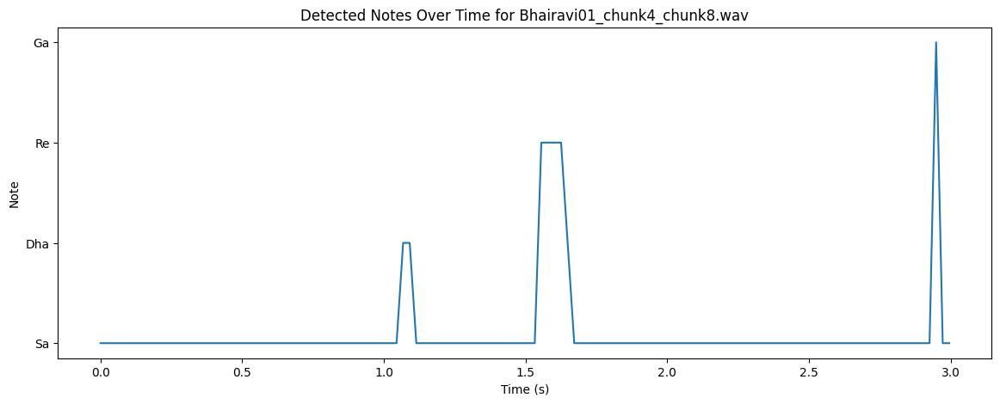

Tonic Frequency for Bhairavi01_chunk4_chunk9.wav: 829.5313720703125 Hz
Detected Notes for Bhairavi01_chunk4_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


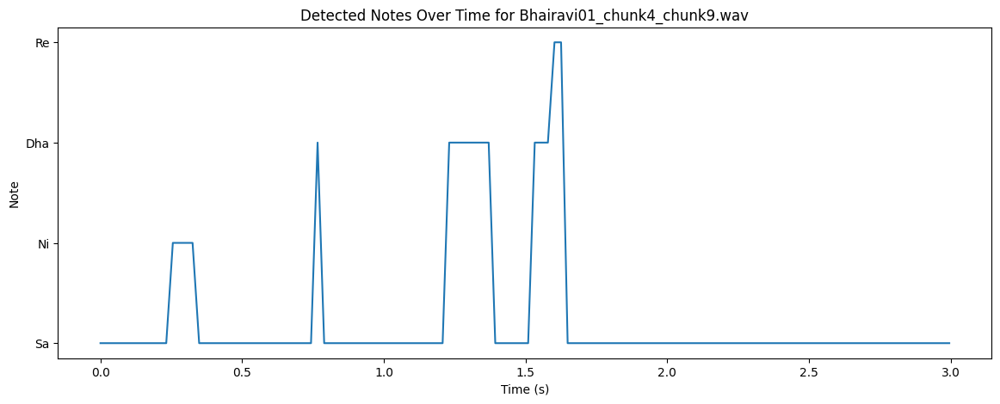

Tonic Frequency for Bhairavi01_chunk4_chunk10.wav: 760.4140625 Hz
Detected Notes for Bhairavi01_chunk4_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ga', 'Ga', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


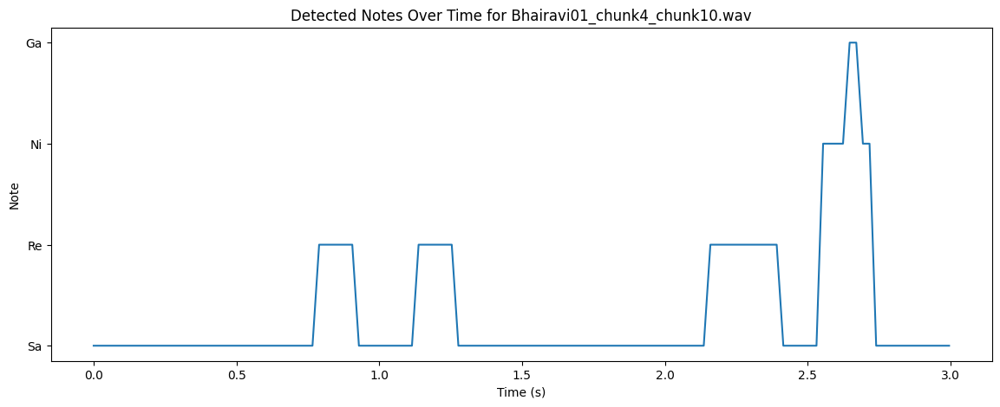

Tonic Frequency for Bhairavi01_chunk5_chunk1.wav: 933.9773559570312 Hz
Detected Notes for Bhairavi01_chunk5_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


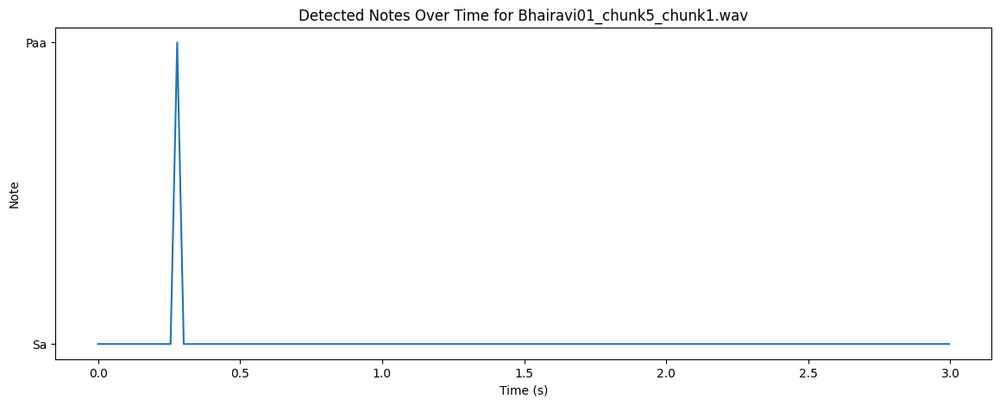

Tonic Frequency for Bhairavi01_chunk5_chunk2.wav: 746.6044921875 Hz
Detected Notes for Bhairavi01_chunk5_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re']


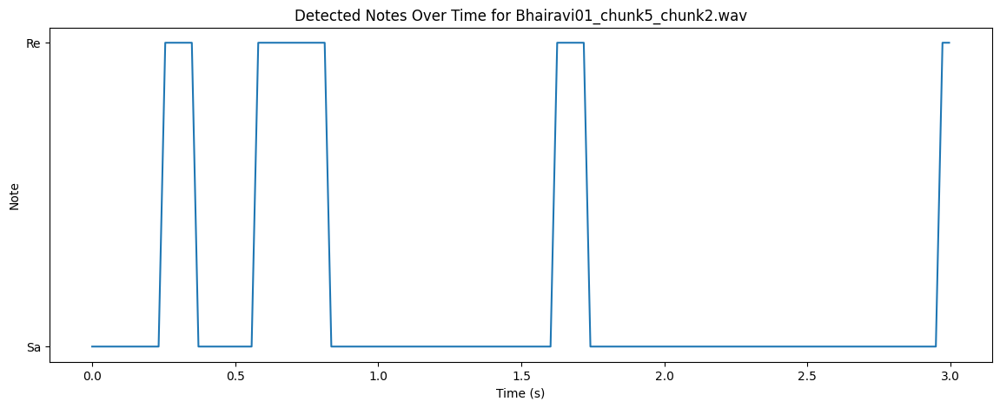

Tonic Frequency for Bhairavi01_chunk5_chunk3.wav: 696.0464477539062 Hz
Detected Notes for Bhairavi01_chunk5_chunk3.wav:  ['Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


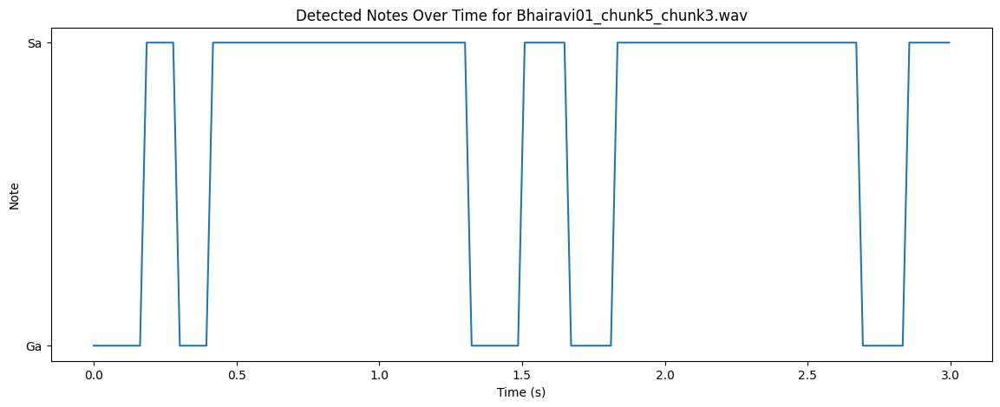

Tonic Frequency for Bhairavi01_chunk5_chunk4.wav: 874.9134521484375 Hz
Detected Notes for Bhairavi01_chunk5_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


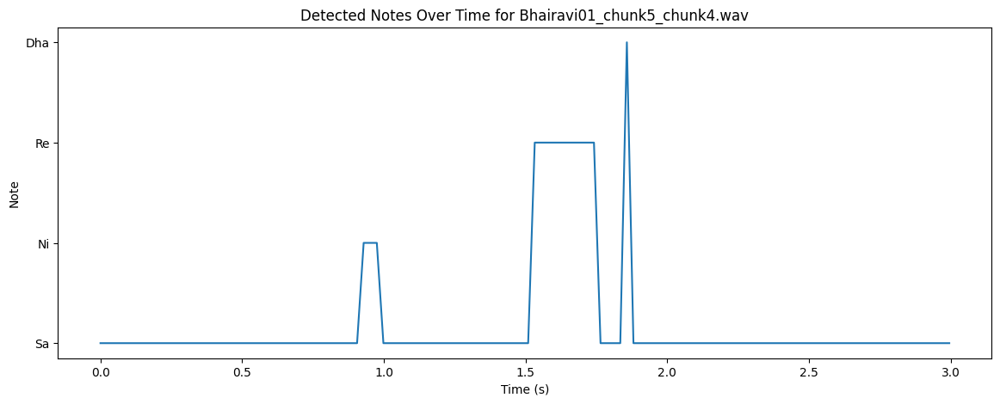

Tonic Frequency for Bhairavi01_chunk5_chunk5.wav: 828.8958129882812 Hz
Detected Notes for Bhairavi01_chunk5_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


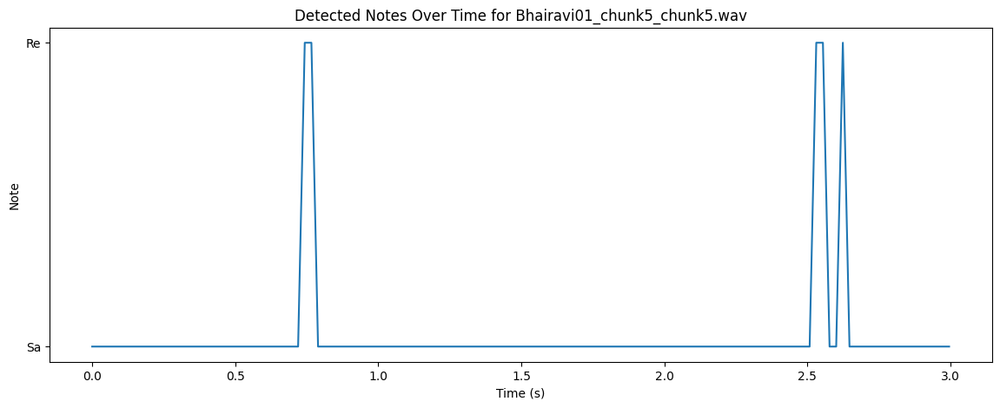

Tonic Frequency for Bhairavi01_chunk5_chunk6.wav: 935.7601318359375 Hz
Detected Notes for Bhairavi01_chunk5_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


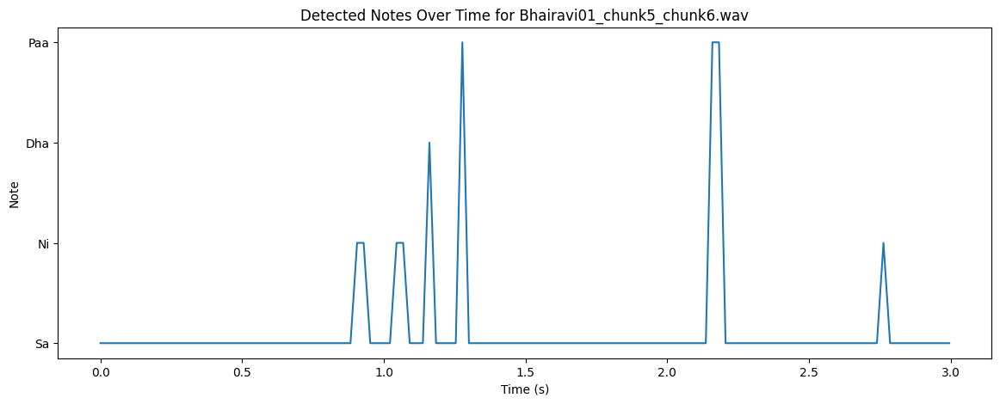

Tonic Frequency for Bhairavi01_chunk5_chunk7.wav: 832.3362426757812 Hz
Detected Notes for Bhairavi01_chunk5_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


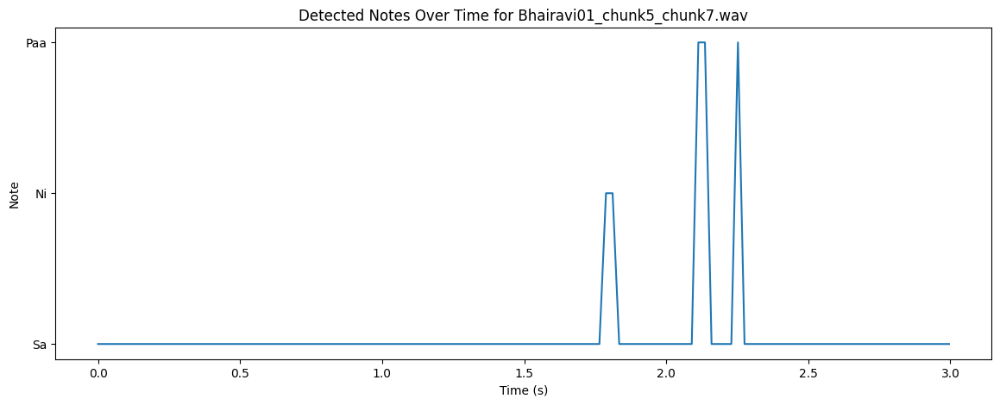

Tonic Frequency for Bhairavi01_chunk5_chunk8.wav: 881.9995727539062 Hz
Detected Notes for Bhairavi01_chunk5_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


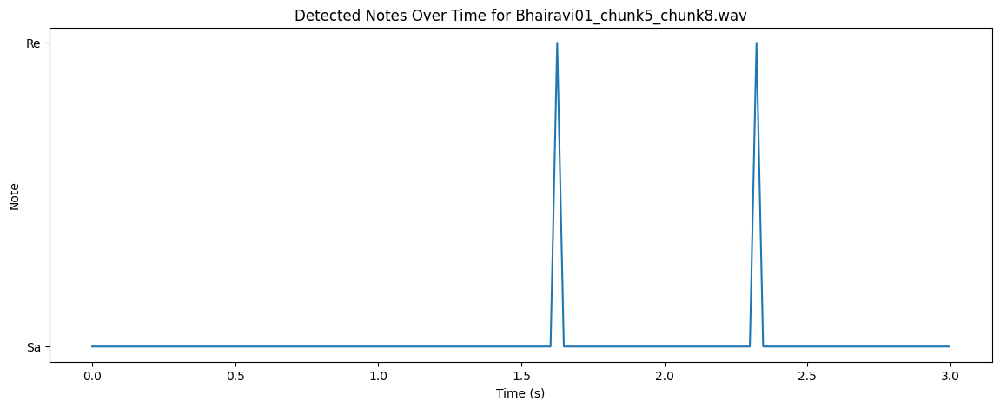

Tonic Frequency for Bhairavi01_chunk5_chunk9.wav: 935.9432373046875 Hz
Detected Notes for Bhairavi01_chunk5_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


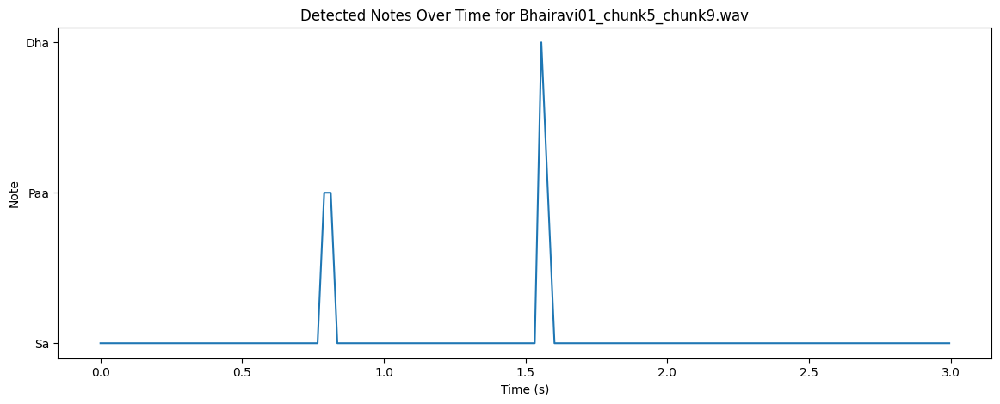

Tonic Frequency for Bhairavi01_chunk5_chunk10.wav: 810.2305908203125 Hz
Detected Notes for Bhairavi01_chunk5_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


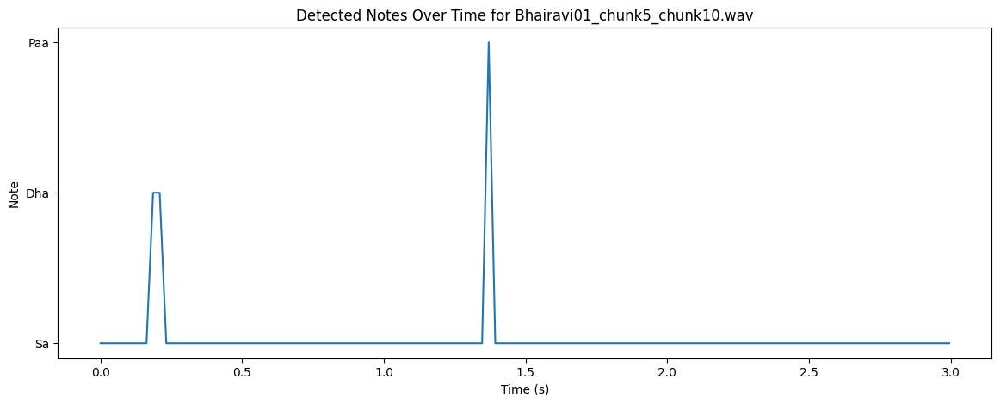

Tonic Frequency for Bhairavi01_chunk6_chunk1.wav: 692.754150390625 Hz
Detected Notes for Bhairavi01_chunk6_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


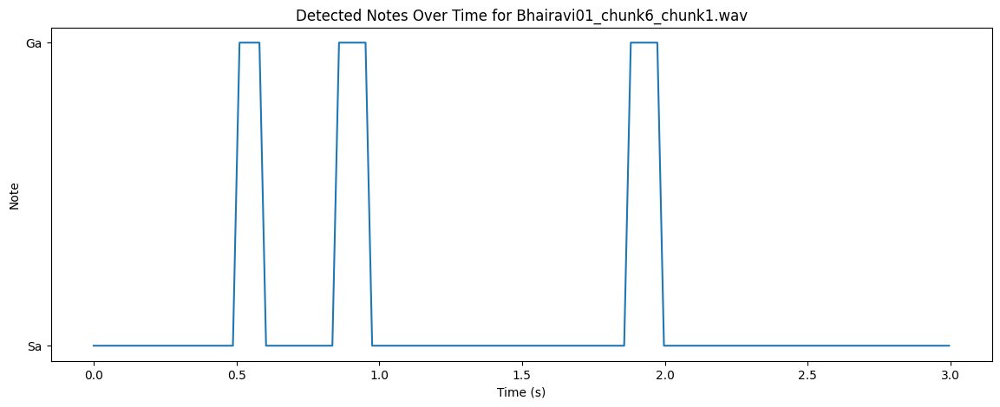

Tonic Frequency for Bhairavi01_chunk6_chunk2.wav: 833.5309448242188 Hz
Detected Notes for Bhairavi01_chunk6_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa']


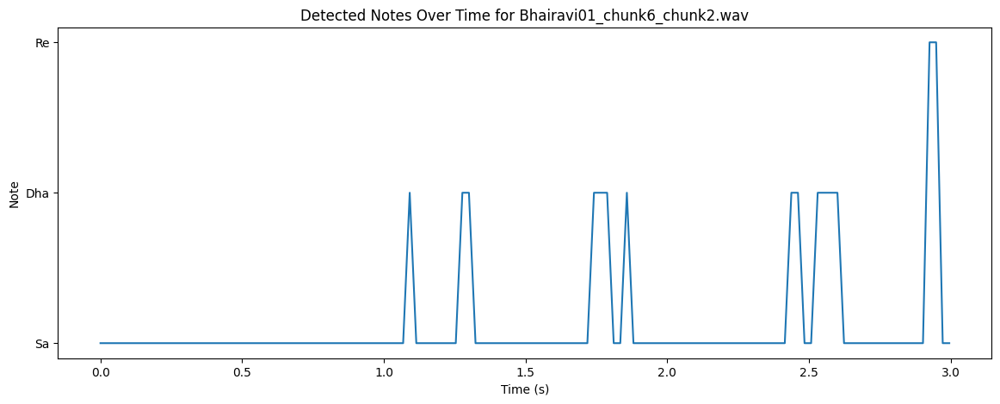

Tonic Frequency for Bhairavi01_chunk6_chunk3.wav: 975.3302001953125 Hz
Detected Notes for Bhairavi01_chunk6_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Dha', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa']


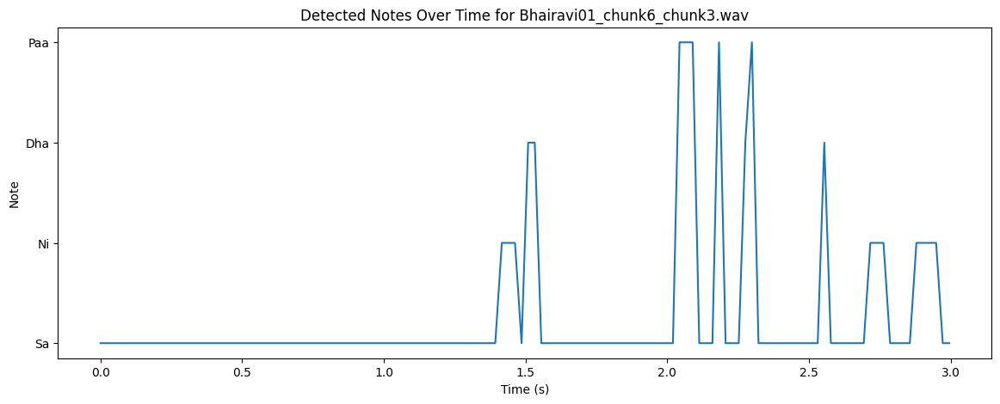

Tonic Frequency for Bhairavi01_chunk6_chunk4.wav: 850.24951171875 Hz
Detected Notes for Bhairavi01_chunk6_chunk4.wav:  ['Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Re', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma']


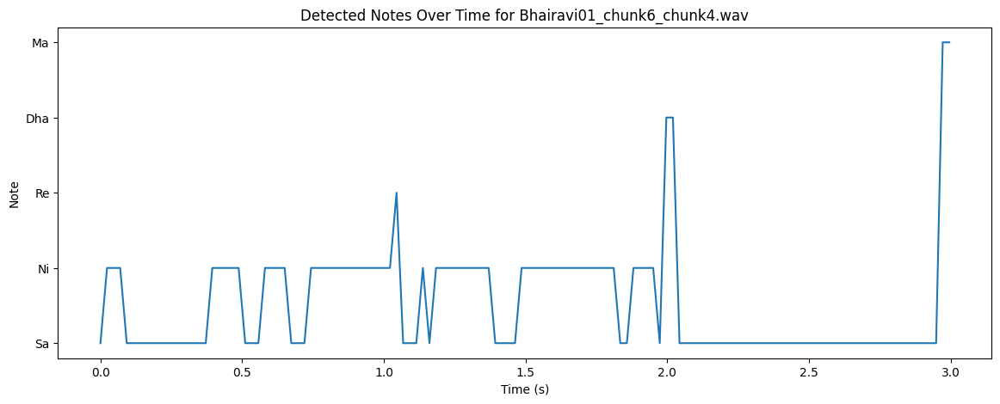

Tonic Frequency for Bhairavi01_chunk6_chunk5.wav: 935.1008911132812 Hz
Detected Notes for Bhairavi01_chunk6_chunk5.wav:  ['Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


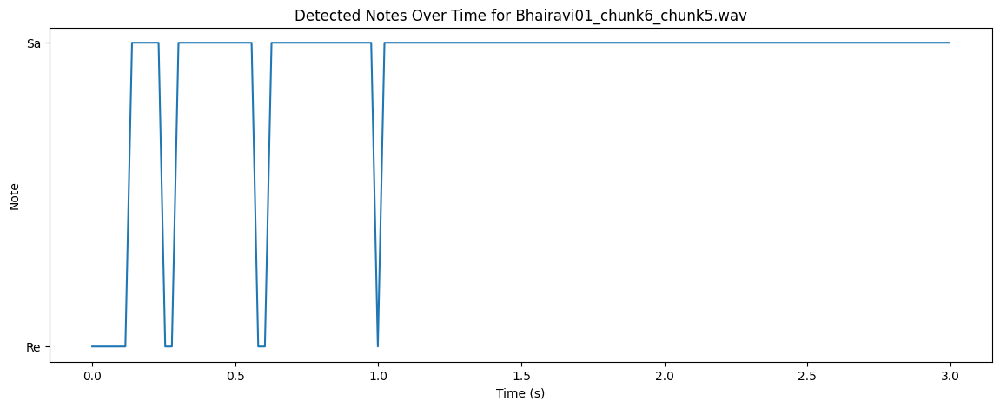

Tonic Frequency for Bhairavi01_chunk6_chunk6.wav: 831.2393798828125 Hz
Detected Notes for Bhairavi01_chunk6_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


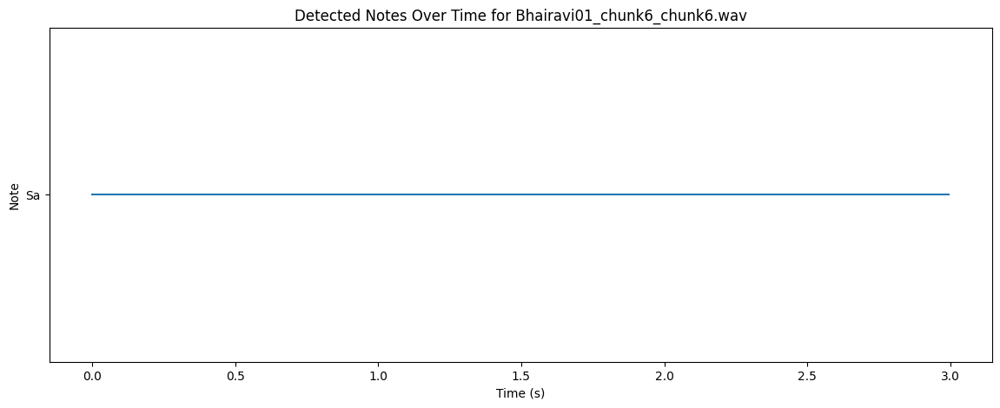

Tonic Frequency for Bhairavi01_chunk6_chunk7.wav: 829.5313720703125 Hz
Detected Notes for Bhairavi01_chunk6_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


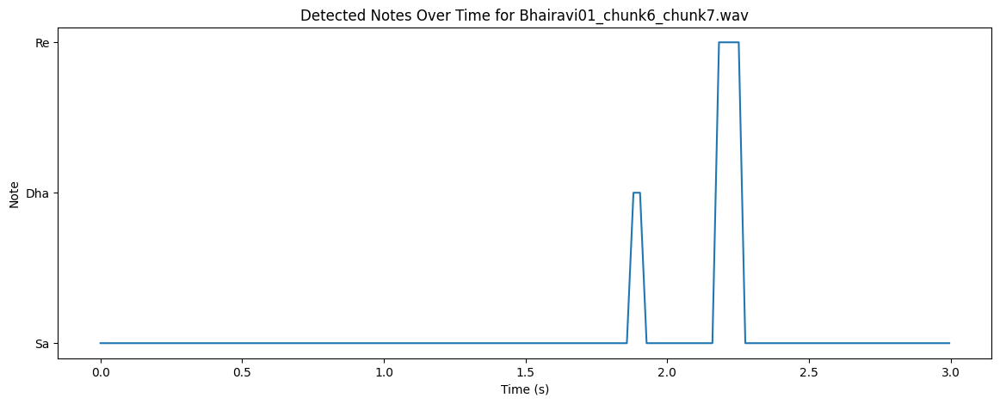

Tonic Frequency for Bhairavi01_chunk6_chunk8.wav: 862.1782836914062 Hz
Detected Notes for Bhairavi01_chunk6_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


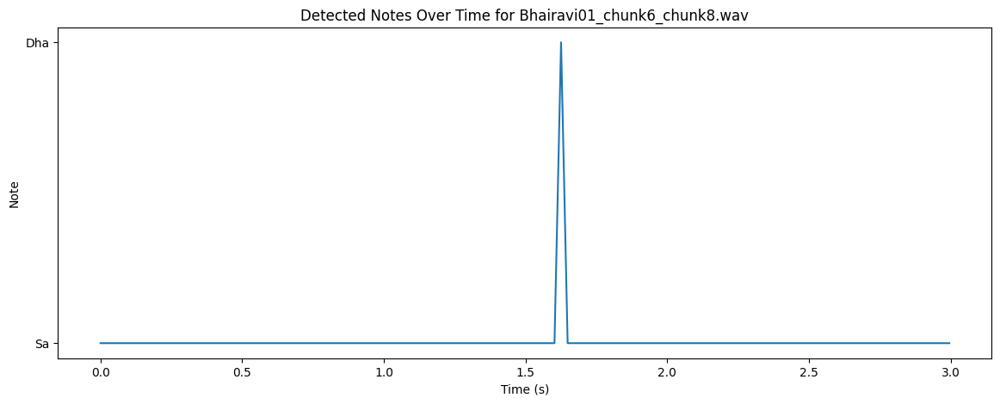

Tonic Frequency for Bhairavi01_chunk6_chunk9.wav: 839.38720703125 Hz
Detected Notes for Bhairavi01_chunk6_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


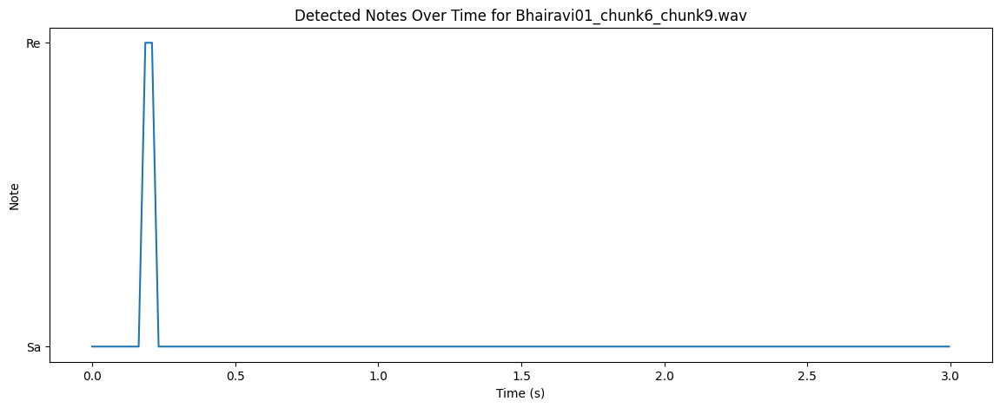

Tonic Frequency for Bhairavi01_chunk6_chunk10.wav: 946.3812255859375 Hz
Detected Notes for Bhairavi01_chunk6_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


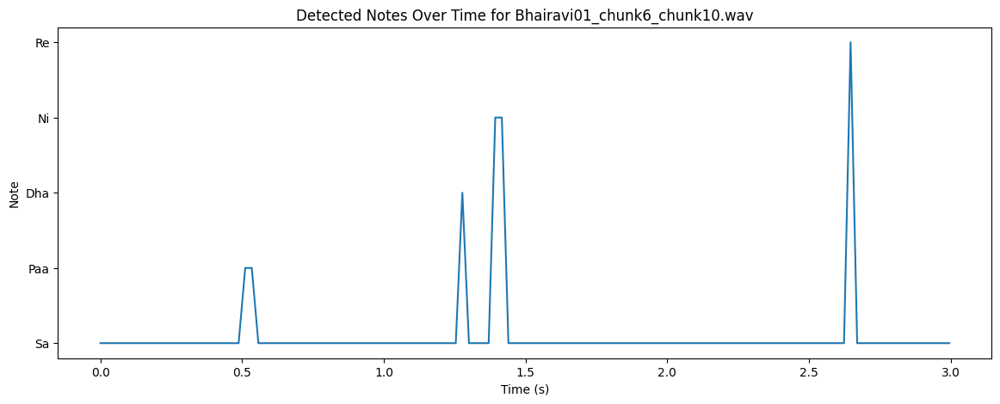

Tonic Frequency for Bhairavi01_chunk7_chunk1.wav: 804.009033203125 Hz
Detected Notes for Bhairavi01_chunk7_chunk1.wav:  ['Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


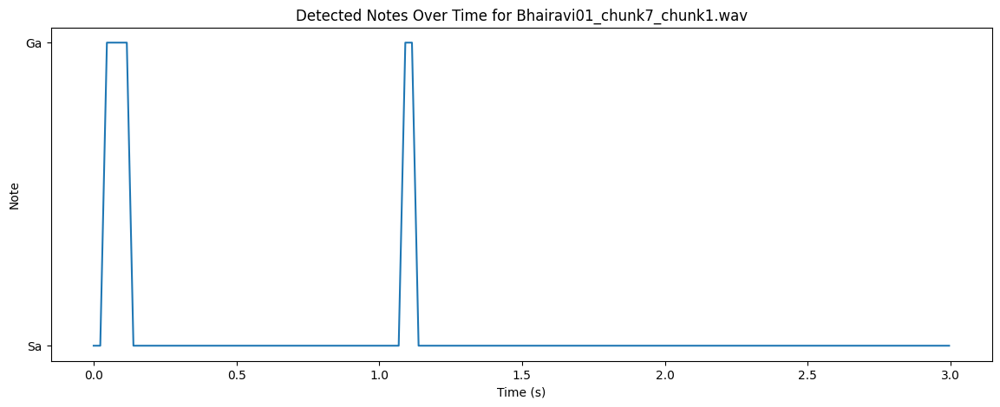

Tonic Frequency for Bhairavi01_chunk7_chunk2.wav: 832.4939575195312 Hz
Detected Notes for Bhairavi01_chunk7_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


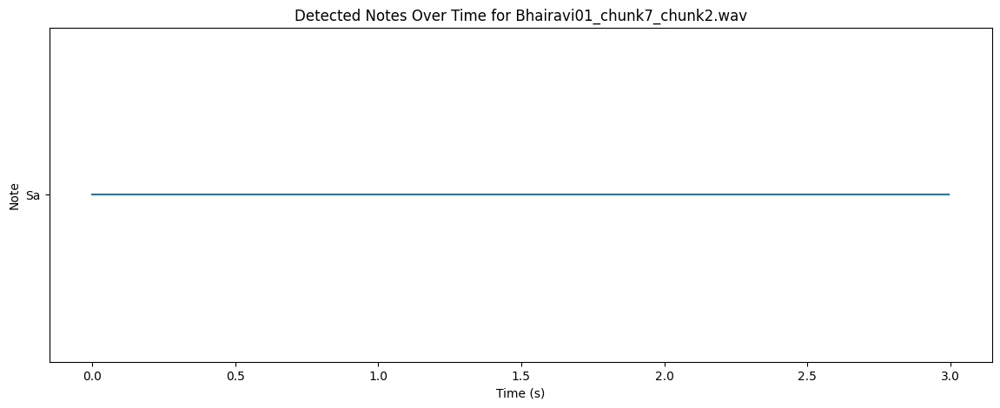

Tonic Frequency for Bhairavi01_chunk7_chunk3.wav: 830.095458984375 Hz
Detected Notes for Bhairavi01_chunk7_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


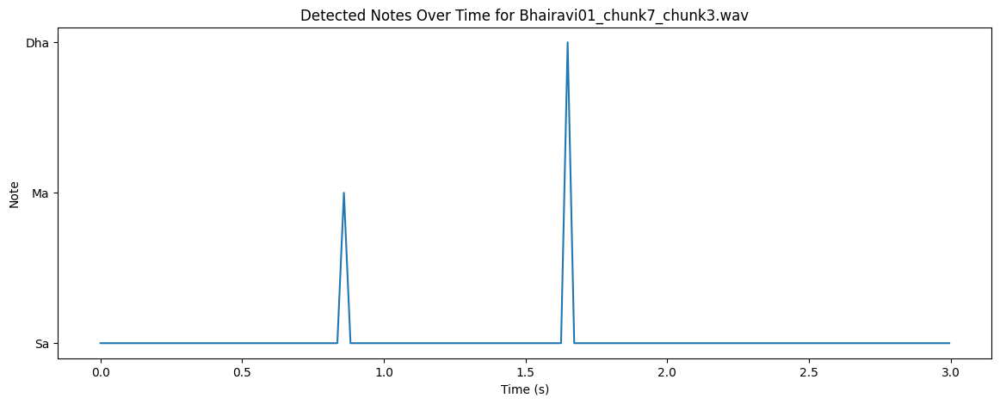

Tonic Frequency for Bhairavi01_chunk7_chunk4.wav: 833.4464111328125 Hz
Detected Notes for Bhairavi01_chunk7_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


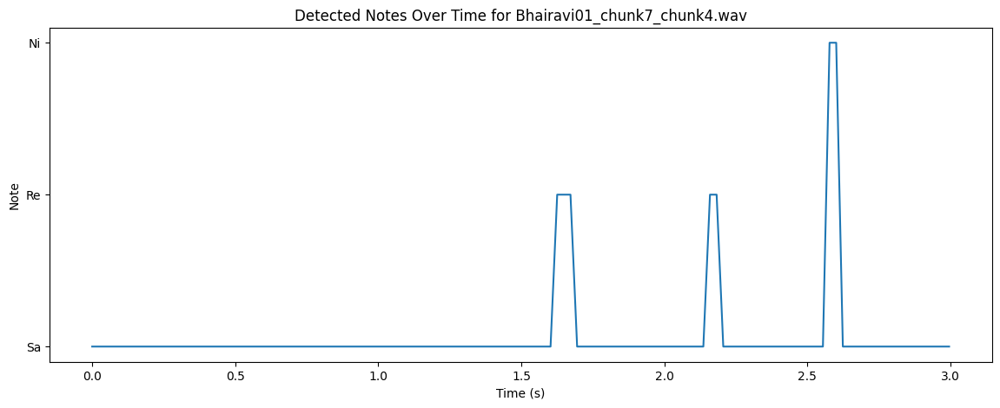

Tonic Frequency for Bhairavi01_chunk7_chunk5.wav: 832.0216674804688 Hz
Detected Notes for Bhairavi01_chunk7_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


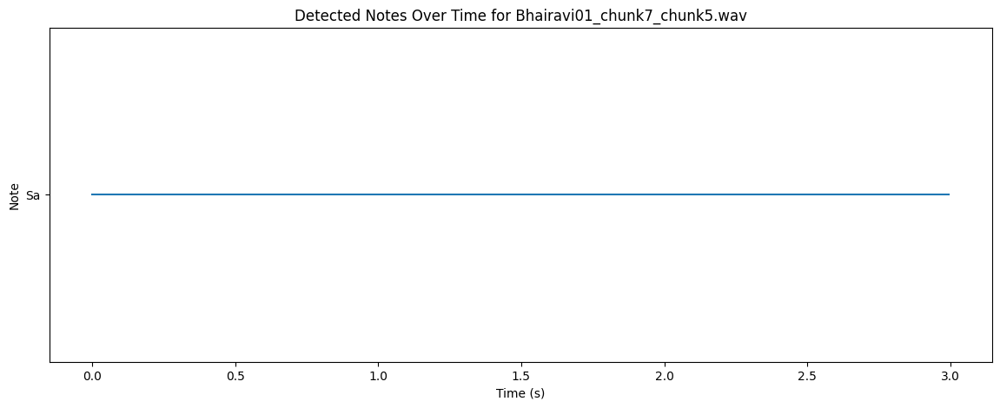

Tonic Frequency for Bhairavi01_chunk7_chunk6.wav: 830.6674194335938 Hz
Detected Notes for Bhairavi01_chunk7_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


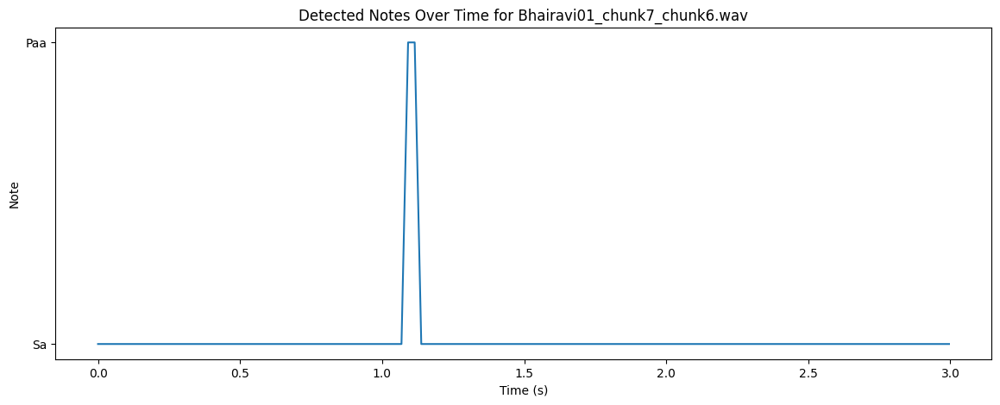

Tonic Frequency for Bhairavi01_chunk7_chunk7.wav: 838.9716796875 Hz
Detected Notes for Bhairavi01_chunk7_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


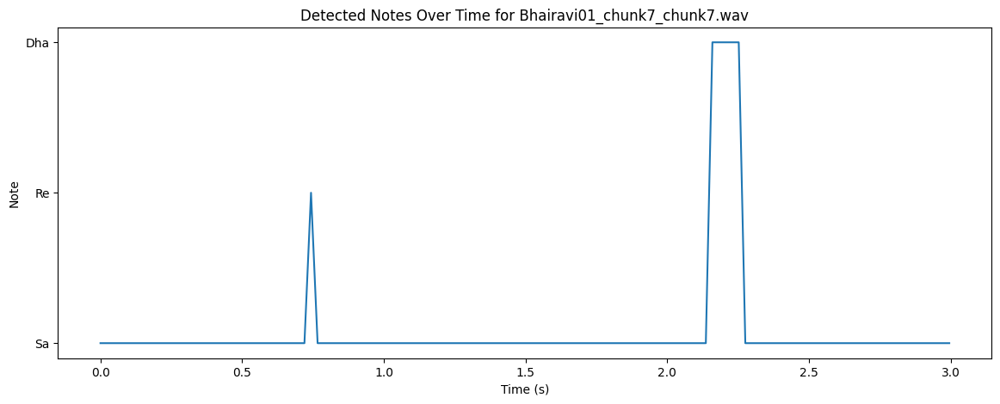

Tonic Frequency for Bhairavi01_chunk7_chunk8.wav: 935.281494140625 Hz
Detected Notes for Bhairavi01_chunk7_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


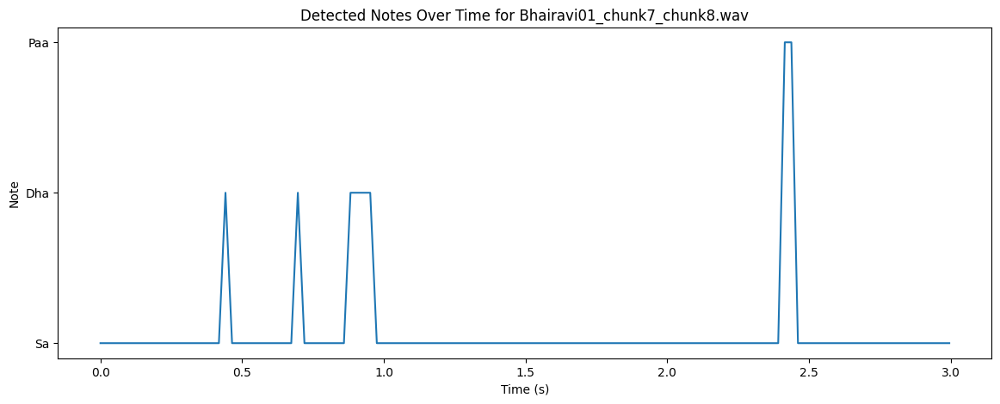

Tonic Frequency for Bhairavi01_chunk7_chunk9.wav: 833.4515380859375 Hz
Detected Notes for Bhairavi01_chunk7_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


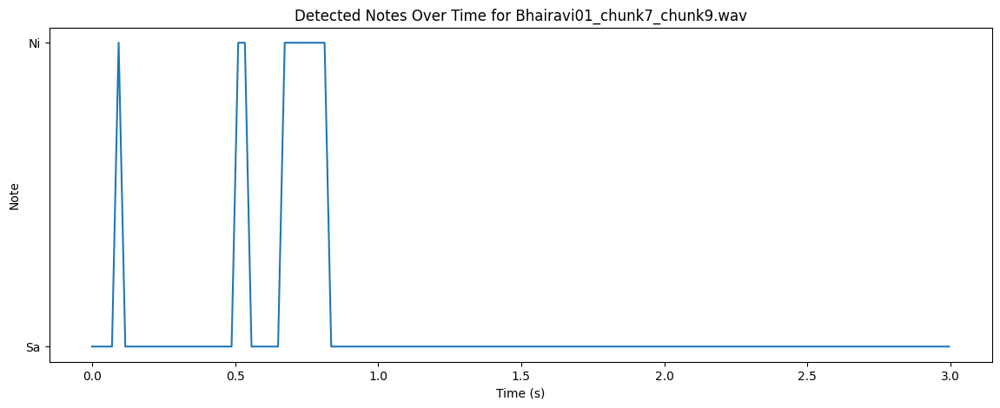

Tonic Frequency for Bhairavi01_chunk7_chunk10.wav: 836.7125854492188 Hz
Detected Notes for Bhairavi01_chunk7_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


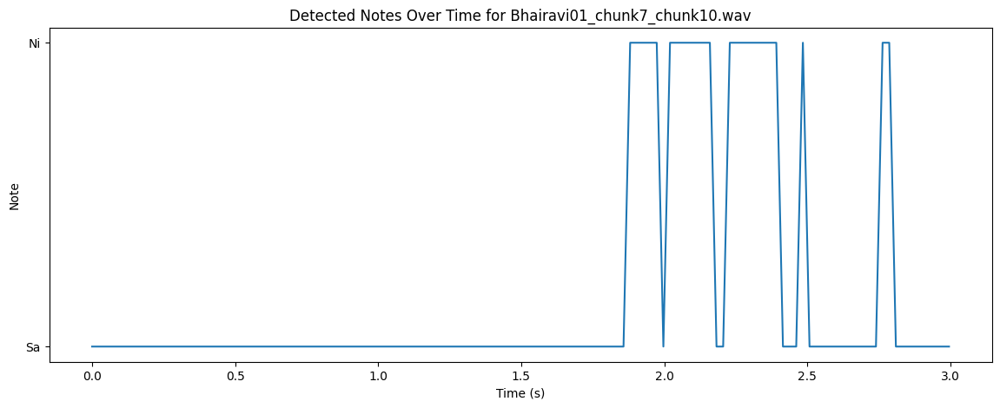

Tonic Frequency for Bhairavi01_chunk8_chunk1.wav: 831.9100341796875 Hz
Detected Notes for Bhairavi01_chunk8_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


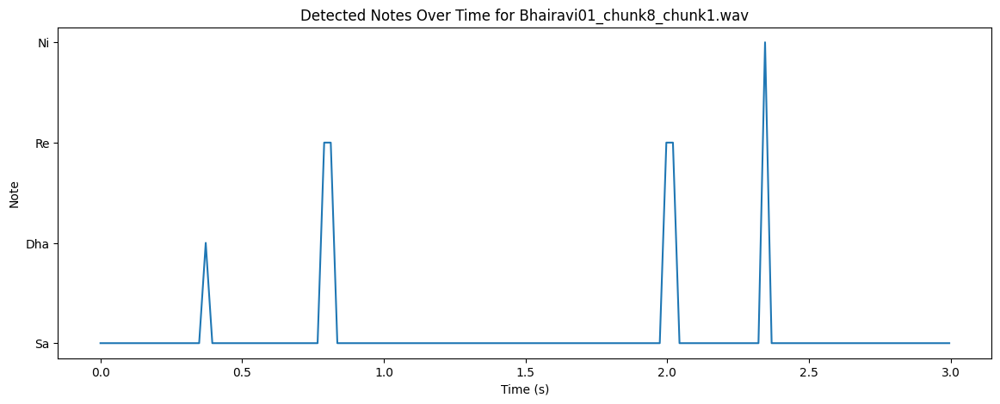

Tonic Frequency for Bhairavi01_chunk8_chunk2.wav: 831.9539794921875 Hz
Detected Notes for Bhairavi01_chunk8_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


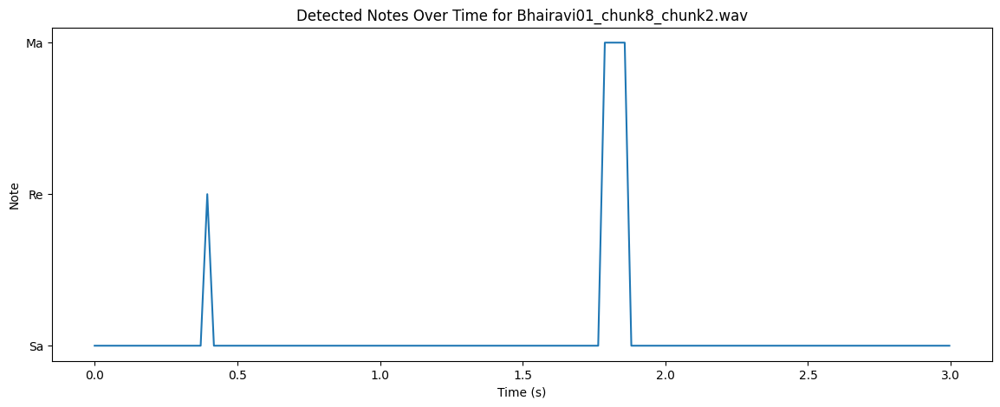

Tonic Frequency for Bhairavi01_chunk8_chunk3.wav: 746.977294921875 Hz
Detected Notes for Bhairavi01_chunk8_chunk3.wav:  ['Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


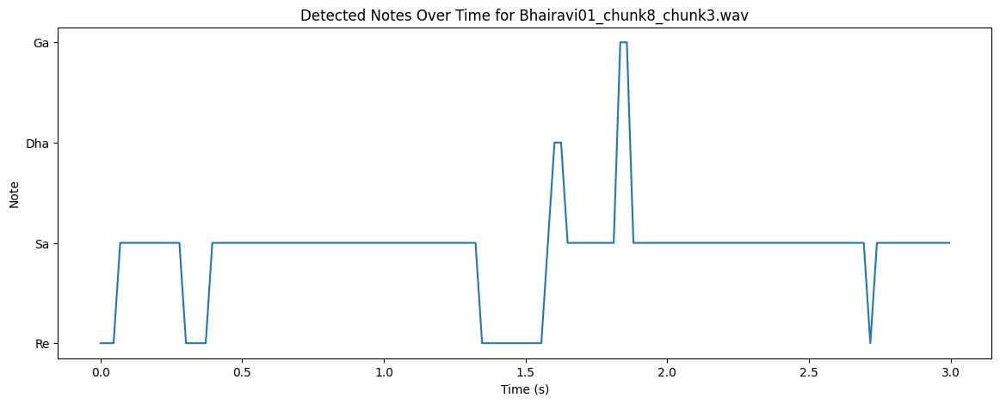

Tonic Frequency for Bhairavi01_chunk8_chunk4.wav: 758.5319213867188 Hz
Detected Notes for Bhairavi01_chunk8_chunk4.wav:  ['Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa']


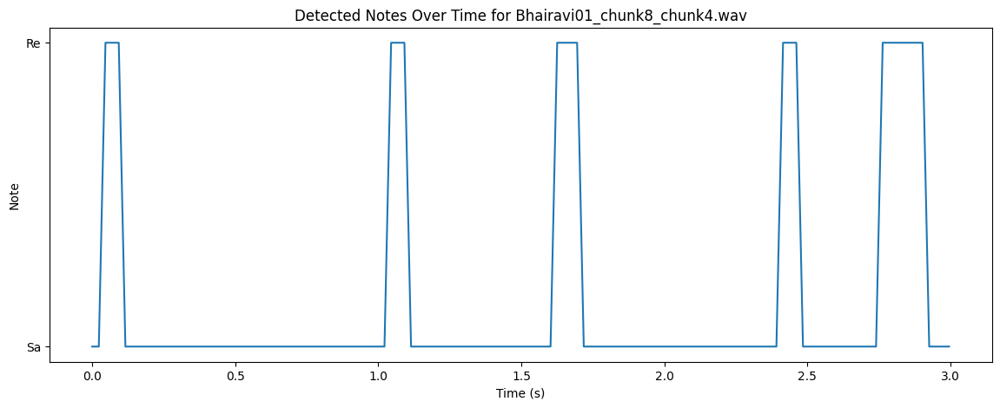

Tonic Frequency for Bhairavi01_chunk8_chunk5.wav: 750.4088134765625 Hz
Detected Notes for Bhairavi01_chunk8_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Re', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


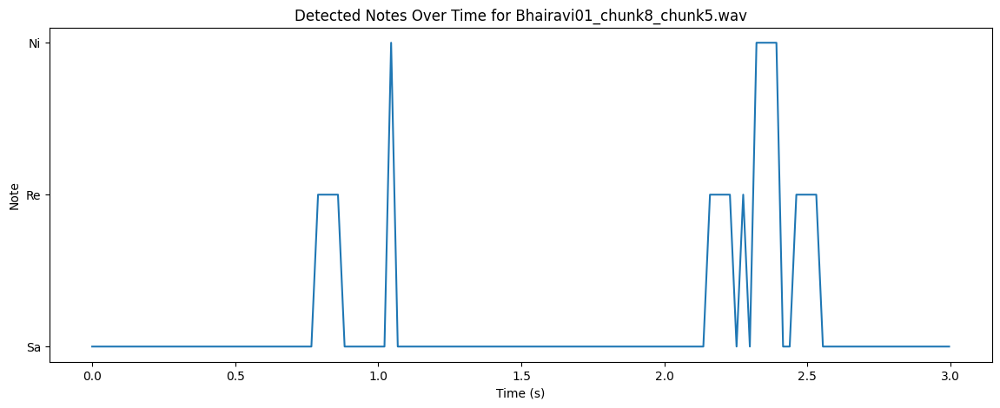

Tonic Frequency for Bhairavi01_chunk8_chunk6.wav: 832.14697265625 Hz
Detected Notes for Bhairavi01_chunk8_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


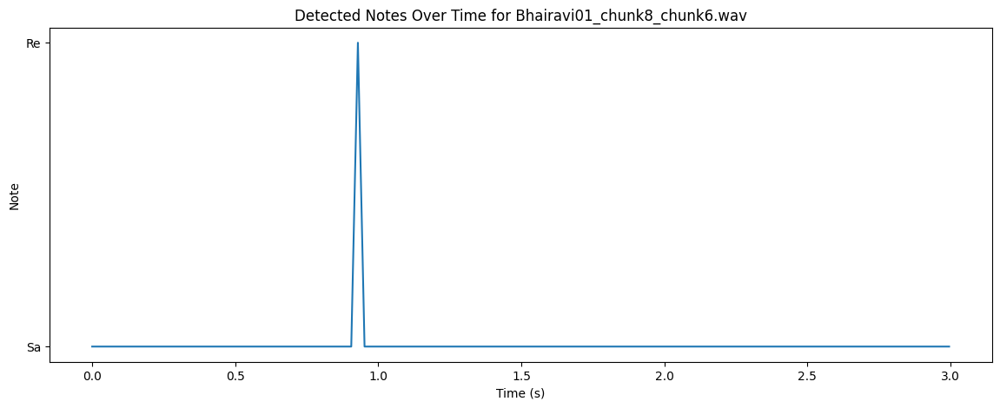

Tonic Frequency for Bhairavi01_chunk8_chunk7.wav: 691.5728759765625 Hz
Detected Notes for Bhairavi01_chunk8_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ga', 'Ga']


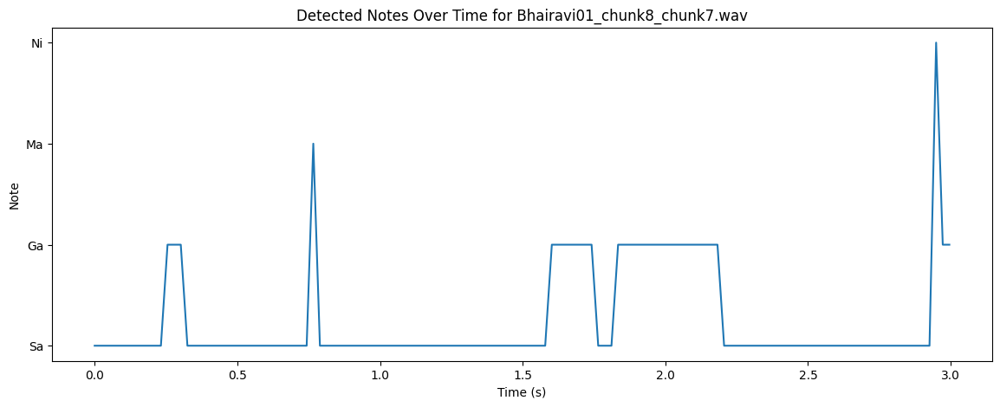

Tonic Frequency for Bhairavi01_chunk8_chunk8.wav: 829.8115844726562 Hz
Detected Notes for Bhairavi01_chunk8_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni']


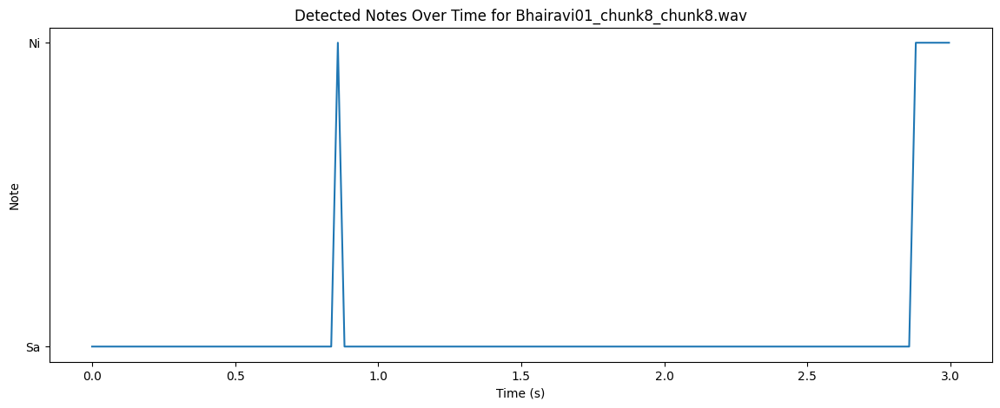

Tonic Frequency for Bhairavi01_chunk8_chunk9.wav: 829.73388671875 Hz
Detected Notes for Bhairavi01_chunk8_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


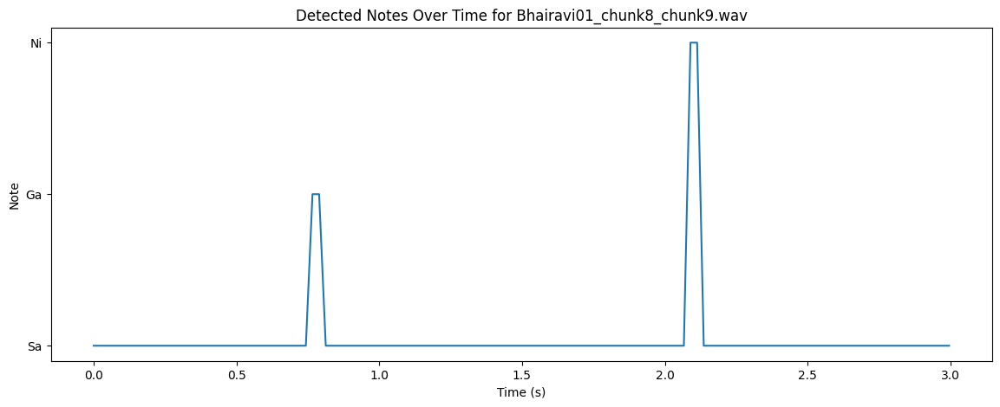

Tonic Frequency for Bhairavi01_chunk8_chunk10.wav: 830.0896606445312 Hz
Detected Notes for Bhairavi01_chunk8_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


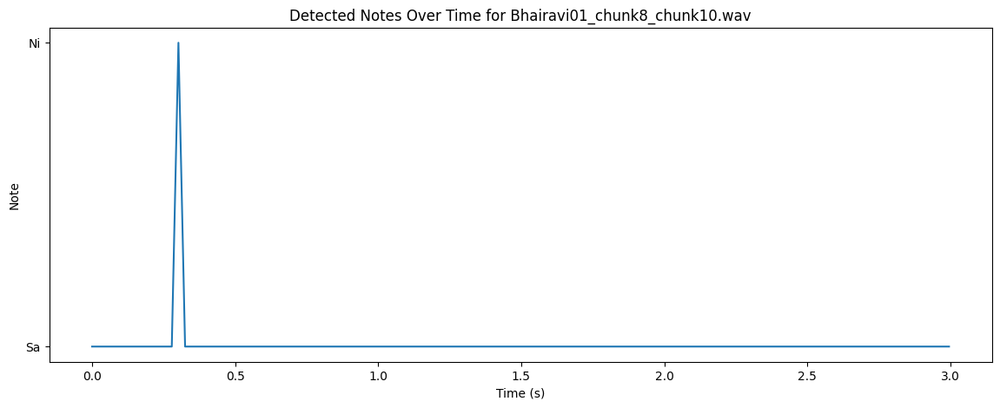

Tonic Frequency for Bhairavi01_chunk9_chunk1.wav: 936.093017578125 Hz
Detected Notes for Bhairavi01_chunk9_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa']


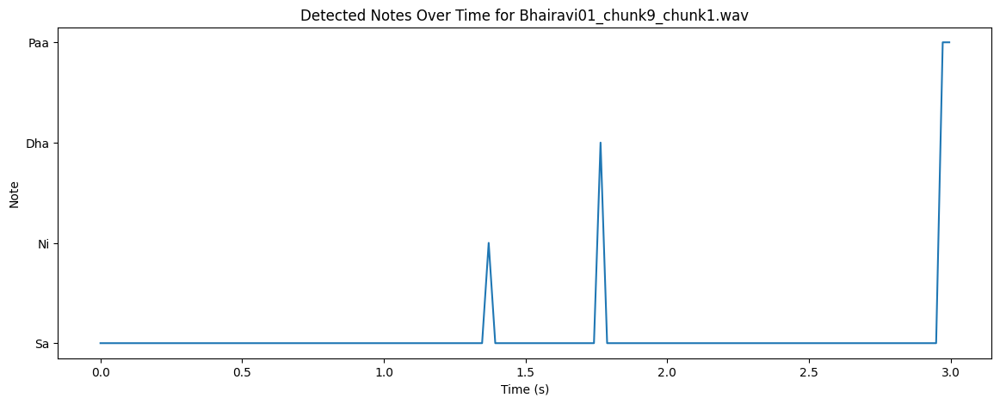

Tonic Frequency for Bhairavi01_chunk9_chunk2.wav: 969.7523803710938 Hz
Detected Notes for Bhairavi01_chunk9_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


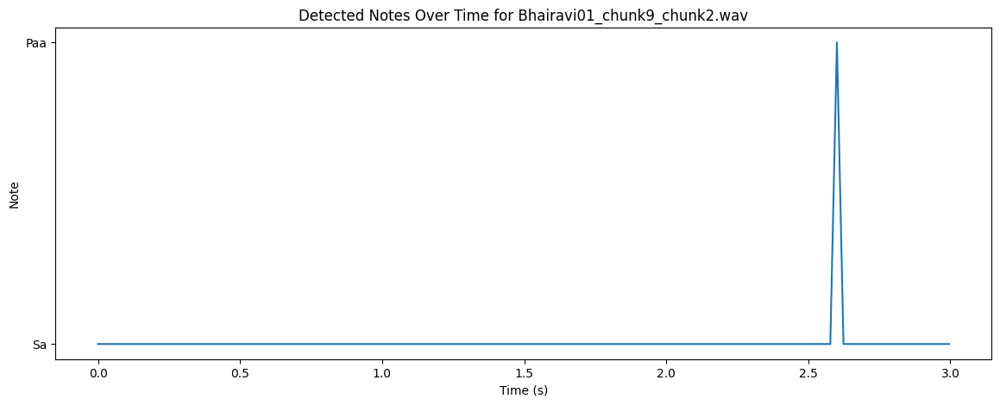

Tonic Frequency for Bhairavi01_chunk9_chunk3.wav: 832.0643310546875 Hz
Detected Notes for Bhairavi01_chunk9_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


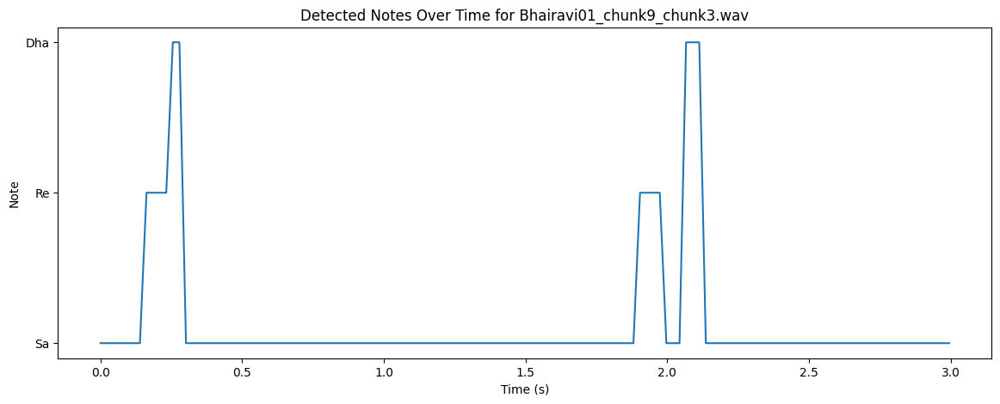

Tonic Frequency for Bhairavi01_chunk9_chunk4.wav: 935.8863525390625 Hz
Detected Notes for Bhairavi01_chunk9_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


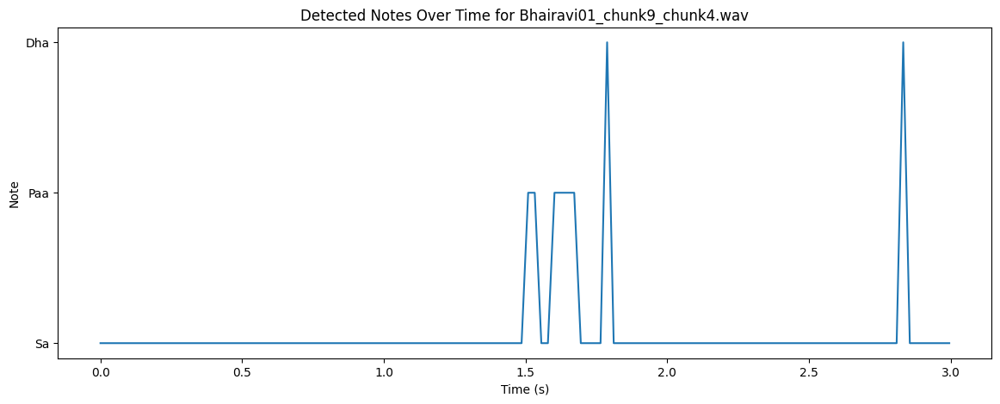

Tonic Frequency for Bhairavi01_chunk9_chunk5.wav: 806.4759521484375 Hz
Detected Notes for Bhairavi01_chunk9_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


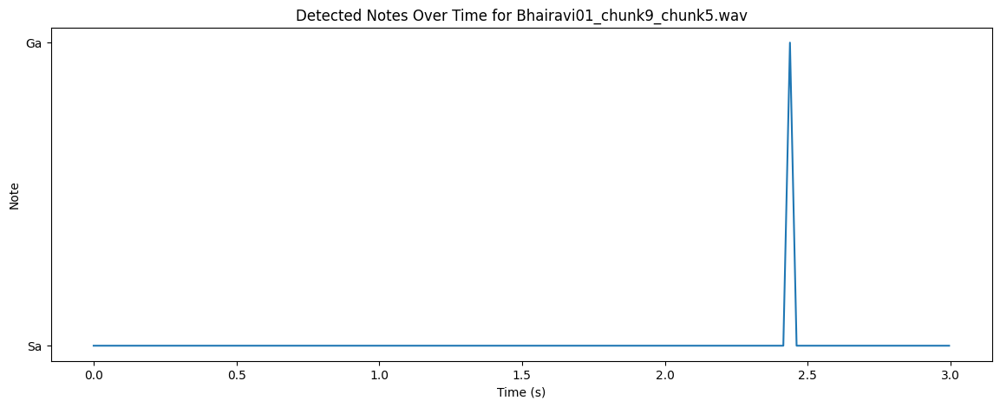

Tonic Frequency for Bhairavi01_chunk9_chunk6.wav: 808.1419677734375 Hz
Detected Notes for Bhairavi01_chunk9_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


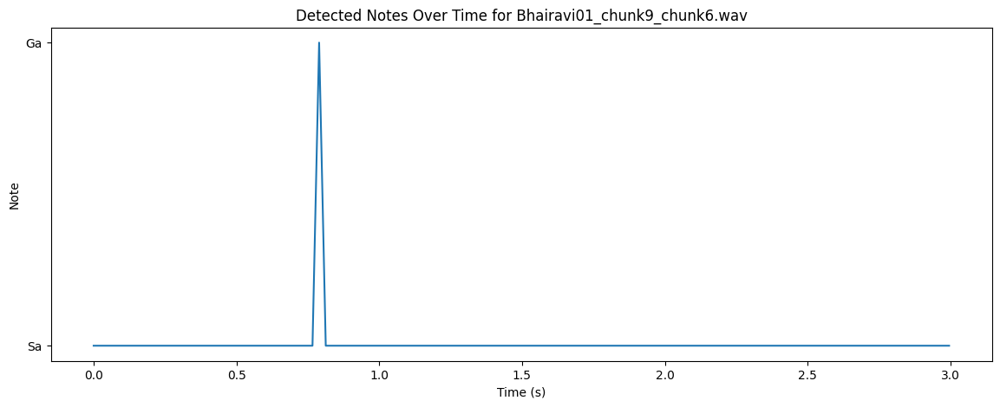

Tonic Frequency for Bhairavi01_chunk9_chunk7.wav: 832.2904052734375 Hz
Detected Notes for Bhairavi01_chunk9_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


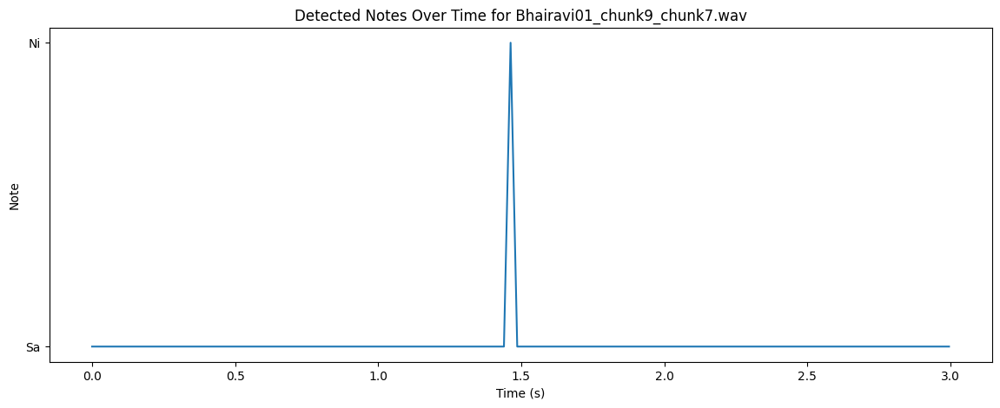

Tonic Frequency for Bhairavi01_chunk9_chunk8.wav: 870.2794799804688 Hz
Detected Notes for Bhairavi01_chunk9_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


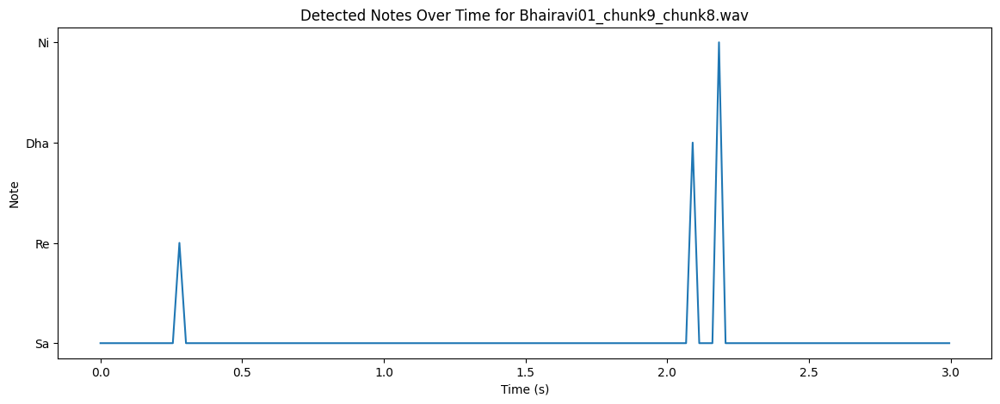

Tonic Frequency for Bhairavi01_chunk9_chunk9.wav: 832.8737182617188 Hz
Detected Notes for Bhairavi01_chunk9_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Dha', 'Dha']


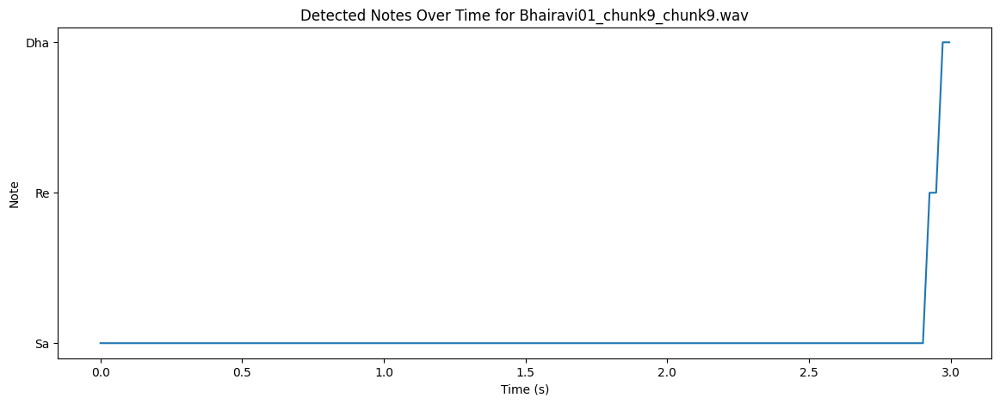

Tonic Frequency for Bhairavi01_chunk9_chunk10.wav: 831.872802734375 Hz
Detected Notes for Bhairavi01_chunk9_chunk10.wav:  ['Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


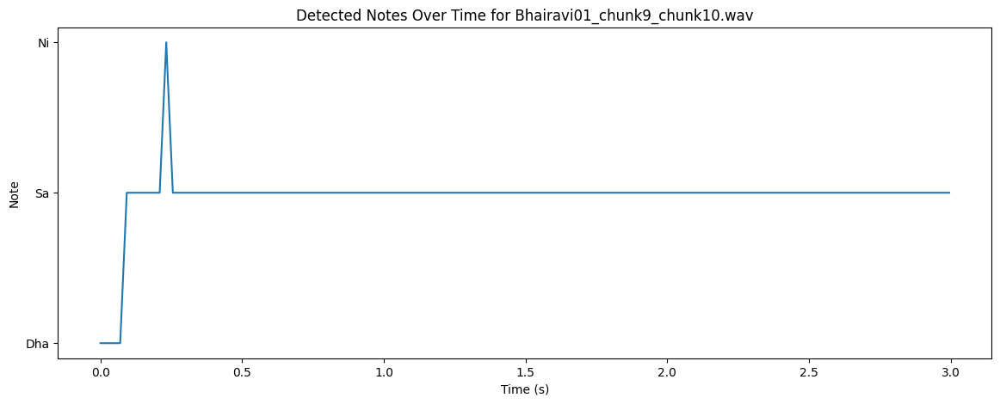

Tonic Frequency for Bhairavi01_chunk10_chunk1.wav: 907.6107788085938 Hz
Detected Notes for Bhairavi01_chunk10_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


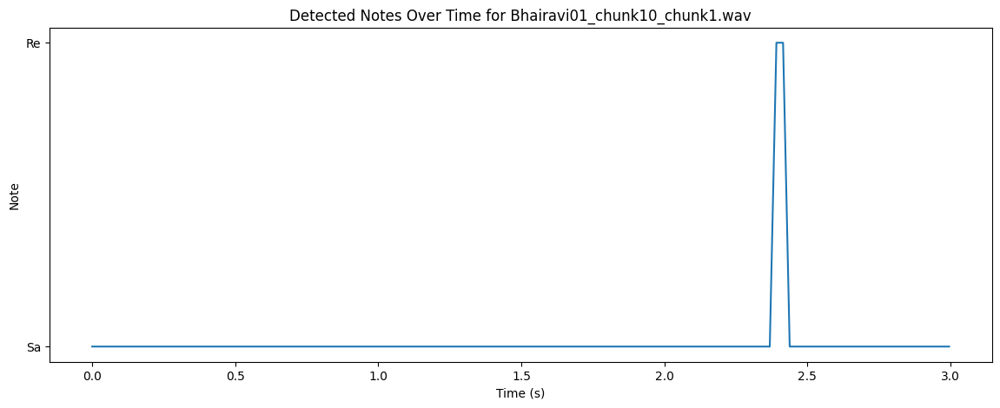

Tonic Frequency for Bhairavi01_chunk10_chunk2.wav: 833.767333984375 Hz
Detected Notes for Bhairavi01_chunk10_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


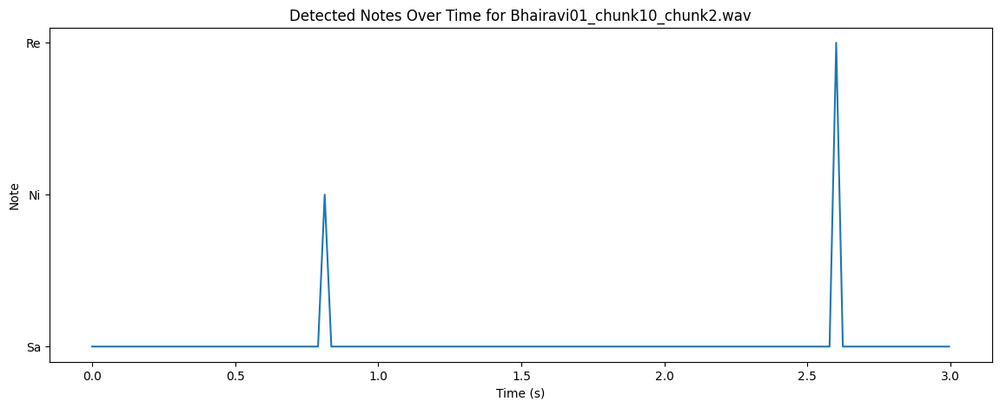

Tonic Frequency for Bhairavi01_chunk10_chunk3.wav: 935.9364013671875 Hz
Detected Notes for Bhairavi01_chunk10_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


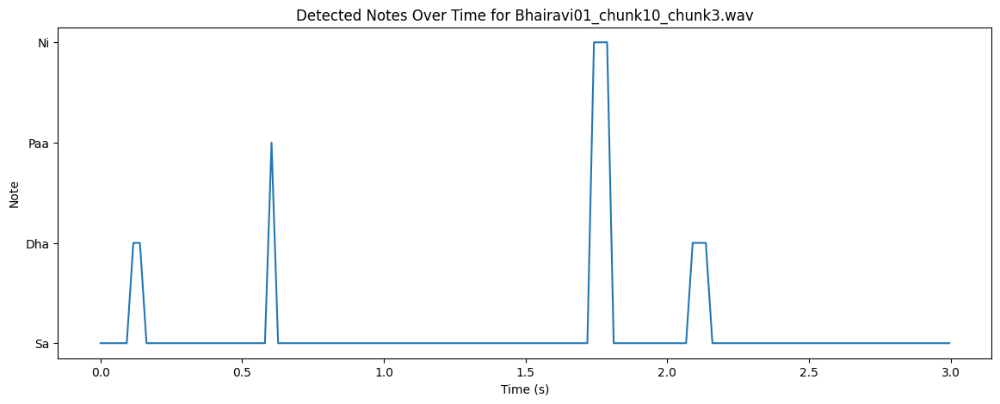

Tonic Frequency for Bhairavi01_chunk10_chunk4.wav: 968.9126586914062 Hz
Detected Notes for Bhairavi01_chunk10_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


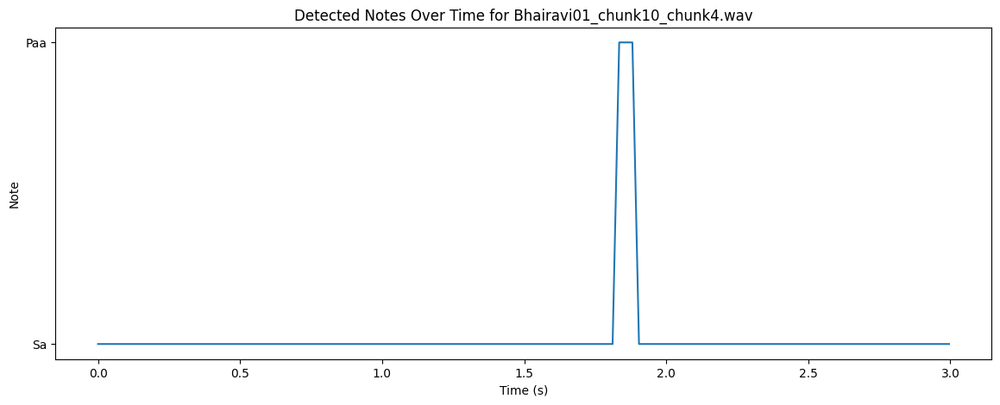

Tonic Frequency for Bhairavi01_chunk10_chunk5.wav: 967.7900390625 Hz
Detected Notes for Bhairavi01_chunk10_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


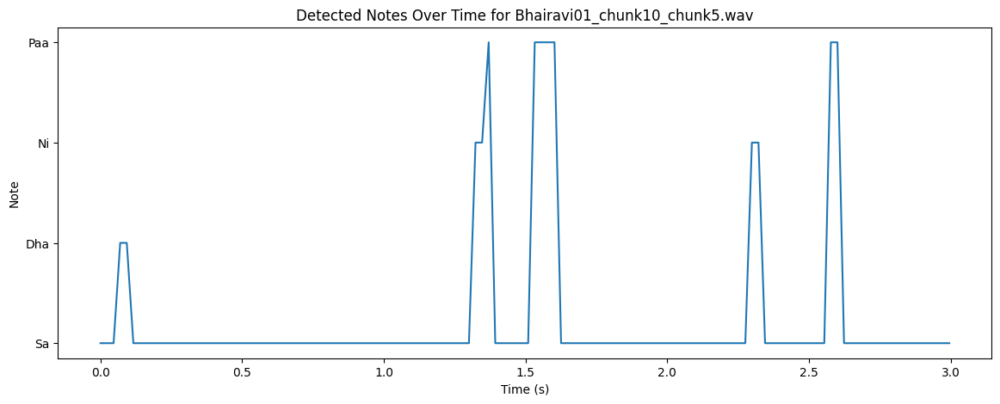

Tonic Frequency for Bhairavi01_chunk10_chunk6.wav: 971.3300170898438 Hz
Detected Notes for Bhairavi01_chunk10_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


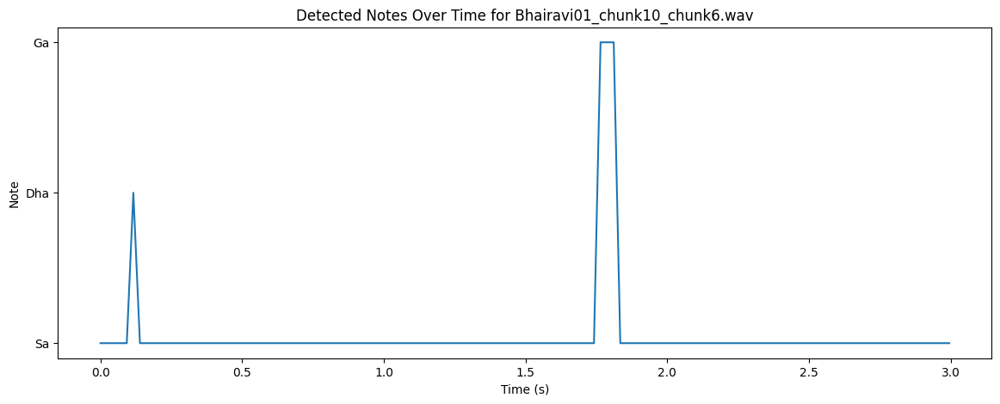

Tonic Frequency for Bhairavi01_chunk10_chunk7.wav: 971.1593017578125 Hz
Detected Notes for Bhairavi01_chunk10_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


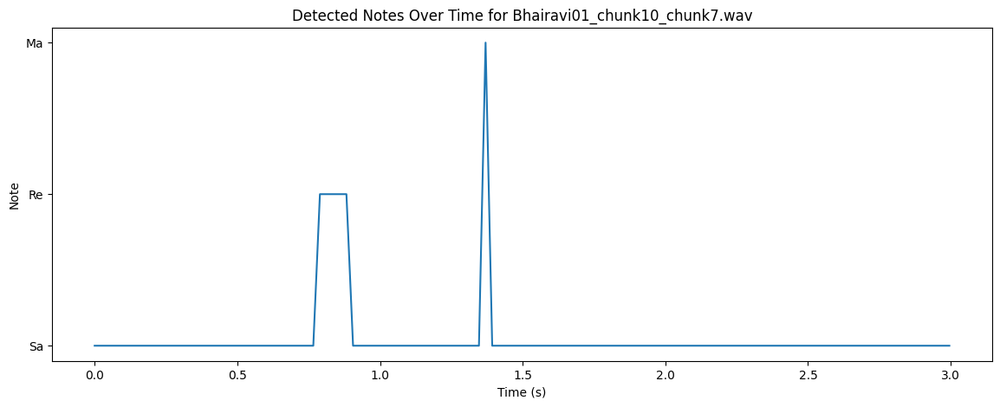

Tonic Frequency for Bhairavi01_chunk10_chunk8.wav: 1053.2608642578125 Hz
Detected Notes for Bhairavi01_chunk10_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ma', 'Ma', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


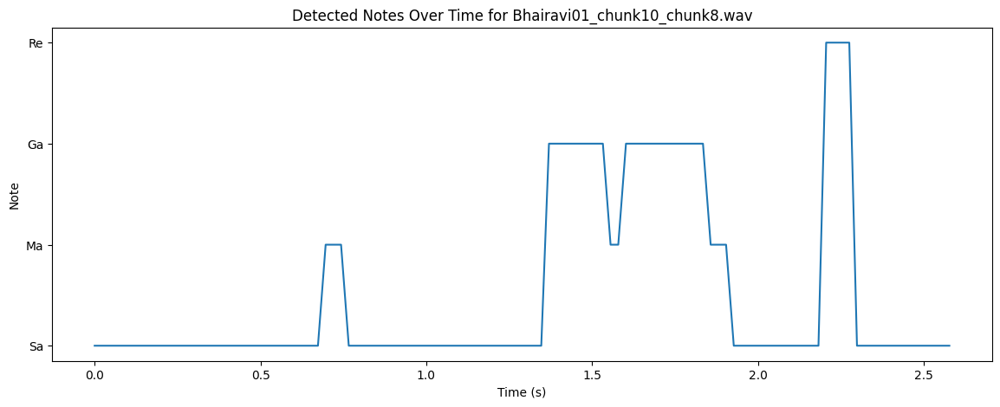

Tonic Frequency for Bhairavi02_chunk1_chunk1.wav: 1040.986572265625 Hz
Detected Notes for Bhairavi02_chunk1_chunk1.wav:  ['Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Paa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Ga', 'Ga', 'Ga', 'Ga', 'Re', 'Ga', 'Ga', 'Ga', 'Re', 'Re', 'Re', 'Ga', 'Ga', 'Ga', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


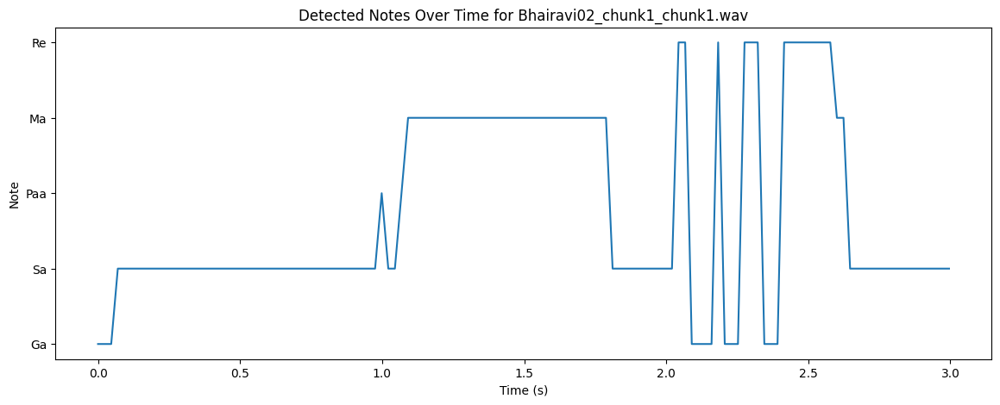

Tonic Frequency for Bhairavi02_chunk1_chunk2.wav: 1073.8040771484375 Hz
Detected Notes for Bhairavi02_chunk1_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa']


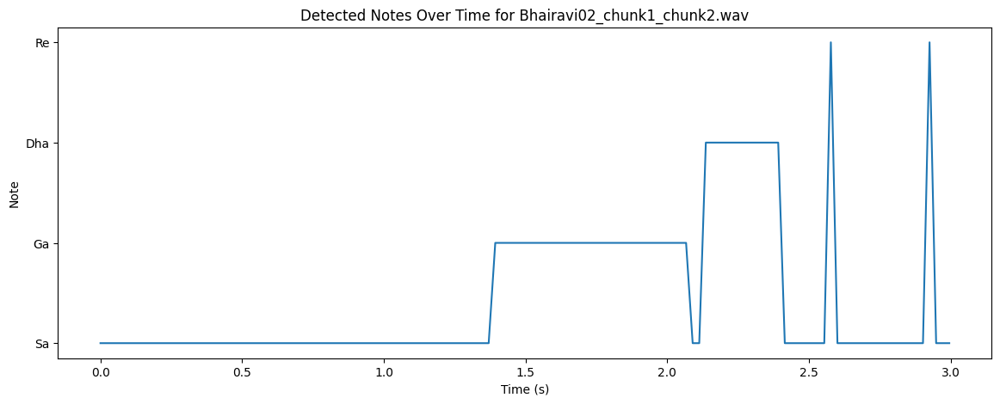

Tonic Frequency for Bhairavi02_chunk1_chunk3.wav: 986.0511474609375 Hz
Detected Notes for Bhairavi02_chunk1_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


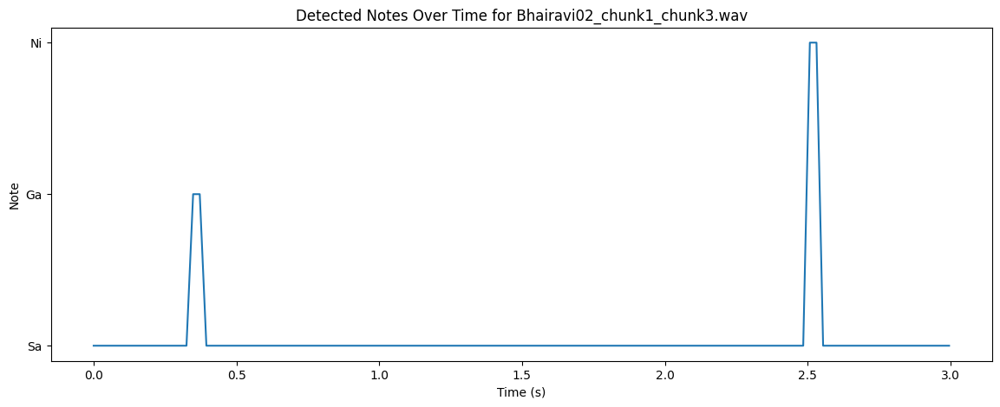

Tonic Frequency for Bhairavi02_chunk1_chunk4.wav: 1042.8939208984375 Hz
Detected Notes for Bhairavi02_chunk1_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


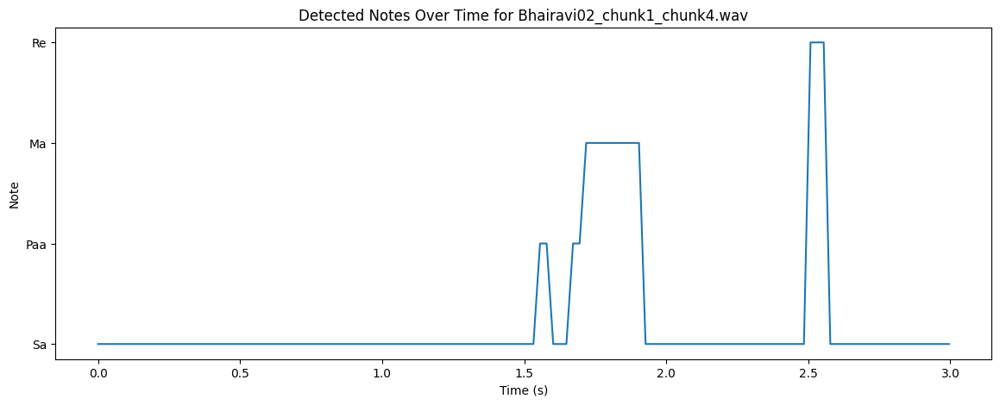

Tonic Frequency for Bhairavi02_chunk1_chunk5.wav: 1040.5484619140625 Hz
Detected Notes for Bhairavi02_chunk1_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


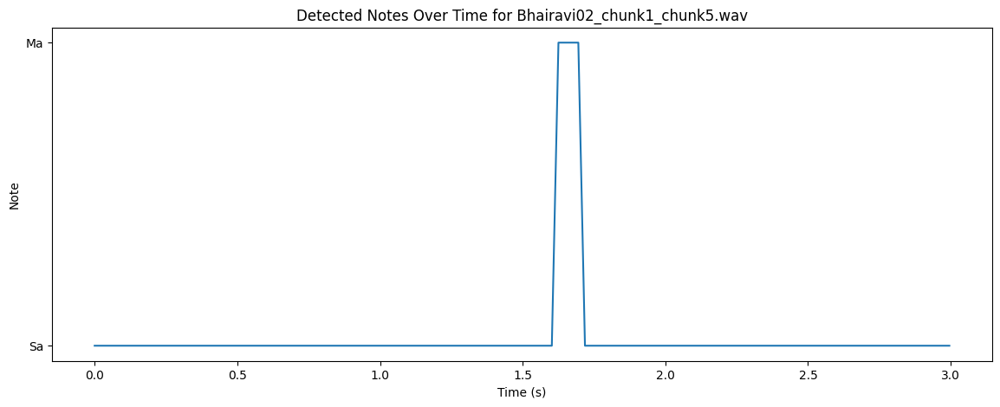

Tonic Frequency for Bhairavi02_chunk1_chunk6.wav: 972.0479736328125 Hz
Detected Notes for Bhairavi02_chunk1_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ni', 'Sa', 'Sa', 'Ni', 'Ni']


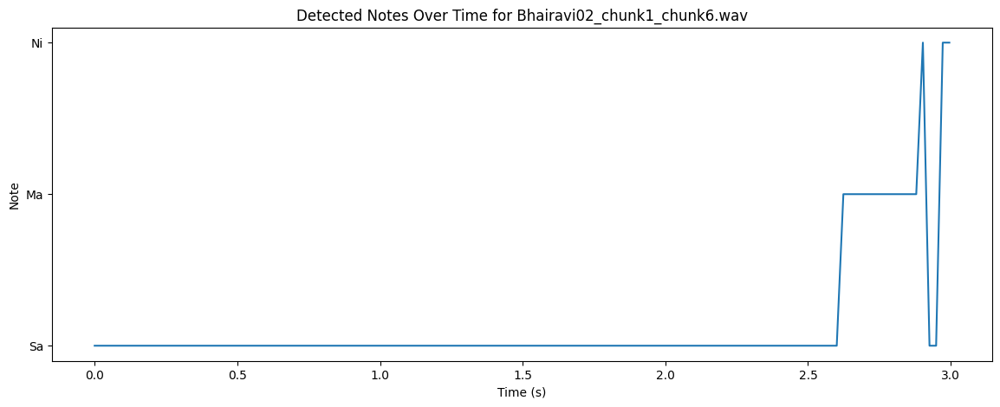

Tonic Frequency for Bhairavi02_chunk1_chunk7.wav: 994.781494140625 Hz
Detected Notes for Bhairavi02_chunk1_chunk7.wav:  ['Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


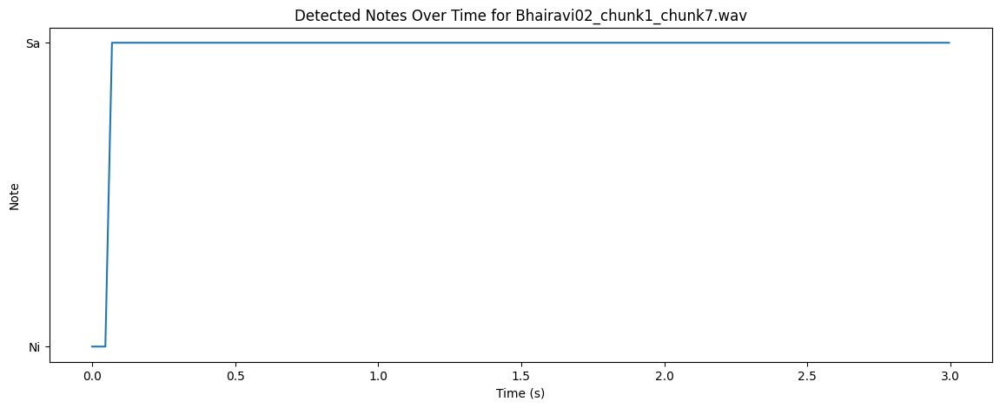

Tonic Frequency for Bhairavi02_chunk1_chunk8.wav: 1047.0107421875 Hz
Detected Notes for Bhairavi02_chunk1_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ga', 'Ma', 'Ma', 'Ga', 'Ma', 'Ma', 'Ga', 'Ma', 'Ma', 'Dha', 'Dha', 'Ma', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ga', 'Ga', 'Ga', 'Ga', 'Ma', 'Ma', 'Ma', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


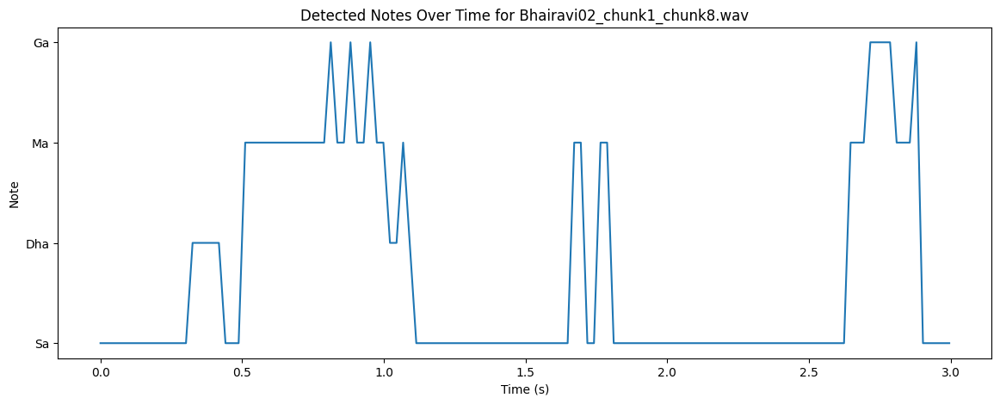

Tonic Frequency for Bhairavi02_chunk1_chunk9.wav: 1143.6419677734375 Hz
Detected Notes for Bhairavi02_chunk1_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Re', 'Re', 'Re', 'Ga', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Ga', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Ma', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Ga', 'Re', 'Re', 'Sa', 'Ga', 'Sa', 'Sa', 'Ga', 'Ga', 'Re', 'Re', 'Re', 'Ga', 'Sa', 'Sa', 'Ga', 'Ga', 'Re', 'Re', 'Re']


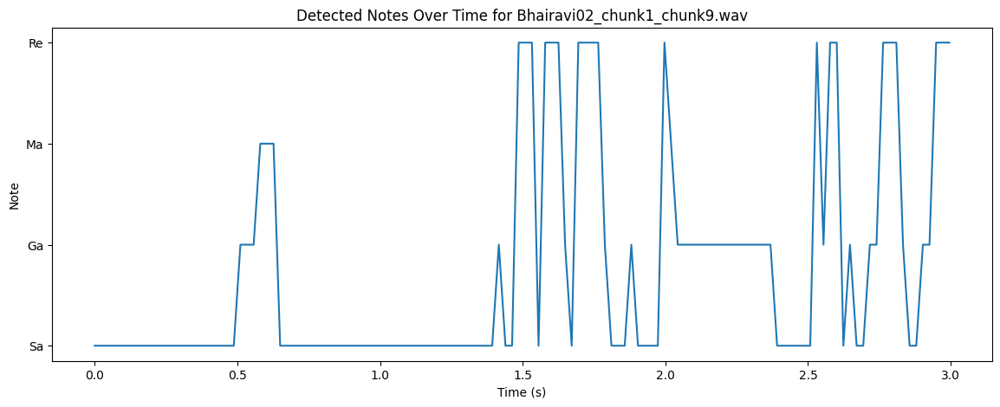

Tonic Frequency for Bhairavi02_chunk1_chunk10.wav: 1041.8587646484375 Hz
Detected Notes for Bhairavi02_chunk1_chunk10.wav:  ['Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ma', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Re', 'Re', 'Sa', 'Ga', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


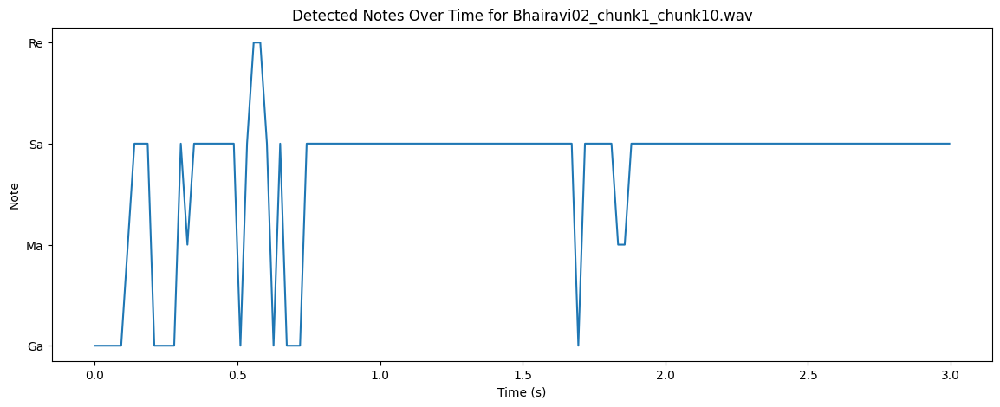

Tonic Frequency for Bhairavi02_chunk2_chunk1.wav: 1109.217529296875 Hz
Detected Notes for Bhairavi02_chunk2_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


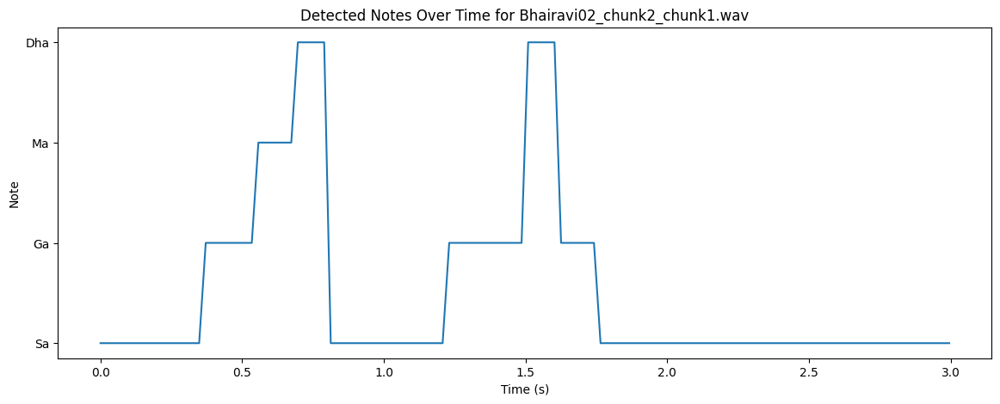

Tonic Frequency for Bhairavi02_chunk2_chunk2.wav: 1128.359619140625 Hz
Detected Notes for Bhairavi02_chunk2_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ma', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


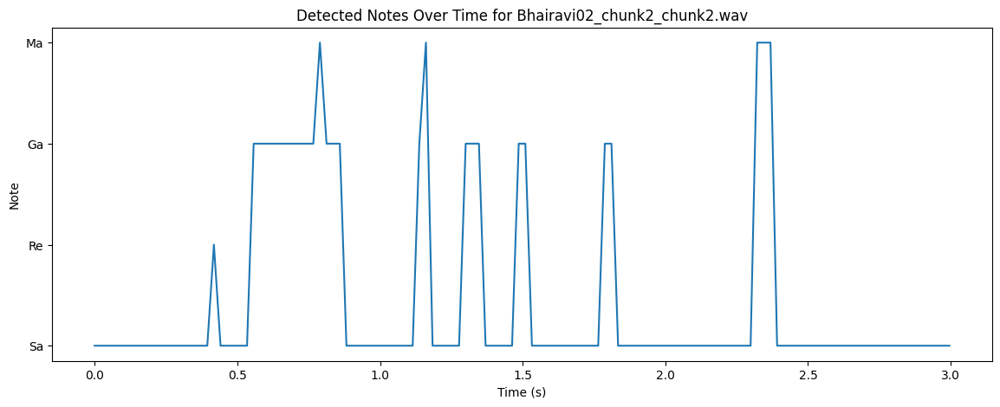

Tonic Frequency for Bhairavi02_chunk2_chunk3.wav: 1042.0728759765625 Hz
Detected Notes for Bhairavi02_chunk2_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


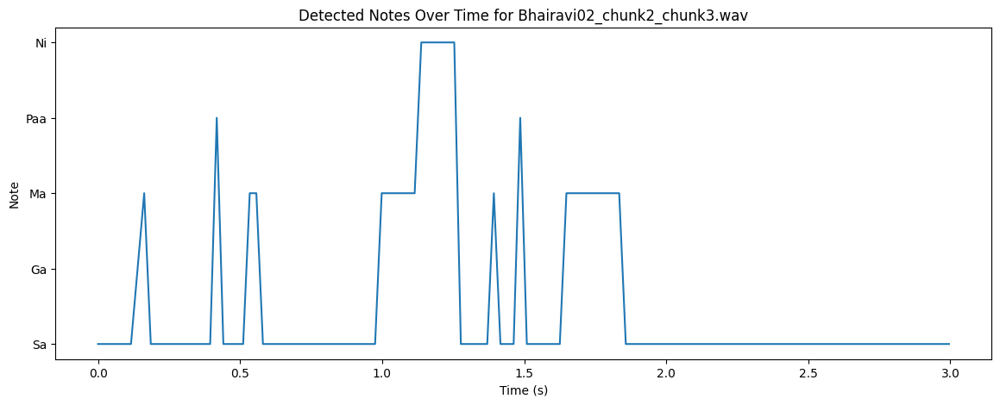

Tonic Frequency for Bhairavi02_chunk2_chunk4.wav: 1037.115966796875 Hz
Detected Notes for Bhairavi02_chunk2_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Ma', 'Paa', 'Paa', 'Paa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha']


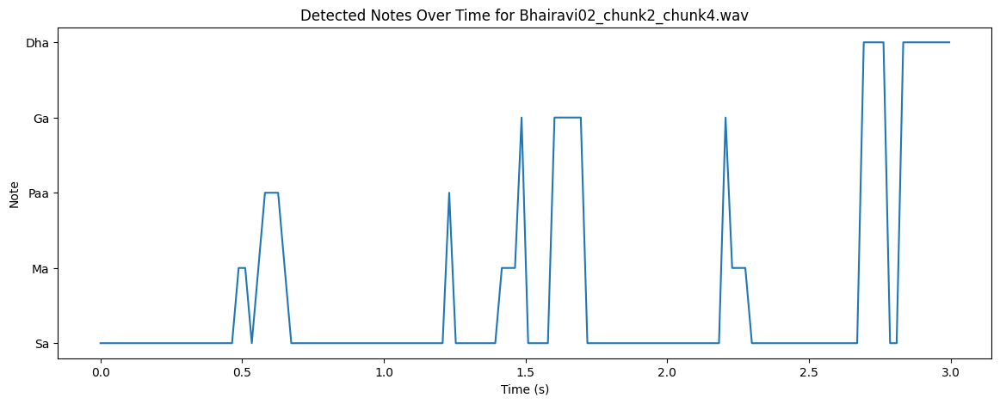

Tonic Frequency for Bhairavi02_chunk2_chunk5.wav: 1098.6005859375 Hz
Detected Notes for Bhairavi02_chunk2_chunk5.wav:  ['Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma']


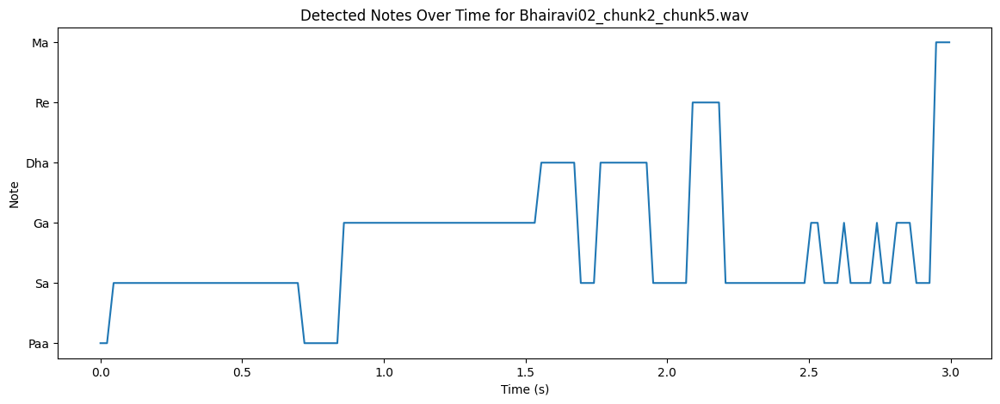

Tonic Frequency for Bhairavi02_chunk2_chunk6.wav: 1224.2921142578125 Hz
Detected Notes for Bhairavi02_chunk2_chunk6.wav:  ['Ga', 'Ga', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


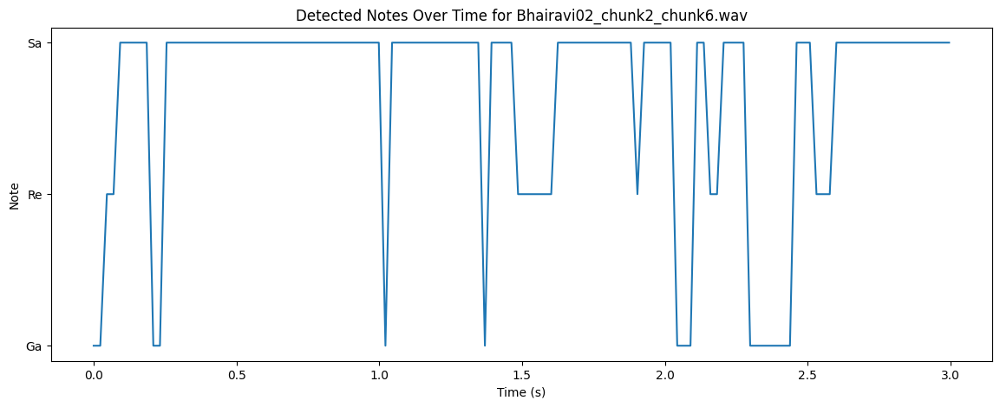

Tonic Frequency for Bhairavi02_chunk2_chunk7.wav: 1042.17529296875 Hz
Detected Notes for Bhairavi02_chunk2_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma']


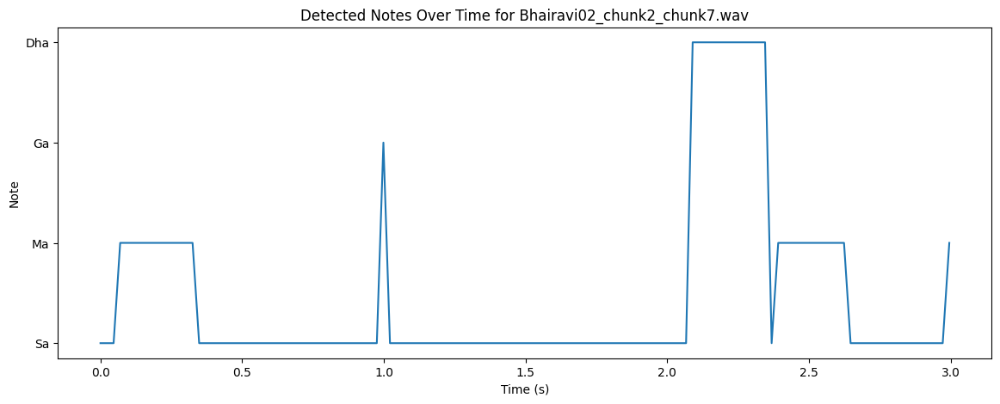

Tonic Frequency for Bhairavi02_chunk2_chunk8.wav: 1042.30859375 Hz
Detected Notes for Bhairavi02_chunk2_chunk8.wav:  ['Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Paa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Ma', 'Ga', 'Ga', 'Ma', 'Ma', 'Sa', 'Sa', 'Ma', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa']


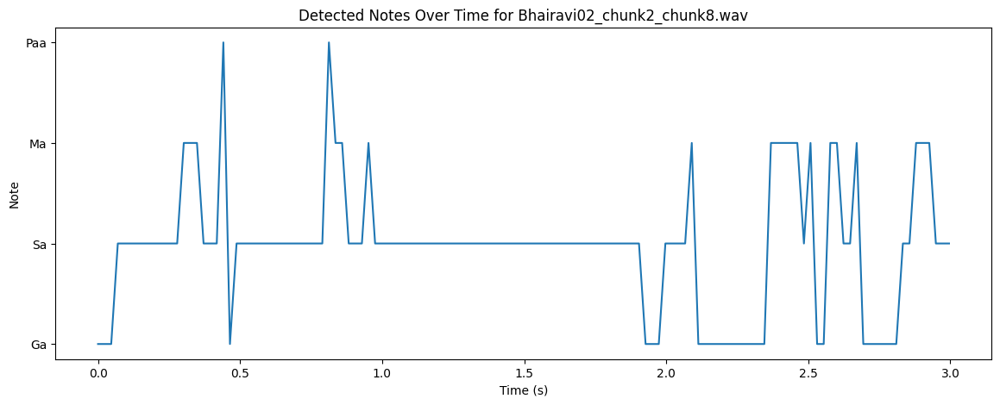

Tonic Frequency for Bhairavi02_chunk2_chunk9.wav: 1042.4881591796875 Hz
Detected Notes for Bhairavi02_chunk2_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ma', 'Sa', 'Ga', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ga', 'Sa', 'Sa', 'Ma', 'Ma', 'Re', 'Sa', 'Sa', 'Sa', 'Ma', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Ga', 'Ma', 'Ma', 'Ma']


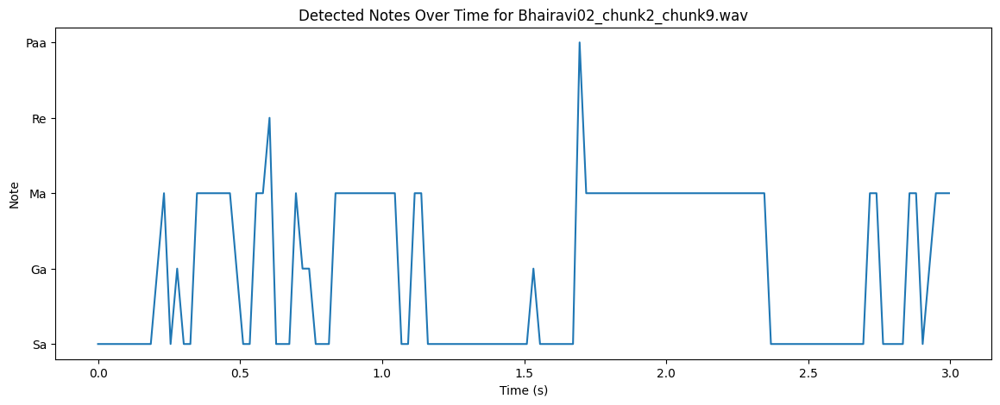

Tonic Frequency for Bhairavi02_chunk2_chunk10.wav: 986.5518798828125 Hz
Detected Notes for Bhairavi02_chunk2_chunk10.wav:  ['Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Ni', 'Ga', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni']


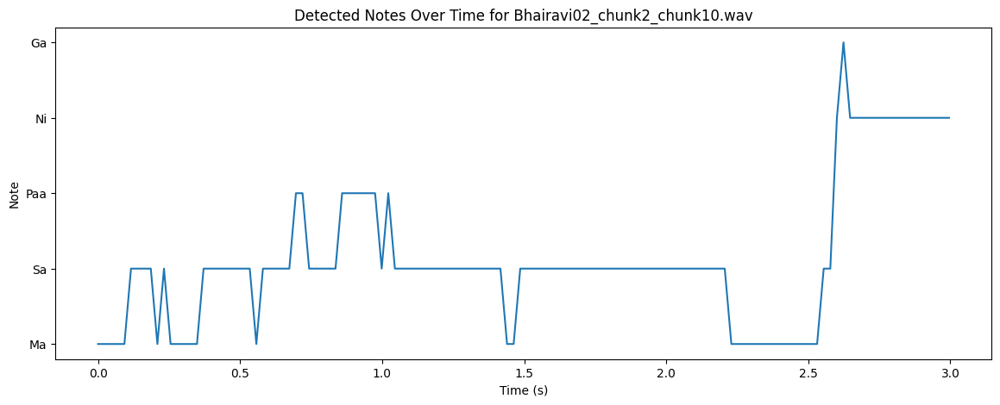

Tonic Frequency for Bhairavi02_chunk3_chunk1.wav: 1247.857666015625 Hz
Detected Notes for Bhairavi02_chunk3_chunk1.wav:  ['Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Paa', 'Sa', 'Ma', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Ga', 'Ma', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa']


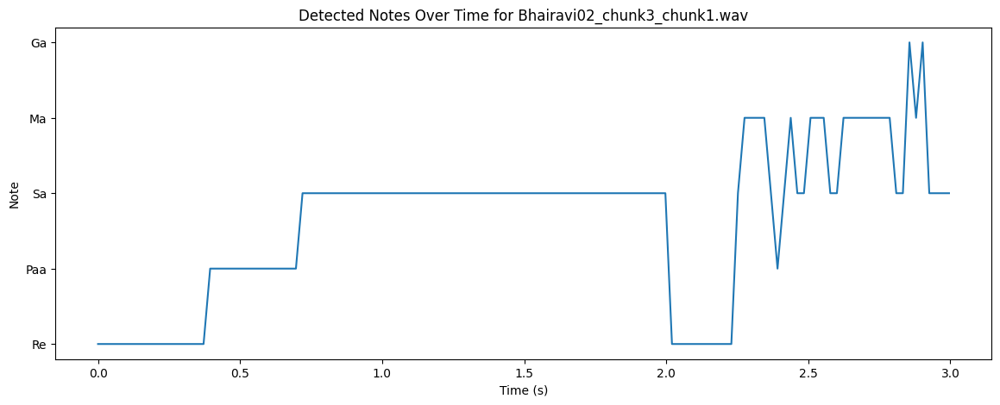

Tonic Frequency for Bhairavi02_chunk3_chunk2.wav: 934.7928466796875 Hz
Detected Notes for Bhairavi02_chunk3_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


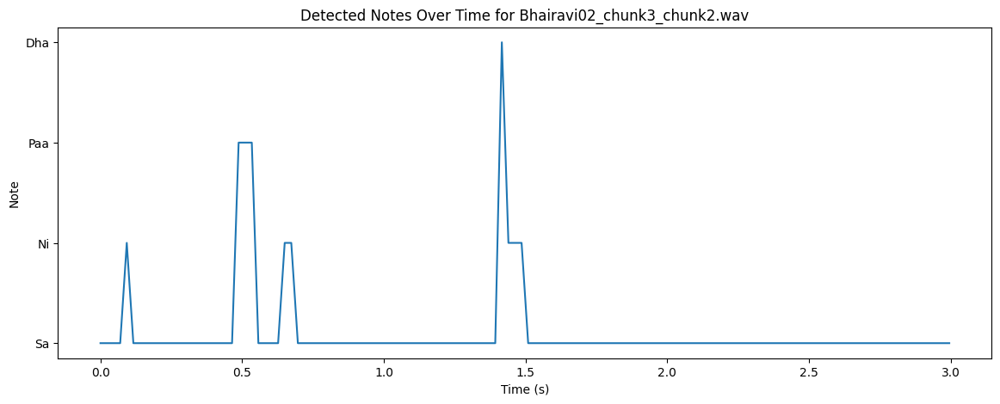

Tonic Frequency for Bhairavi02_chunk3_chunk3.wav: 831.8369140625 Hz
Detected Notes for Bhairavi02_chunk3_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Dha', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


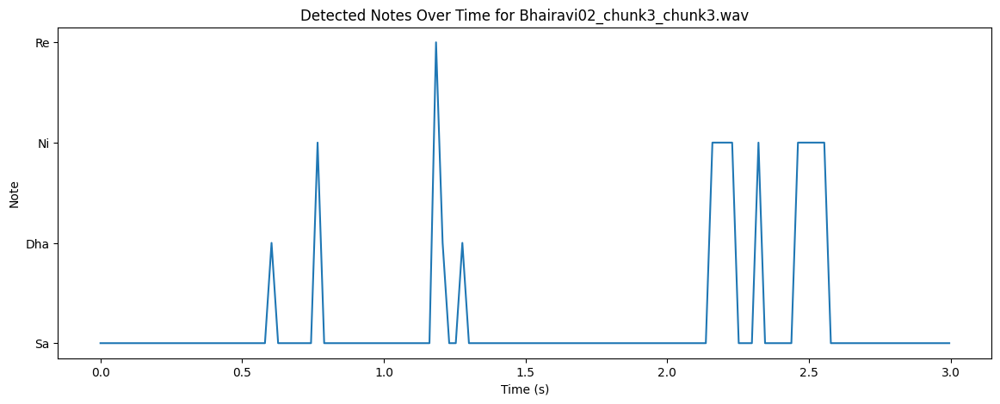

Tonic Frequency for Bhairavi02_chunk3_chunk4.wav: 833.323974609375 Hz
Detected Notes for Bhairavi02_chunk3_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


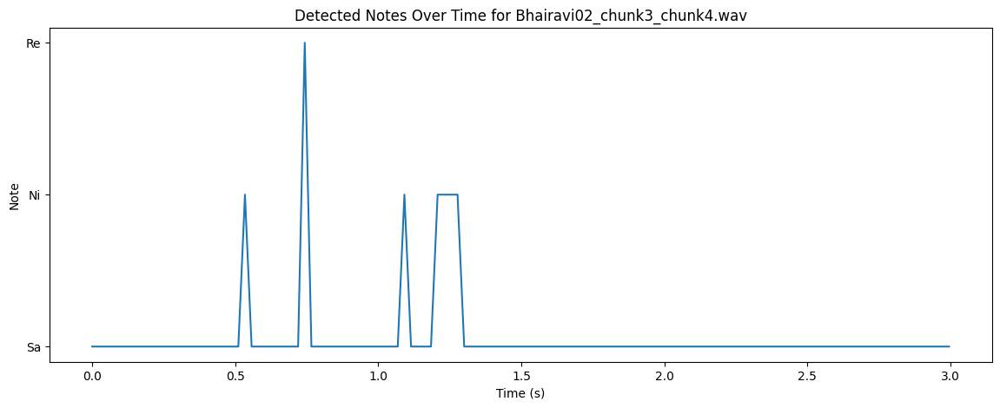

Tonic Frequency for Bhairavi02_chunk3_chunk5.wav: 912.378173828125 Hz
Detected Notes for Bhairavi02_chunk3_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


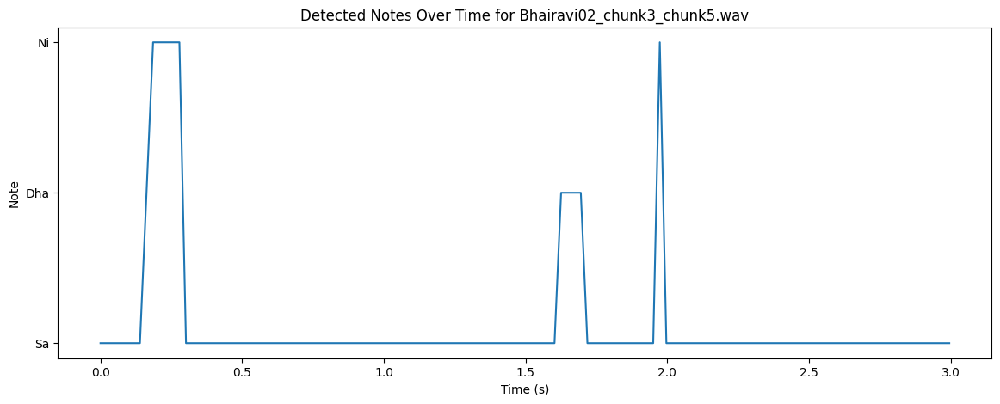

Tonic Frequency for Bhairavi02_chunk3_chunk6.wav: 843.7860717773438 Hz
Detected Notes for Bhairavi02_chunk3_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


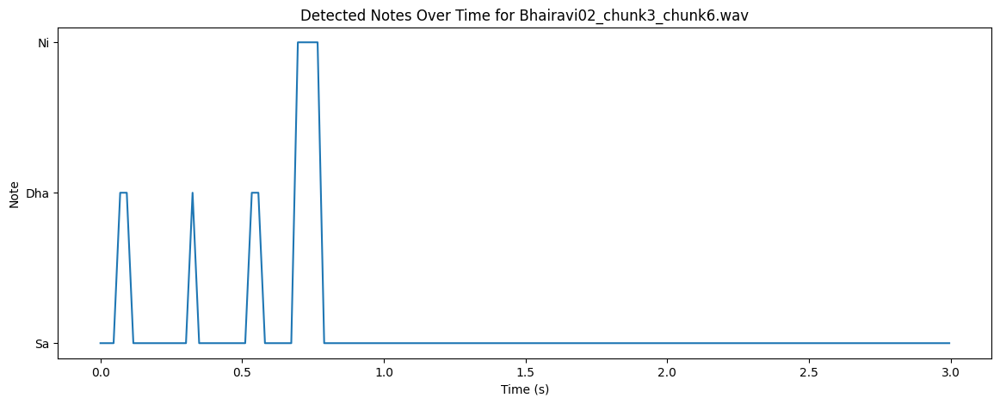

Tonic Frequency for Bhairavi02_chunk3_chunk7.wav: 829.5941162109375 Hz
Detected Notes for Bhairavi02_chunk3_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


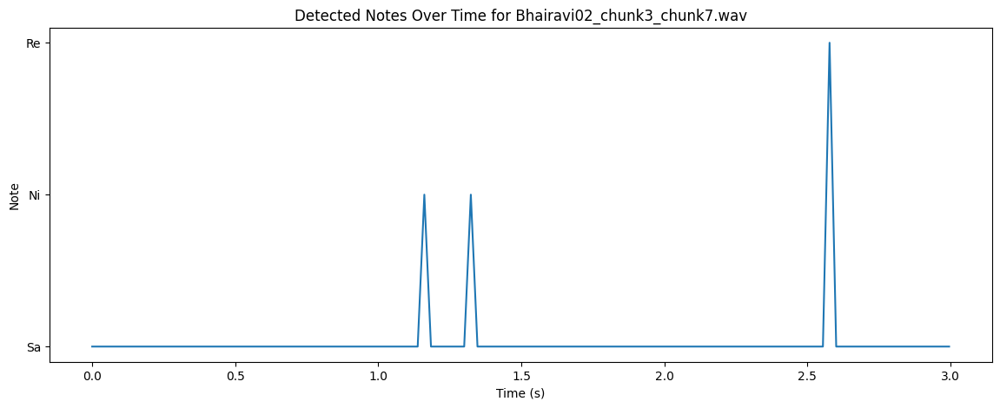

Tonic Frequency for Bhairavi02_chunk3_chunk8.wav: 834.9068603515625 Hz
Detected Notes for Bhairavi02_chunk3_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


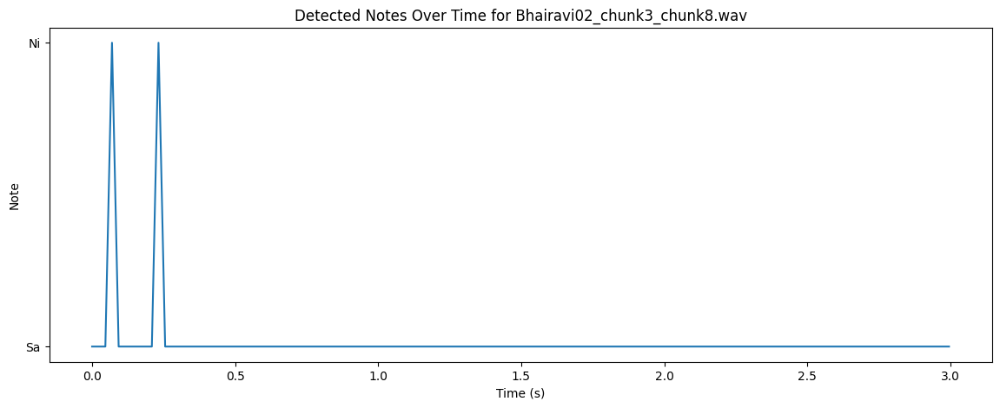

Tonic Frequency for Bhairavi02_chunk3_chunk9.wav: 918.208984375 Hz
Detected Notes for Bhairavi02_chunk3_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


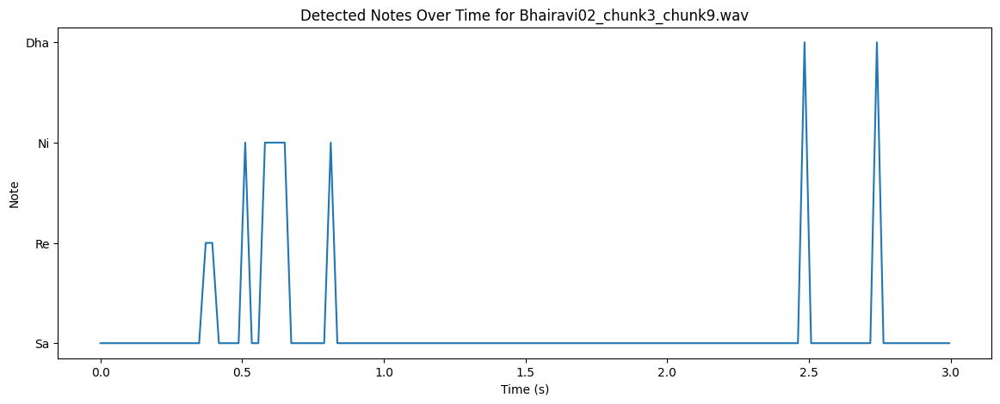

Tonic Frequency for Bhairavi02_chunk3_chunk10.wav: 935.125 Hz
Detected Notes for Bhairavi02_chunk3_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


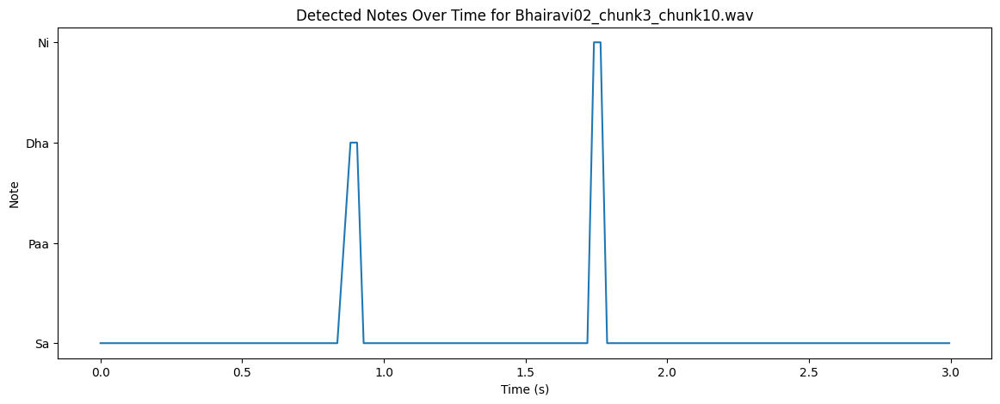

Tonic Frequency for Bhairavi02_chunk4_chunk1.wav: 925.37744140625 Hz
Detected Notes for Bhairavi02_chunk4_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


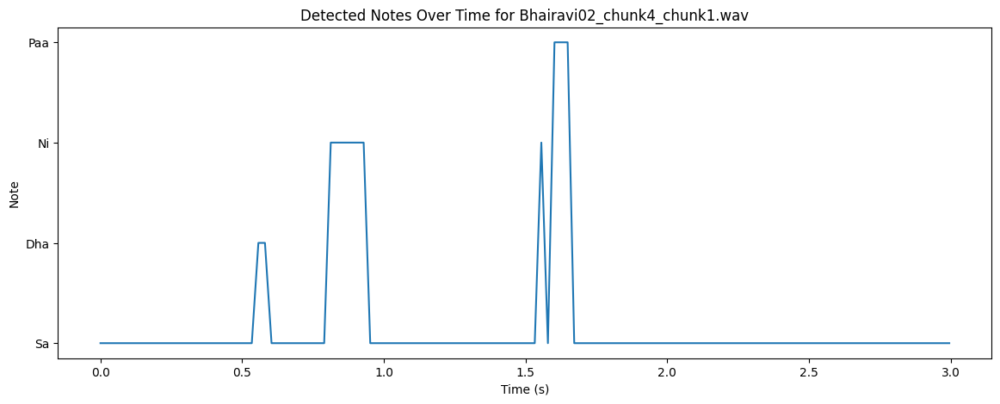

Tonic Frequency for Bhairavi02_chunk4_chunk2.wav: 933.1669921875 Hz
Detected Notes for Bhairavi02_chunk4_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Ni', 'Ni', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


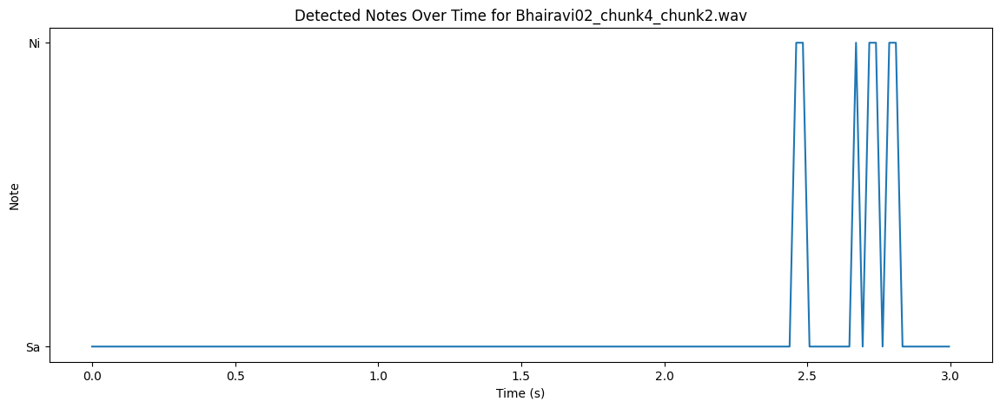

Tonic Frequency for Bhairavi02_chunk4_chunk3.wav: 767.2294311523438 Hz
Detected Notes for Bhairavi02_chunk4_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


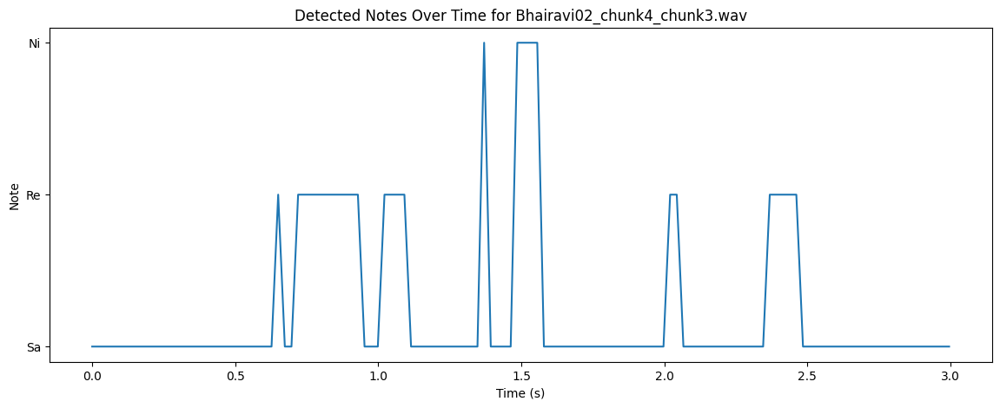

Tonic Frequency for Bhairavi02_chunk4_chunk4.wav: 932.9255981445312 Hz
Detected Notes for Bhairavi02_chunk4_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


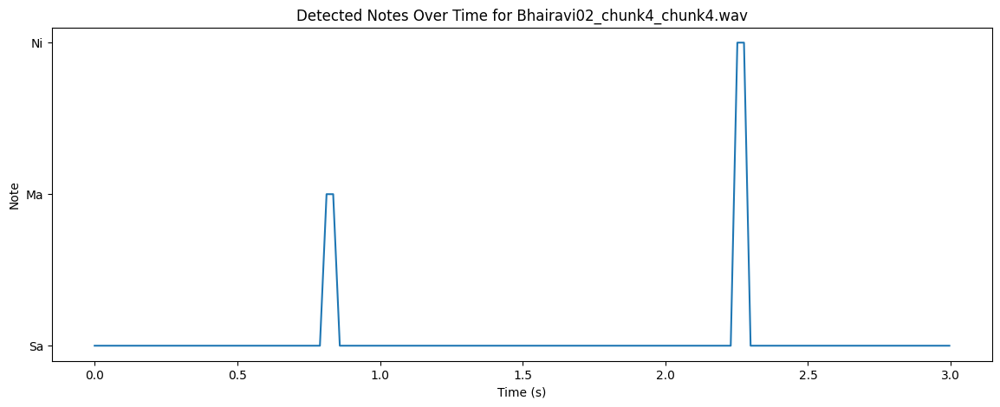

Tonic Frequency for Bhairavi02_chunk4_chunk5.wav: 764.619873046875 Hz
Detected Notes for Bhairavi02_chunk4_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa']


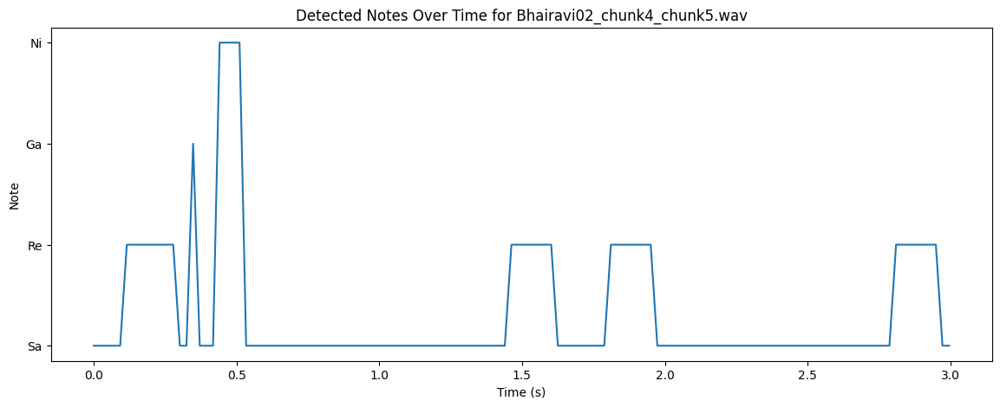

Tonic Frequency for Bhairavi02_chunk4_chunk6.wav: 934.1598510742188 Hz
Detected Notes for Bhairavi02_chunk4_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


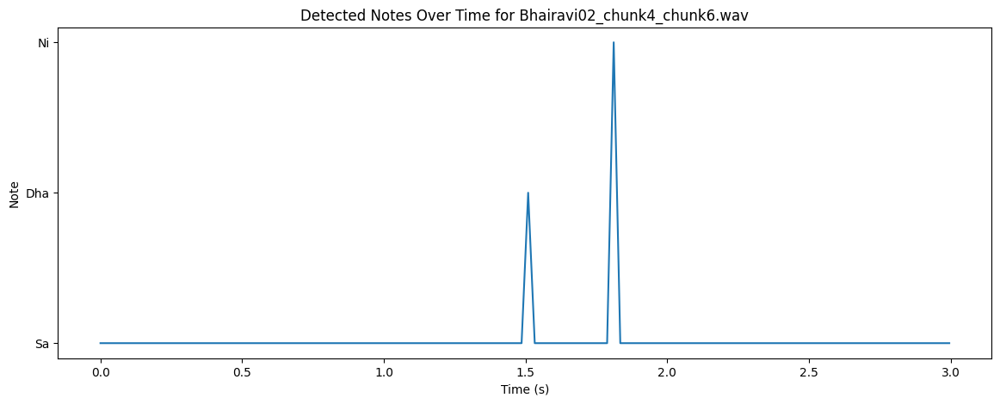

Tonic Frequency for Bhairavi02_chunk4_chunk7.wav: 708.6171875 Hz
Detected Notes for Bhairavi02_chunk4_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


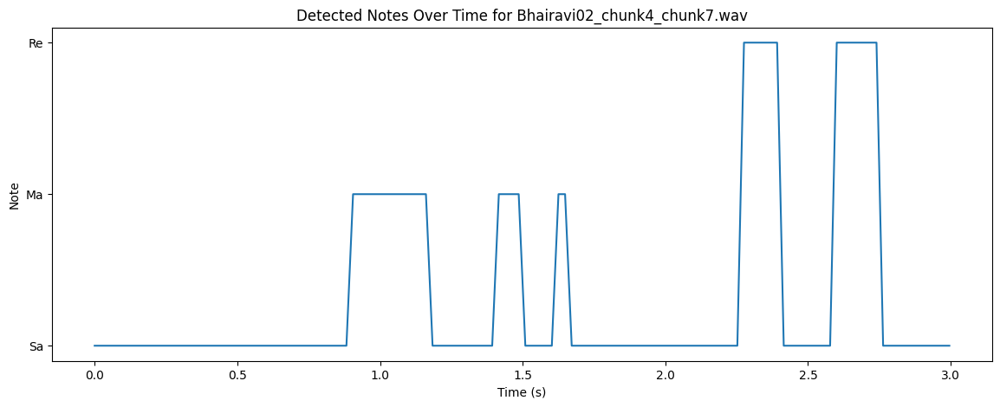

Tonic Frequency for Bhairavi02_chunk4_chunk8.wav: 765.026611328125 Hz
Detected Notes for Bhairavi02_chunk4_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Ga', 'Ga', 'Ga', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


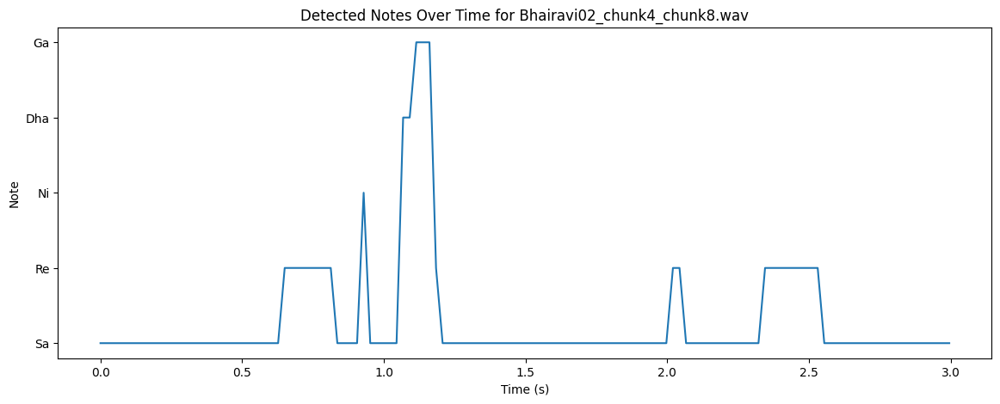

Tonic Frequency for Bhairavi02_chunk4_chunk9.wav: 698.9920654296875 Hz
Detected Notes for Bhairavi02_chunk4_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


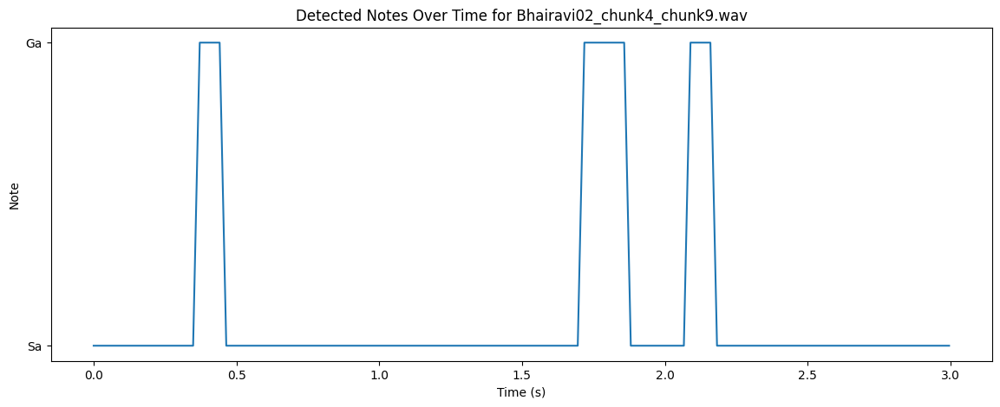

Tonic Frequency for Bhairavi02_chunk4_chunk10.wav: 827.6661376953125 Hz
Detected Notes for Bhairavi02_chunk4_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


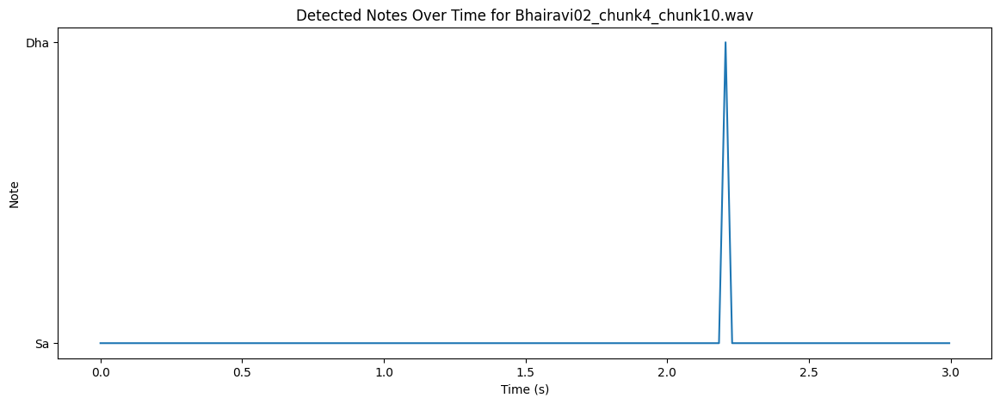

Tonic Frequency for Bhairavi02_chunk5_chunk1.wav: 833.3943481445312 Hz
Detected Notes for Bhairavi02_chunk5_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


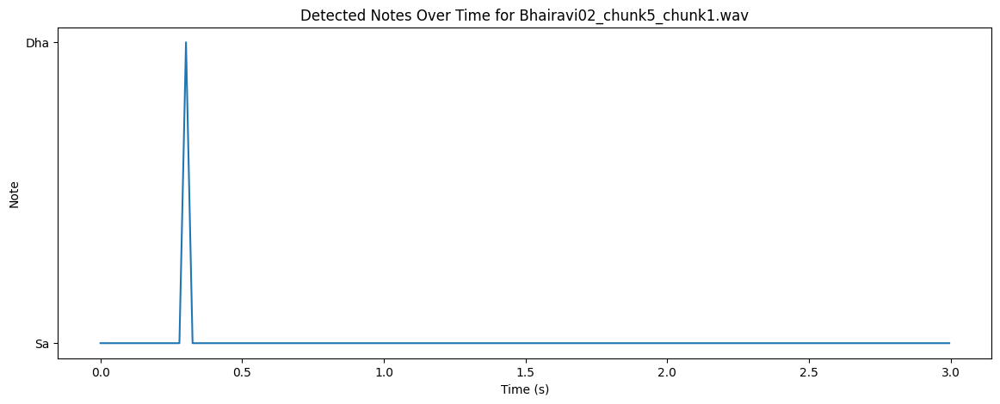

Tonic Frequency for Bhairavi02_chunk5_chunk2.wav: 899.9390869140625 Hz
Detected Notes for Bhairavi02_chunk5_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


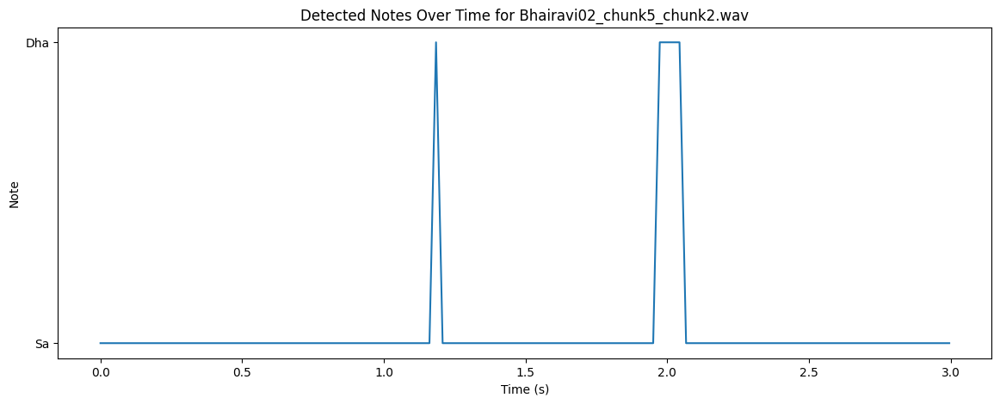

Tonic Frequency for Bhairavi02_chunk5_chunk3.wav: 936.2018432617188 Hz
Detected Notes for Bhairavi02_chunk5_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


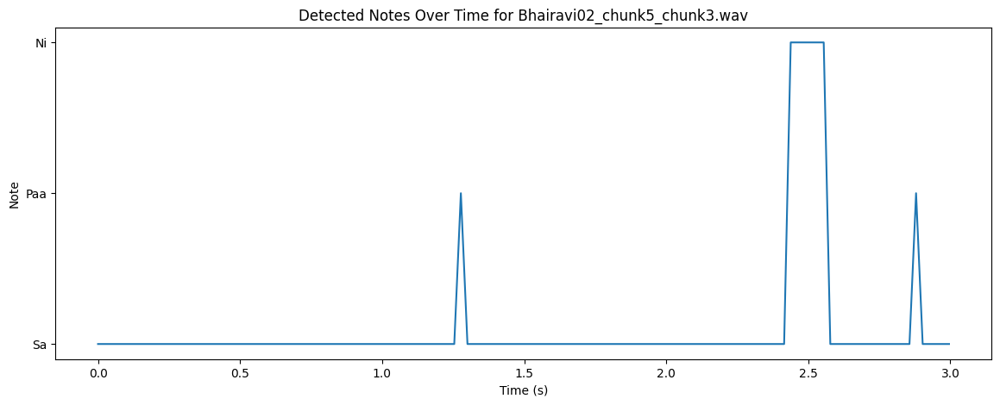

Tonic Frequency for Bhairavi02_chunk5_chunk4.wav: 830.7130737304688 Hz
Detected Notes for Bhairavi02_chunk5_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


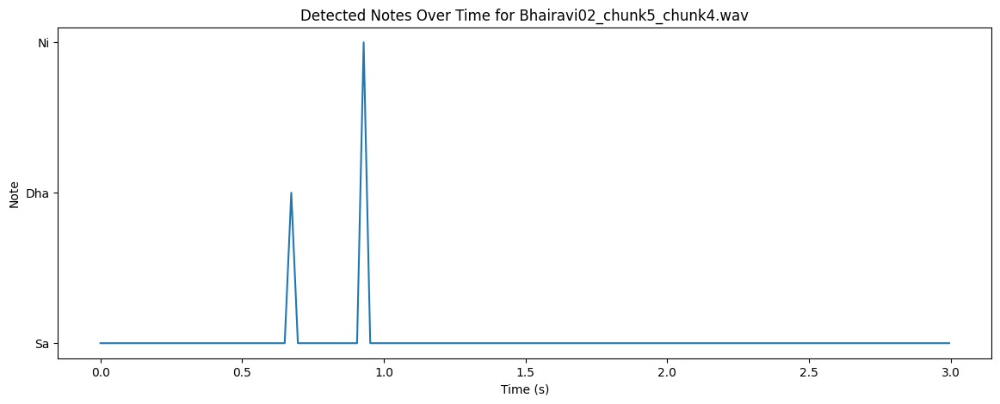

Tonic Frequency for Bhairavi02_chunk5_chunk5.wav: 915.4705810546875 Hz
Detected Notes for Bhairavi02_chunk5_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


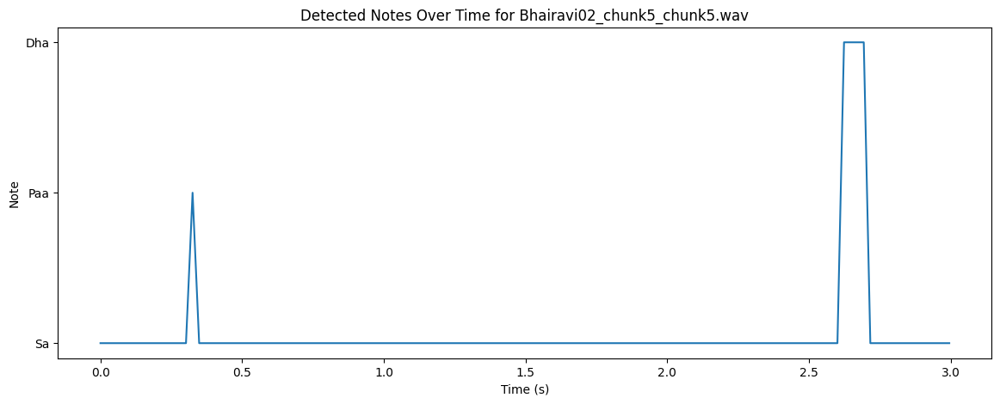

Tonic Frequency for Bhairavi02_chunk5_chunk6.wav: 749.0966796875 Hz
Detected Notes for Bhairavi02_chunk5_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa']


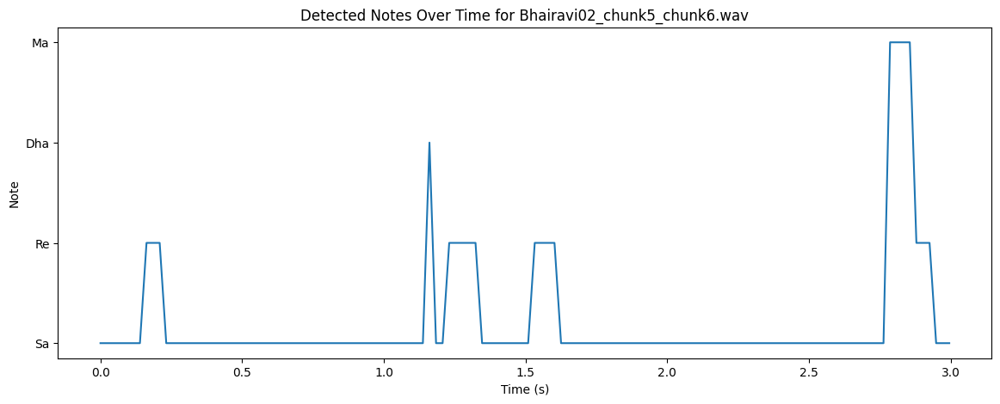

Tonic Frequency for Bhairavi02_chunk5_chunk7.wav: 697.71728515625 Hz
Detected Notes for Bhairavi02_chunk5_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


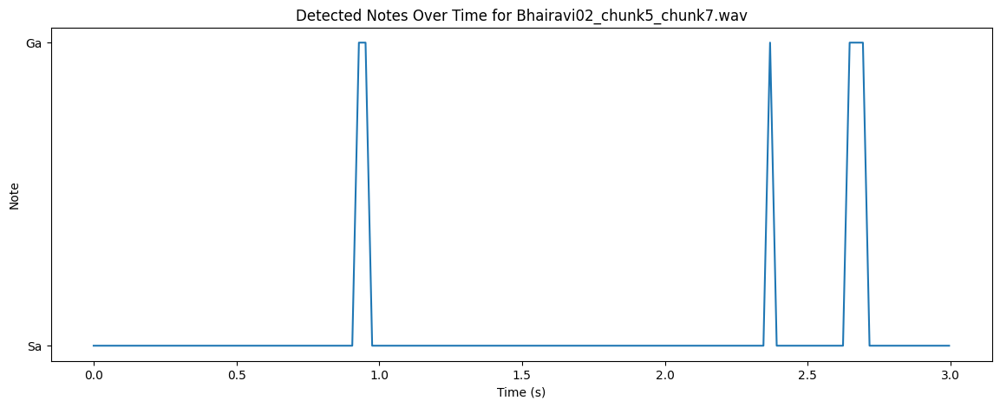

Tonic Frequency for Bhairavi02_chunk5_chunk8.wav: 825.9520263671875 Hz
Detected Notes for Bhairavi02_chunk5_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


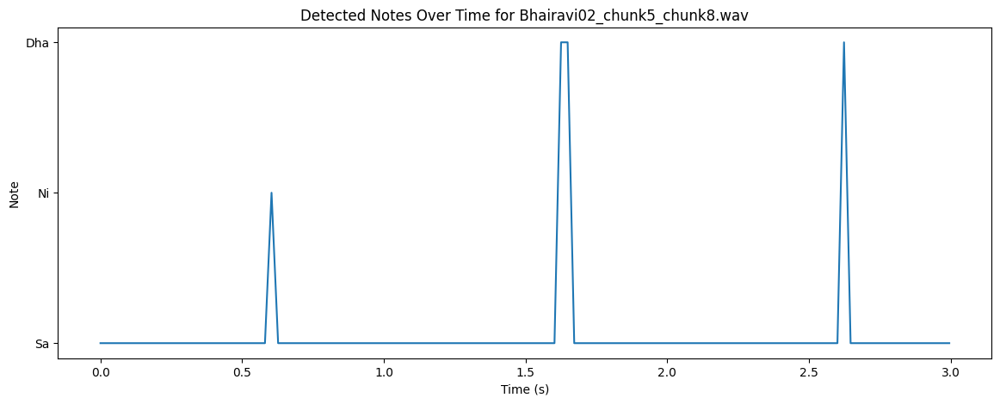

Tonic Frequency for Bhairavi02_chunk5_chunk9.wav: 966.6666259765625 Hz
Detected Notes for Bhairavi02_chunk5_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Ni', 'Ni', 'Ni', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


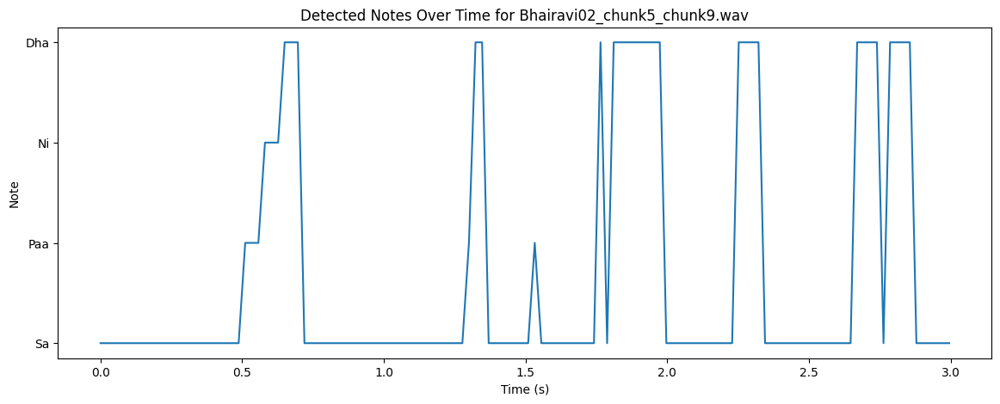

Tonic Frequency for Bhairavi02_chunk5_chunk10.wav: 860.6133422851562 Hz
Detected Notes for Bhairavi02_chunk5_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


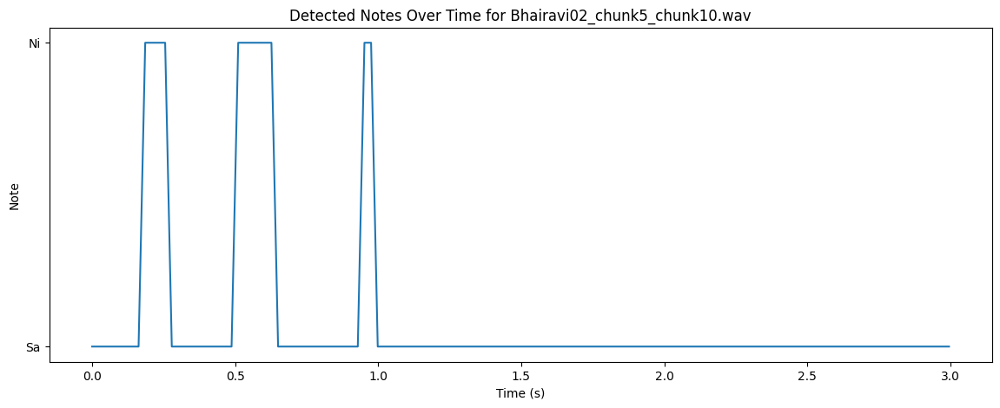

Tonic Frequency for Bhairavi02_chunk6_chunk1.wav: 833.2225341796875 Hz
Detected Notes for Bhairavi02_chunk6_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Ga', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


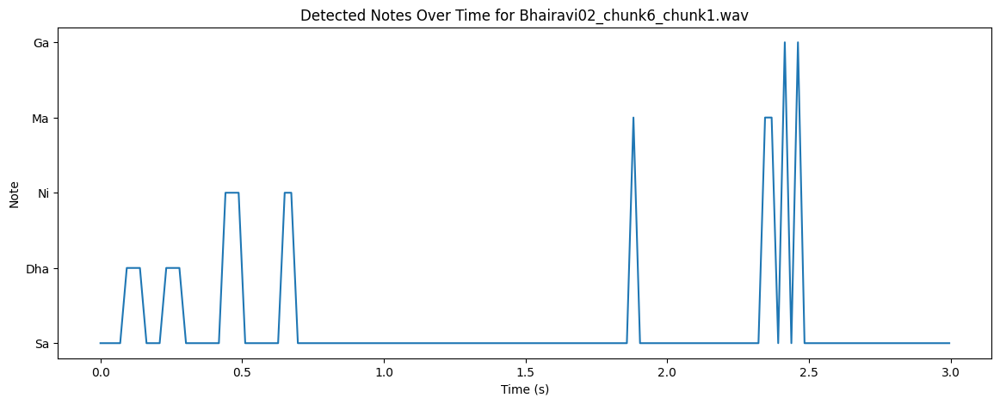

Tonic Frequency for Bhairavi02_chunk6_chunk2.wav: 732.7459106445312 Hz
Detected Notes for Bhairavi02_chunk6_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


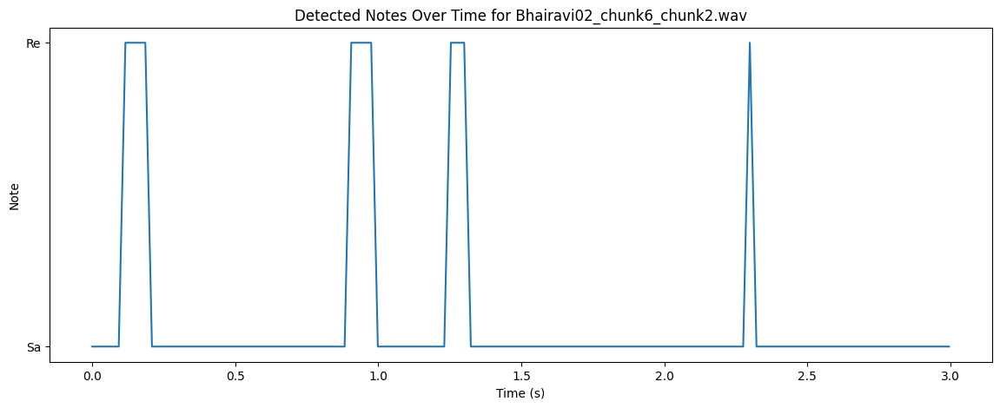

Tonic Frequency for Bhairavi02_chunk6_chunk3.wav: 803.7736206054688 Hz
Detected Notes for Bhairavi02_chunk6_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


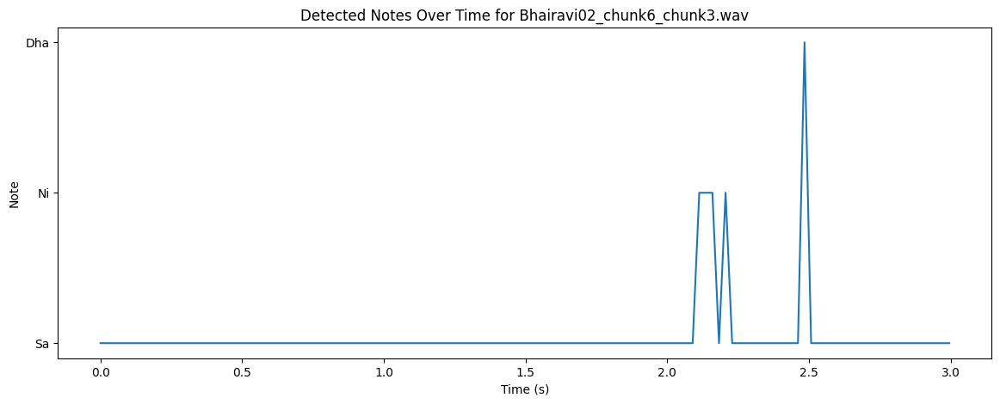

Tonic Frequency for Bhairavi02_chunk6_chunk4.wav: 767.3025512695312 Hz
Detected Notes for Bhairavi02_chunk6_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Dha', 'Dha', 'Dha', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


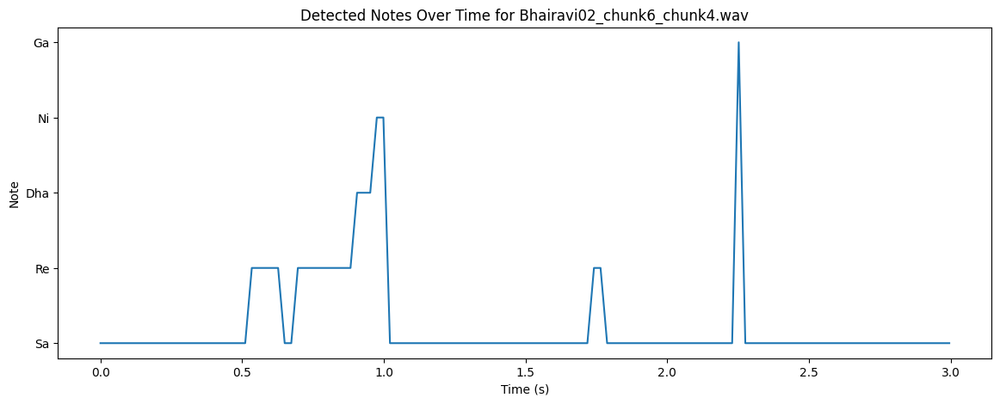

Tonic Frequency for Bhairavi02_chunk6_chunk5.wav: 766.810791015625 Hz
Detected Notes for Bhairavi02_chunk6_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Ga', 'Ga', 'Ga', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa']


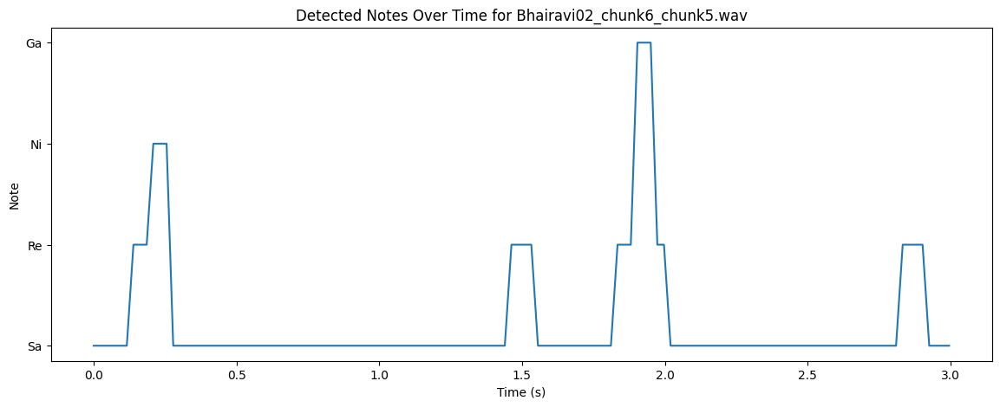

Tonic Frequency for Bhairavi02_chunk6_chunk6.wav: 829.5458984375 Hz
Detected Notes for Bhairavi02_chunk6_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


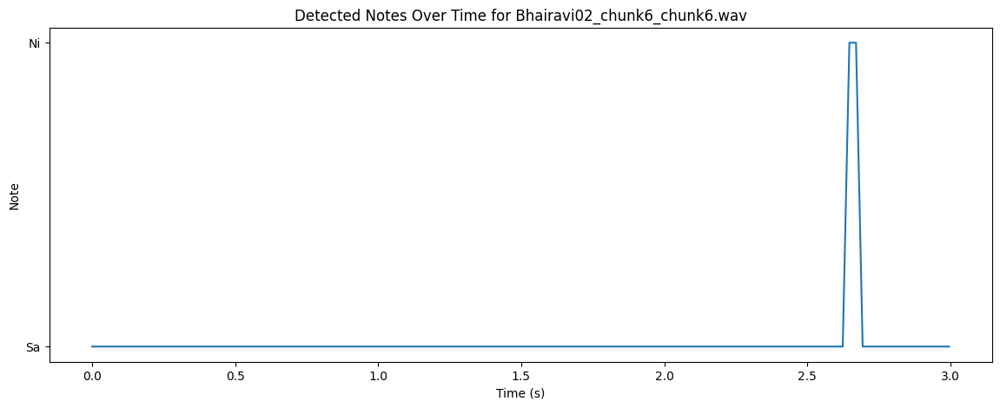

Tonic Frequency for Bhairavi02_chunk6_chunk7.wav: 737.5604858398438 Hz
Detected Notes for Bhairavi02_chunk6_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa']


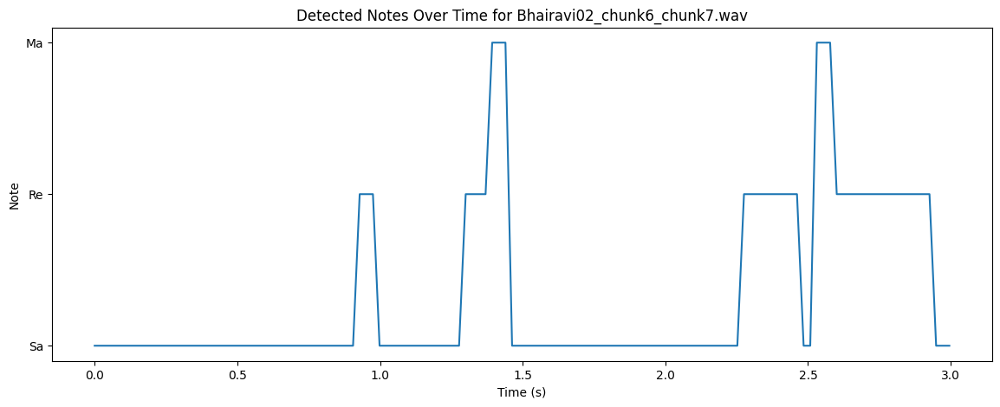

Tonic Frequency for Bhairavi02_chunk6_chunk8.wav: 969.5556030273438 Hz
Detected Notes for Bhairavi02_chunk6_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


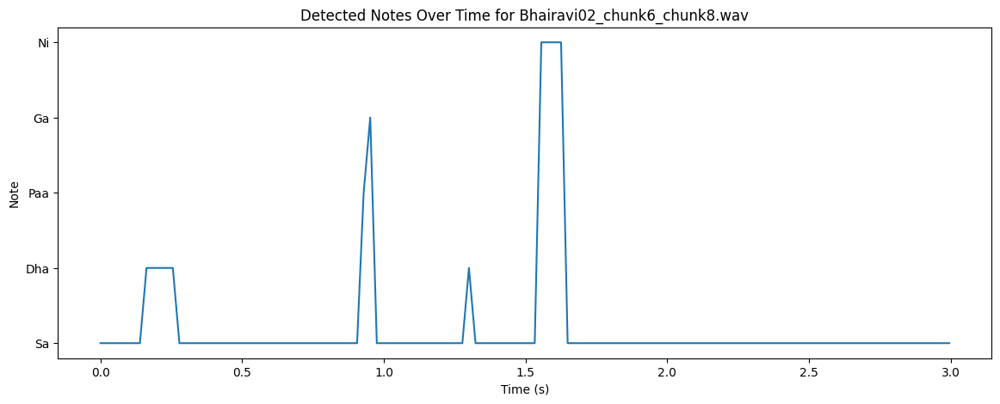

Tonic Frequency for Bhairavi02_chunk6_chunk9.wav: 834.0869140625 Hz
Detected Notes for Bhairavi02_chunk6_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


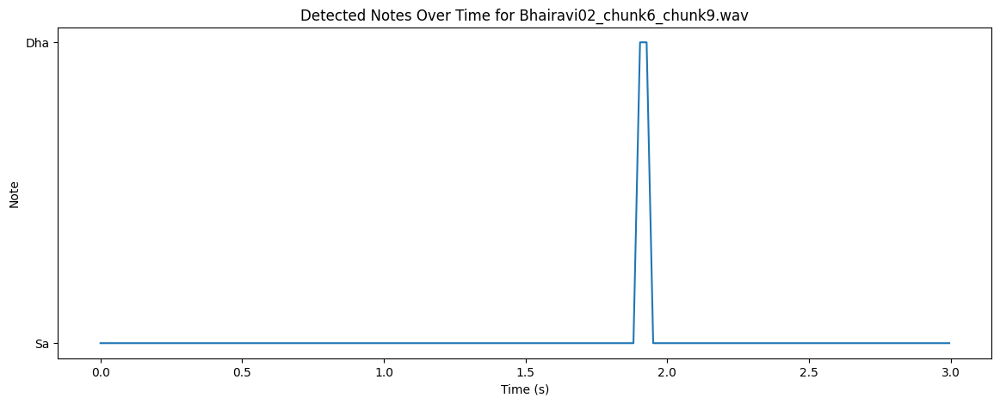

Tonic Frequency for Bhairavi02_chunk6_chunk10.wav: 912.6129150390625 Hz
Detected Notes for Bhairavi02_chunk6_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


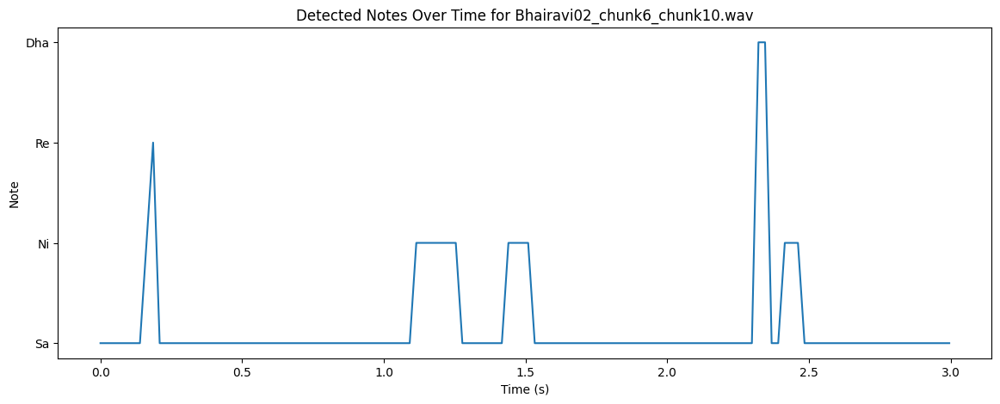

Tonic Frequency for Bhairavi02_chunk7_chunk1.wav: 793.5095825195312 Hz
Detected Notes for Bhairavi02_chunk7_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


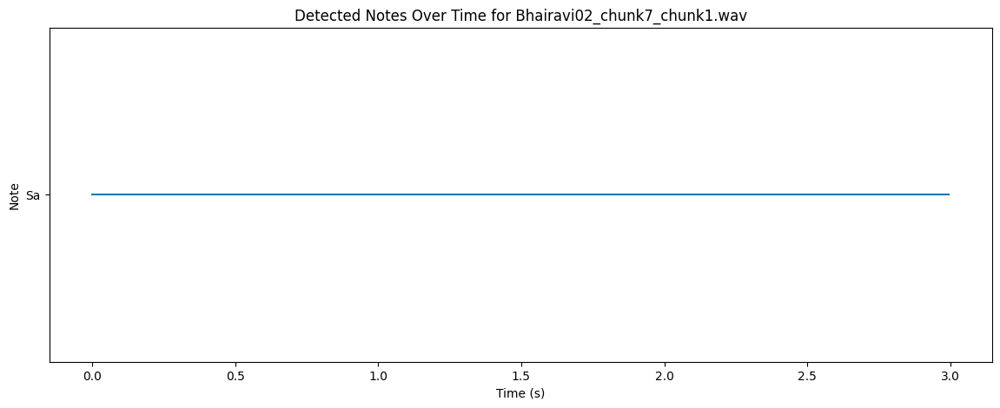

Tonic Frequency for Bhairavi02_chunk7_chunk2.wav: 969.5113525390625 Hz
Detected Notes for Bhairavi02_chunk7_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Ni']


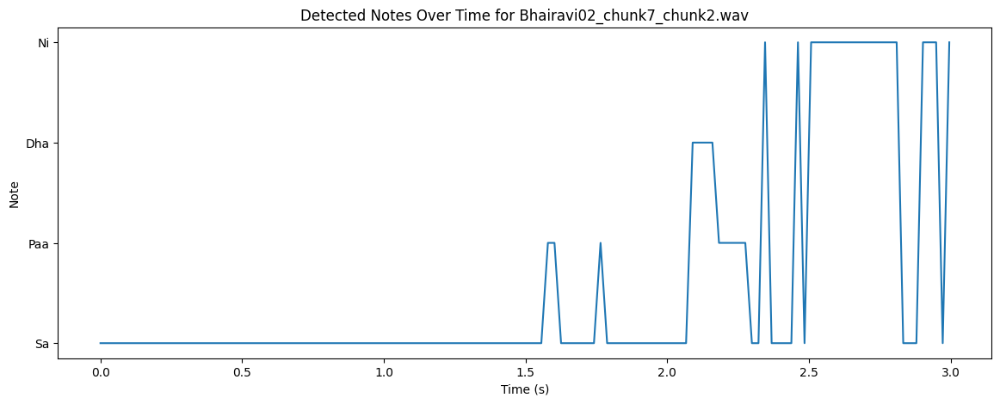

Tonic Frequency for Bhairavi02_chunk7_chunk3.wav: 834.1107788085938 Hz
Detected Notes for Bhairavi02_chunk7_chunk3.wav:  ['Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


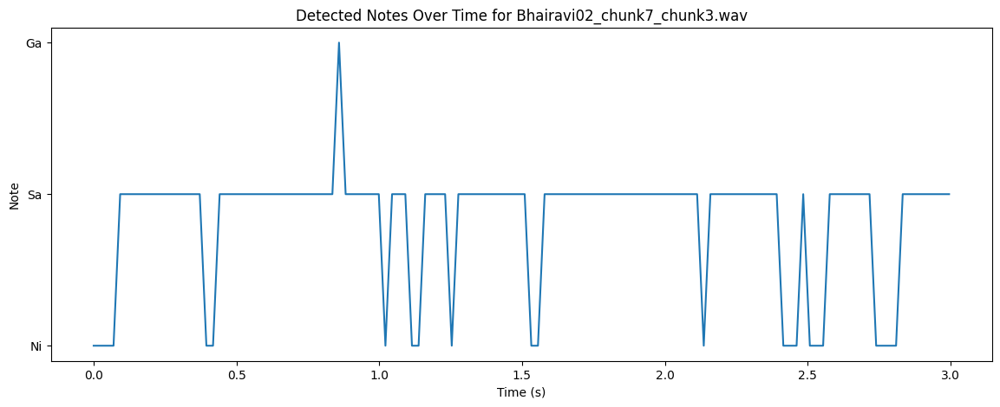

Tonic Frequency for Bhairavi02_chunk7_chunk4.wav: 824.4425659179688 Hz
Detected Notes for Bhairavi02_chunk7_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Ni', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


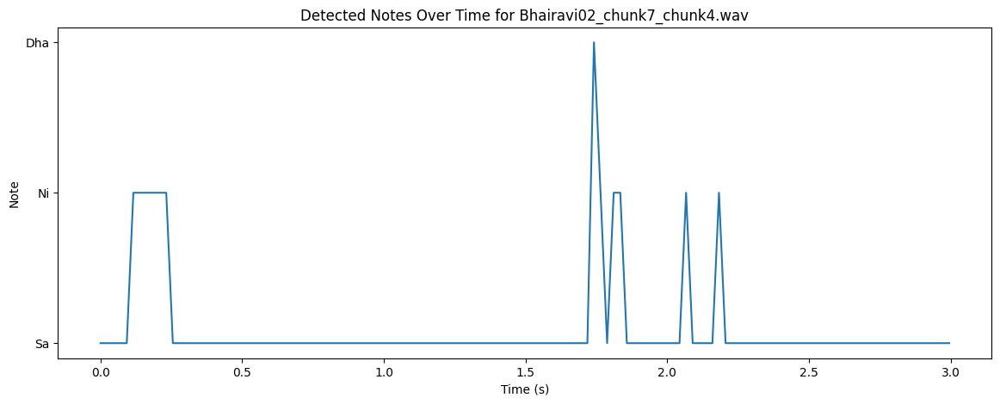

Tonic Frequency for Bhairavi02_chunk7_chunk5.wav: 820.7137451171875 Hz
Detected Notes for Bhairavi02_chunk7_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


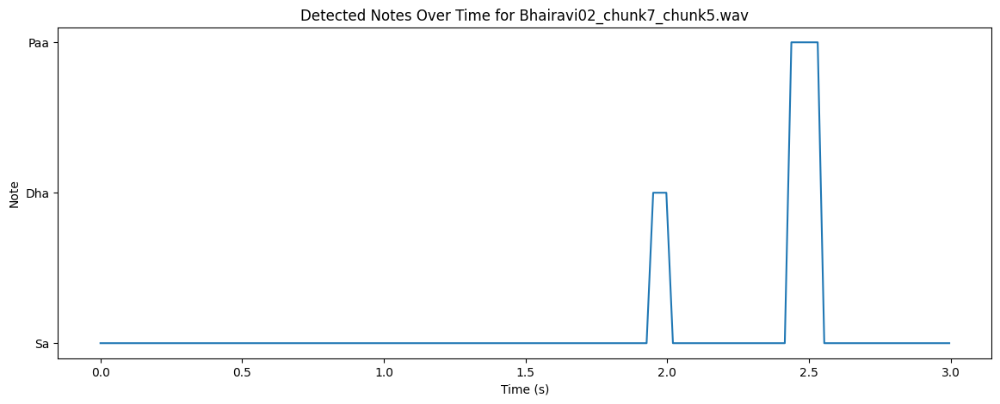

Tonic Frequency for Bhairavi02_chunk7_chunk6.wav: 833.802978515625 Hz
Detected Notes for Bhairavi02_chunk7_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Re', 'Sa', 'Ni', 'Ni', 'Sa', 'Re', 'Re', 'Ga', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


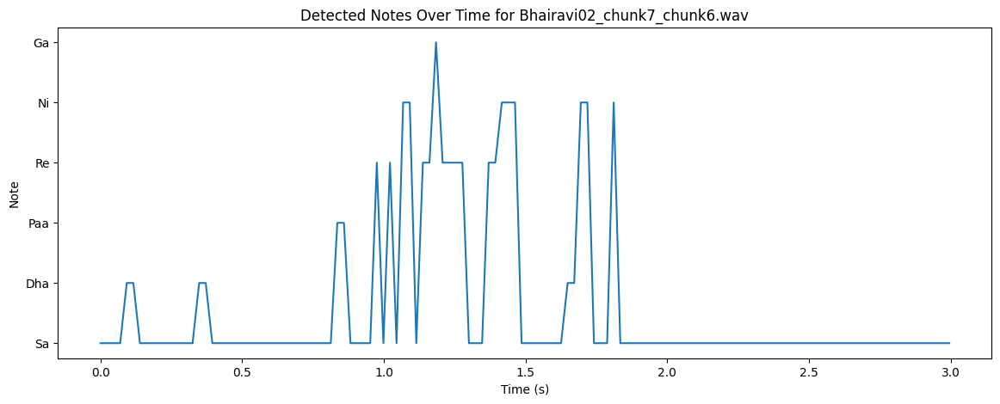

Tonic Frequency for Bhairavi02_chunk7_chunk7.wav: 749.3156127929688 Hz
Detected Notes for Bhairavi02_chunk7_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


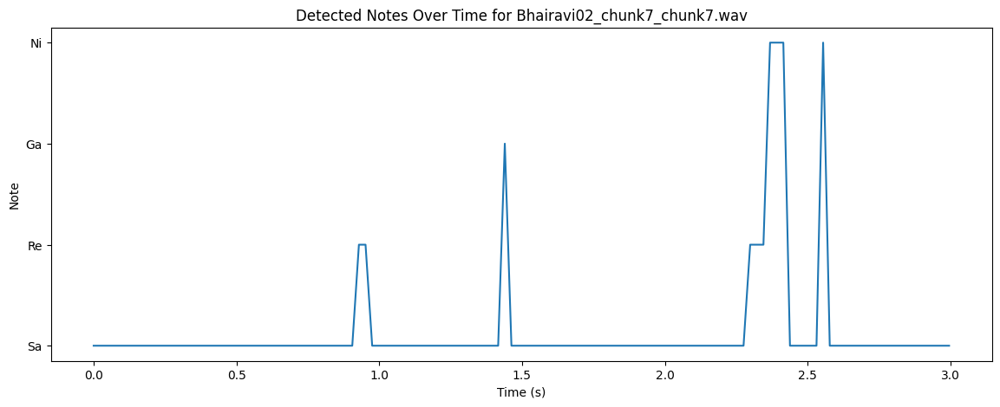

Tonic Frequency for Bhairavi02_chunk7_chunk8.wav: 830.9407958984375 Hz
Detected Notes for Bhairavi02_chunk7_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


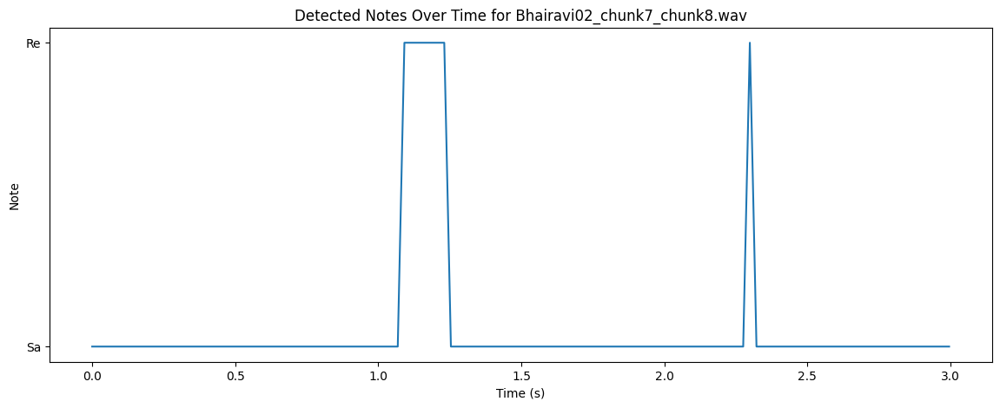

Tonic Frequency for Bhairavi02_chunk7_chunk9.wav: 692.401611328125 Hz
Detected Notes for Bhairavi02_chunk7_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


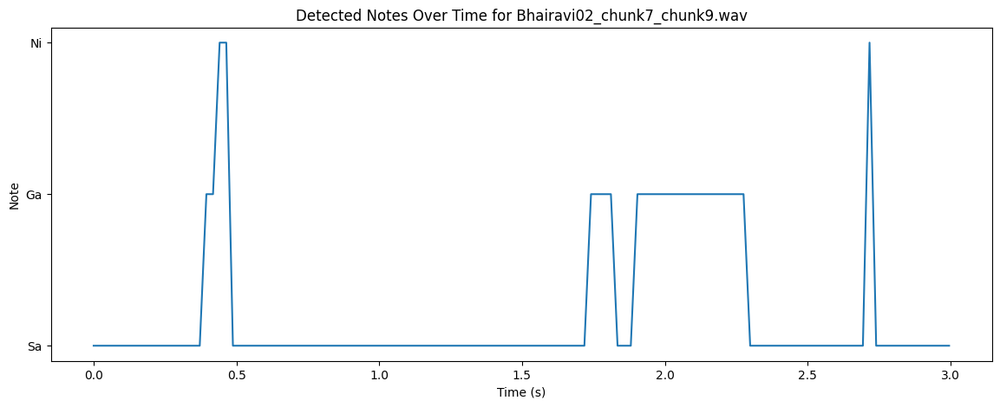

Tonic Frequency for Bhairavi02_chunk7_chunk10.wav: 833.975341796875 Hz
Detected Notes for Bhairavi02_chunk7_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa']


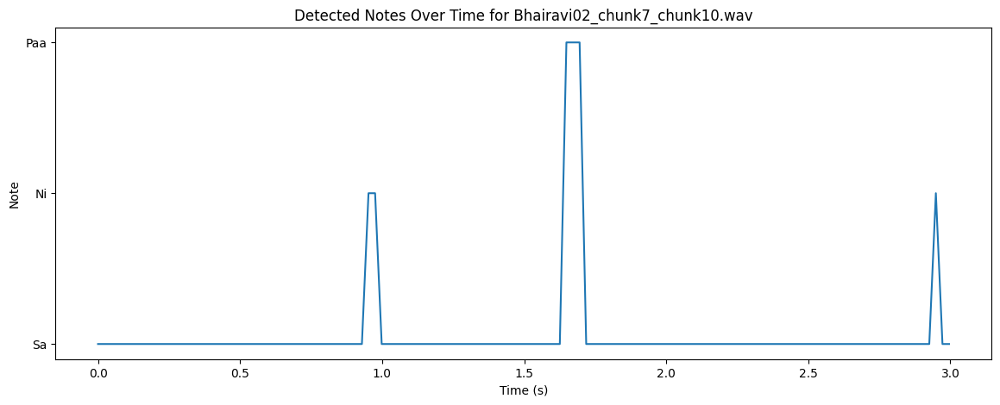

Tonic Frequency for Bhairavi02_chunk8_chunk1.wav: 723.796142578125 Hz
Detected Notes for Bhairavi02_chunk8_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re']


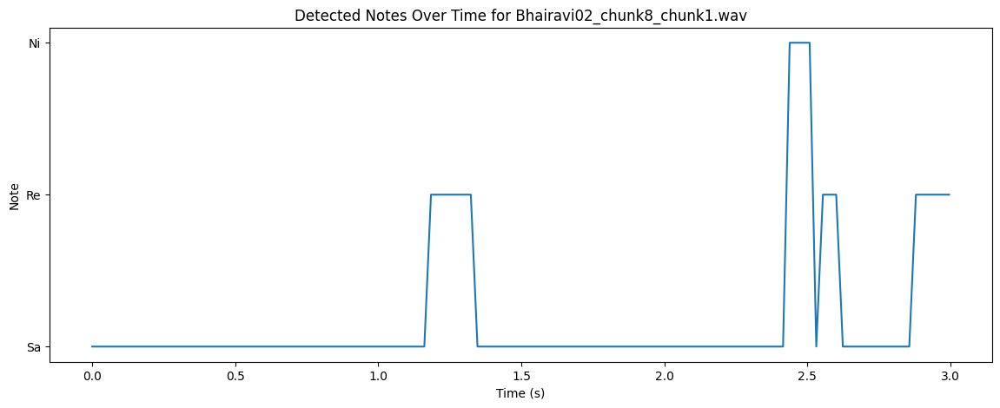

Tonic Frequency for Bhairavi02_chunk8_chunk2.wav: 816.7327880859375 Hz
Detected Notes for Bhairavi02_chunk8_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


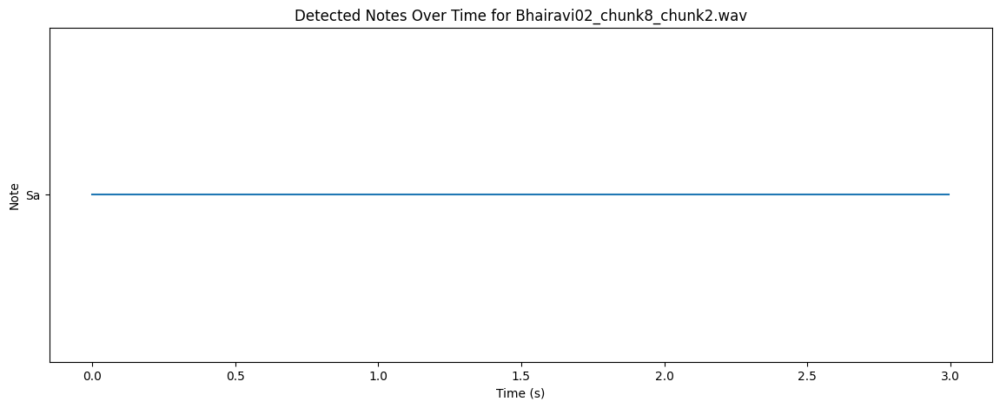

Tonic Frequency for Bhairavi02_chunk8_chunk3.wav: 912.295166015625 Hz
Detected Notes for Bhairavi02_chunk8_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


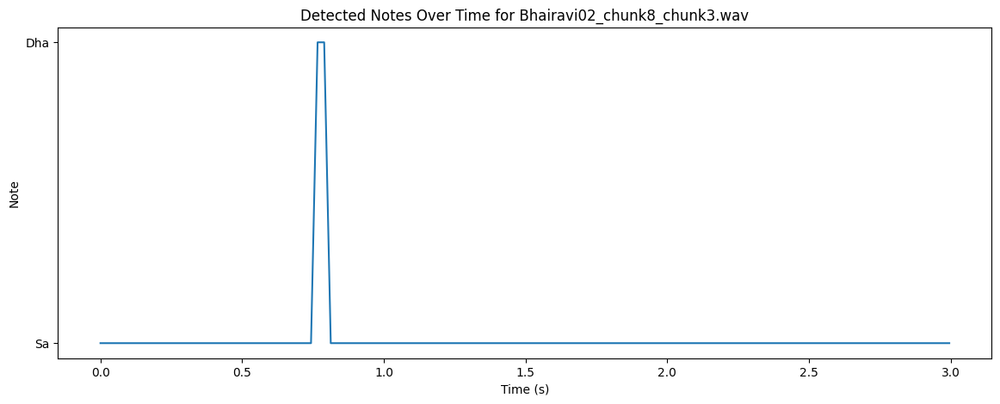

Tonic Frequency for Bhairavi02_chunk8_chunk4.wav: 947.66455078125 Hz
Detected Notes for Bhairavi02_chunk8_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


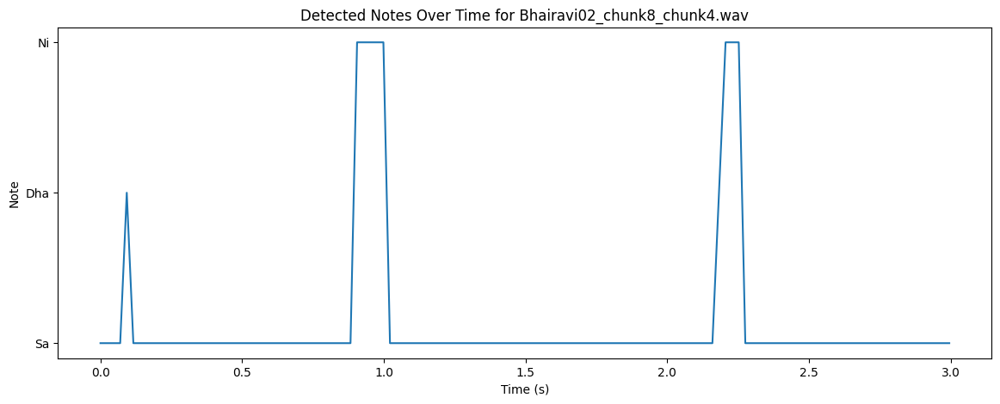

Tonic Frequency for Bhairavi02_chunk8_chunk5.wav: 834.6915893554688 Hz
Detected Notes for Bhairavi02_chunk8_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


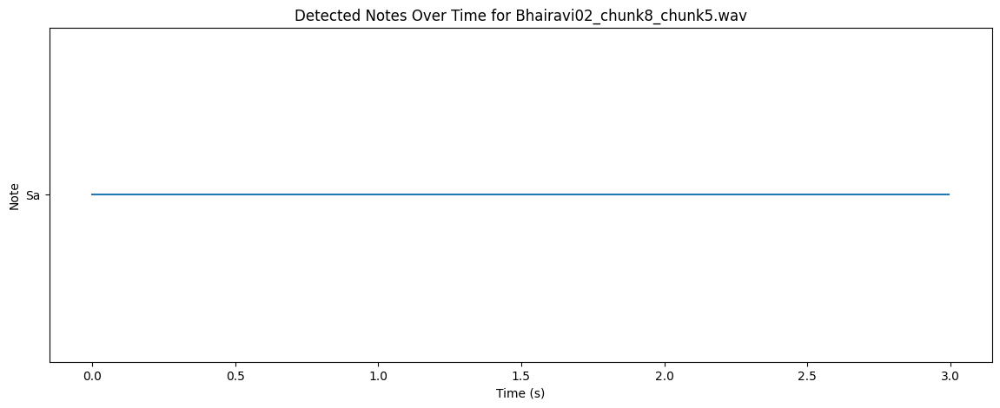

Tonic Frequency for Bhairavi02_chunk8_chunk6.wav: 935.9736328125 Hz
Detected Notes for Bhairavi02_chunk8_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


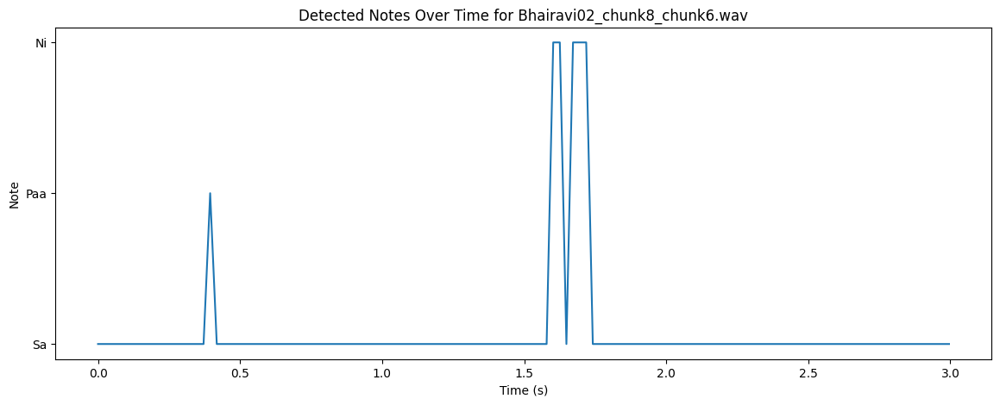

Tonic Frequency for Bhairavi02_chunk8_chunk7.wav: 731.45751953125 Hz
Detected Notes for Bhairavi02_chunk8_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


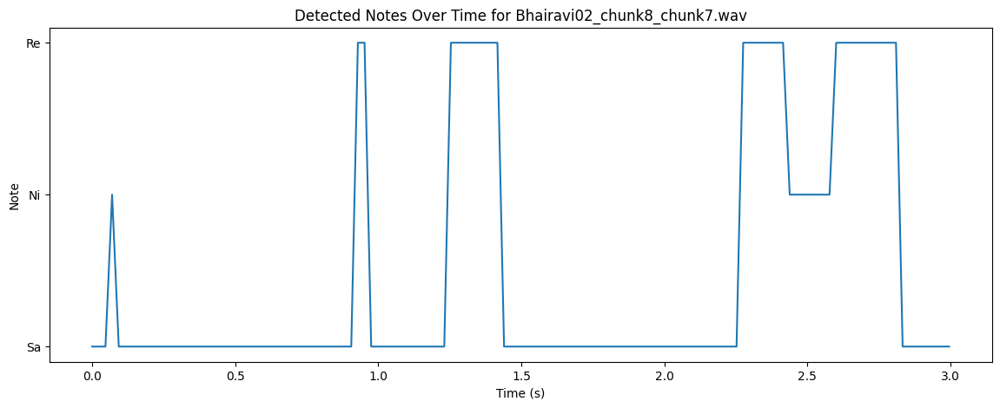

Tonic Frequency for Bhairavi02_chunk8_chunk8.wav: 934.8331298828125 Hz
Detected Notes for Bhairavi02_chunk8_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


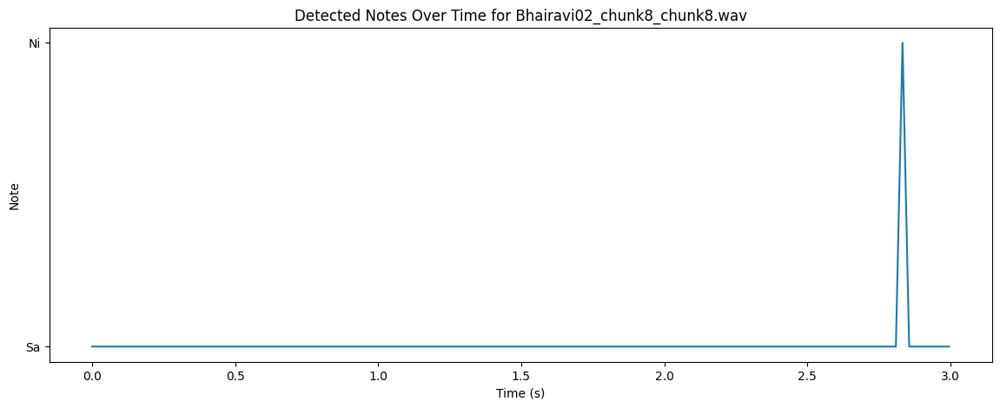

Tonic Frequency for Bhairavi02_chunk8_chunk9.wav: 830.8900756835938 Hz
Detected Notes for Bhairavi02_chunk8_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


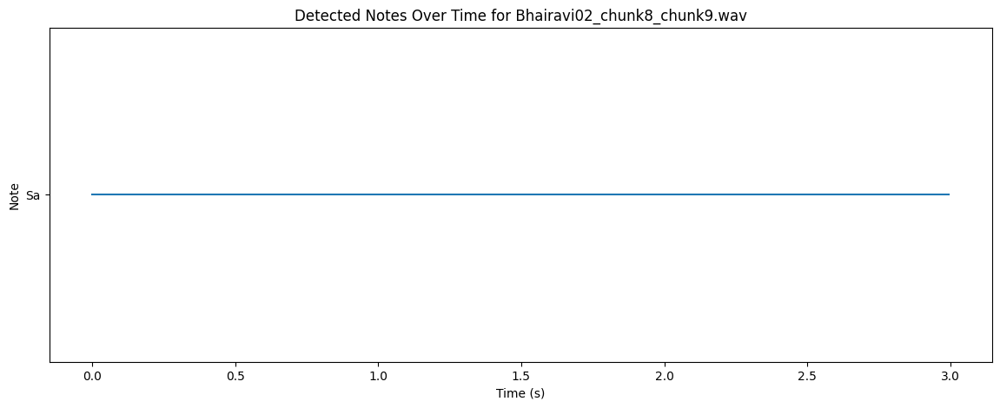

Tonic Frequency for Bhairavi02_chunk8_chunk10.wav: 933.7838745117188 Hz
Detected Notes for Bhairavi02_chunk8_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa']


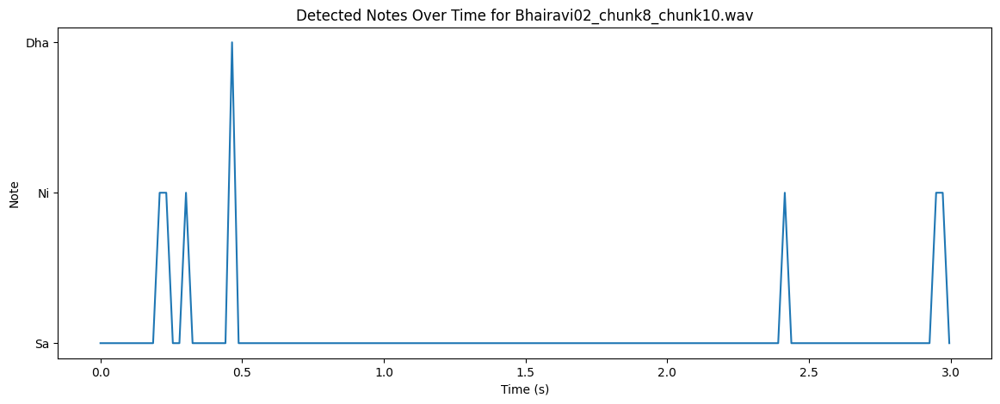

Tonic Frequency for Bhairavi02_chunk9_chunk1.wav: 838.8231811523438 Hz
Detected Notes for Bhairavi02_chunk9_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


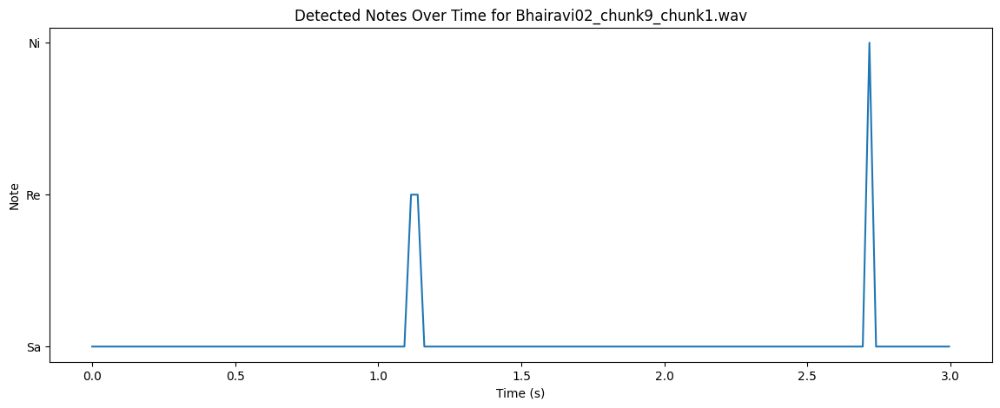

Tonic Frequency for Bhairavi02_chunk9_chunk2.wav: 833.5942993164062 Hz
Detected Notes for Bhairavi02_chunk9_chunk2.wav:  ['Sa', 'Sa', 'Re', 'Re', 'Ni', 'Dha', 'Dha', 'Dha', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


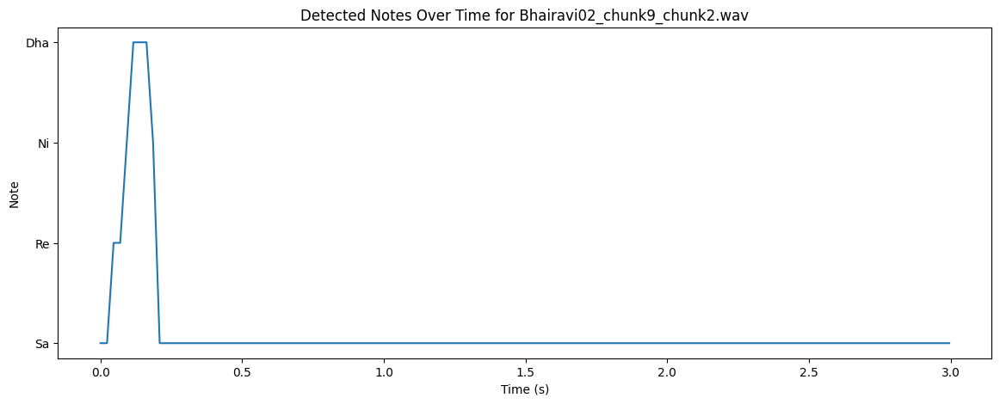

Tonic Frequency for Bhairavi02_chunk9_chunk3.wav: 862.20849609375 Hz
Detected Notes for Bhairavi02_chunk9_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


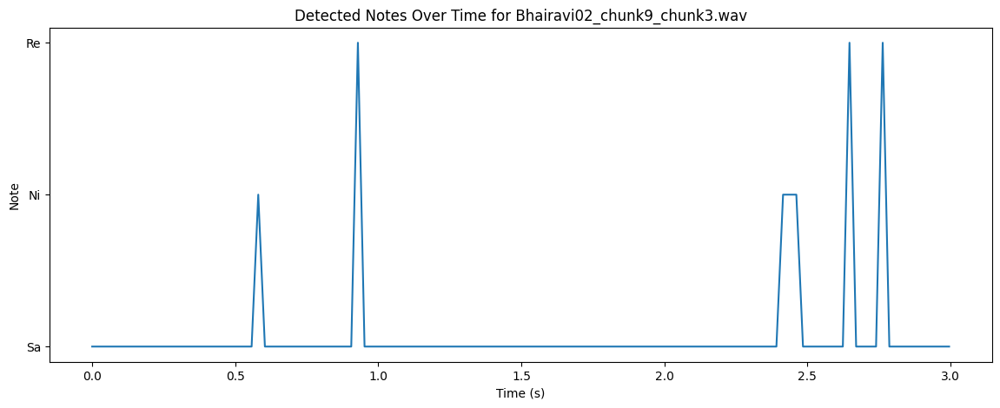

Tonic Frequency for Bhairavi02_chunk9_chunk4.wav: 837.0634765625 Hz
Detected Notes for Bhairavi02_chunk9_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


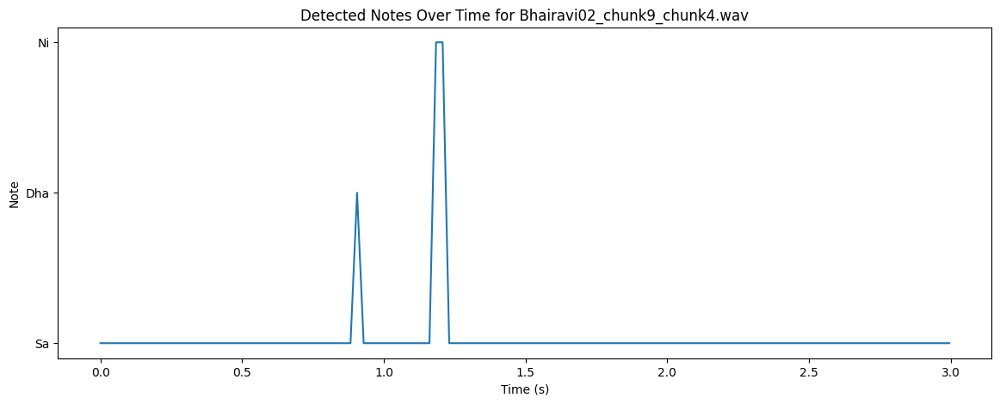

Tonic Frequency for Bhairavi02_chunk9_chunk5.wav: 881.294189453125 Hz
Detected Notes for Bhairavi02_chunk9_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


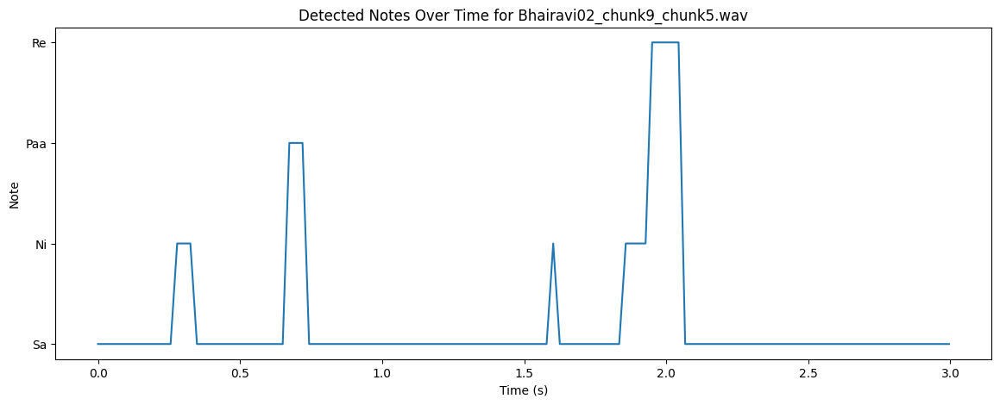

Tonic Frequency for Bhairavi02_chunk9_chunk6.wav: 936.570068359375 Hz
Detected Notes for Bhairavi02_chunk9_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


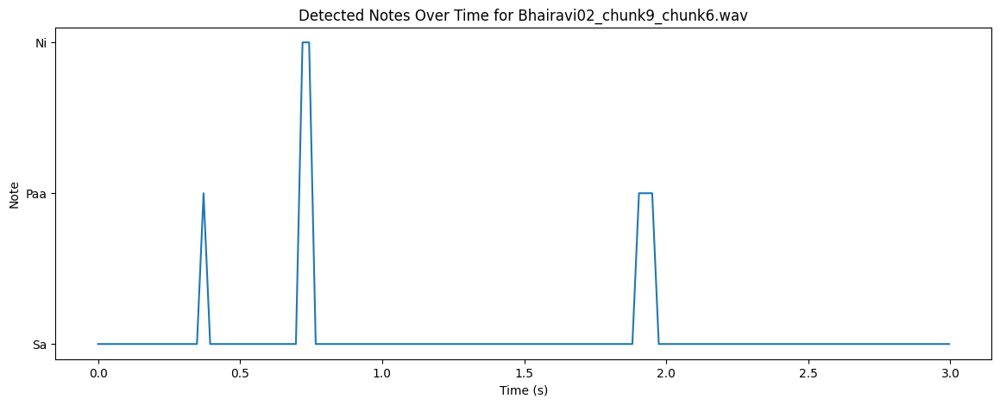

Tonic Frequency for Bhairavi02_chunk9_chunk7.wav: 965.0982666015625 Hz
Detected Notes for Bhairavi02_chunk9_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


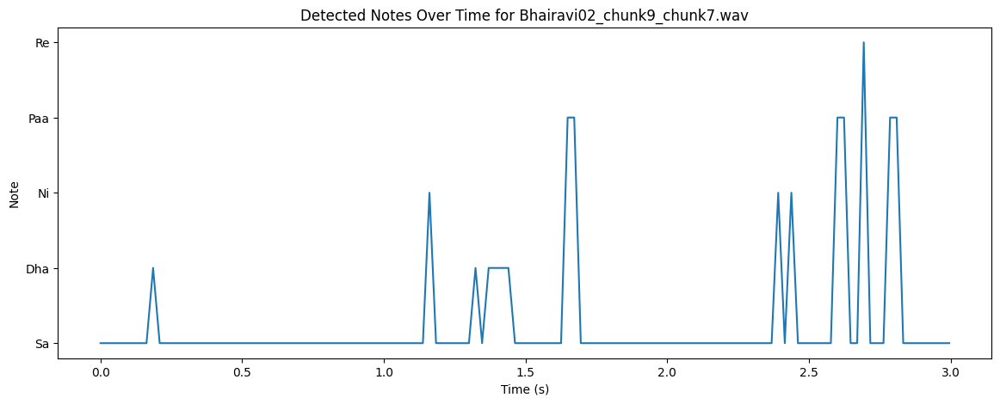

Tonic Frequency for Bhairavi02_chunk9_chunk8.wav: 1143.431640625 Hz
Detected Notes for Bhairavi02_chunk9_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


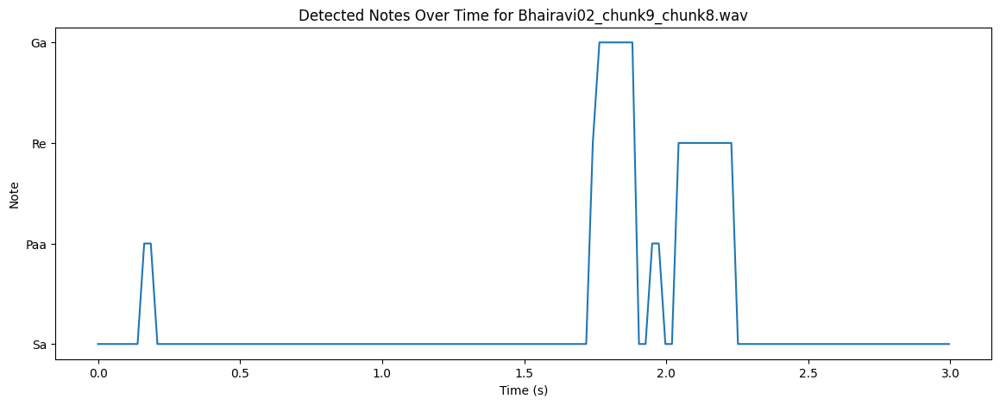

Tonic Frequency for Bhairavi02_chunk9_chunk9.wav: 937.9825439453125 Hz
Detected Notes for Bhairavi02_chunk9_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


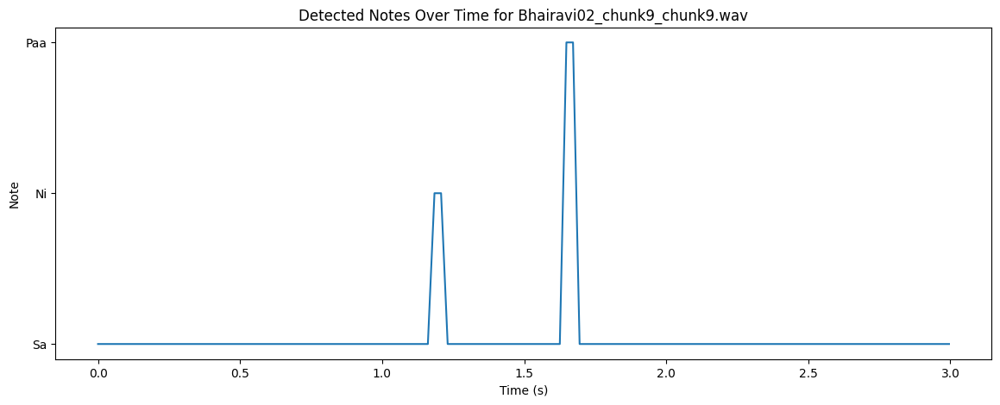

Tonic Frequency for Bhairavi02_chunk9_chunk10.wav: 970.5169677734375 Hz
Detected Notes for Bhairavi02_chunk9_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


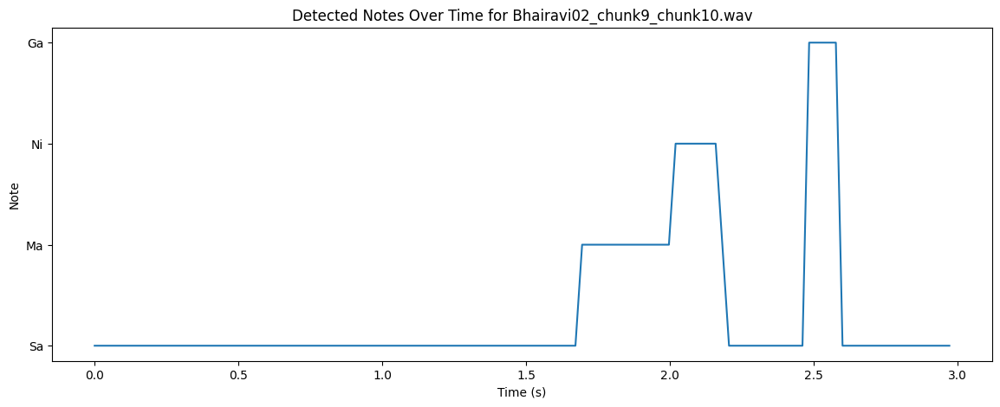

Tonic Frequency for Bhairavi04_chunk1_chunk1.wav: 1039.76953125 Hz
Detected Notes for Bhairavi04_chunk1_chunk1.wav:  ['Ni', 'Ni', 'Ni', 'Ni', 'Re', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Ma', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


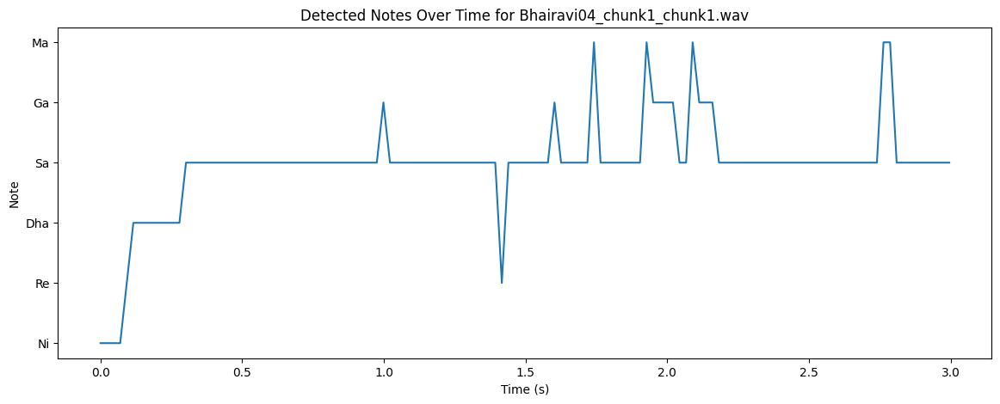

Tonic Frequency for Bhairavi04_chunk1_chunk2.wav: 964.5770263671875 Hz
Detected Notes for Bhairavi04_chunk1_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


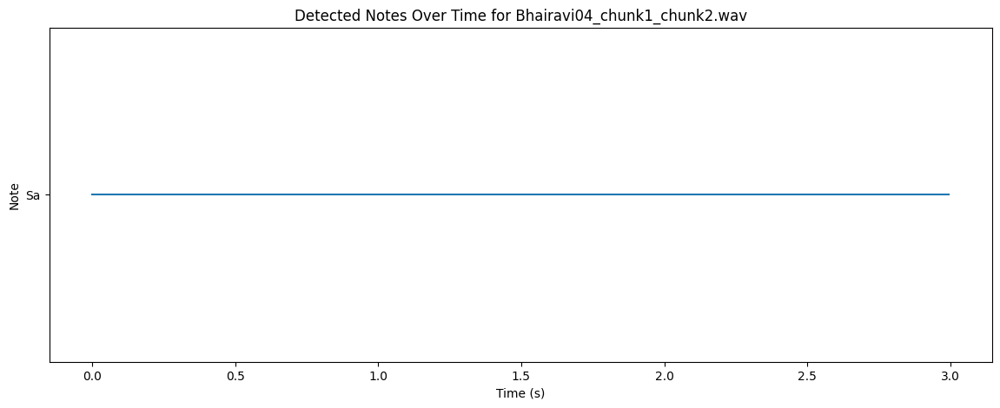

Tonic Frequency for Bhairavi04_chunk1_chunk3.wav: 1245.415771484375 Hz
Detected Notes for Bhairavi04_chunk1_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


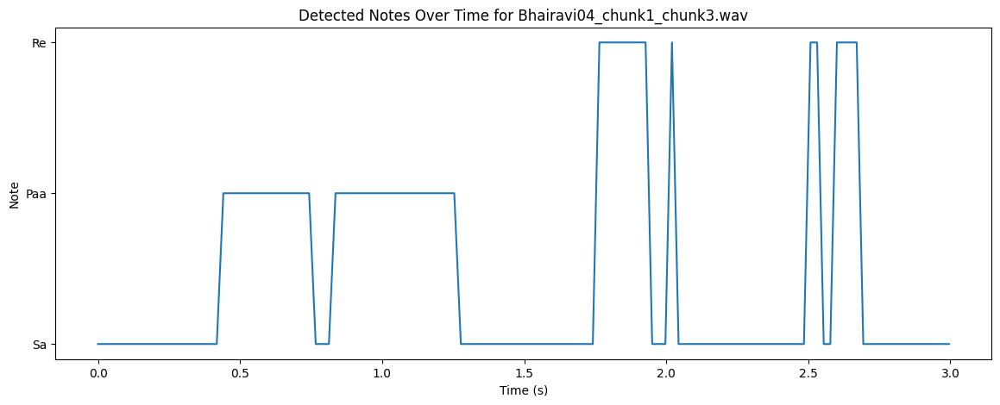

Tonic Frequency for Bhairavi04_chunk1_chunk4.wav: 1121.4437255859375 Hz
Detected Notes for Bhairavi04_chunk1_chunk4.wav:  ['Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Re', 'Re', 'Re', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Ga', 'Ga', 'Re', 'Re', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa']


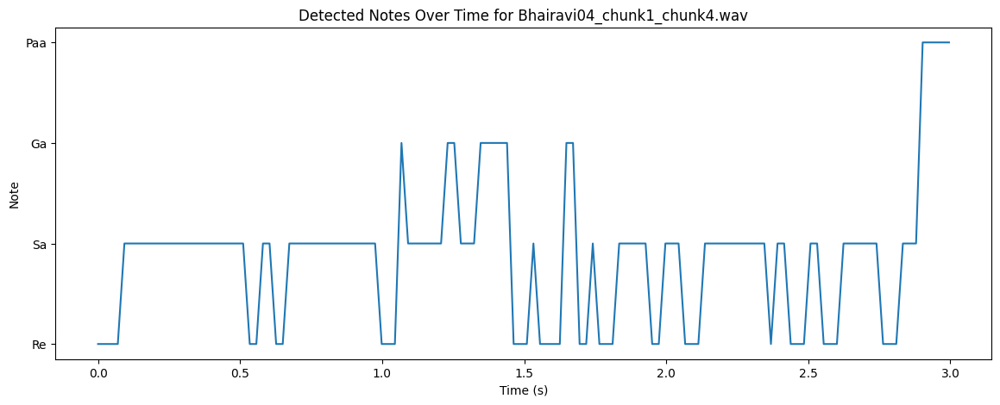

Tonic Frequency for Bhairavi04_chunk1_chunk5.wav: 1032.07080078125 Hz
Detected Notes for Bhairavi04_chunk1_chunk5.wav:  ['Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


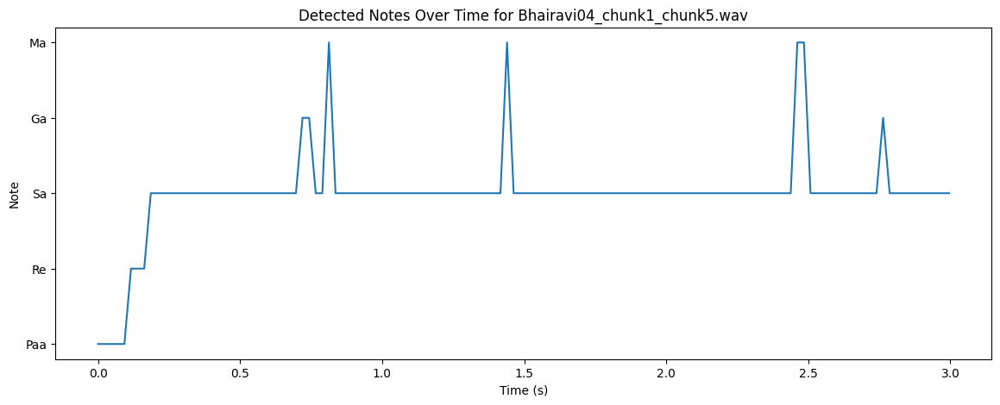

Tonic Frequency for Bhairavi04_chunk1_chunk6.wav: 1040.9774169921875 Hz
Detected Notes for Bhairavi04_chunk1_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Dha', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


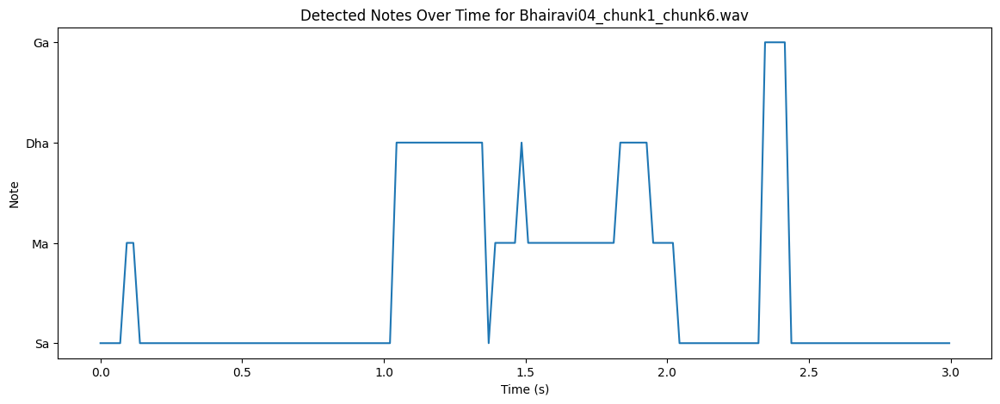

Tonic Frequency for Bhairavi04_chunk1_chunk7.wav: 1118.5360107421875 Hz
Detected Notes for Bhairavi04_chunk1_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Ga', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


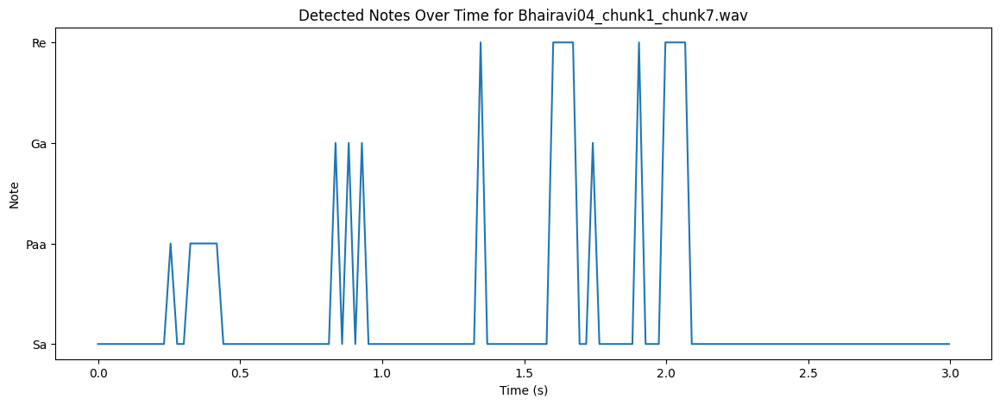

Tonic Frequency for Bhairavi04_chunk1_chunk8.wav: 1142.386962890625 Hz
Detected Notes for Bhairavi04_chunk1_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Paa', 'Paa', 'Paa', 'Paa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


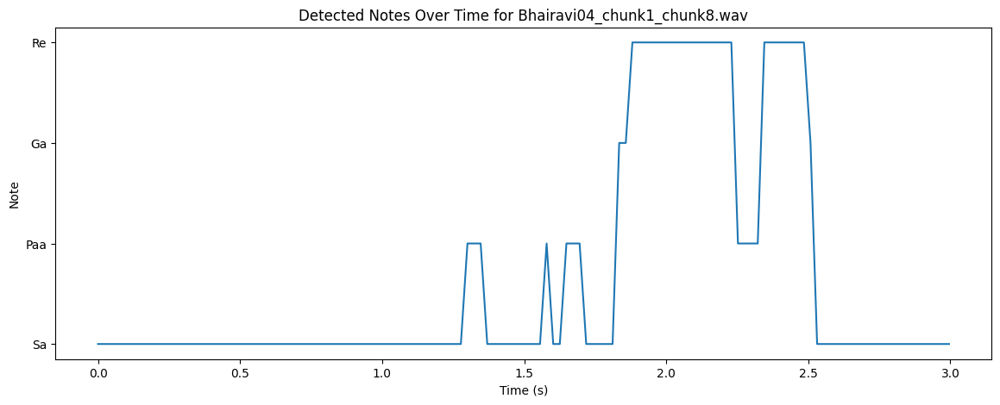

Tonic Frequency for Bhairavi04_chunk1_chunk9.wav: 1075.031494140625 Hz
Detected Notes for Bhairavi04_chunk1_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga']


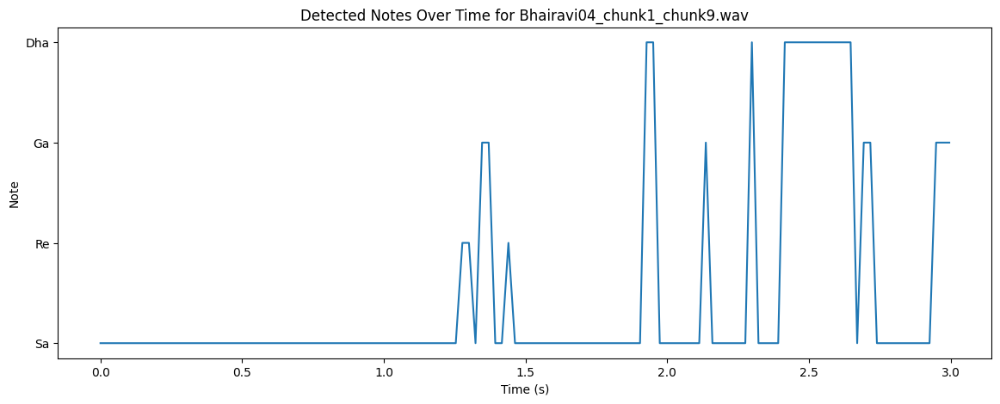

Tonic Frequency for Bhairavi04_chunk1_chunk10.wav: 1110.183837890625 Hz
Detected Notes for Bhairavi04_chunk1_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha']


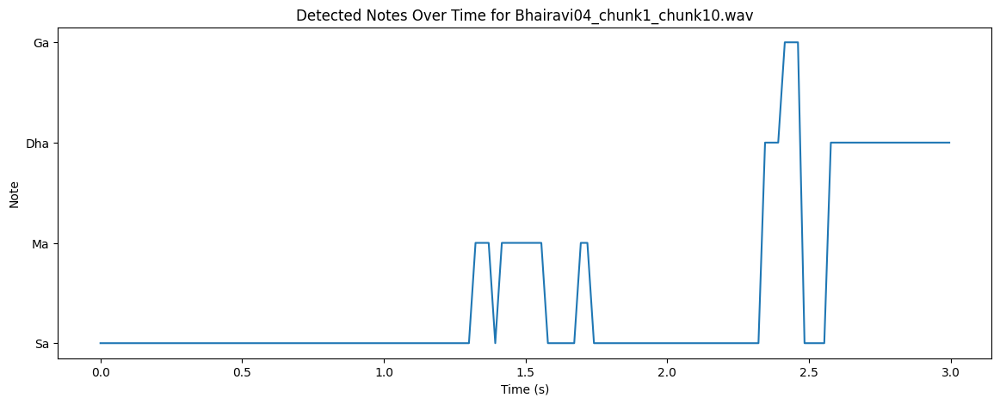

Tonic Frequency for Bhairavi04_chunk2_chunk1.wav: 1140.3616943359375 Hz
Detected Notes for Bhairavi04_chunk2_chunk1.wav:  ['Paa', 'Paa', 'Dha', 'Paa', 'Paa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Paa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


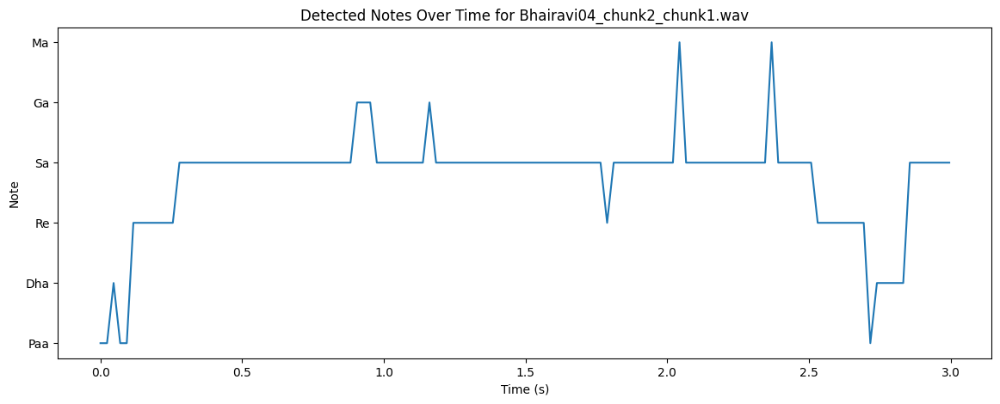

Tonic Frequency for Bhairavi04_chunk2_chunk2.wav: 1231.1728515625 Hz
Detected Notes for Bhairavi04_chunk2_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


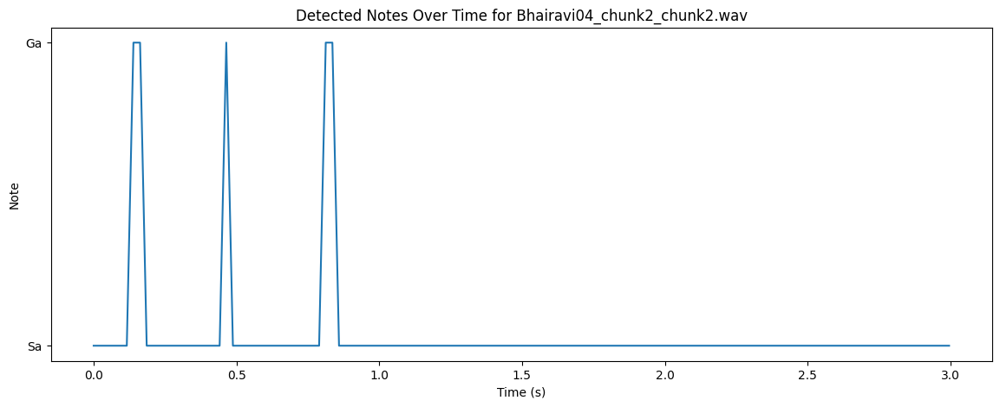

Tonic Frequency for Bhairavi04_chunk2_chunk3.wav: 1065.82666015625 Hz
Detected Notes for Bhairavi04_chunk2_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga']


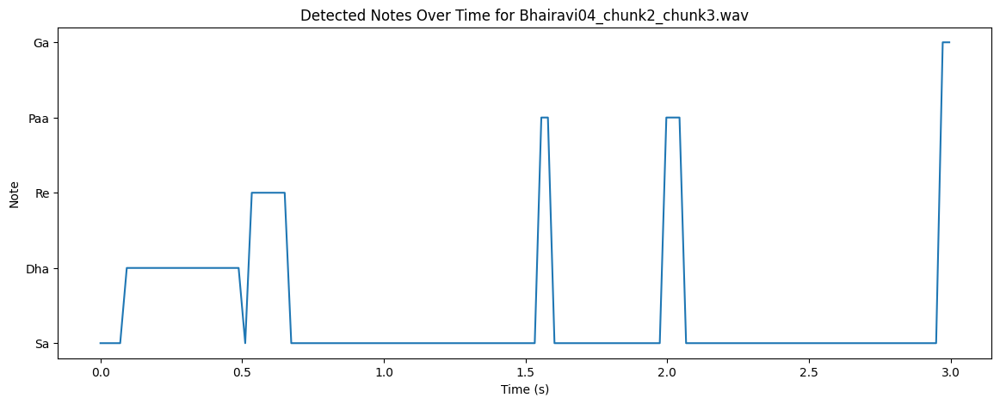

Tonic Frequency for Bhairavi04_chunk2_chunk4.wav: 1141.6365966796875 Hz
Detected Notes for Bhairavi04_chunk2_chunk4.wav:  ['Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Ga', 'Ga', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa']


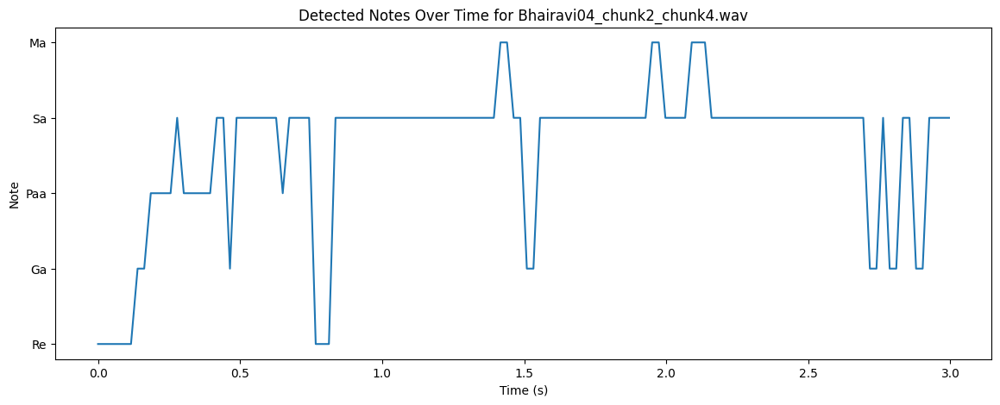

Tonic Frequency for Bhairavi04_chunk2_chunk5.wav: 1109.9049072265625 Hz
Detected Notes for Bhairavi04_chunk2_chunk5.wav:  ['Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


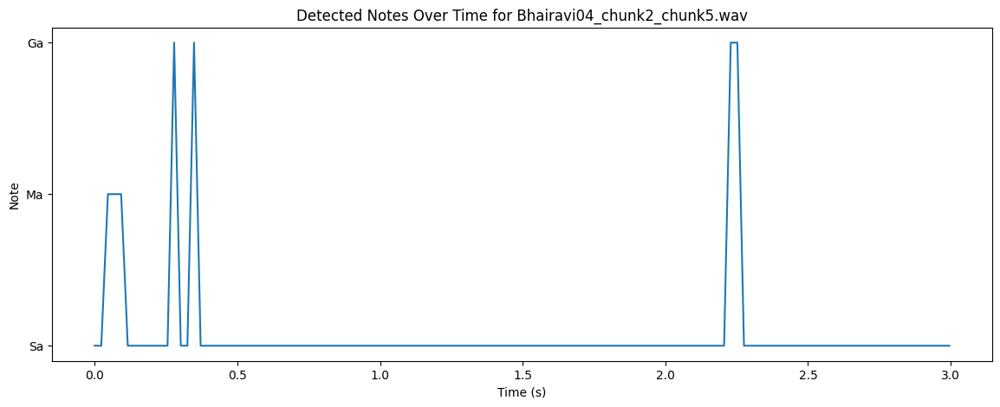

Tonic Frequency for Bhairavi04_chunk2_chunk6.wav: 1037.169921875 Hz
Detected Notes for Bhairavi04_chunk2_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Ma', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


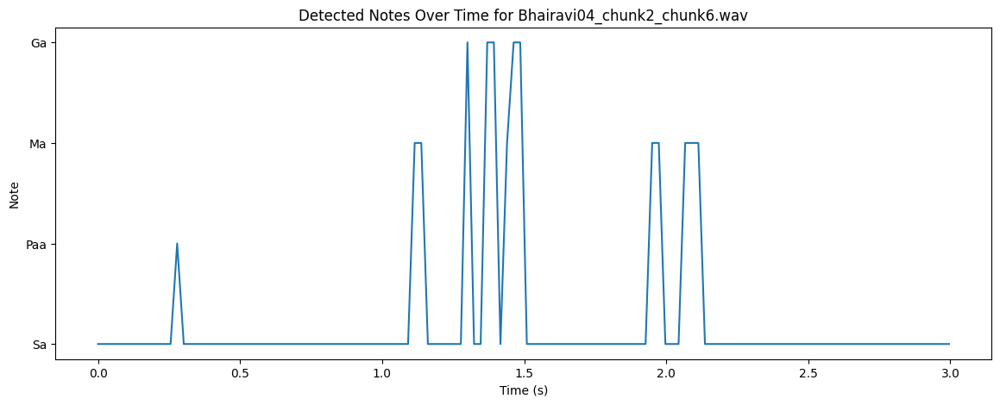

Tonic Frequency for Bhairavi04_chunk2_chunk7.wav: 1126.3192138671875 Hz
Detected Notes for Bhairavi04_chunk2_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


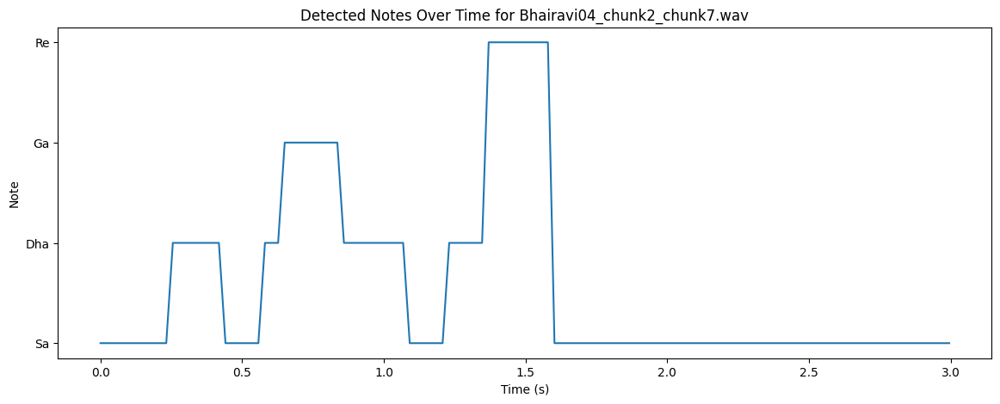

Tonic Frequency for Bhairavi04_chunk2_chunk8.wav: 1194.6505126953125 Hz
Detected Notes for Bhairavi04_chunk2_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


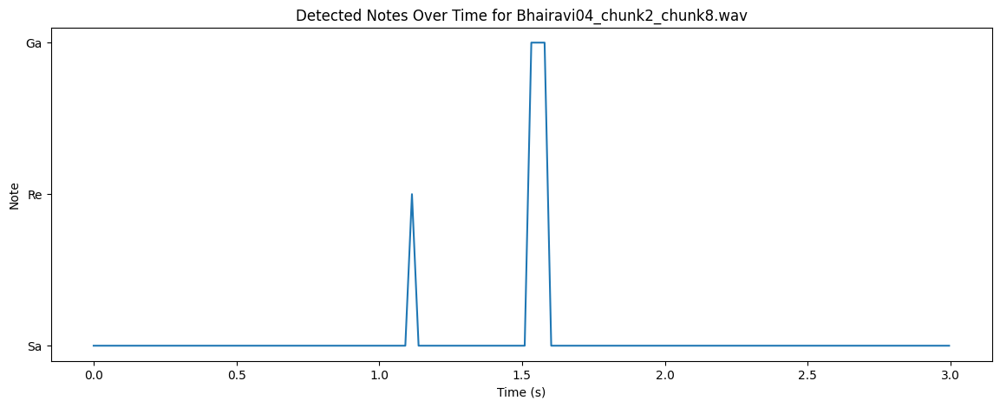

Tonic Frequency for Bhairavi04_chunk2_chunk9.wav: 1107.691162109375 Hz
Detected Notes for Bhairavi04_chunk2_chunk9.wav:  ['Sa', 'Sa', 'Re', 'Re', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Dha', 'Dha', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


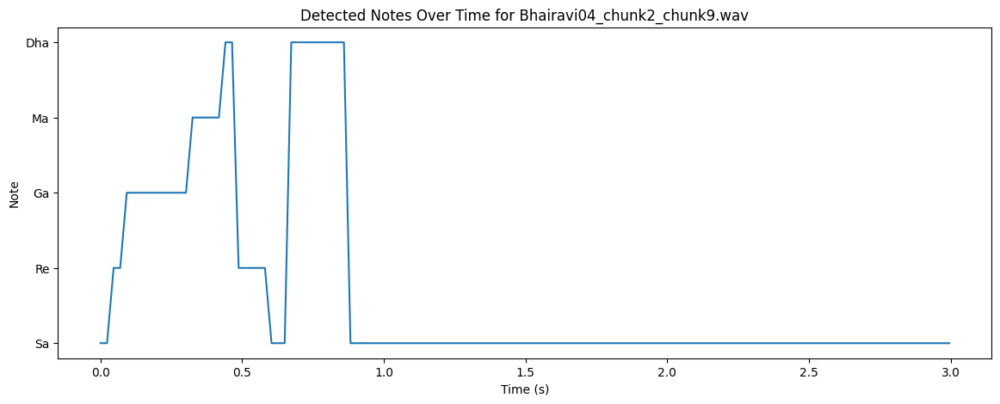

Tonic Frequency for Bhairavi04_chunk2_chunk10.wav: 1044.9234619140625 Hz
Detected Notes for Bhairavi04_chunk2_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ga', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


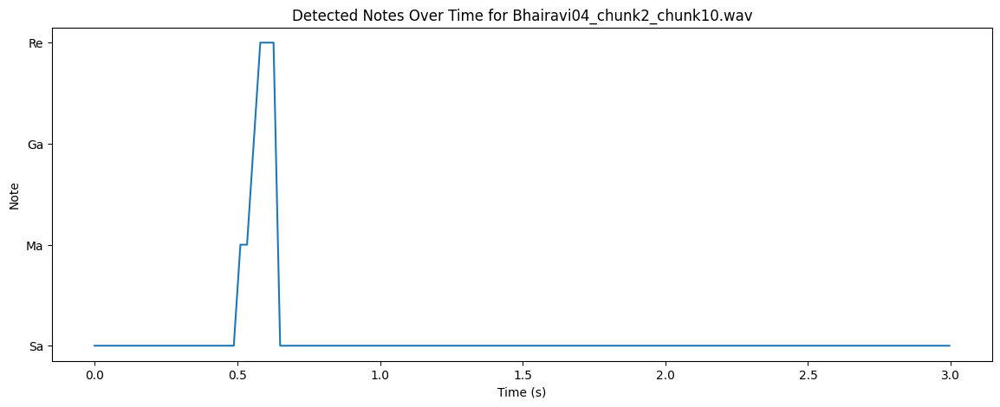

Tonic Frequency for Bhairavi04_chunk3_chunk1.wav: 986.1253051757812 Hz
Detected Notes for Bhairavi04_chunk3_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


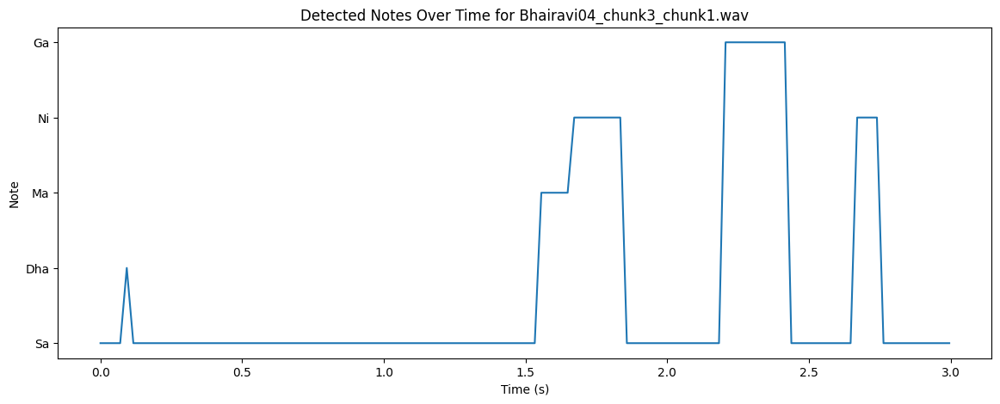

Tonic Frequency for Bhairavi04_chunk3_chunk2.wav: 1087.415283203125 Hz
Detected Notes for Bhairavi04_chunk3_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


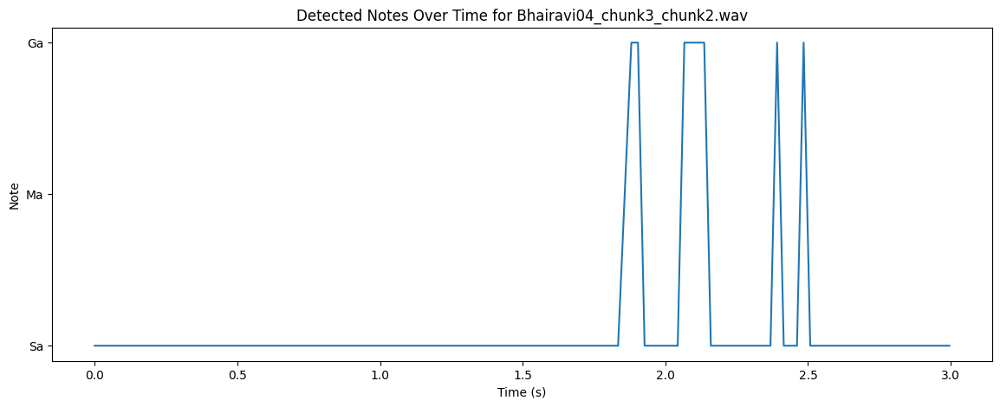

Tonic Frequency for Bhairavi04_chunk3_chunk3.wav: 1143.1781005859375 Hz
Detected Notes for Bhairavi04_chunk3_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Re', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Re', 'Re', 'Re', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa']


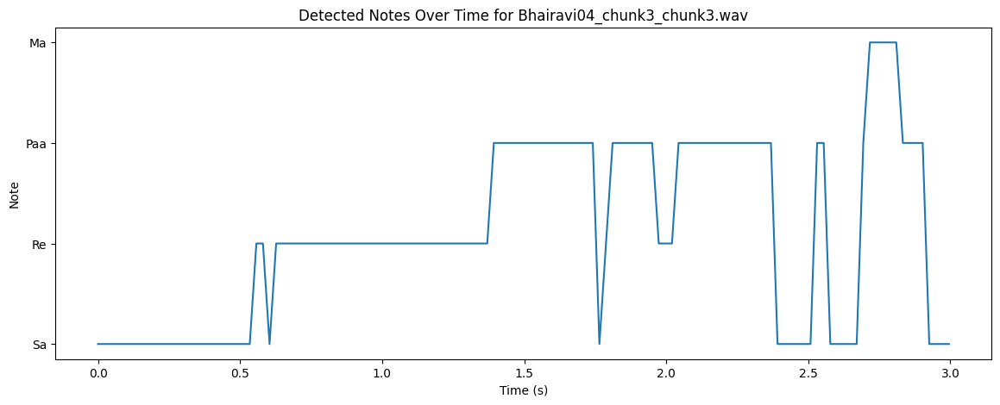

Tonic Frequency for Bhairavi04_chunk3_chunk4.wav: 971.9422607421875 Hz
Detected Notes for Bhairavi04_chunk3_chunk4.wav:  ['Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


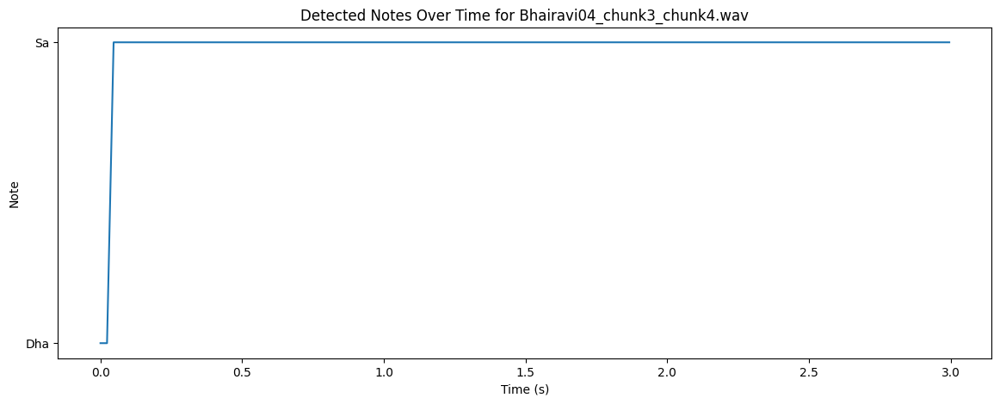

Tonic Frequency for Bhairavi04_chunk3_chunk5.wav: 831.9329223632812 Hz
Detected Notes for Bhairavi04_chunk3_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


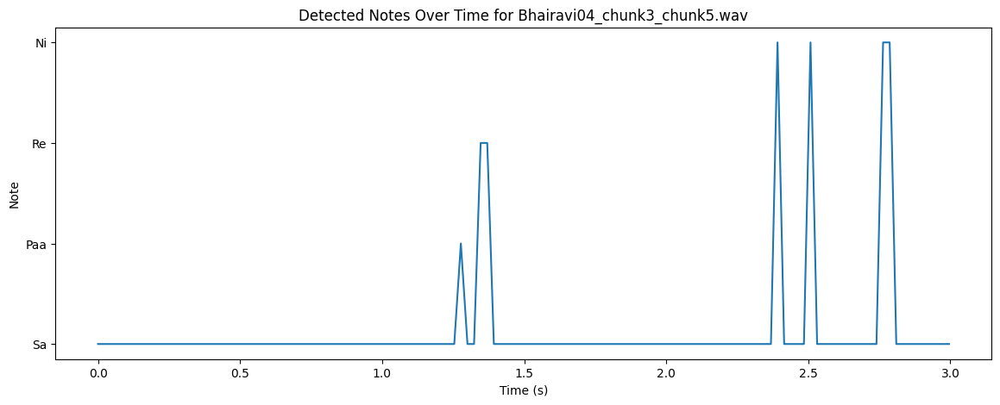

Tonic Frequency for Bhairavi04_chunk3_chunk6.wav: 876.7720947265625 Hz
Detected Notes for Bhairavi04_chunk3_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


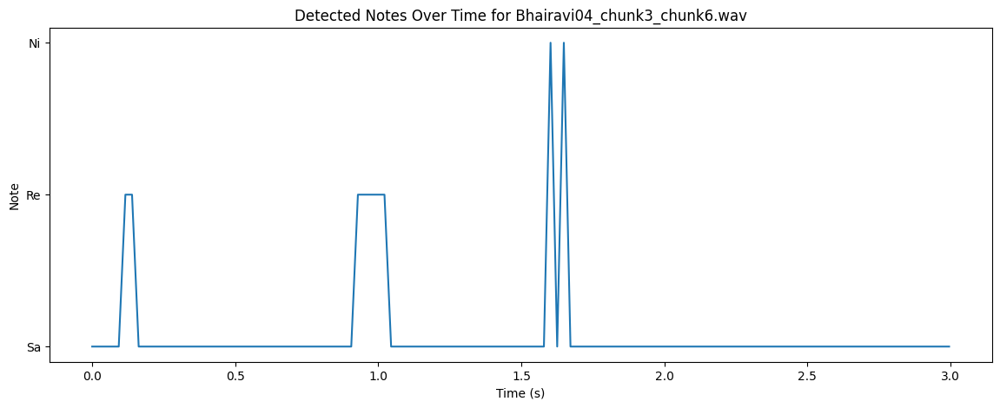

Tonic Frequency for Bhairavi04_chunk3_chunk7.wav: 763.4132080078125 Hz
Detected Notes for Bhairavi04_chunk3_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


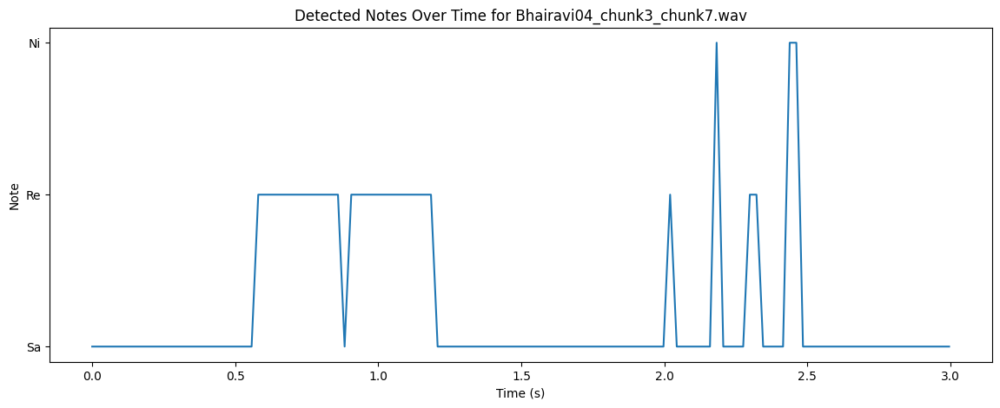

Tonic Frequency for Bhairavi04_chunk3_chunk8.wav: 833.4649658203125 Hz
Detected Notes for Bhairavi04_chunk3_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


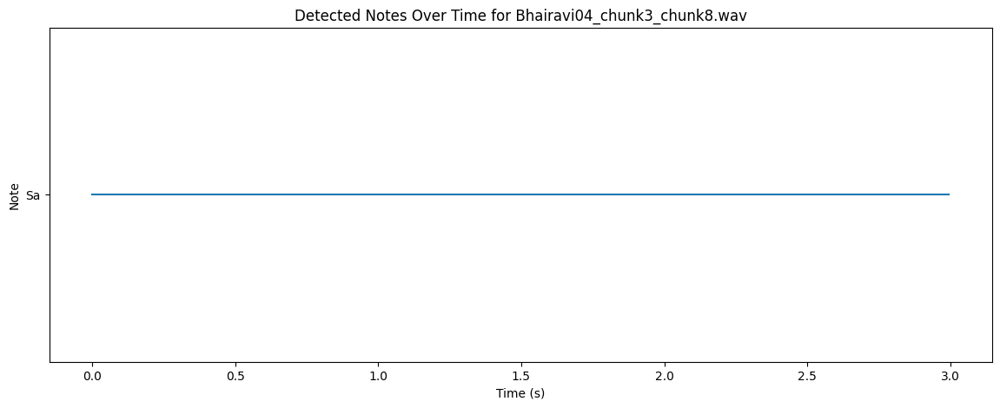

Tonic Frequency for Bhairavi04_chunk3_chunk9.wav: 881.3507080078125 Hz
Detected Notes for Bhairavi04_chunk3_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


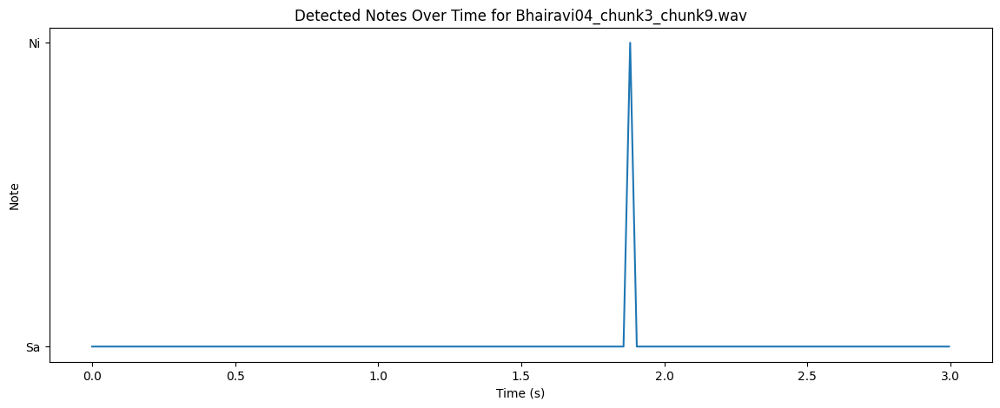

Tonic Frequency for Bhairavi04_chunk3_chunk10.wav: 905.7677001953125 Hz
Detected Notes for Bhairavi04_chunk3_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


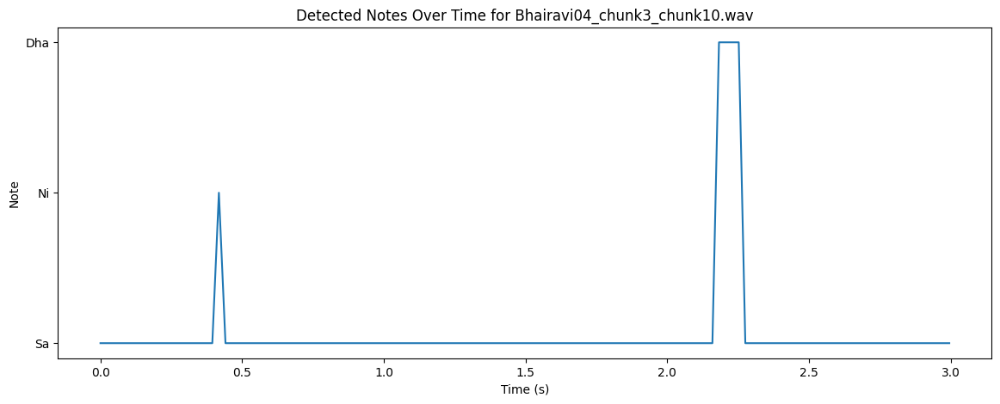

Tonic Frequency for Bhairavi04_chunk4_chunk1.wav: 935.4057006835938 Hz
Detected Notes for Bhairavi04_chunk4_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


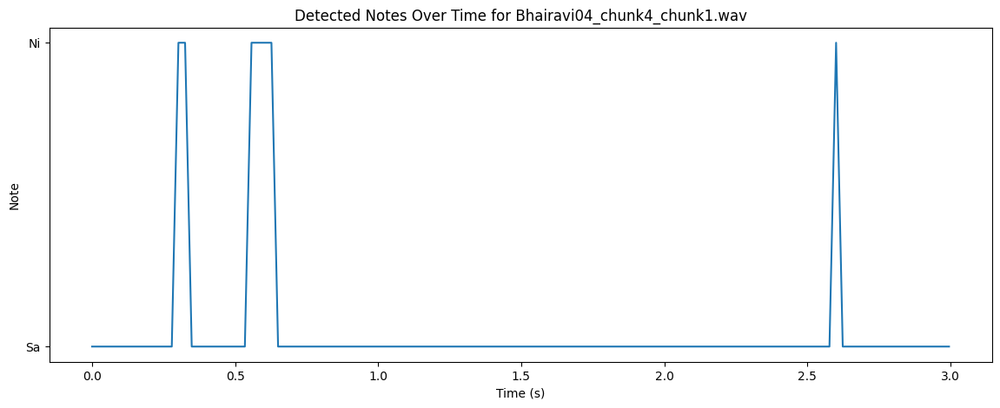

Tonic Frequency for Bhairavi04_chunk4_chunk2.wav: 803.7682495117188 Hz
Detected Notes for Bhairavi04_chunk4_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


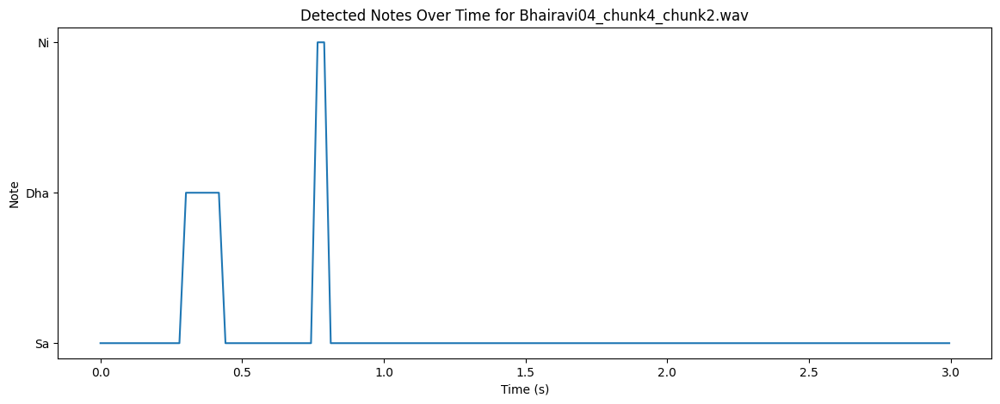

Tonic Frequency for Bhairavi04_chunk4_chunk3.wav: 933.6234130859375 Hz
Detected Notes for Bhairavi04_chunk4_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


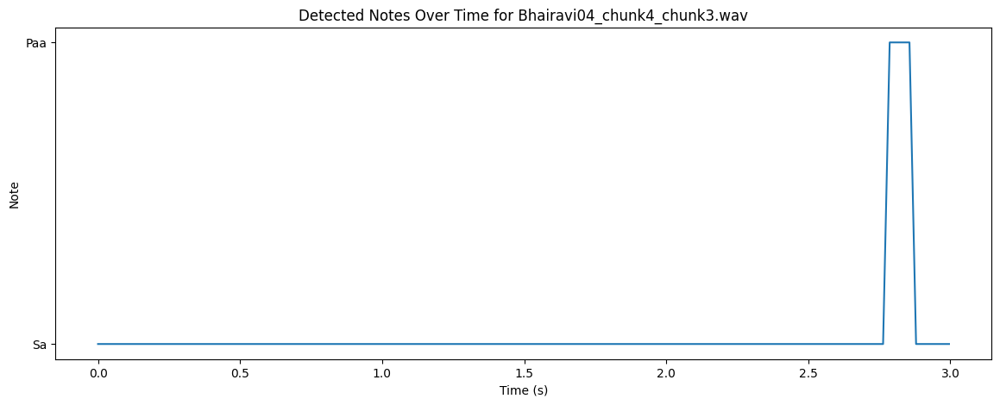

Tonic Frequency for Bhairavi04_chunk4_chunk4.wav: 881.7037353515625 Hz
Detected Notes for Bhairavi04_chunk4_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa']


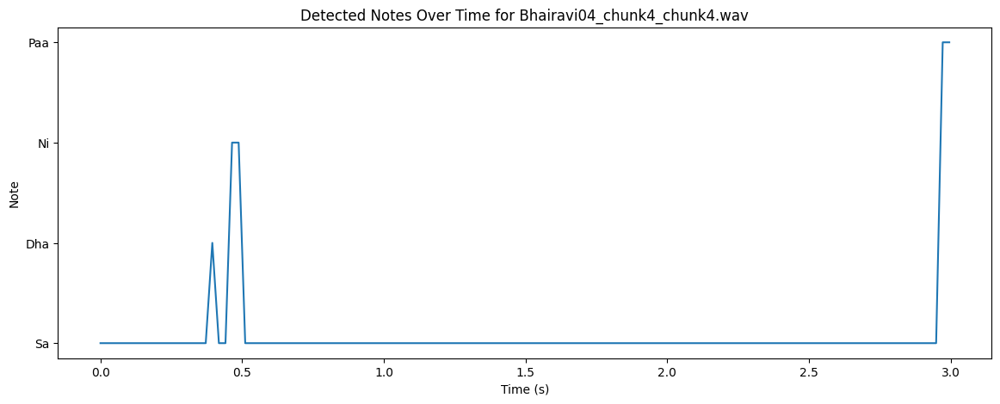

Tonic Frequency for Bhairavi04_chunk4_chunk5.wav: 838.2584228515625 Hz
Detected Notes for Bhairavi04_chunk4_chunk5.wav:  ['Dha', 'Dha', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


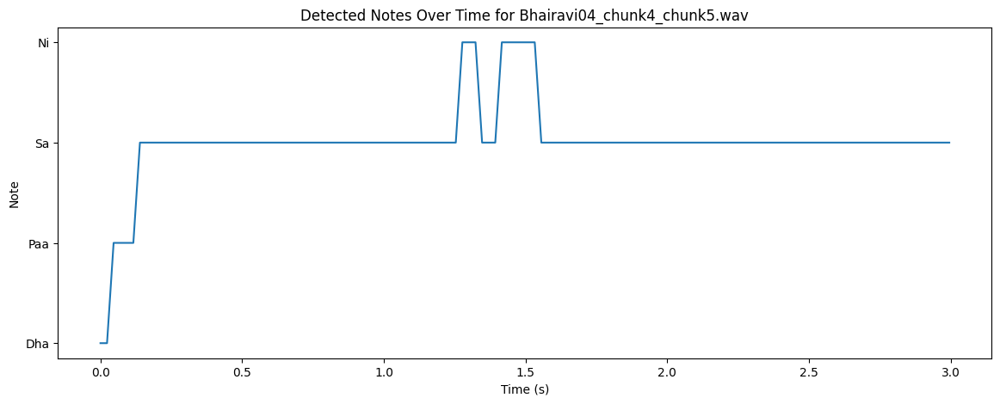

Tonic Frequency for Bhairavi04_chunk4_chunk6.wav: 832.2608642578125 Hz
Detected Notes for Bhairavi04_chunk4_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


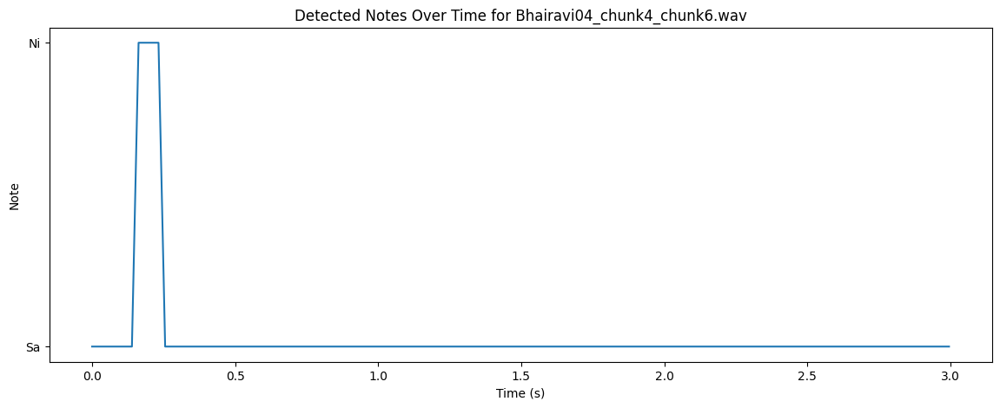

Tonic Frequency for Bhairavi04_chunk4_chunk7.wav: 832.4620361328125 Hz
Detected Notes for Bhairavi04_chunk4_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


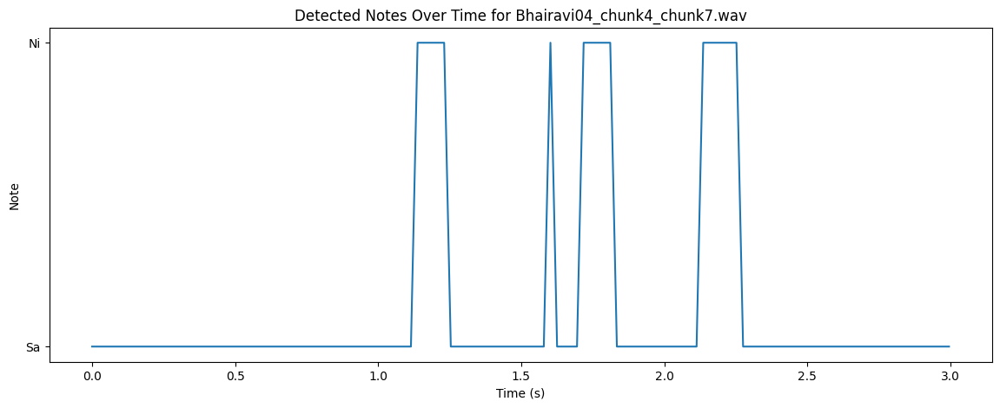

Tonic Frequency for Bhairavi04_chunk4_chunk8.wav: 831.9942626953125 Hz
Detected Notes for Bhairavi04_chunk4_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Re', 'Ga', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


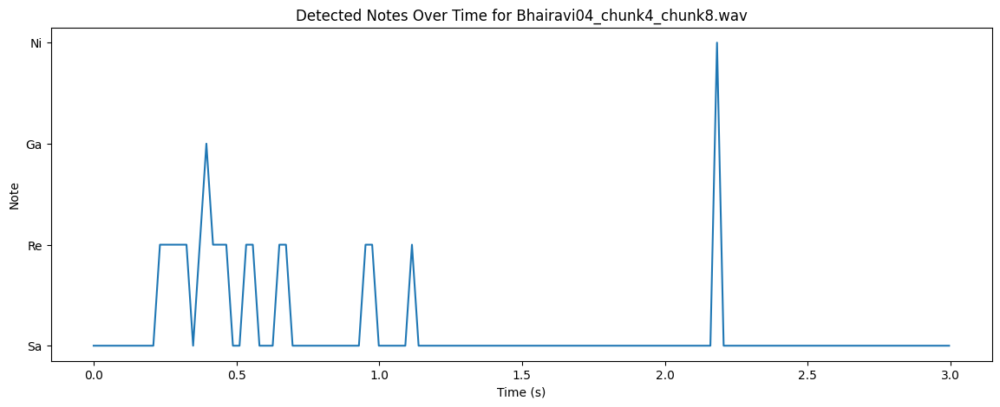

Tonic Frequency for Bhairavi04_chunk4_chunk9.wav: 880.9803466796875 Hz
Detected Notes for Bhairavi04_chunk4_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


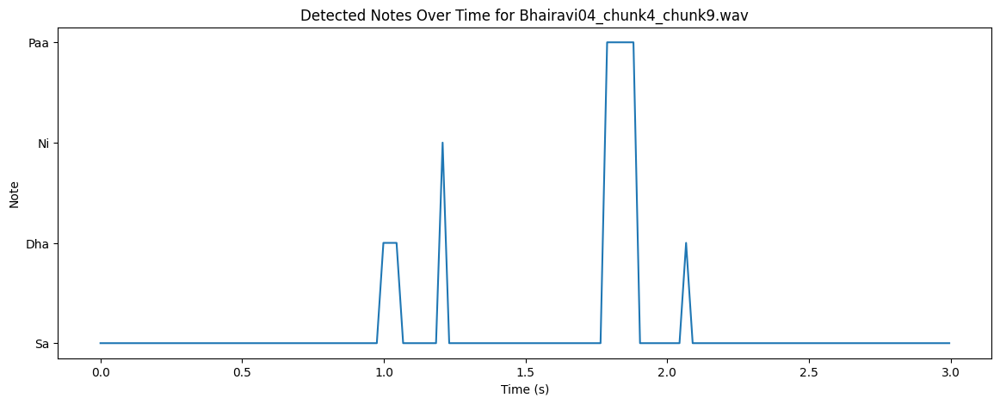

Tonic Frequency for Bhairavi04_chunk4_chunk10.wav: 828.67919921875 Hz
Detected Notes for Bhairavi04_chunk4_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


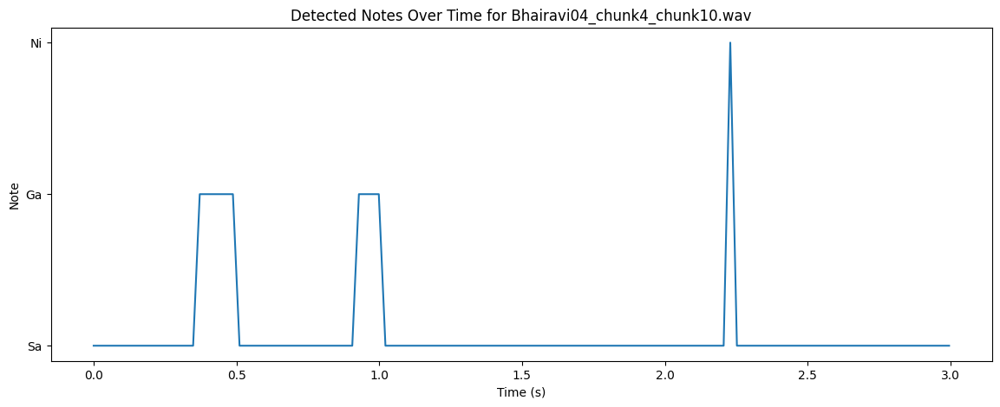

Tonic Frequency for Bhairavi04_chunk5_chunk1.wav: 829.3992309570312 Hz
Detected Notes for Bhairavi04_chunk5_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


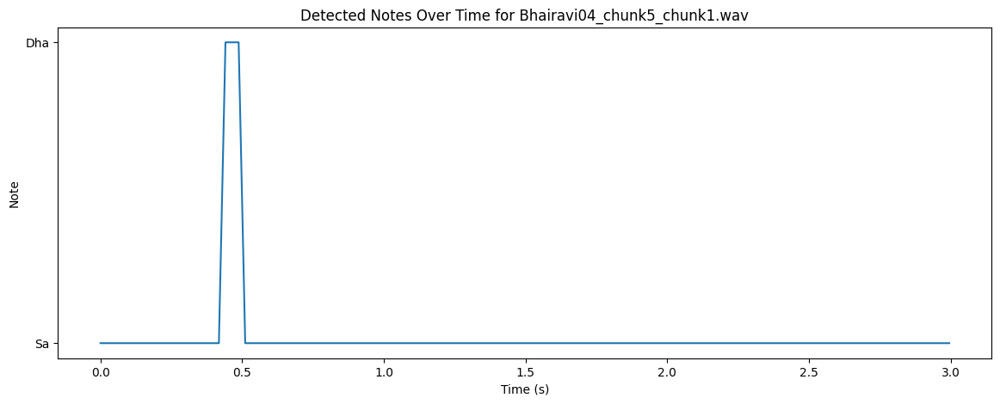

Tonic Frequency for Bhairavi04_chunk5_chunk2.wav: 900.7908935546875 Hz
Detected Notes for Bhairavi04_chunk5_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni']


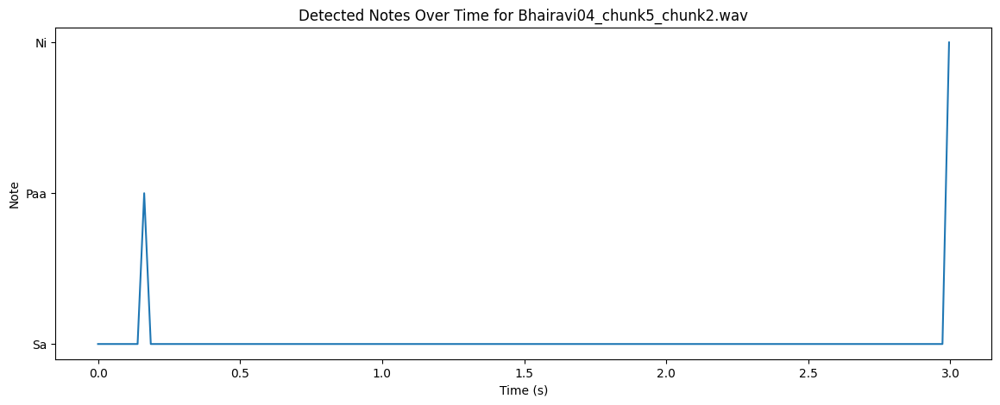

Tonic Frequency for Bhairavi04_chunk5_chunk3.wav: 905.534912109375 Hz
Detected Notes for Bhairavi04_chunk5_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


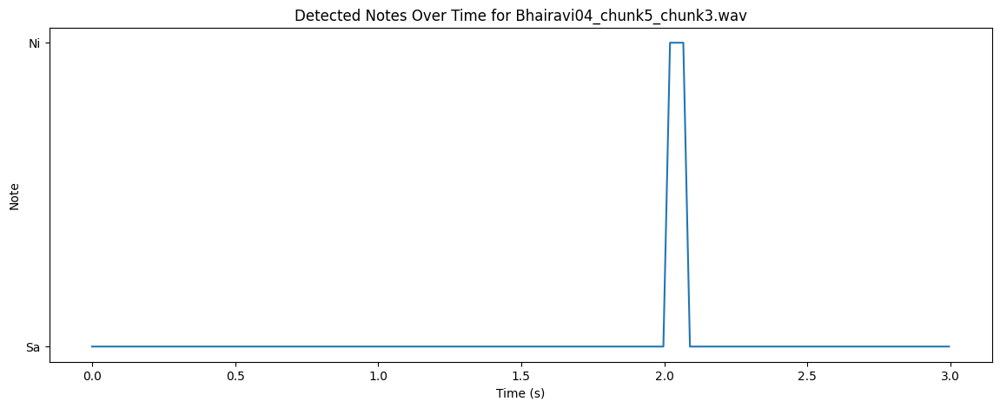

Tonic Frequency for Bhairavi04_chunk5_chunk4.wav: 833.0435791015625 Hz
Detected Notes for Bhairavi04_chunk5_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


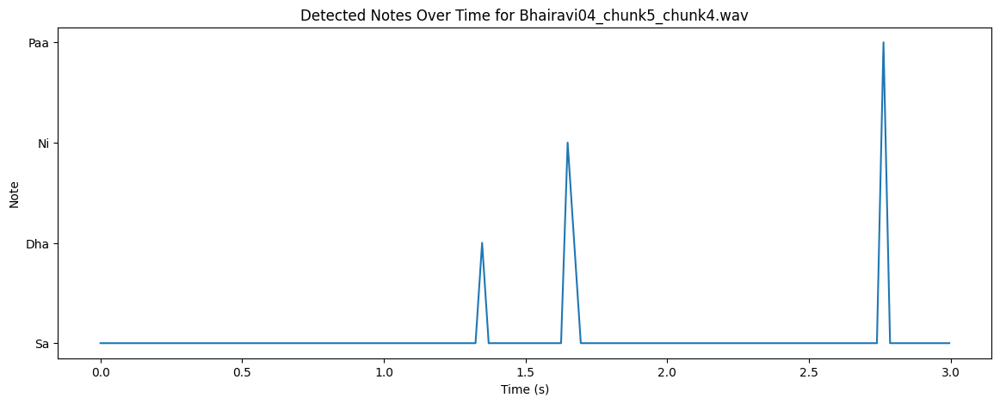

Tonic Frequency for Bhairavi04_chunk5_chunk5.wav: 694.6693725585938 Hz
Detected Notes for Bhairavi04_chunk5_chunk5.wav:  ['Sa', 'Ni', 'Ma', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


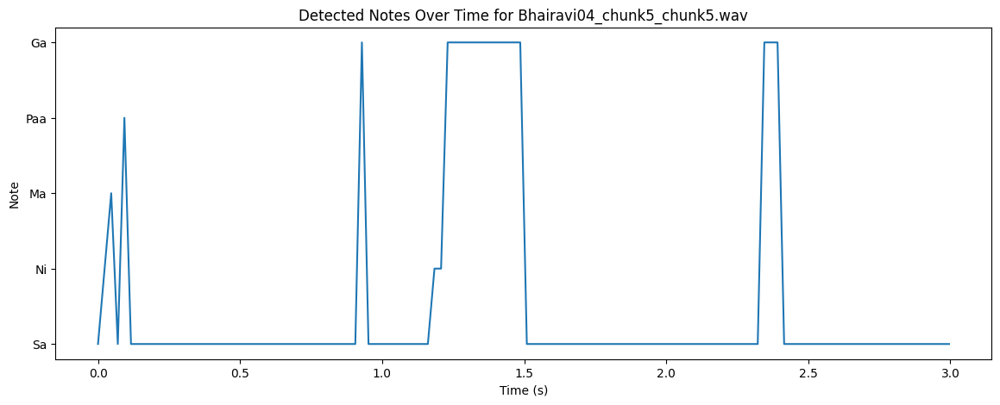

Tonic Frequency for Bhairavi04_chunk5_chunk6.wav: 623.3967895507812 Hz
Detected Notes for Bhairavi04_chunk5_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


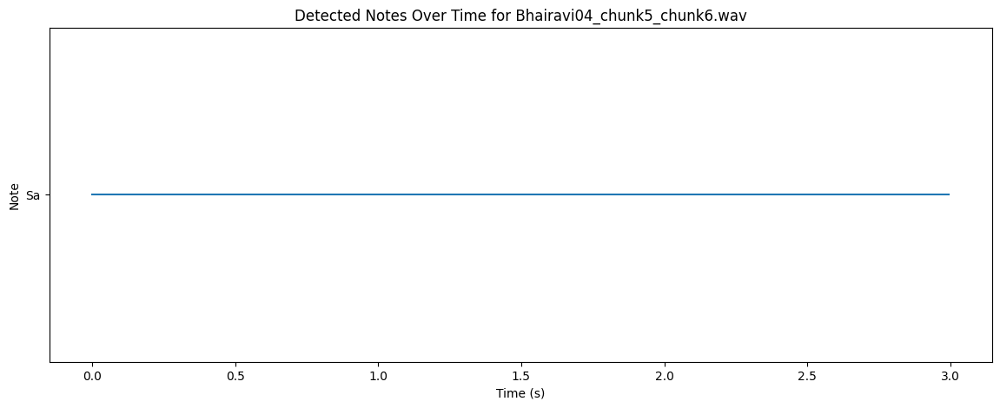

Tonic Frequency for Bhairavi04_chunk5_chunk7.wav: 831.8301391601562 Hz
Detected Notes for Bhairavi04_chunk5_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


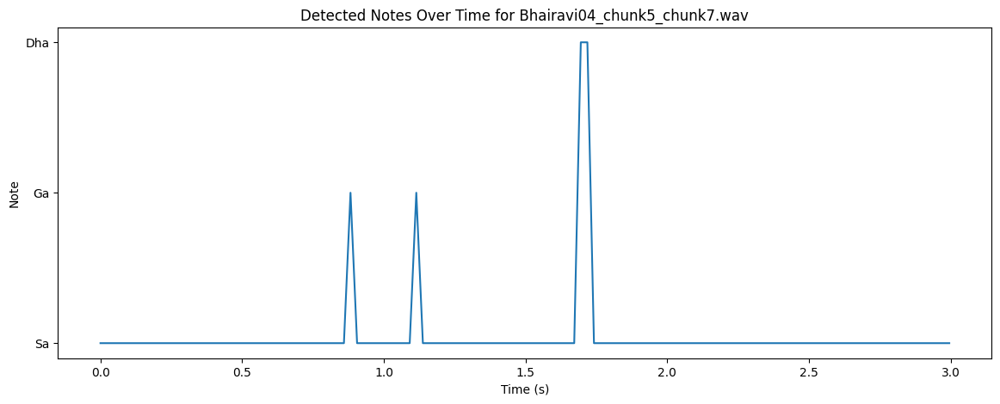

Tonic Frequency for Bhairavi04_chunk5_chunk8.wav: 935.8477783203125 Hz
Detected Notes for Bhairavi04_chunk5_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Ni', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Dha', 'Paa', 'Paa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Paa', 'Paa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha']


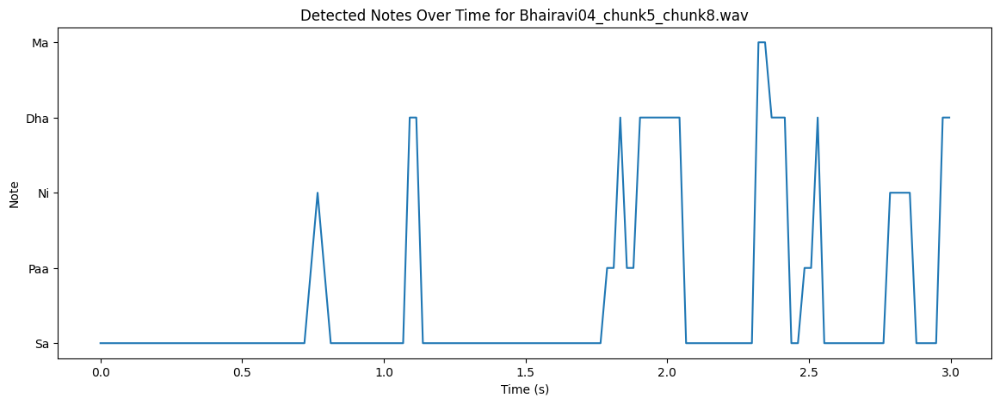

Tonic Frequency for Bhairavi04_chunk5_chunk9.wav: 972.7166748046875 Hz
Detected Notes for Bhairavi04_chunk5_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa']


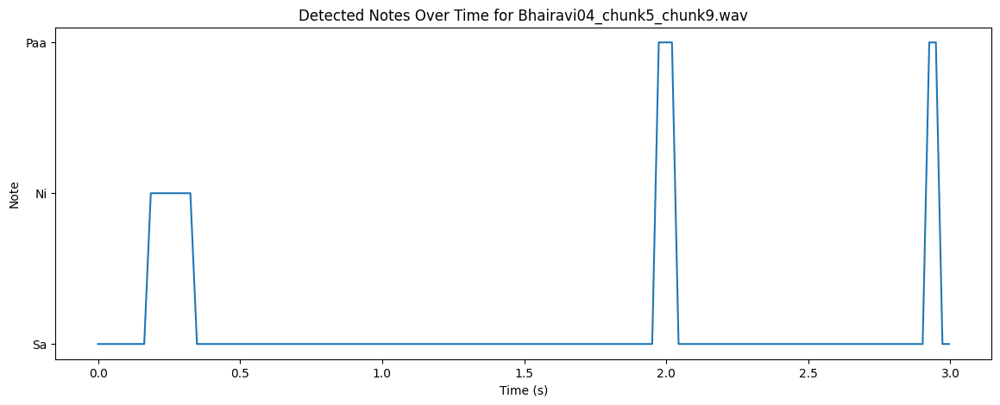

Tonic Frequency for Bhairavi04_chunk5_chunk10.wav: 832.7127685546875 Hz
Detected Notes for Bhairavi04_chunk5_chunk10.wav:  ['Ga', 'Ga', 'Re', 'Re', 'Re', 'Re', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Re', 'Re', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


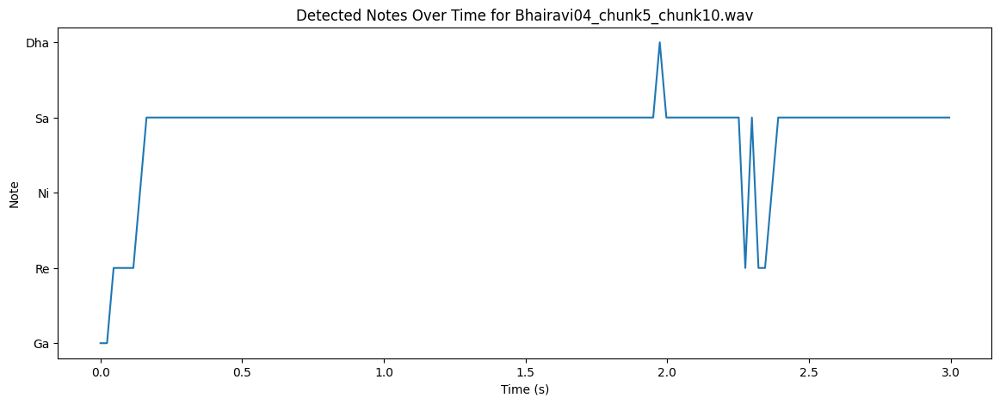

Tonic Frequency for Bhairavi04_chunk6_chunk1.wav: 830.1587524414062 Hz
Detected Notes for Bhairavi04_chunk6_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


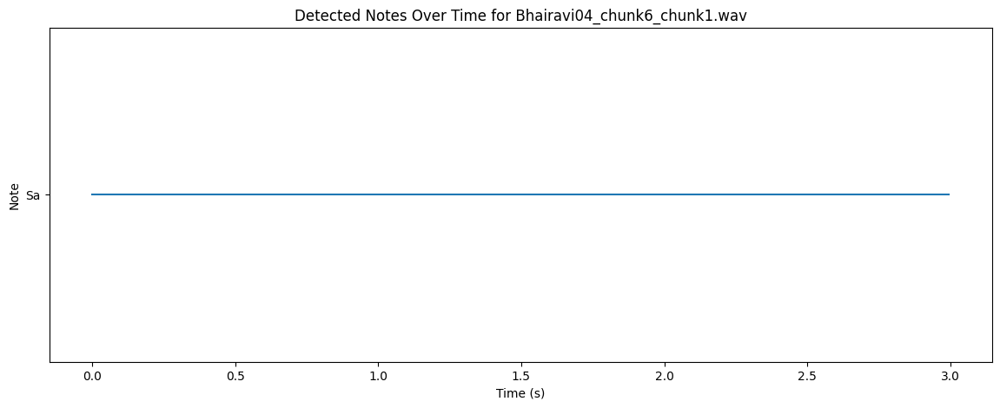

Tonic Frequency for Bhairavi04_chunk6_chunk2.wav: 833.29833984375 Hz
Detected Notes for Bhairavi04_chunk6_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa']


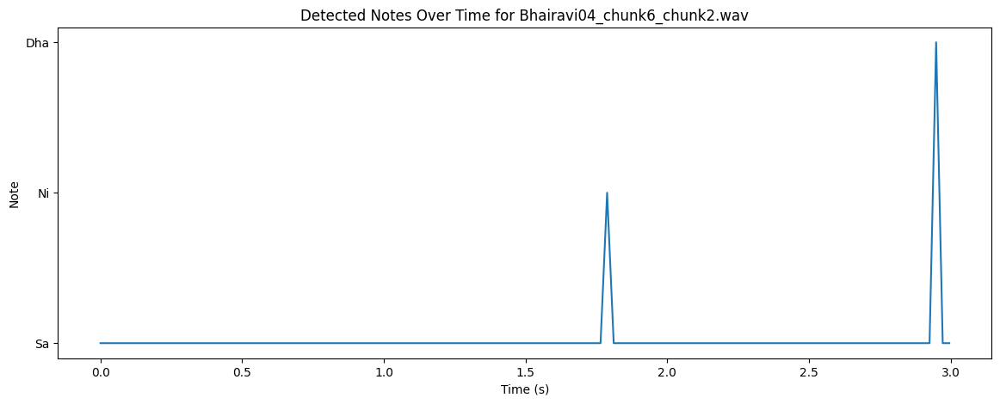

Tonic Frequency for Bhairavi04_chunk6_chunk3.wav: 838.58056640625 Hz
Detected Notes for Bhairavi04_chunk6_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


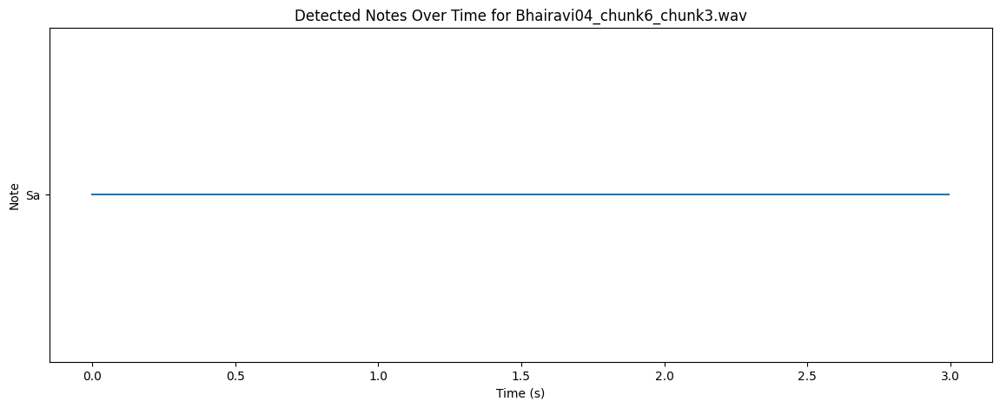

Tonic Frequency for Bhairavi04_chunk6_chunk4.wav: 758.8153076171875 Hz
Detected Notes for Bhairavi04_chunk6_chunk4.wav:  ['Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


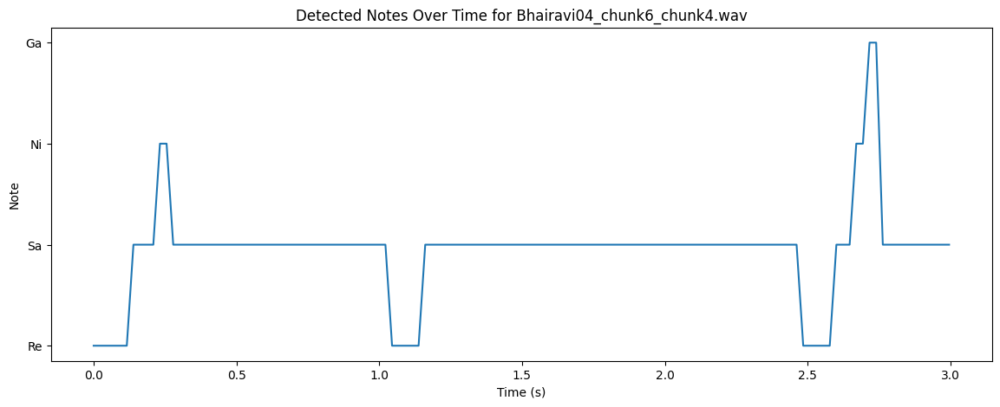

Tonic Frequency for Bhairavi04_chunk6_chunk5.wav: 763.9650268554688 Hz
Detected Notes for Bhairavi04_chunk6_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa']


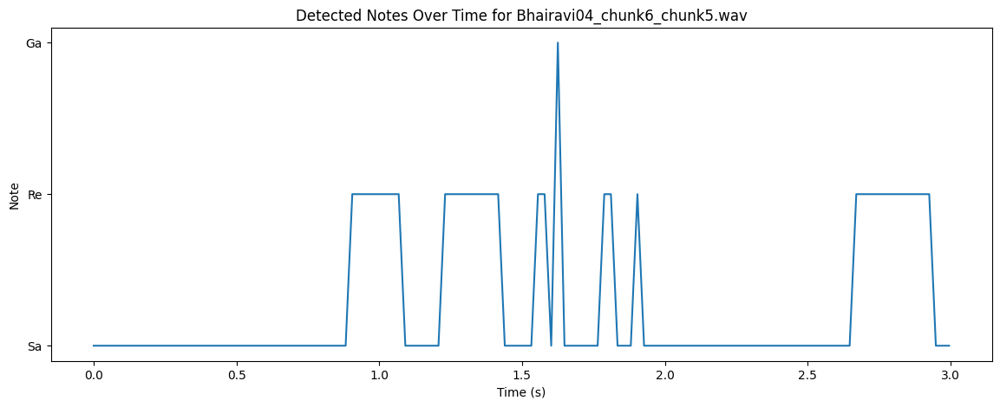

Tonic Frequency for Bhairavi04_chunk6_chunk6.wav: 832.2025756835938 Hz
Detected Notes for Bhairavi04_chunk6_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


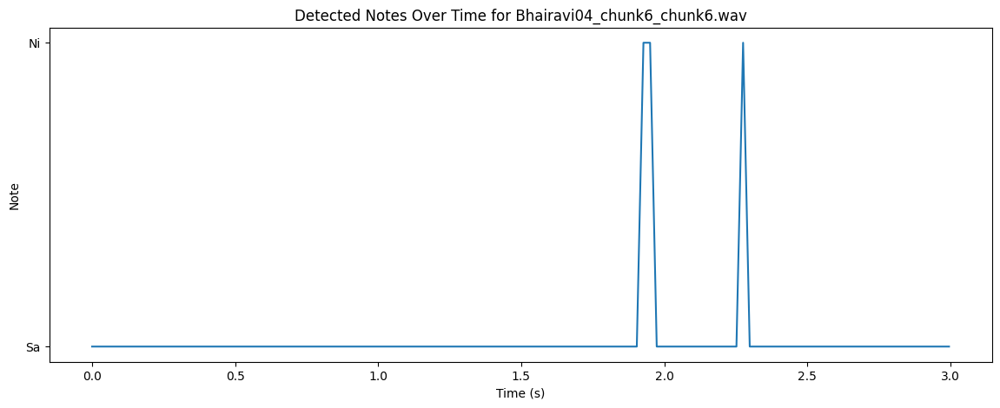

Tonic Frequency for Bhairavi04_chunk6_chunk7.wav: 839.2476196289062 Hz
Detected Notes for Bhairavi04_chunk6_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


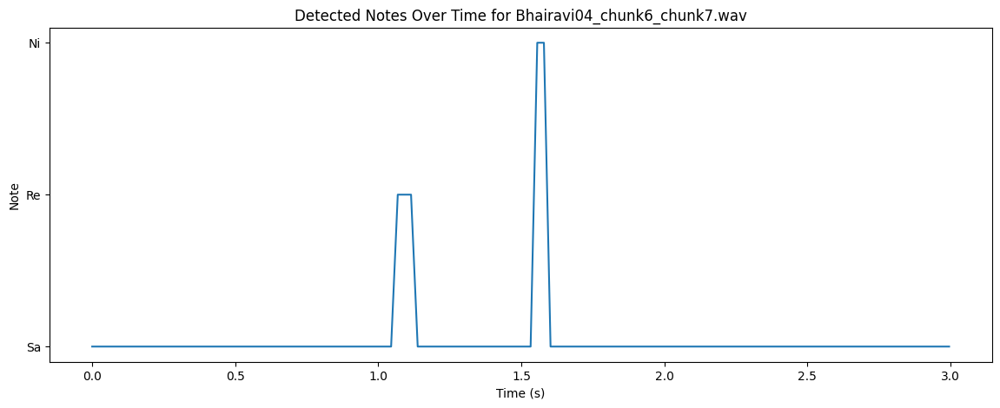

Tonic Frequency for Bhairavi04_chunk6_chunk8.wav: 968.8619384765625 Hz
Detected Notes for Bhairavi04_chunk6_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa']


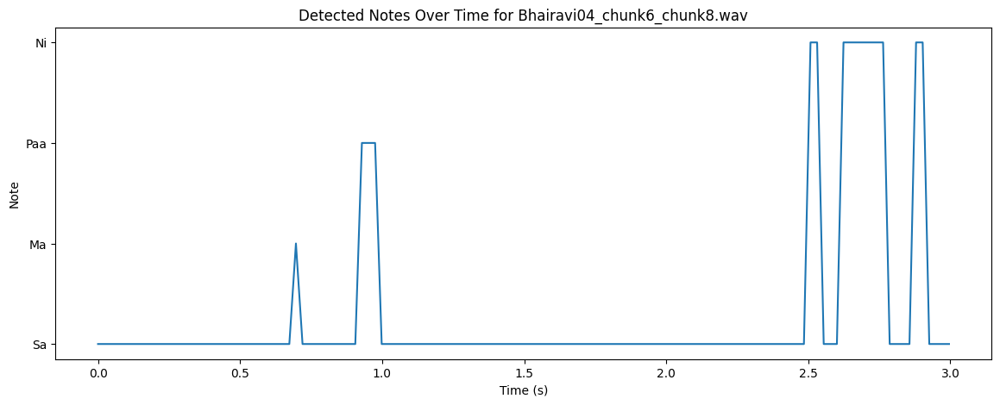

Tonic Frequency for Bhairavi04_chunk6_chunk9.wav: 945.781982421875 Hz
Detected Notes for Bhairavi04_chunk6_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


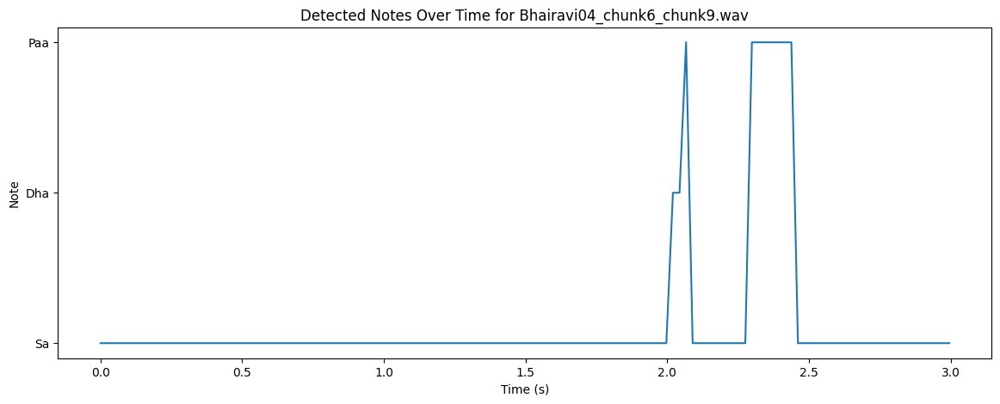

Tonic Frequency for Bhairavi04_chunk6_chunk10.wav: 835.585693359375 Hz
Detected Notes for Bhairavi04_chunk6_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Re', 'Re', 'Sa', 'Dha', 'Dha', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


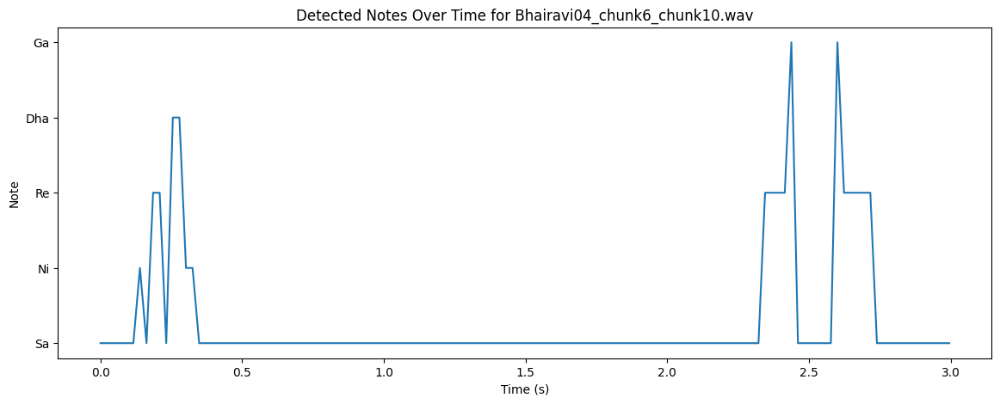

Tonic Frequency for Bhairavi04_chunk7_chunk1.wav: 836.6531982421875 Hz
Detected Notes for Bhairavi04_chunk7_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Ni', 'Ni', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


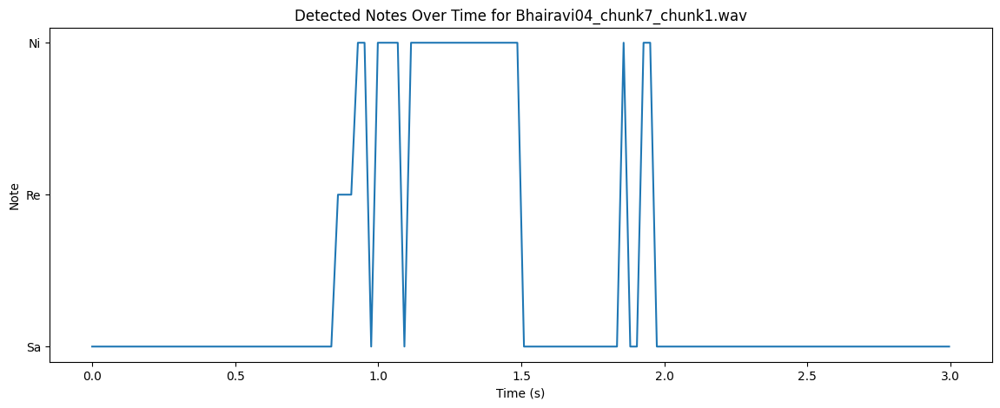

Tonic Frequency for Bhairavi04_chunk7_chunk2.wav: 765.4483642578125 Hz
Detected Notes for Bhairavi04_chunk7_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ga', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


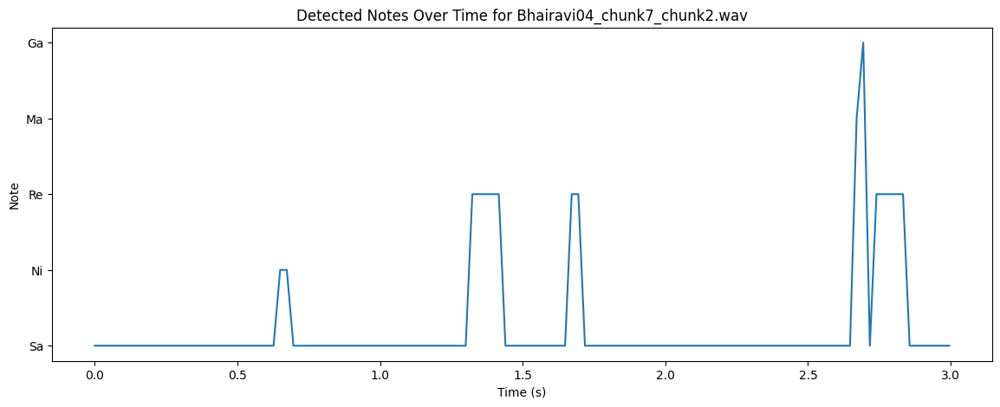

Tonic Frequency for Bhairavi04_chunk7_chunk3.wav: 889.7520751953125 Hz
Detected Notes for Bhairavi04_chunk7_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


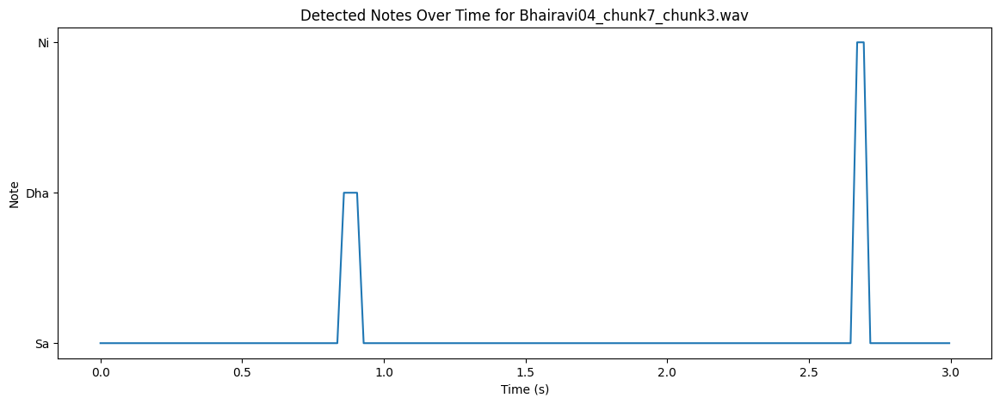

Tonic Frequency for Bhairavi04_chunk7_chunk4.wav: 830.8078002929688 Hz
Detected Notes for Bhairavi04_chunk7_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


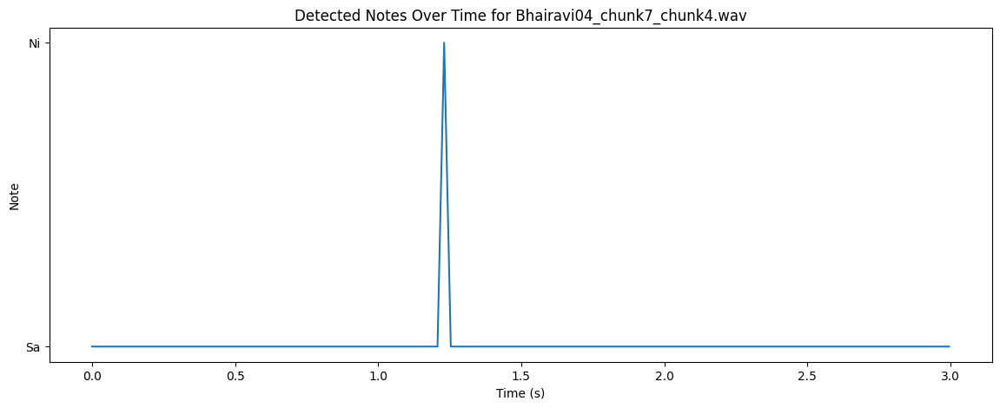

Tonic Frequency for Bhairavi04_chunk7_chunk5.wav: 831.479248046875 Hz
Detected Notes for Bhairavi04_chunk7_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


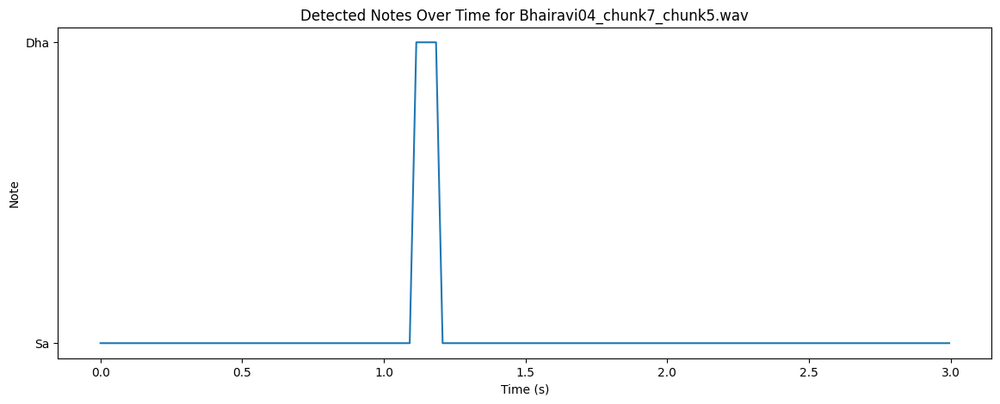

Tonic Frequency for Bhairavi04_chunk7_chunk6.wav: 804.3190307617188 Hz
Detected Notes for Bhairavi04_chunk7_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


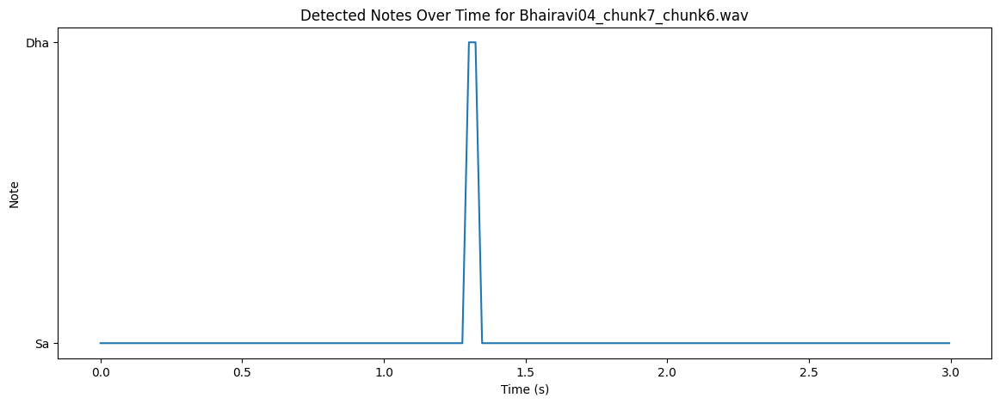

Tonic Frequency for Bhairavi04_chunk7_chunk7.wav: 832.0257568359375 Hz
Detected Notes for Bhairavi04_chunk7_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


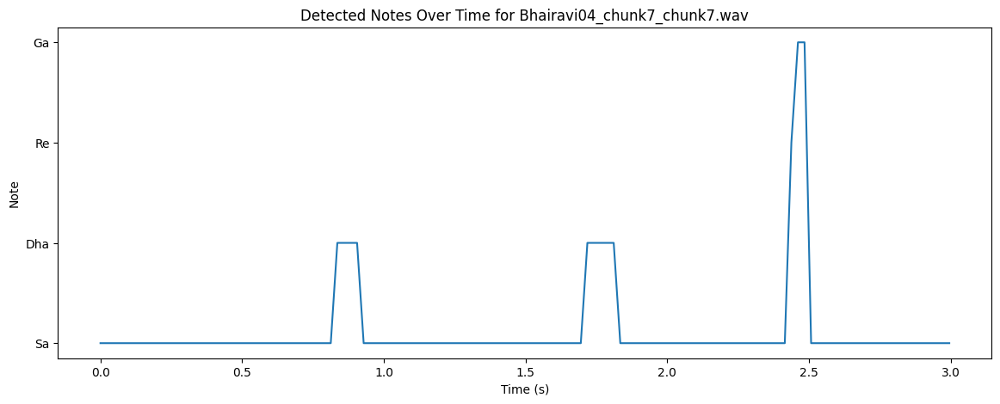

Tonic Frequency for Bhairavi04_chunk7_chunk8.wav: 829.6506958007812 Hz
Detected Notes for Bhairavi04_chunk7_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


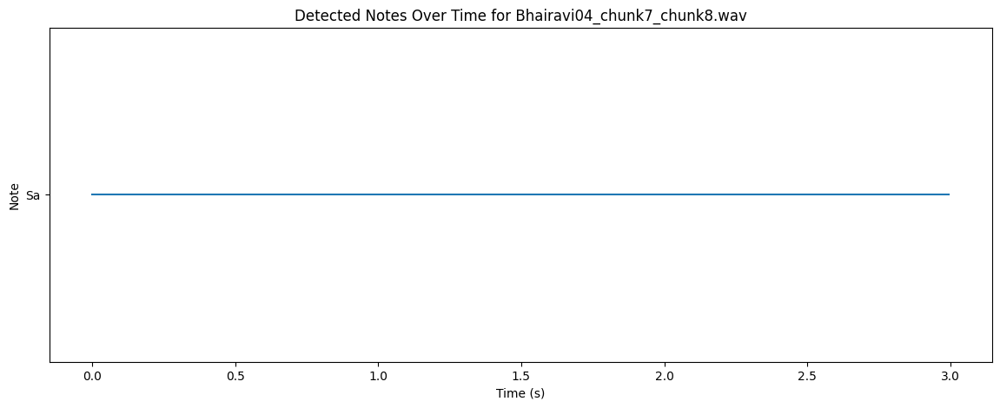

Tonic Frequency for Bhairavi04_chunk7_chunk9.wav: 727.2178344726562 Hz
Detected Notes for Bhairavi04_chunk7_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


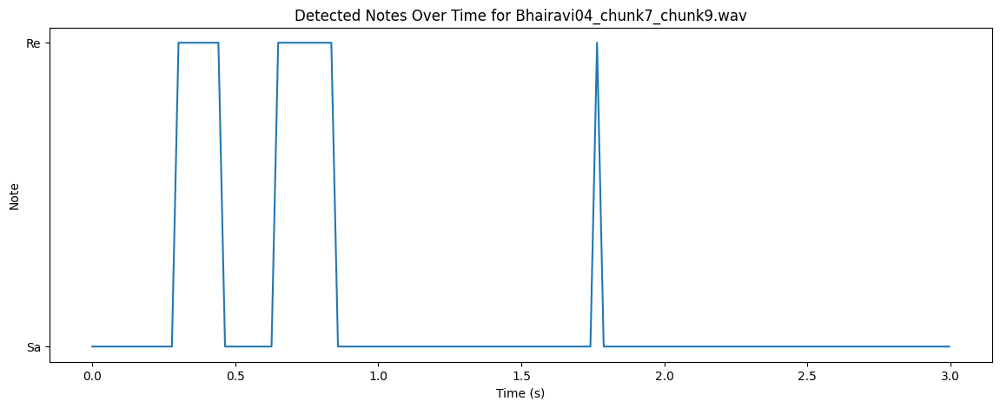

Tonic Frequency for Bhairavi04_chunk7_chunk10.wav: 893.6182861328125 Hz
Detected Notes for Bhairavi04_chunk7_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


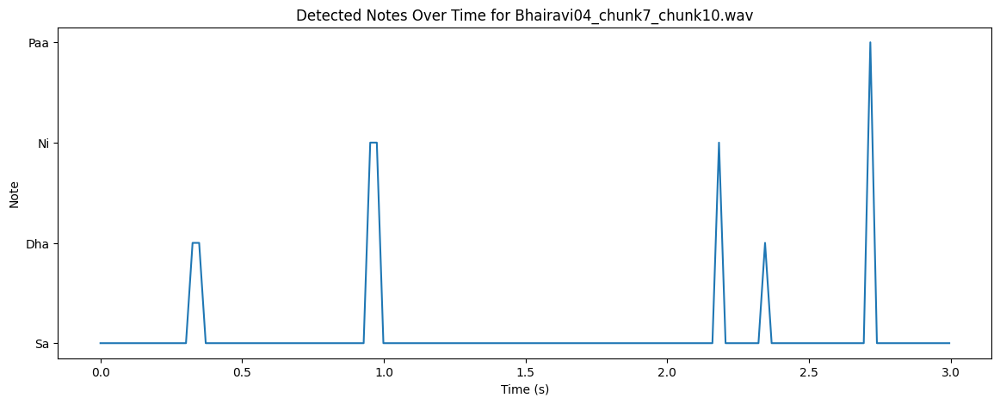

Tonic Frequency for Bhairavi04_chunk8_chunk1.wav: 953.9290771484375 Hz
Detected Notes for Bhairavi04_chunk8_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


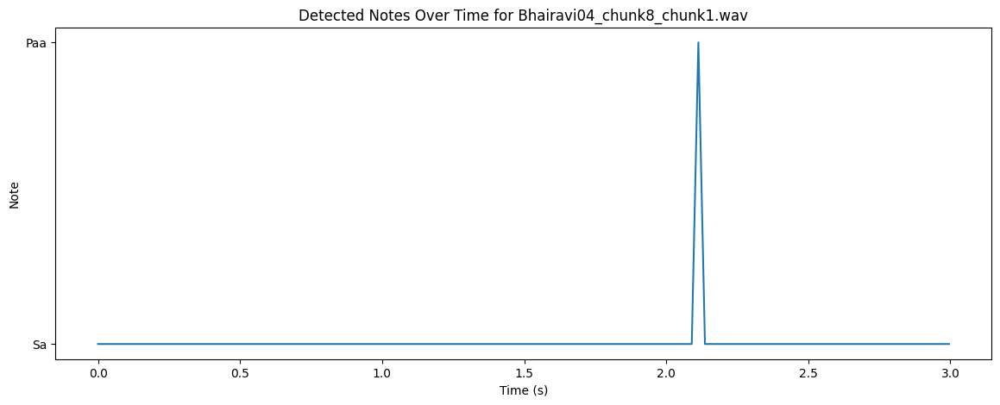

Tonic Frequency for Bhairavi04_chunk8_chunk2.wav: 937.22265625 Hz
Detected Notes for Bhairavi04_chunk8_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Paa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa']


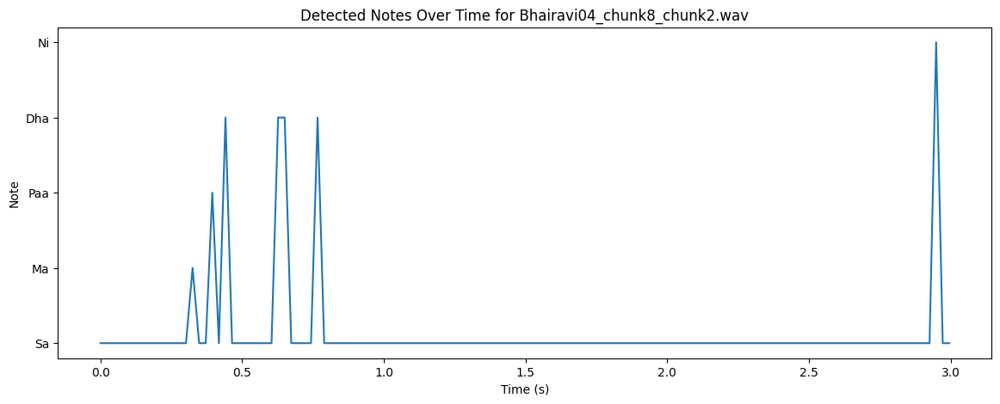

Tonic Frequency for Bhairavi04_chunk8_chunk3.wav: 936.856201171875 Hz
Detected Notes for Bhairavi04_chunk8_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa']


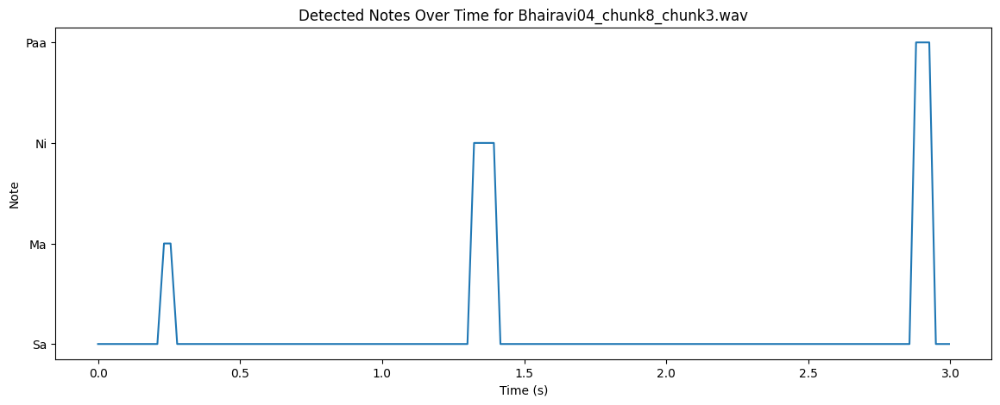

Tonic Frequency for Bhairavi04_chunk8_chunk4.wav: 929.186279296875 Hz
Detected Notes for Bhairavi04_chunk8_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


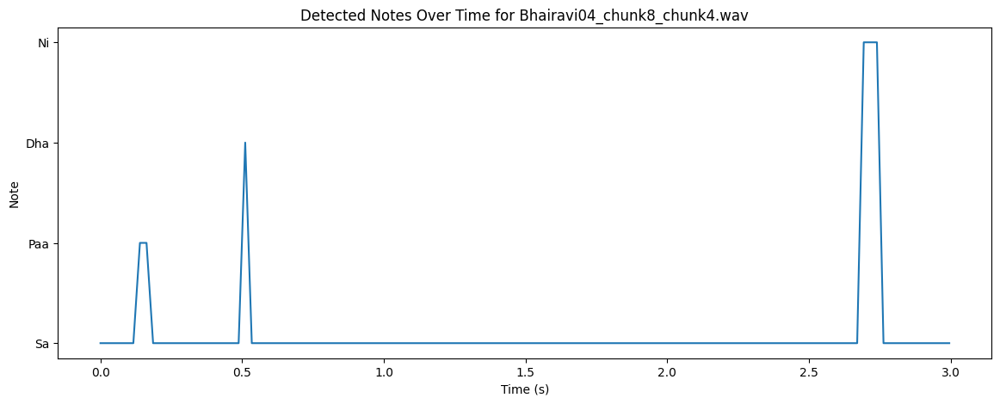

Tonic Frequency for Bhairavi04_chunk8_chunk5.wav: 831.2479248046875 Hz
Detected Notes for Bhairavi04_chunk8_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


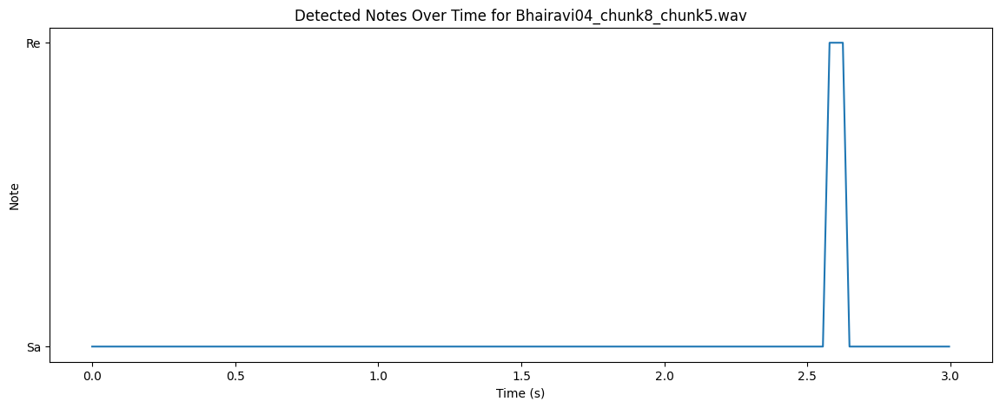

Tonic Frequency for Bhairavi04_chunk8_chunk6.wav: 908.3656616210938 Hz
Detected Notes for Bhairavi04_chunk8_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


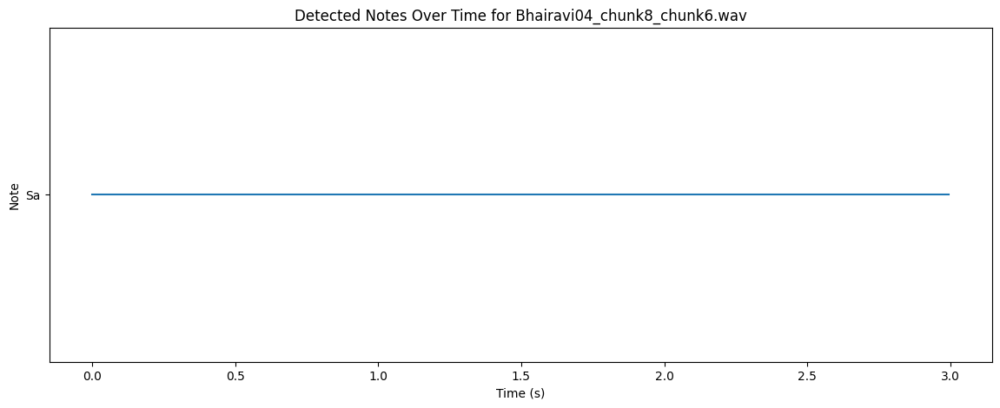

Tonic Frequency for Bhairavi04_chunk8_chunk7.wav: 834.197265625 Hz
Detected Notes for Bhairavi04_chunk8_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


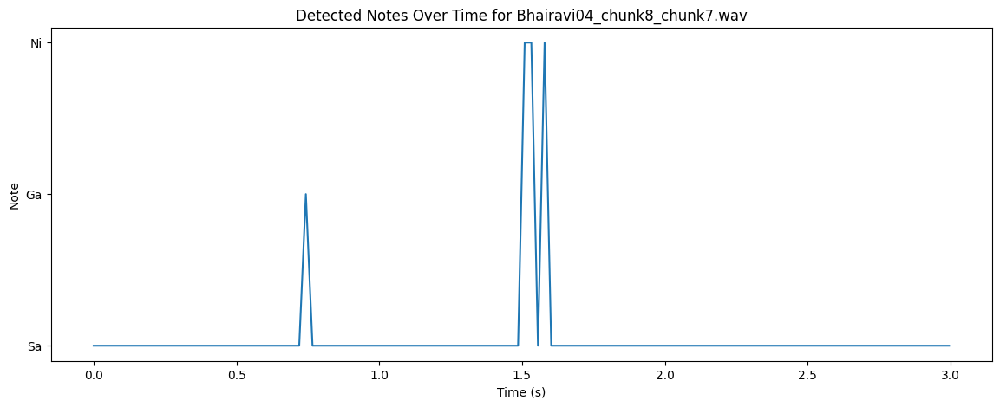

Tonic Frequency for Bhairavi04_chunk8_chunk8.wav: 833.7587890625 Hz
Detected Notes for Bhairavi04_chunk8_chunk8.wav:  ['Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


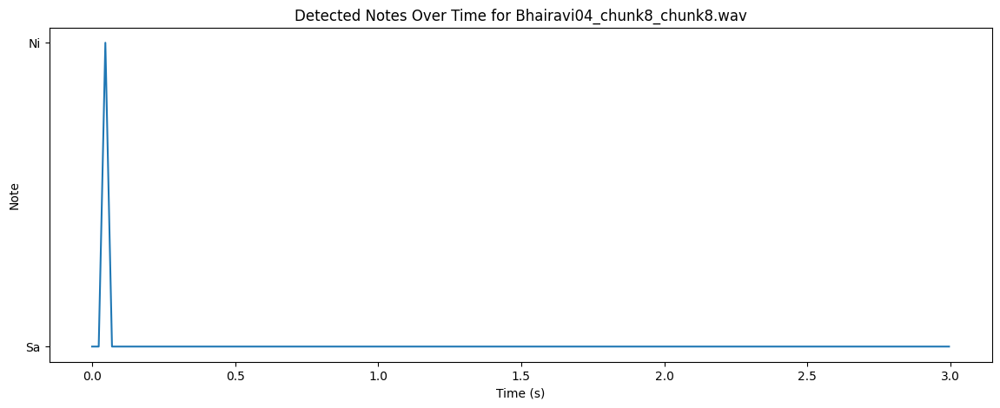

Tonic Frequency for Bhairavi04_chunk8_chunk9.wav: 970.9019775390625 Hz
Detected Notes for Bhairavi04_chunk8_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Ma', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


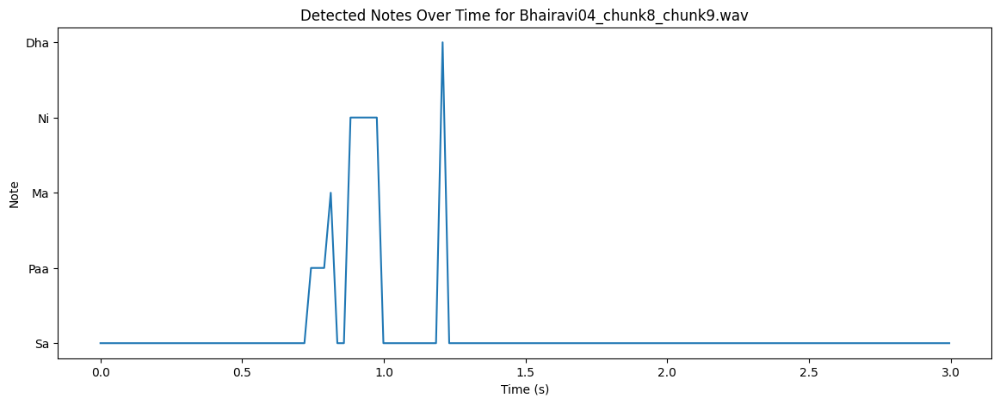

Tonic Frequency for Bhairavi04_chunk8_chunk10.wav: 832.4127197265625 Hz
Detected Notes for Bhairavi04_chunk8_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


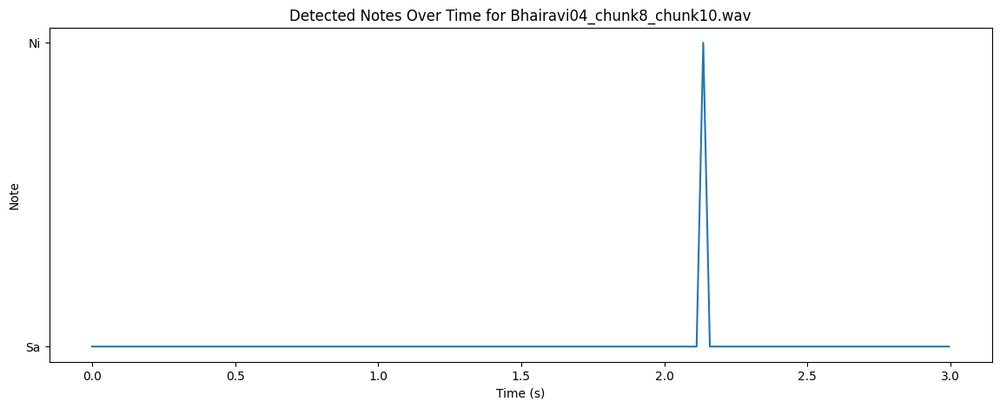

Tonic Frequency for Bhairavi04_chunk9_chunk1.wav: 900.0883178710938 Hz
Detected Notes for Bhairavi04_chunk9_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


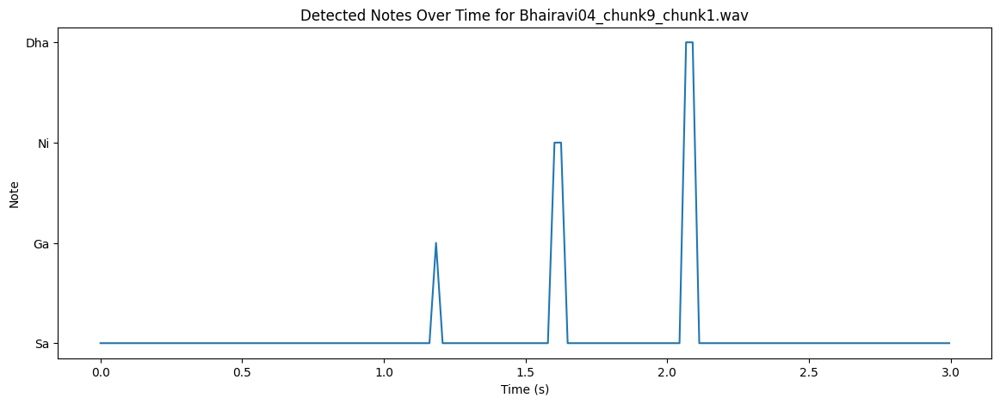

Tonic Frequency for Bhairavi04_chunk9_chunk2.wav: 890.4390258789062 Hz
Detected Notes for Bhairavi04_chunk9_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


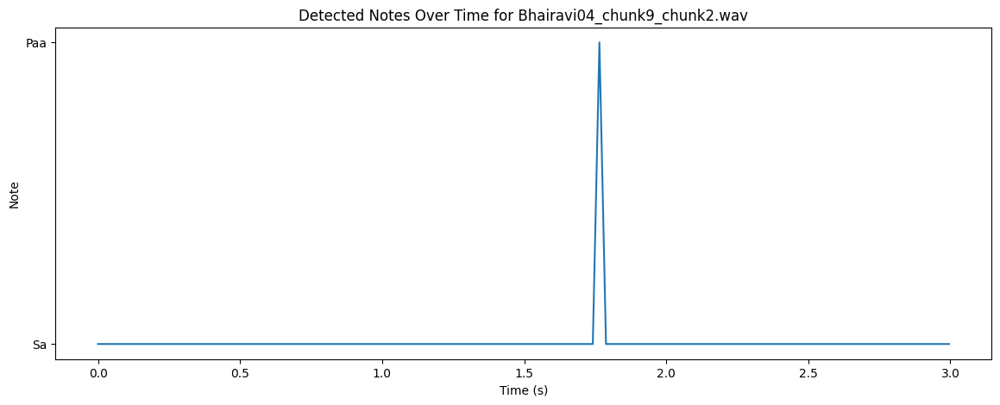

Tonic Frequency for Bhairavi04_chunk9_chunk3.wav: 924.6553955078125 Hz
Detected Notes for Bhairavi04_chunk9_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa']


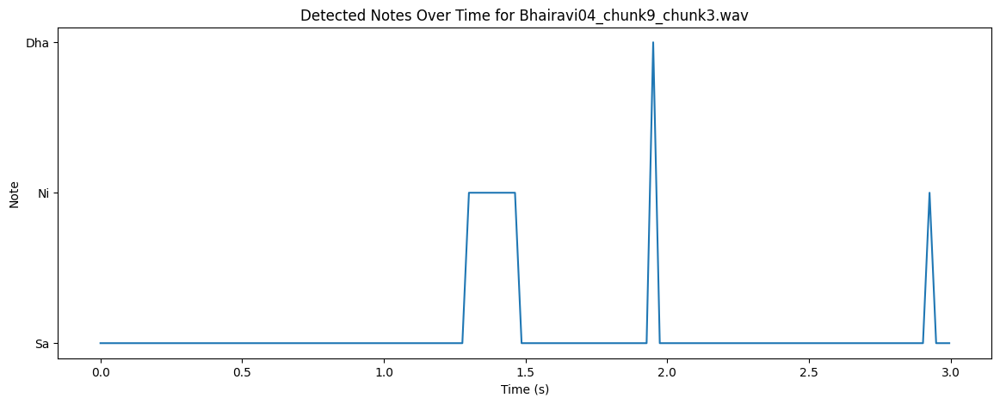

Tonic Frequency for Bhairavi04_chunk9_chunk4.wav: 982.3515625 Hz
Detected Notes for Bhairavi04_chunk9_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa']


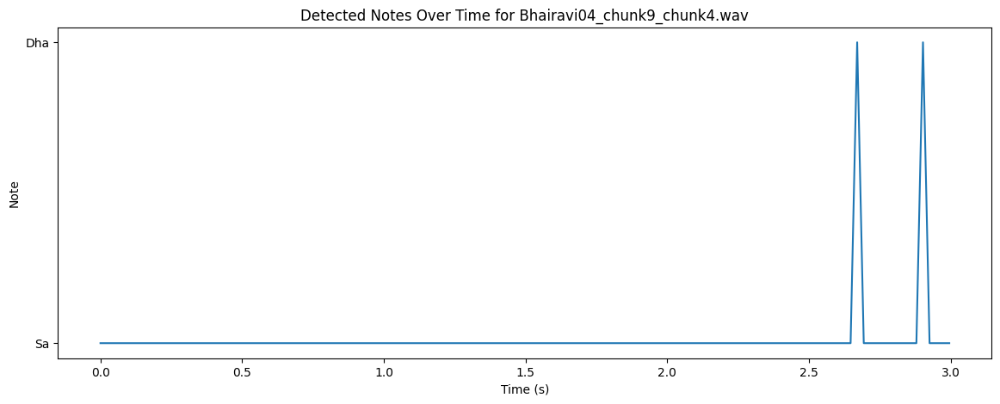

Tonic Frequency for Bhairavi04_chunk9_chunk5.wav: 1039.2432861328125 Hz
Detected Notes for Bhairavi04_chunk9_chunk5.wav:  ['Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


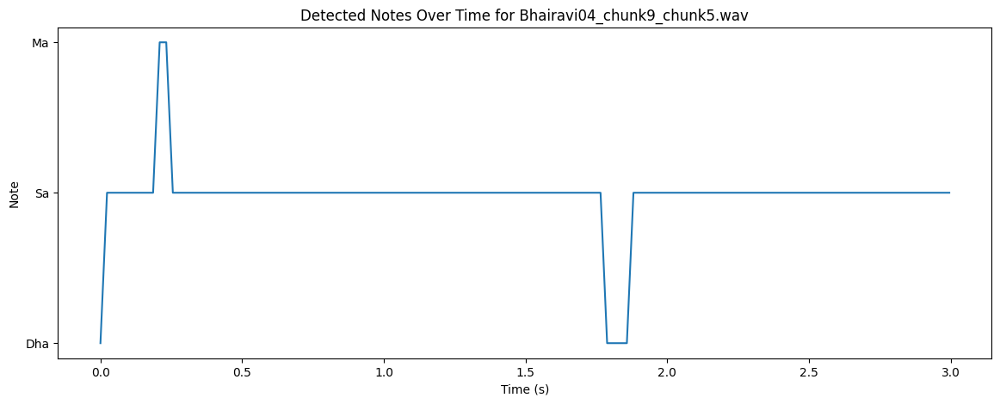

Tonic Frequency for Bhairavi04_chunk9_chunk6.wav: 1108.353271484375 Hz
Detected Notes for Bhairavi04_chunk9_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


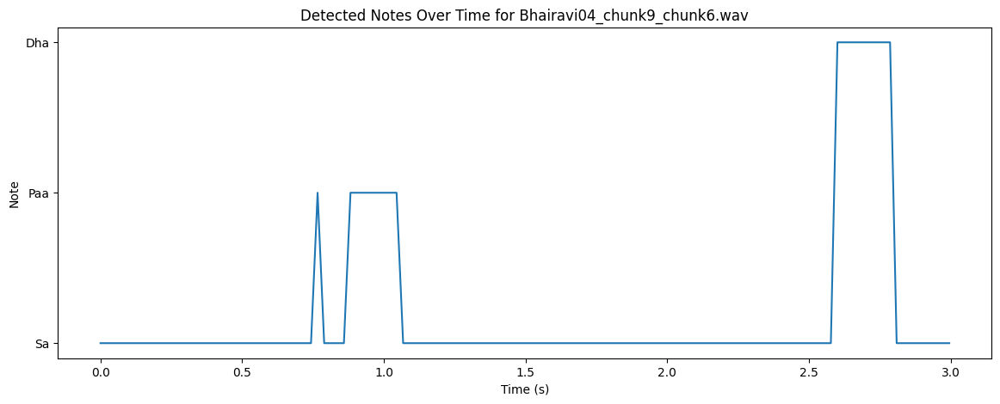

Tonic Frequency for Bhairavi04_chunk9_chunk7.wav: 1141.7457275390625 Hz
Detected Notes for Bhairavi04_chunk9_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa']


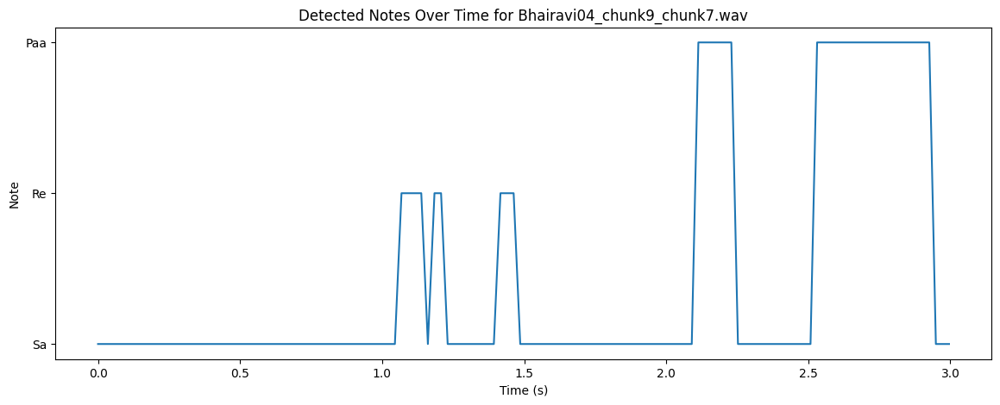

Tonic Frequency for Bhairavi04_chunk9_chunk8.wav: 1040.3778076171875 Hz
Detected Notes for Bhairavi04_chunk9_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma']


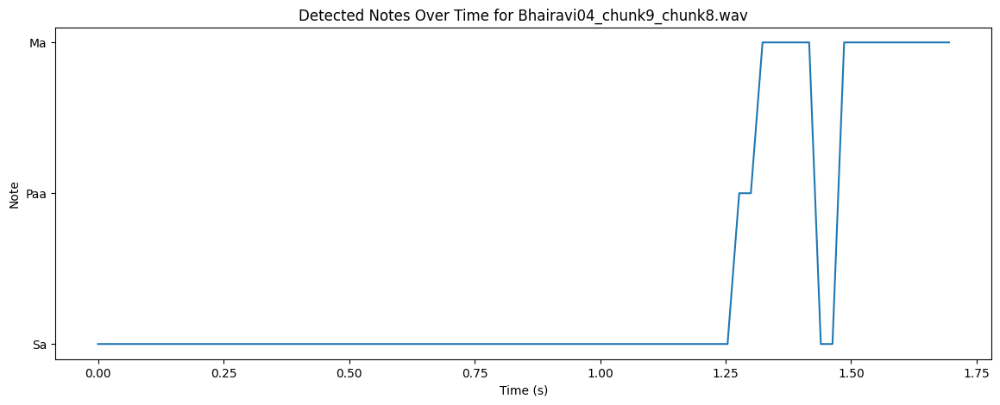

Tonic Frequency for Bhairavi05_chunk1_chunk1.wav: 1043.09375 Hz
Detected Notes for Bhairavi05_chunk1_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


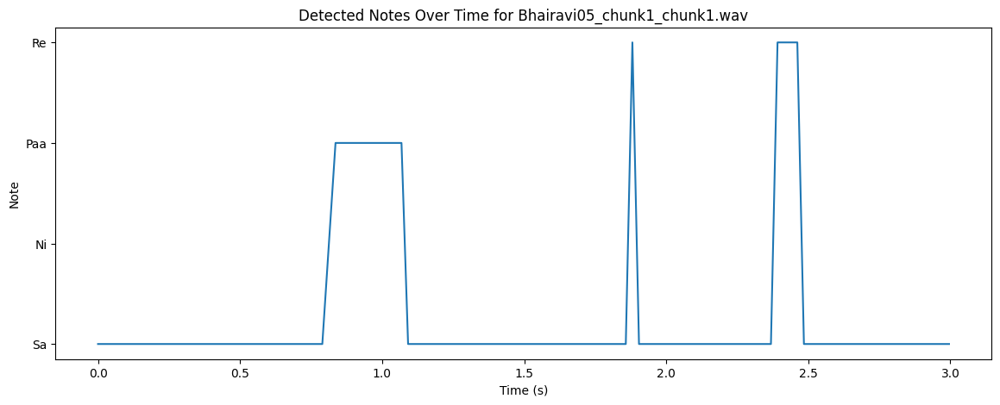

Tonic Frequency for Bhairavi05_chunk1_chunk2.wav: 965.2698974609375 Hz
Detected Notes for Bhairavi05_chunk1_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa']


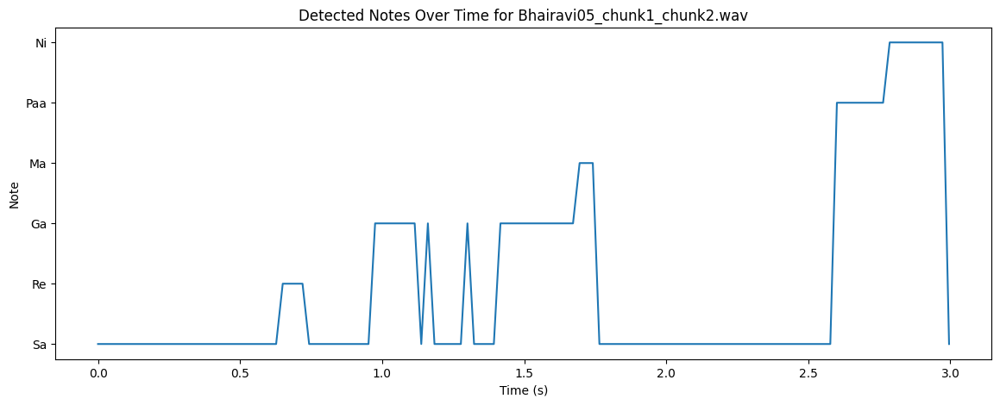

Tonic Frequency for Bhairavi05_chunk1_chunk3.wav: 1107.3192138671875 Hz
Detected Notes for Bhairavi05_chunk1_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


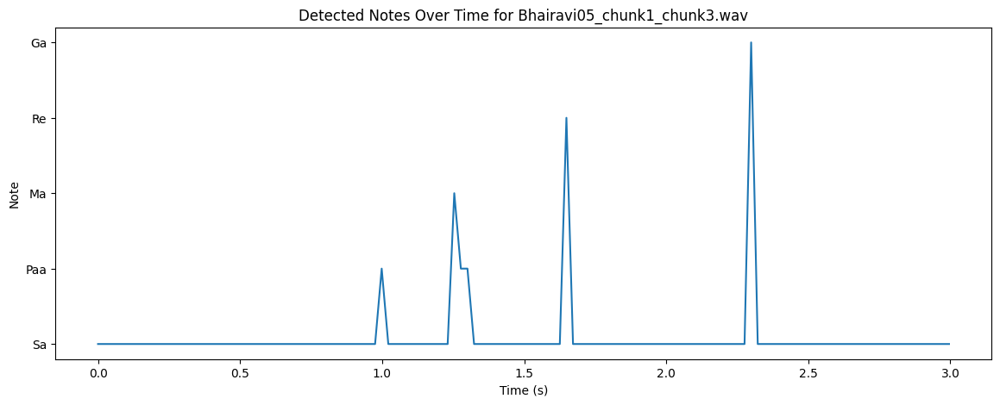

Tonic Frequency for Bhairavi05_chunk1_chunk4.wav: 980.530029296875 Hz
Detected Notes for Bhairavi05_chunk1_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


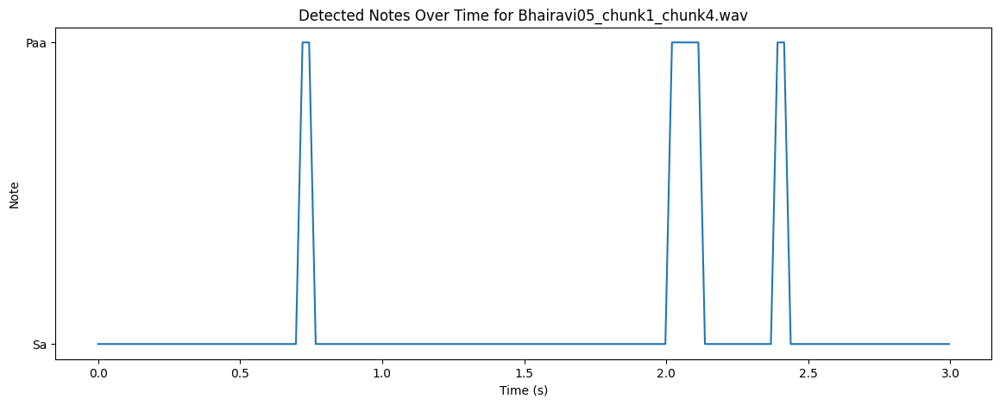

Tonic Frequency for Bhairavi05_chunk1_chunk5.wav: 1043.28662109375 Hz
Detected Notes for Bhairavi05_chunk1_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re']


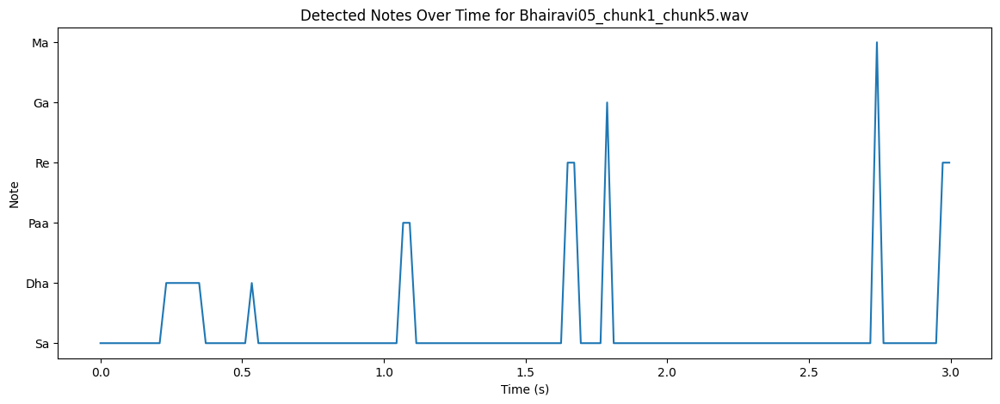

Tonic Frequency for Bhairavi05_chunk1_chunk6.wav: 1033.6356201171875 Hz
Detected Notes for Bhairavi05_chunk1_chunk6.wav:  ['Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha']


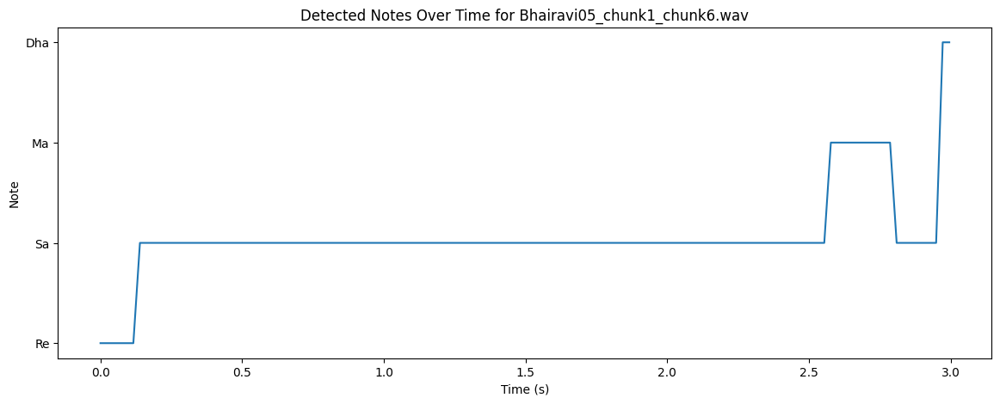

Tonic Frequency for Bhairavi05_chunk1_chunk7.wav: 970.9118041992188 Hz
Detected Notes for Bhairavi05_chunk1_chunk7.wav:  ['Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma']


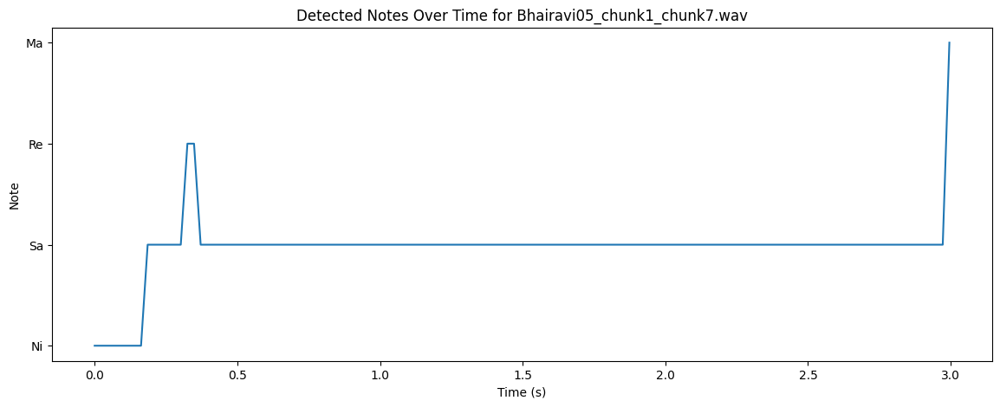

Tonic Frequency for Bhairavi05_chunk1_chunk8.wav: 1101.115478515625 Hz
Detected Notes for Bhairavi05_chunk1_chunk8.wav:  ['Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


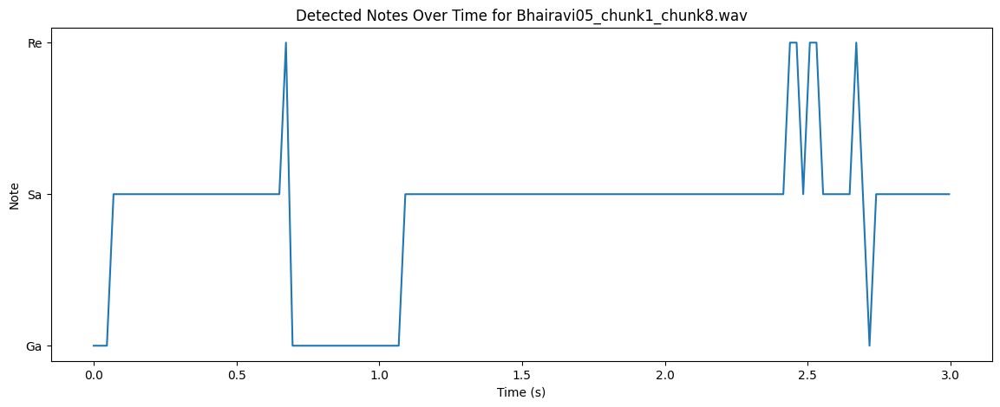

Tonic Frequency for Bhairavi05_chunk1_chunk9.wav: 1106.7108154296875 Hz
Detected Notes for Bhairavi05_chunk1_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


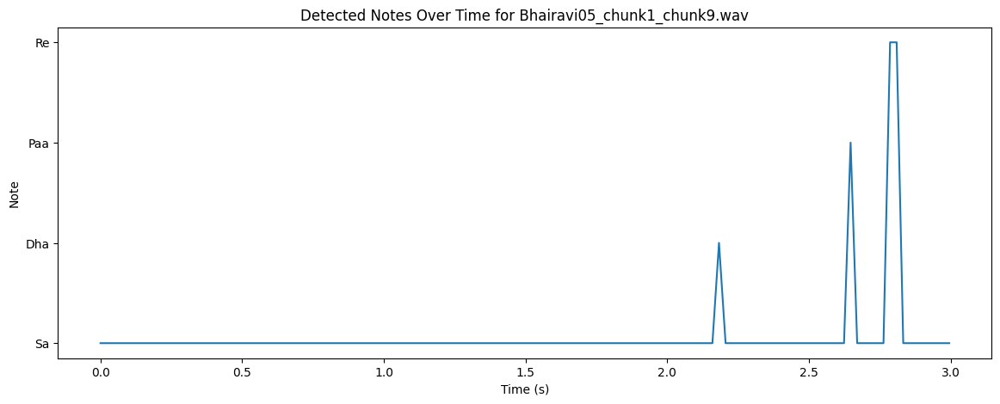

Tonic Frequency for Bhairavi05_chunk1_chunk10.wav: 968.1676025390625 Hz
Detected Notes for Bhairavi05_chunk1_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


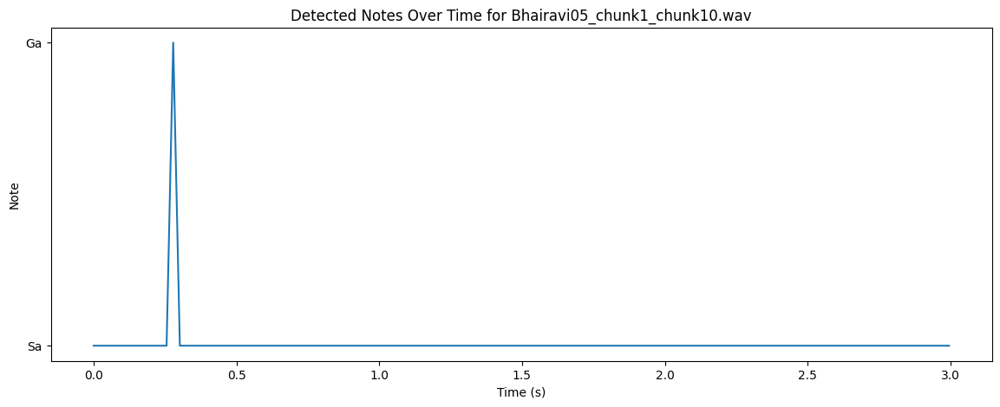

Tonic Frequency for Bhairavi05_chunk2_chunk1.wav: 971.12109375 Hz
Detected Notes for Bhairavi05_chunk2_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


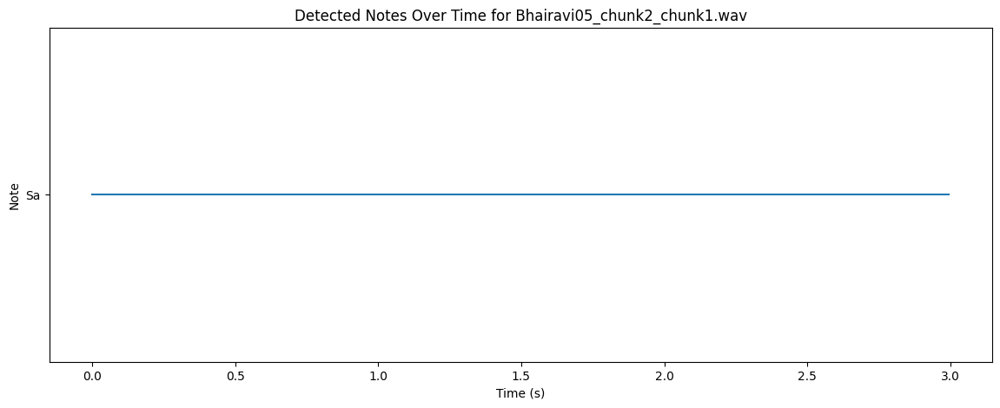

Tonic Frequency for Bhairavi05_chunk2_chunk2.wav: 1037.694580078125 Hz
Detected Notes for Bhairavi05_chunk2_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Dha', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


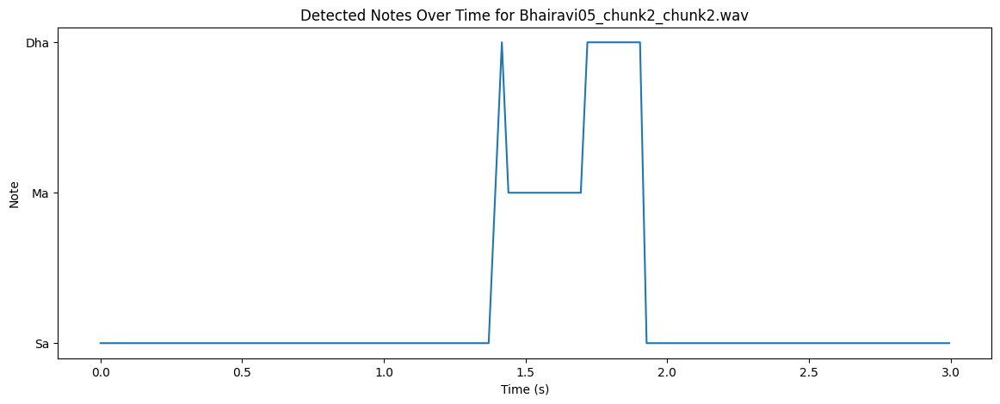

Tonic Frequency for Bhairavi05_chunk2_chunk3.wav: 1031.287109375 Hz
Detected Notes for Bhairavi05_chunk2_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


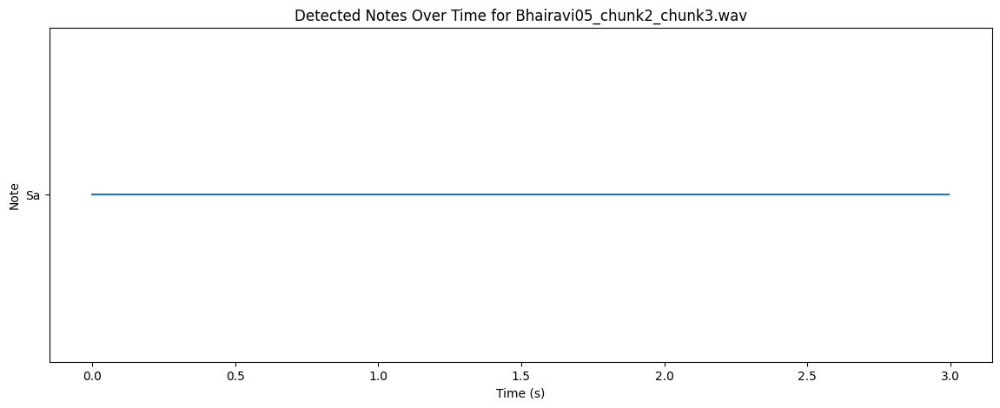

Tonic Frequency for Bhairavi05_chunk2_chunk4.wav: 1045.2103271484375 Hz
Detected Notes for Bhairavi05_chunk2_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ma', 'Ma', 'Ma', 'Ma', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ma', 'Ma', 'Ga', 'Ga', 'Ma', 'Ga', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


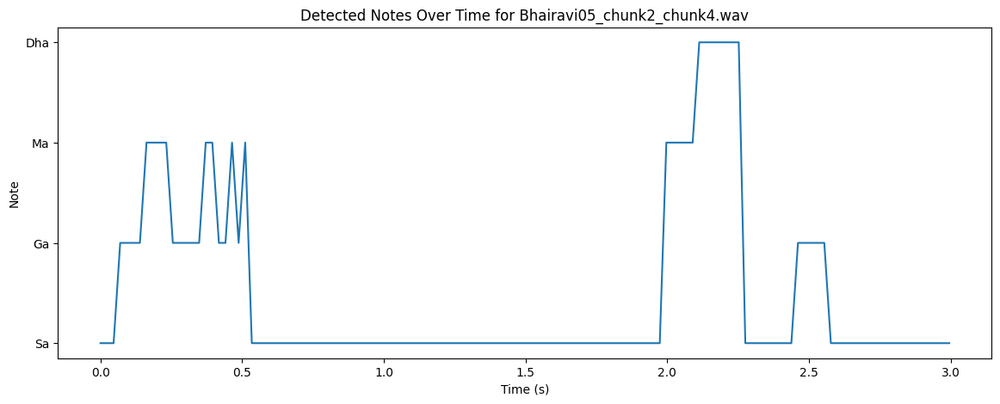

Tonic Frequency for Bhairavi05_chunk2_chunk5.wav: 1117.7493896484375 Hz
Detected Notes for Bhairavi05_chunk2_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Re', 'Re', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


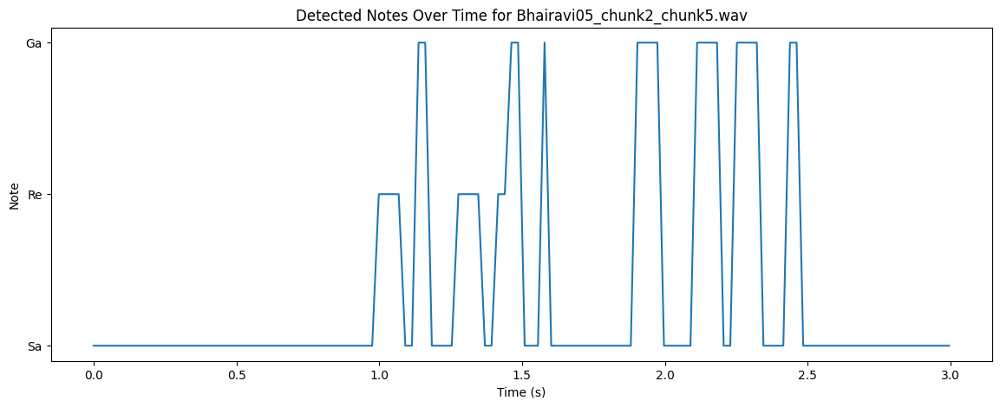

Tonic Frequency for Bhairavi05_chunk2_chunk6.wav: 1054.37158203125 Hz
Detected Notes for Bhairavi05_chunk2_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Paa', 'Paa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Re', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Ga', 'Ga', 'Ga', 'Re', 'Sa', 'Ga', 'Sa', 'Sa']


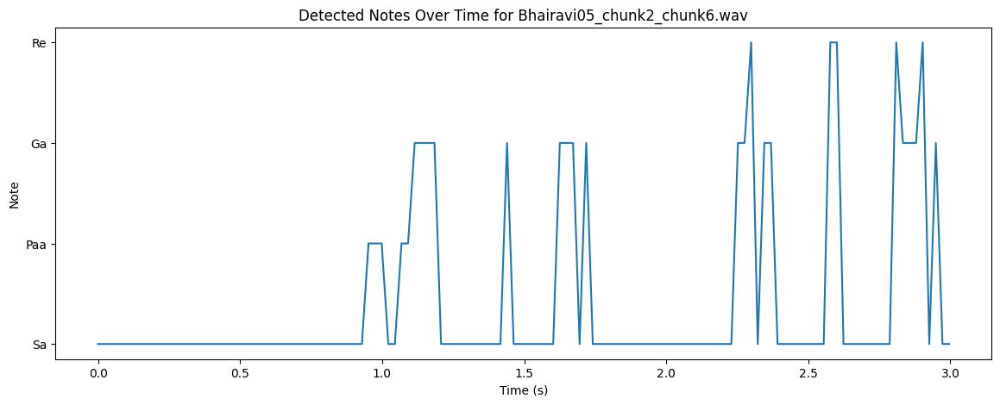

Tonic Frequency for Bhairavi05_chunk2_chunk7.wav: 1114.6968994140625 Hz
Detected Notes for Bhairavi05_chunk2_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Paa', 'Paa']


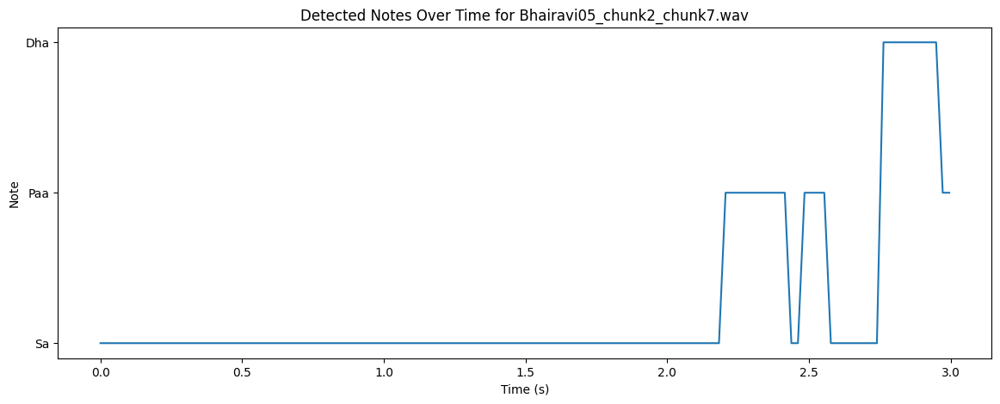

Tonic Frequency for Bhairavi05_chunk2_chunk8.wav: 1110.853759765625 Hz
Detected Notes for Bhairavi05_chunk2_chunk8.wav:  ['Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa']


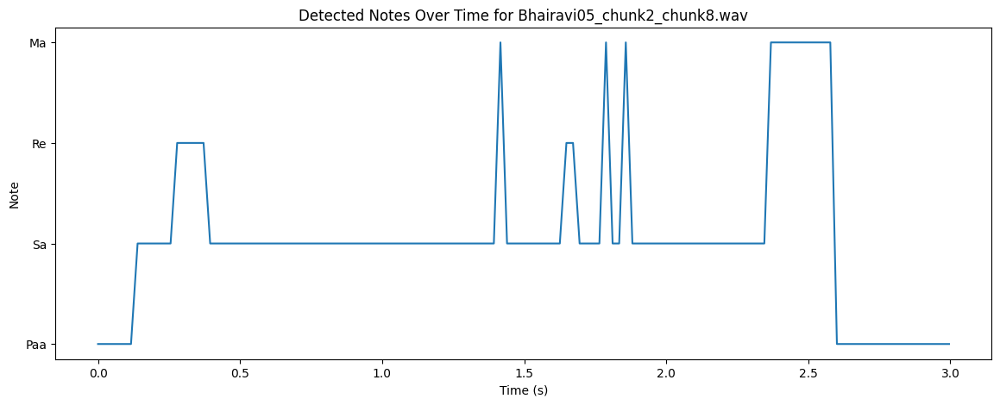

Tonic Frequency for Bhairavi05_chunk2_chunk9.wav: 1110.3585205078125 Hz
Detected Notes for Bhairavi05_chunk2_chunk9.wav:  ['Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ga']


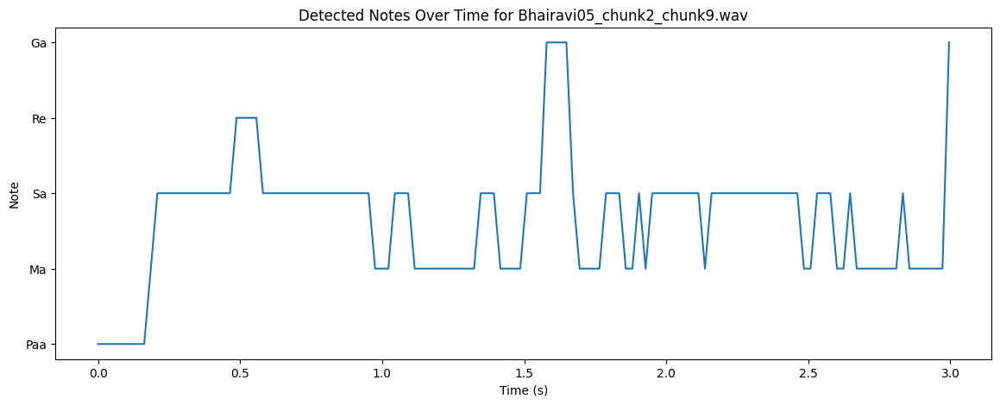

Tonic Frequency for Bhairavi05_chunk2_chunk10.wav: 1109.20849609375 Hz
Detected Notes for Bhairavi05_chunk2_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


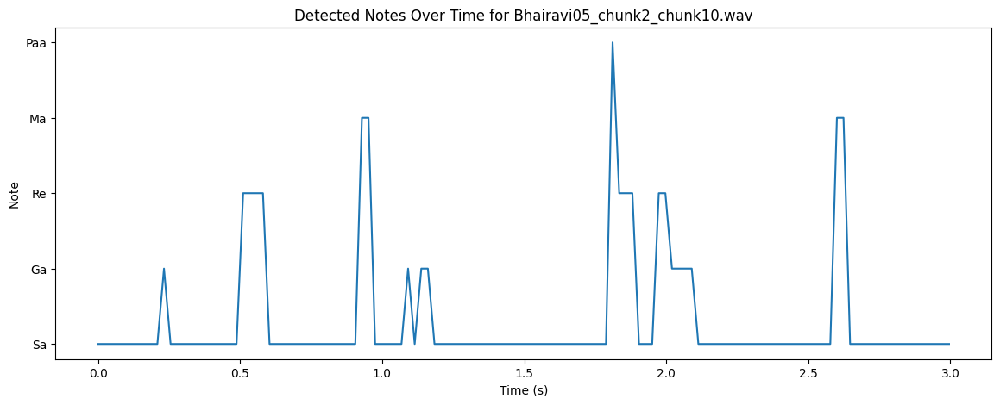

Tonic Frequency for Bhairavi05_chunk3_chunk1.wav: 1109.16552734375 Hz
Detected Notes for Bhairavi05_chunk3_chunk1.wav:  ['Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga']


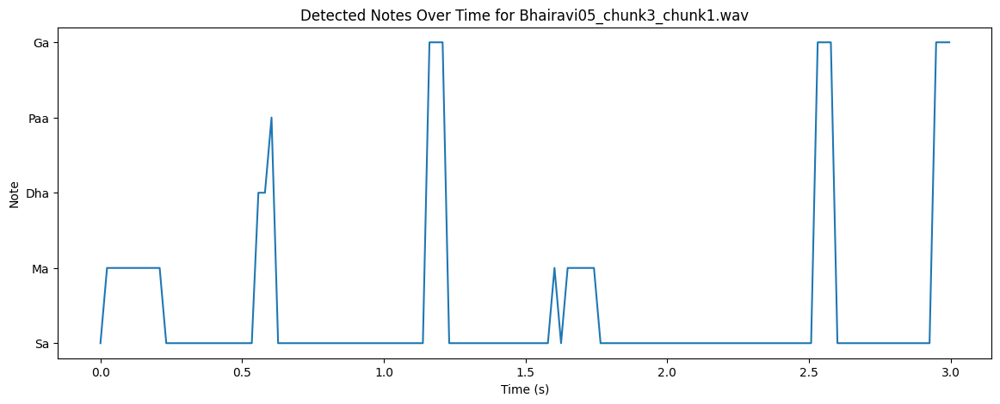

Tonic Frequency for Bhairavi05_chunk3_chunk2.wav: 972.0927124023438 Hz
Detected Notes for Bhairavi05_chunk3_chunk2.wav:  ['Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa']


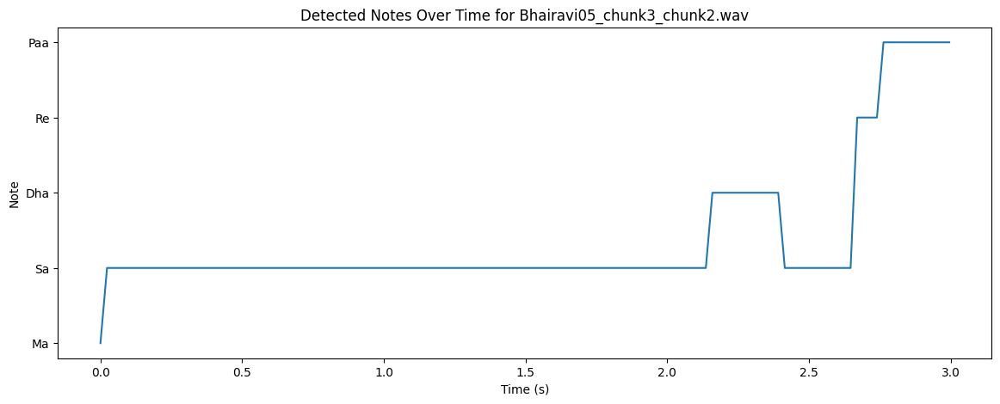

Tonic Frequency for Bhairavi05_chunk3_chunk3.wav: 1142.4759521484375 Hz
Detected Notes for Bhairavi05_chunk3_chunk3.wav:  ['Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Paa', 'Paa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Ma', 'Ma', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


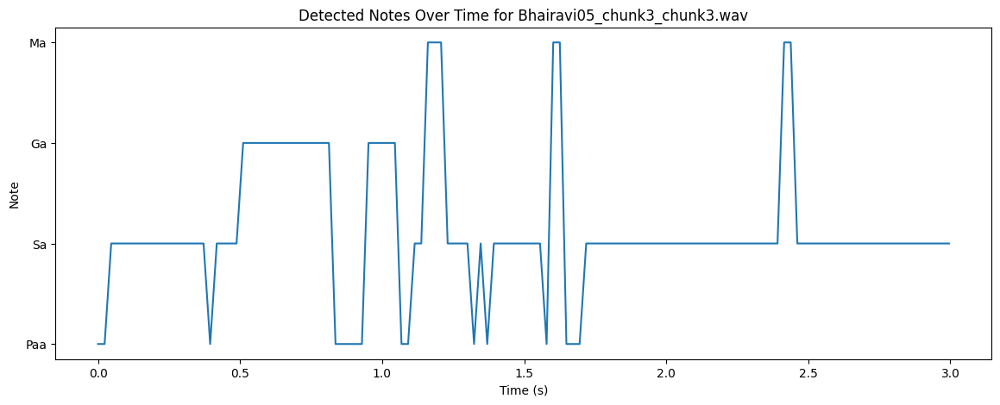

Tonic Frequency for Bhairavi05_chunk3_chunk4.wav: 812.8910522460938 Hz
Detected Notes for Bhairavi05_chunk3_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


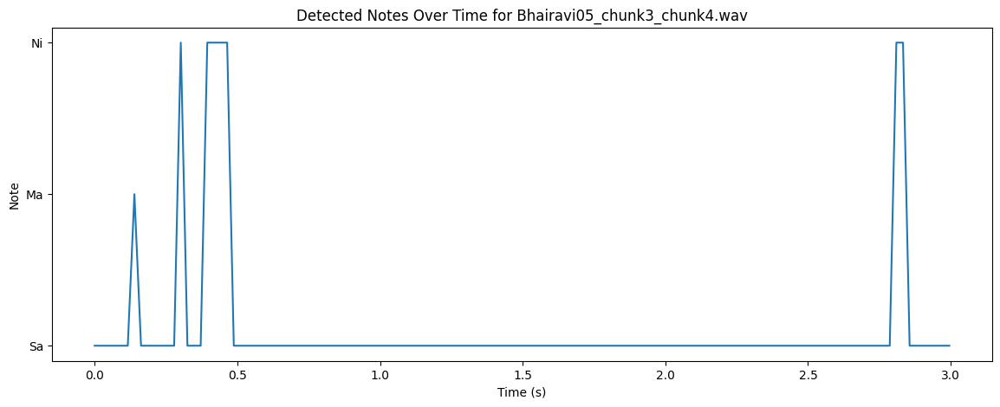

Tonic Frequency for Bhairavi05_chunk3_chunk5.wav: 835.0421142578125 Hz
Detected Notes for Bhairavi05_chunk3_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


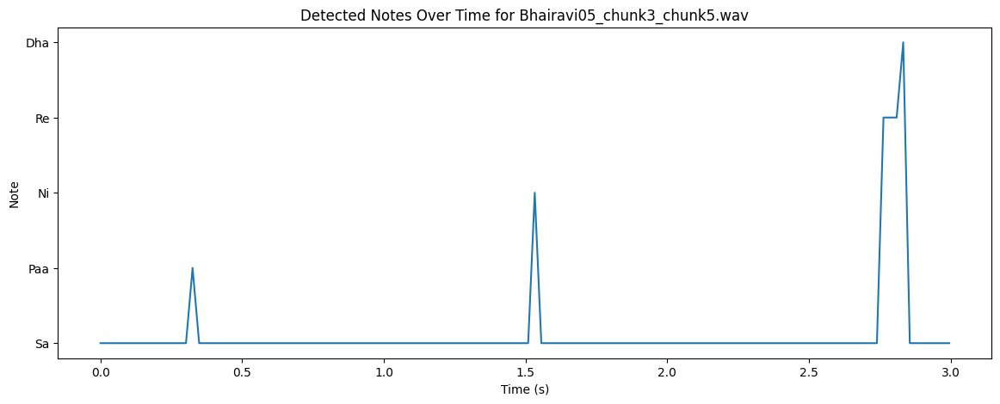

Tonic Frequency for Bhairavi05_chunk3_chunk6.wav: 830.884765625 Hz
Detected Notes for Bhairavi05_chunk3_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


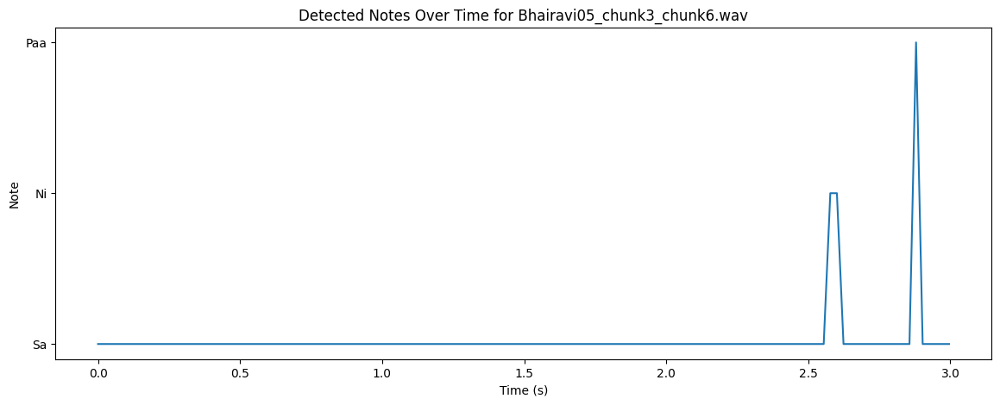

Tonic Frequency for Bhairavi05_chunk3_chunk7.wav: 890.710205078125 Hz
Detected Notes for Bhairavi05_chunk3_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


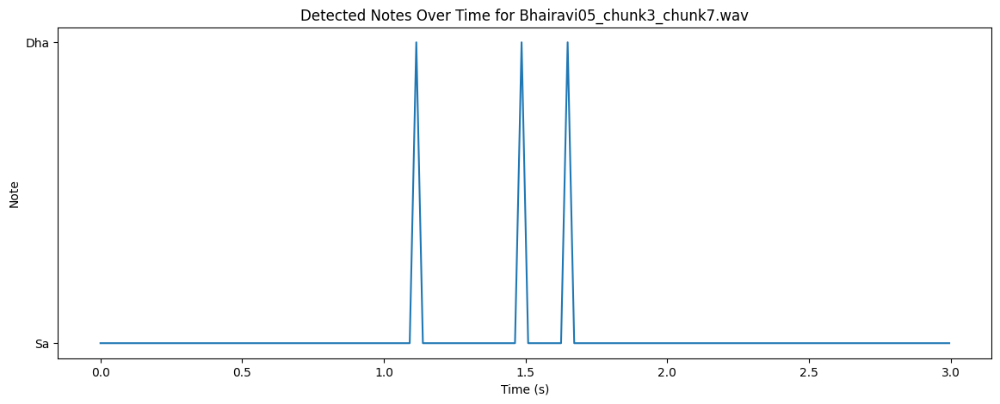

Tonic Frequency for Bhairavi05_chunk3_chunk8.wav: 832.0521240234375 Hz
Detected Notes for Bhairavi05_chunk3_chunk8.wav:  ['Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


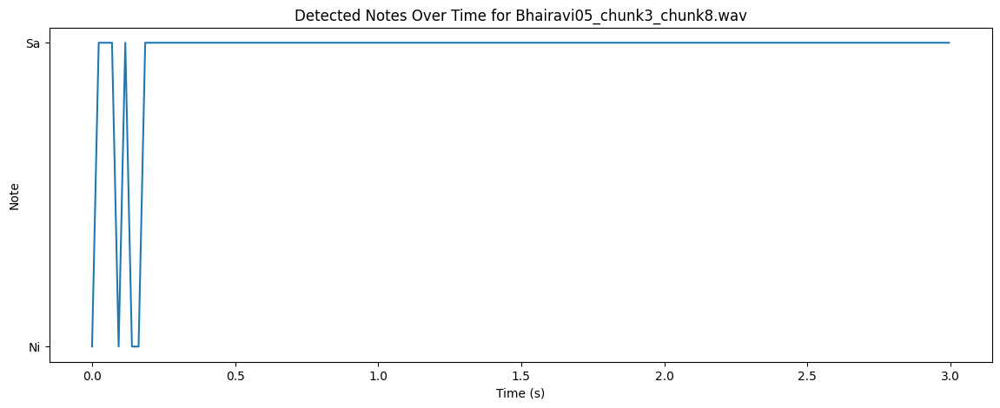

Tonic Frequency for Bhairavi05_chunk3_chunk9.wav: 864.199462890625 Hz
Detected Notes for Bhairavi05_chunk3_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


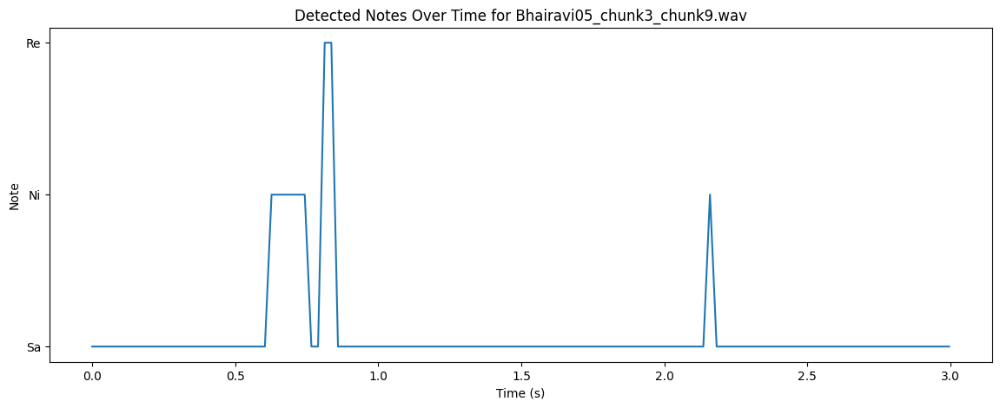

Tonic Frequency for Bhairavi05_chunk3_chunk10.wav: 835.1746826171875 Hz
Detected Notes for Bhairavi05_chunk3_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


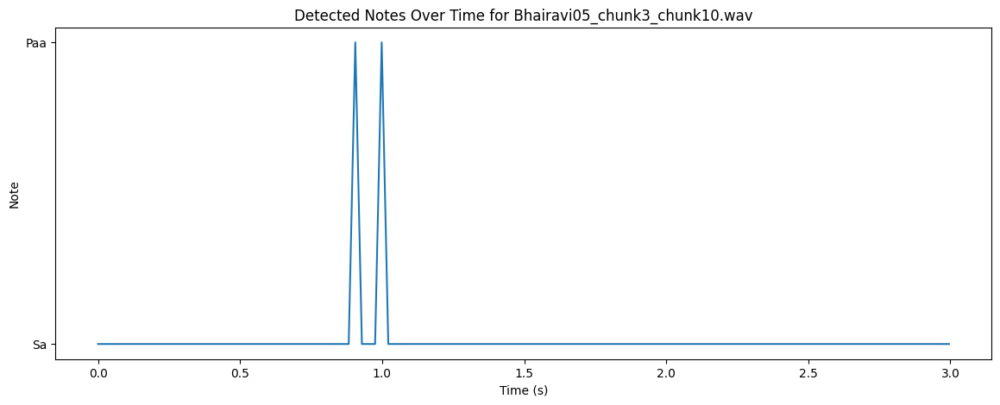

Tonic Frequency for Bhairavi05_chunk4_chunk1.wav: 935.7608642578125 Hz
Detected Notes for Bhairavi05_chunk4_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


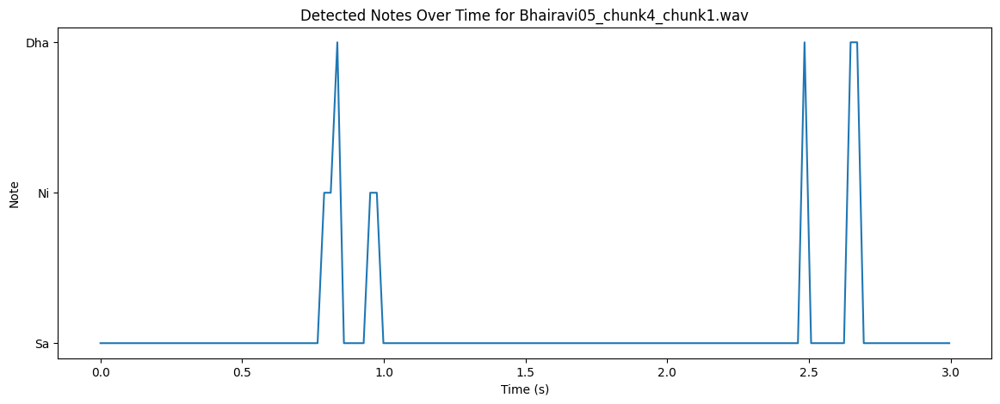

Tonic Frequency for Bhairavi05_chunk4_chunk2.wav: 888.6680297851562 Hz
Detected Notes for Bhairavi05_chunk4_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


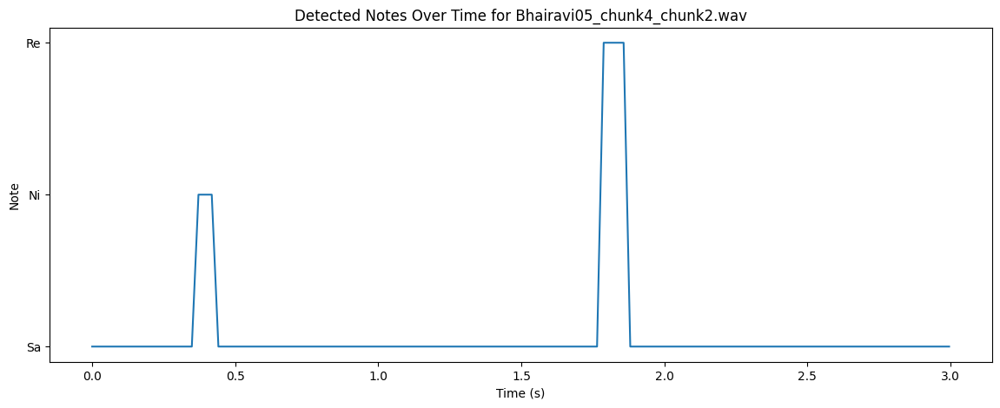

Tonic Frequency for Bhairavi05_chunk4_chunk3.wav: 966.013427734375 Hz
Detected Notes for Bhairavi05_chunk4_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


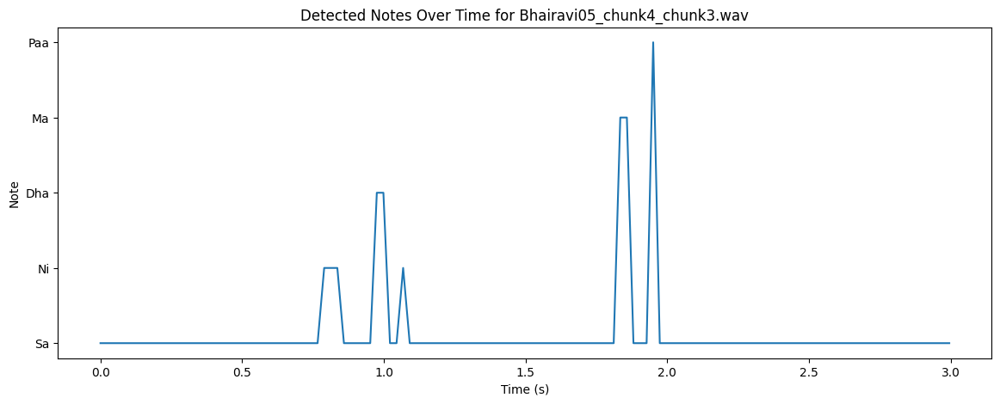

Tonic Frequency for Bhairavi05_chunk4_chunk4.wav: 753.7686767578125 Hz
Detected Notes for Bhairavi05_chunk4_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


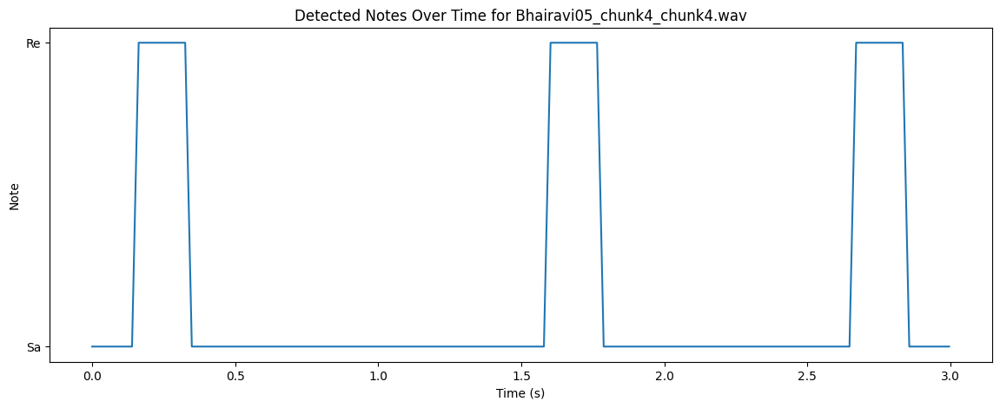

Tonic Frequency for Bhairavi05_chunk4_chunk5.wav: 869.1167602539062 Hz
Detected Notes for Bhairavi05_chunk4_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


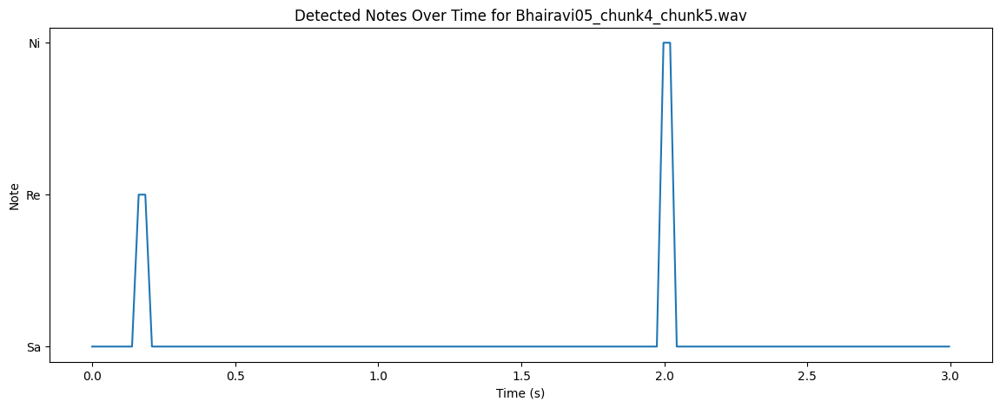

Tonic Frequency for Bhairavi05_chunk4_chunk6.wav: 969.9437255859375 Hz
Detected Notes for Bhairavi05_chunk4_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


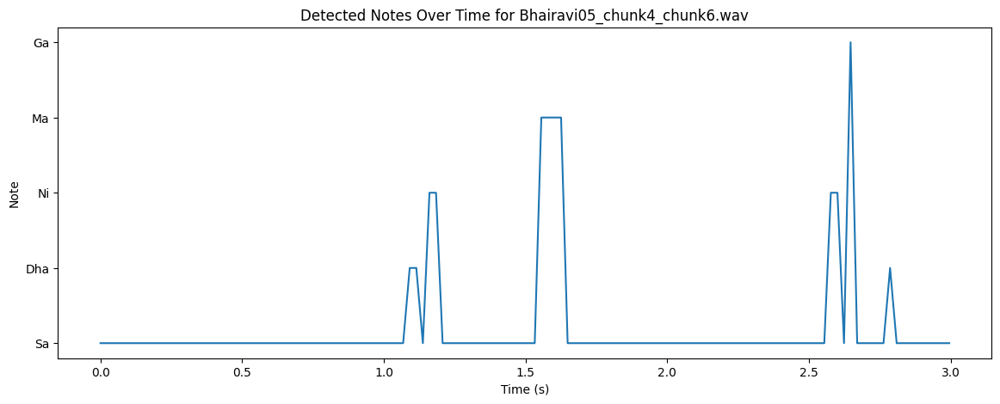

Tonic Frequency for Bhairavi05_chunk4_chunk7.wav: 936.365478515625 Hz
Detected Notes for Bhairavi05_chunk4_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


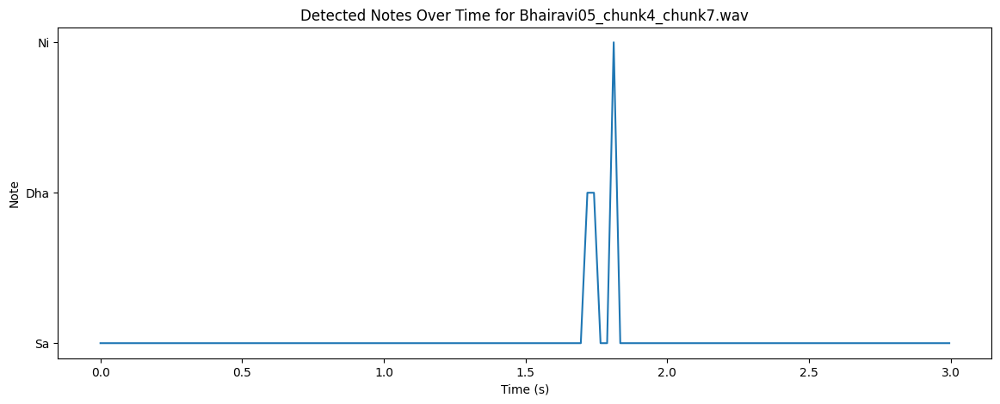

Tonic Frequency for Bhairavi05_chunk4_chunk8.wav: 935.7122192382812 Hz
Detected Notes for Bhairavi05_chunk4_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


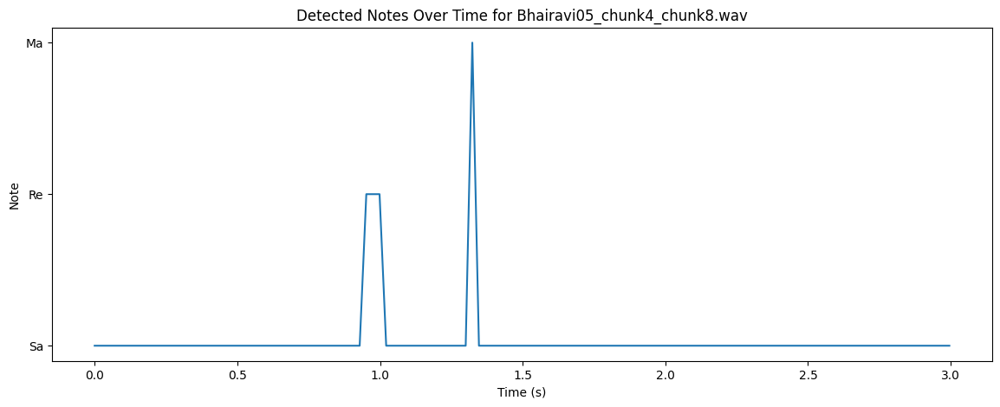

Tonic Frequency for Bhairavi05_chunk4_chunk9.wav: 833.0546264648438 Hz
Detected Notes for Bhairavi05_chunk4_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


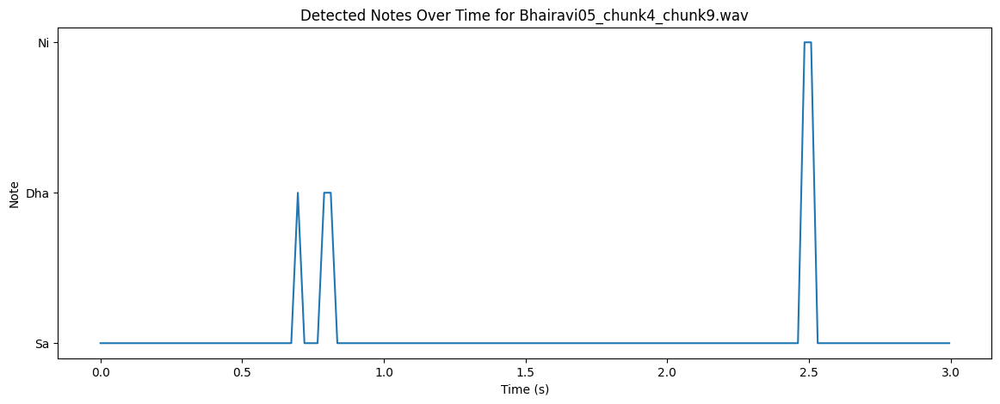

Tonic Frequency for Bhairavi05_chunk4_chunk10.wav: 939.5853881835938 Hz
Detected Notes for Bhairavi05_chunk4_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Paa', 'Ma', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


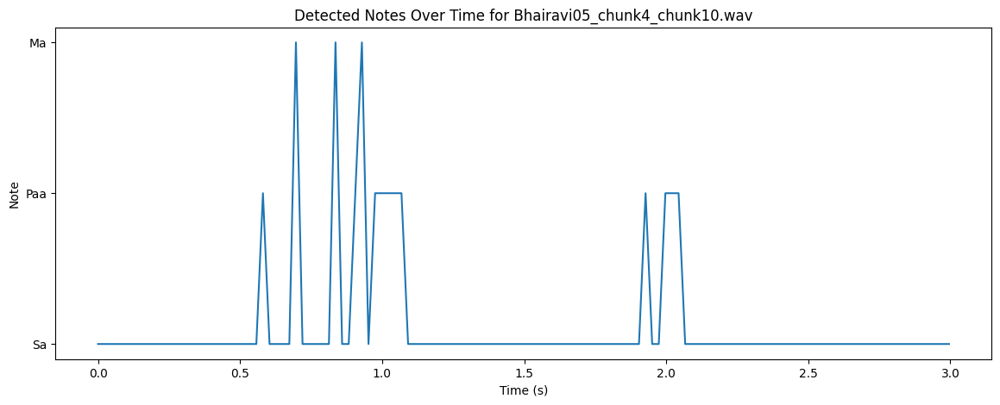

Tonic Frequency for Bhairavi05_chunk5_chunk1.wav: 935.52880859375 Hz
Detected Notes for Bhairavi05_chunk5_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma']


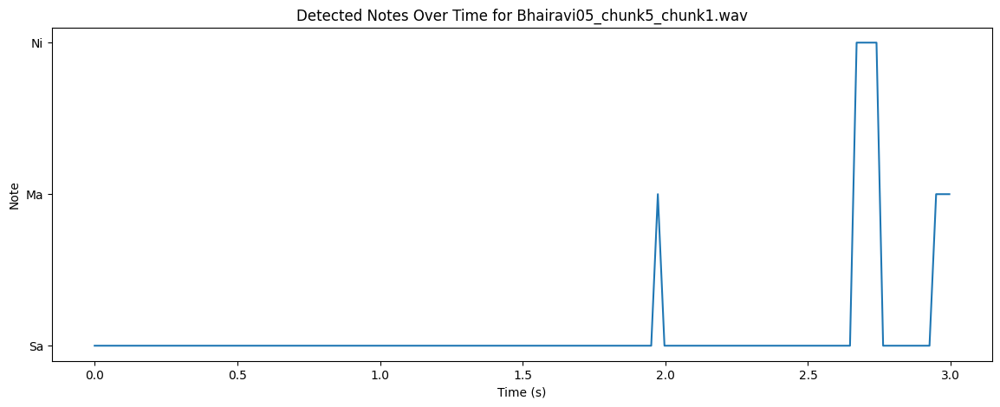

Tonic Frequency for Bhairavi05_chunk5_chunk2.wav: 831.1182250976562 Hz
Detected Notes for Bhairavi05_chunk5_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


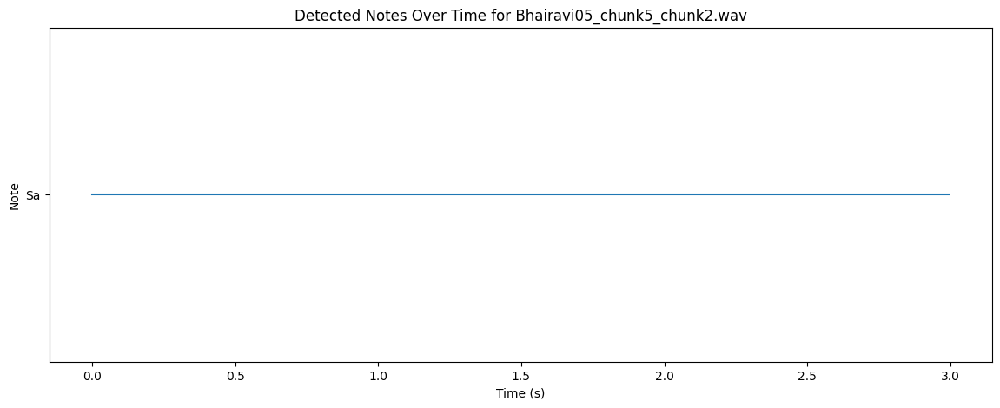

Tonic Frequency for Bhairavi05_chunk5_chunk3.wav: 833.3833618164062 Hz
Detected Notes for Bhairavi05_chunk5_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


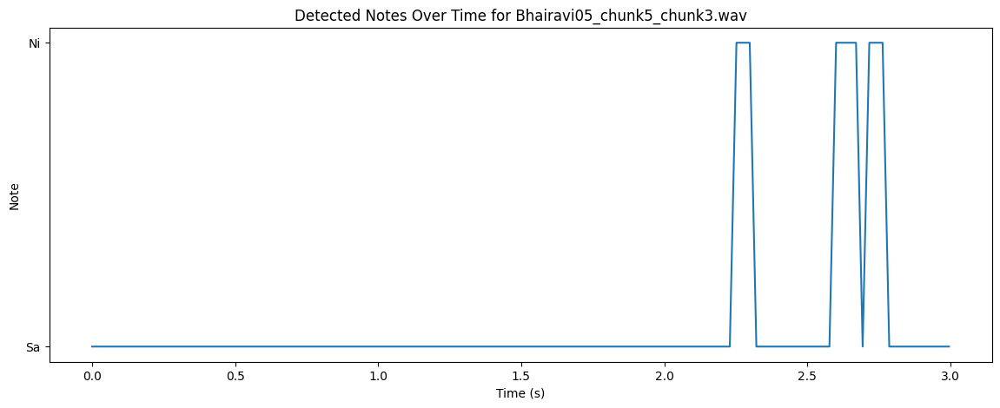

Tonic Frequency for Bhairavi05_chunk5_chunk4.wav: 1039.355712890625 Hz
Detected Notes for Bhairavi05_chunk5_chunk4.wav:  ['Dha', 'Dha', 'Dha', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa']


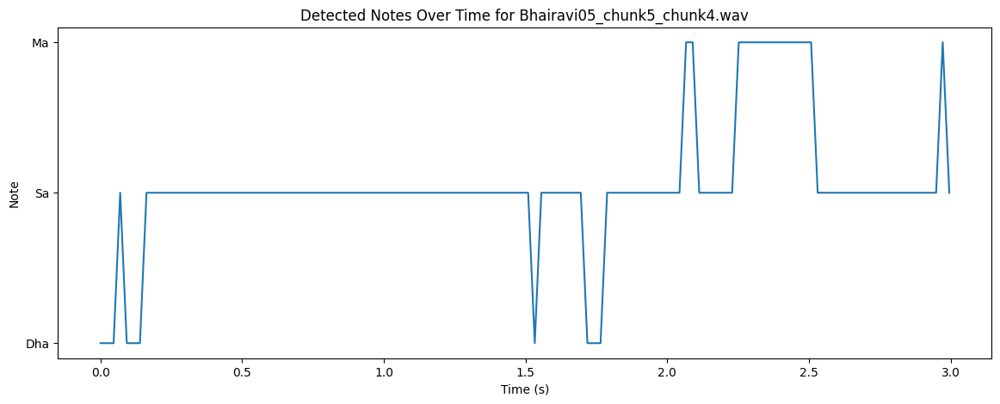

Tonic Frequency for Bhairavi05_chunk5_chunk5.wav: 833.5509643554688 Hz
Detected Notes for Bhairavi05_chunk5_chunk5.wav:  ['Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


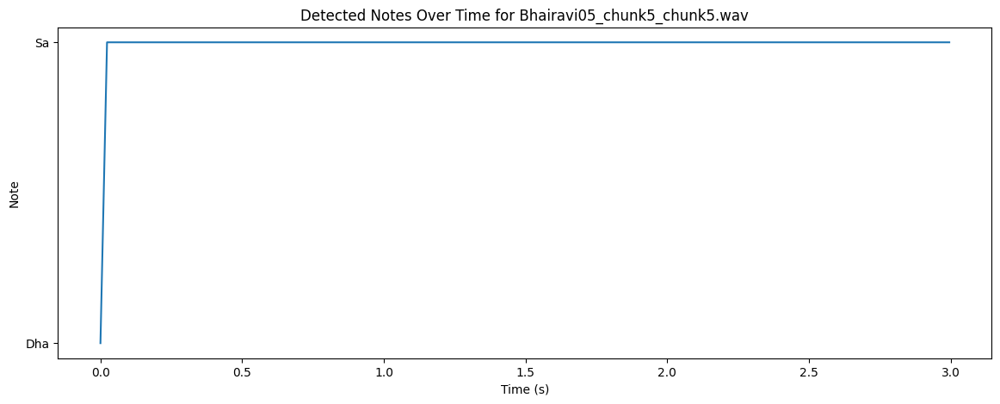

Tonic Frequency for Bhairavi05_chunk5_chunk6.wav: 969.2329711914062 Hz
Detected Notes for Bhairavi05_chunk5_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa']


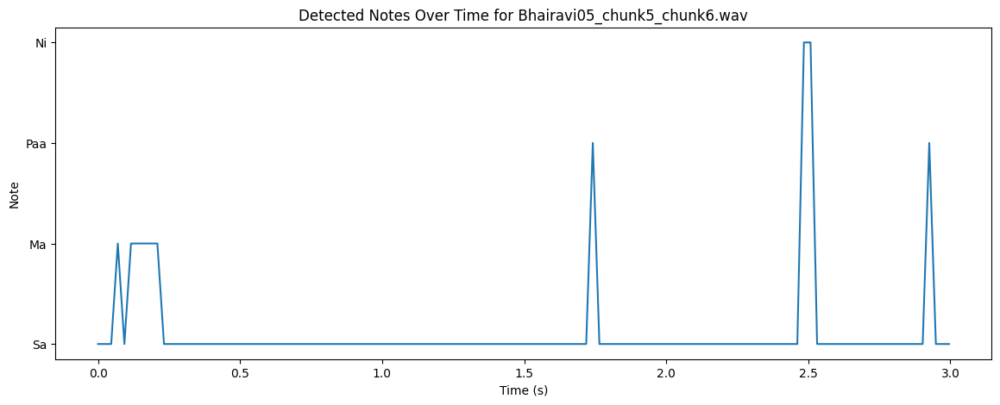

Tonic Frequency for Bhairavi05_chunk5_chunk7.wav: 833.03515625 Hz
Detected Notes for Bhairavi05_chunk5_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


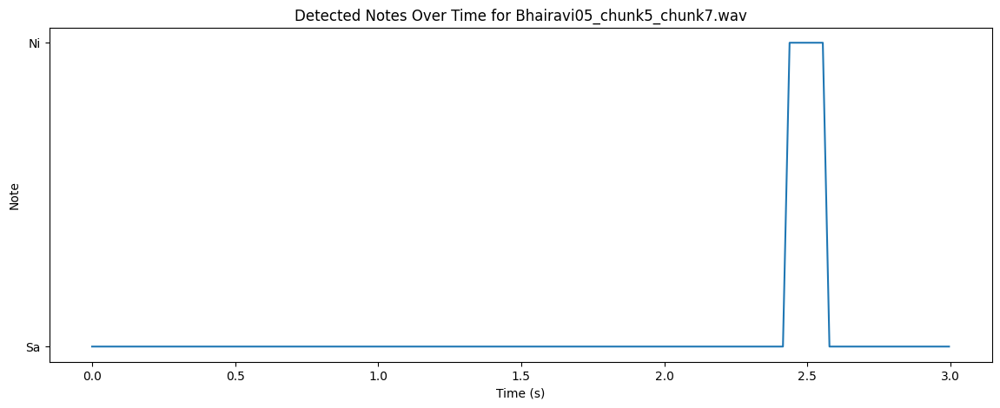

Tonic Frequency for Bhairavi05_chunk5_chunk8.wav: 939.69482421875 Hz
Detected Notes for Bhairavi05_chunk5_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


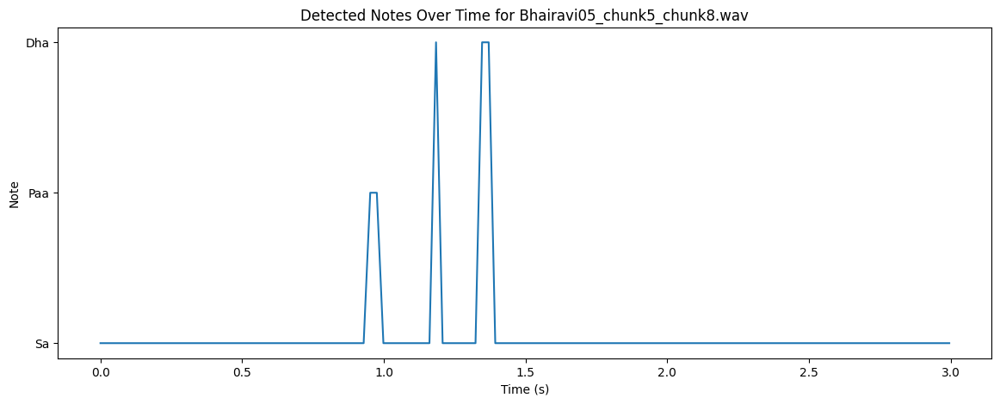

Tonic Frequency for Bhairavi05_chunk5_chunk9.wav: 692.9163208007812 Hz
Detected Notes for Bhairavi05_chunk5_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


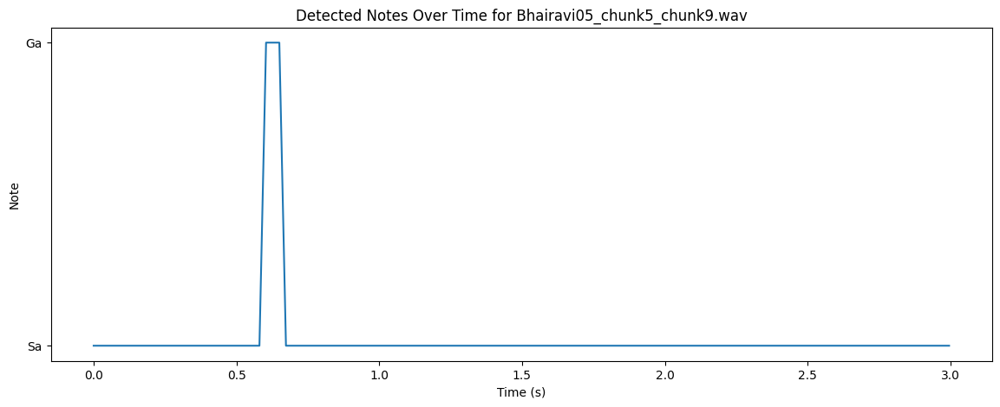

Tonic Frequency for Bhairavi05_chunk5_chunk10.wav: 848.2062377929688 Hz
Detected Notes for Bhairavi05_chunk5_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


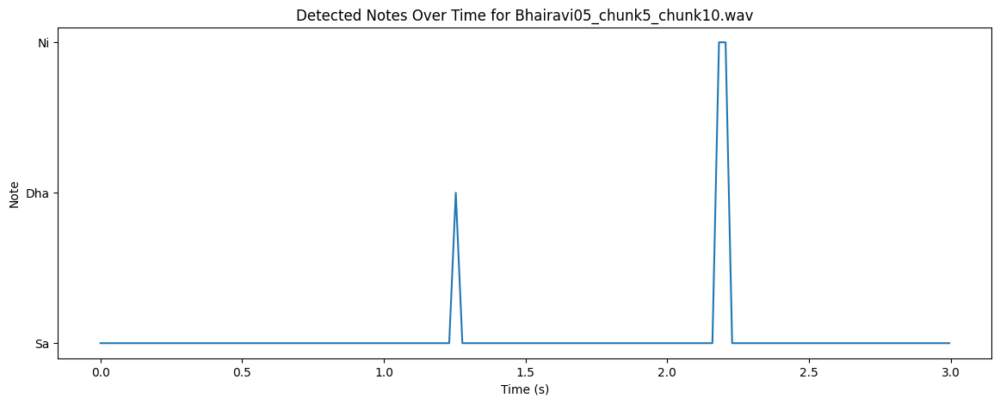

Tonic Frequency for Bhairavi05_chunk6_chunk1.wav: 970.3388671875 Hz
Detected Notes for Bhairavi05_chunk6_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha']


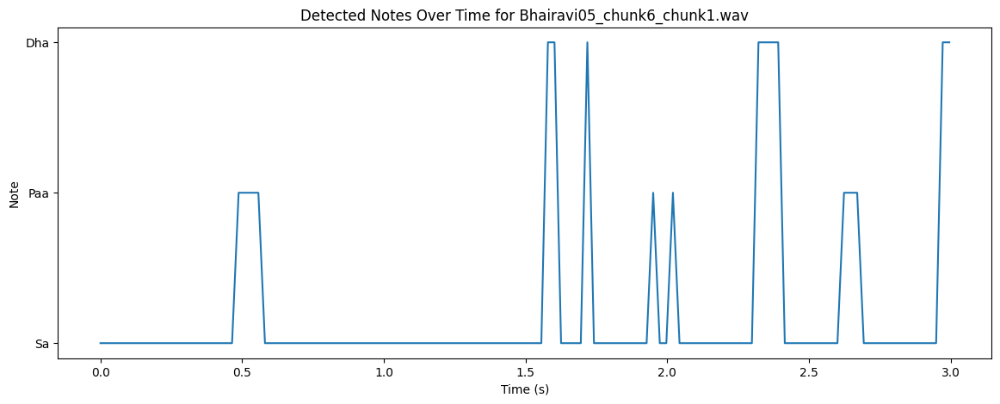

Tonic Frequency for Bhairavi05_chunk6_chunk2.wav: 941.6729736328125 Hz
Detected Notes for Bhairavi05_chunk6_chunk2.wav:  ['Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


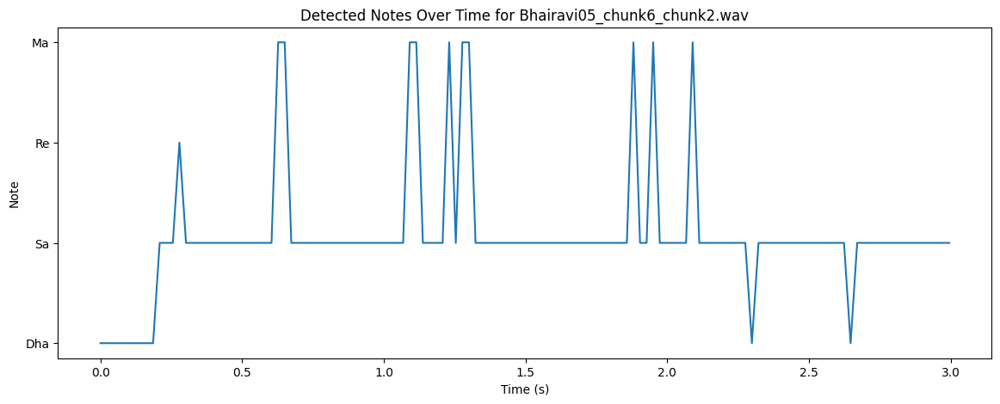

Tonic Frequency for Bhairavi05_chunk6_chunk3.wav: 884.1521606445312 Hz
Detected Notes for Bhairavi05_chunk6_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


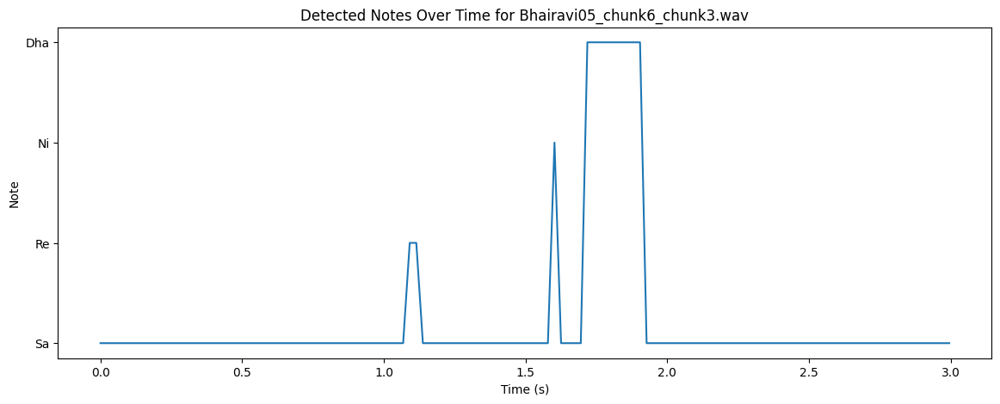

Tonic Frequency for Bhairavi05_chunk6_chunk4.wav: 867.7843017578125 Hz
Detected Notes for Bhairavi05_chunk6_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa']


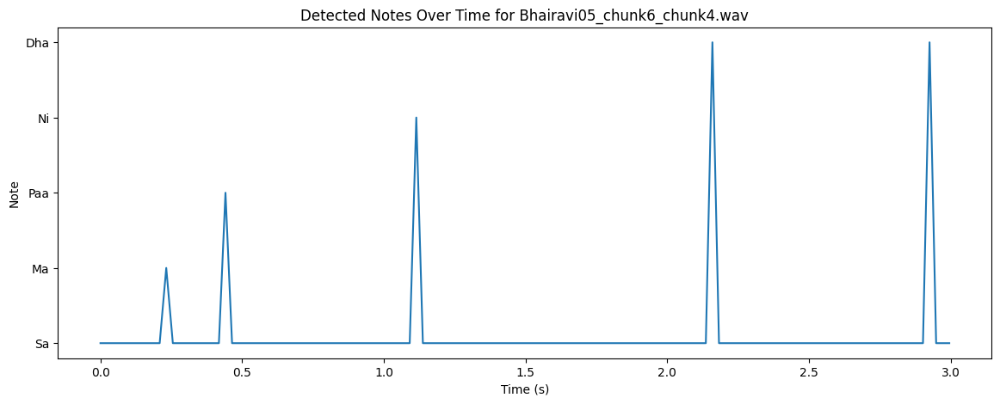

Tonic Frequency for Bhairavi05_chunk6_chunk5.wav: 830.6154174804688 Hz
Detected Notes for Bhairavi05_chunk6_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


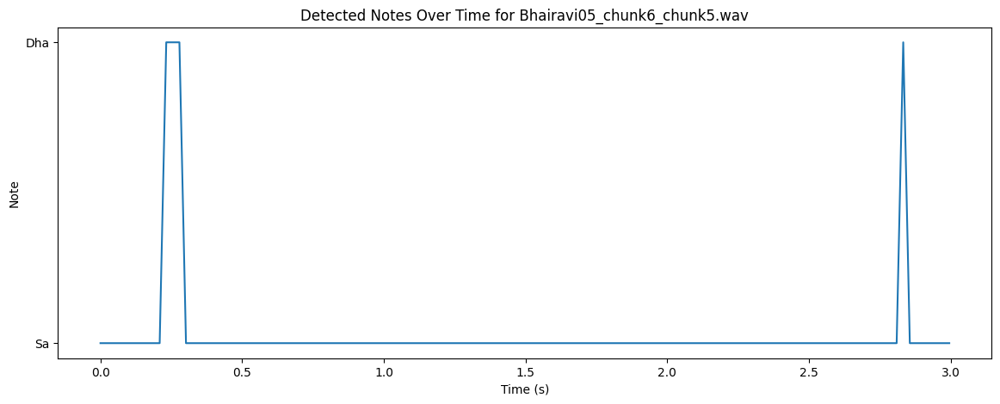

Tonic Frequency for Bhairavi05_chunk6_chunk6.wav: 830.2763671875 Hz
Detected Notes for Bhairavi05_chunk6_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


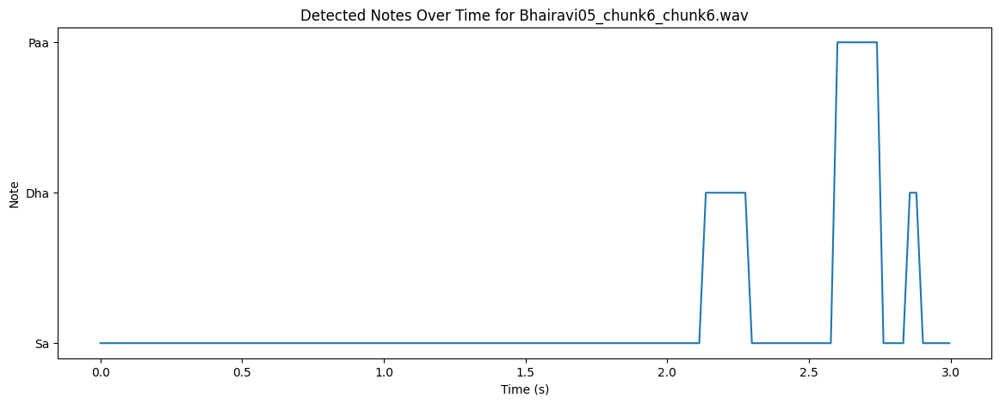

Tonic Frequency for Bhairavi05_chunk6_chunk7.wav: 827.7222290039062 Hz
Detected Notes for Bhairavi05_chunk6_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


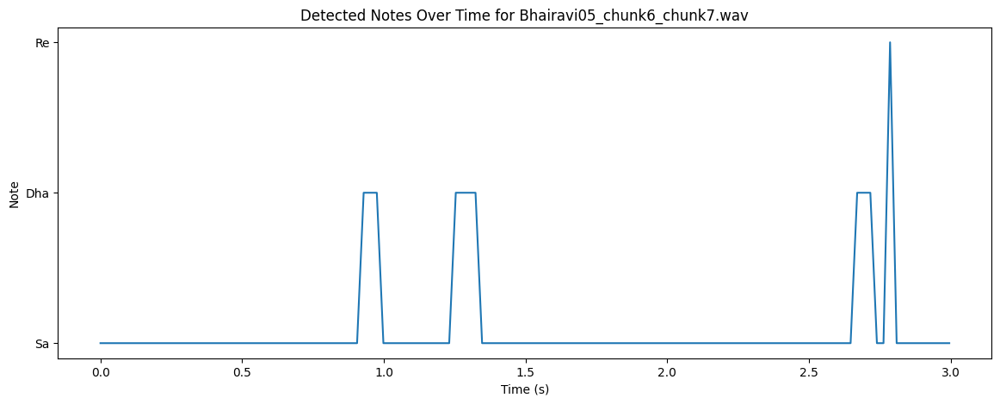

Tonic Frequency for Bhairavi05_chunk6_chunk8.wav: 831.9906005859375 Hz
Detected Notes for Bhairavi05_chunk6_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Dha', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


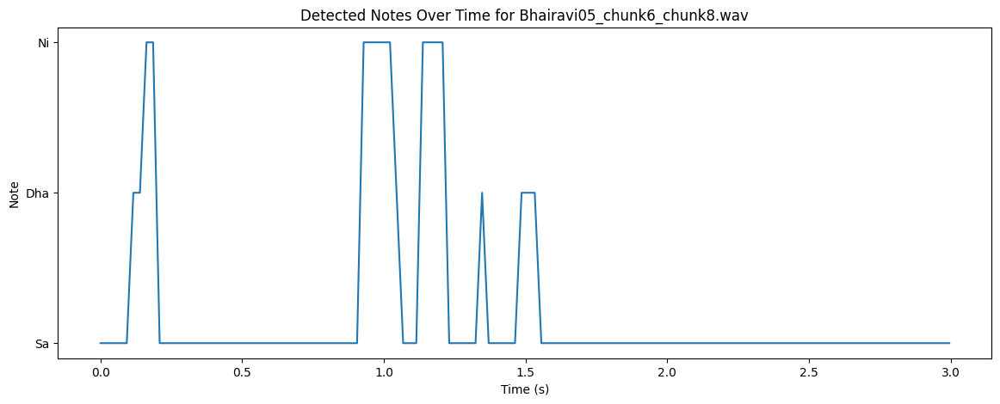

Tonic Frequency for Bhairavi05_chunk6_chunk9.wav: 834.807373046875 Hz
Detected Notes for Bhairavi05_chunk6_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


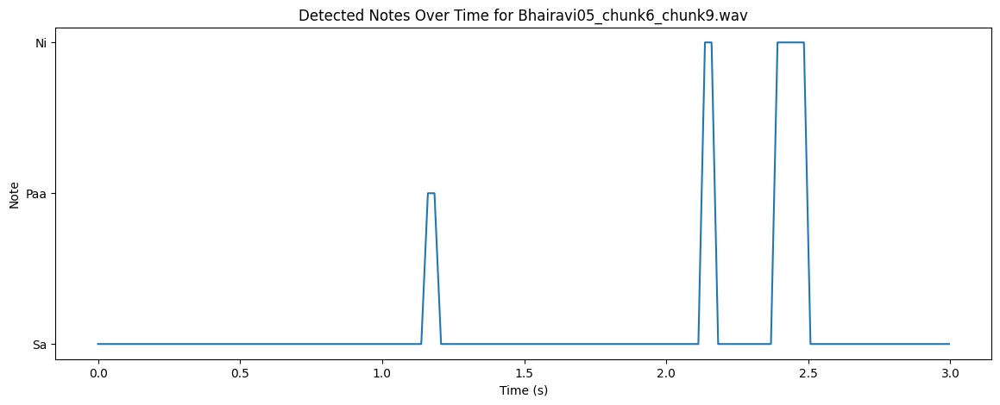

Tonic Frequency for Bhairavi05_chunk6_chunk10.wav: 836.41259765625 Hz
Detected Notes for Bhairavi05_chunk6_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


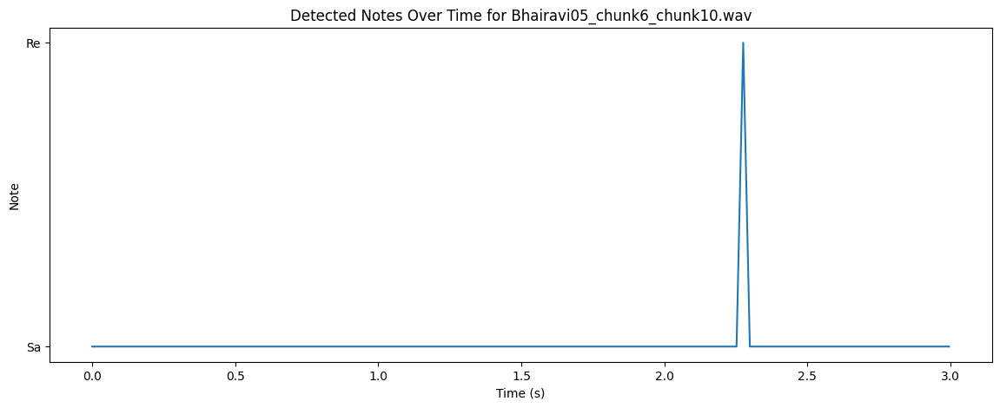

Tonic Frequency for Bhairavi05_chunk7_chunk1.wav: 872.5687255859375 Hz
Detected Notes for Bhairavi05_chunk7_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


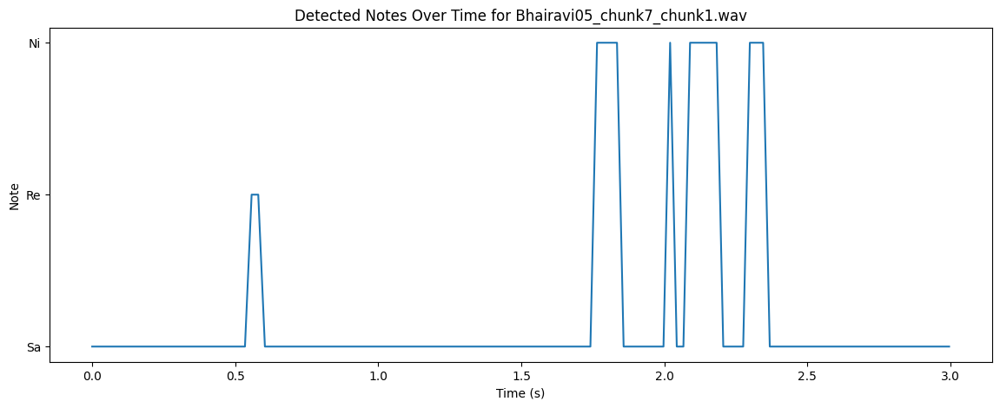

Tonic Frequency for Bhairavi05_chunk7_chunk2.wav: 827.817626953125 Hz
Detected Notes for Bhairavi05_chunk7_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


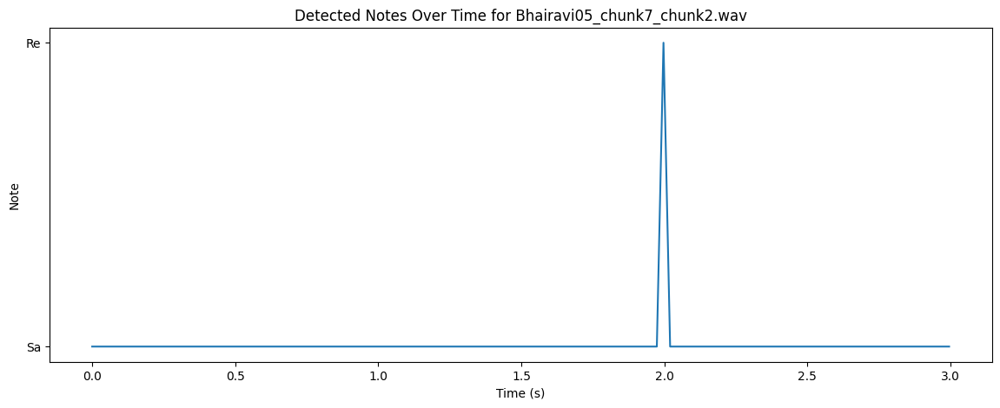

Tonic Frequency for Bhairavi05_chunk7_chunk3.wav: 856.912109375 Hz
Detected Notes for Bhairavi05_chunk7_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Re', 'Re', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni']


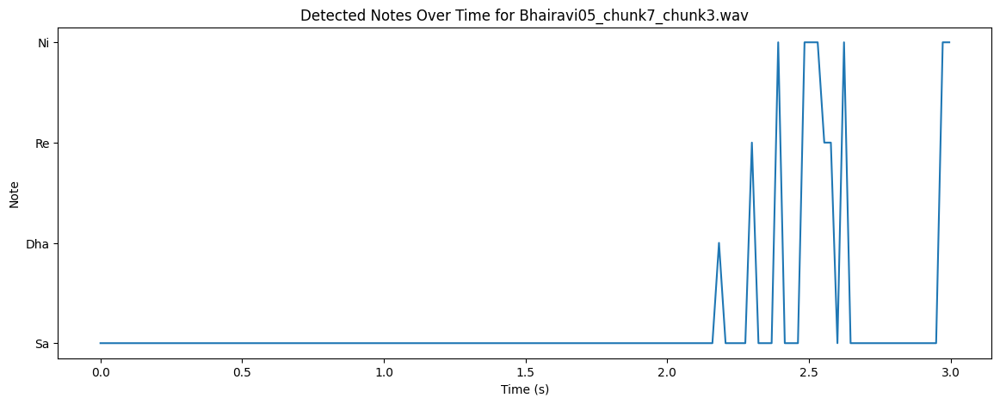

Tonic Frequency for Bhairavi05_chunk7_chunk4.wav: 833.1486206054688 Hz
Detected Notes for Bhairavi05_chunk7_chunk4.wav:  ['Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


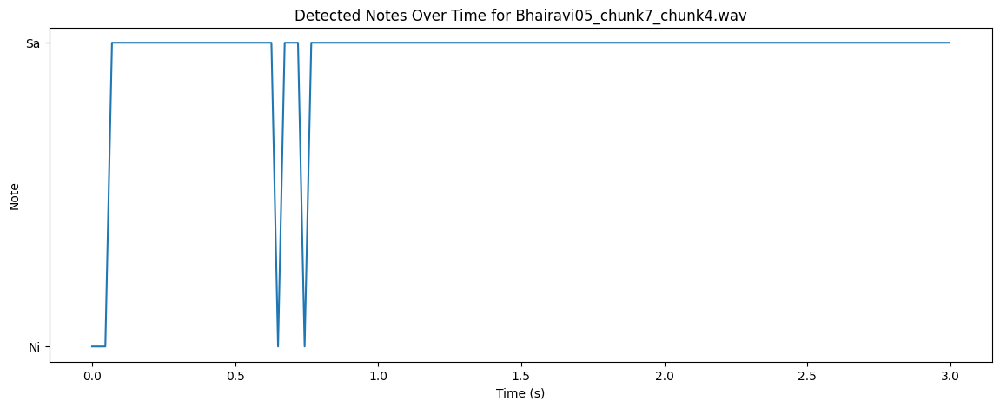

Tonic Frequency for Bhairavi05_chunk7_chunk5.wav: 834.2747192382812 Hz
Detected Notes for Bhairavi05_chunk7_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa']


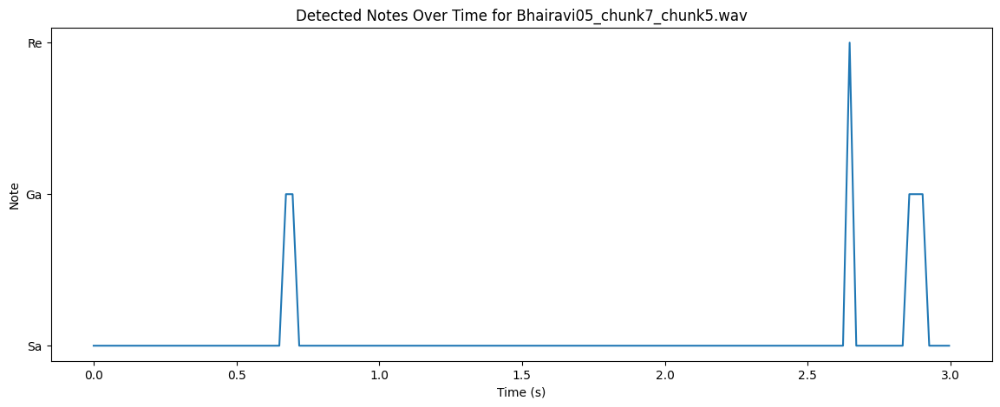

Tonic Frequency for Bhairavi05_chunk7_chunk6.wav: 852.05859375 Hz
Detected Notes for Bhairavi05_chunk7_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa']


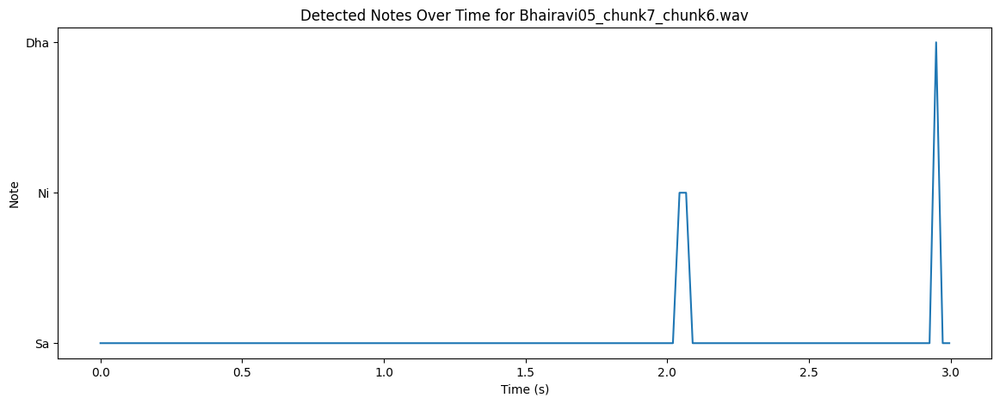

Tonic Frequency for Bhairavi05_chunk7_chunk7.wav: 747.534912109375 Hz
Detected Notes for Bhairavi05_chunk7_chunk7.wav:  ['Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


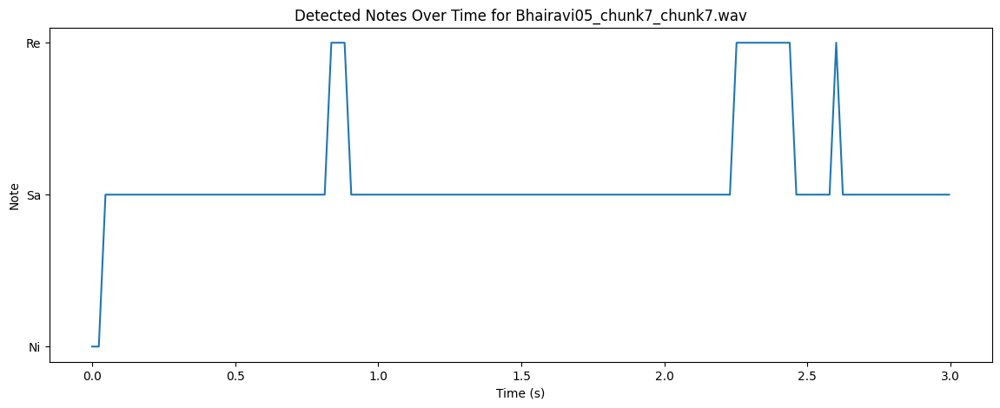

Tonic Frequency for Bhairavi05_chunk7_chunk8.wav: 826.7670288085938 Hz
Detected Notes for Bhairavi05_chunk7_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


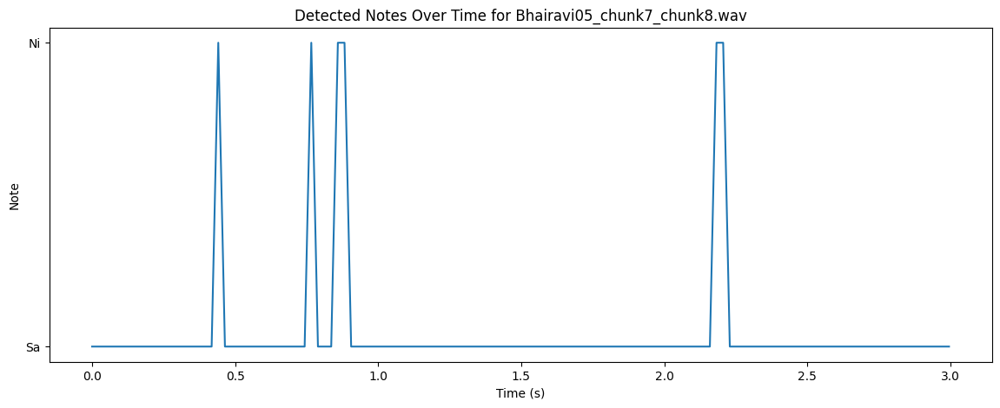

Tonic Frequency for Bhairavi05_chunk7_chunk9.wav: 661.4505615234375 Hz
Detected Notes for Bhairavi05_chunk7_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


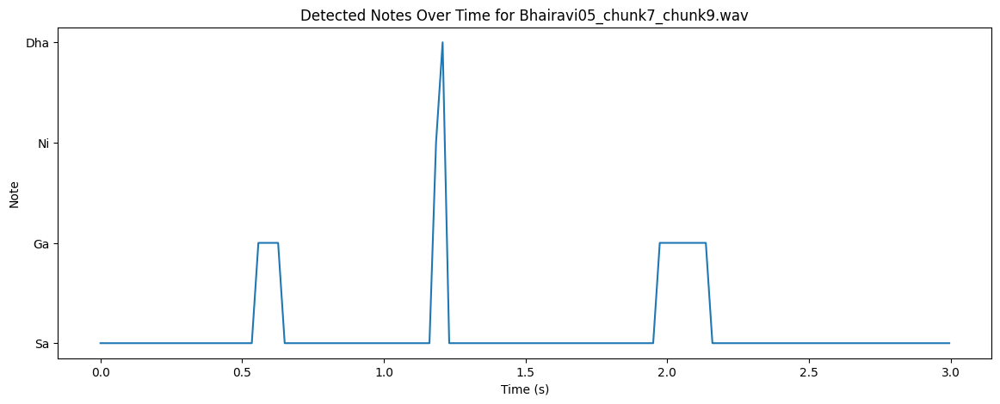

Tonic Frequency for Bhairavi05_chunk7_chunk10.wav: 683.4796752929688 Hz
Detected Notes for Bhairavi05_chunk7_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


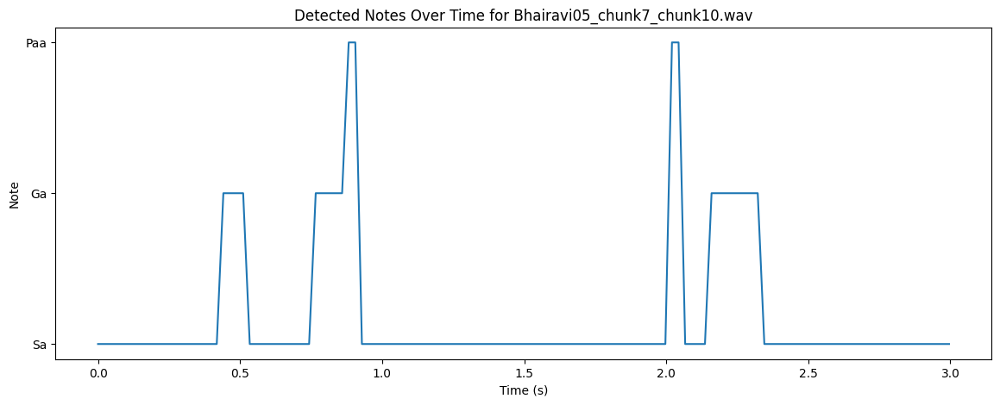

Tonic Frequency for Bhairavi05_chunk8_chunk1.wav: 740.767333984375 Hz
Detected Notes for Bhairavi05_chunk8_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


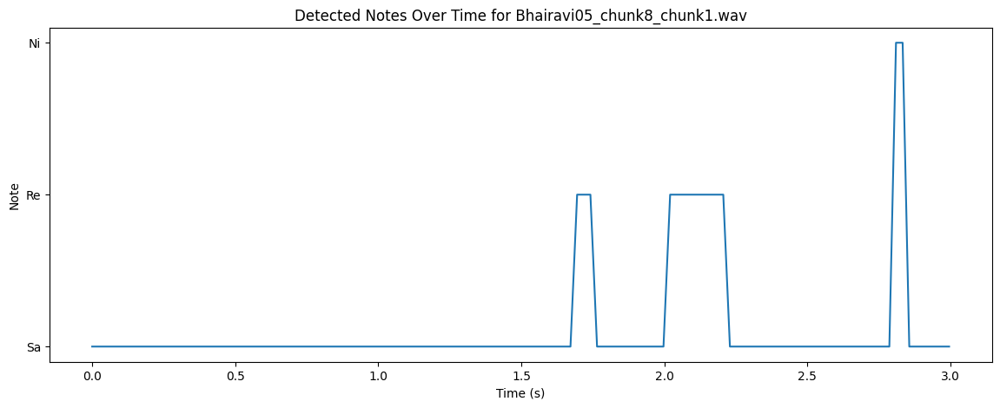

Tonic Frequency for Bhairavi05_chunk8_chunk2.wav: 801.8950805664062 Hz
Detected Notes for Bhairavi05_chunk8_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


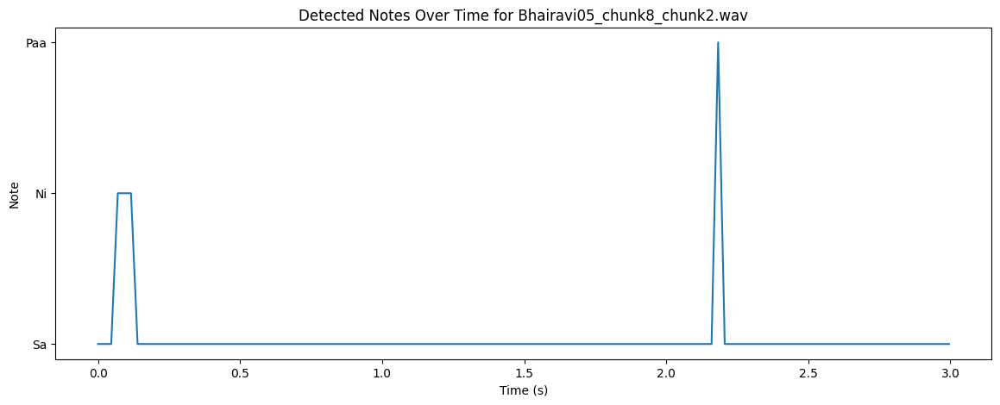

Tonic Frequency for Bhairavi05_chunk8_chunk3.wav: 709.3397216796875 Hz
Detected Notes for Bhairavi05_chunk8_chunk3.wav:  ['Paa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


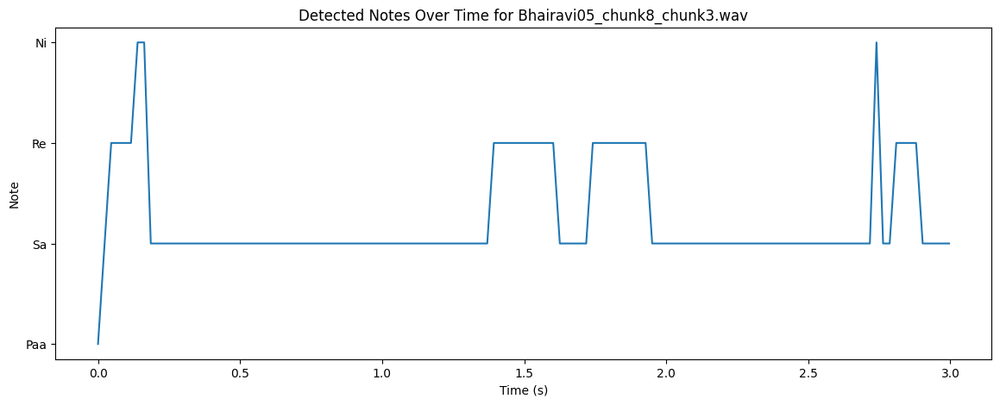

Tonic Frequency for Bhairavi05_chunk8_chunk4.wav: 791.1567993164062 Hz
Detected Notes for Bhairavi05_chunk8_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


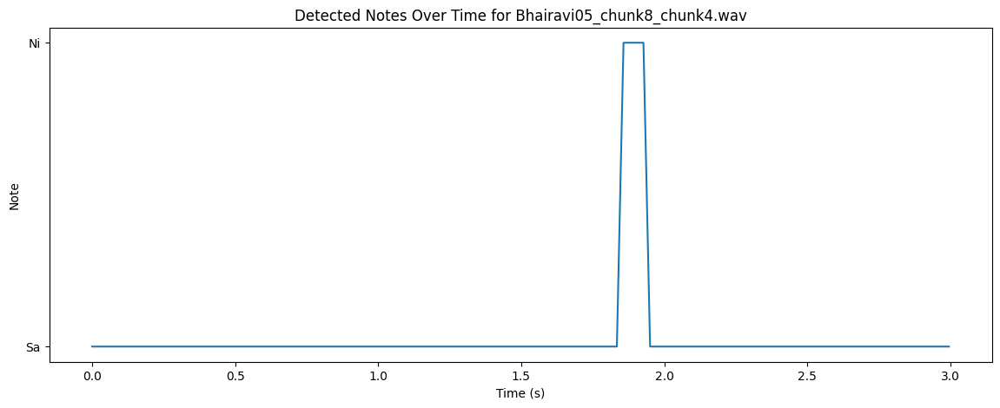

Tonic Frequency for Bhairavi05_chunk8_chunk5.wav: 828.3602905273438 Hz
Detected Notes for Bhairavi05_chunk8_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


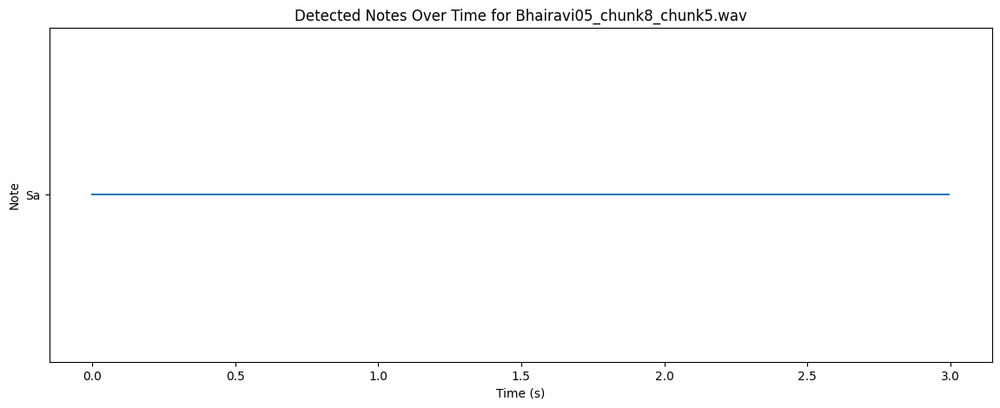

Tonic Frequency for Bhairavi05_chunk8_chunk6.wav: 833.0152587890625 Hz
Detected Notes for Bhairavi05_chunk8_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa']


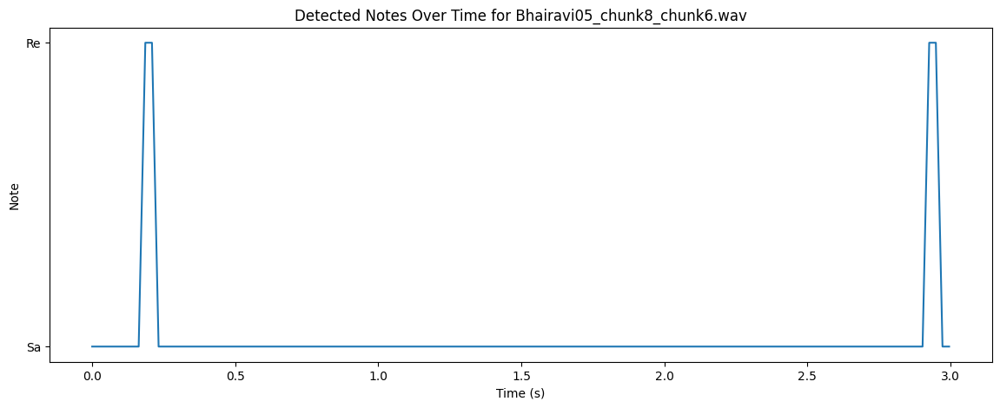

Tonic Frequency for Bhairavi05_chunk8_chunk7.wav: 830.9420776367188 Hz
Detected Notes for Bhairavi05_chunk8_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


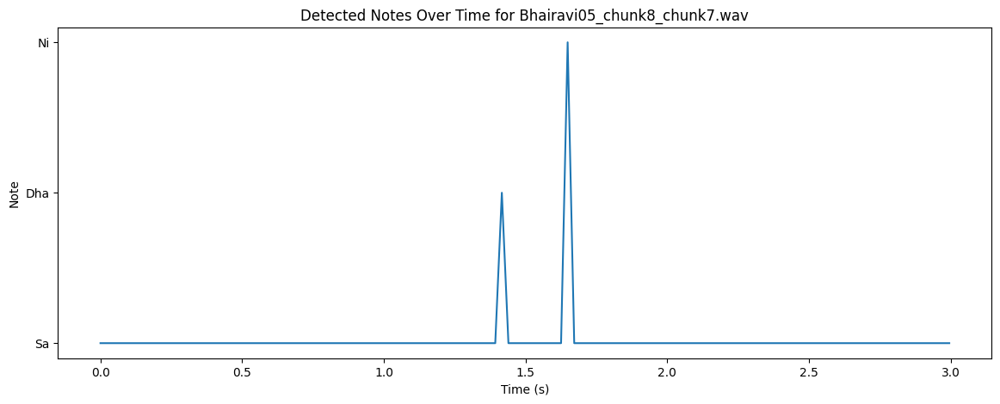

Tonic Frequency for Bhairavi05_chunk8_chunk8.wav: 831.9553833007812 Hz
Detected Notes for Bhairavi05_chunk8_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


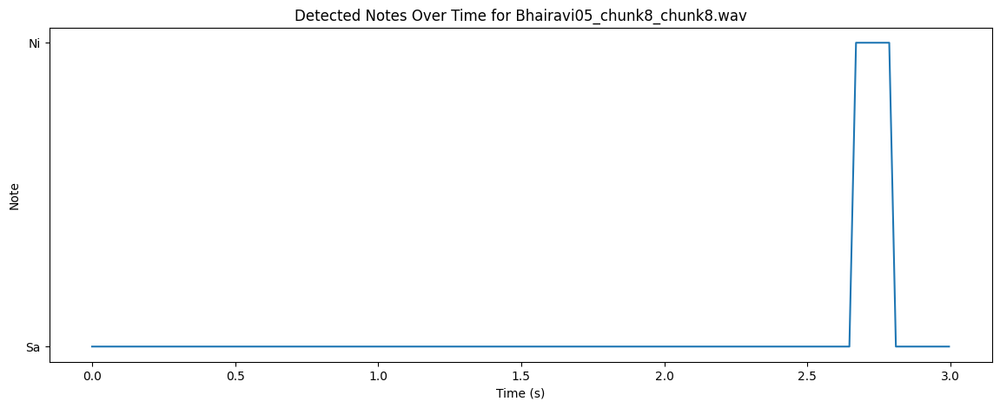

Tonic Frequency for Bhairavi05_chunk8_chunk9.wav: 832.153564453125 Hz
Detected Notes for Bhairavi05_chunk8_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


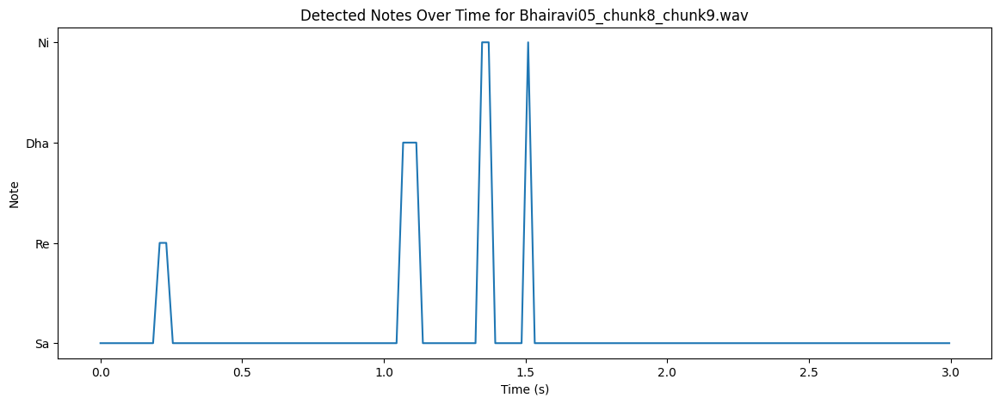

Tonic Frequency for Bhairavi05_chunk8_chunk10.wav: 697.89306640625 Hz
Detected Notes for Bhairavi05_chunk8_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


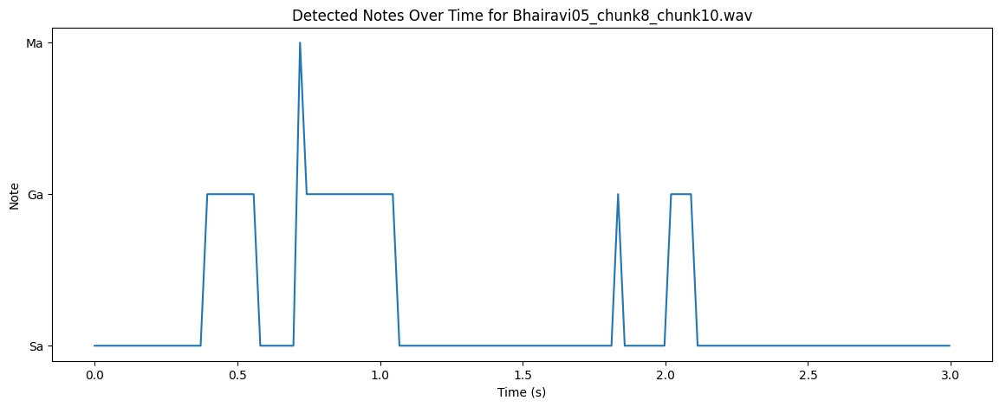

Tonic Frequency for Bhairavi05_chunk9_chunk1.wav: 893.52783203125 Hz
Detected Notes for Bhairavi05_chunk9_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


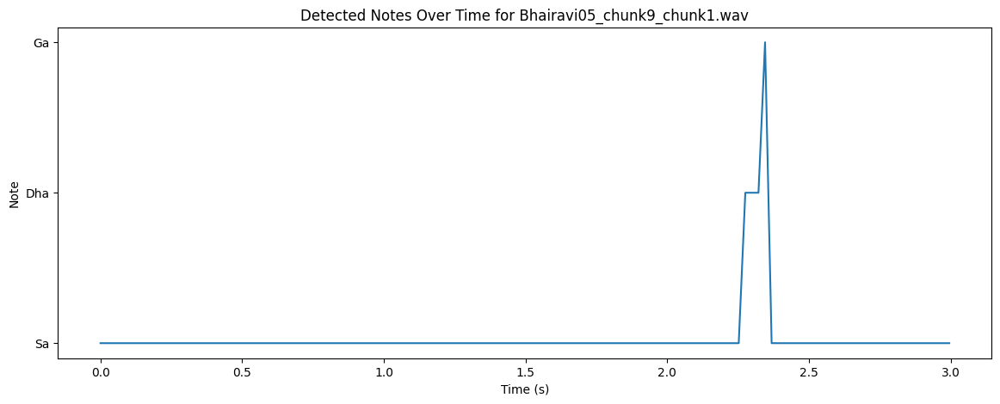

Tonic Frequency for Bhairavi05_chunk9_chunk2.wav: 831.70263671875 Hz
Detected Notes for Bhairavi05_chunk9_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


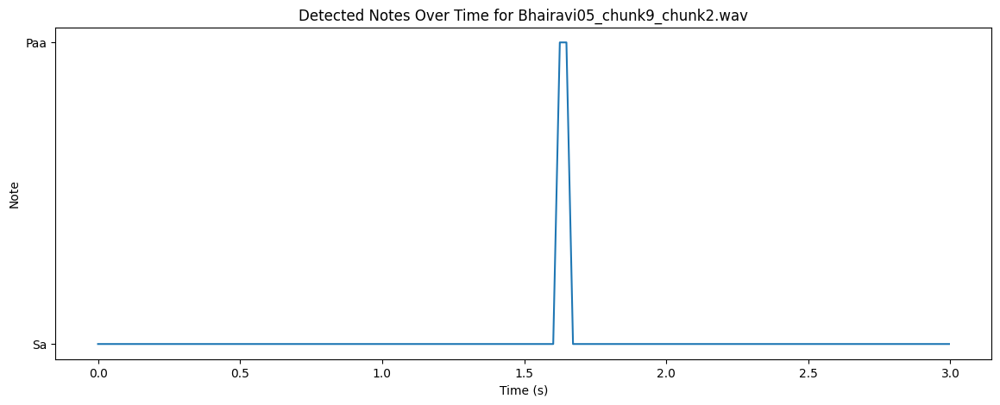

Tonic Frequency for Bhairavi05_chunk9_chunk3.wav: 834.8912353515625 Hz
Detected Notes for Bhairavi05_chunk9_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


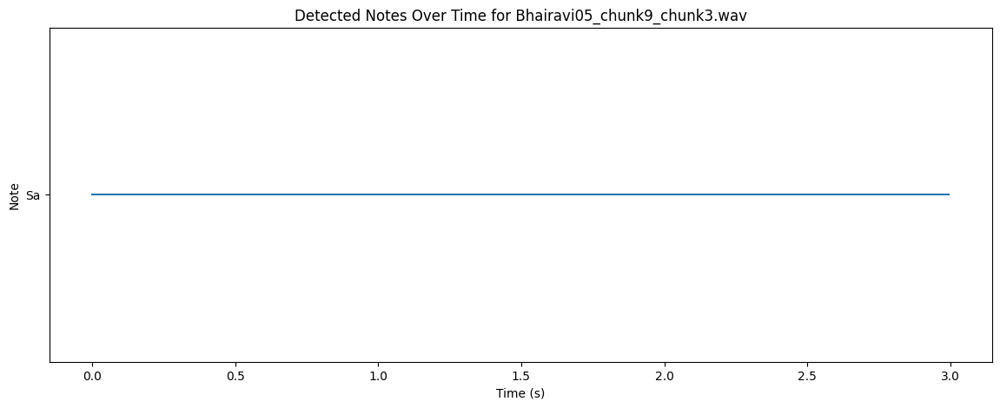

Tonic Frequency for Bhairavi05_chunk9_chunk4.wav: 971.07568359375 Hz
Detected Notes for Bhairavi05_chunk9_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


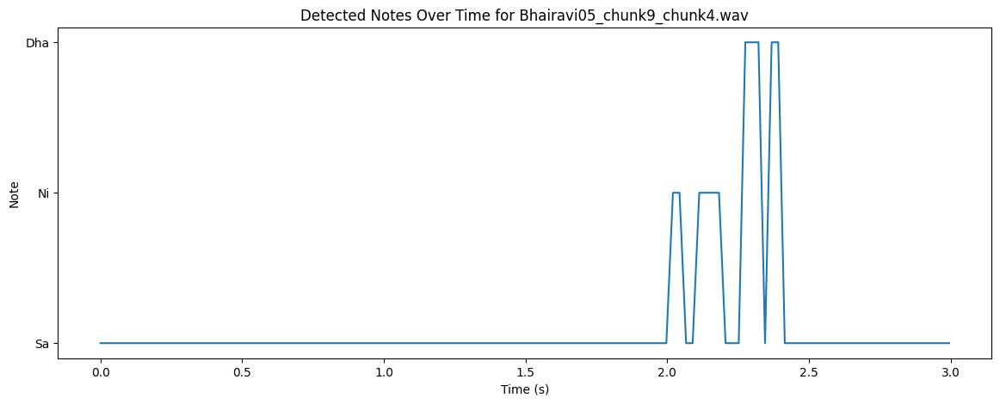

Tonic Frequency for Bhairavi05_chunk9_chunk5.wav: 694.8883666992188 Hz
Detected Notes for Bhairavi05_chunk9_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga']


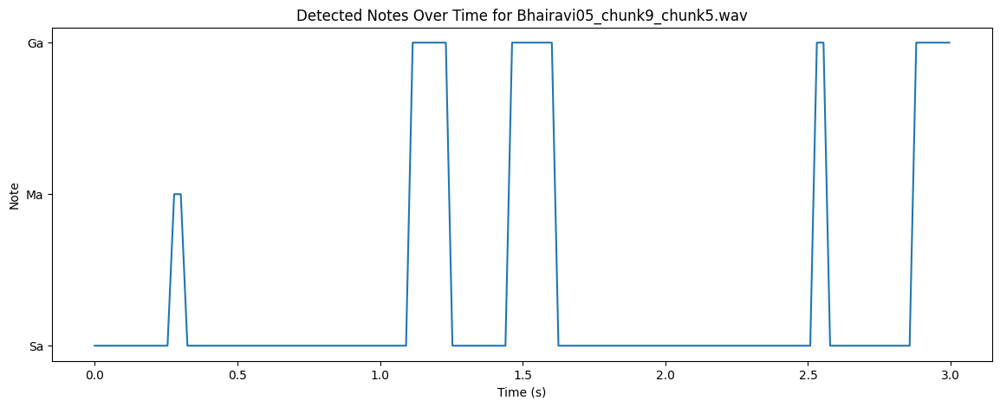

Tonic Frequency for Bhairavi05_chunk9_chunk6.wav: 832.417236328125 Hz
Detected Notes for Bhairavi05_chunk9_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


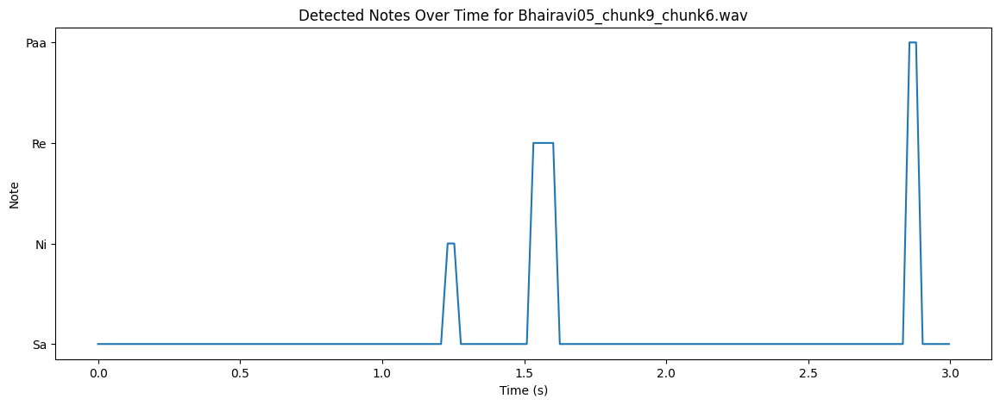

Tonic Frequency for Bhairavi05_chunk9_chunk7.wav: 874.3072509765625 Hz
Detected Notes for Bhairavi05_chunk9_chunk7.wav:  ['Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


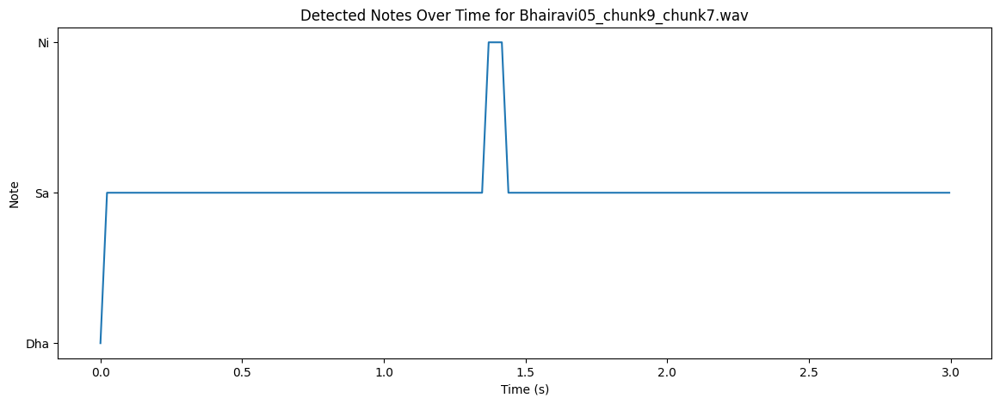

Tonic Frequency for Bhairavi05_chunk9_chunk8.wav: 935.6384887695312 Hz
Detected Notes for Bhairavi05_chunk9_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa']


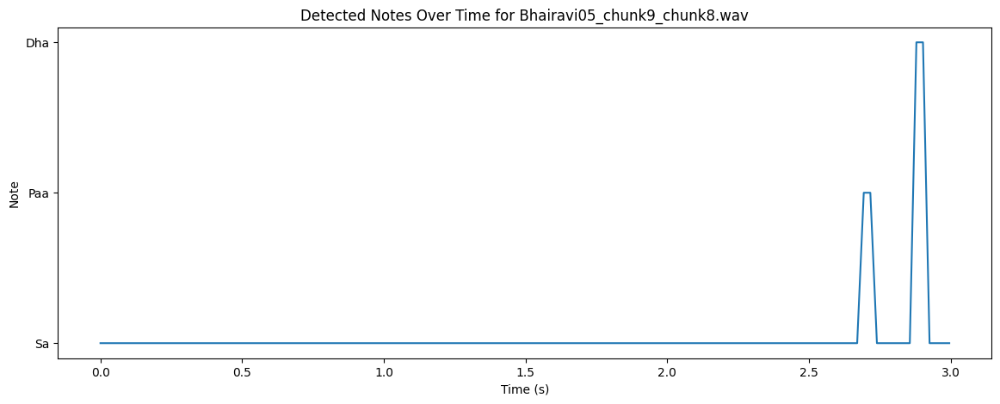

Tonic Frequency for Bhairavi05_chunk9_chunk9.wav: 831.8936767578125 Hz
Detected Notes for Bhairavi05_chunk9_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


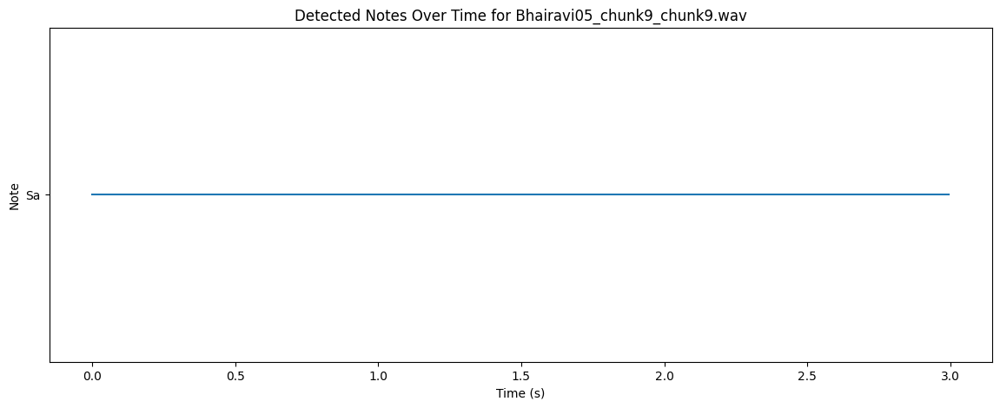

Tonic Frequency for Bhairavi05_chunk9_chunk10.wav: 840.7874755859375 Hz
Detected Notes for Bhairavi05_chunk9_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


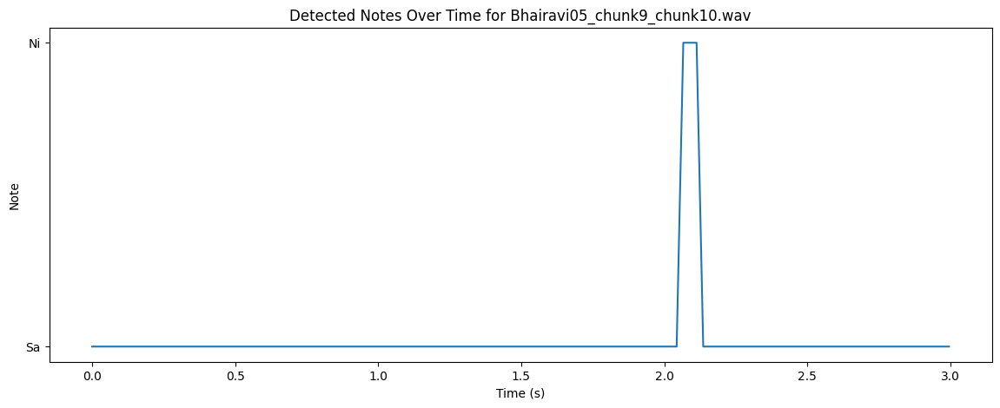

Tonic Frequency for Bhairavi05_chunk10_chunk1.wav: 859.0919799804688 Hz
Detected Notes for Bhairavi05_chunk10_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


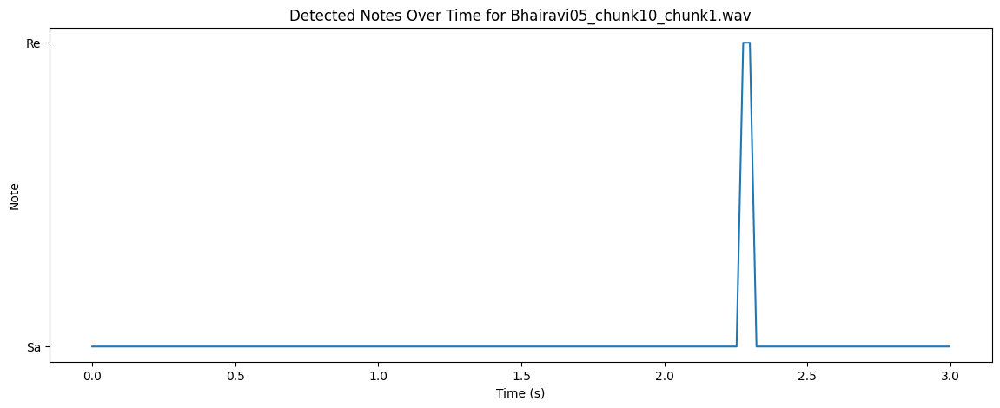

Tonic Frequency for Bhairavi05_chunk10_chunk2.wav: 1037.214111328125 Hz
Detected Notes for Bhairavi05_chunk10_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


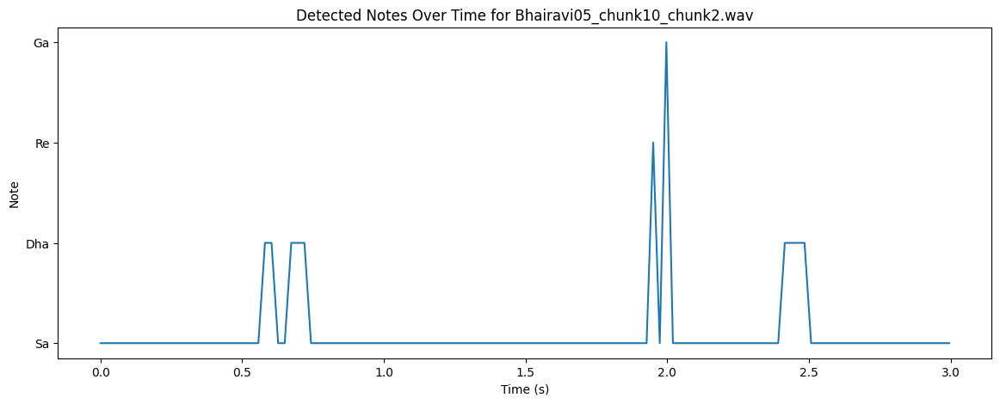

Tonic Frequency for Bhairavi05_chunk10_chunk3.wav: 1040.5330810546875 Hz
Detected Notes for Bhairavi05_chunk10_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Ga', 'Ga', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


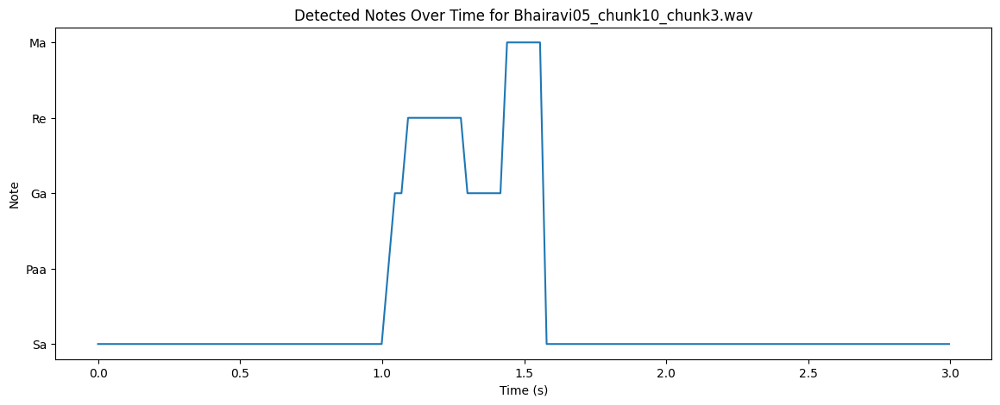

Tonic Frequency for Bhairavi05_chunk10_chunk4.wav: 1095.5322265625 Hz
Detected Notes for Bhairavi05_chunk10_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


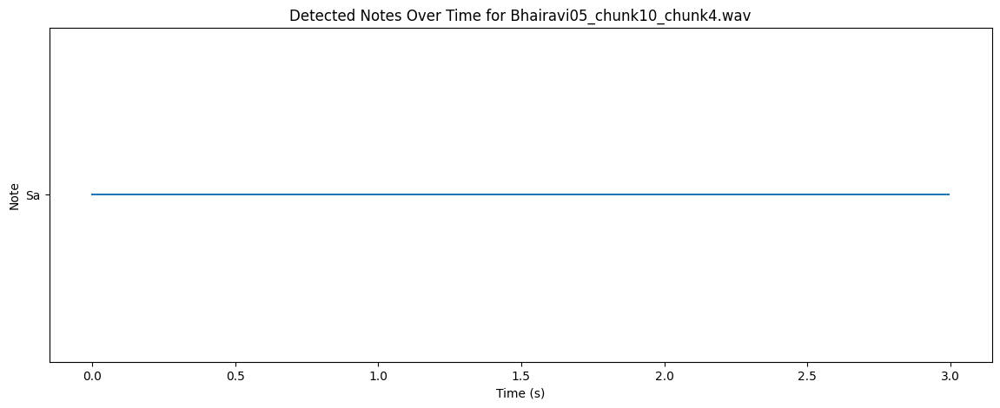

Tonic Frequency for Bhairavi05_chunk10_chunk5.wav: 833.2454833984375 Hz
Detected Notes for Bhairavi05_chunk10_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha']


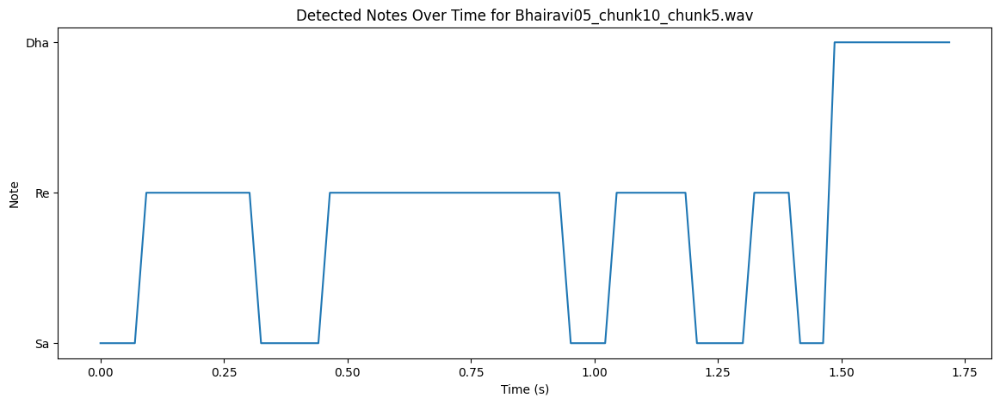

Tonic Frequency for Bhairavi03_chunk1_chunk1.wav: 1153.8853759765625 Hz
Detected Notes for Bhairavi03_chunk1_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Re', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Ga']


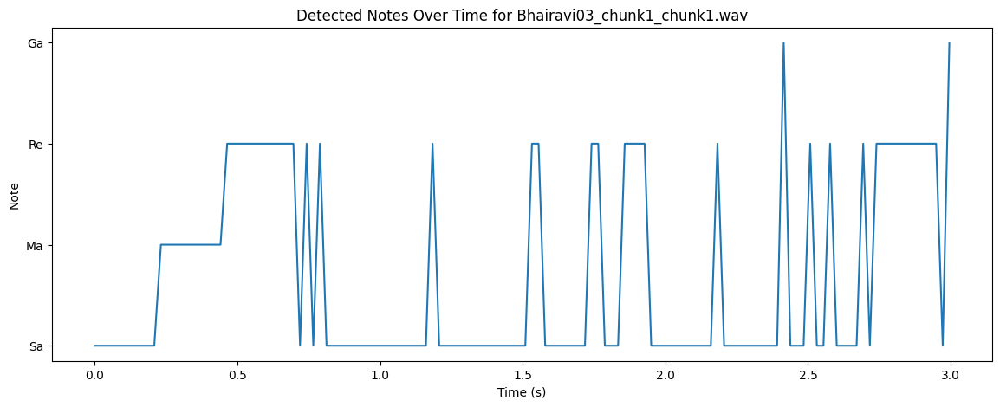

Tonic Frequency for Bhairavi03_chunk1_chunk2.wav: 1109.59130859375 Hz
Detected Notes for Bhairavi03_chunk1_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa']


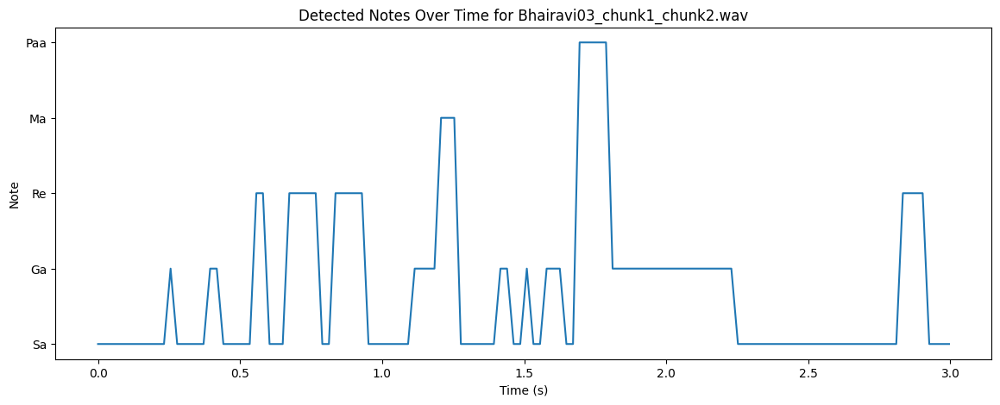

Tonic Frequency for Bhairavi03_chunk1_chunk3.wav: 1108.3056640625 Hz
Detected Notes for Bhairavi03_chunk1_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Re', 'Re', 'Sa', 'Ga', 'Ga', 'Sa', 'Re', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ma', 'Sa', 'Sa', 'Ga', 'Ga', 'Ma', 'Re', 'Sa', 'Re', 'Re']


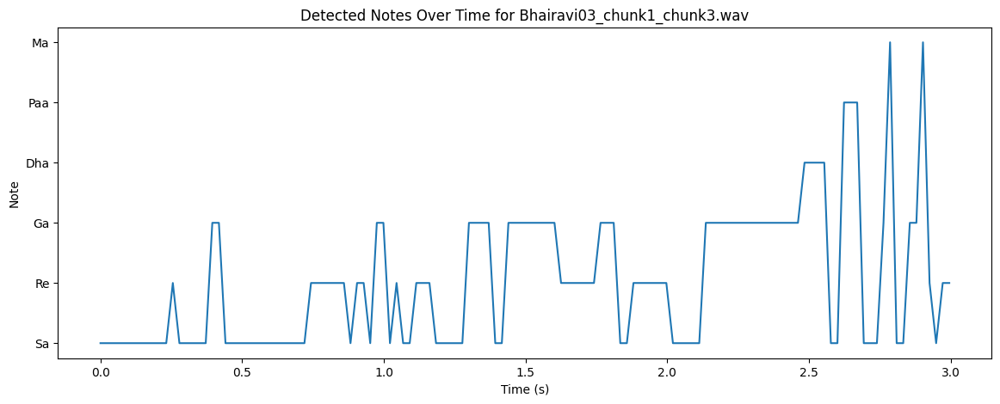

Tonic Frequency for Bhairavi03_chunk1_chunk4.wav: 1109.908447265625 Hz
Detected Notes for Bhairavi03_chunk1_chunk4.wav:  ['Ga', 'Ga', 'Sa', 'Sa', 'Re', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Re', 'Re', 'Re', 'Re', 'Re', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa']


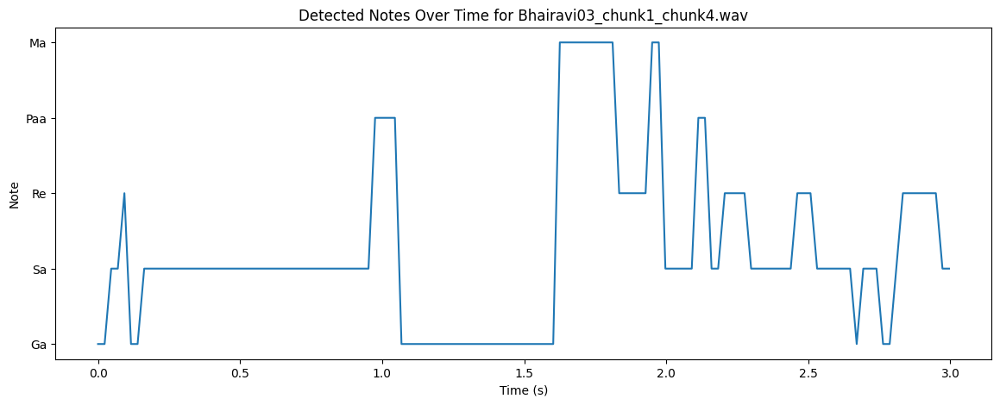

Tonic Frequency for Bhairavi03_chunk1_chunk5.wav: 1096.671630859375 Hz
Detected Notes for Bhairavi03_chunk1_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


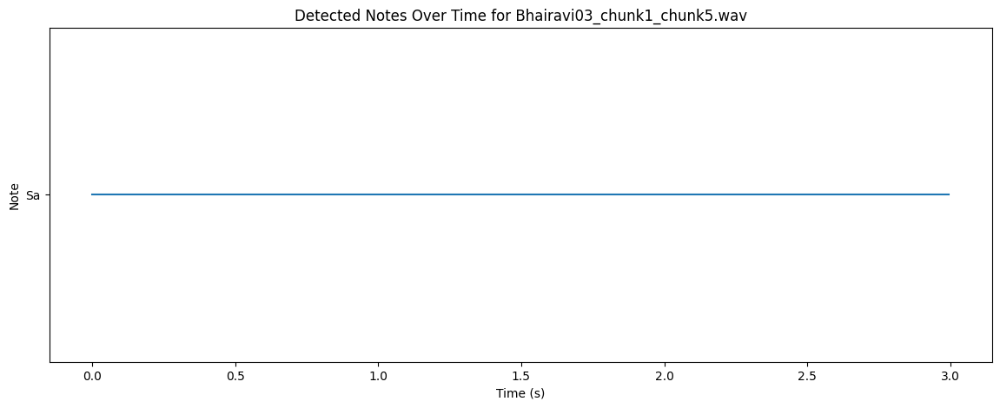

Tonic Frequency for Bhairavi03_chunk1_chunk6.wav: 1117.3095703125 Hz
Detected Notes for Bhairavi03_chunk1_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Ga', 'Ga', 'Ma', 'Ma', 'Ga', 'Ma', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Ga', 'Dha', 'Dha', 'Dha', 'Dha', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Dha', 'Ga', 'Ga', 'Ga', 'Ga', 'Dha', 'Dha', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga']


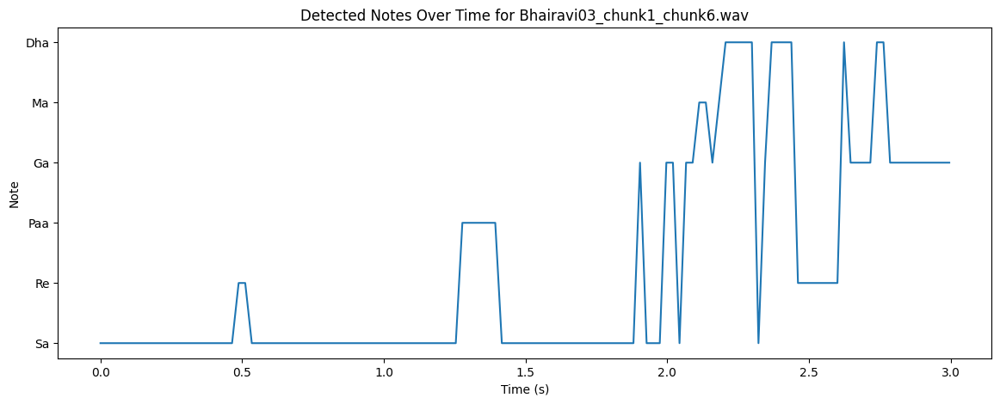

Tonic Frequency for Bhairavi03_chunk1_chunk7.wav: 1140.061767578125 Hz
Detected Notes for Bhairavi03_chunk1_chunk7.wav:  ['Re', 'Re', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Ga', 'Re', 'Re', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Paa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re']


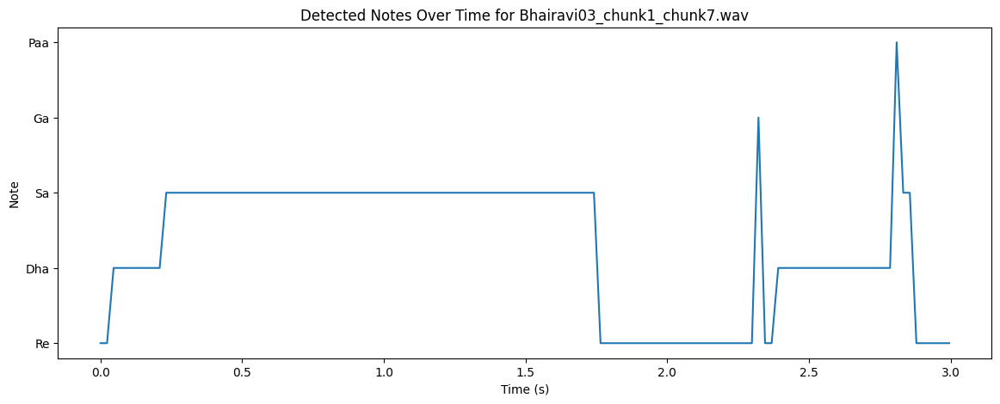

Tonic Frequency for Bhairavi03_chunk1_chunk8.wav: 1149.08837890625 Hz
Detected Notes for Bhairavi03_chunk1_chunk8.wav:  ['Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


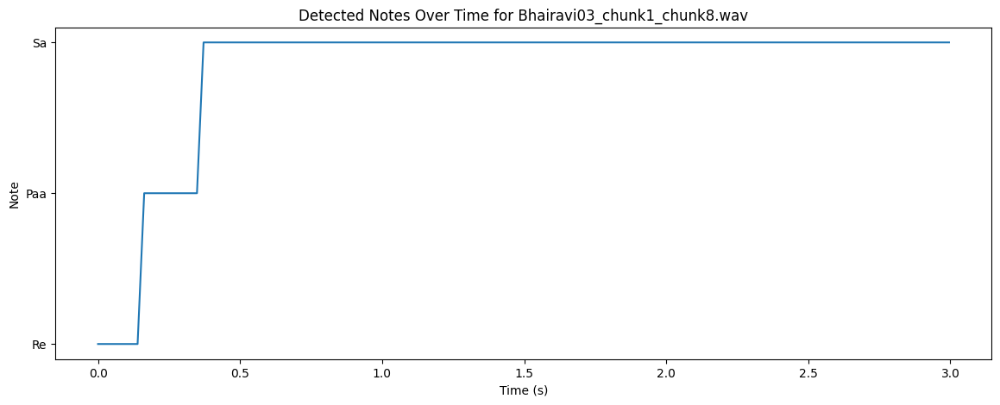

Tonic Frequency for Bhairavi03_chunk1_chunk9.wav: 1142.480224609375 Hz
Detected Notes for Bhairavi03_chunk1_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Ga', 'Ga', 'Ga', 'Sa', 'Ga', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa']


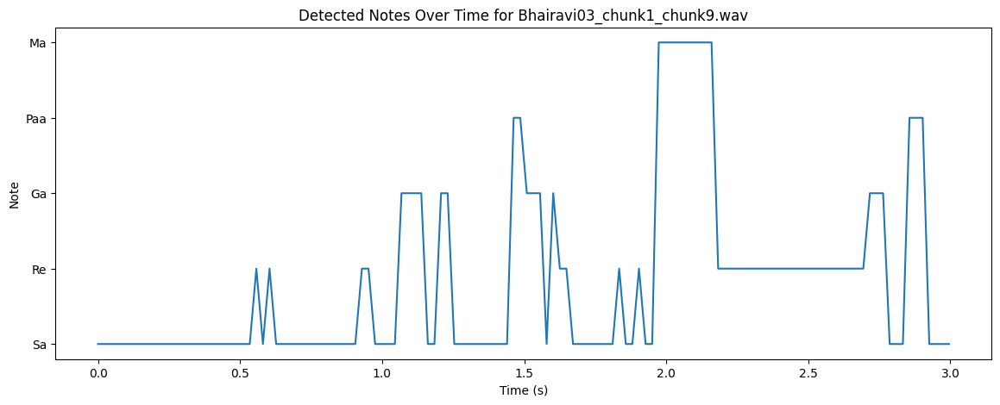

Tonic Frequency for Bhairavi03_chunk1_chunk10.wav: 1109.7593994140625 Hz
Detected Notes for Bhairavi03_chunk1_chunk10.wav:  ['Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Ga', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga']


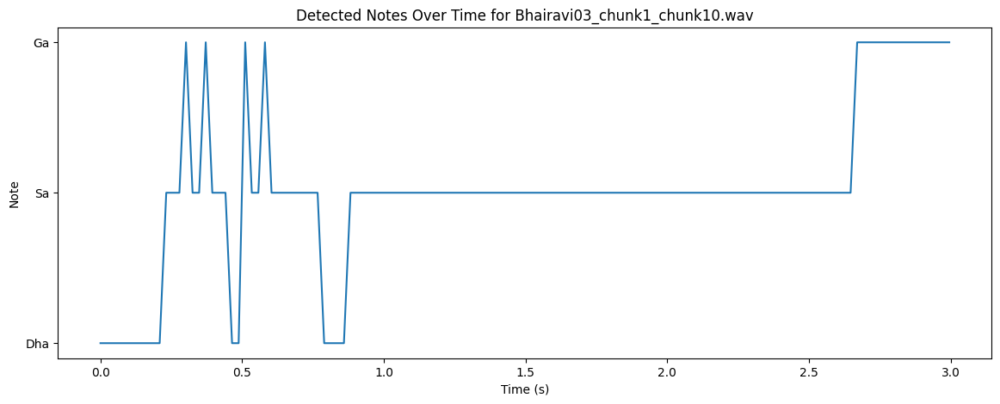

Tonic Frequency for Bhairavi03_chunk2_chunk1.wav: 1208.475341796875 Hz
Detected Notes for Bhairavi03_chunk2_chunk1.wav:  ['Re', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Dha', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


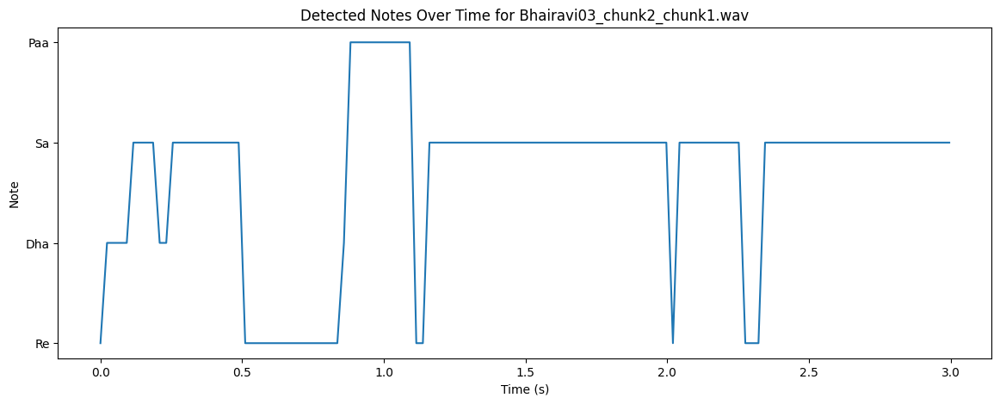

Tonic Frequency for Bhairavi03_chunk2_chunk2.wav: 1244.18212890625 Hz
Detected Notes for Bhairavi03_chunk2_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


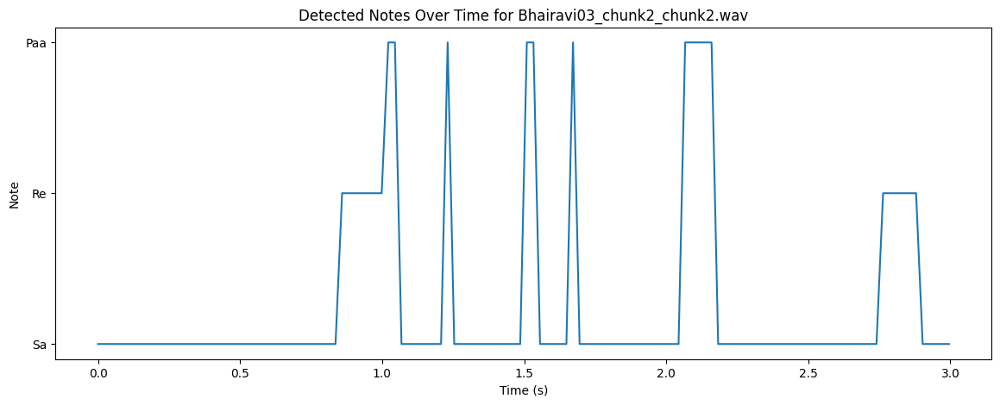

Tonic Frequency for Bhairavi03_chunk2_chunk3.wav: 1142.940185546875 Hz
Detected Notes for Bhairavi03_chunk2_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Re', 'Re', 'Re', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Ga', 'Ga', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


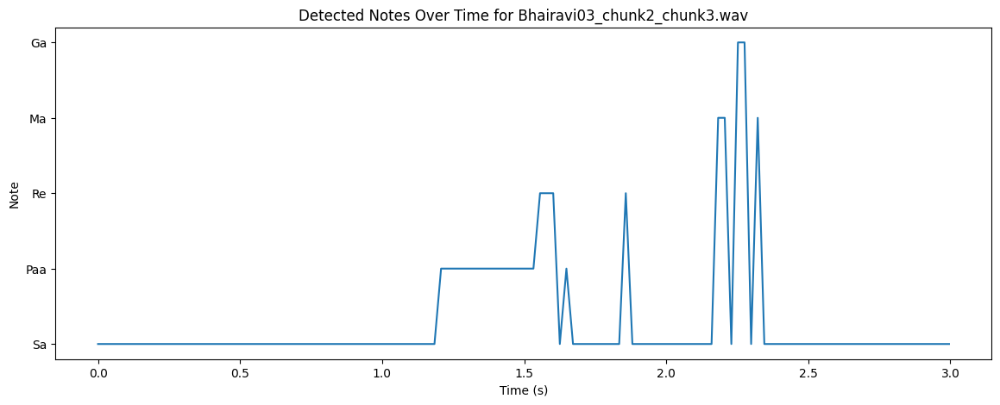

Tonic Frequency for Bhairavi03_chunk2_chunk4.wav: 1109.44189453125 Hz
Detected Notes for Bhairavi03_chunk2_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


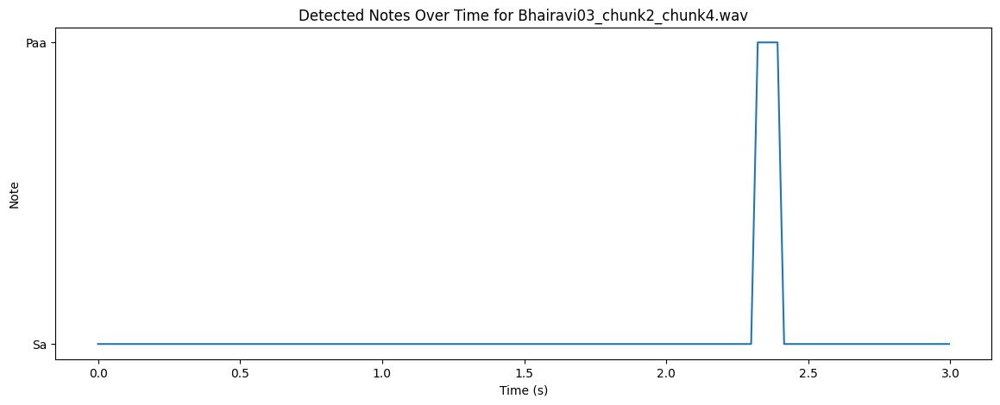

Tonic Frequency for Bhairavi03_chunk2_chunk5.wav: 1235.229736328125 Hz
Detected Notes for Bhairavi03_chunk2_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


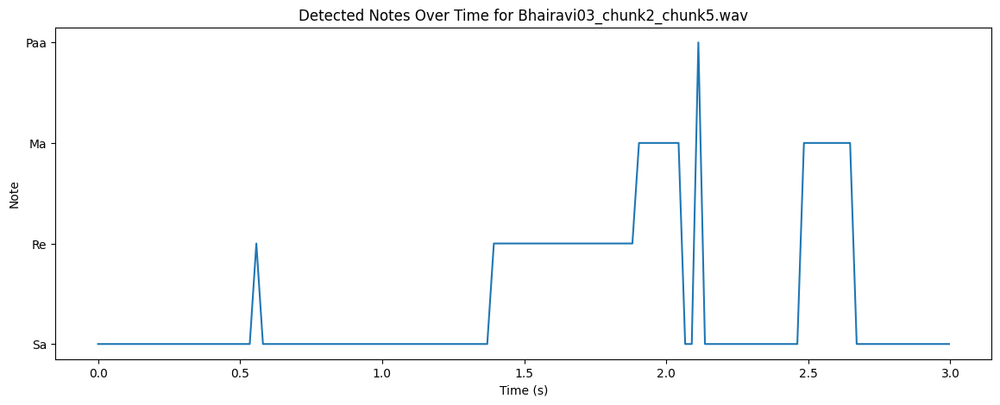

Tonic Frequency for Bhairavi03_chunk2_chunk6.wav: 1132.2802734375 Hz
Detected Notes for Bhairavi03_chunk2_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


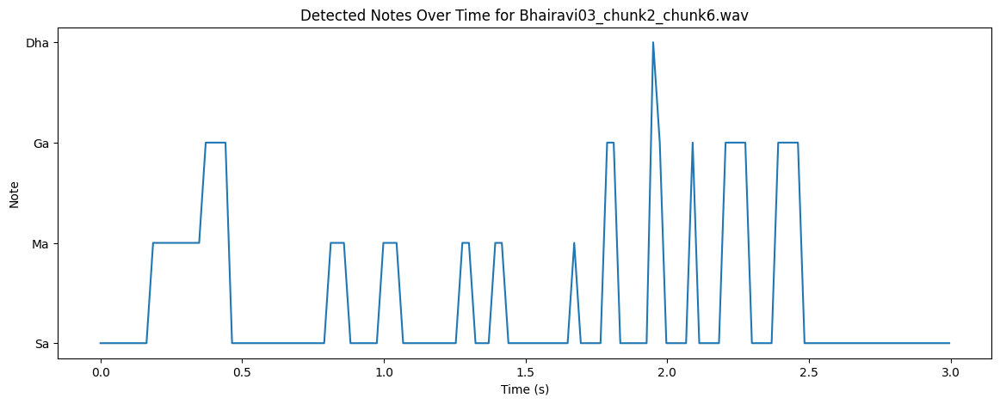

Tonic Frequency for Bhairavi03_chunk2_chunk7.wav: 1120.88671875 Hz
Detected Notes for Bhairavi03_chunk2_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


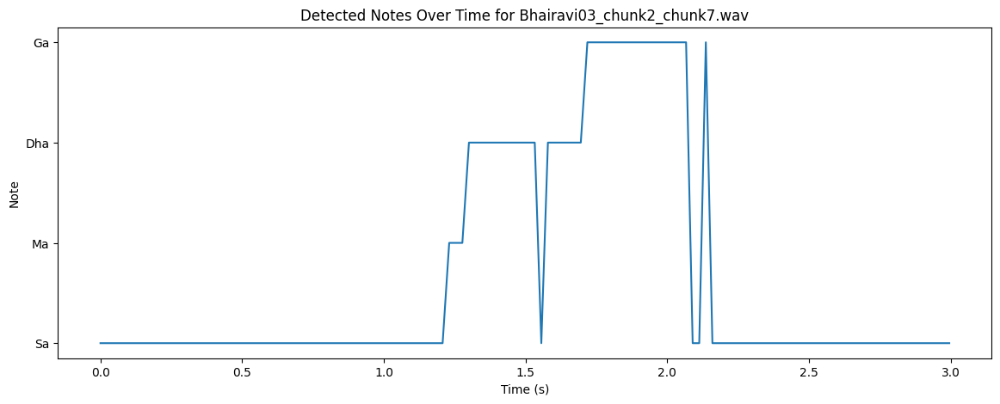

Tonic Frequency for Bhairavi03_chunk2_chunk8.wav: 1042.6187744140625 Hz
Detected Notes for Bhairavi03_chunk2_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


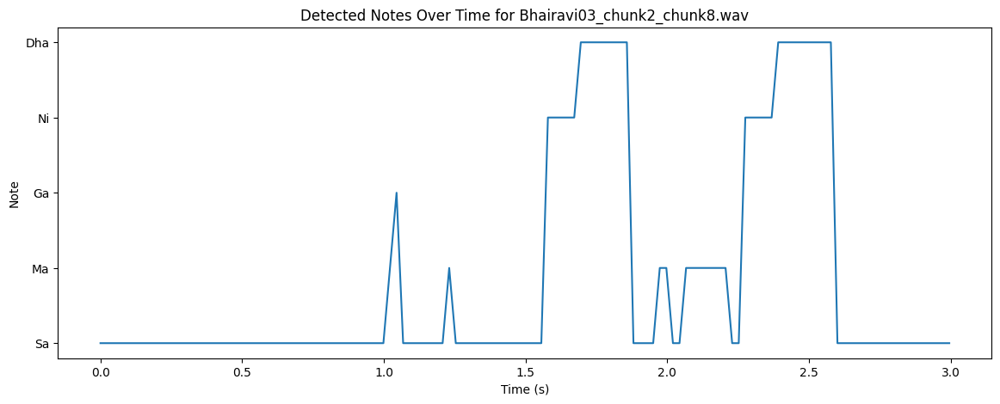

Tonic Frequency for Bhairavi03_chunk2_chunk9.wav: 1238.9766845703125 Hz
Detected Notes for Bhairavi03_chunk2_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Ma', 'Ma', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ga', 'Ga', 'Sa', 'Sa', 'Ma']


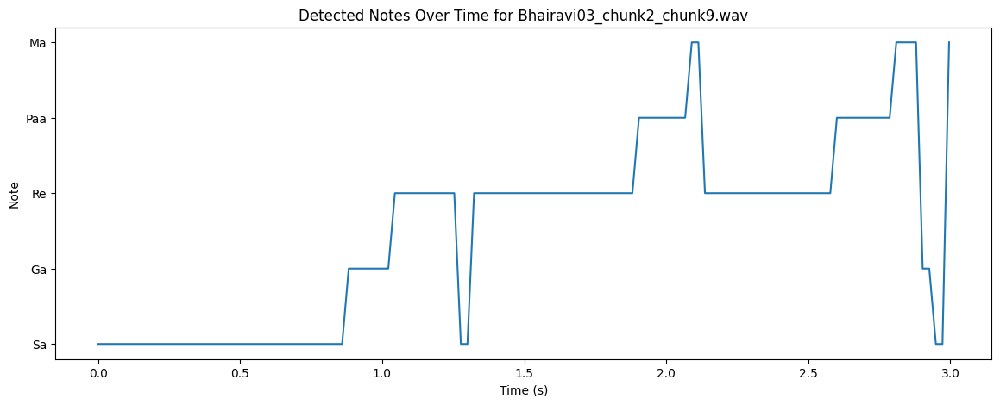

Tonic Frequency for Bhairavi03_chunk2_chunk10.wav: 1109.43994140625 Hz
Detected Notes for Bhairavi03_chunk2_chunk10.wav:  ['Paa', 'Paa', 'Paa', 'Paa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


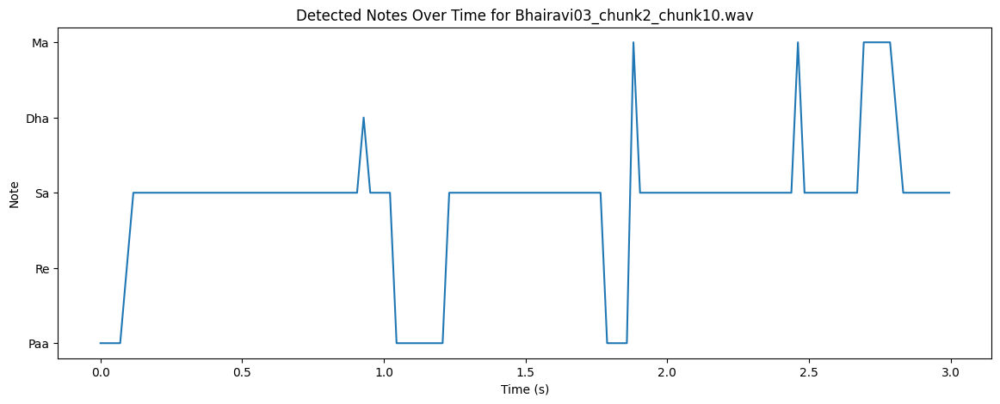

Tonic Frequency for Bhairavi03_chunk3_chunk1.wav: 938.7490234375 Hz
Detected Notes for Bhairavi03_chunk3_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa']


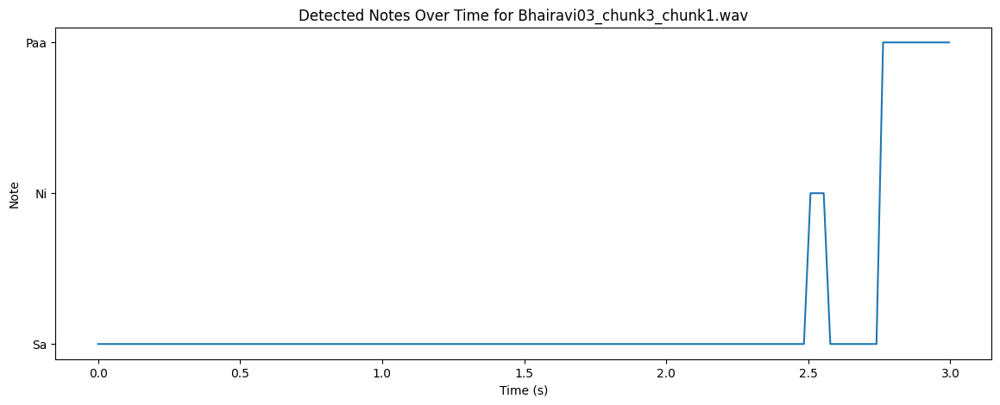

Tonic Frequency for Bhairavi03_chunk3_chunk2.wav: 935.6884155273438 Hz
Detected Notes for Bhairavi03_chunk3_chunk2.wav:  ['Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa']


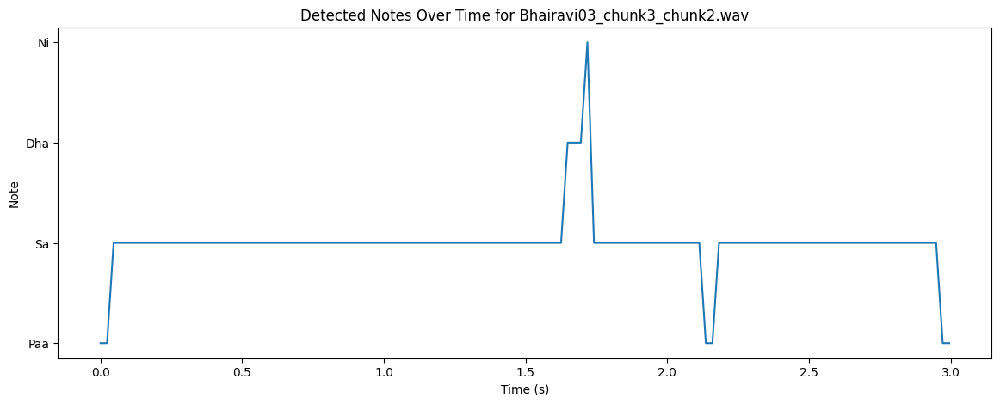

Tonic Frequency for Bhairavi03_chunk3_chunk3.wav: 937.70654296875 Hz
Detected Notes for Bhairavi03_chunk3_chunk3.wav:  ['Paa', 'Paa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa']


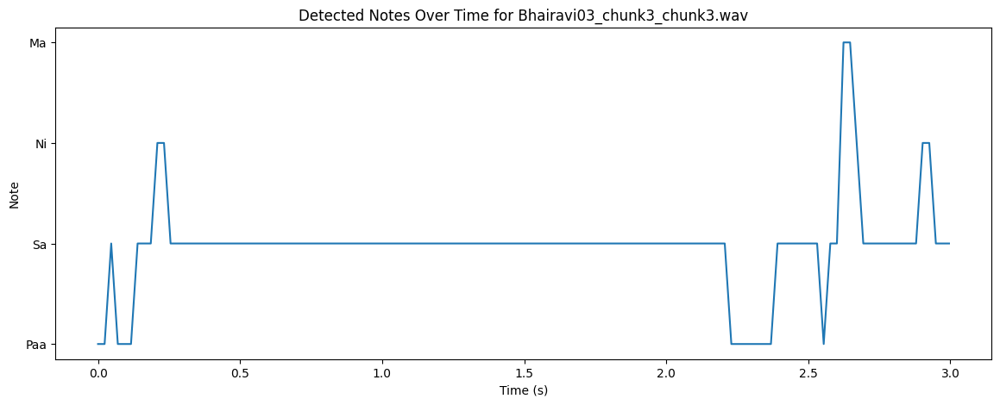

Tonic Frequency for Bhairavi03_chunk3_chunk4.wav: 860.101806640625 Hz
Detected Notes for Bhairavi03_chunk3_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


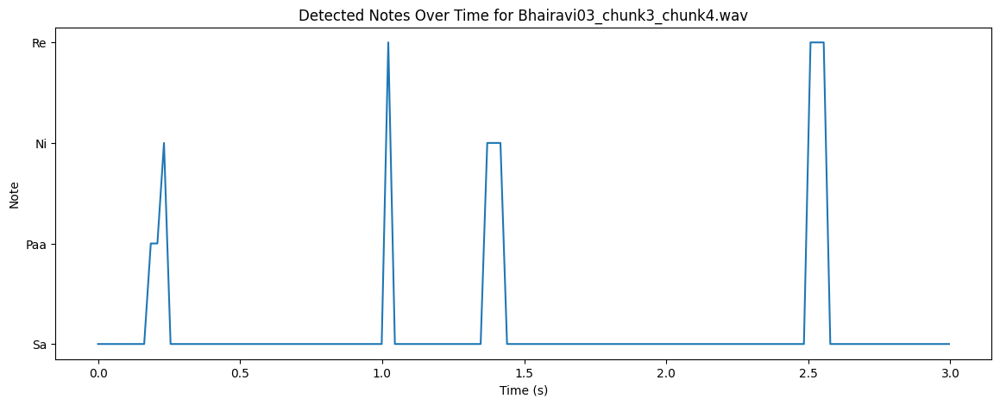

Tonic Frequency for Bhairavi03_chunk3_chunk5.wav: 832.5704956054688 Hz
Detected Notes for Bhairavi03_chunk3_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


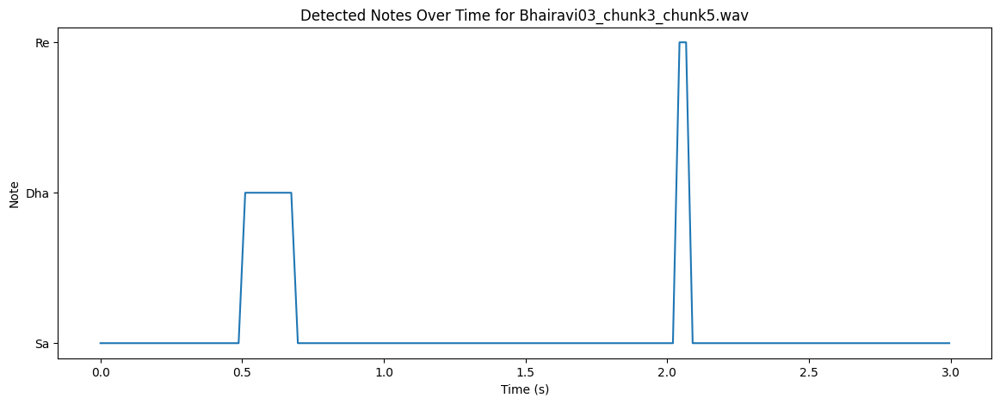

Tonic Frequency for Bhairavi03_chunk3_chunk6.wav: 769.9031982421875 Hz
Detected Notes for Bhairavi03_chunk3_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Dha', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


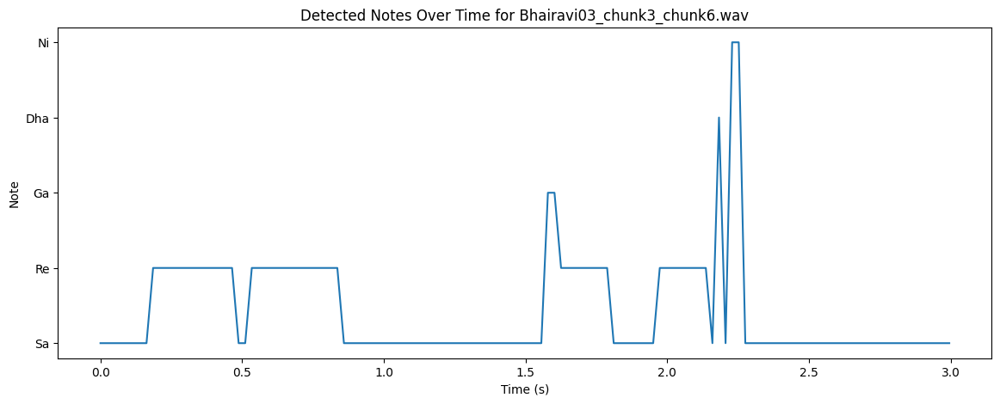

Tonic Frequency for Bhairavi03_chunk3_chunk7.wav: 900.4468383789062 Hz
Detected Notes for Bhairavi03_chunk3_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


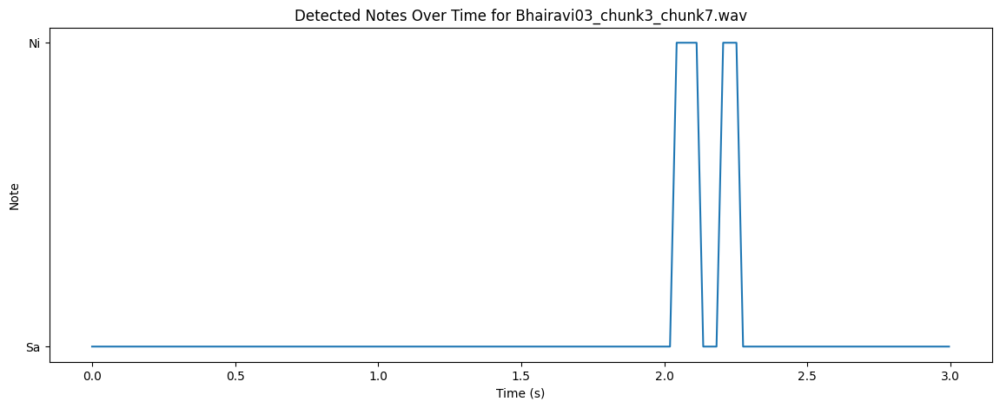

Tonic Frequency for Bhairavi03_chunk3_chunk8.wav: 969.2392578125 Hz
Detected Notes for Bhairavi03_chunk3_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma']


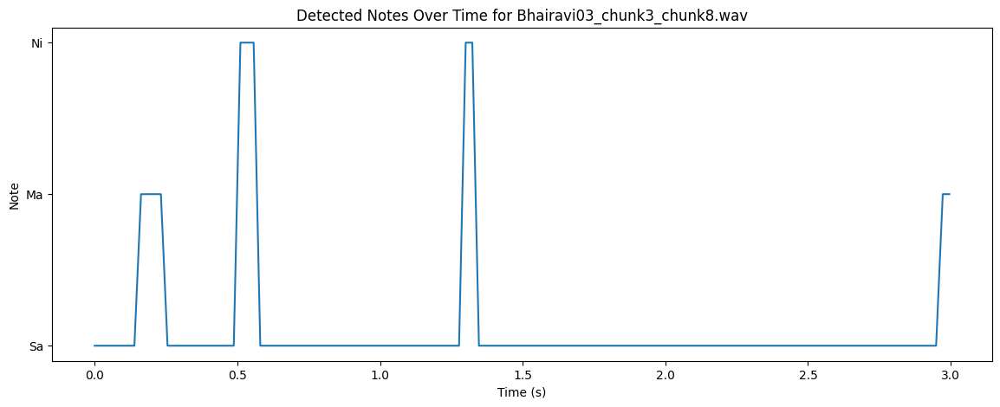

Tonic Frequency for Bhairavi03_chunk3_chunk9.wav: 1033.98974609375 Hz
Detected Notes for Bhairavi03_chunk3_chunk9.wav:  ['Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


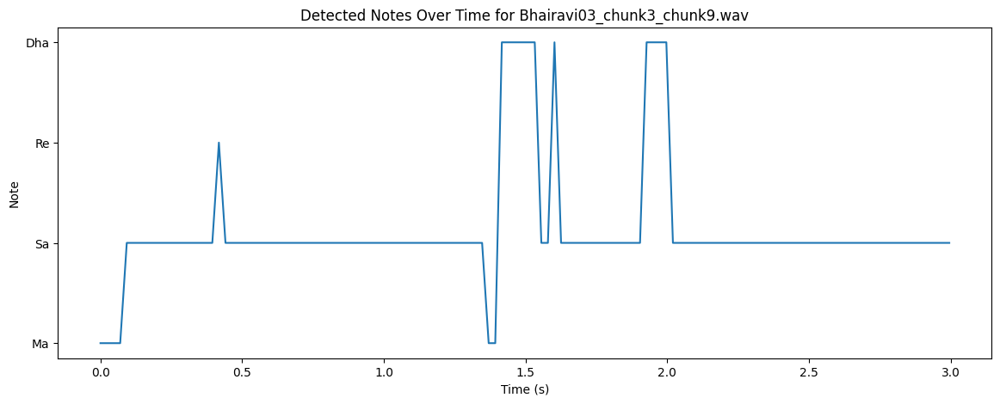

Tonic Frequency for Bhairavi03_chunk3_chunk10.wav: 935.331298828125 Hz
Detected Notes for Bhairavi03_chunk3_chunk10.wav:  ['Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


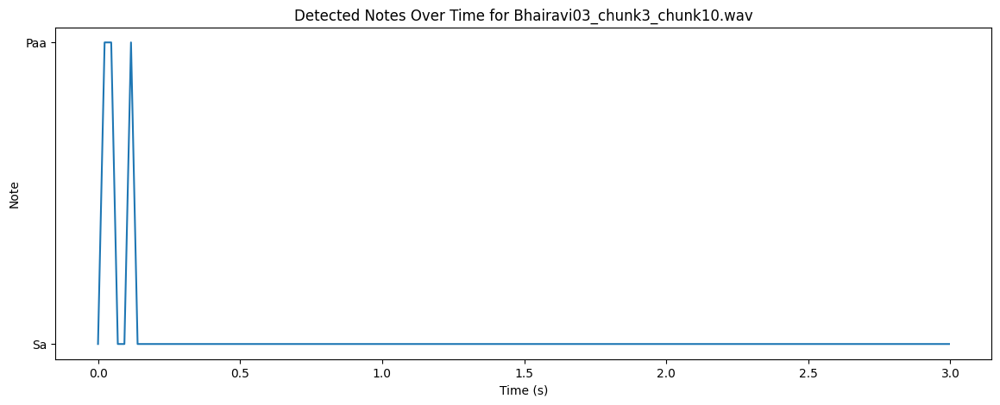

Tonic Frequency for Bhairavi03_chunk4_chunk1.wav: 1004.6915283203125 Hz
Detected Notes for Bhairavi03_chunk4_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


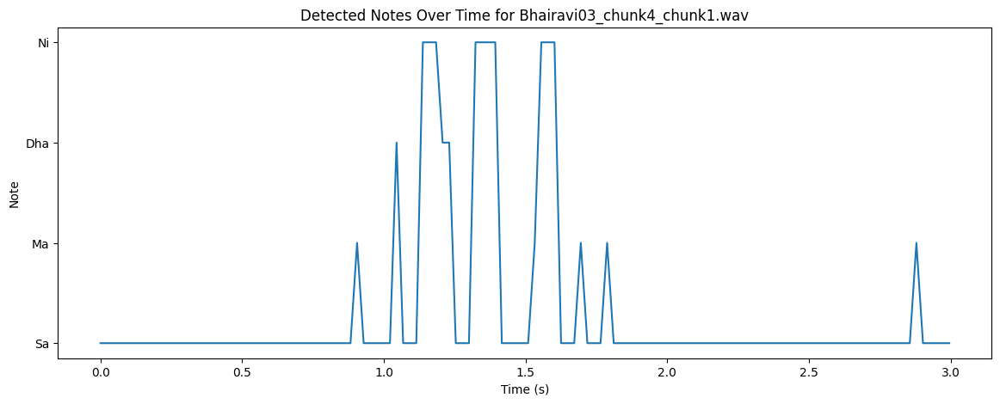

Tonic Frequency for Bhairavi03_chunk4_chunk2.wav: 973.29931640625 Hz
Detected Notes for Bhairavi03_chunk4_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


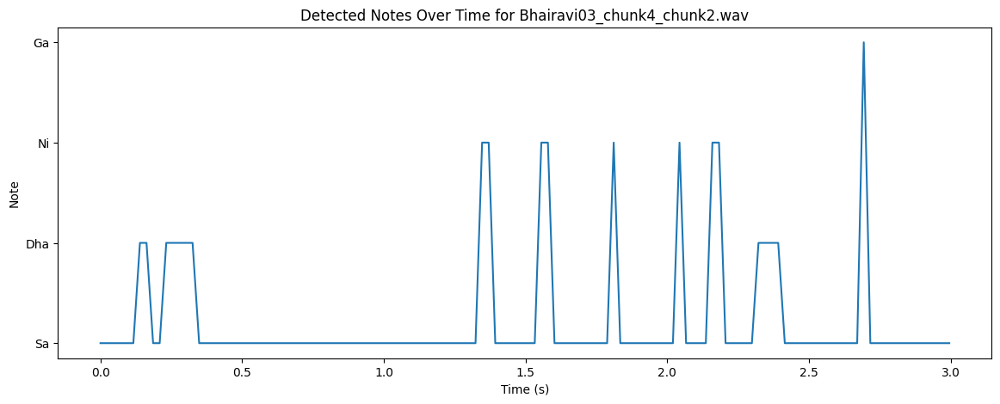

Tonic Frequency for Bhairavi03_chunk4_chunk3.wav: 969.7724609375 Hz
Detected Notes for Bhairavi03_chunk4_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha']


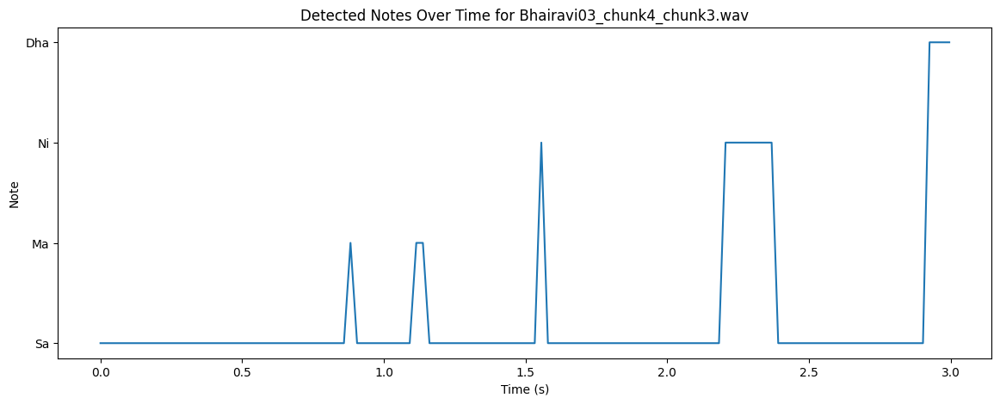

Tonic Frequency for Bhairavi03_chunk4_chunk4.wav: 937.2885131835938 Hz
Detected Notes for Bhairavi03_chunk4_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


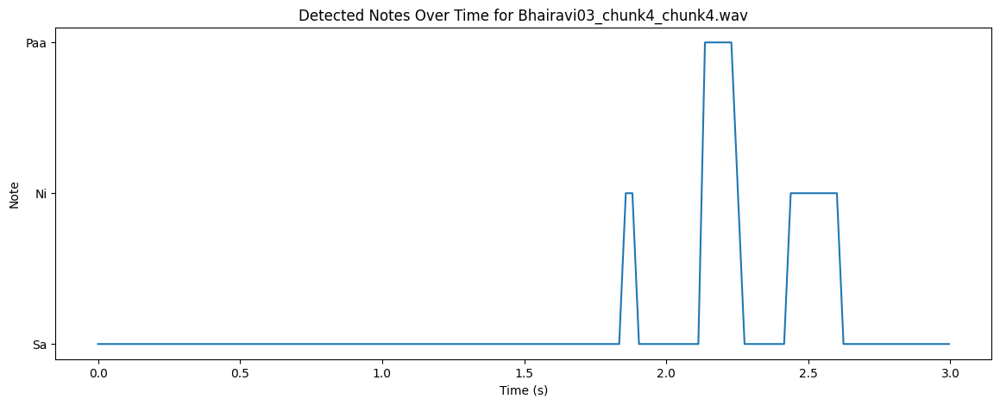

Tonic Frequency for Bhairavi03_chunk4_chunk5.wav: 935.2857055664062 Hz
Detected Notes for Bhairavi03_chunk4_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


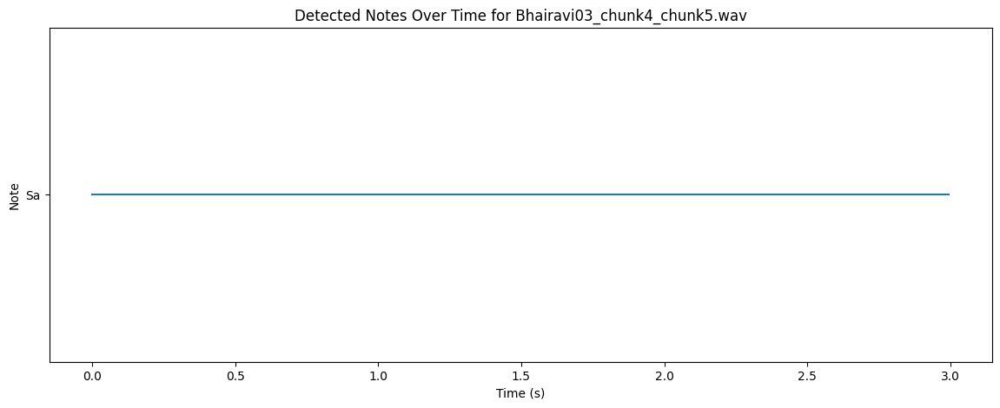

Tonic Frequency for Bhairavi03_chunk4_chunk6.wav: 935.5457153320312 Hz
Detected Notes for Bhairavi03_chunk4_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


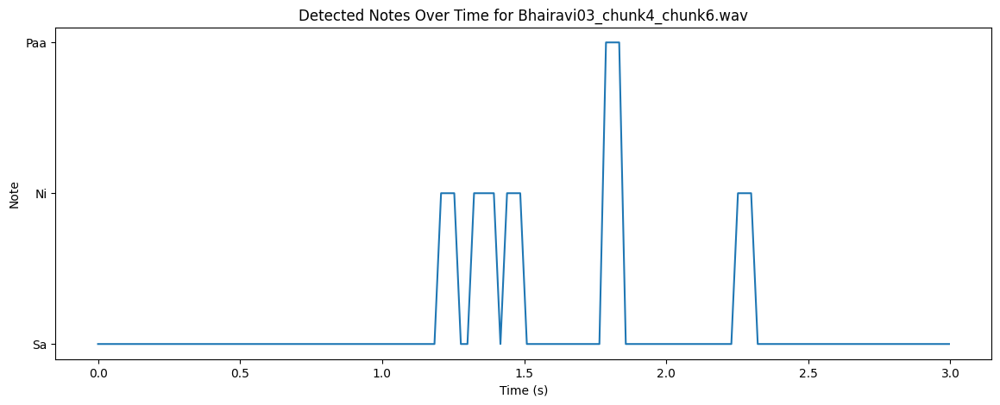

Tonic Frequency for Bhairavi03_chunk4_chunk7.wav: 969.3193359375 Hz
Detected Notes for Bhairavi03_chunk4_chunk7.wav:  ['Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


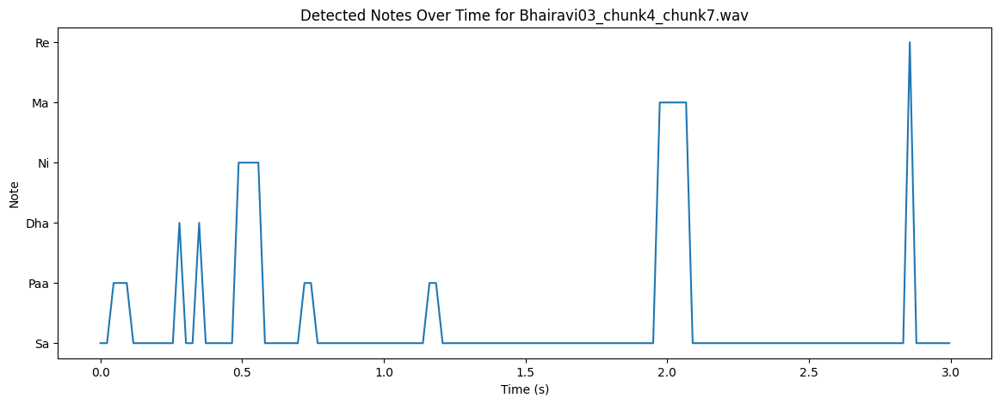

Tonic Frequency for Bhairavi03_chunk4_chunk8.wav: 987.9485473632812 Hz
Detected Notes for Bhairavi03_chunk4_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


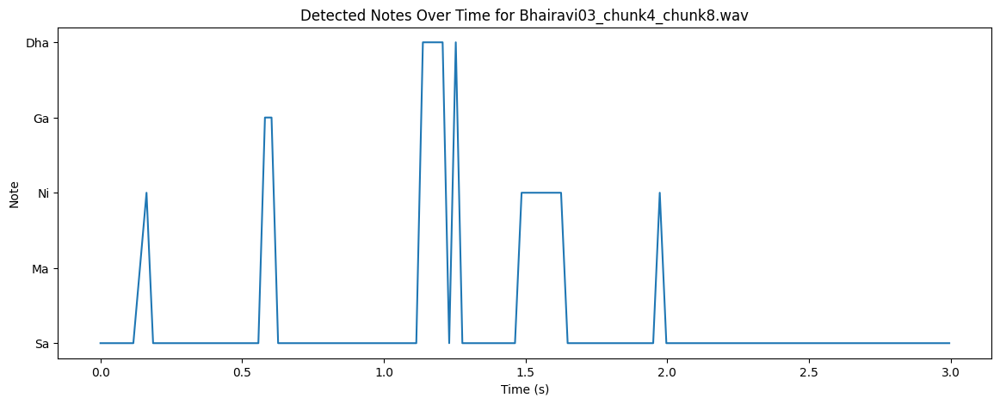

Tonic Frequency for Bhairavi03_chunk4_chunk9.wav: 970.1364135742188 Hz
Detected Notes for Bhairavi03_chunk4_chunk9.wav:  ['Ni', 'Ni', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


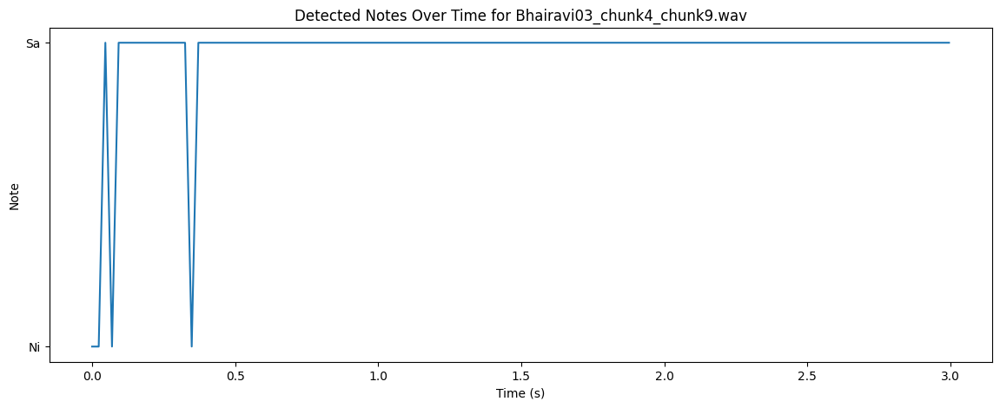

Tonic Frequency for Bhairavi03_chunk4_chunk10.wav: 1042.728271484375 Hz
Detected Notes for Bhairavi03_chunk4_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa']


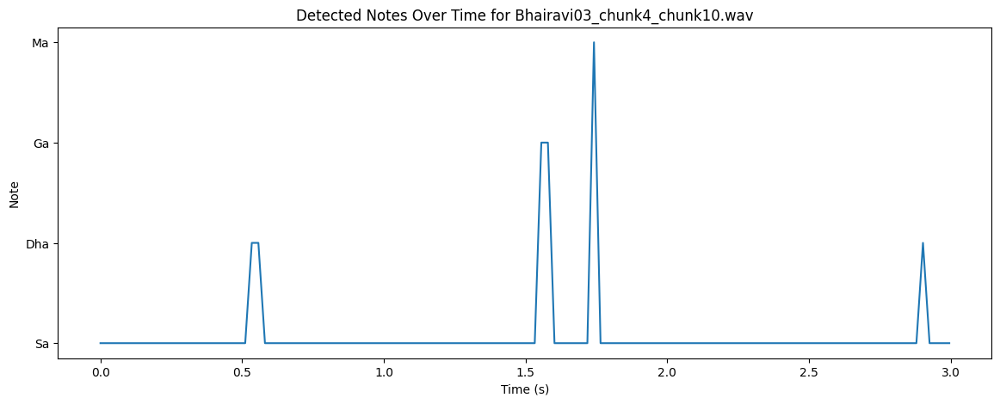

Tonic Frequency for Bhairavi03_chunk5_chunk1.wav: 971.5555419921875 Hz
Detected Notes for Bhairavi03_chunk5_chunk1.wav:  ['Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


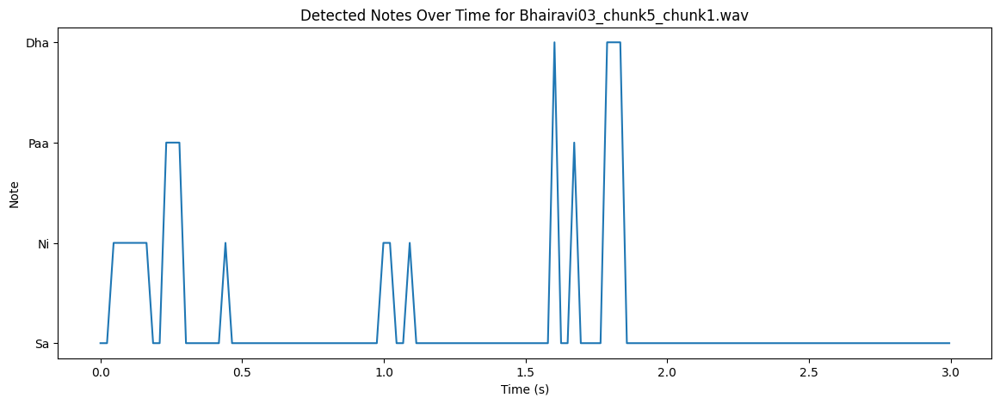

Tonic Frequency for Bhairavi03_chunk5_chunk2.wav: 967.7904663085938 Hz
Detected Notes for Bhairavi03_chunk5_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


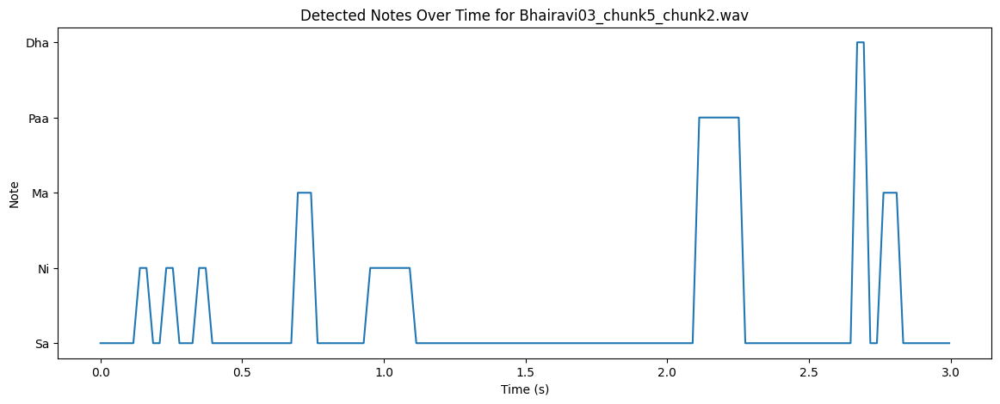

Tonic Frequency for Bhairavi03_chunk5_chunk3.wav: 932.4275512695312 Hz
Detected Notes for Bhairavi03_chunk5_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


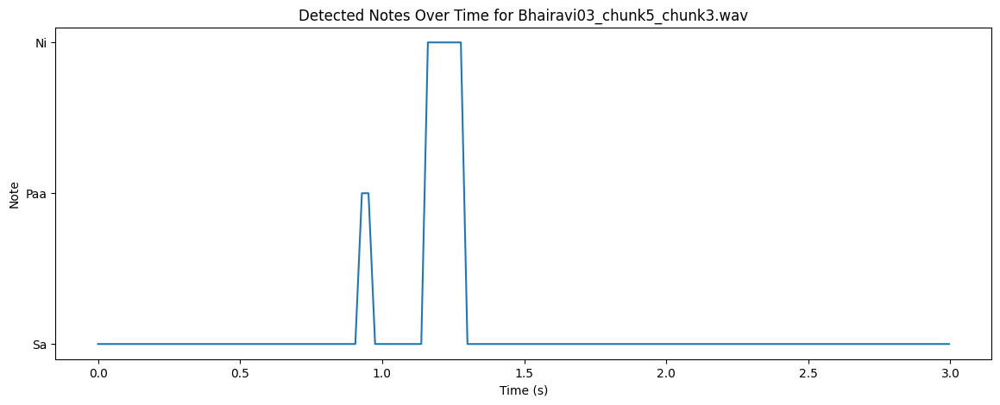

Tonic Frequency for Bhairavi03_chunk5_chunk4.wav: 937.9600830078125 Hz
Detected Notes for Bhairavi03_chunk5_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa']


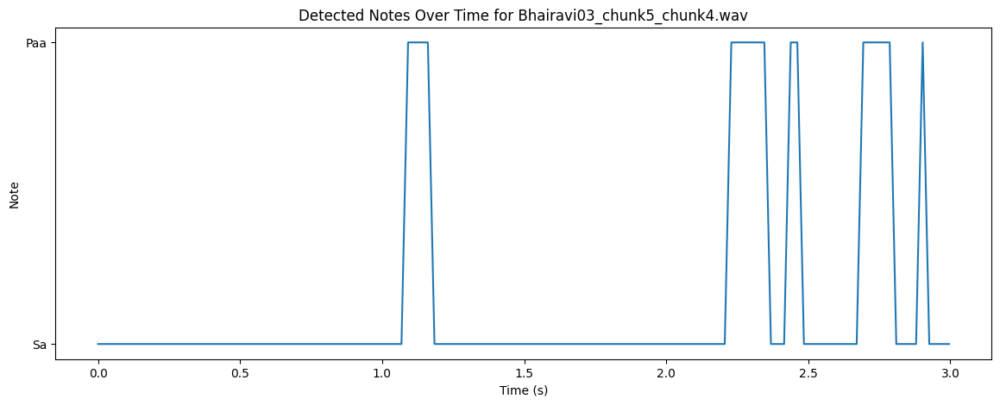

Tonic Frequency for Bhairavi03_chunk5_chunk5.wav: 968.747802734375 Hz
Detected Notes for Bhairavi03_chunk5_chunk5.wav:  ['Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


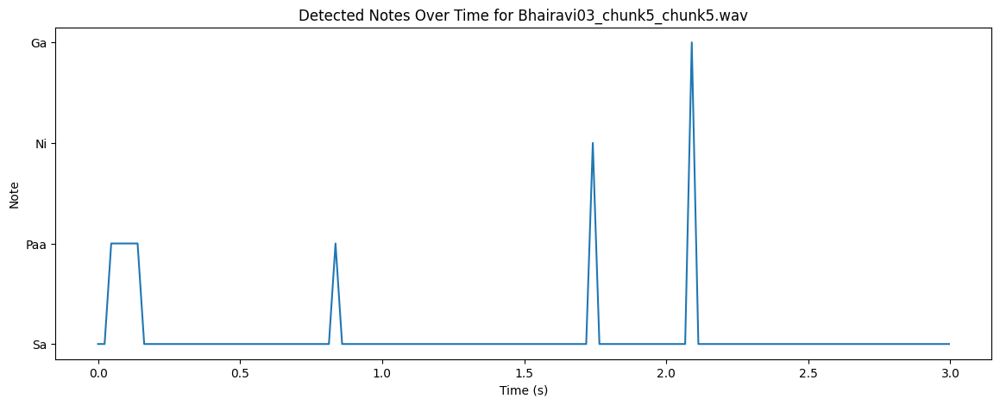

Tonic Frequency for Bhairavi03_chunk5_chunk6.wav: 1063.515625 Hz
Detected Notes for Bhairavi03_chunk5_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Ma', 'Ma', 'Paa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


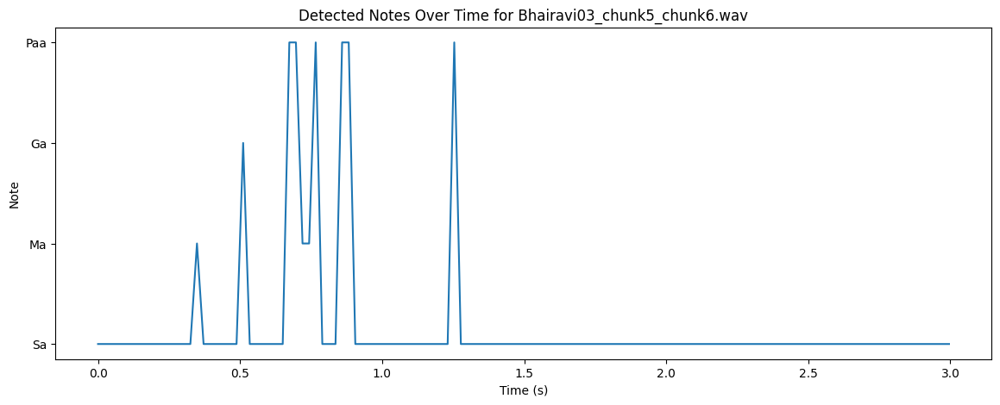

Tonic Frequency for Bhairavi03_chunk5_chunk7.wav: 970.2047119140625 Hz
Detected Notes for Bhairavi03_chunk5_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Dha', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa']


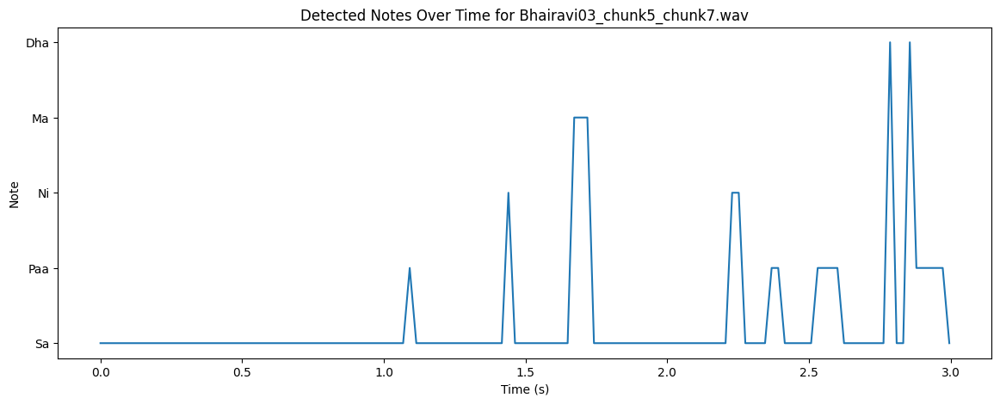

Tonic Frequency for Bhairavi03_chunk5_chunk8.wav: 969.4410400390625 Hz
Detected Notes for Bhairavi03_chunk5_chunk8.wav:  ['Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


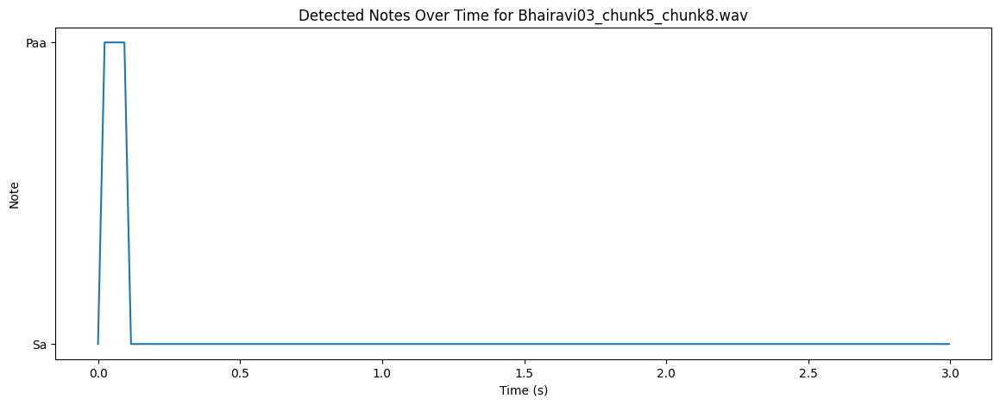

Tonic Frequency for Bhairavi03_chunk5_chunk9.wav: 969.881103515625 Hz
Detected Notes for Bhairavi03_chunk5_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


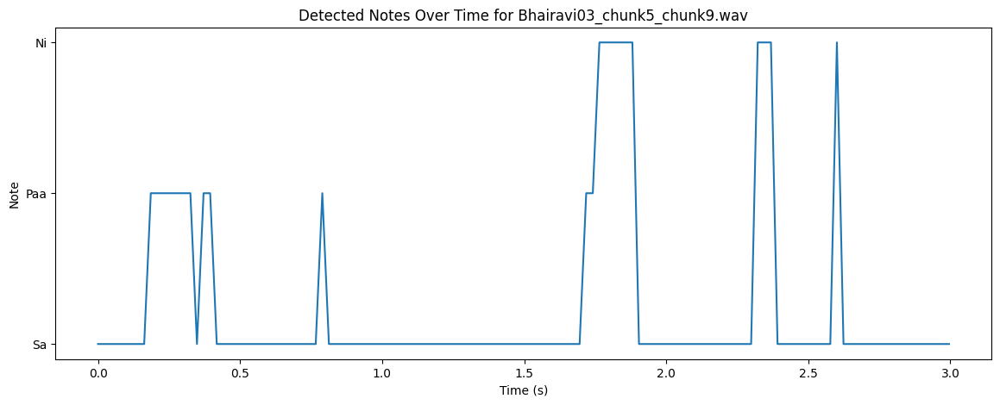

Tonic Frequency for Bhairavi03_chunk5_chunk10.wav: 935.7423706054688 Hz
Detected Notes for Bhairavi03_chunk5_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


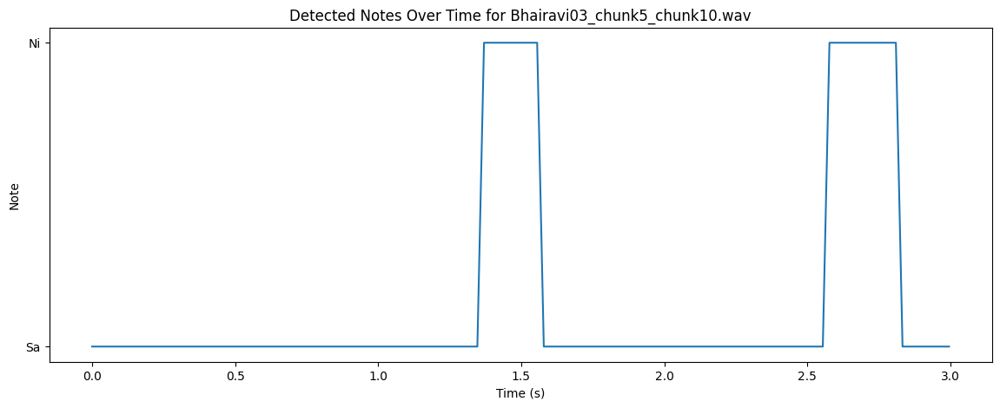

Tonic Frequency for Bhairavi03_chunk6_chunk1.wav: 833.56005859375 Hz
Detected Notes for Bhairavi03_chunk6_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni']


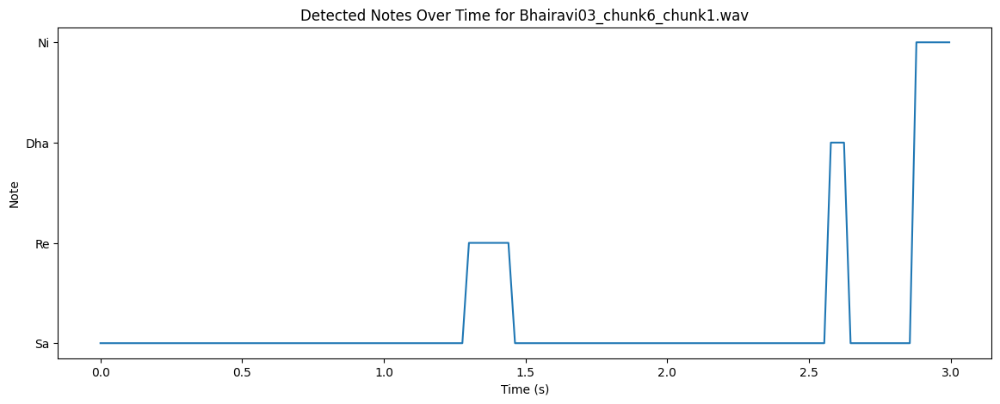

Tonic Frequency for Bhairavi03_chunk6_chunk2.wav: 830.470703125 Hz
Detected Notes for Bhairavi03_chunk6_chunk2.wav:  ['Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


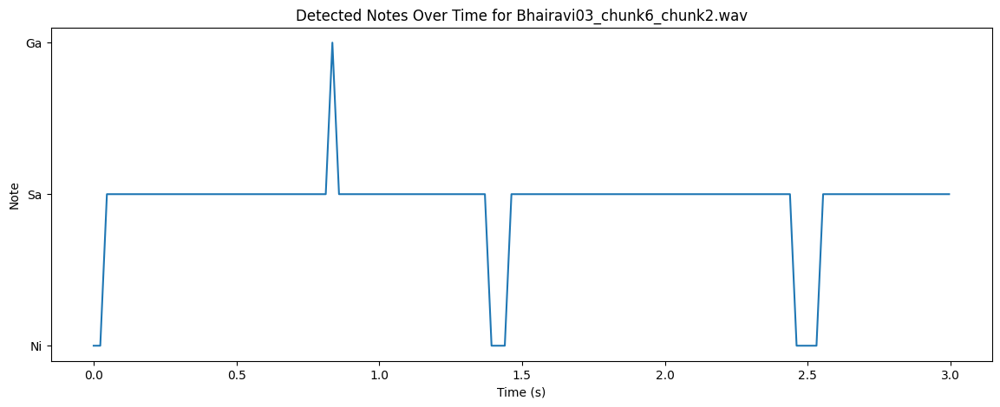

Tonic Frequency for Bhairavi03_chunk6_chunk3.wav: 832.186279296875 Hz
Detected Notes for Bhairavi03_chunk6_chunk3.wav:  ['Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


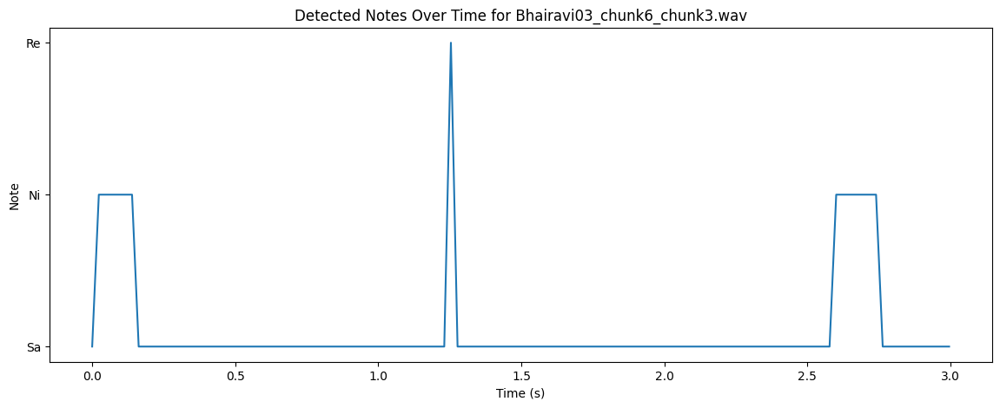

Tonic Frequency for Bhairavi03_chunk6_chunk4.wav: 978.8849487304688 Hz
Detected Notes for Bhairavi03_chunk6_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


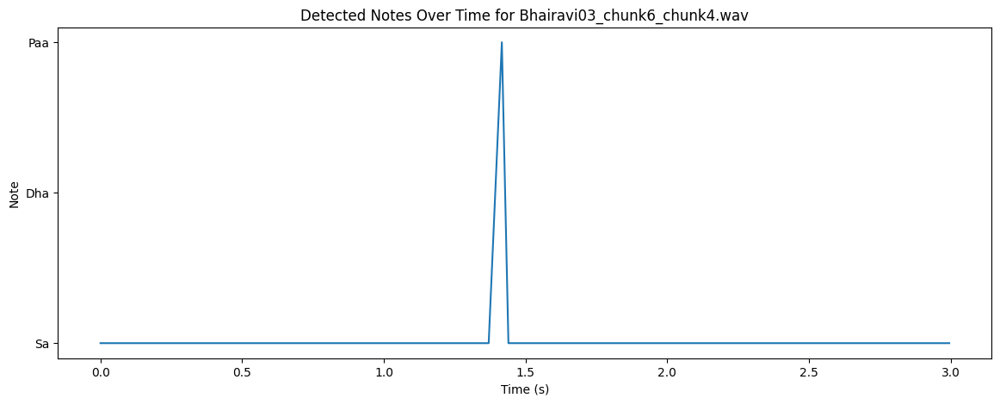

Tonic Frequency for Bhairavi03_chunk6_chunk5.wav: 968.2740478515625 Hz
Detected Notes for Bhairavi03_chunk6_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


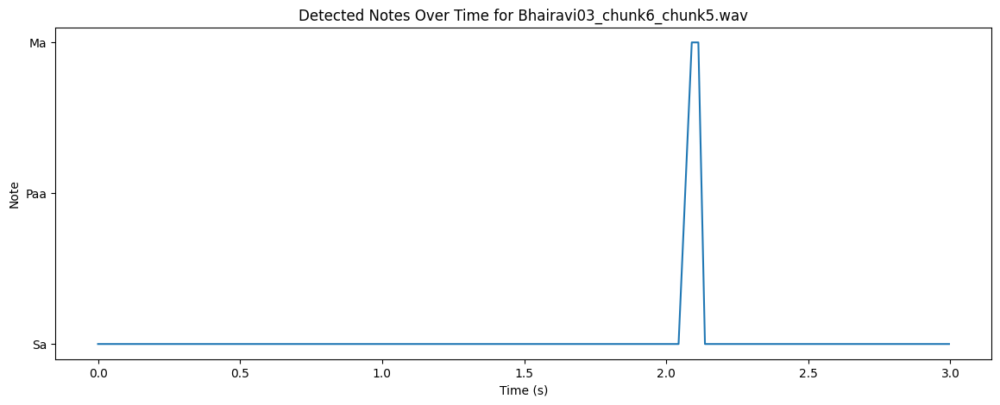

Tonic Frequency for Bhairavi03_chunk6_chunk6.wav: 938.493896484375 Hz
Detected Notes for Bhairavi03_chunk6_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


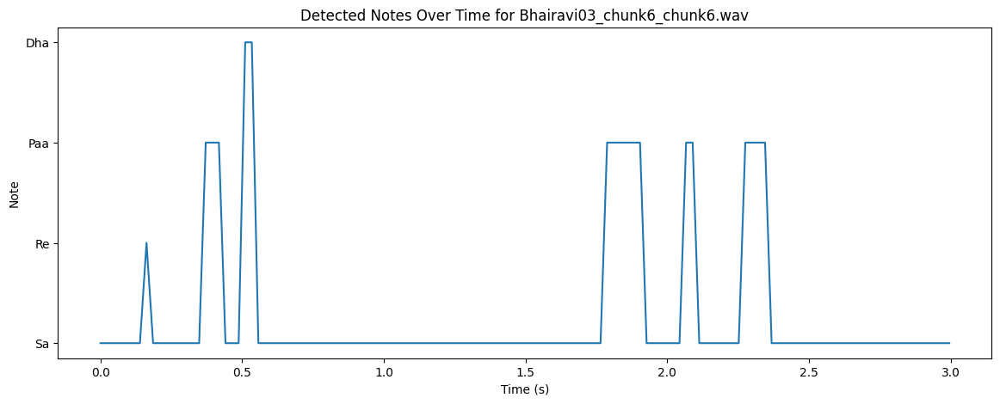

Tonic Frequency for Bhairavi03_chunk6_chunk7.wav: 931.4124755859375 Hz
Detected Notes for Bhairavi03_chunk6_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


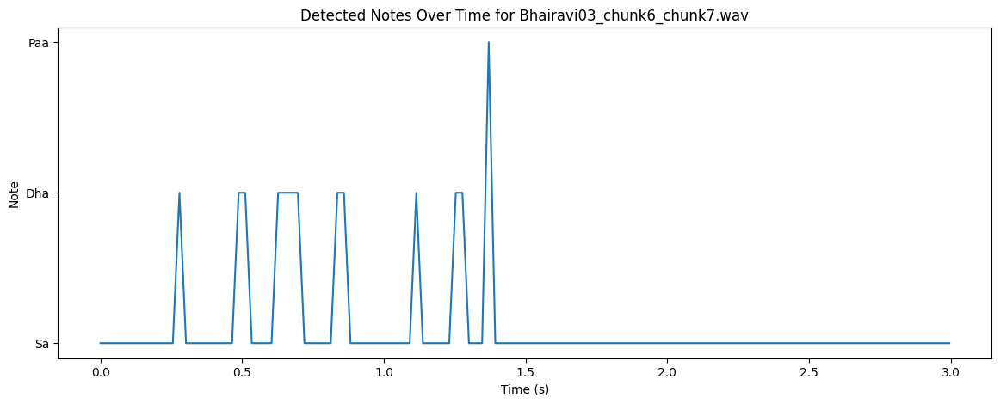

Tonic Frequency for Bhairavi03_chunk6_chunk8.wav: 833.4047241210938 Hz
Detected Notes for Bhairavi03_chunk6_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga']


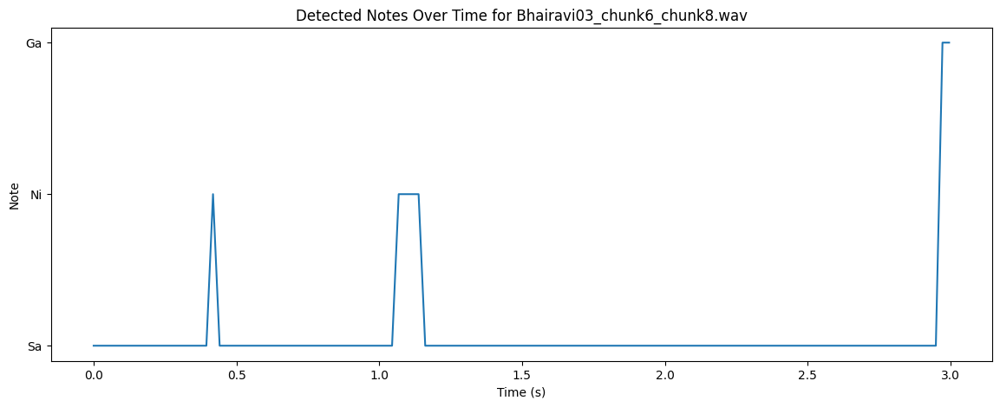

Tonic Frequency for Bhairavi03_chunk6_chunk9.wav: 1092.42431640625 Hz
Detected Notes for Bhairavi03_chunk6_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa']


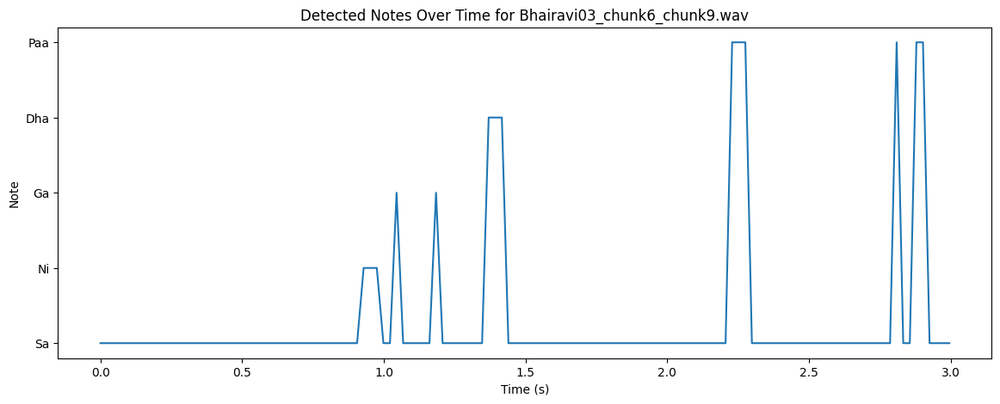

Tonic Frequency for Bhairavi03_chunk6_chunk10.wav: 950.8033447265625 Hz
Detected Notes for Bhairavi03_chunk6_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


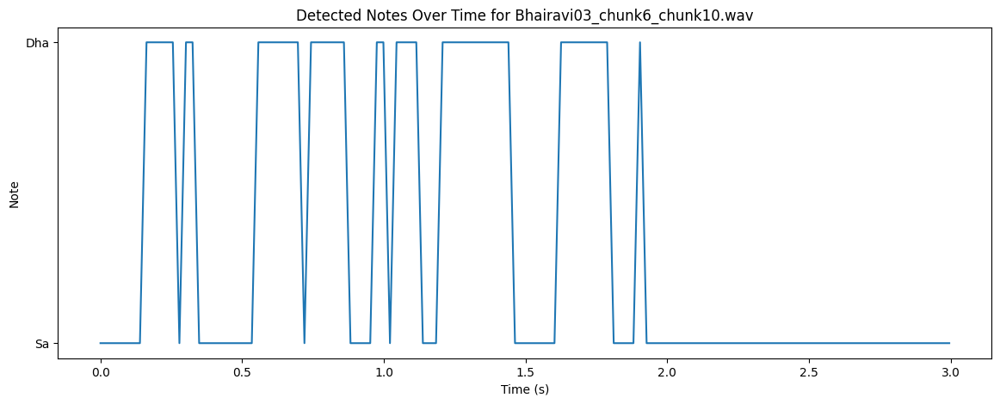

Tonic Frequency for Bhairavi03_chunk7_chunk1.wav: 935.5345458984375 Hz
Detected Notes for Bhairavi03_chunk7_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


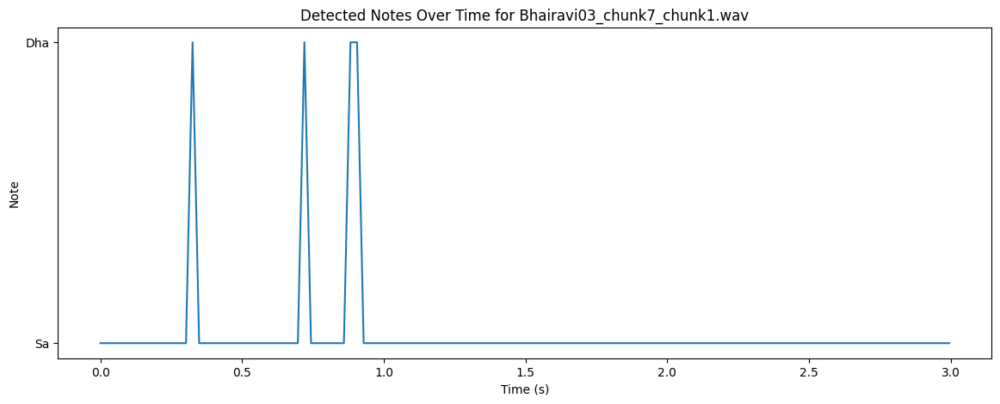

Tonic Frequency for Bhairavi03_chunk7_chunk2.wav: 890.9579467773438 Hz
Detected Notes for Bhairavi03_chunk7_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


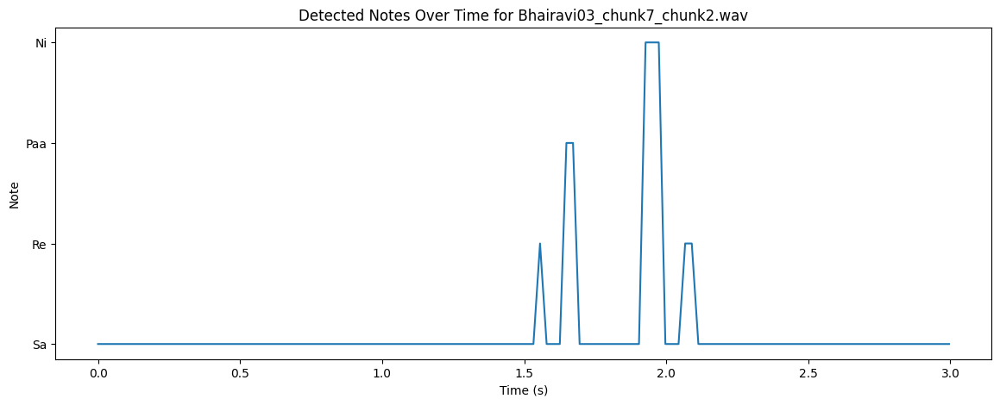

Tonic Frequency for Bhairavi03_chunk7_chunk3.wav: 835.2077026367188 Hz
Detected Notes for Bhairavi03_chunk7_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


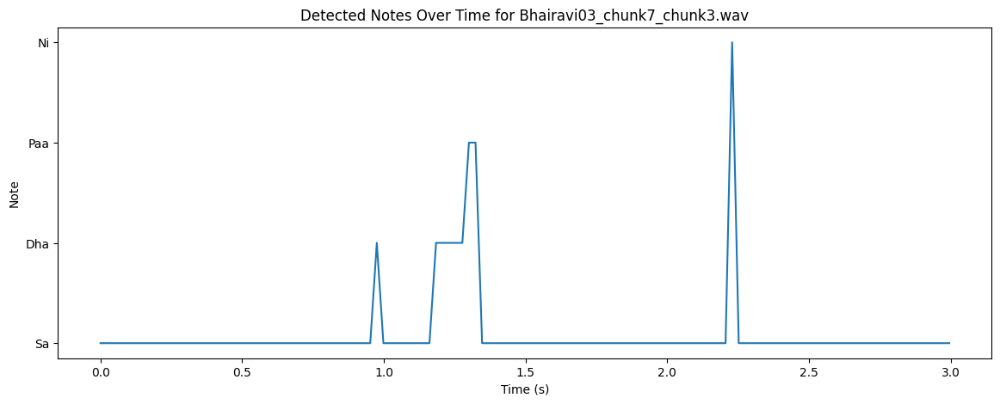

Tonic Frequency for Bhairavi03_chunk7_chunk4.wav: 868.563232421875 Hz
Detected Notes for Bhairavi03_chunk7_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


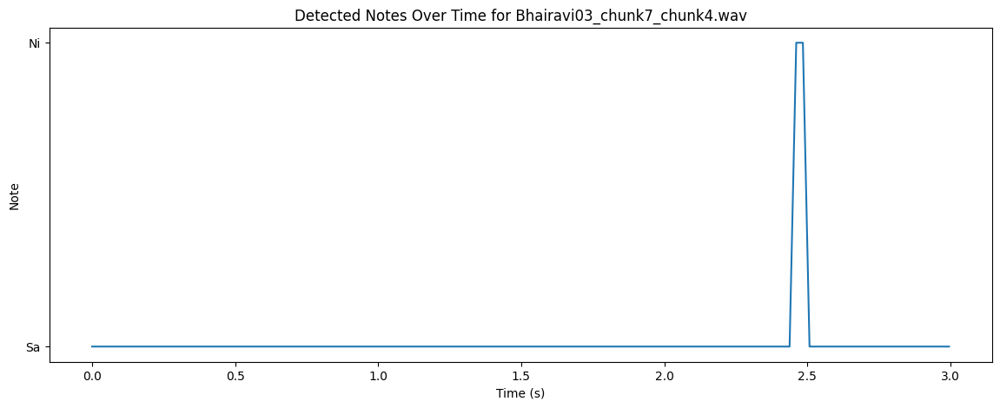

Tonic Frequency for Bhairavi03_chunk7_chunk5.wav: 858.1874389648438 Hz
Detected Notes for Bhairavi03_chunk7_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


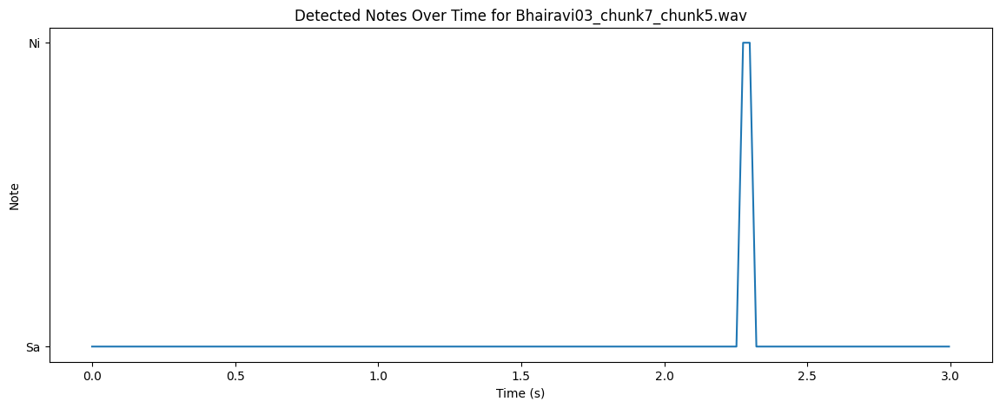

Tonic Frequency for Bhairavi03_chunk7_chunk6.wav: 834.2109375 Hz
Detected Notes for Bhairavi03_chunk7_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


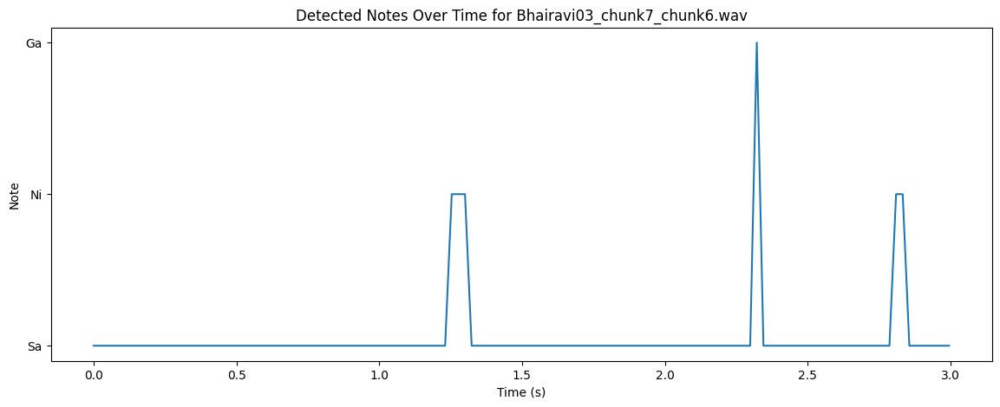

Tonic Frequency for Bhairavi03_chunk7_chunk7.wav: 832.6304931640625 Hz
Detected Notes for Bhairavi03_chunk7_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


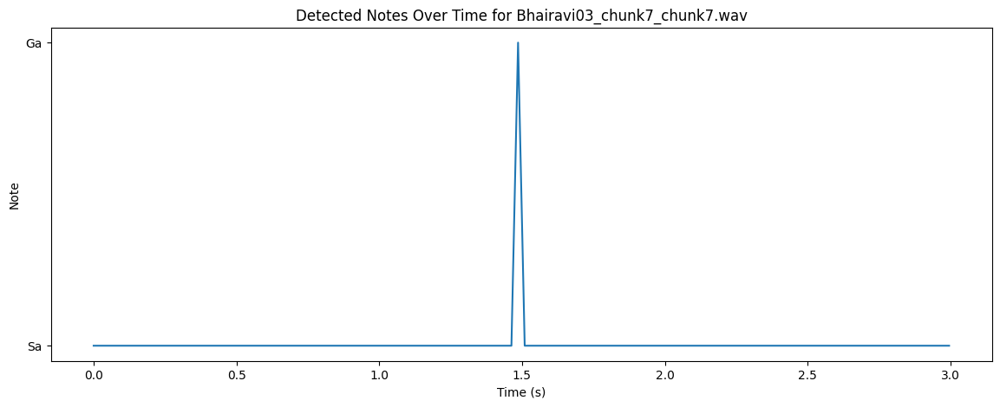

Tonic Frequency for Bhairavi03_chunk7_chunk8.wav: 832.1455078125 Hz
Detected Notes for Bhairavi03_chunk7_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


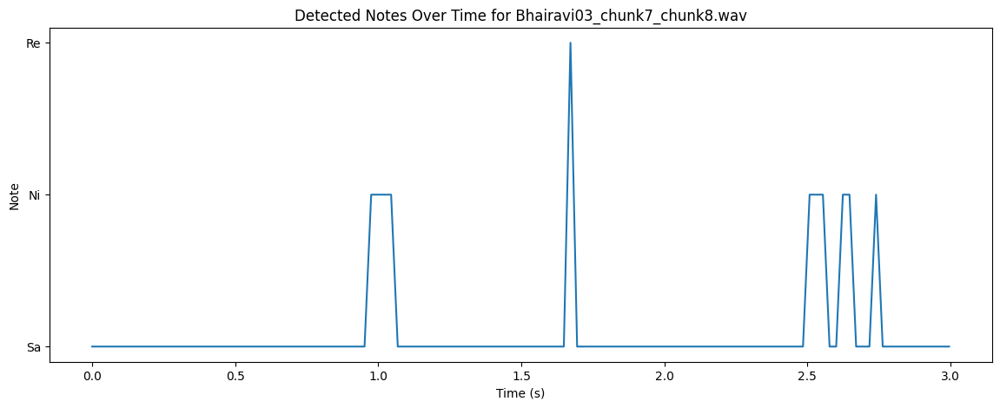

Tonic Frequency for Bhairavi03_chunk7_chunk9.wav: 833.7630615234375 Hz
Detected Notes for Bhairavi03_chunk7_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Re', 'Re', 'Re', 'Re', 'Re']


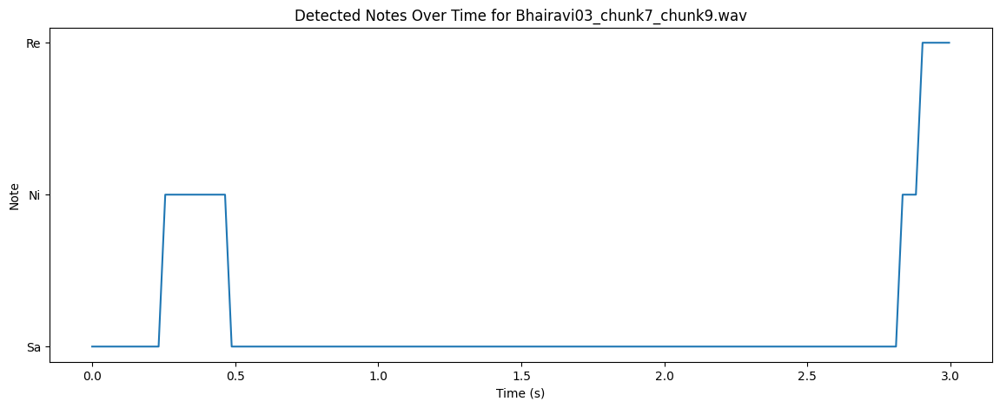

Tonic Frequency for Bhairavi03_chunk7_chunk10.wav: 968.0511474609375 Hz
Detected Notes for Bhairavi03_chunk7_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


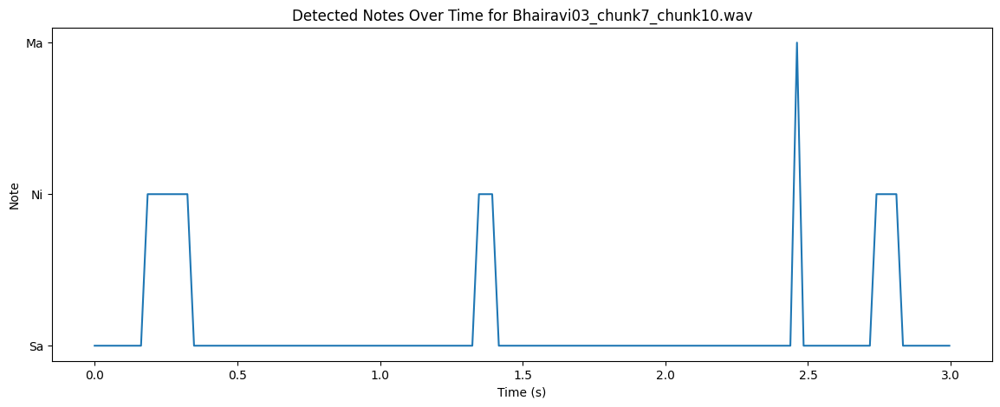

Tonic Frequency for Bhairavi03_chunk8_chunk1.wav: 968.7282104492188 Hz
Detected Notes for Bhairavi03_chunk8_chunk1.wav:  ['Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


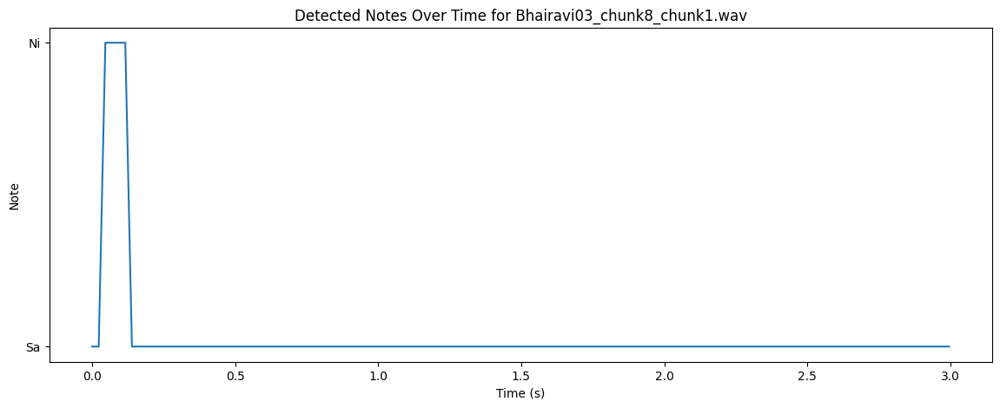

Tonic Frequency for Bhairavi03_chunk8_chunk2.wav: 873.6881103515625 Hz
Detected Notes for Bhairavi03_chunk8_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


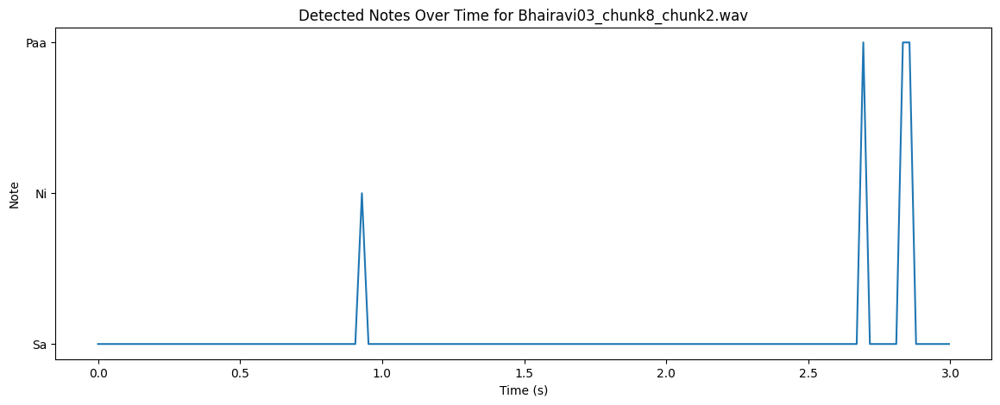

Tonic Frequency for Bhairavi03_chunk8_chunk3.wav: 832.889404296875 Hz
Detected Notes for Bhairavi03_chunk8_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


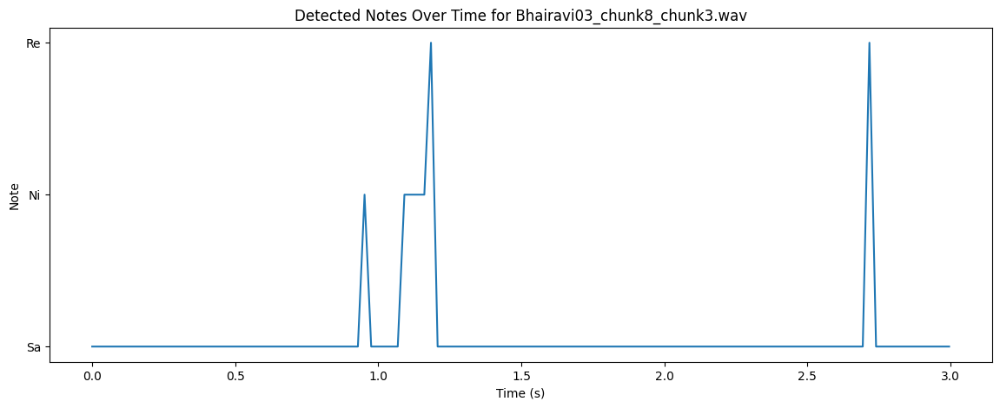

Tonic Frequency for Bhairavi03_chunk8_chunk4.wav: 829.8809204101562 Hz
Detected Notes for Bhairavi03_chunk8_chunk4.wav:  ['Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


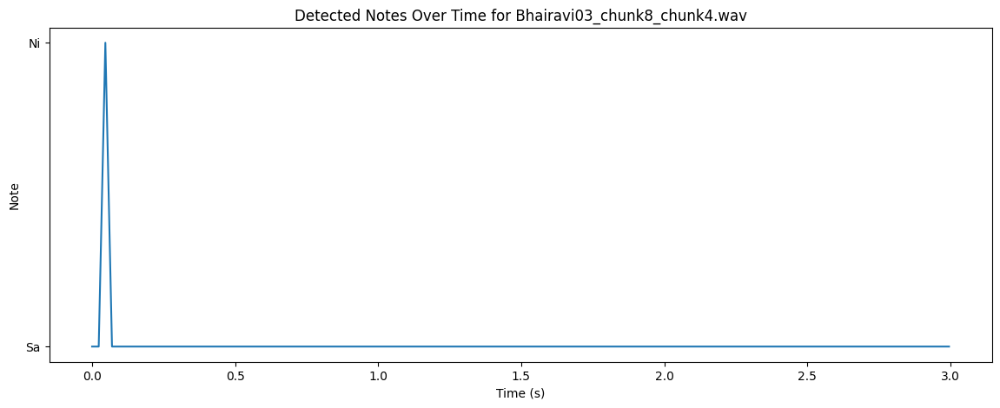

Tonic Frequency for Bhairavi03_chunk8_chunk5.wav: 830.7393798828125 Hz
Detected Notes for Bhairavi03_chunk8_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


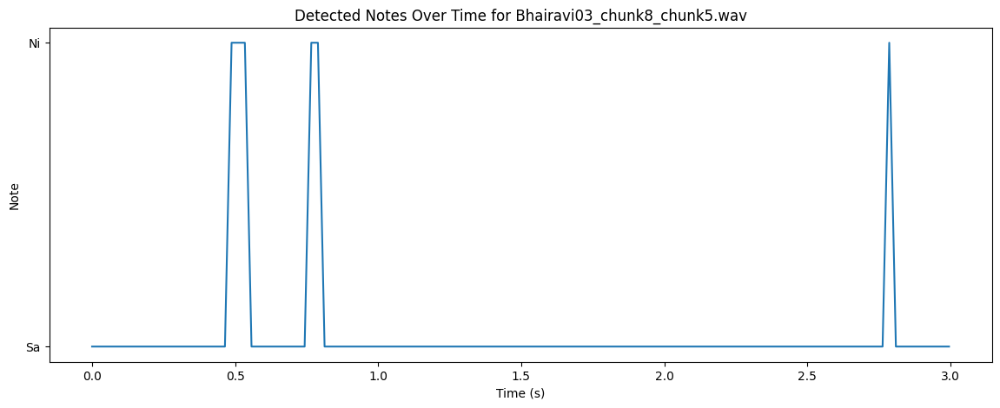

Tonic Frequency for Bhairavi03_chunk8_chunk6.wav: 940.412109375 Hz
Detected Notes for Bhairavi03_chunk8_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


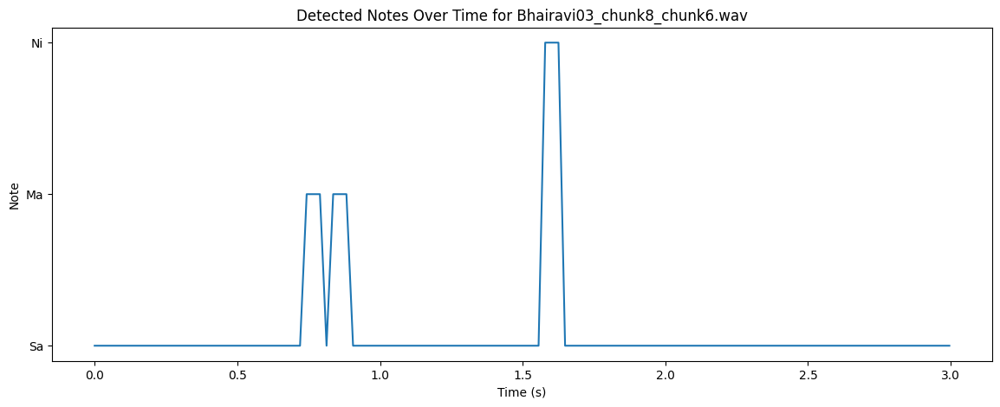

Tonic Frequency for Bhairavi03_chunk8_chunk7.wav: 856.2257690429688 Hz
Detected Notes for Bhairavi03_chunk8_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


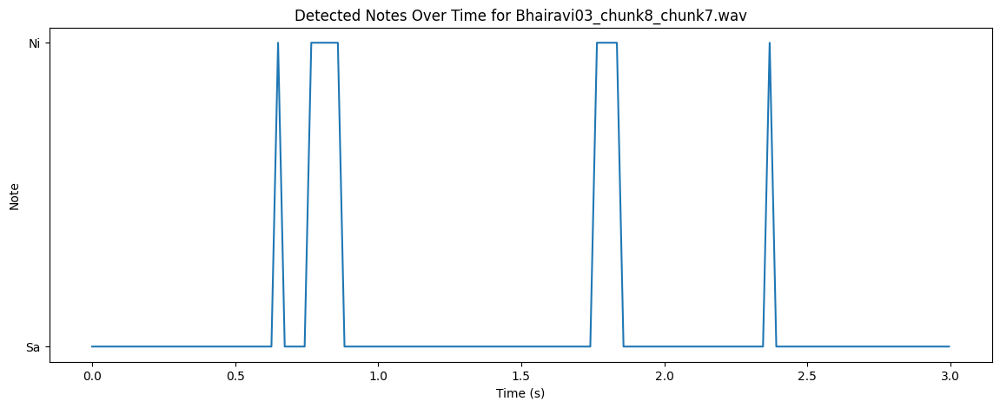

Tonic Frequency for Bhairavi03_chunk8_chunk8.wav: 939.239013671875 Hz
Detected Notes for Bhairavi03_chunk8_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


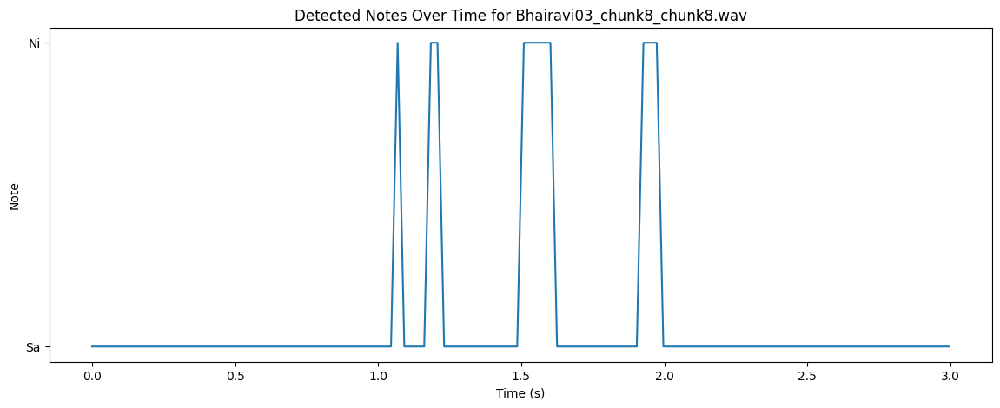

Tonic Frequency for Bhairavi03_chunk8_chunk9.wav: 935.7853393554688 Hz
Detected Notes for Bhairavi03_chunk8_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


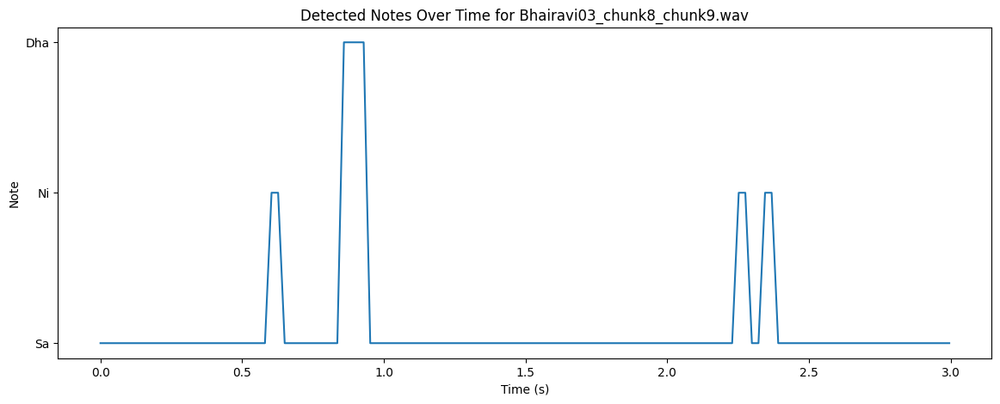

Tonic Frequency for Bhairavi03_chunk8_chunk10.wav: 936.0188598632812 Hz
Detected Notes for Bhairavi03_chunk8_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa']


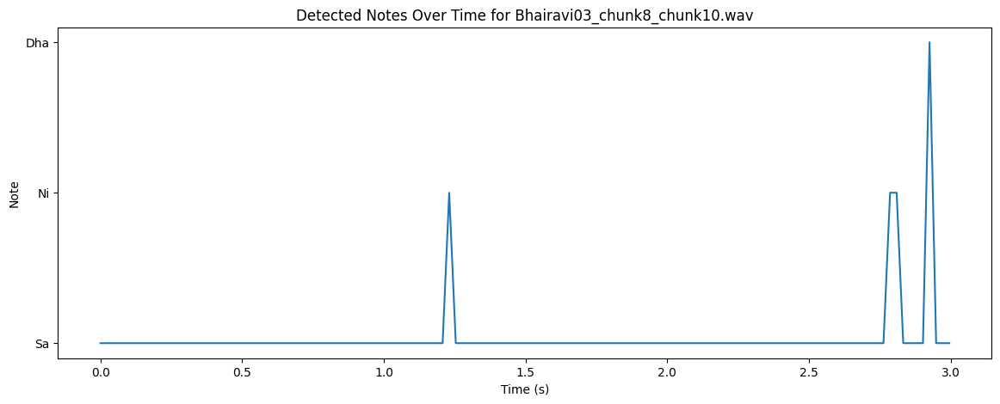

Tonic Frequency for Bhairavi03_chunk9_chunk1.wav: 968.23583984375 Hz
Detected Notes for Bhairavi03_chunk9_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


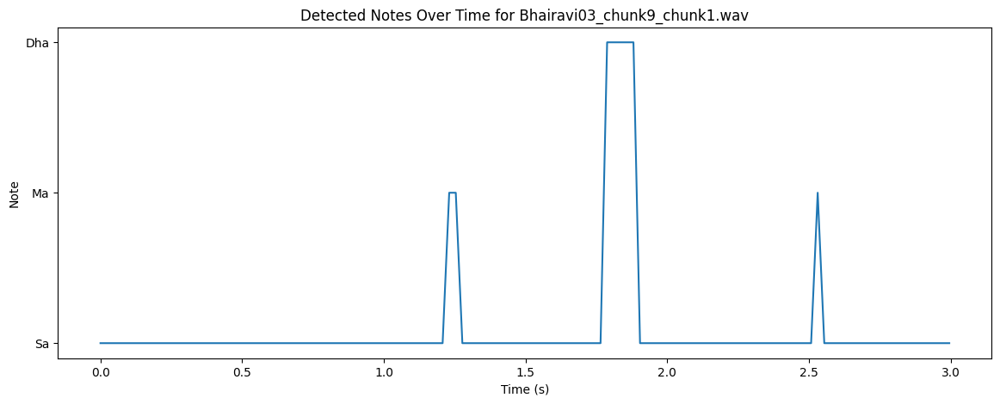

Tonic Frequency for Bhairavi03_chunk9_chunk2.wav: 970.9259033203125 Hz
Detected Notes for Bhairavi03_chunk9_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa']


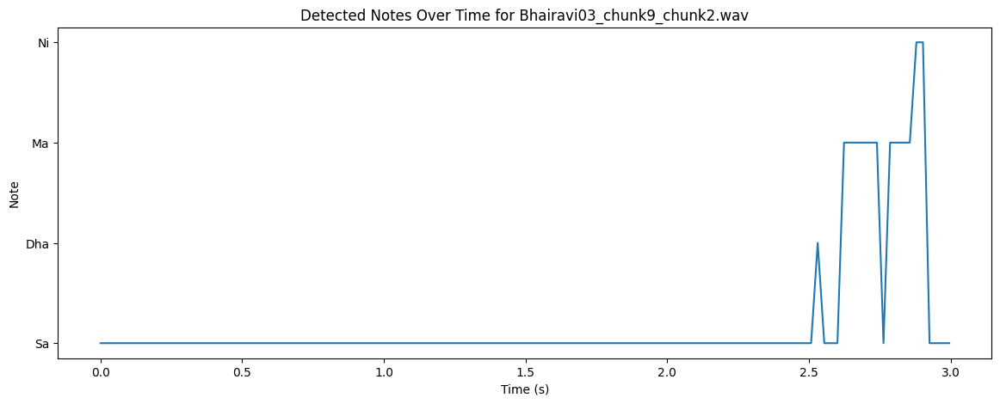

Tonic Frequency for Bhairavi03_chunk9_chunk3.wav: 1035.7957763671875 Hz
Detected Notes for Bhairavi03_chunk9_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma']


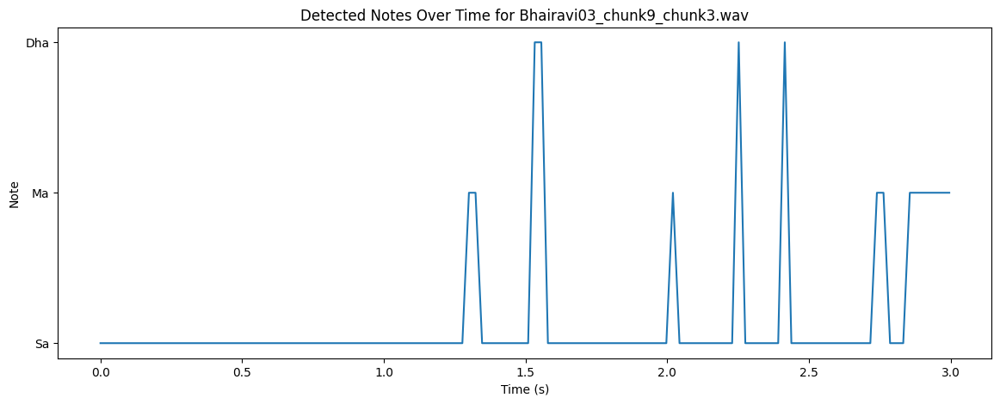

Tonic Frequency for Bhairavi03_chunk9_chunk4.wav: 974.490966796875 Hz
Detected Notes for Bhairavi03_chunk9_chunk4.wav:  ['Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


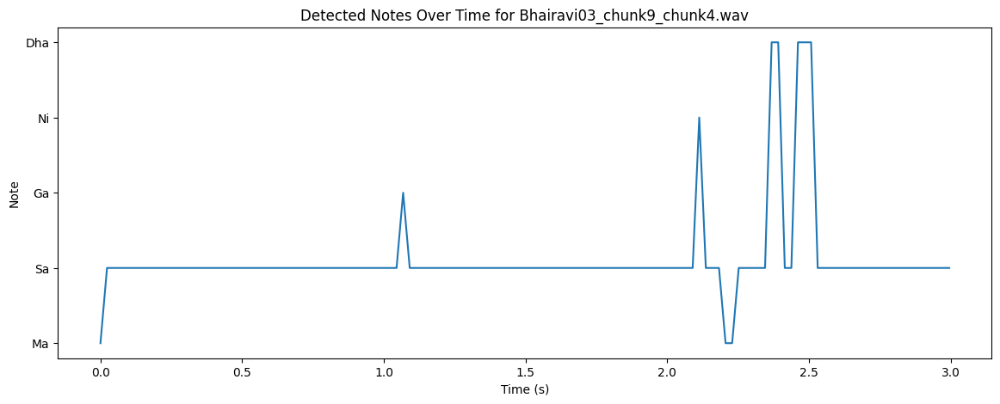

Tonic Frequency for Bhairavi03_chunk9_chunk5.wav: 1108.80419921875 Hz
Detected Notes for Bhairavi03_chunk9_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


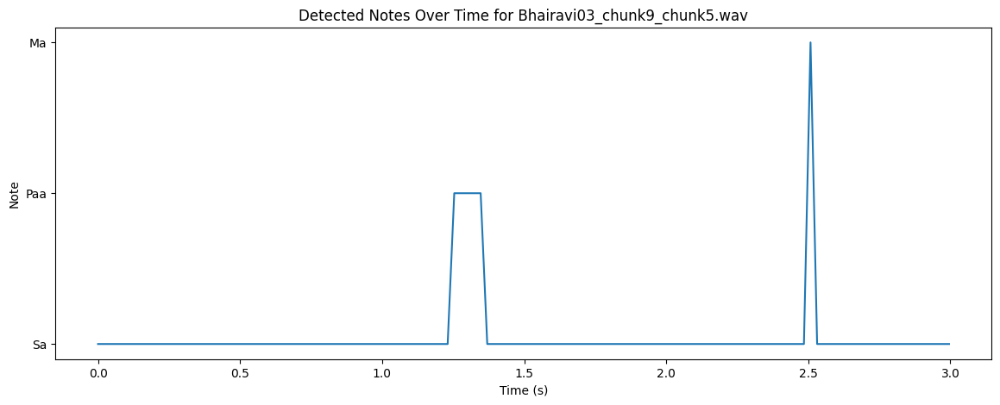

Tonic Frequency for Bhairavi03_chunk9_chunk6.wav: 1248.5887451171875 Hz
Detected Notes for Bhairavi03_chunk9_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


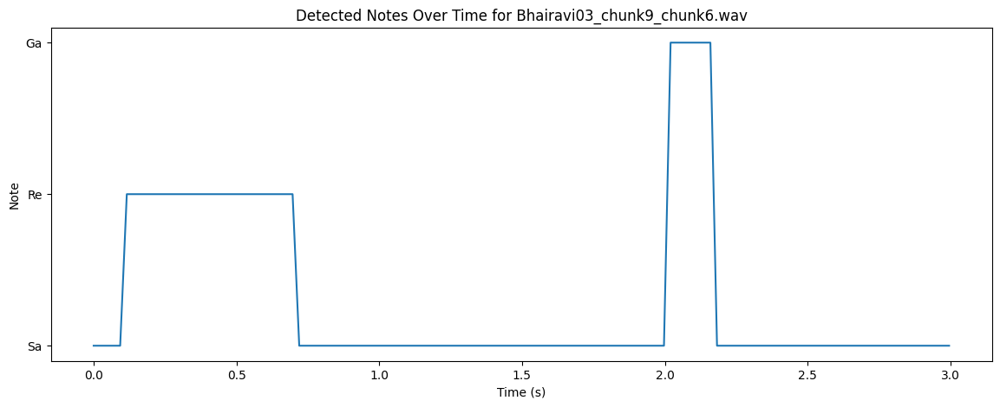

Tonic Frequency for Bhairavi03_chunk9_chunk7.wav: 1249.59423828125 Hz
Detected Notes for Bhairavi03_chunk9_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga']


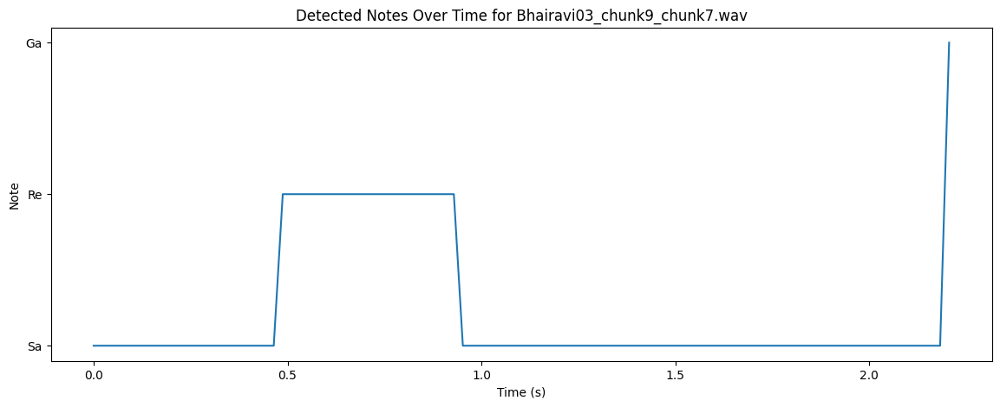

Tonic Frequency for bhairavi27_chunk1_chunk1.wav: 701.4339599609375 Hz
Detected Notes for bhairavi27_chunk1_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga']


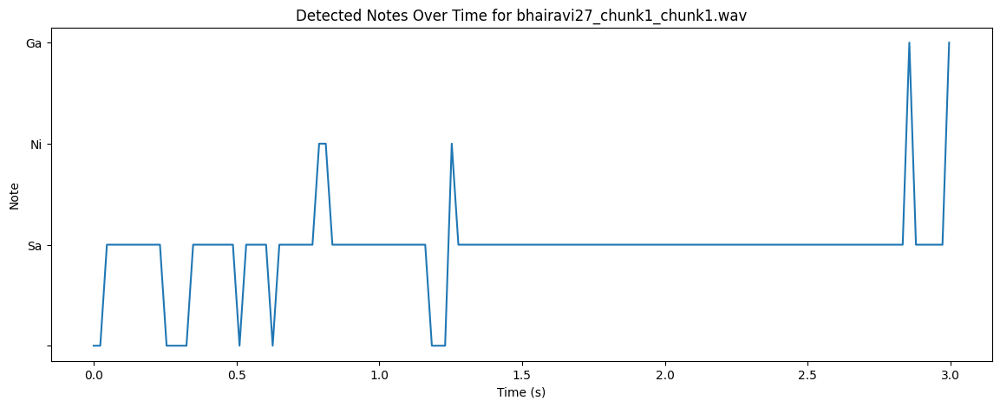

Tonic Frequency for bhairavi27_chunk1_chunk2.wav: 1492.584716796875 Hz
Detected Notes for bhairavi27_chunk1_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


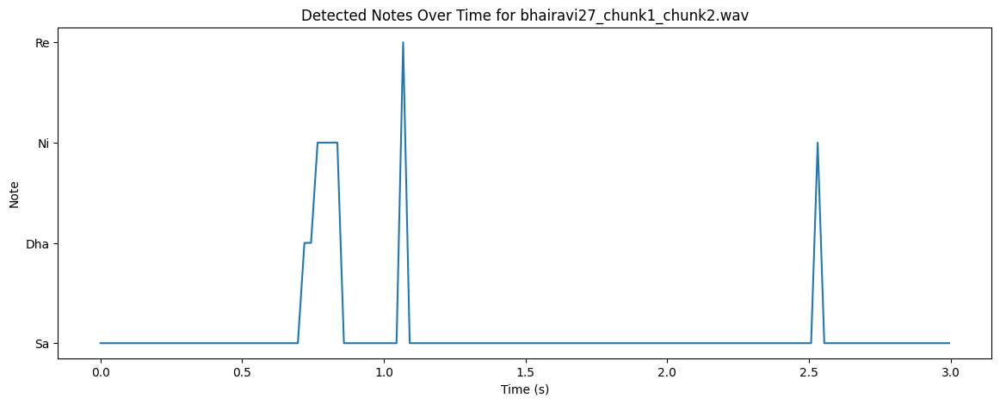

Tonic Frequency for bhairavi27_chunk1_chunk3.wav: 1746.0343017578125 Hz
Detected Notes for bhairavi27_chunk1_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ga', 'Ga', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Re', 'Sa', 'Sa', 'Sa', 'Sa']


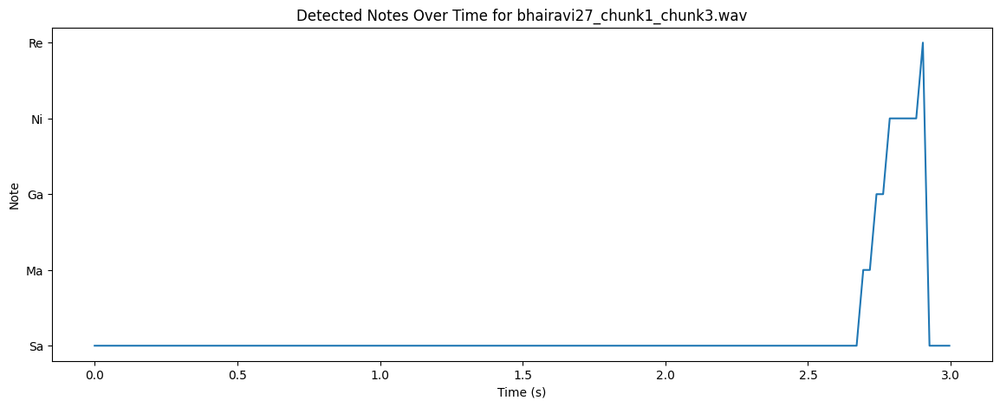

Tonic Frequency for bhairavi27_chunk1_chunk4.wav: 1712.686767578125 Hz
Detected Notes for bhairavi27_chunk1_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


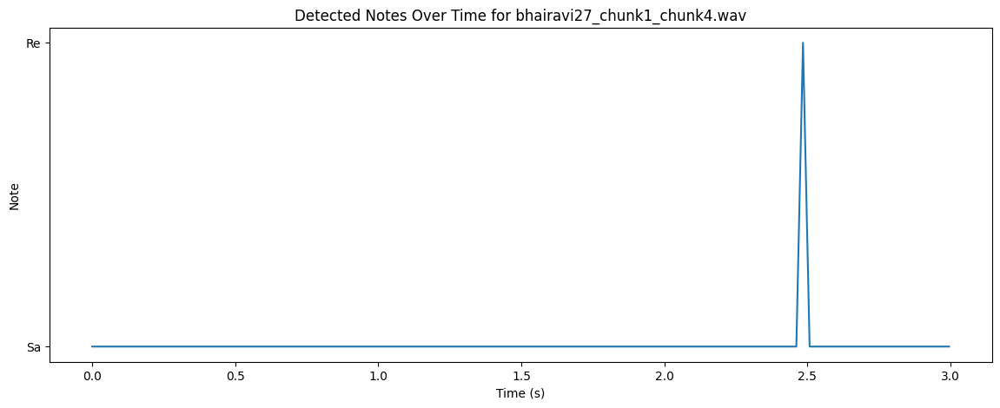

Tonic Frequency for bhairavi27_chunk1_chunk5.wav: 2279.8330078125 Hz
Detected Notes for bhairavi27_chunk1_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Paa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


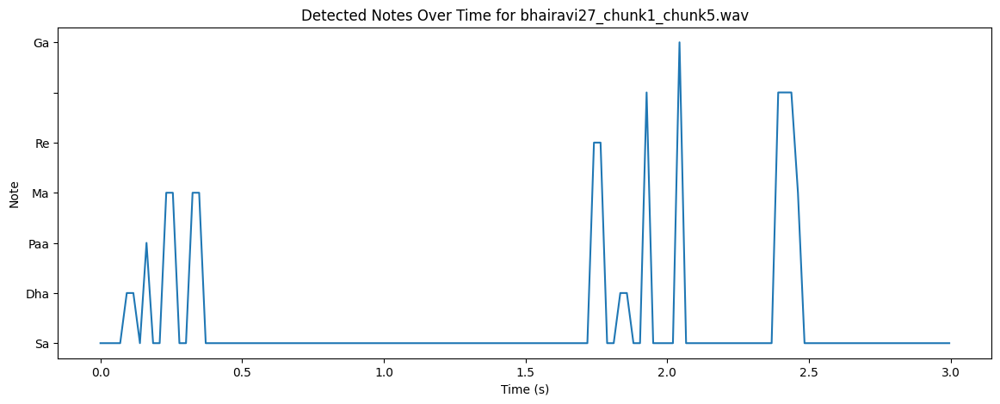

Tonic Frequency for bhairavi27_chunk1_chunk6.wav: 1443.9210205078125 Hz
Detected Notes for bhairavi27_chunk1_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


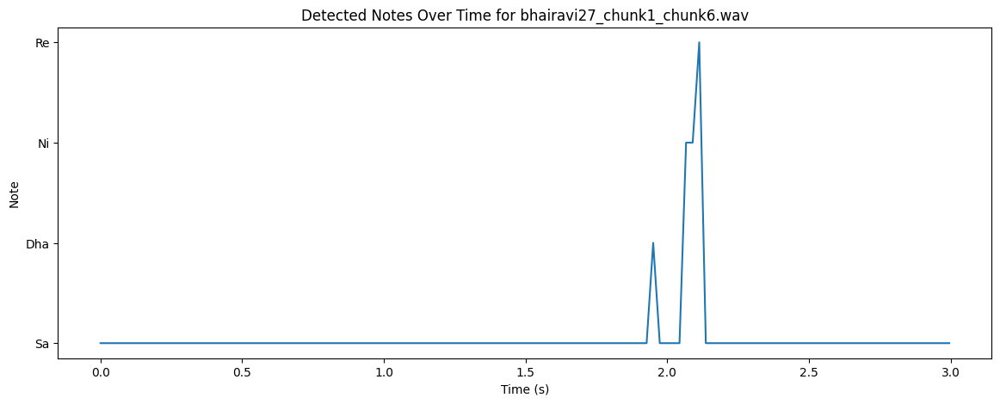

Tonic Frequency for bhairavi27_chunk1_chunk7.wav: 1784.361572265625 Hz
Detected Notes for bhairavi27_chunk1_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ga', 'Ga', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


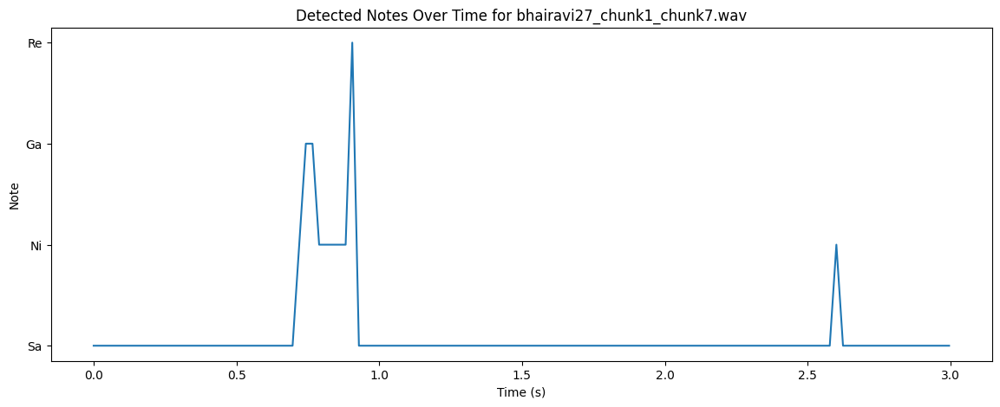

Tonic Frequency for bhairavi27_chunk1_chunk8.wav: 2111.857177734375 Hz
Detected Notes for bhairavi27_chunk1_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


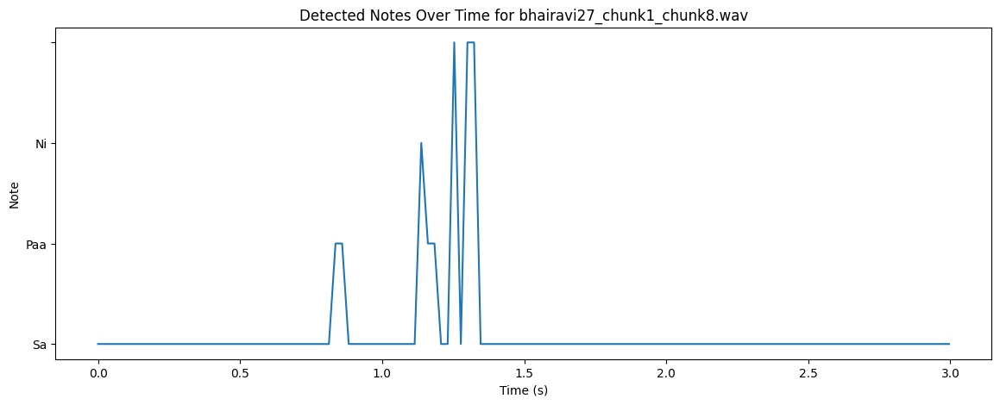

Tonic Frequency for bhairavi27_chunk1_chunk9.wav: 1551.608642578125 Hz
Detected Notes for bhairavi27_chunk1_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Paa', 'Paa', 'Ni', 'Ni', 'Ni', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


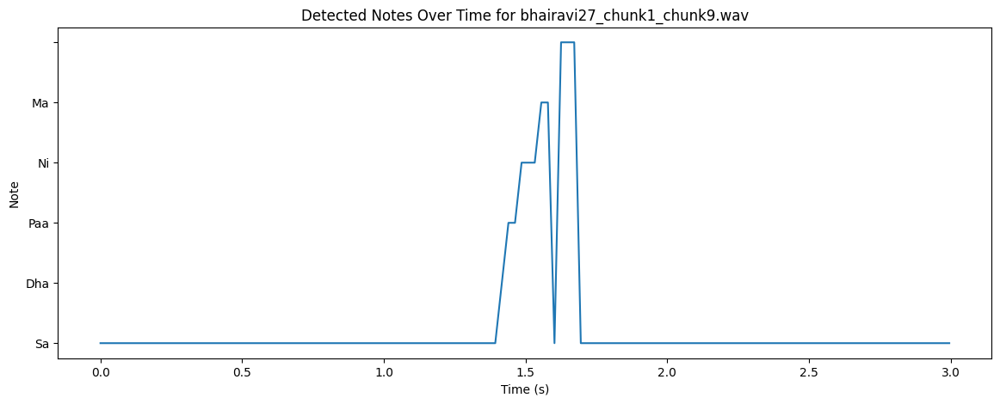

Tonic Frequency for bhairavi27_chunk1_chunk10.wav: 1765.52685546875 Hz
Detected Notes for bhairavi27_chunk1_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Ga', 'Ga', 'Ni', 'Ni', 'Ni', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


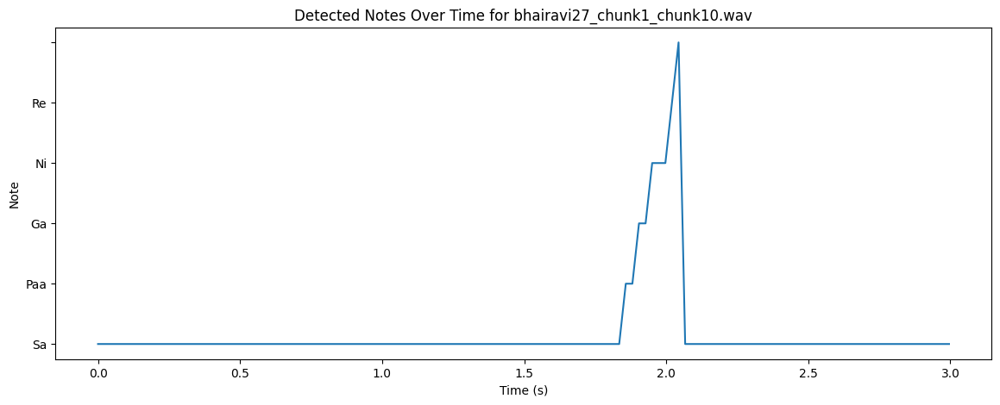

Tonic Frequency for bhairavi27_chunk2_chunk1.wav: 1883.146728515625 Hz
Detected Notes for bhairavi27_chunk2_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


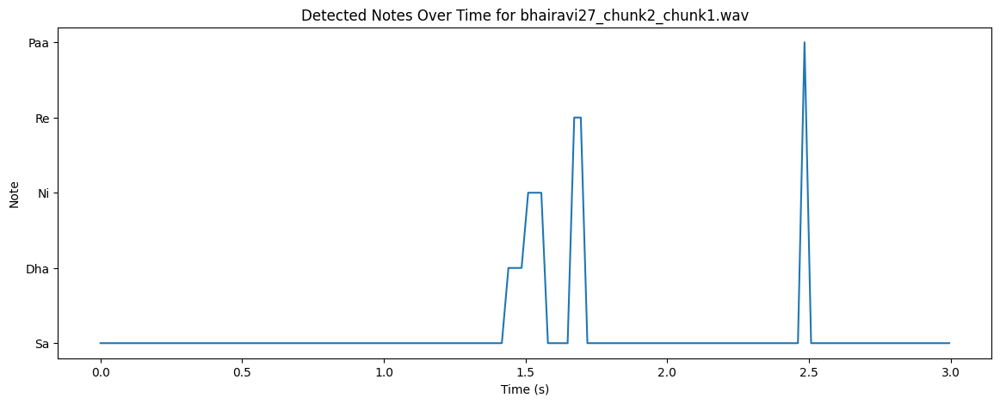

Tonic Frequency for bhairavi27_chunk2_chunk2.wav: 1756.710205078125 Hz
Detected Notes for bhairavi27_chunk2_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


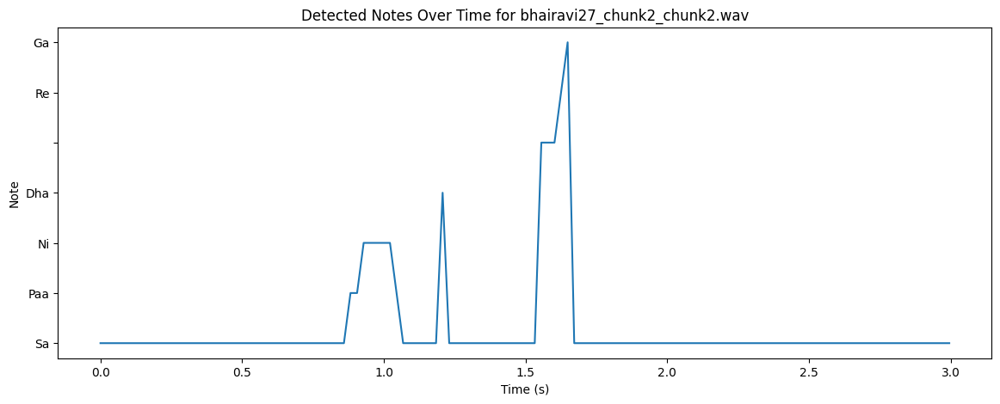

Tonic Frequency for bhairavi27_chunk2_chunk3.wav: 1981.739501953125 Hz
Detected Notes for bhairavi27_chunk2_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa']


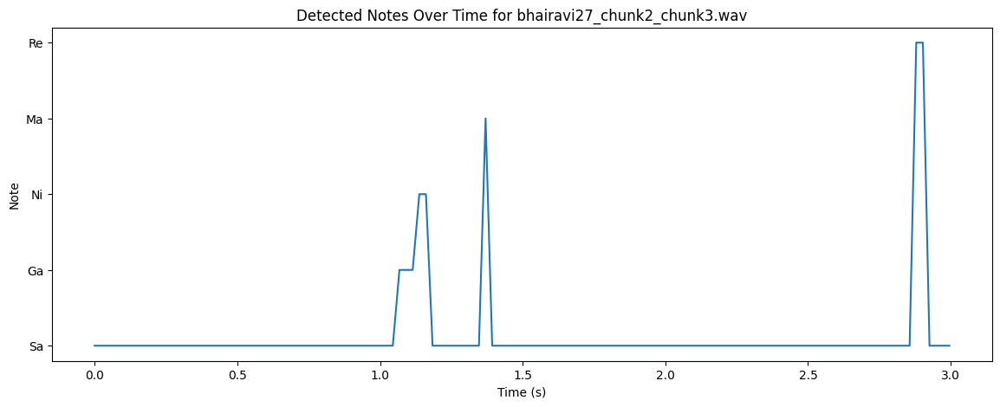

Tonic Frequency for bhairavi27_chunk2_chunk4.wav: 858.0488891601562 Hz
Detected Notes for bhairavi27_chunk2_chunk4.wav:  ['Ga', 'Ga', 'Ga', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni']


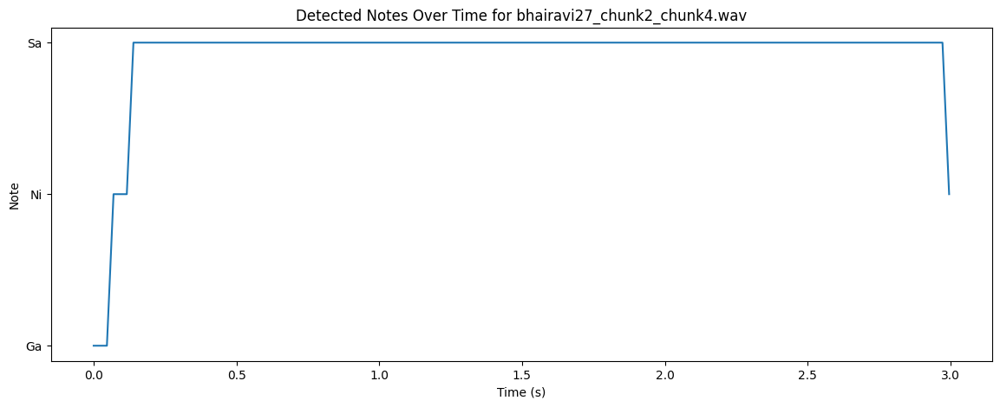

Tonic Frequency for bhairavi27_chunk2_chunk5.wav: 1904.5711669921875 Hz
Detected Notes for bhairavi27_chunk2_chunk5.wav:  ['Ga', 'Ga', 'Ni', 'Ni', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


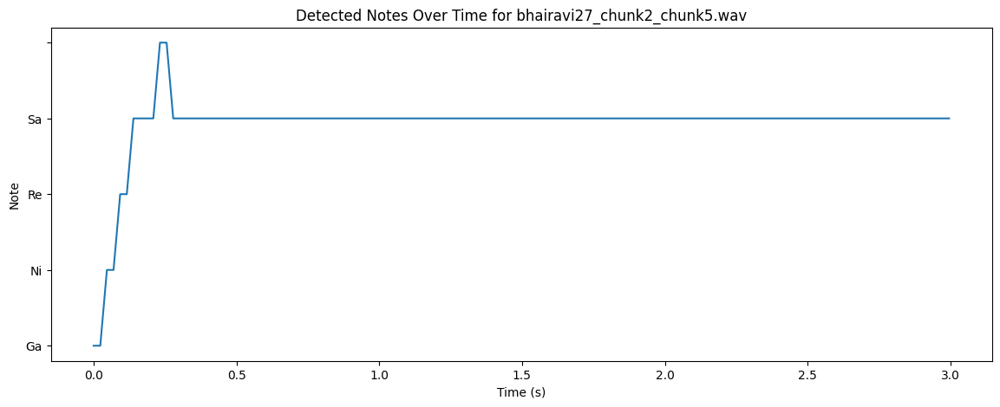

Tonic Frequency for bhairavi27_chunk2_chunk6.wav: 2172.64892578125 Hz
Detected Notes for bhairavi27_chunk2_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Dha', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Re', 'Re', 'Re', 'Re', 'Dha', 'Sa', 'Paa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


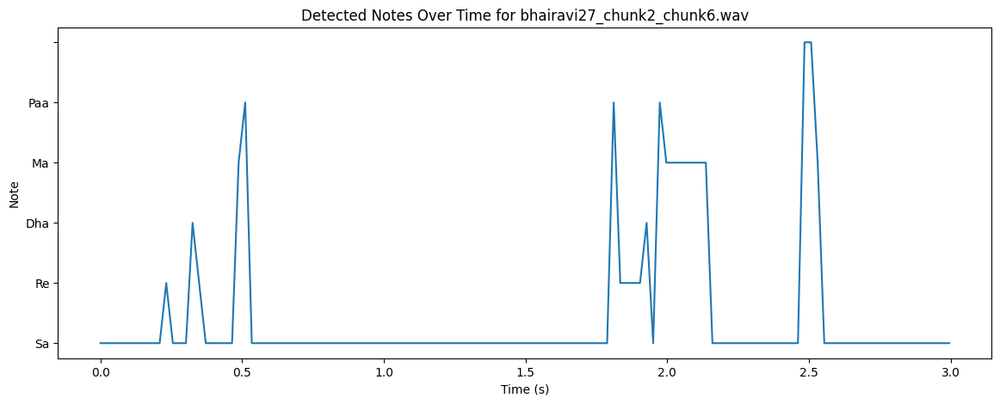

Tonic Frequency for bhairavi27_chunk2_chunk7.wav: 752.0780639648438 Hz
Detected Notes for bhairavi27_chunk2_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


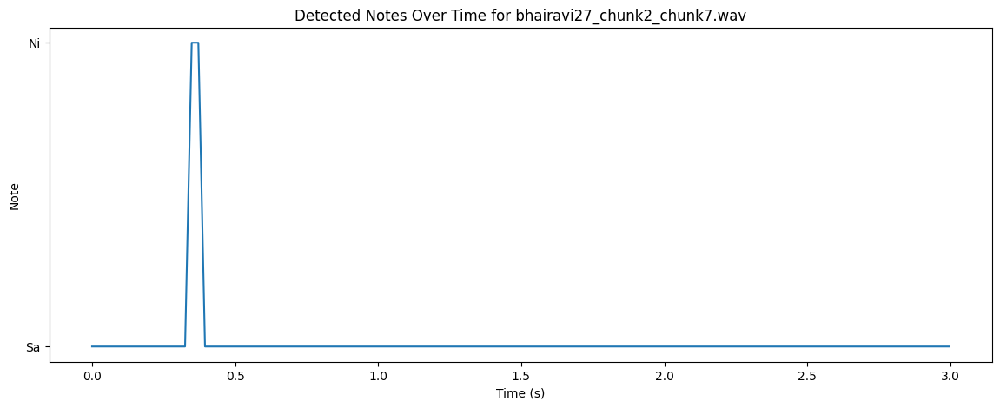

Tonic Frequency for bhairavi27_chunk2_chunk8.wav: 580.7890014648438 Hz
Detected Notes for bhairavi27_chunk2_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


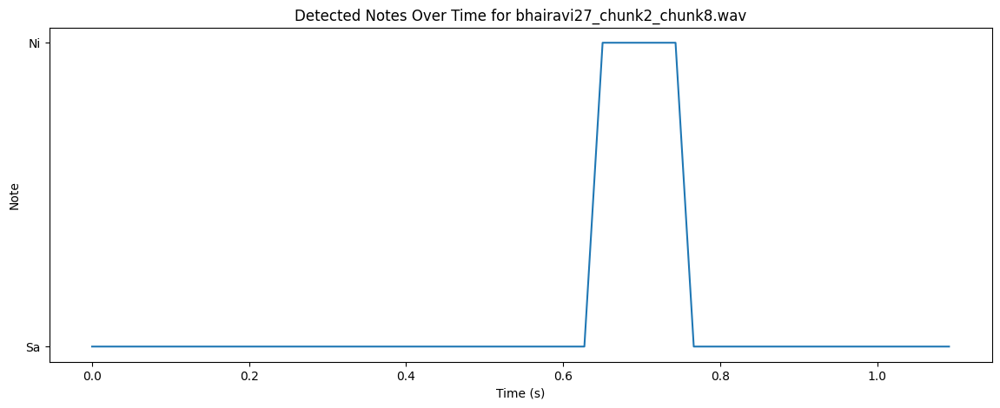

Tonic Frequency for bhairavi28_chunk1_chunk1.wav: 828.620849609375 Hz
Detected Notes for bhairavi28_chunk1_chunk1.wav:  ['Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa']


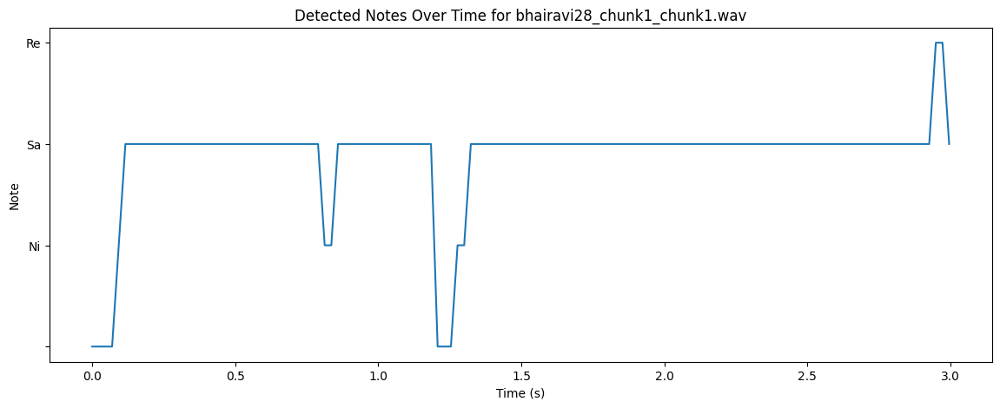

Tonic Frequency for bhairavi28_chunk1_chunk2.wav: 1413.91796875 Hz
Detected Notes for bhairavi28_chunk1_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Ni', 'Paa', 'Sa', 'Sa', 'Sa', 'Re', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


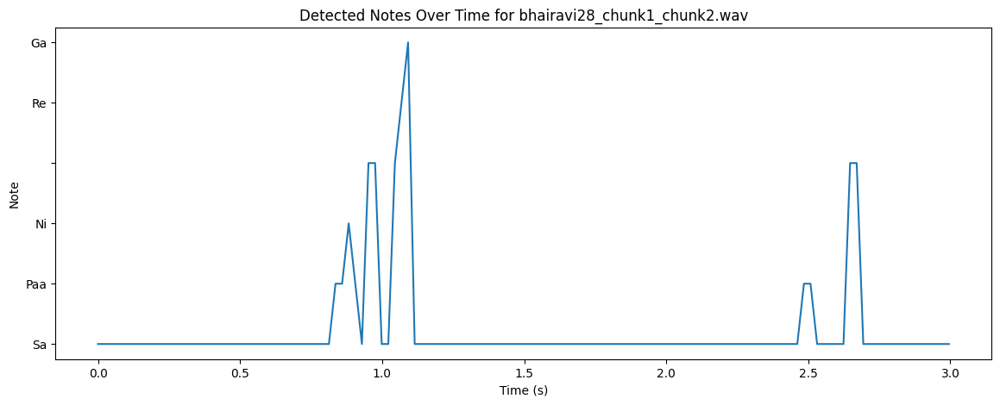

Tonic Frequency for bhairavi28_chunk1_chunk3.wav: 1876.5777587890625 Hz
Detected Notes for bhairavi28_chunk1_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


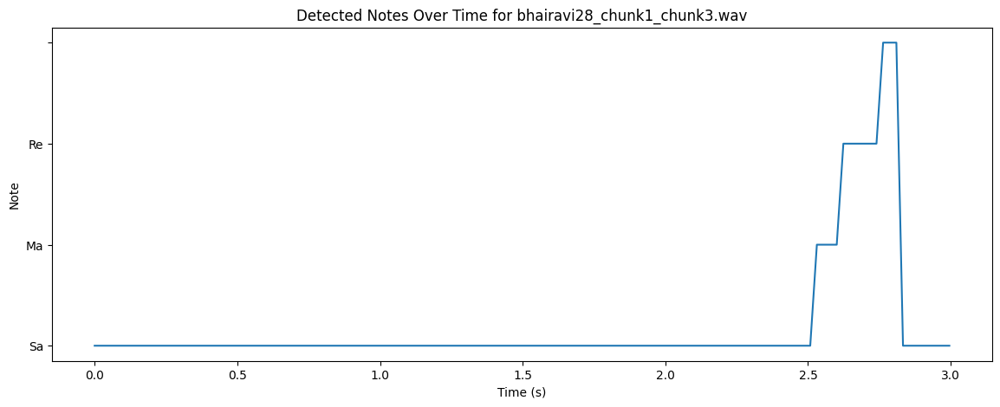

Tonic Frequency for bhairavi28_chunk1_chunk4.wav: 1959.451171875 Hz
Detected Notes for bhairavi28_chunk1_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa']


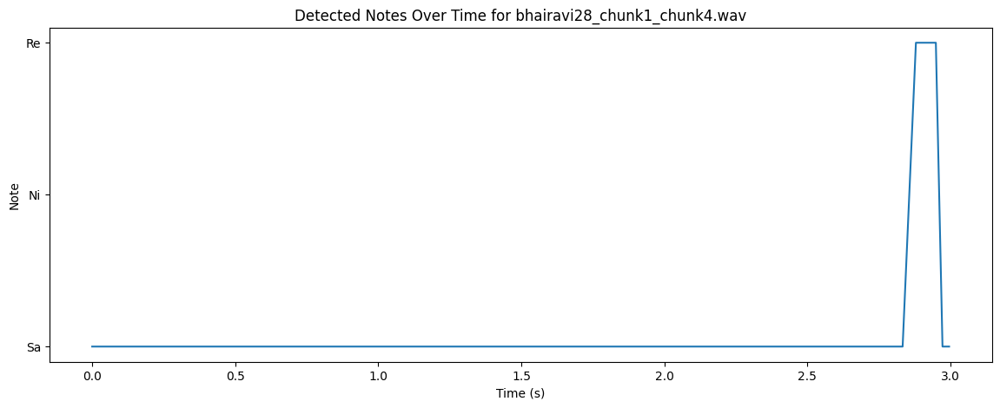

Tonic Frequency for bhairavi28_chunk1_chunk5.wav: 2133.766357421875 Hz
Detected Notes for bhairavi28_chunk1_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Re', 'Ga', 'Re', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


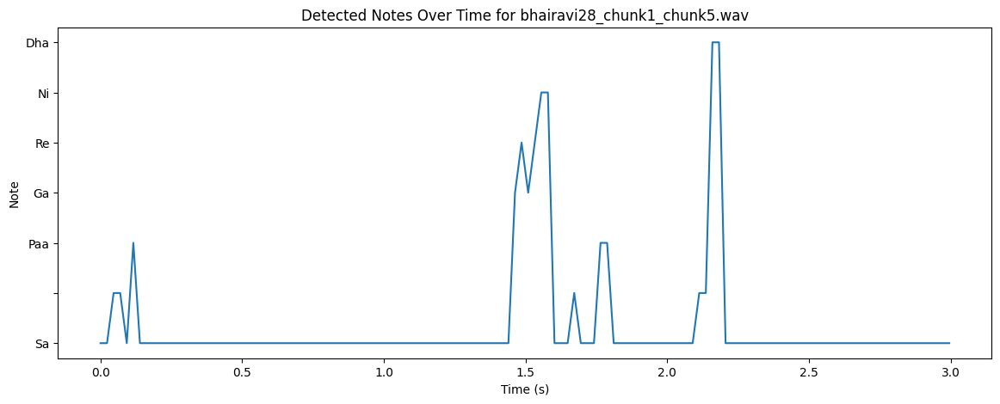

Tonic Frequency for bhairavi28_chunk1_chunk6.wav: 1731.158935546875 Hz
Detected Notes for bhairavi28_chunk1_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ma', 'Ma', 'Ma', 'Ga', 'Ga', 'Ga', 'Ni', 'Ni', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


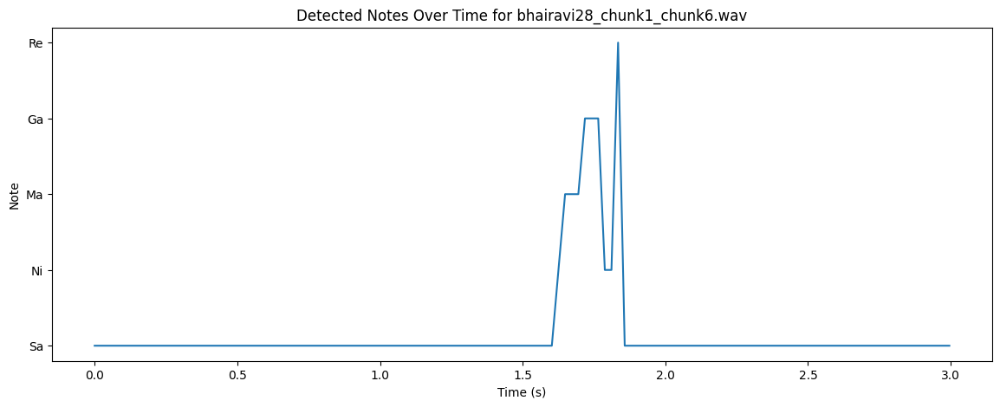

Tonic Frequency for bhairavi28_chunk1_chunk7.wav: 2120.398193359375 Hz
Detected Notes for bhairavi28_chunk1_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


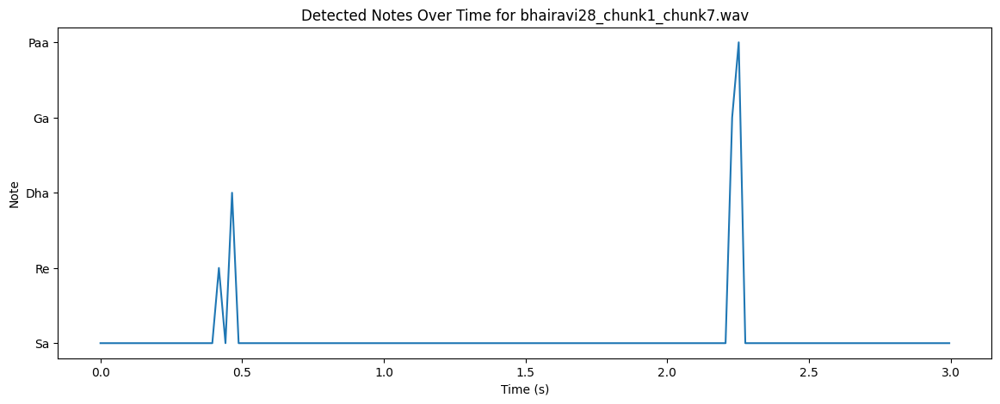

Tonic Frequency for bhairavi28_chunk1_chunk8.wav: 2120.286865234375 Hz
Detected Notes for bhairavi28_chunk1_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


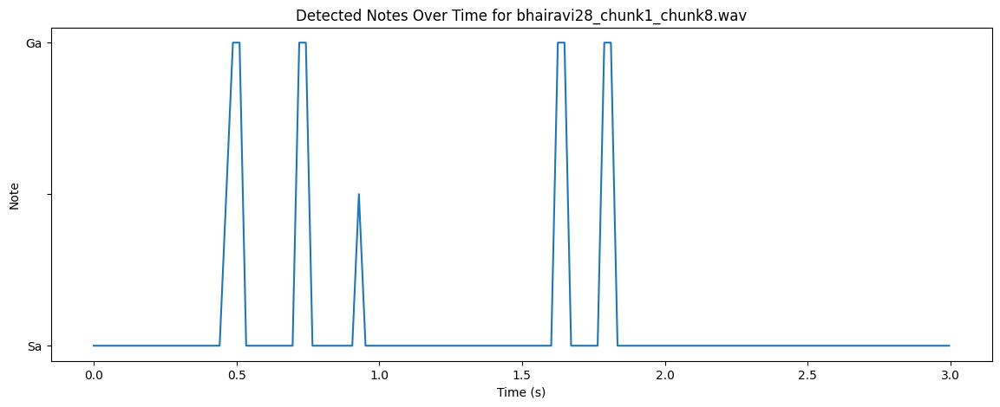

Tonic Frequency for bhairavi28_chunk1_chunk9.wav: 1869.373046875 Hz
Detected Notes for bhairavi28_chunk1_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ni', 'Ni', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa']


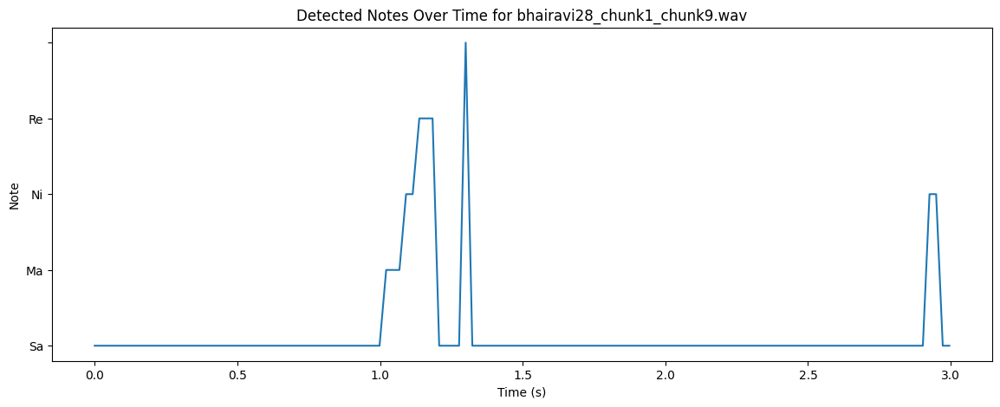

Tonic Frequency for bhairavi28_chunk1_chunk10.wav: 2297.650390625 Hz
Detected Notes for bhairavi28_chunk1_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Paa', 'Paa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


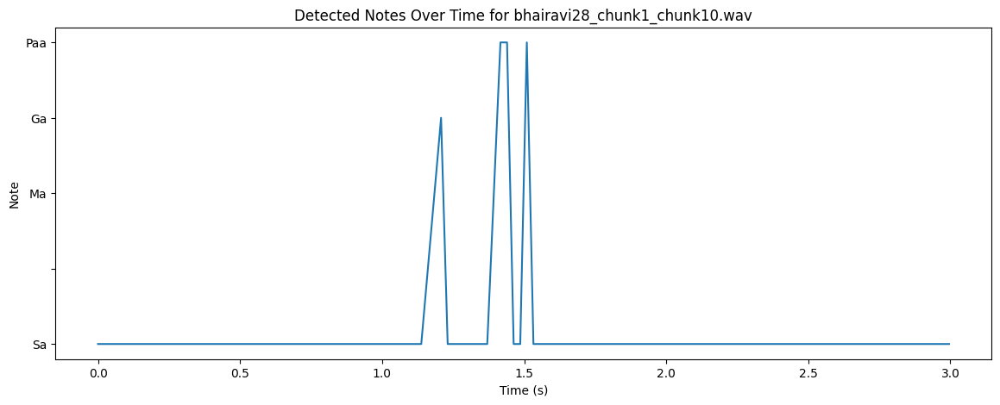

Tonic Frequency for bhairavi28_chunk2_chunk1.wav: 1576.8055419921875 Hz
Detected Notes for bhairavi28_chunk2_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Ni', 'Ma', 'Ni', 'Re', 'Re', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


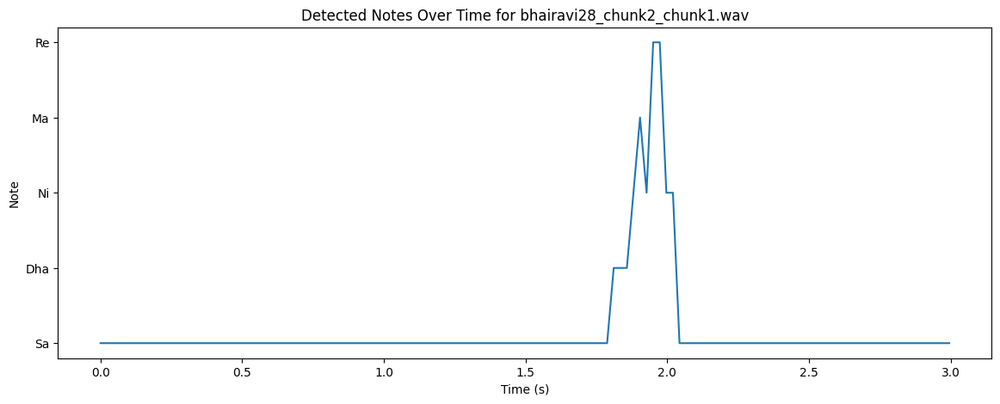

Tonic Frequency for bhairavi28_chunk2_chunk2.wav: 1766.809814453125 Hz
Detected Notes for bhairavi28_chunk2_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Paa', 'Paa', 'Ga', 'Ga', 'Ni', 'Ni', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


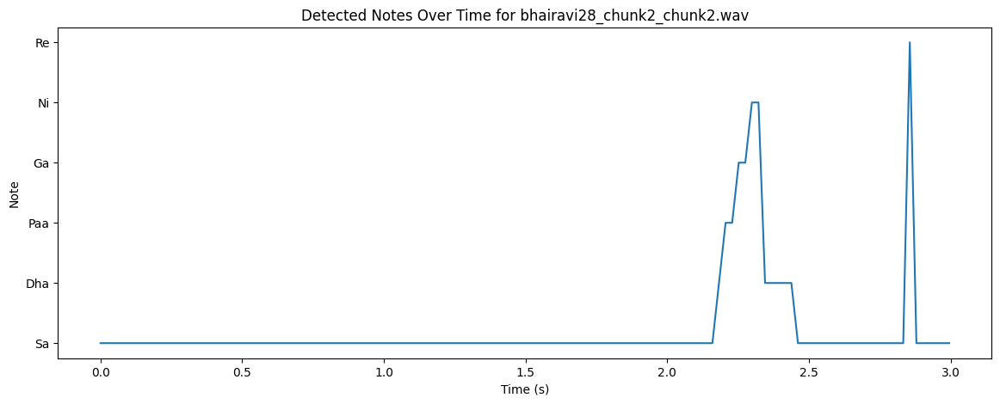

Tonic Frequency for bhairavi28_chunk2_chunk3.wav: 1970.5653076171875 Hz
Detected Notes for bhairavi28_chunk2_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Re', 'Dha', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


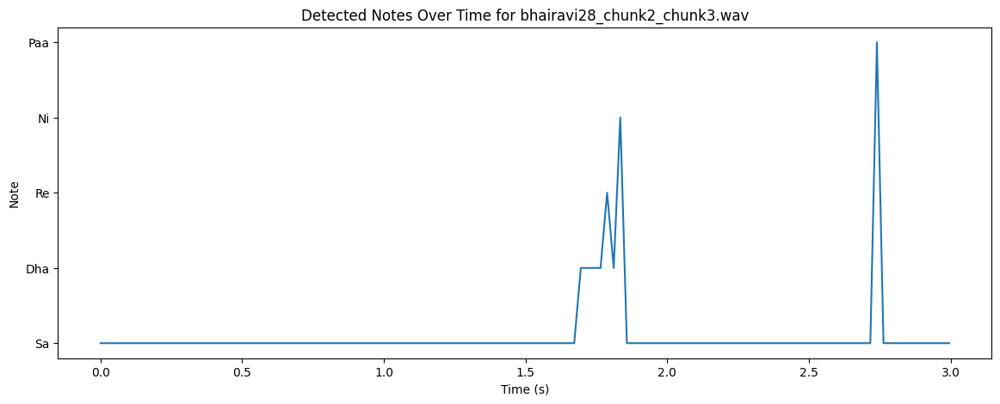

Tonic Frequency for bhairavi28_chunk2_chunk4.wav: 1996.5869140625 Hz
Detected Notes for bhairavi28_chunk2_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Ni', 'Ni', 'Ni', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


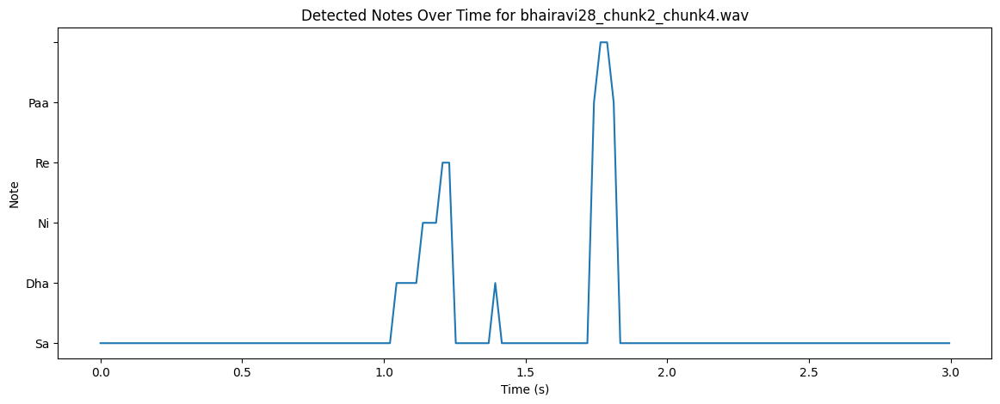

Tonic Frequency for bhairavi28_chunk2_chunk5.wav: 1783.610107421875 Hz
Detected Notes for bhairavi28_chunk2_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Paa', 'Paa', 'Ga', 'Ga', 'Ga', 'Ga', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


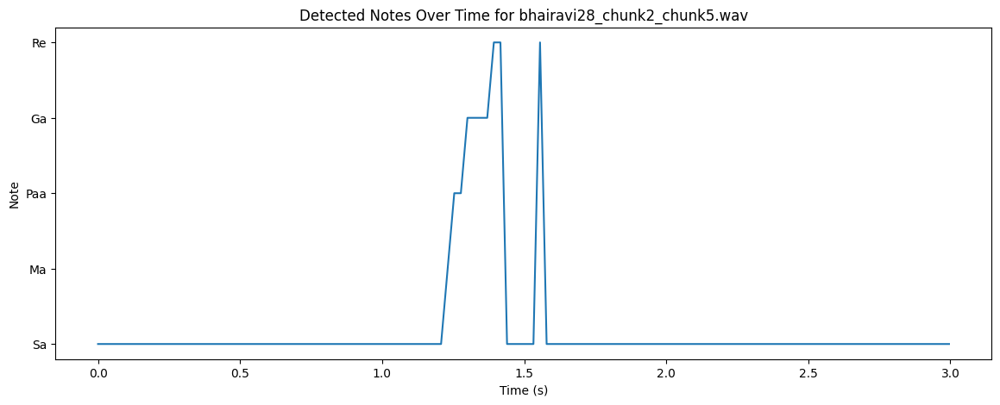

Tonic Frequency for bhairavi28_chunk2_chunk6.wav: 992.0394287109375 Hz
Detected Notes for bhairavi28_chunk2_chunk6.wav:  ['Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


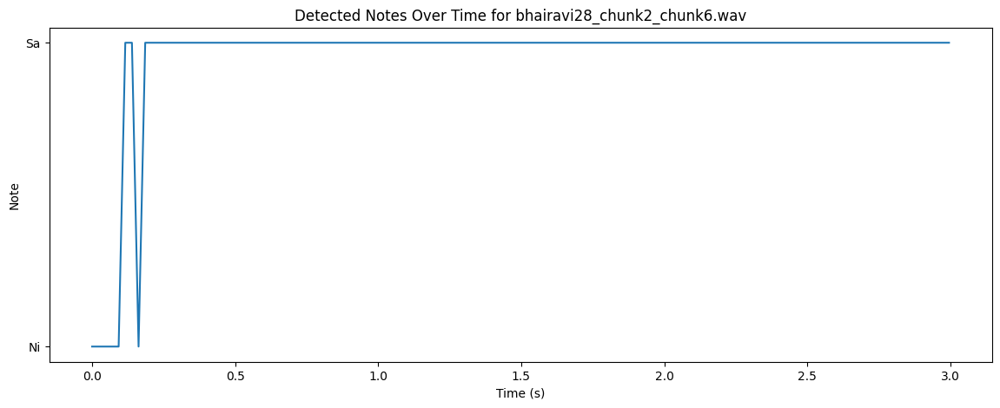

Tonic Frequency for bhairavi28_chunk2_chunk7.wav: 1843.9603271484375 Hz
Detected Notes for bhairavi28_chunk2_chunk7.wav:  ['Sa', 'Sa', 'Ni', 'Ga', 'Ga', 'Dha', 'Re', 'Sa', 'Paa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


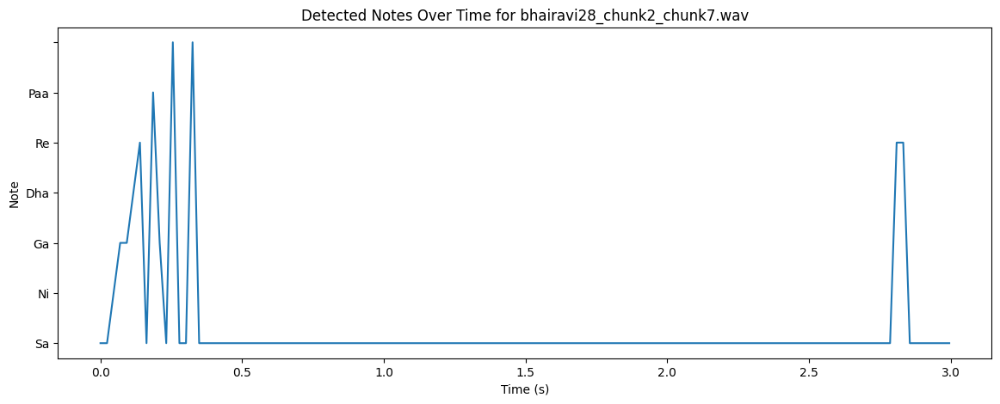

Tonic Frequency for bhairavi28_chunk2_chunk8.wav: 2122.7646484375 Hz
Detected Notes for bhairavi28_chunk2_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Ga', 'Ni', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Ni', 'Ni', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


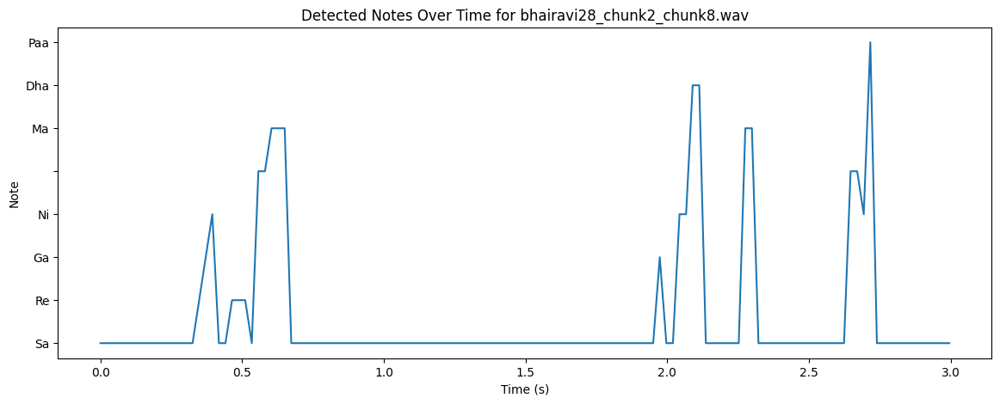

Tonic Frequency for bhairavi28_chunk2_chunk9.wav: 847.0029296875 Hz
Detected Notes for bhairavi28_chunk2_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


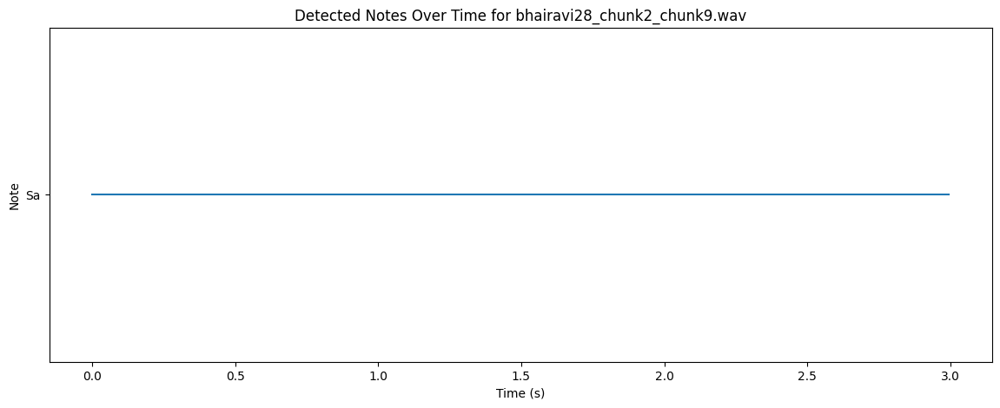

Tonic Frequency for bhairavi28_chunk2_chunk10.wav: 441.88922119140625 Hz
Detected Notes for bhairavi28_chunk2_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


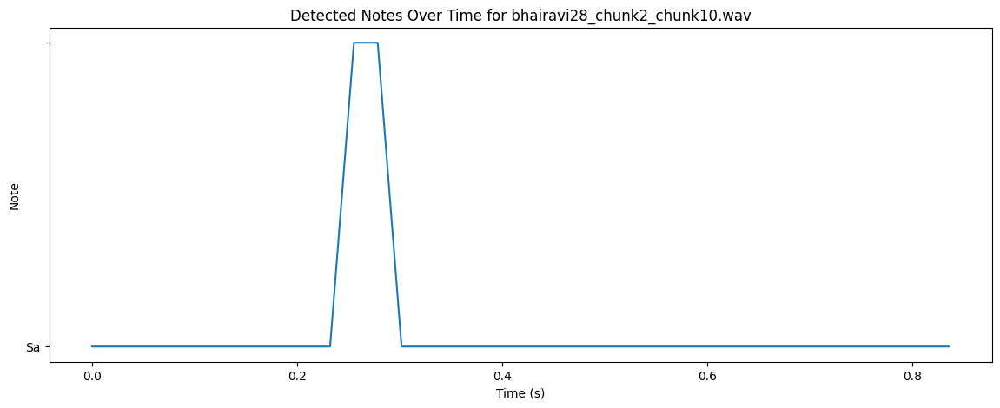

Tonic Frequency for bhairavi30_chunk1_chunk1.wav: 848.7330322265625 Hz
Detected Notes for bhairavi30_chunk1_chunk1.wav:  ['Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Dha', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


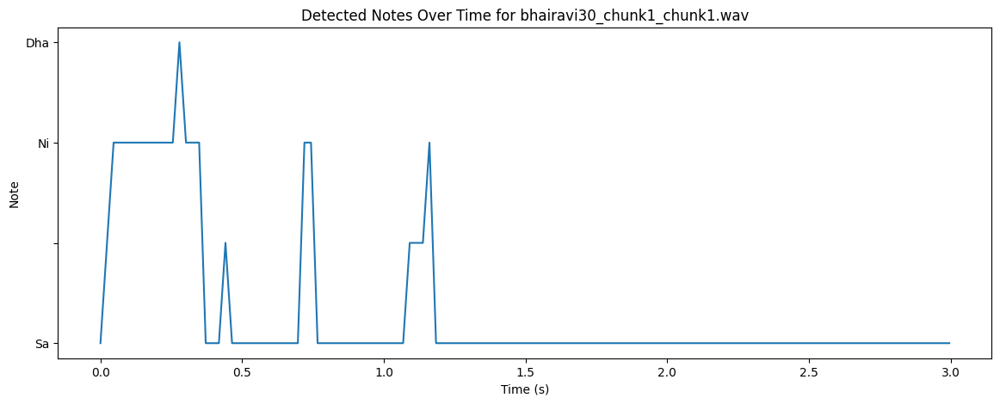

Tonic Frequency for bhairavi30_chunk1_chunk2.wav: 1384.550537109375 Hz
Detected Notes for bhairavi30_chunk1_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


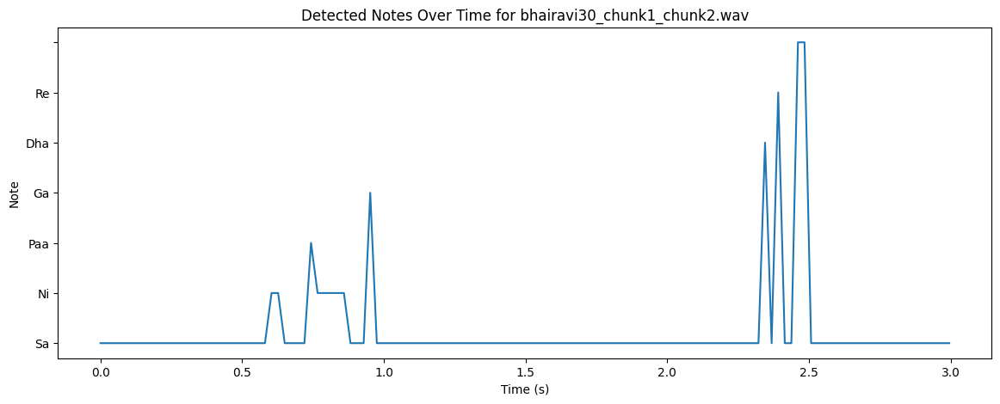

Tonic Frequency for bhairavi30_chunk1_chunk3.wav: 1521.677001953125 Hz
Detected Notes for bhairavi30_chunk1_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


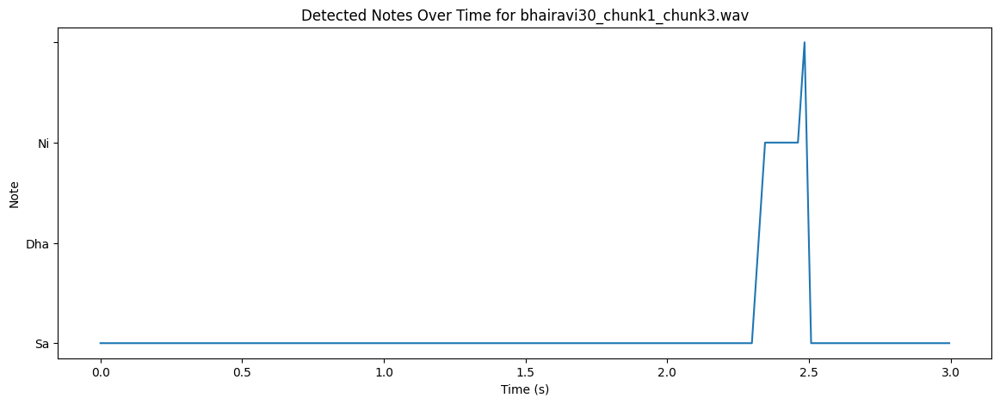

Tonic Frequency for bhairavi30_chunk1_chunk4.wav: 2101.079345703125 Hz
Detected Notes for bhairavi30_chunk1_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Re', 'Ga', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


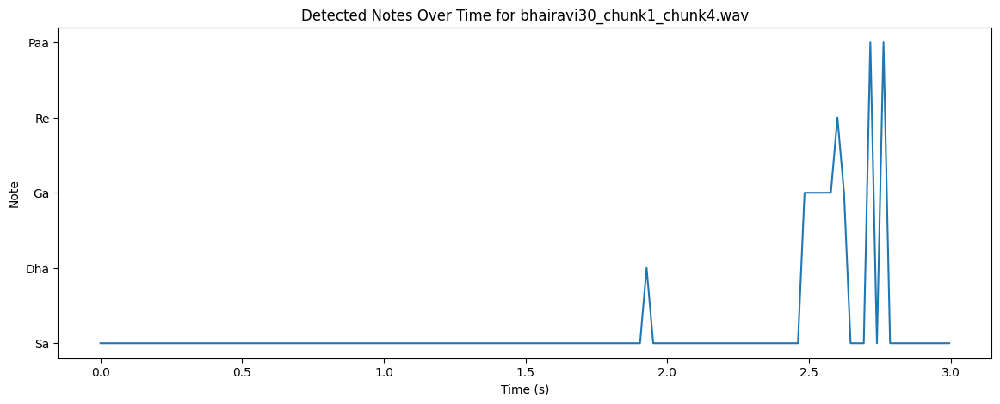

Tonic Frequency for bhairavi30_chunk1_chunk5.wav: 1743.1844482421875 Hz
Detected Notes for bhairavi30_chunk1_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Dha', 'Dha', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


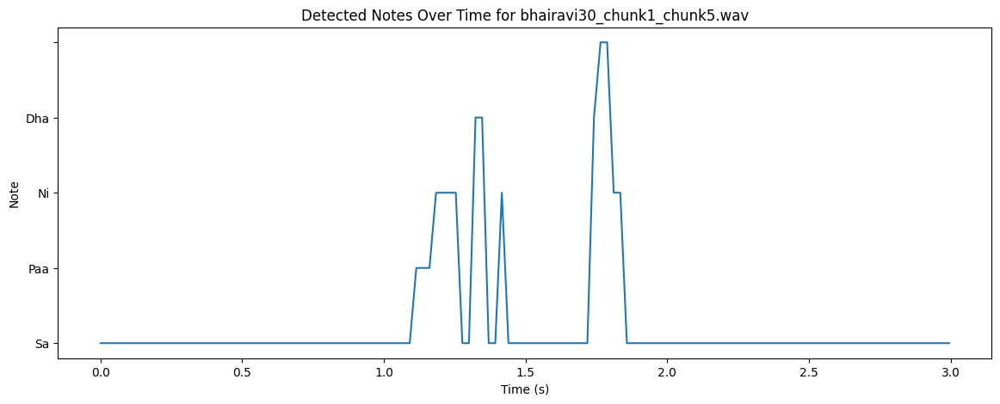

Tonic Frequency for bhairavi30_chunk1_chunk6.wav: 1461.778564453125 Hz
Detected Notes for bhairavi30_chunk1_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Paa', 'Ni']


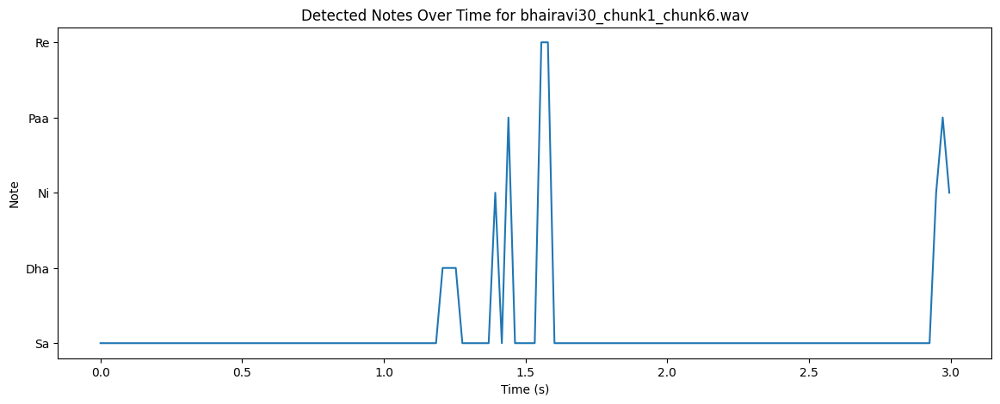

Tonic Frequency for bhairavi30_chunk1_chunk7.wav: 1809.1600341796875 Hz
Detected Notes for bhairavi30_chunk1_chunk7.wav:  ['Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni']


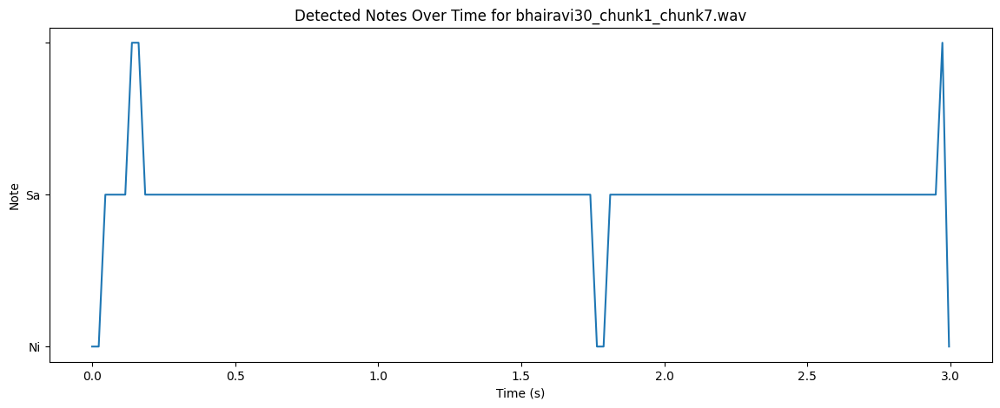

Tonic Frequency for bhairavi30_chunk1_chunk8.wav: 1405.6268310546875 Hz
Detected Notes for bhairavi30_chunk1_chunk8.wav:  ['Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Re', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


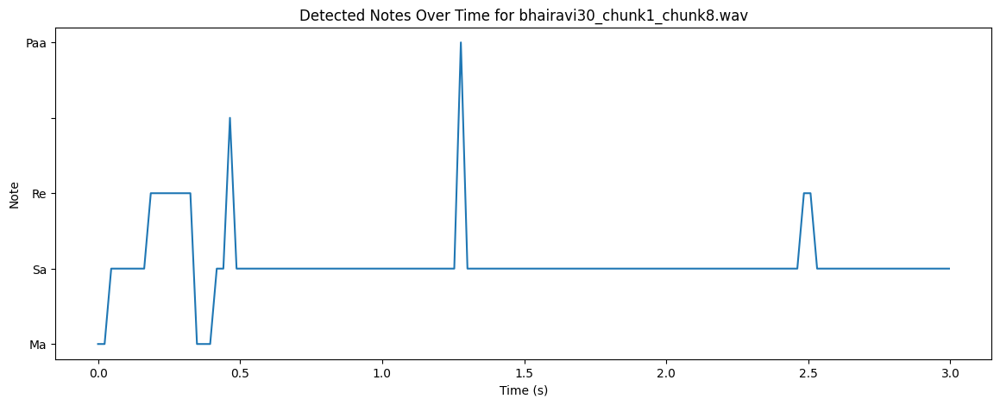

Tonic Frequency for bhairavi30_chunk1_chunk9.wav: 1470.6102294921875 Hz
Detected Notes for bhairavi30_chunk1_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Paa', 'Ni', 'Ma', 'Ni', 'Ga', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


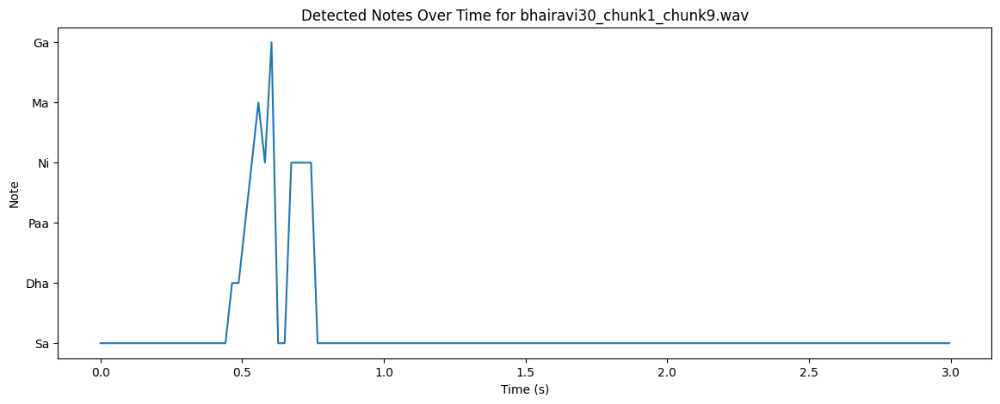

Tonic Frequency for bhairavi30_chunk1_chunk10.wav: 1839.228271484375 Hz
Detected Notes for bhairavi30_chunk1_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Re', 'Re', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


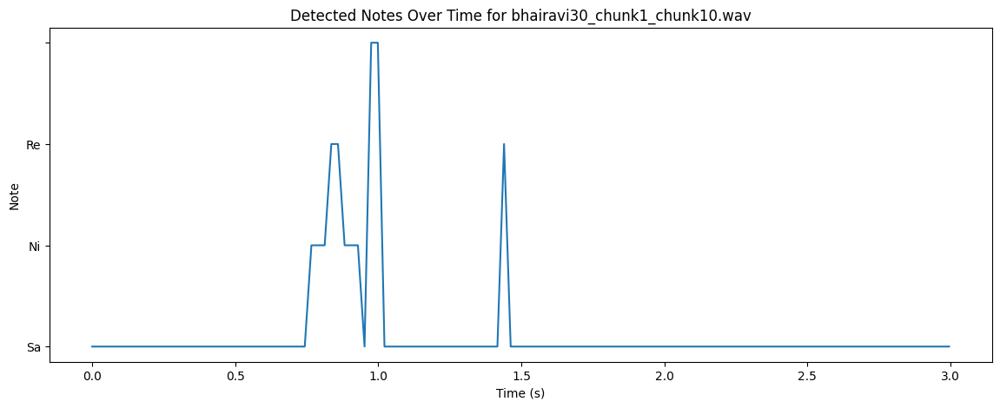

Tonic Frequency for bhairavi30_chunk2_chunk1.wav: 2348.109375 Hz
Detected Notes for bhairavi30_chunk2_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Dha', 'Re', 'Sa', 'Re', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa']


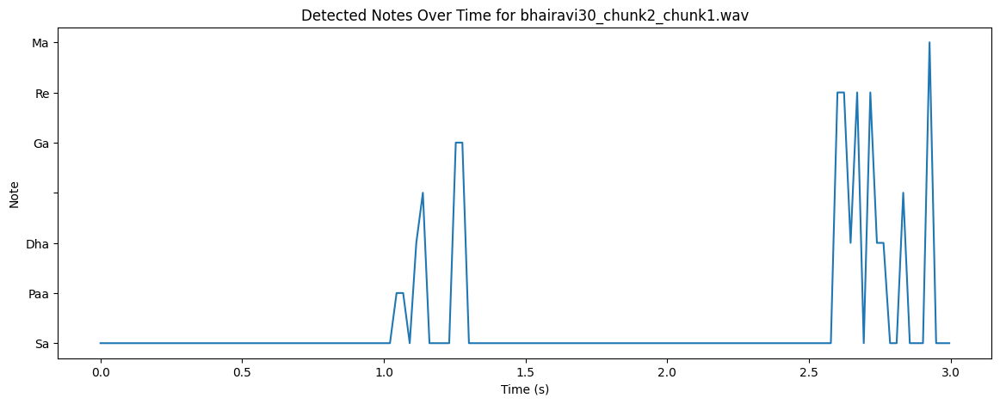

Tonic Frequency for bhairavi30_chunk2_chunk2.wav: 2028.41748046875 Hz
Detected Notes for bhairavi30_chunk2_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ma', 'Re', 'Re', 'Sa', 'Ni', 'Ni', 'Re', 'Sa', 'Sa', 'Sa', 'Sa']


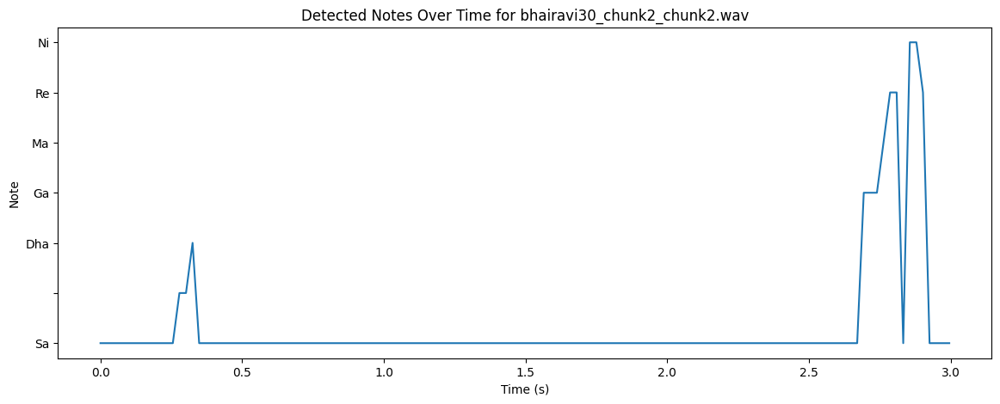

Tonic Frequency for bhairavi30_chunk2_chunk3.wav: 1257.1005859375 Hz
Detected Notes for bhairavi30_chunk2_chunk3.wav:  ['Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Dha', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


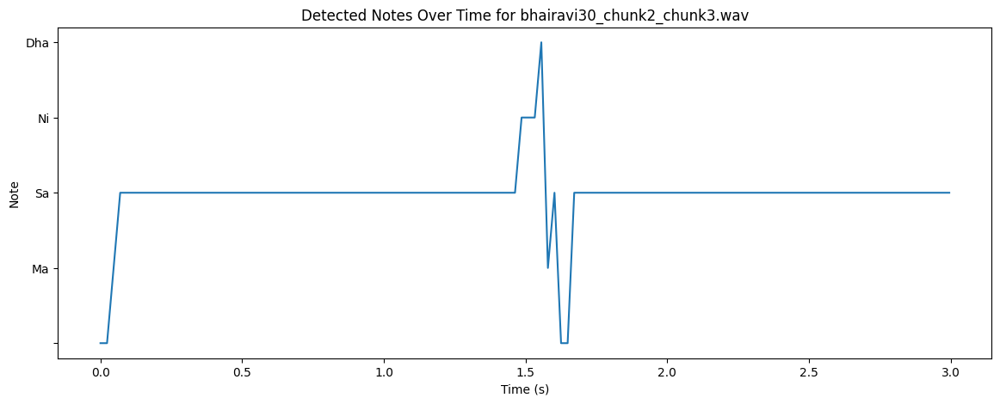

Tonic Frequency for bhairavi30_chunk2_chunk4.wav: 1769.3768310546875 Hz
Detected Notes for bhairavi30_chunk2_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Ni', 'Ma', 'Ga', 'Ma', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


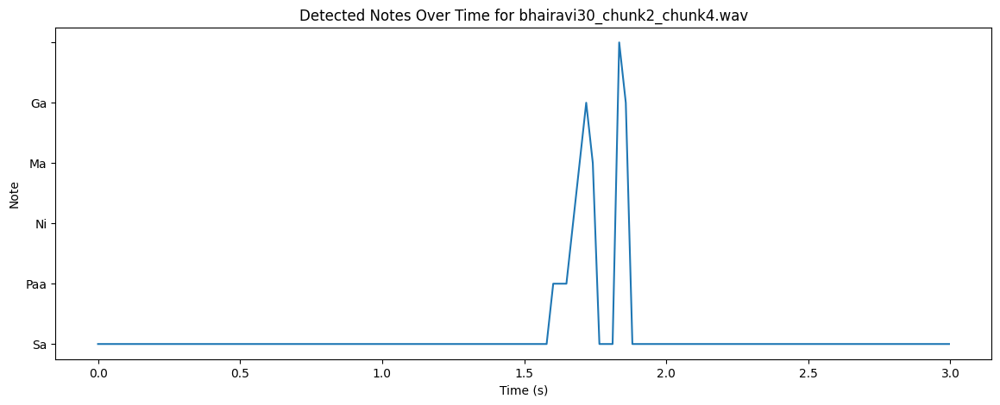

Tonic Frequency for bhairavi30_chunk2_chunk5.wav: 1994.2054443359375 Hz
Detected Notes for bhairavi30_chunk2_chunk5.wav:  ['Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Paa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


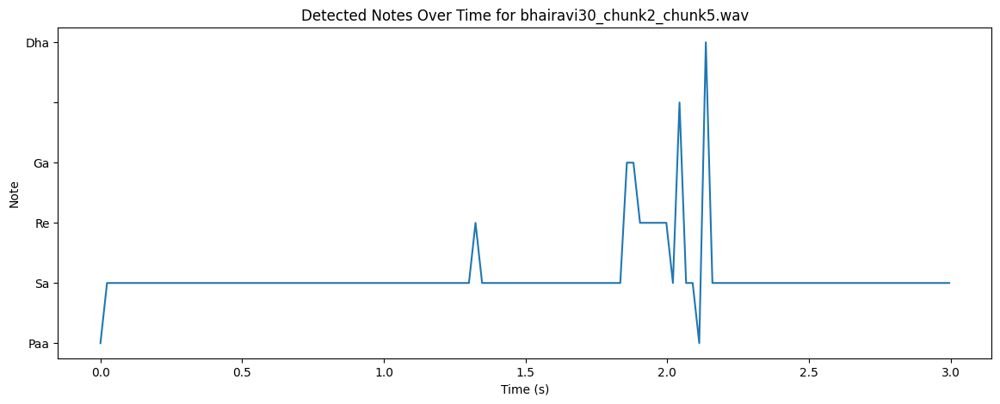

Tonic Frequency for bhairavi30_chunk2_chunk6.wav: 1105.429443359375 Hz
Detected Notes for bhairavi30_chunk2_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


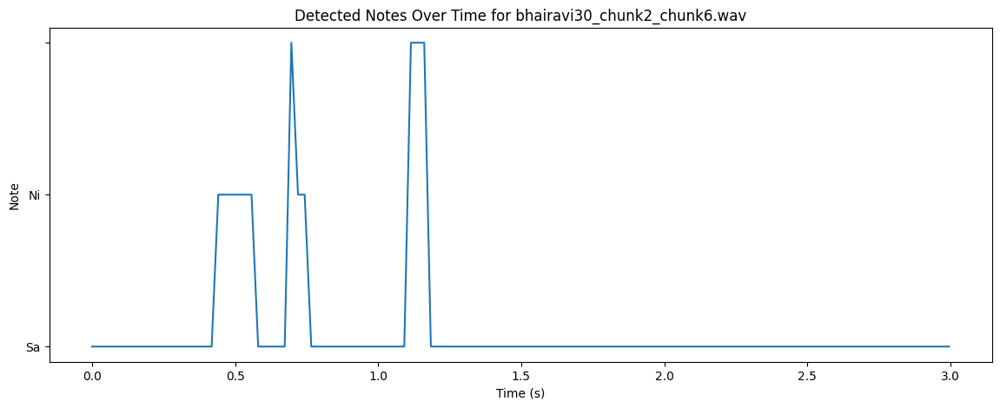

Tonic Frequency for bhairavi30_chunk2_chunk7.wav: 536.1561279296875 Hz
Detected Notes for bhairavi30_chunk2_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


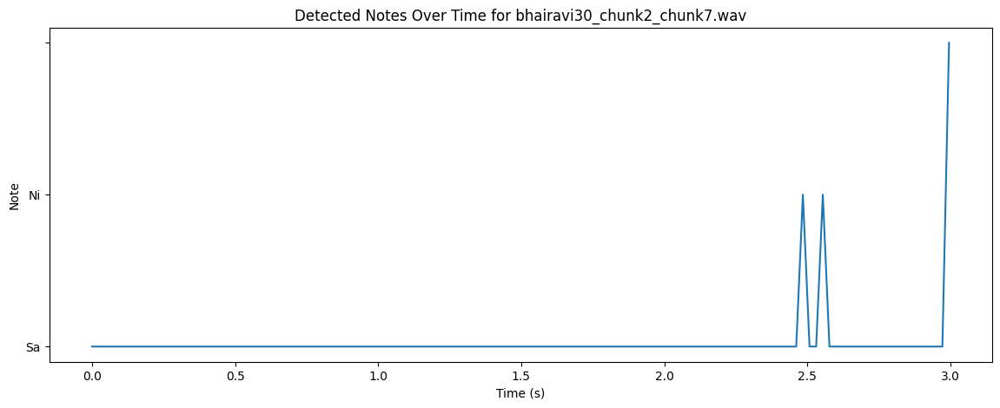

Tonic Frequency for bhairavi30_chunk2_chunk8.wav: 522.3873291015625 Hz
Detected Notes for bhairavi30_chunk2_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa']


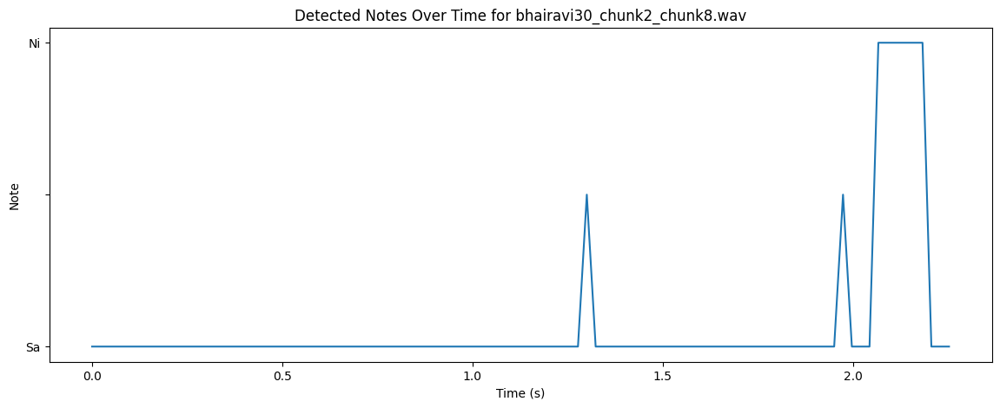

Tonic Frequency for bhairavi29_chunk1_chunk1.wav: 742.4886474609375 Hz
Detected Notes for bhairavi29_chunk1_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


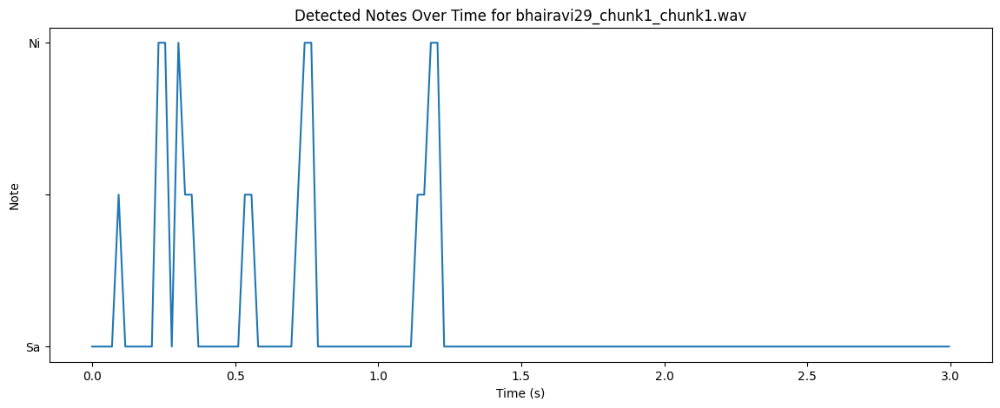

Tonic Frequency for bhairavi29_chunk1_chunk2.wav: 1601.63720703125 Hz
Detected Notes for bhairavi29_chunk1_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


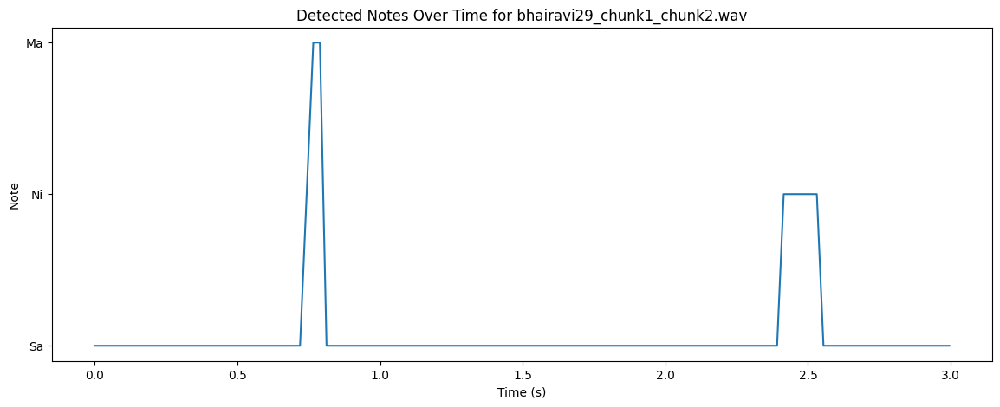

Tonic Frequency for bhairavi29_chunk1_chunk3.wav: 1519.71630859375 Hz
Detected Notes for bhairavi29_chunk1_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


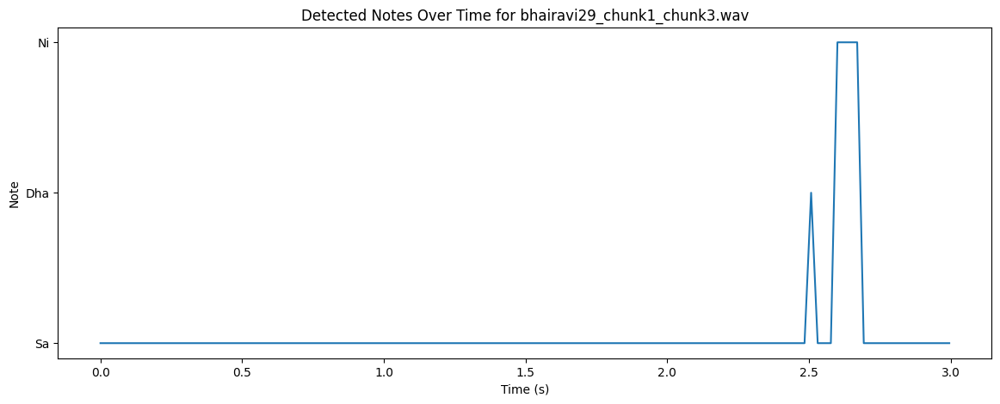

Tonic Frequency for bhairavi29_chunk1_chunk4.wav: 1808.7587890625 Hz
Detected Notes for bhairavi29_chunk1_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


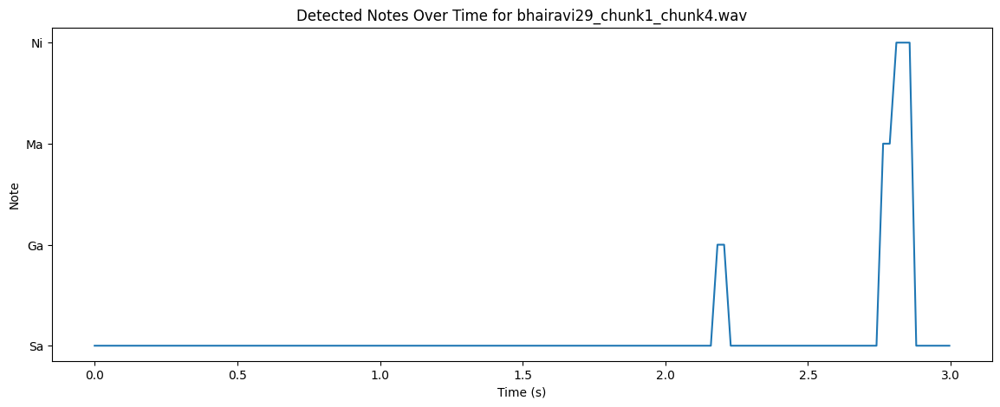

Tonic Frequency for bhairavi29_chunk1_chunk5.wav: 2025.422607421875 Hz
Detected Notes for bhairavi29_chunk1_chunk5.wav:  ['Ma', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ma', 'Dha', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


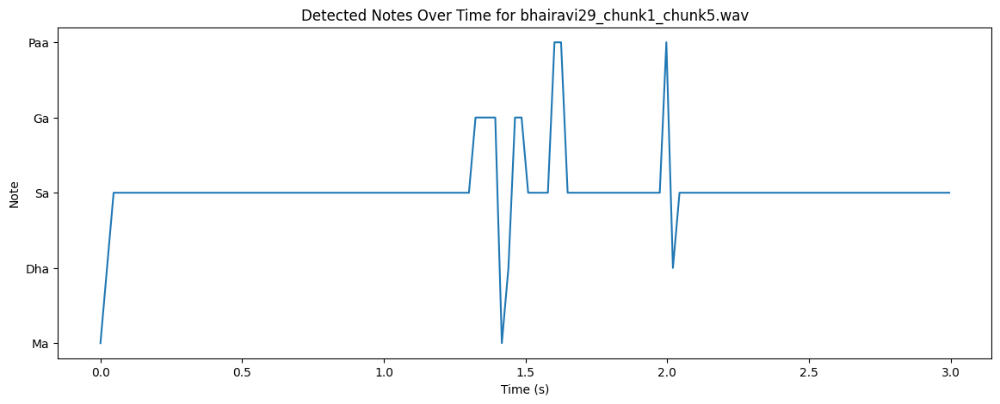

Tonic Frequency for bhairavi29_chunk1_chunk6.wav: 1763.7445068359375 Hz
Detected Notes for bhairavi29_chunk1_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Paa', 'Paa', 'Ni', 'Ni', 'Ni', 'Ga', 'Ga', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


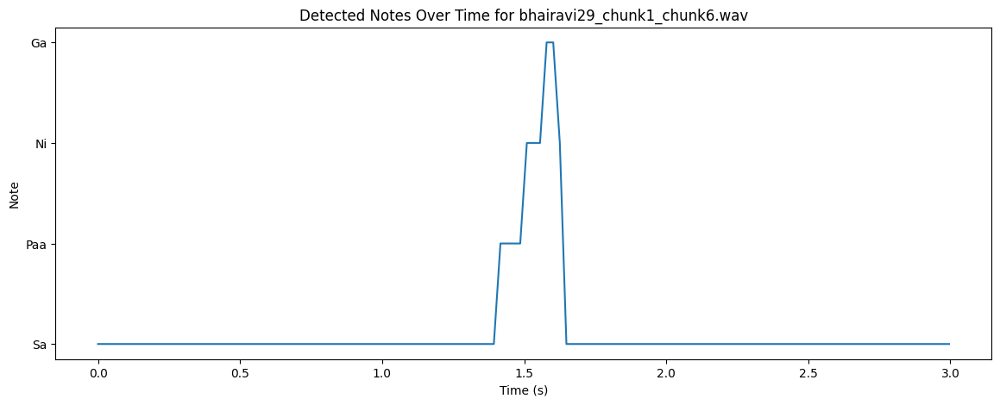

Tonic Frequency for bhairavi29_chunk1_chunk7.wav: 2113.4599609375 Hz
Detected Notes for bhairavi29_chunk1_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


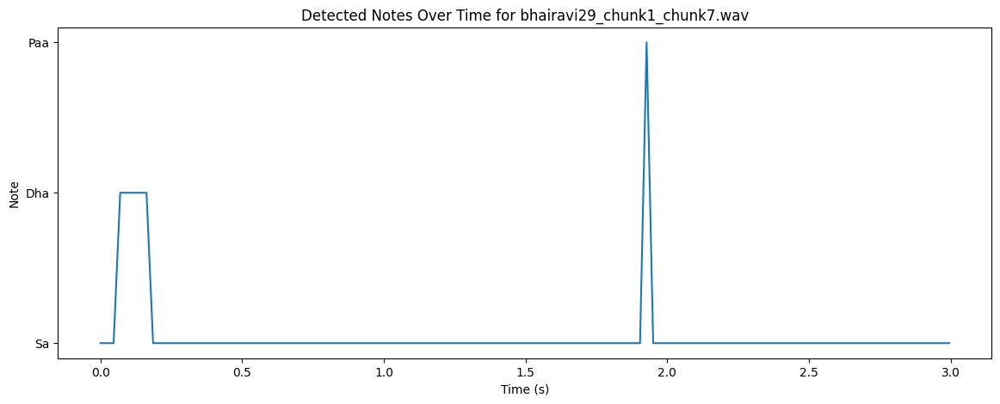

Tonic Frequency for bhairavi29_chunk1_chunk8.wav: 2064.794677734375 Hz
Detected Notes for bhairavi29_chunk1_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Re', 'Re', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


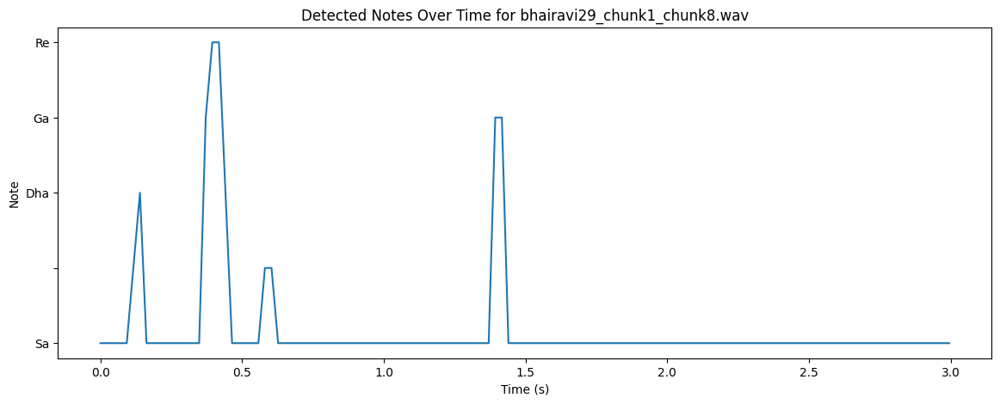

Tonic Frequency for bhairavi29_chunk1_chunk9.wav: 1840.193115234375 Hz
Detected Notes for bhairavi29_chunk1_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


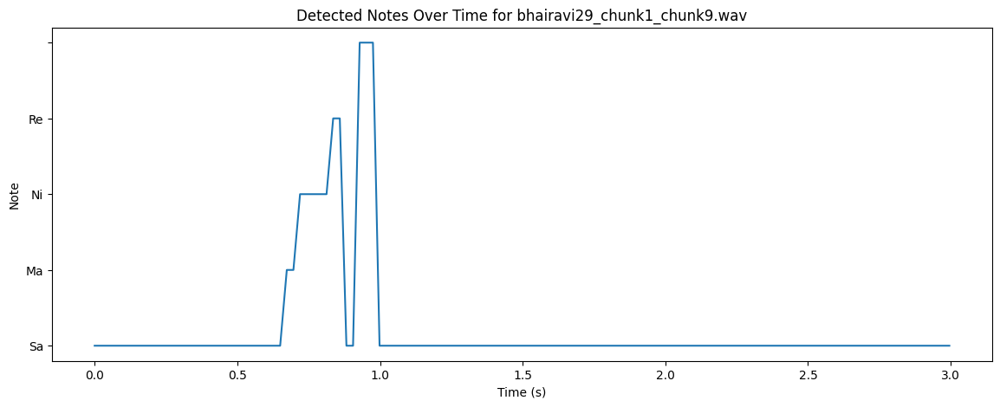

Tonic Frequency for bhairavi29_chunk1_chunk10.wav: 2280.498779296875 Hz
Detected Notes for bhairavi29_chunk1_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


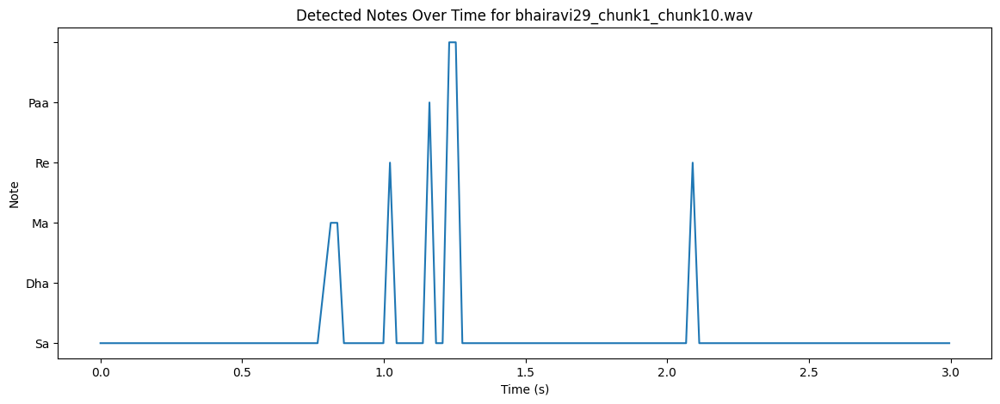

Tonic Frequency for bhairavi29_chunk2_chunk1.wav: 1487.283203125 Hz
Detected Notes for bhairavi29_chunk2_chunk1.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Dha', 'Dha', 'Ni', 'Ni', 'Ni', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


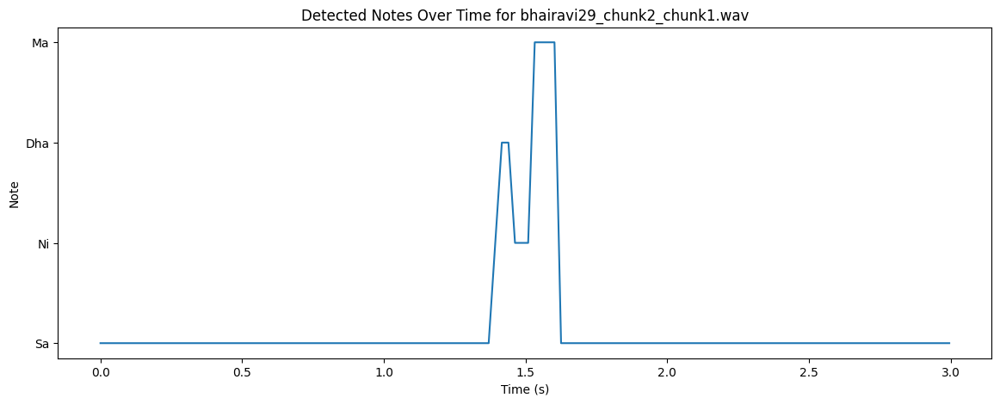

Tonic Frequency for bhairavi29_chunk2_chunk2.wav: 1875.6468505859375 Hz
Detected Notes for bhairavi29_chunk2_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Ma', 'Ma', 'Ga', 'Ni', 'Re', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


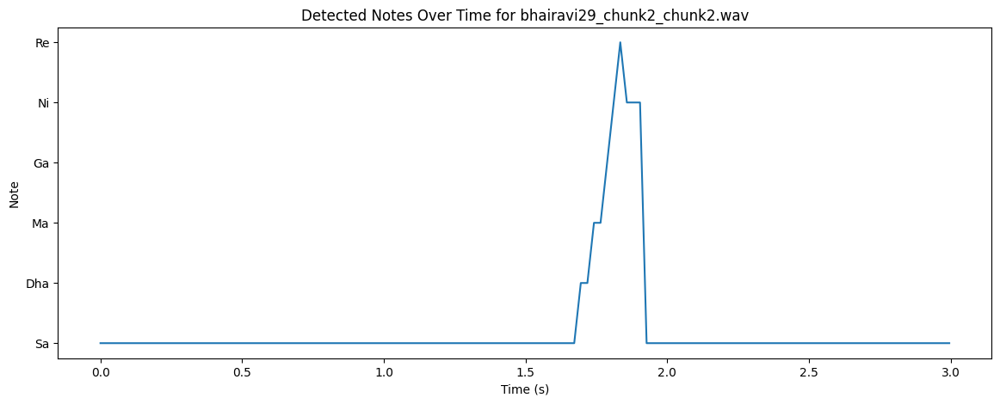

Tonic Frequency for bhairavi29_chunk2_chunk3.wav: 2349.74658203125 Hz
Detected Notes for bhairavi29_chunk2_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Dha', 'Paa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


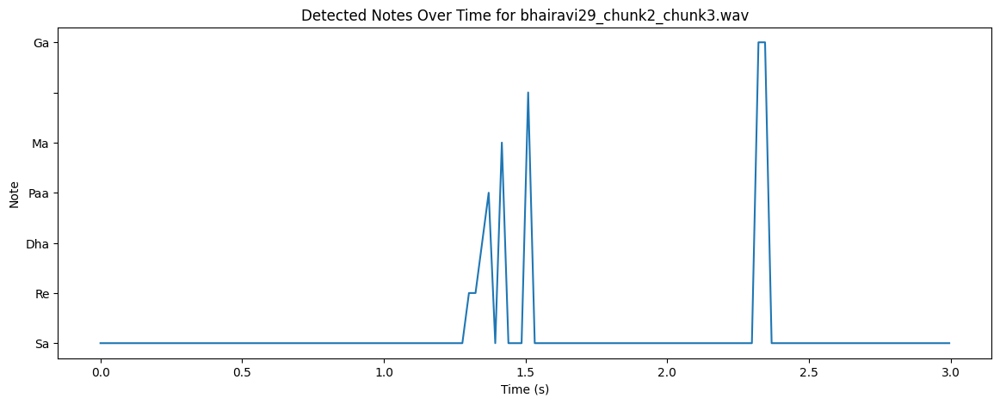

Tonic Frequency for bhairavi29_chunk2_chunk4.wav: 1905.05078125 Hz
Detected Notes for bhairavi29_chunk2_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ga', 'Ma', 'Ga', 'Dha', 'Ma', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


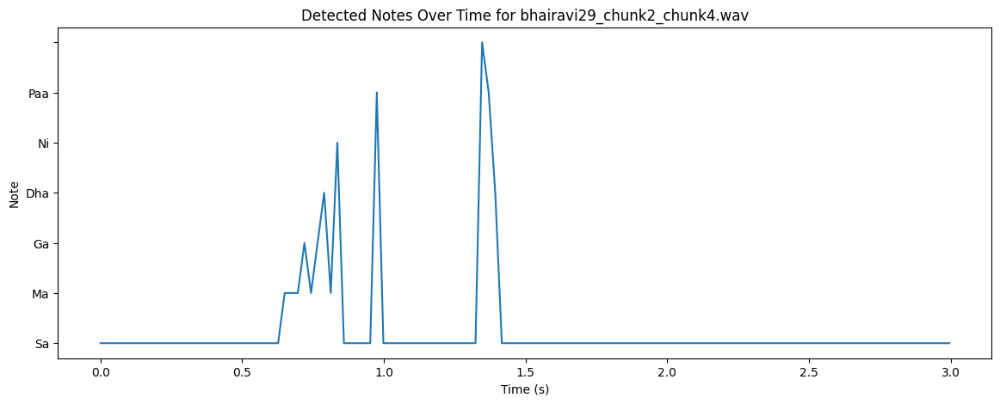

Tonic Frequency for bhairavi29_chunk2_chunk5.wav: 1786.211181640625 Hz
Detected Notes for bhairavi29_chunk2_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Paa', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


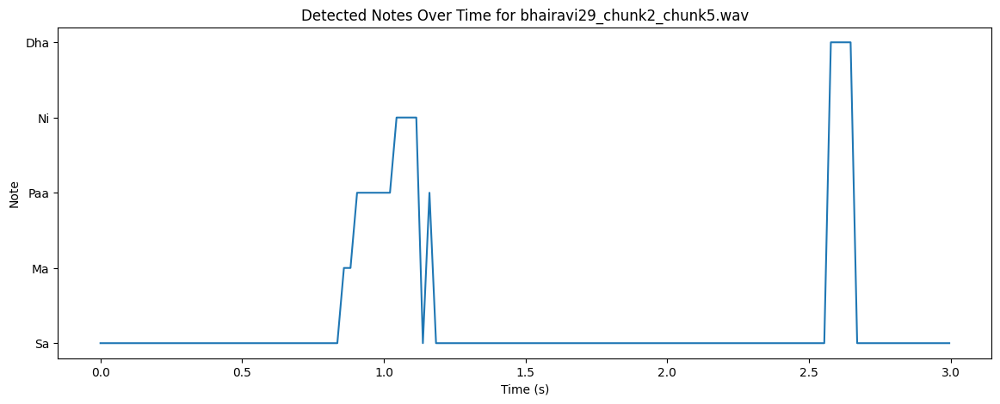

Tonic Frequency for bhairavi29_chunk2_chunk6.wav: 1767.058837890625 Hz
Detected Notes for bhairavi29_chunk2_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ga', 'Ni', 'Ni', 'Ga', 'Ga', 'Ga', 'Re', 'Sa', 'Sa']


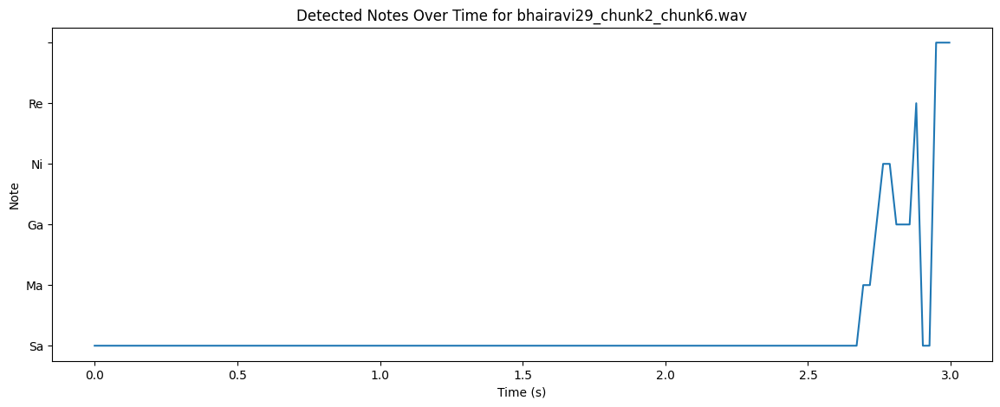

Tonic Frequency for bhairavi29_chunk2_chunk7.wav: 1687.897705078125 Hz
Detected Notes for bhairavi29_chunk2_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ma', 'Ma', 'Ma', 'Ma']


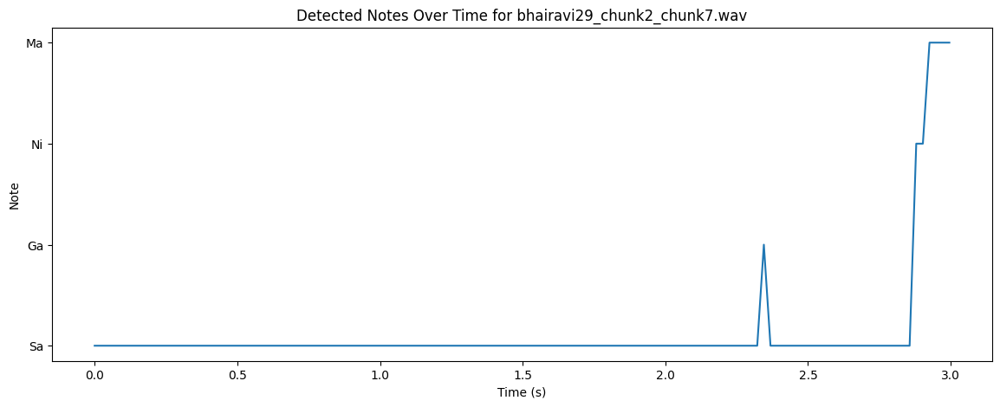

Tonic Frequency for bhairavi29_chunk2_chunk8.wav: 2178.738037109375 Hz
Detected Notes for bhairavi29_chunk2_chunk8.wav:  ['Re', 'Re', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Re', 'Dha', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


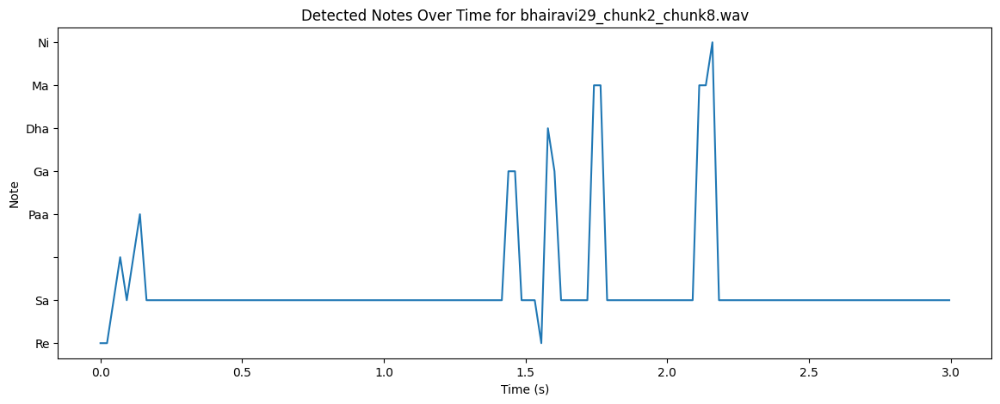

Tonic Frequency for bhairavi29_chunk2_chunk9.wav: 584.4766845703125 Hz
Detected Notes for bhairavi29_chunk2_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


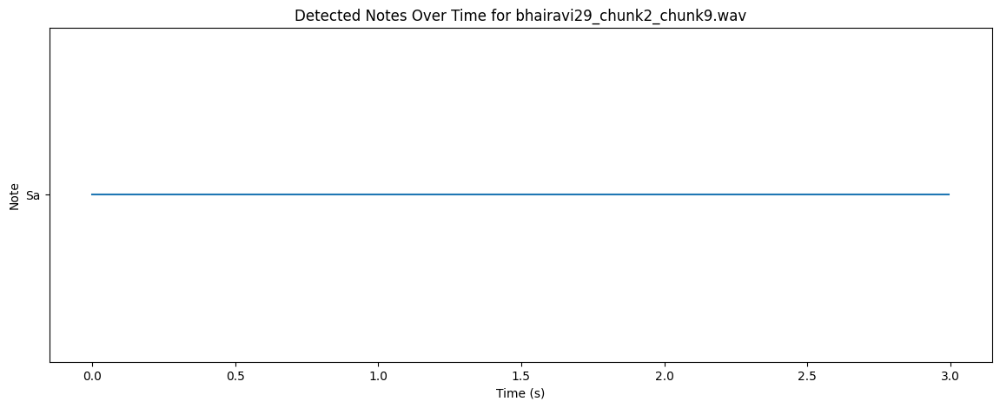

Tonic Frequency for bhairavi29_chunk2_chunk10.wav: 358.1605224609375 Hz
Detected Notes for bhairavi29_chunk2_chunk10.wav:  ['Sa', 'Sa', 'Sa']


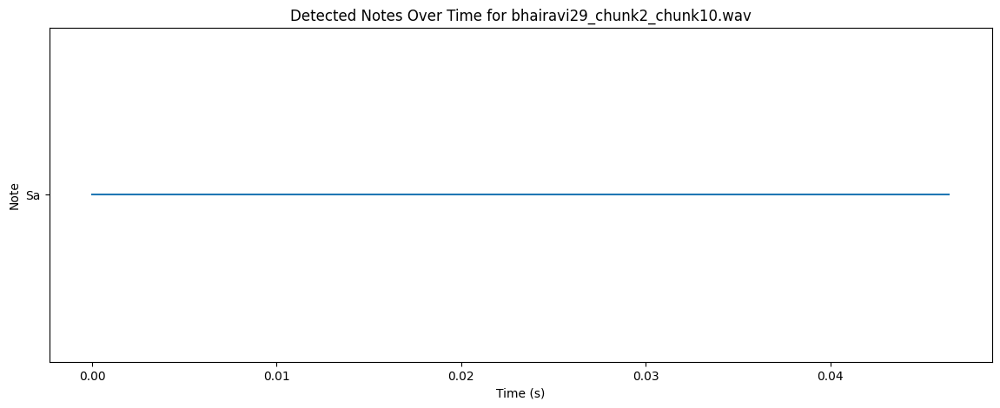

Tonic Frequency for bhairavi31_chunk1_chunk1.wav: 1462.445068359375 Hz
Detected Notes for bhairavi31_chunk1_chunk1.wav:  ['Sa', 'Sa', 'Ga', 'Ni', 'Sa', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


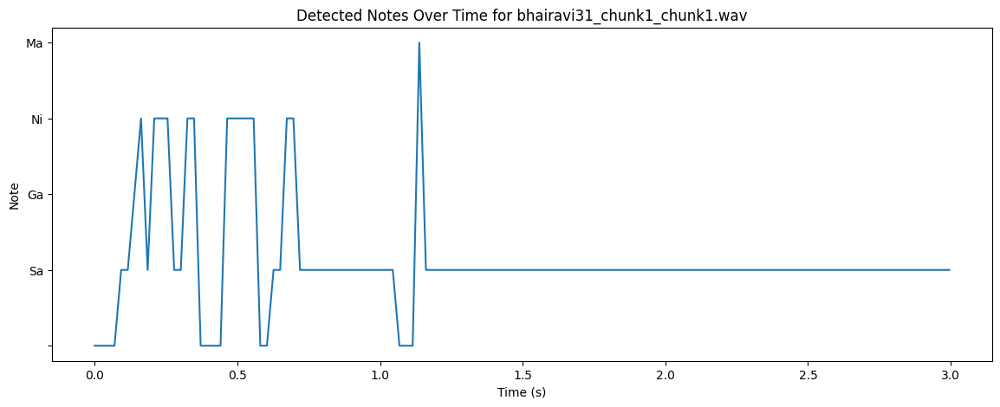

Tonic Frequency for bhairavi31_chunk1_chunk2.wav: 1911.8916015625 Hz
Detected Notes for bhairavi31_chunk1_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ma', 'Ni', 'Ni', 'Sa', 'Dha', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


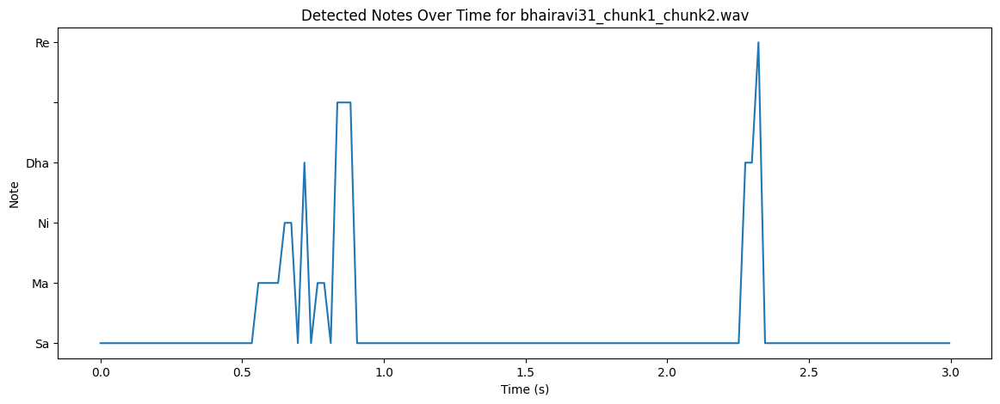

Tonic Frequency for bhairavi31_chunk1_chunk3.wav: 1808.132568359375 Hz
Detected Notes for bhairavi31_chunk1_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Dha', 'Dha', 'Dha', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


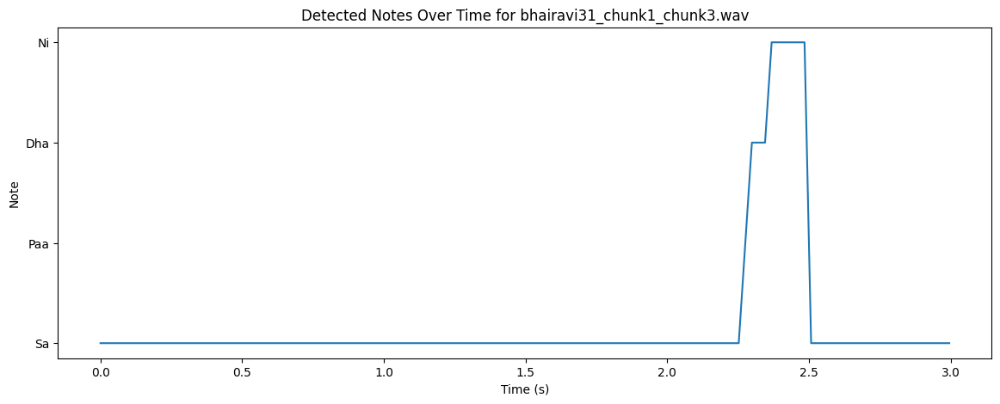

Tonic Frequency for bhairavi31_chunk1_chunk4.wav: 2248.667236328125 Hz
Detected Notes for bhairavi31_chunk1_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


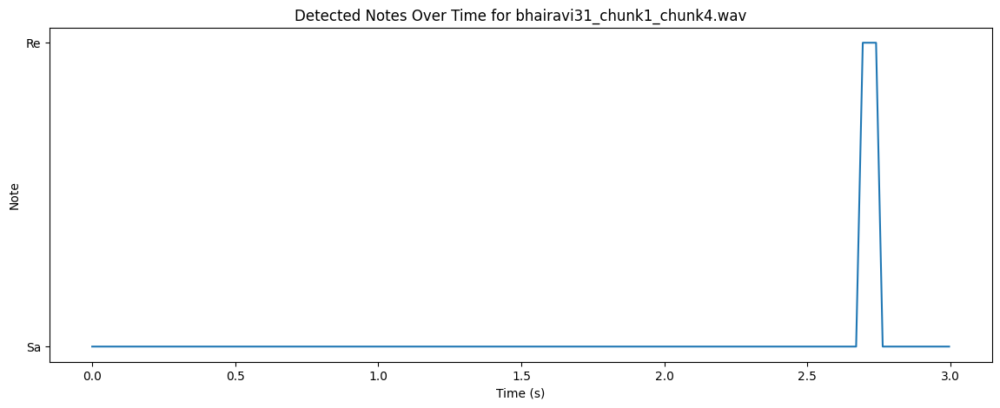

Tonic Frequency for bhairavi31_chunk1_chunk5.wav: 1978.3094482421875 Hz
Detected Notes for bhairavi31_chunk1_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Ni', 'Dha', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Dha', 'Dha', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


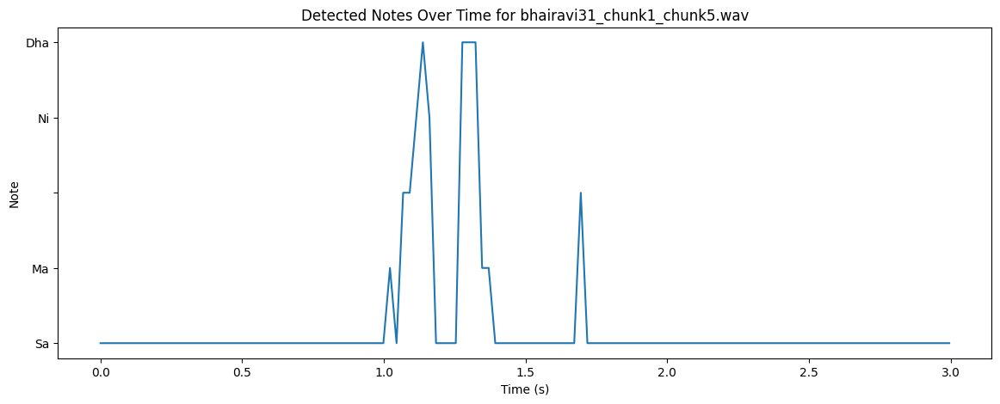

Tonic Frequency for bhairavi31_chunk1_chunk6.wav: 2329.0908203125 Hz
Detected Notes for bhairavi31_chunk1_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Dha', 'Sa', 'Paa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Dha', 'Sa', 'Sa', 'Paa', 'Paa', 'Sa', 'Sa', 'Sa']


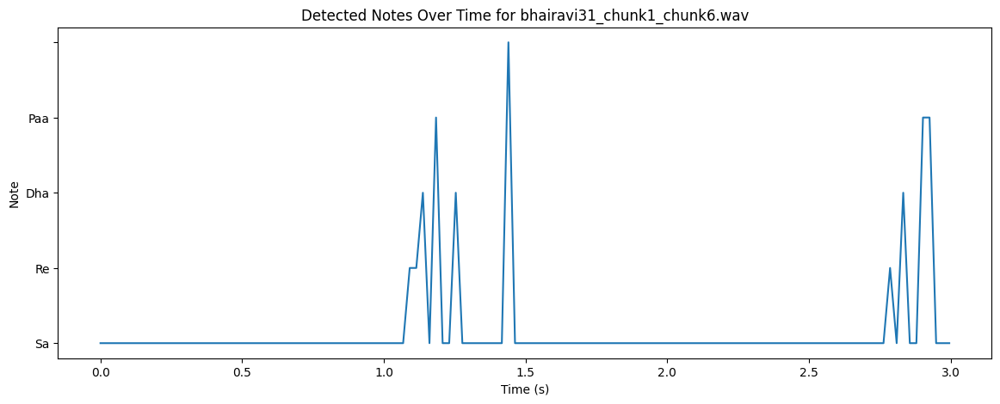

Tonic Frequency for bhairavi31_chunk1_chunk7.wav: 1939.4468994140625 Hz
Detected Notes for bhairavi31_chunk1_chunk7.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Dha', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


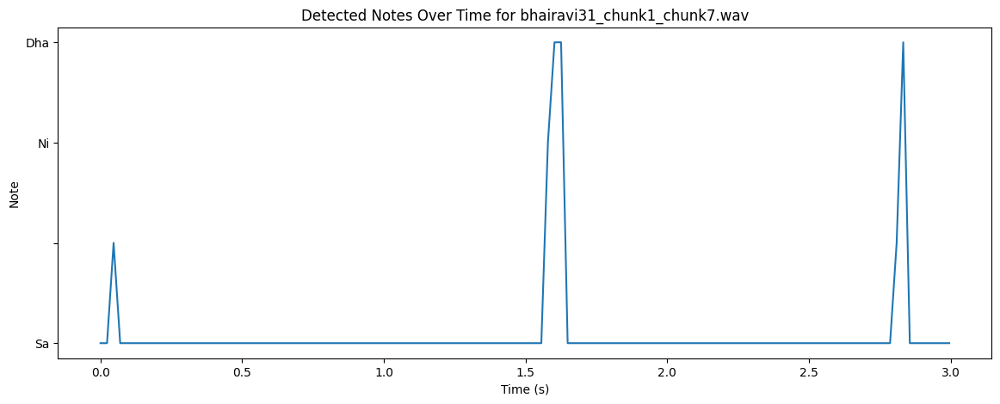

Tonic Frequency for bhairavi31_chunk1_chunk8.wav: 1468.7388916015625 Hz
Detected Notes for bhairavi31_chunk1_chunk8.wav:  ['Sa', 'Sa', 'Sa', 'Ga', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


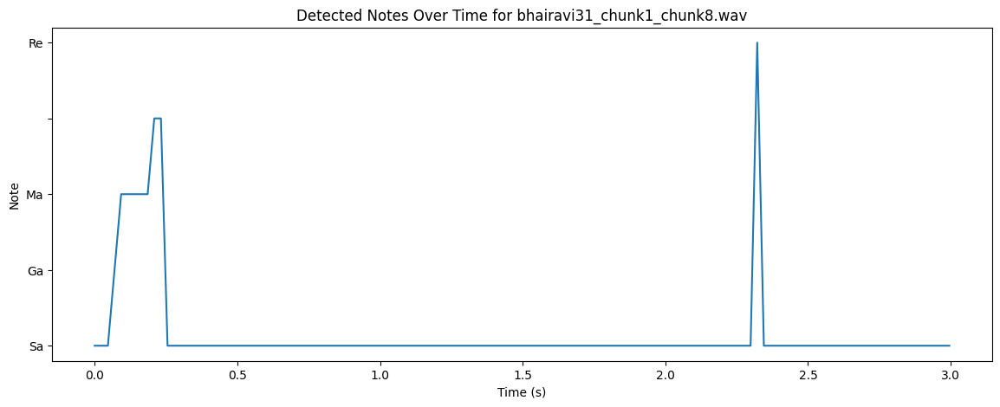

Tonic Frequency for bhairavi31_chunk1_chunk9.wav: 1835.8443603515625 Hz
Detected Notes for bhairavi31_chunk1_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Ma', 'Ni', 'Re', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


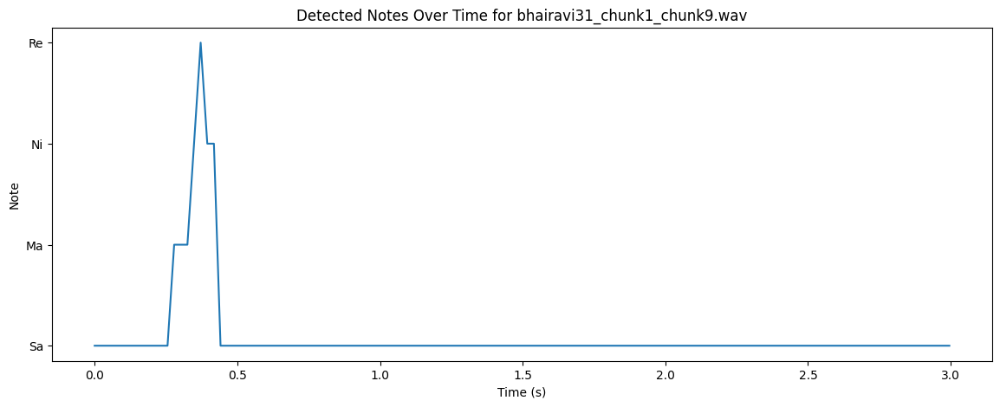

Tonic Frequency for bhairavi31_chunk1_chunk10.wav: 2386.249755859375 Hz
Detected Notes for bhairavi31_chunk1_chunk10.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Re', 'Ma', 'Ga', 'Paa']


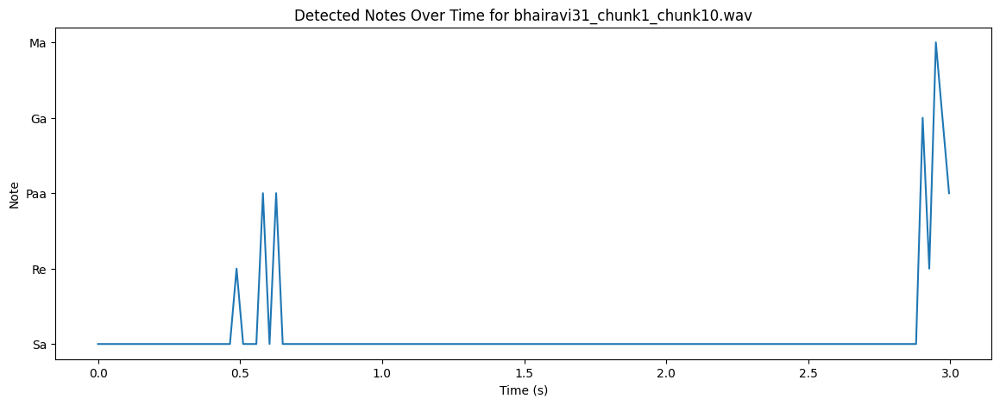

Tonic Frequency for bhairavi31_chunk2_chunk1.wav: 2341.19775390625 Hz
Detected Notes for bhairavi31_chunk2_chunk1.wav:  ['Ma', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Paa', 'Dha', 'Sa']


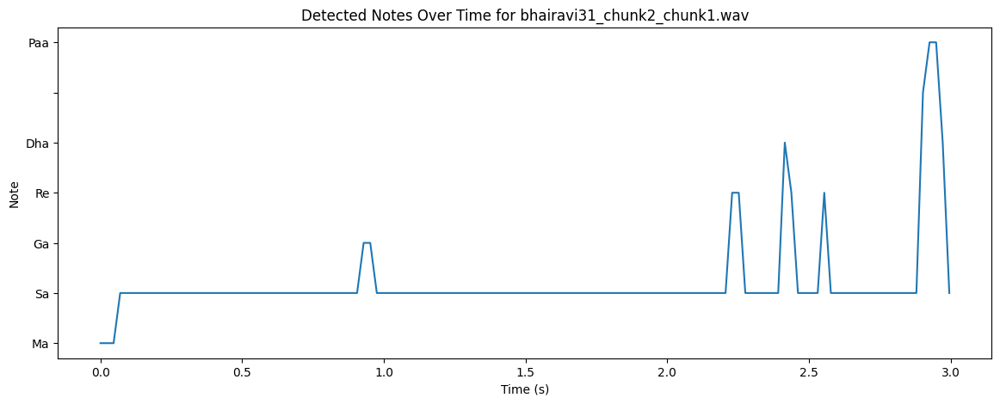

Tonic Frequency for bhairavi31_chunk2_chunk2.wav: 2007.016845703125 Hz
Detected Notes for bhairavi31_chunk2_chunk2.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Ga', 'Ga', 'Paa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


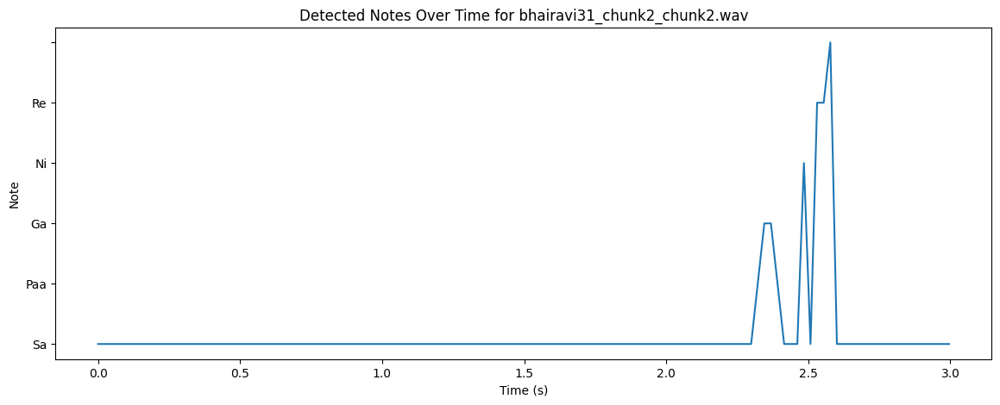

Tonic Frequency for bhairavi31_chunk2_chunk3.wav: 1571.650390625 Hz
Detected Notes for bhairavi31_chunk2_chunk3.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Dha', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


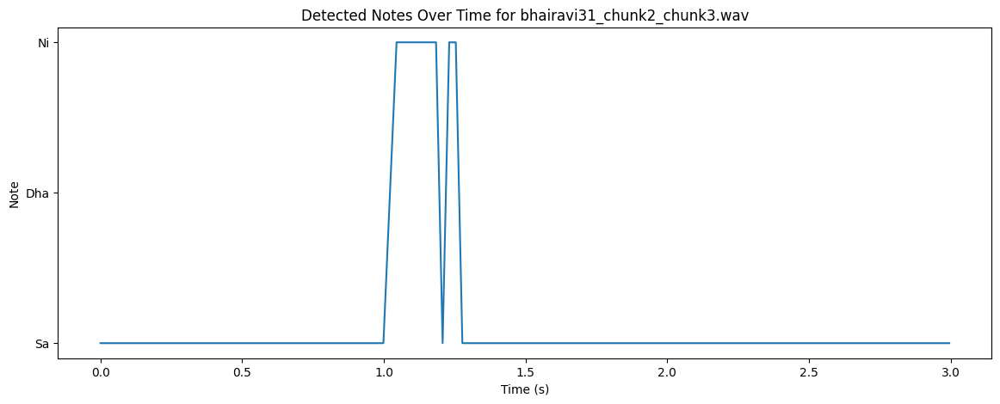

Tonic Frequency for bhairavi31_chunk2_chunk4.wav: 2068.99755859375 Hz
Detected Notes for bhairavi31_chunk2_chunk4.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


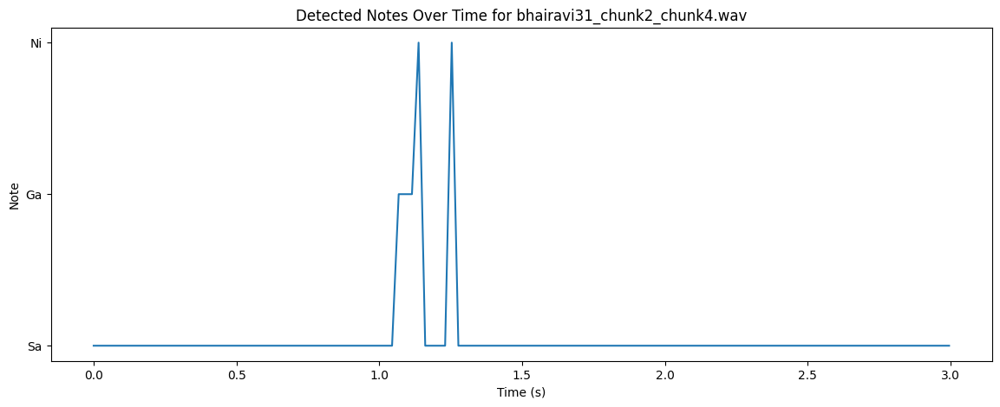

Tonic Frequency for bhairavi31_chunk2_chunk5.wav: 2241.04443359375 Hz
Detected Notes for bhairavi31_chunk2_chunk5.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Dha', 'Dha', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ma', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Dha', 'Re', 'Re', 'Sa', 'Sa']


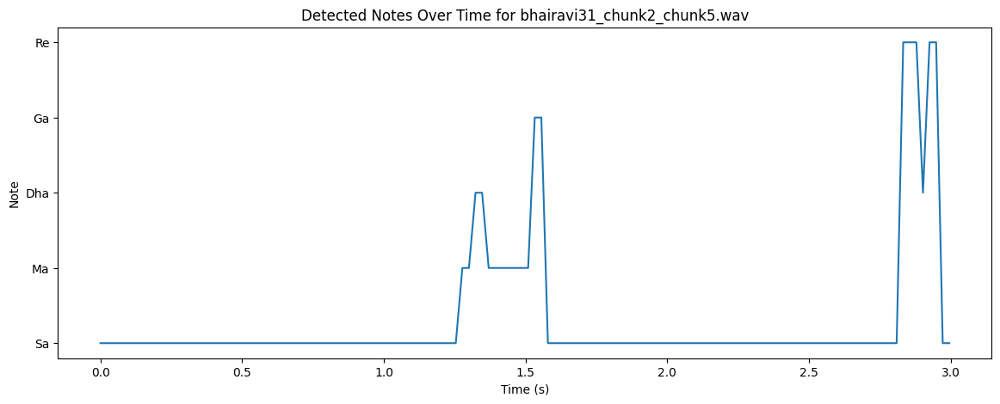

Tonic Frequency for bhairavi31_chunk2_chunk6.wav: 2398.900634765625 Hz
Detected Notes for bhairavi31_chunk2_chunk6.wav:  ['Sa', 'Sa', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Sa', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Ma']


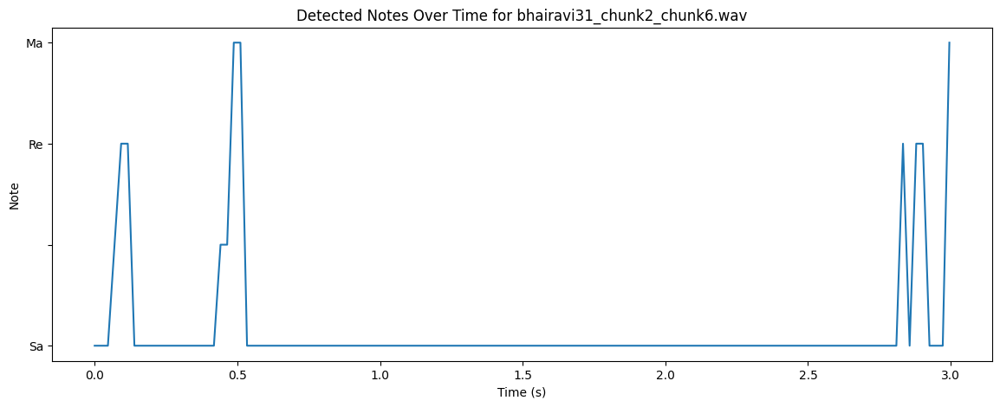

Tonic Frequency for bhairavi31_chunk2_chunk7.wav: 1249.6436767578125 Hz
Detected Notes for bhairavi31_chunk2_chunk7.wav:  ['Dha', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ma', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


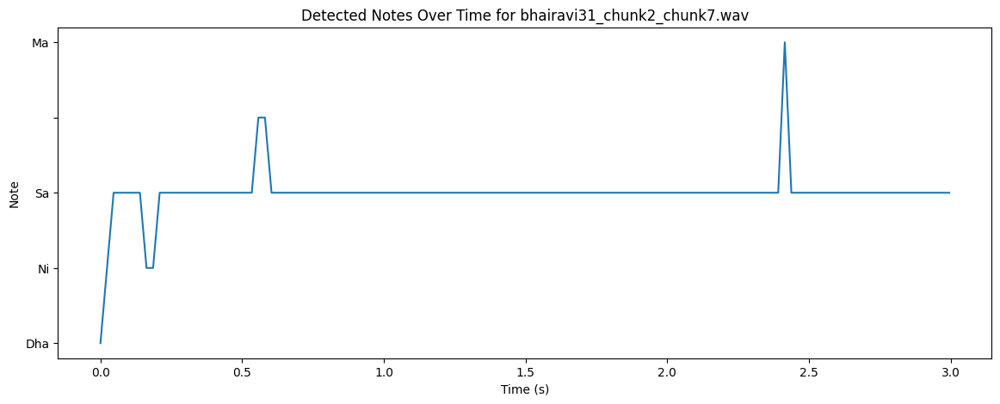

Tonic Frequency for bhairavi31_chunk2_chunk8.wav: 1776.2227783203125 Hz
Detected Notes for bhairavi31_chunk2_chunk8.wav:  ['Paa', 'Paa', 'Paa', 'Ni', 'Ni', 'Ni', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Paa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


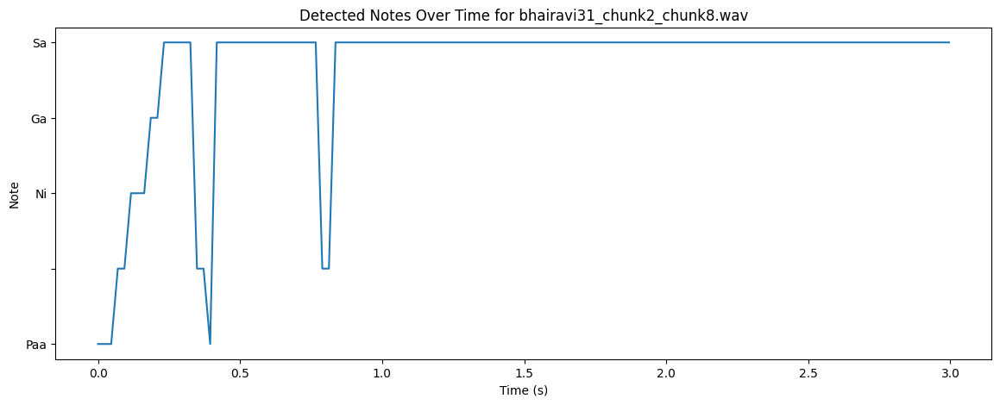

Tonic Frequency for bhairavi31_chunk2_chunk9.wav: 1367.04833984375 Hz
Detected Notes for bhairavi31_chunk2_chunk9.wav:  ['Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ga', 'Ga', 'Sa', 'Sa', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Ga', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Re', 'Re', 'Re', 'Re', 'Re', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni', 'Sa', 'Sa', 'Sa', 'Ni', 'Ni', 'Ni', 'Ni', 'Ni', 'Sa', 'Ni', 'Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa']


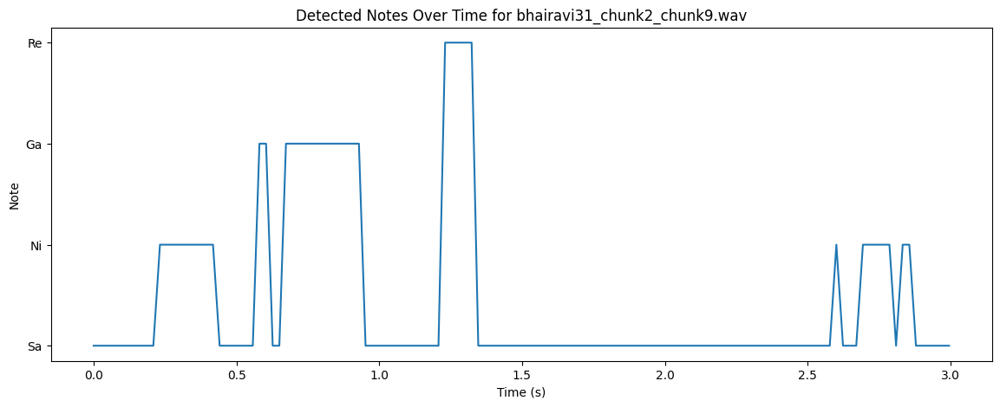

Tonic Frequency for bhairavi31_chunk2_chunk10.wav: 750.4129638671875 Hz
Detected Notes for bhairavi31_chunk2_chunk10.wav:  ['Ni', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Sa', 'Ni']


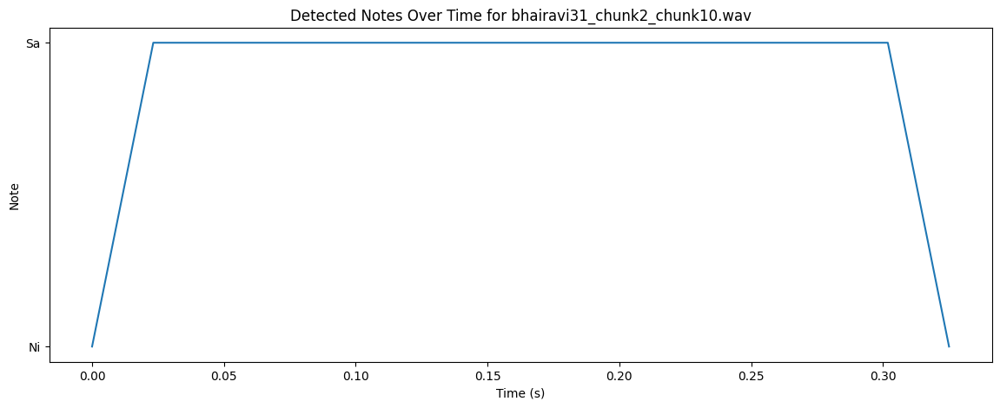

In [7]:
import librosa
import numpy as np
import os
import matplotlib.pyplot as plt

# detect the tonic (Sa) - Simplistic approach
def detect_tonic(y, sr):
    pitches, magnitudes = librosa.piptrack(y=y, sr=sr)
    tonic_freq = np.median(pitches[pitches > 0])  # Simple median of detected pitches
    return tonic_freq

# note frequencies relative to the tonic
def get_note_frequencies(tonic_freq):
    ratios = {
        'Sa': 1.0,
        'Re': 9/8,   # Approximate ratio of Re to Sa
        'Ga': 5/4,   # Approximate ratio of Ga to Sa
        'Ma': 4/3,   # Approximate ratio of Ma to Sa
        'Paa': 3/2,  # Approximate ratio of Pa to Sa
        'Dha': 5/3,  # Approximate ratio of Dha to Sa
        'Ni': 15/8   # Approximate ratio of Ni to Sa
    }
    note_frequencies = {note: tonic_freq * ratio for note, ratio in ratios.items()}
    return note_frequencies

# the directory containing your audio files
input_directory = "/content/drive/MyDrive/North Indian Music raga by waghmare/Split_Data_3Sec/Bhairavi_Raga_3Sec"
output_directory = "/content/drive/MyDrive/North Indian Music raga by waghmare"

# the output directory
os.makedirs(output_directory, exist_ok=True)

# Process each WAV file in the directory
for filename in os.listdir(input_directory):
    if filename.endswith(".wav"):
        file_path = os.path.join(input_directory, filename)
        y, sr = librosa.load(file_path)

        # the tonic frequency
        tonic_freq = detect_tonic(y, sr)
        print(f"Tonic Frequency for {filename}: {tonic_freq} Hz")

        #  note frequencies based on the detected tonic
        note_frequencies = get_note_frequencies(tonic_freq)

        # Convert the dictionary to a list of tuples (note, frequency)
        note_tuples = sorted(note_frequencies.items(), key=lambda item: item[1])

        # find the closest note
        def find_closest_note(freq):
            if freq == 0:
                return None # no frequency detected
            closest_note = min(note_tuples, key=lambda note: abs(note[1] - freq))
            return closest_note[0]

        #pitch (frequencies) using librosa's pitch tracking
        pitches, magnitudes = librosa.piptrack(y=y, sr=sr)

        # Iterate over pitches and map to notes
        detected_notes = []
        note_values_for_plotting = []

        for t in range(pitches.shape[1]):
            index = magnitudes[:, t].argmax()
            pitch = pitches[index, t]
            note = find_closest_note(pitch)
            if note:
                detected_notes.append(note)
                note_values_for_plotting.append(note)
            else:
                note_values_for_plotting.append('') # Replace None with empty string for plotting

        # Output the detected notes
        print(f"Detected Notes for {filename}: ", detected_notes)

        #  the detected notes over time
        times = librosa.times_like(pitches)
        plt.figure(figsize=(14, 5))
        # empty strings instead of None
        plt.plot(times, note_values_for_plotting)
        plt.xlabel('Time (s)')
        plt.ylabel('Note')
        plt.title(f'Detected Notes Over Time for {filename}')
        # Correct the indentation here
        plt.savefig(os.path.join(output_directory, f"{filename[:-4]}_notes.png"))
        plt.show()

In [9]:
import librosa
import numpy as np
import scipy.stats

def load_audio(file_path):
    """Load an audio file."""
    y, sr = librosa.load(file_path, sr=None)
    return y, sr

def detect_pitch(y, sr):
    """Detect pitch (fundamental frequency) using librosa."""
    # Use librosa's piptrack to get pitch and magnitude
    pitches, magnitudes = librosa.piptrack(y=y, sr=sr)

    # pitch with the highest magnitude
    pitch_values = []
    for t in range(pitches.shape[1]):
        index = magnitudes[:, t].argmax()
        pitch = pitches[index, t]
        if pitch > 0:
            pitch_values.append(pitch)

    return np.array(pitch_values)

def identify_tonic(pitch_values):
    """Identify the tonic based on pitch values."""
    #the pitch values to determine the tonic
    tonic, _ = scipy.stats.mode(pitch_values)
    return tonic


file_path = '/content/drive/MyDrive/North Indian Music raga by waghmare/Split_Data_3Sec/Bhairavi_Raga_3Sec/Bhairavi01_chunk1_chunk4.wav'

# Load audio
y, sr = load_audio(file_path)

# Detect pitch
pitch_values = detect_pitch(y, sr)

# Identify tonic
tonic = identify_tonic(pitch_values) # Remove the [0] indexing

print("Detected Tonic Frequency:", tonic)

Detected Tonic Frequency: 140.48578


Class : Bhairavi_Raga_3Sec


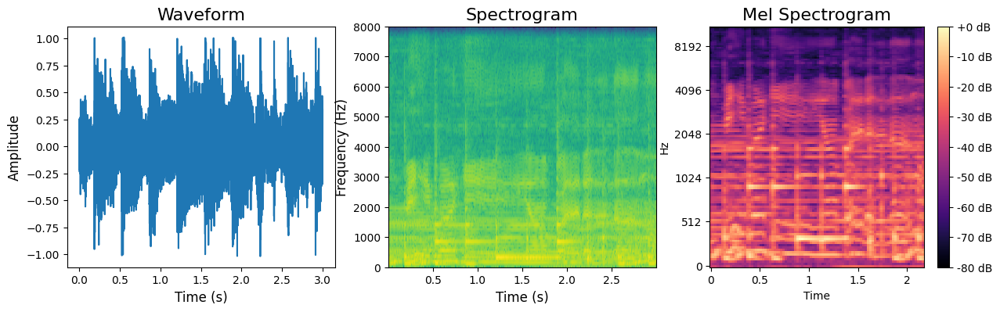

mfcc [[-123.03389   -103.47662   -118.99473   ...  -22.296005   -30.652323
   -39.37034  ]
 [ 148.73766    145.16367    148.06021   ...  151.0328     155.72789
   143.65715  ]
 [ -18.537231   -15.345518   -12.081961  ...  -20.730335   -20.654106
   -15.908785 ]
 ...
 [   6.6042023    6.634707    10.453843  ...    1.735676    -1.5088462
     5.8483105]
 [  -3.532713     1.7303276    5.575976  ...   -1.001882    -5.7713423
    -2.5181534]
 [  -1.2181063    2.9240763    6.6642656 ...    5.875305     2.4228323
    -2.2516284]]
rms [[0.11424732 0.15959042 0.17104407 0.16294257 0.17924617 0.19944239
  0.24348722 0.27004826 0.27158642 0.2595967  0.2430607  0.24218987
  0.23290193 0.21461785 0.18319869 0.23690286 0.28534395 0.30976847
  0.3356576  0.30228484 0.26419544 0.24059437 0.21734035 0.1832504
  0.15189175 0.14334847 0.20796737 0.2505557  0.2762189  0.28254655
  0.23418601 0.19274662 0.16171491 0.15193939 0.1472523  0.14644435
  0.19325493 0.28094137 0.34994307 0.38710654 0.40287527 0.3

In [10]:
import matplotlib.pyplot as plt
import librosa.display
import numpy as np
import IPython.display as ipd
import os


# class label from file path
def getClassLabel(filePath):
    return os.path.basename(os.path.dirname(filePath))

#  waveform, spectrogram and Mel-Spectrogram
audioFile = '/content/drive/MyDrive/North Indian Music raga by waghmare/Split_Data_3Sec/Bhairavi_Raga_3Sec/Bhairavi01_chunk10_chunk1.wav'
classLabel = getClassLabel(audioFile)
print(f'Class : {classLabel}')

# udio file with 16 kHz
sampleRate = 16000
waveform, sr = librosa.load(audioFile, sr=sampleRate)

#  audio
ipd.display(ipd.Audio(waveform, rate=sr))

# waveform
plt.figure(figsize=(15, 4))
plt.subplot(1, 3, 1)
time = np.arange(len(waveform)) / sr  # Convert sample  time in seconds
plt.plot(time, waveform)
plt.title('Waveform', fontsize=16)
plt.xlabel('Time (s)', fontsize=12)
plt.ylabel('Amplitude', fontsize=12)

#  spectrogram
plt.subplot(1, 3, 2)
plt.specgram(waveform, Fs=sr)
plt.title('Spectrogram', fontsize=16)
plt.xlabel('Time (s)', fontsize=12)
plt.ylabel('Frequency (Hz)', fontsize=12)

# Mel Spectrogram
plt.subplot(1, 3, 3)
mel_spectrogram = librosa.feature.melspectrogram(y=waveform, sr=sr)
librosa.display.specshow(librosa.power_to_db(mel_spectrogram, ref=np.max), y_axis='mel', x_axis='time')
plt.title('Mel Spectrogram', fontsize=16)
plt.colorbar(format='%+2.0f dB')
# print('mel_spectrogram', mel_spectrogram)

plt.show()

#  features using MFCC and RMS values
def extractFeatures(audioFile):
    try:
        # Loading audio file with 16 kHz sample rate
        waveform, sr = librosa.load(audioFile, sr=16000)

        # Trimming silence
        waveform, _ = librosa.effects.trim(waveform)

        #  MFCC features
        mfcc = librosa.feature.mfcc(y=waveform, sr=sr, n_mfcc=40)
        print('mfcc', mfcc)

        #  RMS values
        rms = librosa.feature.rms(y=waveform)
        print('rms', rms)

        # Combining features
        features = np.concatenate((mfcc, rms), axis=0)
        return features.T
    except Exception as e:
        print(f"Error in feature extraction: {e}")
        return None

# Extract features and print
features = extractFeatures(audioFile)
print('features', features)

Processing folder Bhairavi_Raga_3Sec:   1%|          | 5/554 [00:00<00:20, 27.05it/s]

mfcc [[-146.6699     -149.71638    -171.78719    ... -138.54572
  -140.63152    -129.31929   ]
 [ 128.56255     112.37471      91.54843    ...  105.30403
   101.71727     105.915436  ]
 [ -40.95143     -52.69223     -67.27641    ...  -48.402573
   -46.790028    -34.19893   ]
 ...
 [   5.5372443     6.4893293     5.569246   ...   -2.8847291
    -3.8649378    -1.1074038 ]
 [  -1.3230733     1.4611821    -1.4440846  ...   -5.5076256
    -6.7901773     1.6268969 ]
 [   0.41712427   -1.1033864    -3.9589539  ...    0.32929707
     1.7543921     1.515664  ]]
rms [[0.09077868 0.10066534 0.10758755 0.08486006 0.07513964 0.06970934
  0.06651667 0.06561862 0.06438523 0.06432461 0.06581856 0.06753968
  0.0693555  0.07058215 0.07020667 0.06886335 0.06758101 0.06653748
  0.0650241  0.06454356 0.06299138 0.06019922 0.05859892 0.05644167
  0.05462173 0.05410098 0.05433941 0.05464587 0.05525889 0.05568027
  0.06136123 0.09577321 0.12848783 0.168779   0.1857168  0.1866714
  0.18201576 0.16628237 0.1701

Processing folder Bhairavi_Raga_3Sec:   2%|▏         | 12/554 [00:02<01:29,  6.04it/s]

mfcc [[-7.87678680e+01 -6.33025436e+01 -6.55153885e+01 ... -1.12220215e+02
  -1.14581856e+02 -8.53128281e+01]
 [ 1.24854668e+02  1.11577026e+02  1.03435600e+02 ...  1.21188141e+02
   1.20335205e+02  1.32283936e+02]
 [-5.56109238e+01 -6.35441666e+01 -7.06123734e+01 ... -5.93889694e+01
  -6.20529022e+01 -4.60423393e+01]
 ...
 [ 1.75337791e+00  1.32085133e+00  7.23006725e-02 ... -3.18684816e-01
   1.47987390e+00  1.14069319e+00]
 [-2.80455589e+00 -7.09696102e+00 -9.97311783e+00 ...  3.91027117e+00
   4.95908928e+00  2.07220984e+00]
 [-1.82811570e+00 -2.54543304e+00 -2.18973780e+00 ... -2.46477890e+00
  -4.43961143e+00 -7.07201385e+00]]
rms [[0.10532891 0.1312904  0.15603979 0.16158593 0.17623289 0.18785805
  0.1985332  0.19847709 0.19697616 0.1941959  0.18727258 0.19229463
  0.18548472 0.17624348 0.17408504 0.17340888 0.1815833  0.19227283
  0.19543102 0.19307698 0.19676793 0.19255832 0.19425963 0.1979364
  0.19199508 0.19902296 0.20945592 0.20962292 0.21767795 0.22552617
  0.21754906 0.2

Processing folder Bhairavi_Raga_3Sec:   3%|▎         | 19/554 [00:02<00:46, 11.62it/s]

mfcc [[ -67.24437     -64.50435     -78.73806    ... -138.6728
  -138.84639    -126.099335  ]
 [ 111.926384    104.5237       92.77988    ...  108.82851
   110.8445      122.15268   ]
 [ -67.60525     -74.15285     -79.74836    ...  -60.909992
   -59.006573    -52.277325  ]
 ...
 [  14.352524     20.903988     23.777023   ...   -3.3847435
    -3.8210034    -1.1994606 ]
 [  23.58818      31.011057     31.371592   ...    2.84305
     0.51318264    2.1378264 ]
 [  14.006003     22.832397     28.5152     ...   -6.4627137
    -8.08738      -5.4641485 ]]
rms [[0.13487796 0.16036046 0.17758992 0.17319618 0.17628275 0.1845596
  0.18925066 0.1868521  0.17534003 0.17115285 0.17494771 0.17526735
  0.17880732 0.16984366 0.16443256 0.16451599 0.16361567 0.17064449
  0.17163149 0.17455736 0.17344236 0.16114676 0.15272215 0.1370553
  0.12653938 0.13087524 0.1361651  0.14687674 0.15467888 0.15588026
  0.15258507 0.14637114 0.13985537 0.1355066  0.12873782 0.12953632
  0.13107768 0.12925468 0.12382278 

Processing folder Bhairavi_Raga_3Sec:   4%|▍         | 23/554 [00:02<00:34, 15.22it/s]

mfcc [[-144.4363     -131.48978    -136.88234    ...  -46.849094
   -59.390545    -85.73432   ]
 [ 137.08777     120.35814     113.77849    ...  130.50995
   130.84103     133.30322   ]
 [ -35.456055    -37.244576    -38.440742   ...  -75.4686
   -59.241554    -45.087326  ]
 ...
 [  -0.6281479     0.7707932     5.831738   ...   17.96305
     9.892399      5.157655  ]
 [  -0.71772623    0.81437063    2.1862824  ...    7.657555
     1.8642552    -1.1321137 ]
 [  -4.157418     -5.299308     -1.8840594  ...    7.561442
    -0.99966913   -3.812942  ]]
rms [[0.07112835 0.08487177 0.0982751  0.09641321 0.09486828 0.09339626
  0.09057047 0.08931294 0.09004853 0.09114582 0.09159035 0.09156696
  0.08978599 0.088925   0.08765836 0.08604854 0.08520804 0.08425067
  0.08490352 0.08612873 0.08710434 0.08981016 0.09086751 0.09160825
  0.0945618  0.09952503 0.1033264  0.10712167 0.10490084 0.10417611
  0.10141518 0.09808104 0.09498063 0.08321804 0.0768401  0.07130847
  0.07270189 0.07775406 0.07996308 

Processing folder Bhairavi_Raga_3Sec:   5%|▌         | 30/554 [00:02<00:26, 19.70it/s]

mfcc [[ -74.8829     -66.939575   -77.28166   ... -112.47078    -51.20068
   -13.372503 ]
 [ 123.57466    122.301895   123.28093   ...  139.6711     140.62325
   149.49234  ]
 [ -25.470764   -21.18072    -15.677582  ...  -35.124542   -50.430138
   -49.61447  ]
 ...
 [  -1.2049325    1.4708476    4.977764  ...   15.738924    15.026785
    10.55834  ]
 [  -2.3981662   -2.3885384    0.3647033 ...   10.465964     7.093342
     2.106694 ]
 [  -3.1887112   -3.0754647   -4.264428  ...   11.892417     8.18774
     1.9409235]]
rms [[0.13295893 0.16614759 0.19414113 0.20223889 0.20232393 0.19025218
  0.2157624  0.2386658  0.2482991  0.25493515 0.22847193 0.19477652
  0.18399112 0.19657747 0.19916283 0.20162056 0.19617012 0.21356045
  0.23105252 0.23823705 0.24320288 0.20472407 0.16785122 0.13581516
  0.11445282 0.11755832 0.12617643 0.15126571 0.17027748 0.17635344
  0.1678209  0.14019284 0.11152131 0.09861588 0.11447189 0.12187346
  0.12334886 0.13284415 0.16788433 0.20887713 0.24651663 0.26555

Processing folder Bhairavi_Raga_3Sec:   7%|▋         | 38/554 [00:02<00:20, 25.55it/s]

mfcc [[-54.21171    -51.121063   -76.468834   ... -40.737743   -39.83901
  -49.13184   ]
 [138.62755    139.02696    133.87863    ... 108.752266   106.89202
  112.463425  ]
 [-39.039494   -37.69502    -31.622864   ... -49.38099    -44.32337
  -42.470055  ]
 ...
 [ 11.909848    19.42928     17.002323   ...  13.466454    10.863319
    7.3078156 ]
 [  3.214918     8.823519     7.9670005  ...   2.1067052    3.2769952
   -5.559303  ]
 [  0.46404576   3.9374433    5.5259013  ...   3.2637482    8.727673
    8.749231  ]]
rms [[0.19424808 0.21540366 0.23644282 0.21135075 0.1959909  0.19761948
  0.18639705 0.16376531 0.19998573 0.2559925  0.2793521  0.2929303
  0.25969452 0.18822491 0.13961412 0.10533287 0.08981784 0.08886109
  0.10764554 0.23421821 0.3299122  0.4039823  0.45848706 0.45474678
  0.43671978 0.40700355 0.36807877 0.331661   0.29115647 0.28271657
  0.28433132 0.2956     0.3151416  0.30400544 0.2937836  0.27984855
  0.26451817 0.2530474  0.24157359 0.22897981 0.26498643 0.29159853
  

Processing folder Bhairavi_Raga_3Sec:   8%|▊         | 46/554 [00:03<00:17, 29.43it/s]

mfcc [[-155.30972    -138.27158    -147.64323    ...  -37.901627
   -72.82983     -76.55553   ]
 [ 164.695       166.76184     163.62344    ...  153.55673
   160.78238     161.84668   ]
 [  -3.2008877     0.87216884   -1.0439878  ...  -22.169966
   -19.828655    -14.870966  ]
 ...
 [   4.054386      6.4294224     5.564718   ...   -3.2781498
    -5.7446856    -4.8282537 ]
 [   4.570735      7.957223      9.801017   ...    7.602627
     8.636566      9.519632  ]
 [   0.45597243    1.4285874     3.282053   ...    7.313514
     9.250594      4.9000206 ]]
rms [[0.13945697 0.16340314 0.17492016 0.15735777 0.2000208  0.22156386
  0.23032862 0.23602301 0.18400872 0.15036587 0.14144266 0.14696519
  0.15370123 0.15717478 0.17689852 0.2669882  0.27826208 0.27923808
  0.2666704  0.16805546 0.13285775 0.11214215 0.09391931 0.0789033
  0.06840723 0.14477324 0.21337396 0.24019074 0.2543124  0.22538307
  0.16523555 0.1260586  0.09774202 0.08290048 0.07551675 0.07859052
  0.22370711 0.2908173  0.341386

Processing folder Bhairavi_Raga_3Sec:   9%|▉         | 50/554 [00:03<00:17, 29.44it/s]

mfcc [[-45.255527   -31.792038   -44.279984   ... -94.57158    -97.031395
  -87.19446   ]
 [126.21662    127.241035   121.12387    ... 110.561775   104.86478
  112.5169    ]
 [-49.761066   -54.306774   -54.329758   ... -17.025705   -18.309814
  -19.49358   ]
 ...
 [  0.8481062    5.5803275   10.77548    ...  15.051767    11.056732
   11.466885  ]
 [  4.430167     6.107959     5.1464148  ...  -2.7385454   -1.9754546
   -0.21259996]
 [ -4.6028476   -2.169705    -1.5071471  ...  -2.1882238   -2.4519467
    0.77299833]]
rms [[0.18228427 0.21526872 0.2440461  0.22774859 0.21535769 0.19776188
  0.1730412  0.16432612 0.21572971 0.22427118 0.22544478 0.2140905
  0.14236158 0.13853805 0.1425529  0.14165983 0.13822325 0.11745482
  0.12520322 0.21368848 0.2546037  0.27349922 0.27891237 0.23554702
  0.20533    0.20962851 0.23812062 0.23279041 0.23107311 0.24469633
  0.2554461  0.2740781  0.2787632  0.26141125 0.22791404 0.21100454
  0.20688868 0.19511598 0.17788786 0.16805848 0.24185407 0.2896236


Processing folder Bhairavi_Raga_3Sec:  10%|█         | 58/554 [00:03<00:16, 29.66it/s]

mfcc [[-18.039242    45.212383    39.50158    ... -89.09758    -66.75701
   -8.965197  ]
 [113.88121    110.48171    104.083755   ... 151.54697    123.09644
  107.41118   ]
 [-52.249702   -47.12525    -39.3787     ... -29.728947   -25.23945
  -27.13472   ]
 ...
 [ 18.052698    17.223015    21.305614   ...  10.527565    11.171766
    6.354701  ]
 [ 11.13746      7.007578    10.227208   ...   6.579159     3.9381366
   -0.86616886]
 [ -4.432123    -8.69402    -10.151215   ... -12.520235    -9.5418625
   -6.593918  ]]
rms [[0.32074314 0.3988069  0.458686   0.47411597 0.4381535  0.41836932
  0.39460132 0.38256496 0.37463292 0.37199616 0.39803785 0.42673033
  0.45062447 0.460312   0.443474   0.43775713 0.4412997  0.44225806
  0.46099296 0.43892145 0.41774213 0.41618598 0.39735967 0.40233684
  0.3971389  0.39111668 0.39792687 0.42294684 0.41309857 0.4118154
  0.40642267 0.37301475 0.42163086 0.42299354 0.40878642 0.39936587
  0.35067537 0.34770665 0.36663425 0.361865   0.34172204 0.34105638
 

Processing folder Bhairavi_Raga_3Sec:  11%|█         | 62/554 [00:03<00:17, 28.93it/s]

mfcc [[-96.85768   -76.80294   -85.75739   ... -34.66224   -66.89954
  -61.822742 ]
 [170.164     167.88742   155.44936   ... 145.62991   146.9986
  130.51425  ]
 [-12.89452   -15.829632  -21.234892  ... -15.370653   -9.371998
   -6.8972893]
 ...
 [  8.8566265   7.1126013   3.4980953 ...  -6.0138083  -5.5304747
   -2.5189598]
 [ -8.533623  -15.6234    -16.981857  ...  -3.0189996  -6.3993044
   -7.25519  ]
 [ -9.753014   -6.0054746  -2.9104586 ...  -1.3918344  -1.3448219
   -9.36813  ]]
rms [[0.1763794  0.22009191 0.24080282 0.22334926 0.24947412 0.24585585
  0.24148507 0.2425736  0.18689083 0.16230829 0.16014189 0.16560522
  0.16873959 0.16966967 0.18343565 0.28954747 0.32504925 0.4039931
  0.48446387 0.48853263 0.50889856 0.48775363 0.41786203 0.3738263
  0.3519814  0.3298668  0.3528843  0.35172492 0.32705823 0.31740487
  0.2772206  0.24611937 0.22735205 0.18825974 0.18135293 0.17462234
  0.24096462 0.2709504  0.29160574 0.30573145 0.26030514 0.24103229
  0.226356   0.22260831 0.21507

Processing folder Bhairavi_Raga_3Sec:  12%|█▏        | 68/554 [00:03<00:18, 26.75it/s]

mfcc [[-126.19892   -116.550606   -91.138084  ...   23.208694    -6.2765994
   -11.061744 ]
 [ 148.21072    142.47444    142.41898   ...   95.81183    102.94531
   123.07986  ]
 [  -9.896281   -22.659536   -18.173286  ...  -49.917915   -49.72298
   -43.396725 ]
 ...
 [   2.4235964    5.144663     2.399809  ...   12.786667    13.490657
     9.353867 ]
 [  -2.7750723   -4.385208    -3.1248744 ...   18.17244     14.844919
     9.765144 ]
 [  -4.544755    -2.404404    -5.967198  ...    2.2255502    1.0845294
    -1.431963 ]]
rms [[0.12924677 0.1744521  0.2724396  0.3001444  0.32596165 0.33806986
  0.31093624 0.31568995 0.30178717 0.28554383 0.24496357 0.19003963
  0.213689   0.2825772  0.33259806 0.3684696  0.36571506 0.35034326
  0.31723467 0.28549385 0.2598986  0.20945297 0.24687783 0.33623517
  0.3967016  0.42236596 0.41678748 0.3497354  0.2728924  0.22135983
  0.18136129 0.16806166 0.20941307 0.24941409 0.32346717 0.38216427
  0.41155747 0.41269675 0.35958576 0.32824445 0.27208444 0.25

Processing folder Bhairavi_Raga_3Sec:  13%|█▎        | 74/554 [00:04<00:18, 25.71it/s]

rms [[0.11880986 0.14674799 0.23308095 0.25465673 0.2606781  0.26109913
  0.2151112  0.19433413 0.20714237 0.23016264 0.2347952  0.23606993
  0.25008973 0.2710417  0.28095016 0.28030837 0.2671536  0.24168581
  0.23113324 0.23802747 0.24493332 0.23905964 0.24290591 0.29955107
  0.33470696 0.36028597 0.3803631  0.35838422 0.337385   0.34240994
  0.3313826  0.31276423 0.29632103 0.2642309  0.31464714 0.34278852
  0.3516408  0.35613602 0.30139983 0.2749288  0.27001318 0.26031703
  0.25607184 0.23294485 0.23127152 0.25120878 0.26014104 0.25811204
  0.24352042 0.21745488 0.2026535  0.21294299 0.21406548 0.19810657
  0.17938443 0.23588409 0.29124725 0.32645875 0.3677019  0.34811947
  0.3219776  0.31608695 0.31358457 0.33178595 0.33369315 0.32677513
  0.37368587 0.37694082 0.37713942 0.37902418 0.30057114 0.2597935
  0.2561356  0.24590613 0.23611583 0.23021938 0.23706187 0.28785878
  0.31518552 0.3256507  0.30018315 0.23491353 0.1967668  0.17290474
  0.17943868 0.19294576 0.19833738 0.23764999

Processing folder Bhairavi_Raga_3Sec:  14%|█▍        | 80/554 [00:04<00:18, 25.52it/s]

mfcc [[ -83.24338     -75.53852    -105.115906   ...    6.265433
   -21.879786    -13.0179205 ]
 [ 155.75107     148.41377     149.66846    ...  133.05583
   124.72659     127.54726   ]
 [ -27.164341    -24.670048    -20.964264   ...  -47.675724
   -44.081085    -26.87786   ]
 ...
 [  -0.83834225   -0.28352898    1.7657982  ...    0.54343176
     7.8939676    10.607349  ]
 [ -13.57938      -9.742645      4.158672   ...    4.5340805
     6.5613194     4.523391  ]
 [  -2.6285768    -2.0246725     2.1806252  ...   -3.128995
    -8.29007      -9.627926  ]]
rms [[0.20999469 0.22701082 0.23555955 0.17053978 0.21140985 0.27032244
  0.31317377 0.35578525 0.34681034 0.3240832  0.2935078  0.25905636
  0.21514    0.2032022  0.2746296  0.377103   0.41799268 0.43625838
  0.4060976  0.30727762 0.2483272  0.1953332  0.16891685 0.19314234
  0.25829336 0.3547517  0.46194547 0.4950506  0.5006648  0.46244264
  0.3854892  0.34607655 0.30922112 0.29196864 0.2770057  0.2800907
  0.33103177 0.35384348 0.3488

Processing folder Bhairavi_Raga_3Sec:  16%|█▌        | 87/554 [00:04<00:16, 28.62it/s]

mfcc [[ -90.136856   -88.15698   -119.29001   ...  -95.8784      -2.8599374
    37.72449  ]
 [ 144.45169    158.96497    169.24335   ...   91.89945    112.331696
   123.1835   ]
 [ -38.603798   -38.989883   -25.741047  ...   29.768661   -14.021128
   -35.263306 ]
 ...
 [   3.999672     2.8826091   -3.2207599 ...    6.383559    -1.4948475
    -1.1289179]
 [   7.5503592    4.2718334    0.5614395 ...    2.1099074   -5.136589
    -2.924768 ]
 [   1.9172597    4.6240044    5.01007   ...   -4.51243      1.0299764
    -0.5222777]]
rms [[0.13788539 0.1697289  0.19693357 0.19867958 0.1813886  0.15752788
  0.23073468 0.28684413 0.31220827 0.34113514 0.31461042 0.27347705
  0.2540636  0.21569219 0.16578868 0.12092647 0.10893133 0.22854562
  0.2834311  0.31838045 0.33684513 0.29118818 0.25367764 0.22014703
  0.18992235 0.1645541  0.15018345 0.19244634 0.2787998  0.3419681
  0.38136327 0.39671043 0.37110692 0.3434033  0.31712836 0.28676352
  0.2663481  0.24547991 0.2824416  0.29424614 0.31066748 0.

Processing folder Bhairavi_Raga_3Sec:  16%|█▋        | 91/554 [00:04<00:16, 28.55it/s]

mfcc [[ -79.87348     -0.6628748   10.277988  ...  -67.29326    -57.435474
  -109.96052  ]
 [ 141.96878    139.74316    133.94987   ...  145.13809    150.78546
   139.50458  ]
 [ -37.439304   -46.50419    -56.27489   ...  -48.131775   -47.03376
   -43.06434  ]
 ...
 [   2.0757594    1.3792672    6.2093925 ...    4.2331223    5.2765746
    10.620675 ]
 [   1.3235551   -0.2578318    3.084251  ...    2.4013948    2.818397
     8.5494   ]
 [   9.845577     8.755125     5.6230507 ...    5.134115     5.979436
     5.9921794]]
rms [[0.22056676 0.28665632 0.33345392 0.35646155 0.31025174 0.26920235
  0.22165176 0.18434002 0.16291644 0.15011744 0.19785748 0.23921785
  0.2571061  0.26142874 0.23692283 0.2013563  0.19167832 0.1982754
  0.19773768 0.18481033 0.18059221 0.23405671 0.26051217 0.27347666
  0.26994112 0.2167197  0.17715043 0.19004382 0.20040302 0.1913191
  0.19212303 0.16632679 0.27899215 0.319028   0.33300534 0.34236613
  0.2562124  0.21064916 0.17569754 0.14685903 0.12067167 0.10421

Processing folder Bhairavi_Raga_3Sec:  18%|█▊        | 98/554 [00:05<00:16, 26.99it/s]

mfcc [[-114.89275       0.9994026    44.90052    ...   -2.2798176
    -1.9503849   -20.272257  ]
 [ 135.03871     128.3927      112.62062    ...  122.15301
   134.03302     146.74387   ]
 [ -48.262802    -49.79802     -49.962906   ...  -55.866035
   -73.03291     -66.67883   ]
 ...
 [   3.1172175     2.218641      1.4719737  ...   -1.1491239
    -3.1014981     0.95922005]
 [   0.83863914   -7.7845345   -13.213009   ...  -13.59684
    -6.5829086    -3.963259  ]
 [  -3.2066522    -2.4206305    -7.7738266  ...    4.507972
     3.1178246    -0.2631266 ]]
rms [[0.1957722  0.31457272 0.3900329  0.43250096 0.4177386  0.36062995
  0.29705822 0.24136561 0.22687837 0.22164652 0.23165557 0.288999
  0.29961312 0.31641555 0.3101125  0.2608306  0.24246818 0.22560287
  0.23728473 0.23587944 0.22266626 0.21585917 0.24550213 0.27677444
  0.2984717  0.29169098 0.24812867 0.2096054  0.18959332 0.19015115
  0.17931883 0.15921973 0.2122207  0.2587387  0.2834521  0.31749976
  0.30499873 0.28205723 0.2820118

Processing folder Bhairavi_Raga_3Sec:  19%|█▉        | 106/554 [00:05<00:15, 29.30it/s]

mfcc [[-161.89735    -155.64127    -170.93475    ...  -37.520554
   -31.19092     -28.00345   ]
 [ 146.0119      140.4718      131.93723    ...  117.07091
   120.73262     125.884094  ]
 [ -23.281992    -28.009369    -31.927502   ...  -77.97626
   -80.17731     -63.317177  ]
 ...
 [  -4.71818      -2.0388        1.7140204  ...    4.4194965
     2.4771917     2.7009387 ]
 [  -2.5471988    -1.5198067     0.97363734 ...  -10.252087
   -11.31021      -0.59422755]
 [  -0.67542696   -1.9034777    -2.4713306  ...   -1.7652256
    -4.124627      1.2318931 ]]
rms [[0.07782895 0.09598684 0.11113701 0.1113683  0.10782514 0.10707235
  0.1059043  0.10523942 0.10699756 0.10119344 0.09768227 0.09582027
  0.09719833 0.10150428 0.10081007 0.09685796 0.09021997 0.08978925
  0.09316008 0.09773376 0.10030138 0.09909271 0.09738524 0.09391795
  0.09315964 0.09176444 0.09044308 0.08941971 0.08757708 0.08615615
  0.08344586 0.08459853 0.08515537 0.08584355 0.08704311 0.08774009
  0.08966086 0.09196881 0.09573

Processing folder Bhairavi_Raga_3Sec:  20%|█▉        | 110/554 [00:05<00:14, 30.54it/s]

mfcc [[ -52.61841    -37.742653   -27.474146  ... -109.40129   -104.71827
   -88.89507  ]
 [ 129.12164    115.82799    115.106     ...  109.30831    105.28437
   106.18944  ]
 [ -55.390076   -69.3643     -73.99128   ...  -53.077423   -53.288956
   -47.169    ]
 ...
 [  12.948158    18.50145     26.752266  ...   -0.5320345    1.3660027
    -3.5717473]
 [  18.982616    22.023533    17.519646  ...  -16.601738   -17.148323
    -9.728386 ]
 [  18.726784    25.35966     18.619942  ...   -7.4678516   -6.101666
    -4.5510635]]
rms [[0.13741522 0.18077128 0.21289372 0.21181361 0.21822336 0.21269576
  0.20651488 0.20465718 0.20663953 0.20724308 0.20916598 0.21031664
  0.2070537  0.20105362 0.19525535 0.18749566 0.18091235 0.18246986
  0.18661974 0.18767409 0.18486129 0.17611742 0.16704571 0.17046642
  0.18099365 0.19397789 0.1987412  0.20377195 0.20456749 0.20415713
  0.19833146 0.18887499 0.17526211 0.15517858 0.14295428 0.14982112
  0.17538235 0.20863146 0.23290665 0.23852411 0.2318796  0.210

Processing folder Bhairavi_Raga_3Sec:  21%|██▏       | 118/554 [00:05<00:13, 31.96it/s]

mfcc [[ -37.16197    -23.21622    -24.004633  ... -120.067474  -111.84652
   -88.306946 ]
 [  92.563416    87.403       89.56364   ...  107.89157    115.675934
   128.77814  ]
 [ -64.89345    -66.823456   -72.971375  ...  -44.6869     -46.571712
   -36.90928  ]
 ...
 [  -8.663512    -9.864342    -1.3711631 ...   -9.650651   -10.566652
    -2.5185091]
 [ -10.916946   -19.587334    -9.521935  ...    5.723937     3.44553
    -0.2986163]
 [   9.1511345    7.2397633    8.054455  ...   11.628848     6.830218
    -1.0574929]]
rms [[0.30830836 0.38156873 0.45290312 0.47236893 0.49971935 0.53534806
  0.5632928  0.5646115  0.5592118  0.54667765 0.5456208  0.5565931
  0.54785883 0.5552688  0.53000563 0.51343036 0.5491362  0.52905756
  0.53834677 0.56363535 0.5241187  0.5199299  0.50589454 0.48145533
  0.51140237 0.51948816 0.51708364 0.50850266 0.49156353 0.48611316
  0.47428647 0.4640325  0.43228436 0.3917967  0.36990204 0.3361106
  0.31686383 0.3059086  0.2967549  0.29602018 0.28869662 0.299032

Processing folder Bhairavi_Raga_3Sec:  23%|██▎       | 126/554 [00:05<00:13, 31.60it/s]

mfcc [[ -72.731964   -77.02854    -93.63399   ... -100.558395  -113.47525
  -121.59375  ]
 [ 118.54024    132.61569    136.92819   ...  134.75333    144.21791
   154.49988  ]
 [  -3.7446294  -11.921333   -20.072523  ...  -16.075474   -22.390457
   -20.908907 ]
 ...
 [   4.1525545    8.740382    12.29244   ...    4.2062087    7.210282
     9.336313 ]
 [   5.1386228    7.054543     6.7891626 ...   -1.9790764   -1.427881
     3.4735625]
 [   4.877553     2.8412743    5.667363  ...    2.8108082   -1.2940798
    -2.509788 ]]
rms [[0.14263095 0.16855349 0.19875948 0.19666979 0.23240621 0.22763905
  0.22727269 0.21267544 0.23681256 0.26664528 0.26846513 0.28530756
  0.23963563 0.21939847 0.234979   0.2566331  0.2524515  0.23307279
  0.22361475 0.25760666 0.30765465 0.34956917 0.3746486  0.36141667
  0.34625655 0.32995325 0.2937797  0.25140533 0.21656261 0.2512828
  0.31309074 0.35975382 0.39082694 0.36906868 0.32665762 0.28002962
  0.23570874 0.21782027 0.20461637 0.19977899 0.27688286 0.3405

Processing folder Bhairavi_Raga_3Sec:  24%|██▍       | 135/554 [00:06<00:11, 35.60it/s]

mfcc [[-69.76235    -74.90473    -47.86622    ... -65.88818    -64.97431
  -68.10777   ]
 [135.59595    144.0256     147.68315    ... 113.11202    109.03652
  107.75261   ]
 [-26.98581    -34.294807   -35.874542   ... -36.572094   -36.777245
  -37.996403  ]
 ...
 [  1.8754982    6.7818475   14.824423   ...  11.89225      6.6270676
    6.7378435 ]
 [  0.98829615   2.1889057   -0.182971   ...  -2.5467105   -2.9624958
   -1.3016208 ]
 [ -4.5487485   -2.1492224    6.159246   ...  -2.6456633   -4.0472713
   -3.3109596 ]]
rms [[0.12075064 0.16819505 0.2389206  0.25276038 0.2876272  0.29279095
  0.26709014 0.26849857 0.25254276 0.24669403 0.2301126  0.20536248
  0.24425039 0.30429116 0.3689346  0.42057464 0.41198212 0.38209414
  0.32516503 0.2630447  0.22583081 0.18968748 0.19099665 0.25254717
  0.27522388 0.28693962 0.29673472 0.2598149  0.24279091 0.24708936
  0.26148966 0.24855919 0.2432272  0.25816137 0.27414095 0.28156805
  0.2792259  0.24960244 0.20510937 0.19568954 0.22879486 0.2330535

Processing folder Bhairavi_Raga_3Sec:  26%|██▌       | 143/554 [00:06<00:12, 33.25it/s]

mfcc [[-7.2626076e+01 -5.3293209e+01 -8.7190338e+01 ... -7.3627602e+01
  -7.5998764e+01 -7.7705299e+01]
 [ 1.5337698e+02  1.5846712e+02  1.6050153e+02 ...  1.4103842e+02
   1.4249207e+02  1.4961548e+02]
 [-1.8071217e+01 -1.8028126e+01 -1.8947256e+01 ... -4.5767731e+01
  -4.4632614e+01 -4.3148460e+01]
 ...
 [-9.8794103e-03  2.3558338e+00  2.4729848e+00 ... -2.1069083e+00
  -3.4360542e+00  2.0616848e+00]
 [-6.2259064e+00 -5.6272440e+00 -3.2306027e+00 ...  1.0564993e+01
   5.0639167e+00 -8.6361289e-01]
 [-1.4016750e+00 -2.5258532e+00 -2.0895410e-01 ...  1.6049564e+01
   1.5978725e+01  1.4089876e+01]]
rms [[0.19399075 0.22278188 0.24471    0.2190855  0.20709117 0.20745791
  0.21906054 0.22132583 0.21212506 0.19824862 0.24734062 0.26854312
  0.27622277 0.28229535 0.22315478 0.19106771 0.17560285 0.16456152
  0.18107912 0.19562684 0.2163212  0.26388088 0.2898526  0.30446032
  0.3038263  0.2778203  0.26207286 0.2428798  0.23864757 0.2389653
  0.23419015 0.26997504 0.28687498 0.28440553 0.2683

Processing folder Bhairavi_Raga_3Sec:  27%|██▋       | 147/554 [00:06<00:12, 31.91it/s]

mfcc [[-70.5135     -45.95017    -49.986534   ... -29.886925   -74.87984
  -86.82824   ]
 [159.04929    165.3985     161.93878    ... 131.09436    139.79622
  145.1903    ]
 [-39.29796    -44.763252   -46.693504   ... -30.075747   -25.307127
  -21.923975  ]
 ...
 [  3.373153     4.765718     8.705421   ...  -2.4880404    0.8623996
    0.67299056]
 [  2.675731    -2.168729    -1.5870472  ...  -6.757415    -5.8935375
   -4.400984  ]
 [ -2.712325    -4.9839725   -7.6851854  ...  -5.390019   -15.052412
  -14.106089  ]]
rms [[0.22711717 0.283306   0.33678547 0.33825824 0.3498787  0.35002956
  0.34864807 0.3460022  0.3212324  0.28153294 0.22686878 0.1653164
  0.14434563 0.14002801 0.1934006  0.22242786 0.2297393  0.2286677
  0.185684   0.14717399 0.14385125 0.16872671 0.16941564 0.16497068
  0.14538175 0.18683405 0.21186078 0.23755394 0.30621445 0.3563978
  0.37267    0.41524312 0.42494178 0.3984296  0.3826589  0.3460621
  0.35608813 0.34192792 0.33745566 0.32034764 0.23563321 0.19379236
  0

Processing folder Bhairavi_Raga_3Sec:  28%|██▊       | 155/554 [00:06<00:13, 30.30it/s]

mfcc [[ -87.3792      -89.74723    -105.09694    ...  -98.00145
   -55.624264    -54.483517  ]
 [ 149.54202     137.16135     121.85623    ...  145.63956
   156.62009     164.74081   ]
 [ -32.78611     -38.497635    -39.34047    ...  -22.438301
   -11.108163     -8.817799  ]
 ...
 [   3.996665      5.3622856     6.3719816  ...   11.575169
     8.373924      4.9061375 ]
 [  -0.9749817    -5.1327763     0.51292396 ...    1.4724693
    -2.0756443    -1.624676  ]
 [  -7.6870713    -9.535871    -10.729727   ...   -2.5367775
    -2.291872     -2.312547  ]]
rms [[0.18240958 0.20889992 0.21644828 0.17818168 0.13135283 0.10581413
  0.19257373 0.23253947 0.24578747 0.2553939  0.21291015 0.19728774
  0.20776059 0.22382273 0.22541031 0.21430068 0.23340909 0.24087557
  0.24661905 0.24287324 0.21589361 0.18336925 0.17658554 0.20077012
  0.19851609 0.19836226 0.18633579 0.2409511  0.2723277  0.28436264
  0.29540068 0.24238633 0.21046206 0.19861215 0.19387047 0.1894365
  0.17434163 0.17424563 0.211438

Processing folder Bhairavi_Raga_3Sec:  29%|██▊       | 159/554 [00:06<00:12, 30.53it/s]

mfcc [[-9.19080811e+01 -9.16078110e+01 -6.16539574e+01 ... -8.79440384e+01
  -8.83654633e+01 -6.86618042e+01]
 [ 1.27778000e+02  1.17489395e+02  5.51043472e+01 ...  1.24249756e+02
   1.13858017e+02  1.07450119e+02]
 [-2.05627108e+00  5.97228718e+00  2.05101929e+01 ...  7.19121552e+00
   3.22682571e+00  2.25557804e+00]
 ...
 [ 3.67479324e+00  1.14540405e+01  2.01938972e+01 ...  2.22623672e+01
   2.80634518e+01  2.79165192e+01]
 [ 4.40599775e+00  1.05846519e+01  1.10420008e+01 ...  1.70127945e+01
   1.79800797e+01  1.98127956e+01]
 [ 6.98048306e+00  1.06229382e+01  1.42602386e+01 ...  7.65726280e+00
   6.91353321e+00 -3.92482281e-02]]
rms [[0.25406456 0.29646674 0.33932215 0.34649485 0.38599408 0.42335424
  0.43964723 0.4238019  0.3840156  0.33434328 0.29735395 0.28051904
  0.2750636  0.2800723  0.29663578 0.28333518 0.29540727 0.33050194
  0.35409048 0.40896937 0.4090659  0.39763597 0.37606332 0.36706403
  0.36480913 0.39456698 0.4128782  0.4323571  0.47175467 0.48518193
  0.512603   0.

Processing folder Bhairavi_Raga_3Sec:  30%|███       | 167/554 [00:07<00:11, 32.60it/s]

rms [[0.14383714 0.26237756 0.38232097 0.44860947 0.48966357 0.48623595
  0.43792036 0.36090156 0.2870539  0.20016658 0.09814745 0.09864631
  0.17699319 0.22764087 0.28306845 0.3148915  0.3083751  0.29333234
  0.24604869 0.20030746 0.14646642 0.09179089 0.11427662 0.28526333
  0.3557172  0.40293345 0.42544553 0.36478397 0.3226678  0.28748354
  0.25870508 0.23573346 0.21848881 0.23692533 0.24215934 0.26487604
  0.28404537 0.27012298 0.2669117  0.24164608 0.21464692 0.19265993
  0.17211951 0.16528116 0.22140825 0.25772905 0.26992142 0.27215725
  0.22495316 0.17486036 0.14775194 0.1347853  0.1321032  0.15112016
  0.20022017 0.25363746 0.3070859  0.35010943 0.35999587 0.37049943
  0.36849347 0.35681862 0.3473179  0.31479636 0.2830595  0.2922591
  0.3084572  0.3160484  0.30885884 0.2609093  0.21217847 0.19275181
  0.21476077 0.23257282 0.23501913 0.23490652 0.30149683 0.37961003
  0.46315992 0.5073256  0.50519615 0.4994549  0.46882215 0.44034377
  0.42601717 0.39769956 0.39168793 0.4425582 

Processing folder Bhairavi_Raga_3Sec:  32%|███▏      | 176/554 [00:07<00:10, 36.93it/s]

mfcc [[-110.74981     -96.2514     -103.23013    ...  -61.29273
   -43.83443     -42.47246   ]
 [ 170.05536     166.33514     162.58044    ...  146.62538
   143.12299     136.12411   ]
 [ -14.913204    -22.604431    -29.057007   ...  -46.27584
   -52.02003     -44.20531   ]
 ...
 [  -7.805283    -11.820206    -16.442173   ...   15.225723
     8.947736      2.6265664 ]
 [  -6.5228515    -6.8149395    -9.479917   ...    9.958388
     7.8210216     0.56012124]
 [  -5.717717     -6.637662     -7.444141   ...   13.548689
    16.290977      8.007727  ]]
rms [[0.1577337  0.18725248 0.21577813 0.21439135 0.2380055  0.23136921
  0.21792269 0.19582939 0.22421733 0.25203857 0.25837946 0.26393375
  0.21471722 0.19136918 0.1993009  0.20755087 0.21264417 0.20787965
  0.23739716 0.30631295 0.32442102 0.33181491 0.30813524 0.23232493
  0.18898058 0.15600565 0.13002175 0.10740957 0.09706056 0.16078599
  0.21601191 0.24670862 0.262136   0.23494174 0.1877355  0.14624181
  0.11564083 0.10067356 0.09344497

Processing folder Bhairavi_Raga_3Sec:  33%|███▎      | 184/554 [00:07<00:09, 37.68it/s]

mfcc [[-147.76807     -68.52455     -52.617474   ...  -94.44441
   -44.87717     -41.407696  ]
 [ 121.54538     143.50543     149.60933    ...  141.16681
   154.53452     151.81053   ]
 [ -61.004463    -56.148155    -53.56173    ...  -26.78553
   -17.898258    -10.306356  ]
 ...
 [   6.7557564     6.1519146     7.3580503  ...   12.707125
     7.3868837     6.8650475 ]
 [   6.4743156     2.6993346     3.2386823  ...   15.236666
     6.590574      7.9375367 ]
 [   2.6781015     0.68111396    1.1308572  ...    3.3823974
    -4.08054      -3.4175036 ]]
rms [[0.09399536 0.10622495 0.11331343 0.11208348 0.08127527 0.08062545
  0.18583308 0.28749734 0.37056917 0.4240781  0.42350617 0.38583815
  0.34123644 0.2935275  0.25289294 0.22723639 0.23847006 0.269
  0.30018705 0.30876604 0.28007373 0.2378302  0.225137   0.28231186
  0.3256375  0.39883032 0.43922237 0.4471402  0.42471835 0.35655057
  0.28532583 0.24580957 0.28428483 0.28903583 0.2875898  0.24439524
  0.16693516 0.1620842  0.24496453 0.3

Processing folder Bhairavi_Raga_3Sec:  35%|███▍      | 193/554 [00:07<00:09, 36.90it/s]

 [[-161.79333   -142.66591   -141.79163   ... -221.18375   -211.49106
  -225.7264   ]
 [ 131.81268    115.840485    97.58885   ...   95.21263    103.1976
   111.23146  ]
 [   1.9659643   -9.242739   -19.862106  ...  -30.007126   -31.133442
   -35.242054 ]
 ...
 [  -1.7505658    1.1901801    3.0761695 ...    5.20282      2.3929822
     1.9641783]
 [   2.275127     2.6574664    1.5757763 ...   11.8952675   12.038979
    12.261274 ]
 [  -6.674503    -8.740921    -9.80033   ...   -3.050446    -2.979515
    -2.9248505]]
rms [[0.12135687 0.14875154 0.17283462 0.17420344 0.17093119 0.16864996
  0.16274048 0.16131508 0.15834118 0.15904939 0.16049002 0.15872514
  0.1591373  0.15472561 0.15369062 0.15308964 0.15590408 0.16388622
  0.1706358  0.17997092 0.18149999 0.1780333  0.17414992 0.16809346
  0.16813979 0.1687549  0.17060684 0.1702751  0.16757177 0.1665206
  0.16268988 0.16106766 0.15788816 0.15707427 0.15842019 0.15822923
  0.15952568 0.1562757  0.1551398  0.15479948 0.15703273 0.15861839


Processing folder Bhairavi_Raga_3Sec:  36%|███▋      | 202/554 [00:08<00:09, 37.94it/s]

mfcc [[-2.29076660e+02 -2.01264099e+02 -1.97629135e+02 ... -1.29887756e+02
  -1.34480988e+02 -1.09180061e+02]
 [ 1.00973366e+02  8.93551407e+01  8.39037094e+01 ...  9.93157730e+01
   9.78619614e+01  1.09861115e+02]
 [-5.38326187e+01 -5.42317886e+01 -5.62900314e+01 ... -4.74308701e+01
  -4.41296425e+01 -3.83693848e+01]
 ...
 [ 1.02653909e+00  1.74600887e+00  1.10509431e+00 ... -3.07070589e+00
   5.60778499e-01 -3.51172709e+00]
 [ 6.90160942e+00  5.87969875e+00  5.99129295e+00 ... -3.45039892e+00
  -2.11408472e+00 -7.95140028e-01]
 [-6.82520866e-02 -2.64228773e+00 -1.32233810e+00 ... -2.46295452e+00
  -5.40636158e+00 -3.40259027e+00]]
rms [[0.02299691 0.02881027 0.03397391 0.03464826 0.03512429 0.03529237
  0.03466782 0.03451529 0.03459682 0.03595975 0.03854369 0.04257194
  0.05510845 0.08727553 0.12120988 0.16132474 0.19807166 0.22187464
  0.2287785  0.2227096  0.210428   0.19900852 0.19318956 0.19106443
  0.18456805 0.17253532 0.16906165 0.16364355 0.16003668 0.15925674
  0.15392426 0.

Processing folder Bhairavi_Raga_3Sec:  37%|███▋      | 207/554 [00:08<00:09, 38.20it/s]

 [[0.08229936 0.09984254 0.1168173  0.12400858 0.1373928  0.14271964
  0.15442474 0.15486807 0.15500507 0.15454343 0.14485537 0.14026314
  0.13500272 0.13547531 0.1411478  0.14780754 0.15275034 0.15691532
  0.15084246 0.14224915 0.13826807 0.13603188 0.14660482 0.15649363
  0.15786782 0.15763554 0.1464283  0.13480295 0.12428469 0.11553416
  0.11247175 0.109251   0.1045263  0.09969334 0.09788524 0.09700777
  0.09528579 0.0936211  0.09306098 0.09535501 0.09481485 0.0981709
  0.09166855 0.09223122 0.09489605 0.09623148 0.10150982 0.09771086
  0.09418469 0.08431721 0.07198844 0.05718998 0.04090085 0.02986455
  0.03014311 0.0311969  0.03181284 0.03176577 0.03032737 0.02807244
  0.02682135 0.02608421 0.02742048 0.04704061 0.07725152 0.10677167
  0.14176269 0.16259263 0.1685713  0.17910373 0.1754013  0.17163101
  0.17617251 0.18181352 0.18489993 0.19324744 0.19899671 0.19822477
  0.19785891 0.1917647  0.18793398 0.17949651 0.18059014 0.18438032
  0.18004721 0.17767587 0.17417122 0.17027088 0.

Processing folder Bhairavi_Raga_3Sec:  38%|███▊      | 211/554 [00:08<00:10, 32.84it/s]

mfcc [[-110.08893     -96.34813     -88.96672    ... -166.53752
  -168.00273    -149.29807   ]
 [ 129.9432      133.6762      130.4824     ...  104.317924
   104.24785     120.48863   ]
 [ -44.815536    -58.782127    -61.5577     ...  -32.24871
   -30.44383     -20.131878  ]
 ...
 [   1.8031085     4.2027903    11.309199   ...   -2.4447265
    -2.8096528     0.61531115]
 [   3.6852093     4.6760426     3.3552978  ...    1.9921539
    -1.6071239     1.7900038 ]
 [  -1.8718468    -2.8311162    -5.0516186  ...   -3.708492
    -4.0660033    -4.943776  ]]
rms [[0.10867651 0.13682264 0.15973233 0.1615289  0.16846095 0.1741748
  0.17911784 0.18149236 0.17456844 0.16433518 0.15805507 0.15146555
  0.15506989 0.15833461 0.15977655 0.16516785 0.16502178 0.16410807
  0.15920715 0.14924361 0.13678107 0.13277413 0.13734819 0.13462932
  0.1339836  0.13856591 0.13129786 0.13834637 0.14629848 0.13931194
  0.13933004 0.13819528 0.13495126 0.13275857 0.13223888 0.13228914
  0.1321348  0.13572517 0.136725

Processing folder Bhairavi_Raga_3Sec:  40%|███▉      | 219/554 [00:08<00:10, 32.04it/s]

rms [[0.11590867 0.16296288 0.19179648 0.18598443 0.17980948 0.20573264
  0.22698076 0.23782991 0.24804397 0.22314459 0.19803652 0.2072843
  0.22157189 0.22467484 0.218097   0.20617363 0.20626915 0.25815523
  0.27275974 0.2824781  0.2653778  0.1992991  0.17293511 0.14441386
  0.12544884 0.10816723 0.10021186 0.11585196 0.1846641  0.22503516
  0.2476846  0.24622737 0.20231555 0.15701118 0.11698338 0.09643071
  0.08472063 0.08019471 0.12445664 0.26656678 0.34876755 0.41822404
  0.44915828 0.42690483 0.39664456 0.35987914 0.33043957 0.29843223
  0.28349635 0.26249954 0.2932991  0.32082397 0.35707536 0.3816763
  0.37238306 0.35733017 0.32481873 0.2955386  0.2651667  0.23342668
  0.20237075 0.24699487 0.28435862 0.3306728  0.36084127 0.33781672
  0.3088902  0.2607969  0.2192244  0.18100062 0.1535807  0.1312804
  0.2058521  0.2621063  0.29174292 0.32279238 0.30805647 0.28887627
  0.29844317 0.28559807 0.2695301  0.2587772  0.21613097 0.24118572
  0.27191958 0.2718891  0.28737953 0.2665191  0

Processing folder Bhairavi_Raga_3Sec:  40%|████      | 223/554 [00:08<00:12, 27.53it/s]

mfcc [[-1.3165657e+02 -5.5114643e+01  5.5108957e+00 ...  1.4962642e+01
   5.3798725e+01  5.6342640e+01]
 [ 1.2197162e+02  1.1734777e+02  1.2741745e+02 ...  1.3087184e+02
   1.2176705e+02  1.2165778e+02]
 [-4.0341339e+01 -4.7856567e+01 -5.2168827e+01 ... -3.9305061e+01
  -4.6537956e+01 -4.9998455e+01]
 ...
 [ 2.0702877e+00  4.4916954e+00  2.7041488e+00 ... -1.9692299e+00
   4.6806774e+00  3.6583881e+00]
 [-6.6192299e-01  3.4417734e+00 -1.1155784e-01 ...  3.1755764e+00
   5.3154931e+00 -2.1410546e+00]
 [-3.1279655e+00  4.3014631e+00  2.9040742e+00 ... -3.1117864e+00
  -8.1378117e+00 -1.3991617e+01]]
rms [[0.07240023 0.17333347 0.23159897 0.25974748 0.27314687 0.23689097
  0.19434302 0.16202834 0.1402187  0.1359477  0.1333929  0.1339595
  0.2583428  0.35036883 0.4097057  0.45571625 0.43555212 0.39382917
  0.35692984 0.32012767 0.28951886 0.26789674 0.2503727  0.26938623
  0.2842892  0.3197619  0.34305716 0.33800754 0.33118963 0.30467707
  0.2858725  0.25973058 0.23618434 0.20934327 0.2186

Processing folder Bhairavi_Raga_3Sec:  41%|████▏     | 229/554 [00:09<00:12, 25.31it/s]

mfcc [[-138.92143   -113.44204    -63.56323   ...  -55.750324   -50.649834
   -89.24057  ]
 [ 160.58426    158.09451    165.35117   ...  157.98872    163.3046
   148.87769  ]
 [ -13.294258   -14.621954    -7.0109653 ...  -29.375675   -25.941502
    -7.0515075]
 ...
 [   3.693353     5.67537      2.2243862 ...    3.936423     3.9479384
     5.865225 ]
 [  -2.4549232   -2.1881683   -5.364359  ...   -7.6736712   -5.2514634
     8.599796 ]
 [   1.7851067   -0.9498348   -7.8548794 ...    5.006784     7.1260014
     6.4707575]]
rms [[0.08562966 0.20379463 0.2551764  0.2875387  0.32818928 0.3133635
  0.30882624 0.2962482  0.29458708 0.28091356 0.26860502 0.26197094
  0.286901   0.2957532  0.29103324 0.2879119  0.22573796 0.21323091
  0.21595904 0.21140449 0.20872104 0.18777597 0.18815471 0.24902745
  0.30247757 0.34177694 0.35893878 0.34350324 0.3048981  0.26112515
  0.22396754 0.19908847 0.20470601 0.20154275 0.24858956 0.2640587
  0.2672479  0.28089324 0.254826   0.23898114 0.23346335 0.243

Processing folder Bhairavi_Raga_3Sec:  43%|████▎     | 236/554 [00:09<00:11, 27.67it/s]

mfcc [[-97.61332    -52.46504    -11.8573675  ... -15.86484     -7.8858695
  -37.111057  ]
 [136.18057    149.12067    155.62378    ... 135.53516    141.44424
  131.33115   ]
 [-51.668365   -52.75922    -45.77287    ... -51.173172   -50.688618
  -30.09333   ]
 ...
 [  2.54745      7.096445     9.3592005  ...   5.9881096    2.492136
    1.4403112 ]
 [  0.78657424   1.7406518    1.1400948  ...  -5.94271     -7.009199
   -2.0042014 ]
 [ -1.3898966    0.8692932    5.9455643  ...  -4.752868    -3.1464374
   -5.416067  ]]
rms [[0.13582782 0.21940854 0.23686422 0.22975394 0.21307164 0.13801518
  0.14245284 0.1445973  0.13847834 0.13214746 0.10102753 0.10065532
  0.1958475  0.24457133 0.26398993 0.27828312 0.24497211 0.21633898
  0.22581746 0.23057015 0.22008559 0.20968919 0.18944083 0.23580955
  0.26290992 0.274642   0.27879405 0.23564772 0.21178047 0.20373376
  0.19743893 0.18588953 0.16961743 0.16449381 0.21967193 0.2685391
  0.2830844  0.28205007 0.23484294 0.16595049 0.12905742 0.11347219

Processing folder Bhairavi_Raga_3Sec:  43%|████▎     | 240/554 [00:09<00:10, 29.26it/s]

mfcc [[  50.102997    46.24918    -10.792621  ... -110.689865   -98.89906
   -18.485516 ]
 [  97.82524     99.10571    100.090576  ...  135.47421    139.04593
   132.85248  ]
 [ -53.767426   -53.112328   -45.258965  ...  -12.975569   -19.466686
   -24.32047  ]
 ...
 [  11.164302    16.984938    22.2       ...   14.016502    10.549197
     1.4855728]
 [   3.6161752   12.82387     20.270409  ...    5.446803     3.5280147
    -4.7158957]
 [  -2.3780663    1.8620558    3.7429266 ...  -13.092504   -11.923075
    -6.3235445]]
rms [[0.32508057 0.36843297 0.40516478 0.4094132  0.4288121  0.42551106
  0.43800062 0.3666161  0.31601766 0.30310372 0.27177912 0.26032352
  0.25843352 0.2504068  0.26387575 0.30436212 0.33066568 0.33836174
  0.31318444 0.25940627 0.20011285 0.1570942  0.1681477  0.21484034
  0.25822824 0.3058678  0.36382946 0.4190239  0.4539924  0.46765882
  0.44983938 0.4136234  0.38568535 0.35334742 0.31521118 0.27258468
  0.23275298 0.23615052 0.2687582  0.30005327 0.35557884 0.391

Processing folder Bhairavi_Raga_3Sec:  45%|████▍     | 248/554 [00:09<00:09, 31.07it/s]


mfcc [[ -65.44497    -61.507694   -73.78823   ... -151.57216   -158.16153
  -122.4279   ]
 [ 144.55876    142.35834    139.29486   ...  134.79626    130.9126
   126.04569  ]
 [ -27.61673    -19.736567   -14.59989   ...  -34.2386     -40.34378
   -30.849764 ]
 ...
 [  -2.5367606    1.9130417    3.0999727 ...    6.8982353    8.242026
     5.5603127]
 [  -1.0088354    2.033739     1.4851557 ...   14.301449    11.748137
    11.74774  ]
 [  -4.599025    -5.0979843   -2.42838   ...   10.829334     8.869072
     9.287558 ]]
rms [[0.20385174 0.24194089 0.27026913 0.23667288 0.19967623 0.16015913
  0.20267251 0.28692704 0.3617754  0.4043635  0.4037005  0.35961846
  0.29217175 0.25183532 0.19603497 0.198509   0.21168303 0.2886725
  0.31929538 0.31748357 0.31452394 0.23129648 0.19200705 0.17393073
  0.15374199 0.14667584 0.22081168 0.36188212 0.47642034 0.5647939
  0.639002   0.64051795 0.63628155 0.6490167  0.61491174 0.60622364
  0.58699787 0.5584401  0.5715142  0.575634   0.5807069  0.5616423

Processing folder Bhairavi_Raga_3Sec:  45%|████▌     | 252/554 [00:09<00:09, 32.11it/s]

mfcc [[-78.00836   -61.393993  -74.32583   ... -62.12857   -30.48687
    7.585936 ]
 [134.9203    124.63521   117.56031   ... 129.53682   123.96045
  120.52013  ]
 [-46.276558  -48.539665  -53.98826   ... -50.67758   -69.295975
  -61.696106 ]
 ...
 [ -9.1325445 -10.075478   -4.7247148 ...   2.1560726  -7.14738
   -7.8190074]
 [  1.8851792   1.8687595  -2.3346438 ...   0.7889576  -9.337032
   -4.8348722]
 [  0.9713323   5.4493103   1.9661415 ... -10.44732    -4.1905603
    3.0801048]]
rms [[0.14993168 0.18187591 0.21571632 0.19749154 0.1741568  0.14625227
  0.10678554 0.11758129 0.20830832 0.24841647 0.25622544 0.26125062
  0.21099125 0.17501558 0.18449241 0.1960438  0.19895677 0.20939761
  0.192908   0.2271805  0.25698566 0.26276338 0.27996862 0.25402534
  0.23026307 0.23620398 0.22936347 0.21221651 0.20304796 0.21510148
  0.24815711 0.28626052 0.29339224 0.27012315 0.23580149 0.18444812
  0.15877871 0.14042239 0.11720907 0.10248099 0.09757076 0.1555174
  0.22892497 0.2943016  0.327639

Processing folder Bhairavi_Raga_3Sec:  47%|████▋     | 259/554 [00:10<00:11, 25.33it/s]


mfcc [[-115.83924     -93.55378    -104.245834   ...  -69.39349
   -83.18848     -76.06768   ]
 [ 155.17247     160.95505     155.68053    ...  139.92097
   138.13123     129.92986   ]
 [  -8.823122     -8.81344      -2.0330086  ...  -34.80538
   -30.150227    -19.815529  ]
 ...
 [  -2.3731458     3.0958686     4.050326   ...   -4.06524
     2.5547988     8.451725  ]
 [   0.9388531     0.16837585   -1.8333519  ...    6.3728867
    14.571128     11.417181  ]
 [  -1.8420029    -5.5860415   -14.290582   ...   15.331803
    15.4380455    10.079579  ]]
rms [[0.11694429 0.15130906 0.17034848 0.18065363 0.19683559 0.18777794
  0.1870613  0.1703776  0.22669163 0.24877268 0.2573431  0.26646566
  0.20131463 0.17346643 0.15457772 0.1352915  0.12356436 0.11016881
  0.10283197 0.16499905 0.21642041 0.24700312 0.26141793 0.23131408
  0.18350446 0.13807784 0.10673591 0.09571297 0.09257    0.09032556
  0.20770581 0.31786993 0.41836613 0.47808725 0.47288403 0.43793547
  0.3786849  0.34068596 0.3160953

Processing folder Bhairavi_Raga_3Sec:  48%|████▊     | 265/554 [00:10<00:10, 26.47it/s]

mfcc [[-116.752       -98.183       -25.357895   ...  -60.033695
    -4.9896154     0.65090615]
 [ 144.50891     147.24185     136.52582    ...  135.76952
   143.58835     148.27841   ]
 [ -55.16693     -46.629646    -48.915466   ...  -51.069942
   -49.3945      -37.73081   ]
 ...
 [   2.9693956     6.5585423     3.6471803  ...    0.6379331
    -1.4822204     1.9710509 ]
 [   0.26448286    2.5826888    -5.5402203  ...   -2.2634692
    -9.072647     -1.5073683 ]
 [  -4.778859      3.8793728     9.555567   ...    7.165357
     2.7193048    -1.7849722 ]]
rms [[0.1051035  0.17027815 0.22924556 0.25603896 0.2760993  0.25920686
  0.2273096  0.20588942 0.19195959 0.20326303 0.20583722 0.20318812
  0.24725334 0.32294092 0.39169565 0.4429282  0.4472193  0.41904932
  0.372565   0.33410546 0.30677673 0.26415244 0.23855232 0.23422606
  0.25320438 0.30053616 0.33424032 0.33141997 0.31438205 0.27738333
  0.24148498 0.22263959 0.21302173 0.20144385 0.1907577  0.21374233
  0.21676281 0.22758421 0.2406

Processing folder Bhairavi_Raga_3Sec:  49%|████▉     | 271/554 [00:10<00:10, 27.02it/s]

mfcc [[ -91.98877    -89.44027    -93.39854   ... -133.59753   -126.66943
   -69.854935 ]
 [ 155.67374    163.26752    153.78438   ...  132.10571    136.53317
   136.88231  ]
 [  -2.8687415   -6.4622574  -20.31232   ...  -34.22399    -38.987278
   -30.949814 ]
 ...
 [   2.9272292    6.3305016    9.7668    ...   15.32427      8.494492
     6.2048197]
 [ -10.101607    -7.651307    -4.4590425 ...    5.498252     5.9808893
     2.9715514]
 [  -6.2278557   -6.0507793   -4.2181554 ...    1.6236992    2.8869643
    -2.9622006]]
rms [[0.17871754 0.21790832 0.25864    0.27382758 0.31404462 0.31127632
  0.2969144  0.27358803 0.20385933 0.19875363 0.18384796 0.17653027
  0.17115608 0.1490626  0.15134306 0.2082519  0.23359726 0.25095809
  0.25250587 0.2026444  0.16543962 0.13643414 0.12251001 0.11649404
  0.11050895 0.10021406 0.17981772 0.21171589 0.22634871 0.23829727
  0.19762923 0.17233185 0.17844605 0.18852454 0.18810369 0.18330783
  0.16473985 0.20129347 0.23256926 0.24205764 0.24365987 0.20

Processing folder Bhairavi_Raga_3Sec:  50%|█████     | 277/554 [00:10<00:10, 26.25it/s]

mfcc [[-157.5       -141.22183   -143.74411   ...  -90.34124   -105.44615
   -82.103836 ]
 [ 124.91927    122.38492    113.40376   ...  108.93028    110.206665
   121.19615  ]
 [ -24.991634   -32.474884   -40.243935  ...  -68.00505    -64.177765
   -51.132347 ]
 ...
 [  17.43177     16.1744      13.395691  ...   24.492535    26.197945
    15.210242 ]
 [  17.86122     20.99215     20.396915  ...   44.838398    41.56329
    22.722408 ]
 [  12.583563    19.400377    20.329195  ...   27.64151     22.971342
    10.2794895]]
rms [[0.06943189 0.08180202 0.09384025 0.09288716 0.10223971 0.11008464
  0.1161862  0.11599227 0.11172149 0.10882941 0.10531414 0.10281073
  0.09696878 0.08453814 0.06893586 0.05233045 0.03665755 0.02964067
  0.0261515  0.02519216 0.02520155 0.02510461 0.0252441  0.02595547
  0.02767242 0.02948811 0.03252725 0.0351626  0.03720136 0.03939951
  0.04116962 0.04999408 0.08583427 0.12935828 0.14961928 0.17082736
  0.17745696 0.18575801 0.19782819 0.20274651 0.20532082 0.1898

Processing folder Bhairavi_Raga_3Sec:  51%|█████▏    | 284/554 [00:11<00:10, 25.52it/s]

mfcc [[-179.91559   -179.93498   -199.42073   ...  -96.28535    -95.878105
   -66.3122   ]
 [ 121.47496    126.396706   118.51749   ...  117.936615   115.058685
   111.87167  ]
 [ -33.993847   -31.8511     -32.196438  ...  -75.78722    -70.53459
   -53.299984 ]
 ...
 [   2.6659546   -1.7878826   -5.480632  ...   11.287916    20.78632
    21.71814  ]
 [   3.321301    -3.2778804   -9.658854  ...   28.825031    41.237724
    33.607872 ]
 [  -1.4514761   -7.764801   -11.94248   ...   44.00113     45.969986
    26.907654 ]]
rms [[0.05478538 0.067277   0.07815828 0.08061466 0.08226089 0.0839048
  0.08384471 0.08165698 0.08052792 0.07806389 0.07833456 0.07915898
  0.08037929 0.0821658  0.07909463 0.07589429 0.072329   0.06803984
  0.06889004 0.06852382 0.0697423  0.07122438 0.06953064 0.06343602
  0.05336417 0.0412836  0.02912963 0.02541402 0.02396345 0.02283314
  0.02159331 0.0202504  0.02008993 0.02017159 0.02085812 0.02157139
  0.02179398 0.02166276 0.02130916 0.02091893 0.02172079 0.02751

Processing folder Bhairavi_Raga_3Sec:  52%|█████▏    | 288/554 [00:11<00:10, 26.44it/s]

mfcc [[-7.82076111e+01 -5.11181145e+01 -6.28197556e+01 ... -1.87590122e+01
  -3.60987091e+01 -5.47970963e+01]
 [ 1.38807175e+02  1.24777931e+02  1.02414246e+02 ...  1.03338562e+02
   9.84086609e+01  1.04888046e+02]
 [-6.23731537e+01 -7.63052979e+01 -7.90584717e+01 ... -7.26667938e+01
  -6.74128189e+01 -5.32190170e+01]
 ...
 [ 3.70389438e+00  4.37579823e+00  8.36222172e-02 ...  1.81318283e+01
   3.20687866e+01  1.94270210e+01]
 [ 3.61849093e+00  3.84241343e+00  3.06674671e+00 ...  2.39585476e+01
   3.24751701e+01  2.72709808e+01]
 [-1.18257589e+01 -7.23078060e+00  8.02668810e-01 ...  3.05679970e+01
   3.64288635e+01  3.25357094e+01]]
rms [[0.15653403 0.19614995 0.22594093 0.22674645 0.22880444 0.2259134
  0.22182037 0.20981695 0.18460074 0.16228737 0.16203247 0.18638767
  0.20440857 0.21876417 0.21924964 0.20483817 0.19611962 0.18822013
  0.18627818 0.18309554 0.18187311 0.184888   0.1852274  0.18396944
  0.18611947 0.18211482 0.17539233 0.17359103 0.16725214 0.1645895
  0.16376394 0.16

Processing folder Bhairavi_Raga_3Sec:  53%|█████▎    | 294/554 [00:11<00:09, 27.63it/s]

mfcc [[-9.89608994e+01 -1.02736862e+02 -1.01655792e+02 ... -1.93588089e+02
  -1.94413467e+02 -1.90641861e+02]
 [ 1.02111481e+02  1.03779655e+02  1.26183975e+02 ...  1.20709305e+02
   1.25069855e+02  1.33849854e+02]
 [-4.68790855e+01 -4.88045120e+01 -4.98261337e+01 ... -2.36453094e+01
  -2.63789272e+01 -2.13420753e+01]
 ...
 [-4.03837585e+00 -4.87309647e+00  8.19171250e-01 ... -5.15301037e+00
  -7.99506092e+00 -5.89522409e+00]
 [ 9.30671453e-01  2.52086663e+00 -9.82305110e-02 ...  1.90318227e+00
   1.72677732e+00  2.43073082e+00]
 [ 4.23036528e+00  3.45298743e+00 -1.81089103e+00 ... -1.00137024e+01
  -1.04425354e+01 -9.05362701e+00]]
rms [[0.10230369 0.12722021 0.16018681 0.16872418 0.17958269 0.18928772
  0.19058655 0.1923103  0.18801321 0.18255565 0.17210537 0.17110011
  0.1687761  0.16549772 0.16739471 0.16441602 0.16963114 0.17535858
  0.17293705 0.16609767 0.16444986 0.1613841  0.16364032 0.16366917
  0.15543376 0.14468816 0.1435383  0.15546973 0.1734155  0.18955806
  0.19705914 0.

Processing folder Bhairavi_Raga_3Sec:  54%|█████▍    | 301/554 [00:11<00:08, 28.13it/s]

mfcc [[-1.22232513e+02 -1.05682487e+02 -1.13957115e+02 ... -2.01968887e+02
  -2.07314972e+02 -2.03242859e+02]
 [ 1.20942696e+02  1.17177971e+02  1.08090622e+02 ...  8.85811920e+01
   8.47237778e+01  9.42873383e+01]
 [-6.40234451e+01 -6.21669922e+01 -6.49205704e+01 ... -5.00222664e+01
  -5.23342361e+01 -5.76181488e+01]
 ...
 [ 4.95567036e+00  3.96624041e+00 -6.35905862e-02 ... -5.16533661e+00
  -2.75819445e+00 -1.73530757e-01]
 [ 1.51095781e+01  1.16693821e+01  9.41777420e+00 ...  2.61608171e+00
   6.93545341e-01  1.09073734e+00]
 [ 1.73724823e+01  2.22835617e+01  2.04080391e+01 ... -1.00416803e+00
  -1.39993858e+00 -4.30757904e+00]]
rms [[0.07942946 0.09968045 0.11940485 0.12486343 0.12935424 0.13202481
  0.13042013 0.12749405 0.12629846 0.12584549 0.1234084  0.11662488
  0.11106186 0.10311276 0.1042906  0.10967526 0.11532129 0.11946922
  0.11835364 0.11729653 0.11338054 0.11421638 0.11342813 0.1147
  0.11558818 0.11381043 0.11480803 0.11334248 0.11339316 0.11109086
  0.10864918 0.1072

Processing folder Bhairavi_Raga_3Sec:  56%|█████▌    | 309/554 [00:11<00:07, 33.52it/s]

mfcc [[-44.194256   -33.110012   -42.581238   ...  -3.4307652  -42.35265
  -50.75624   ]
 [134.84885    142.10355    146.22566    ...  96.828064   104.47176
  114.54521   ]
 [-34.689606   -48.02991    -53.588753   ... -54.515213   -60.773155
  -43.938004  ]
 ...
 [ -9.643978   -14.823906    -6.3677053  ...  24.236988    20.920788
   15.248776  ]
 [ -0.84938896  -2.7192874   -4.869582   ...  30.791462    31.620787
   24.022627  ]
 [  2.604199     1.1816931   -6.494667   ...  17.220684    16.973309
   10.10635   ]]
rms [[0.16266216 0.20050123 0.24981372 0.2594192  0.28193843 0.28368708
  0.25461808 0.22157554 0.22876257 0.2551333  0.2816819  0.2949315
  0.26584572 0.228918   0.20652118 0.2094817  0.21374696 0.20812188
  0.19568115 0.21817884 0.26776823 0.2895804  0.29698825 0.27765134
  0.22552238 0.20552655 0.19576421 0.17458774 0.16129182 0.1474286
  0.16462609 0.20844589 0.24261945 0.2593743  0.25281844 0.22101359
  0.18241656 0.15586998 0.14940222 0.14801608 0.14508134 0.17799748
  0

Processing folder Bhairavi_Raga_3Sec:  57%|█████▋    | 318/554 [00:12<00:06, 36.90it/s]

mfcc [[-119.317764   -96.56998    -97.032646  ...  -32.947235   -55.78035
   -73.03882  ]
 [ 143.95834    131.09137    115.88794   ...  144.04465    139.64116
   130.53311  ]
 [ -63.07994    -64.11367    -66.192566  ...  -52.14321    -50.95983
   -37.018612 ]
 ...
 [   8.395393    13.684074    22.707058  ...   11.385664    13.4742155
     8.333357 ]
 [   3.682444     8.469854    16.657352  ...   -1.5010619   -4.421784
    -3.8716793]
 [   4.710555     7.2836046   10.075891  ...    5.6742306    5.563198
     3.200933 ]]
rms [[0.09809193 0.11548319 0.12839937 0.11953759 0.11626279 0.11417705
  0.19844478 0.225258   0.2281409  0.23451453 0.17542998 0.14463995
  0.16006927 0.18141522 0.17957877 0.17866859 0.1576128  0.20371018
  0.23617534 0.25991338 0.28821313 0.25810334 0.24308443 0.24275391
  0.24816412 0.24490537 0.23834409 0.20806023 0.21514502 0.25521067
  0.29240742 0.3181102  0.31516048 0.2904143  0.26120302 0.2558432
  0.23212278 0.20815125 0.18698512 0.18521842 0.22540061 0.27394

Processing folder Bhairavi_Raga_3Sec:  59%|█████▉    | 328/554 [00:12<00:05, 41.37it/s]

rms [[0.22644235 0.27111837 0.3035227  0.27910036 0.2506219  0.21951793
  0.18940018 0.18123679 0.16742294 0.1682756  0.21131697 0.24564126
  0.25581622 0.25887305 0.23207182 0.20302713 0.20198989 0.2069496
  0.22577846 0.22542532 0.21428716 0.2287242  0.2431339  0.2569875
  0.26785263 0.25181192 0.21790478 0.19793335 0.18904285 0.20617431
  0.20171975 0.19549903 0.18954788 0.24864732 0.2707188  0.28616905
  0.2943248  0.22610857 0.19294773 0.16376315 0.13709116 0.13049681
  0.13190779 0.12886259 0.19735336 0.2422891  0.26750773 0.28100815
  0.24482256 0.20154421 0.16846317 0.1492811  0.1385041  0.13993606
  0.14015542 0.21425417 0.24050678 0.24331278 0.25080574 0.1993157
  0.17261375 0.18166073 0.19004355 0.18914855 0.18271461 0.16946338
  0.2218556  0.24897107 0.2587239  0.26360443 0.21684693 0.18835014
  0.19410343 0.20468354 0.20262095 0.19186522 0.17290108 0.22150376
  0.2909281  0.33243483 0.3540651  0.32848337 0.27048227 0.22750615
  0.1937759  0.16636322 0.14198688 0.13361949 0

Processing folder Bhairavi_Raga_3Sec:  61%|██████    | 338/554 [00:12<00:04, 43.38it/s]

mfcc [[-30.059093   -4.800928  -42.83742   ... -57.395233  -94.83829
  -97.21966  ]
 [139.03671   146.35866   154.73706   ... 152.12451   147.53252
  137.73718  ]
 [-37.07368   -37.758316  -32.679424  ... -24.91834   -39.53994
  -30.262913 ]
 ...
 [  0.5027087  -0.7725971   2.2328234 ...  14.034756   14.983298
    7.4258723]
 [ -6.36693    -9.568493  -10.208294  ...  -1.3536959   6.7118163
   -1.319104 ]
 [ -1.2517779  -6.7761173 -12.146571  ...   2.0589674  -3.4617472
   -9.168446 ]]
rms [[0.22695589 0.28040433 0.3038418  0.2823519  0.23741734 0.19592823
  0.18323843 0.1848567  0.18367289 0.18007714 0.22639656 0.2673354
  0.28733164 0.29658282 0.27555376 0.25933695 0.25281736 0.24887097
  0.25293192 0.25103664 0.27313697 0.3114958  0.3431119  0.34113052
  0.32500508 0.3083071  0.28272662 0.2791108  0.2824845  0.26788592
  0.2324054  0.20201077 0.17074692 0.25631773 0.29814252 0.33567077
  0.35493195 0.29979715 0.27421913 0.2442397  0.22489014 0.21225089
  0.19872934 0.19398849 0.24408

Processing folder Bhairavi_Raga_3Sec:  63%|██████▎   | 348/554 [00:12<00:04, 42.57it/s]

rms [[0.22847573 0.3040463  0.38891593 0.3949363  0.3946145  0.39309278
  0.35261235 0.33833683 0.3120931  0.26176587 0.2217787  0.19990255
  0.19351986 0.18114838 0.17839065 0.22217949 0.26112178 0.27361938
  0.28013715 0.24791922 0.21836406 0.22454458 0.23439962 0.24780513
  0.23976332 0.22959541 0.27186784 0.29956868 0.32006258 0.32795522
  0.2887038  0.24762996 0.22613837 0.21889214 0.22136614 0.21668151
  0.20539193 0.20999102 0.2728784  0.29223892 0.30549362 0.30411947
  0.23970075 0.21300916 0.1928876  0.17034669 0.15451774 0.15247284
  0.15817414 0.21308163 0.25893658 0.28762767 0.29274106 0.26207206
  0.21963575 0.17529106 0.14910865 0.13510896 0.128853   0.1334221
  0.1969808  0.22792831 0.24347508 0.2551792  0.23040186 0.21332215
  0.21566866 0.22689052 0.21757585 0.21302748 0.19836655 0.22753501
  0.2601535  0.26916942 0.28427643 0.2588677  0.2344339  0.2496336
  0.26113936 0.24481107 0.22907144 0.1886491  0.18907833 0.23670892
  0.2506553  0.25993618 0.22932869 0.17093463 

Processing folder Bhairavi_Raga_3Sec:  64%|██████▎   | 353/554 [00:12<00:04, 41.42it/s]

mfcc [[-3.68891869e+01 -4.44825554e+01 -3.71750145e+01 ... -7.51509476e+01
  -6.37803917e+01 -5.25965309e+01]
 [ 1.17021271e+02  1.24321976e+02  1.31555878e+02 ...  1.38762146e+02
   1.20347313e+02  1.24302917e+02]
 [-4.77288246e+01 -5.51558418e+01 -7.57854614e+01 ... -3.39700890e+01
  -3.52997360e+01 -2.78073006e+01]
 ...
 [ 1.69038224e+00  1.84110308e+00 -3.03634143e+00 ...  6.05498886e+00
   9.86056614e+00  6.64679050e+00]
 [-3.07825661e+00  1.18595469e+00 -1.00426793e-01 ...  1.59008265e-01
  -9.70252323e+00 -1.58249769e+01]
 [-6.09916687e+00 -5.81098080e+00  2.66557860e+00 ... -1.57893438e+01
  -2.09264450e+01 -1.68984795e+01]]
rms [[0.23146987 0.2849839  0.3063716  0.27968773 0.27646732 0.2643297
  0.28543475 0.29192904 0.3025053  0.32439283 0.31926504 0.31937698
  0.3050792  0.27060115 0.2737011  0.27979293 0.28945634 0.29799888
  0.26925802 0.24686597 0.2956516  0.3180012  0.34446108 0.34526357
  0.28507724 0.23561296 0.21411245 0.22603913 0.21654676 0.21466467
  0.19467455 0.2

Processing folder Bhairavi_Raga_3Sec:  66%|██████▌   | 363/554 [00:13<00:04, 42.95it/s]

mfcc [[-101.65527     -87.96165     -66.89154    ...  -83.977264
   -16.414944    -10.323988  ]
 [ 136.38986     129.13336     137.54364    ...  147.31168
   142.11906     147.58292   ]
 [ -50.08001     -54.052544    -51.19523    ...  -28.853336
   -34.099792    -35.19339   ]
 ...
 [  14.912107     19.199509     11.271722   ...    8.634502
     8.391182     12.13279   ]
 [   7.7747765     8.523783      4.2192774  ...    1.7035718
    -2.865962     -0.5712743 ]
 [   3.7877762     3.1076076     4.250784   ...    0.34107912
     3.8242302     3.5301814 ]]
rms [[0.09767053 0.11392871 0.24366431 0.26675212 0.28295004 0.29385185
  0.21314211 0.17941076 0.15476586 0.1357592  0.13023706 0.13057898
  0.13318262 0.18783024 0.23740079 0.26593888 0.27909392 0.24978377
  0.2115552  0.18037157 0.16662085 0.16663142 0.15442157 0.14481898
  0.237058   0.33370286 0.40744275 0.4545148  0.44911945 0.41272062
  0.37291524 0.33911365 0.3069219  0.28165513 0.25138438 0.25920287
  0.28046826 0.31087258 0.336

Processing folder Bhairavi_Raga_3Sec:  67%|██████▋   | 373/554 [00:13<00:04, 43.93it/s]

mfcc [[-157.1125    -150.4758    -107.112305  ... -134.88966   -133.58327
  -105.36126  ]
 [ 153.31717    138.9913     128.40448   ...   68.766846    69.17439
    95.77153  ]
 [ -20.043049   -28.105738   -50.140877  ...  -48.913372   -46.833847
   -34.772766 ]
 ...
 [   6.7642717   13.581013    14.497296  ...   -1.1103048    2.8772864
     6.1514673]
 [   3.3728297    7.715523     8.0083475 ...   -3.1171253   -6.097727
    -5.1545296]
 [   5.664799     6.4709997    8.695921  ...   -2.0759854   -5.476004
    -3.3475275]]
rms [[0.10833995 0.13217582 0.20246981 0.2334275  0.26872766 0.3081835
  0.3097516  0.30656862 0.29513124 0.26971993 0.24497223 0.23316407
  0.21459045 0.25945446 0.30306137 0.31694362 0.32957712 0.2922115
  0.24612035 0.22539291 0.21041575 0.19788513 0.17510213 0.14959908
  0.19087796 0.24917147 0.29837674 0.33863986 0.33698186 0.32014424
  0.29429105 0.27238867 0.25527582 0.22601904 0.20966563 0.22779885
  0.2728687  0.28945157 0.30205703 0.2919064  0.25570366 0.24948

Processing folder Bhairavi_Raga_3Sec:  69%|██████▉   | 383/554 [00:13<00:04, 41.28it/s]

mfcc [[ -64.03001     -52.641895    -67.71541    ... -107.65521
  -108.54402     -87.367615  ]
 [ 121.52966     117.0464      116.4122     ...  108.360306
   109.18331     117.136246  ]
 [ -75.76901     -83.870926    -88.048      ...  -51.738525
   -50.742867    -48.70848   ]
 ...
 [  -3.568633     -5.047899     -1.9838676  ...   -0.4133277
    -0.8330562    -2.6426184 ]
 [  -1.8681812    -6.366091     -8.06192    ...   -1.3584156
    -2.5549998    -1.0862527 ]
 [  -6.113541     -9.006952     -8.656209   ...   -3.8617277
     2.1337872    -0.43254423]]
rms [[0.14173868 0.16441897 0.18649943 0.18611568 0.20135929 0.21394204
  0.21918865 0.20555323 0.1858056  0.17170933 0.15677993 0.15156406
  0.14458789 0.13644628 0.13642581 0.14429913 0.15022379 0.15851687
  0.16099401 0.15410325 0.14490008 0.13471675 0.12957945 0.1296454
  0.12572213 0.11353571 0.09637426 0.07571784 0.06302107 0.0535921
  0.04866963 0.04590102 0.04507815 0.04576952 0.04841857 0.04983858
  0.05020721 0.04880898 0.04587

Processing folder Bhairavi_Raga_3Sec:  71%|███████   | 393/554 [00:13<00:03, 42.45it/s]

mfcc [[  -8.796605    29.978798    32.05791   ... -167.33618   -168.824
  -162.91222  ]
 [ 108.92337     91.673035    85.00665   ...  108.2237     107.11302
   103.60382  ]
 [ -58.10987    -65.35771    -72.40369   ...  -43.285423   -48.32668
   -50.4155   ]
 ...
 [  -8.580276    -2.3285565   -3.7927039 ...    3.6713085    6.141554
     5.9445634]
 [   2.1485043    1.3407334  -11.546257  ...    2.7910466    1.2551367
     2.4164944]
 [   2.9873831   -2.6020794   -4.715177  ...    1.4726062   -2.0819013
    -4.4373064]]
rms [[0.40321028 0.49865922 0.5366229  0.5059476  0.47348282 0.42990032
  0.43221152 0.4127567  0.3996194  0.39826643 0.39420372 0.40286365
  0.3806132  0.35233432 0.32201585 0.2801412  0.23576659 0.19967932
  0.18306555 0.20265298 0.23341788 0.28746712 0.3217879  0.31265876
  0.31446606 0.2790714  0.2465539  0.25823036 0.23378856 0.21467353
  0.19828415 0.18168485 0.17861442 0.1800329  0.1798388  0.1776948
  0.19412567 0.2027012  0.19520853 0.18616205 0.16559283 0.143731

Processing folder Bhairavi_Raga_3Sec:  73%|███████▎  | 403/554 [00:14<00:03, 42.52it/s]

mfcc [[-6.5206367e+01 -4.3231087e+01 -5.0547462e+01 ... -6.8124367e+01
  -5.7612774e+01 -2.1500195e+01]
 [ 1.4861063e+02  1.4008614e+02  1.2435870e+02 ...  1.2350859e+02
   1.3163193e+02  1.3599063e+02]
 [-2.9480892e+01 -3.9459282e+01 -4.9824150e+01 ... -4.8504246e+01
  -3.6074364e+01 -8.0413198e+00]
 ...
 [ 5.0344162e+00  6.7550025e+00  5.8965101e+00 ...  1.4230200e+01
   1.0294170e+01  4.8016996e+00]
 [ 9.7647877e+00  6.9960604e+00  2.9008384e+00 ...  2.4562759e+00
   3.4384832e+00  4.7515187e+00]
 [ 6.6798911e+00  1.6441853e+00 -2.1513023e+00 ... -1.3324523e+00
   4.3601036e-02  2.0892866e+00]]
rms [[0.17372377 0.19538952 0.23649117 0.26838353 0.28035194 0.29005593
  0.2832011  0.24728748 0.23703063 0.23264979 0.22848986 0.2237014
  0.21760067 0.21496268 0.29796943 0.32175362 0.32863113 0.33133626
  0.25102147 0.20275316 0.17411451 0.14953652 0.1376428  0.1406211
  0.16270478 0.24776313 0.30649212 0.33387664 0.3370458  0.2922454
  0.2351061  0.19136636 0.17218612 0.16272917 0.163599

Processing folder Bhairavi_Raga_3Sec:  74%|███████▎  | 408/554 [00:14<00:03, 42.56it/s]

mfcc [[-58.12492    -52.867043   -67.51556    ... -33.516144   -38.95658
  -35.638756  ]
 [135.2781     132.07716    117.68135    ... 134.64343    134.79535
  135.73705   ]
 [-31.766762   -47.33626    -54.945885   ... -38.222908   -30.96732
  -25.926365  ]
 ...
 [  4.710833     2.608076     2.8157396  ...  -0.76402396   3.3321786
    0.4234829 ]
 [ 13.193642    15.055637    16.94144    ...   0.83245564   2.1834269
    1.5652399 ]
 [  4.1634445    8.84563     17.2625     ... -10.442682   -10.951866
   -7.5624332 ]]
rms [[0.2581664  0.29524916 0.32630312 0.29495895 0.27051288 0.25328848
  0.23770745 0.25106528 0.25863948 0.2891361  0.3122207  0.3067551
  0.3050584  0.28275022 0.25587052 0.22719617 0.19954509 0.17080069
  0.20074399 0.22980478 0.2403095  0.25294507 0.22536351 0.19409794
  0.1813718  0.16607094 0.15529808 0.1529053  0.14721599 0.20338286
  0.22510092 0.22740881 0.22815357 0.17703831 0.1450745  0.16763252
  0.16839086 0.16839454 0.16842894 0.13504204 0.18210812 0.24137853
 

Processing folder Bhairavi_Raga_3Sec:  75%|███████▌  | 418/554 [00:14<00:03, 41.24it/s]

mfcc [[-86.59788   -34.387535  -22.667713  ... -38.45962   -52.84187
  -73.93889  ]
 [119.82585   139.85022   149.23889   ... 148.66878   151.84348
  149.0625   ]
 [-45.238953  -24.43411   -17.864033  ... -15.803217  -19.734219
  -21.8853   ]
 ...
 [  2.11673     4.4787745   4.7692294 ...   4.1357045   3.672626
    7.573461 ]
 [  6.7833905   1.7538357  -2.8551493 ...  -2.7889638  -2.2110922
    2.2325072]
 [  3.171379   -3.1858032  -5.1963005 ...  -4.5020037  -4.7904167
   -3.9782038]]
rms [[0.17068635 0.23017041 0.25063875 0.25689095 0.22241041 0.18188383
  0.17784311 0.18619813 0.20538092 0.2017921  0.19454612 0.21437499
  0.23442724 0.25200605 0.25637984 0.2345263  0.19669433 0.17785051
  0.1903799  0.20972852 0.20937625 0.20420365 0.19426161 0.2564665
  0.27041763 0.2769449  0.27851078 0.19976105 0.17645824 0.16779459
  0.15599759 0.14982408 0.14388478 0.13526057 0.1993368  0.23518525
  0.25428587 0.26162115 0.21479017 0.17008357 0.13461134 0.11549301
  0.10414217 0.09746321 0.0990

Processing folder Bhairavi_Raga_3Sec:  77%|███████▋  | 428/554 [00:14<00:03, 40.32it/s]

mfcc [[-46.94337   -40.779808  -67.78383   ... -48.21311   -74.89502
  -76.89047  ]
 [153.11777   144.80197   136.81163   ... 145.79974   143.74855
  149.36539  ]
 [-26.099972  -30.023682  -33.581627  ... -37.49842   -32.005062
  -22.76193  ]
 ...
 [ -3.4914098  -2.1097052  -5.502369  ...  -1.8252387  -4.5796313
   -3.8433595]
 [ -5.1275     -2.460771   -3.1566253 ...  -1.3265897   4.8500166
    2.295761 ]
 [ -4.5865054  -6.926798  -11.376306  ... -13.144041  -10.590435
  -11.134682 ]]
rms [[0.19340025 0.21823968 0.23135306 0.18295886 0.14334786 0.1079601
  0.08343508 0.08108144 0.13356875 0.23782724 0.3190407  0.39336652
  0.42915392 0.42304143 0.39732105 0.35121956 0.3087726  0.27211612
  0.24554192 0.22206004 0.22916417 0.22959507 0.24821141 0.26259485
  0.25441495 0.24858414 0.22310434 0.19950919 0.18273562 0.16920742
  0.16253474 0.22752793 0.3152031  0.3743829  0.4119863  0.40696964
  0.37029985 0.33199343 0.3108485  0.29598963 0.2625356  0.23511139
  0.22499454 0.29057887 0.3253

Processing folder Bhairavi_Raga_3Sec:  78%|███████▊  | 433/554 [00:14<00:03, 39.01it/s]

rms [[0.1286441  0.14848909 0.16300283 0.14901523 0.13692588 0.1301421
  0.12686223 0.15646271 0.21219943 0.22059858 0.22522654 0.20794065
  0.15063407 0.17020285 0.17956938 0.19347852 0.20691146 0.19258082
  0.18762048 0.25024095 0.2824548  0.29663005 0.30311975 0.25690743
  0.22857848 0.23723055 0.2638072  0.2684697  0.26034683 0.23994198
  0.25642443 0.26874697 0.26920205 0.2663323  0.21936247 0.19600563
  0.20419362 0.21235153 0.21452709 0.2097473  0.19747803 0.23040855
  0.25779358 0.25719324 0.25560012 0.2084206  0.14834036 0.12184685
  0.10291743 0.09530666 0.09512545 0.09807426 0.14553867 0.20409818
  0.23753476 0.25534675 0.24046017 0.19796854 0.15721968 0.12590927
  0.10732735 0.09421108 0.08773028 0.15463366 0.20768513 0.22494052
  0.23118047 0.20190036 0.16021258 0.15603729 0.16744545 0.19055045
  0.18688244 0.17742182 0.26442495 0.4107842  0.50621295 0.57636756
  0.5914892  0.507514   0.41641396 0.319159   0.22884986 0.2069512
  0.21317987 0.22903566 0.30343243 0.32630453 

Processing folder Bhairavi_Raga_3Sec:  80%|███████▉  | 441/554 [00:15<00:03, 37.65it/s]

 [[-108.04304     -92.89259     -99.10964    ...  -67.08907
   -78.88402     -70.44733   ]
 [ 168.90462     157.09792     149.34184    ...  148.05873
   152.16473     132.20267   ]
 [ -13.403782    -16.481071    -18.7249     ...  -17.75264
   -11.867228    -12.971362  ]
 ...
 [  -6.7372713    -8.429598     -7.212347   ...   -1.3757582
     2.2304132     2.1593502 ]
 [   3.6537037     3.4100296     1.4423597  ...   -0.28370714
     2.0101986     5.3138795 ]
 [  -0.46085775   -2.590651     -7.79875    ...   -2.5472116
    -2.2510977     1.327178  ]]
rms [[0.15564243 0.19275148 0.21949217 0.21712288 0.20965421 0.21202032
  0.26683435 0.27468303 0.27633503 0.27076045 0.21461831 0.19845834
  0.18127464 0.15910807 0.13593532 0.11769614 0.12847923 0.18365376
  0.21751451 0.23557949 0.23127589 0.18979867 0.1465925  0.11211603
  0.09819087 0.10254573 0.11425036 0.1277161  0.22446866 0.28202897
  0.31171483 0.3431086  0.31946388 0.3083014  0.31927422 0.32570904
  0.30786234 0.29551592 0.31660622

Processing folder Bhairavi_Raga_3Sec:  81%|████████  | 449/554 [00:15<00:02, 36.00it/s]

mfcc [[-4.48419762e+01 -3.91283531e+01 -5.25780334e+01 ... -4.02720528e+01
  -2.89694748e+01 -3.27941628e+01]
 [ 1.44721771e+02  1.36805298e+02  1.24378227e+02 ...  1.39287506e+02
   1.45720947e+02  1.51822357e+02]
 [-1.35111065e+01 -2.66565742e+01 -4.41332092e+01 ... -3.46777573e+01
  -3.57211838e+01 -2.45661697e+01]
 ...
 [-1.59510851e+00 -3.04796910e+00  1.13981056e+00 ... -1.20425358e+01
  -5.51355267e+00  3.29923797e+00]
 [ 8.85431004e+00  1.16653252e+01  1.31619987e+01 ...  8.55945587e-01
   6.80550575e-01  8.10284615e-02]
 [ 1.02013464e+01  7.76912165e+00  6.96200800e+00 ...  4.40583706e-01
   8.33421230e-01 -1.93563581e+00]]
rms [[0.30732647 0.35802722 0.3951888  0.35691378 0.32356316 0.2974215
  0.27961695 0.26915023 0.29694757 0.3289227  0.3613249  0.37816498
  0.3668259  0.34235302 0.3064637  0.27441853 0.24389715 0.21737206
  0.20569888 0.26426652 0.29497468 0.30945995 0.31146643 0.2602488
  0.22460093 0.20150281 0.18626079 0.16948445 0.14956082 0.14830849
  0.21640456 0.23

Processing folder Bhairavi_Raga_3Sec:  82%|████████▏ | 453/554 [00:15<00:02, 34.69it/s]

rms [[0.2301752  0.2576688  0.27558    0.22139719 0.17452373 0.14133932
  0.11642014 0.11401677 0.11449744 0.11505311 0.20265    0.23322597
  0.24025106 0.25078782 0.2008298  0.17790186 0.19409075 0.22574098
  0.23835205 0.24487342 0.23472343 0.25012508 0.26780415 0.26251492
  0.26688996 0.23580769 0.21125802 0.22324608 0.23643115 0.23697273
  0.21675506 0.19232002 0.22748438 0.2750897  0.30722672 0.3296876
  0.30235693 0.25699326 0.23299116 0.2043679  0.17746295 0.15013121
  0.12514877 0.1683118  0.22339267 0.26339746 0.2858029  0.26759902
  0.23004651 0.18815176 0.15681736 0.14629067 0.14385496 0.14462179
  0.18607837 0.2965584  0.37996128 0.436795   0.46597    0.43942955
  0.39703664 0.35784456 0.32008454 0.29039064 0.27360955 0.26480904
  0.2994289  0.33254832 0.36564437 0.38388723 0.36351416 0.34387875
  0.31387943 0.29221943 0.2765437  0.2530408  0.2345823  0.26753432
  0.28421253 0.29292855 0.292545   0.24684072 0.21091212 0.18584286
  0.16988197 0.15465929 0.1397416  0.13961434

Processing folder Bhairavi_Raga_3Sec:  83%|████████▎ | 461/554 [00:15<00:02, 33.13it/s]

rms [[0.08289534 0.09793523 0.11172676 0.10800461 0.10946744 0.11745898
  0.1271822  0.13346976 0.14255443 0.14323413 0.1422334  0.14181243
  0.13540542 0.13141571 0.12718607 0.12350558 0.1212466  0.12221211
  0.12292258 0.13378383 0.14847843 0.16985339 0.19534434 0.20548372
  0.2151222  0.22032902 0.21530522 0.21406403 0.20982224 0.21991849
  0.24898696 0.26263323 0.27758965 0.27631    0.24684614 0.2334584
  0.24147433 0.23864487 0.23409887 0.22800249 0.20765588 0.21258035
  0.23304191 0.24905889 0.25253734 0.24270691 0.22913542 0.22339521
  0.21920694 0.2054415  0.19898185 0.18303138 0.16108762 0.16530618
  0.16466163 0.16952118 0.17758669 0.17530291 0.1736907  0.16767456
  0.16294481 0.14713812 0.12885045 0.10913054 0.08494471 0.08285148
  0.09284555 0.1559835  0.19111308 0.21213087 0.2430757  0.23724066
  0.23903114 0.23837772 0.22398287 0.21538603 0.22252704 0.24585734
  0.27317294 0.2913415  0.29245043 0.2865911  0.275711   0.27501866
  0.26583228 0.26897544 0.25760373 0.23800077

Processing folder Bhairavi_Raga_3Sec:  85%|████████▍ | 470/554 [00:15<00:02, 37.21it/s]

mfcc [[-184.77086   -194.16464   -225.60387   ... -288.41333   -285.65527
  -210.2751   ]
 [ 101.49058     65.14734     10.841387  ...    7.629433    16.890303
    85.06416  ]
 [ -20.140121   -17.109451   -20.73024   ...    3.5818806    9.473383
    12.031446 ]
 ...
 [  -1.3906016   -1.9551606   -5.870458  ...    4.5760455    6.176924
     4.1835985]
 [  -9.616648   -16.176476   -25.914444  ...   10.025759    14.118289
    14.1973715]
 [ -15.410112   -12.991126   -15.354699  ...  -17.450464   -16.44173
   -11.699631 ]]
rms [[0.0550083  0.06401196 0.07113338 0.07093598 0.06934842 0.07093694
  0.07392994 0.07257198 0.07157535 0.07198843 0.07314751 0.07455444
  0.0763211  0.07538284 0.07321858 0.07124064 0.06951356 0.06745704
  0.05916043 0.04743095 0.03367034 0.01466764 0.00549165 0.00561171
  0.00565671 0.00488144 0.00428948 0.00373811 0.00275106 0.00360054
  0.01242924 0.03638523 0.05424441 0.06602849 0.07524499 0.07906222
  0.0810064  0.0839471  0.08642237 0.08713602 0.08729118 0.0868

Processing folder Bhairavi_Raga_3Sec:  86%|████████▋ | 479/554 [00:16<00:01, 38.62it/s]

mfcc [[-1.9225578e+02 -1.9747754e+02 -2.2735382e+02 ... -3.1864740e+02
  -3.0616473e+02 -2.6008026e+02]
 [ 9.6693695e+01  7.7750931e+01  7.5714294e+01 ...  3.1514008e+01
   3.8437401e+01  7.5204544e+01]
 [ 4.2962533e-01  7.7268124e-01 -1.6012552e-01 ...  2.2761974e+01
   2.5739105e+01  2.9337223e+01]
 ...
 [ 4.8143597e+00  1.8139294e+00 -2.5306954e+00 ...  5.7271051e+00
   4.9638515e+00  2.6506357e+00]
 [ 1.0146564e+01  1.1354313e+01  7.7123060e+00 ... -8.3337841e+00
  -3.9548736e+00 -1.6501215e+00]
 [-8.8043041e+00 -3.0282276e+00  5.5300581e-01 ...  4.5221519e+00
   2.8179932e+00  2.9198480e+00]]
rms [[0.05427927 0.0557187  0.06628178 0.0621477  0.05587659 0.05451651
  0.04124086 0.02177951 0.00653147 0.00637045 0.00514815 0.00437664
  0.0037962  0.00342723 0.00311998 0.0055922  0.02605052 0.04276928
  0.05525149 0.06522151 0.06953191 0.07171031 0.07442091 0.07364516
  0.06811422 0.06196882 0.05464998 0.04938661 0.05314396 0.05645549
  0.05713961 0.05892599 0.05733247 0.05399648 0.052

Processing folder Bhairavi_Raga_3Sec:  88%|████████▊ | 487/554 [00:16<00:01, 35.93it/s]


mfcc [[-2.29370041e+02 -2.48195145e+02 -3.18915009e+02 ... -2.46472321e+02
  -2.97947327e+02 -3.04597992e+02]
 [ 9.01343842e+01  6.62965088e+01  2.80880775e+01 ...  1.14906197e+01
   3.99886971e+01  1.01211136e+02]
 [ 2.42122974e+01  3.59596863e+01  4.53957596e+01 ... -1.82083740e+01
  -1.18779430e+01  2.21335030e+01]
 ...
 [-1.63437724e+00 -4.88387632e+00 -7.85111427e+00 ... -1.49822054e+01
  -9.89392853e+00  6.29584646e+00]
 [ 1.96354389e-02 -1.26148224e+00 -3.17710733e+00 ...  1.66220391e+00
  -5.39239883e+00 -5.47057772e+00]
 [-2.37182975e+00 -4.60937405e+00 -2.18504786e-01 ... -8.00154328e-01
   3.13076305e+00 -1.86101270e+00]]
rms [[0.05324246 0.0658735  0.0752565  0.07377771 0.07071199 0.06780244
  0.0662728  0.06495936 0.05845666 0.04814691 0.03476744 0.0178747
  0.00540055 0.00569506 0.00507397 0.00460281 0.00389533 0.00316377
  0.00287135 0.003388   0.00932172 0.03500596 0.05797018 0.07425834
  0.08489121 0.09050618 0.09165137 0.09135024 0.09154834 0.08939754
  0.08553904 0.

Processing folder Bhairavi_Raga_3Sec:  89%|████████▊ | 491/554 [00:16<00:01, 35.23it/s]

rms [[0.04343697 0.05408889 0.06229405 0.06264878 0.06192186 0.05918366
  0.05070454 0.04054767 0.0271251  0.00543585 0.00597184 0.02648289
  0.0409268  0.0510622  0.05851753 0.05988896 0.05936118 0.05924577
  0.06021845 0.06126403 0.06060918 0.05916788 0.05508274 0.04888268
  0.04386645 0.04272156 0.04565293 0.04996368 0.05369714 0.05481527
  0.05502155 0.05478119 0.05422477 0.05276689 0.04847859 0.04174722
  0.03289231 0.02877304 0.04405235 0.05828958 0.06997947 0.07751615
  0.0773879  0.07615796 0.07536709 0.0750208  0.0743997  0.07354394
  0.07280415 0.06901231 0.06503799 0.06023338 0.05467624 0.05267275
  0.05118668 0.05038494 0.04771712 0.0447733  0.04154676 0.03983934
  0.04105045 0.042106   0.04340975 0.04649681 0.04837408 0.04683889
  0.04147896 0.0328323  0.02092027 0.01233379 0.01286154 0.01164819
  0.01000069 0.00746664 0.00535584 0.00371169 0.01085757 0.03130012
  0.03747927 0.05274172 0.06209888 0.06329605 0.06699742 0.06380897
  0.06274454 0.06254446 0.05793447 0.0490359

Processing folder Bhairavi_Raga_3Sec:  90%|█████████ | 499/554 [00:16<00:01, 32.89it/s]


rms [[0.0342949  0.04150918 0.04978728 0.05421278 0.05954466 0.06378872
  0.06652237 0.06741467 0.06584188 0.06535904 0.0653333  0.06429427
  0.05925075 0.05026591 0.03785552 0.03843137 0.05300428 0.06484542
  0.07317993 0.07331434 0.06941218 0.06635841 0.06444199 0.06270812
  0.06084204 0.05857434 0.05783648 0.06022458 0.06109401 0.06072179
  0.05875686 0.05354917 0.05036585 0.05113699 0.05311937 0.0553323
  0.05818053 0.06117934 0.06859634 0.07949229 0.0853494  0.08736727
  0.08789369 0.08831181 0.09309596 0.09871764 0.10091652 0.09847733
  0.09470017 0.09055143 0.08526586 0.07913812 0.07163478 0.0663598
  0.06508465 0.06639581 0.06823673 0.06936806 0.06992705 0.07039411
  0.07070245 0.07045557 0.06898617 0.06745064 0.06505212 0.06248872
  0.05971969 0.05614274 0.05258486 0.04903824 0.04592525 0.04220757
  0.03840116 0.03496956 0.03186012 0.0300385  0.0287779  0.02719491
  0.02520129 0.02324252 0.02180229 0.02043389 0.01888588 0.01700848
  0.01453906 0.01125991 0.00813751 0.00561046

Processing folder Bhairavi_Raga_3Sec:  91%|█████████ | 503/554 [00:16<00:01, 31.44it/s]

rms [[0.05352717 0.06047219 0.06552707 0.06021864 0.05278832 0.05011688
  0.04946755 0.04761287 0.04933979 0.05005596 0.04937749 0.04784635
  0.04715593 0.04753302 0.04811234 0.04535507 0.0385726  0.03686398
  0.03697149 0.04128609 0.04652551 0.04639895 0.04539807 0.04471925
  0.04463871 0.044949   0.04620866 0.04697723 0.04856749 0.04981904
  0.04873418 0.04509544 0.03731987 0.02773345 0.01741645 0.00794837
  0.00769415 0.00736301 0.00628426 0.00508734 0.00362952 0.00336244
  0.00325019 0.0035422  0.01470674 0.0370653  0.0503117  0.05838474
  0.06161572 0.05445217 0.04524301 0.03672773 0.02872112 0.02387945
  0.02349698 0.02200015 0.02303342 0.02182089 0.0280118  0.03573448
  0.04151005 0.04688505 0.04614997 0.04456627 0.04380007 0.0440003
  0.0442912  0.04446363 0.04492419 0.04634545 0.04962073 0.05424171
  0.05846215 0.06220444 0.06334829 0.06368803 0.06369068 0.06195764
  0.05596776 0.0462019  0.03358934 0.0256664  0.04197454 0.05575438
  0.06635598 0.07229152 0.07014637 0.06777864

Processing folder Bhairavi_Raga_3Sec:  92%|█████████▏| 511/554 [00:17<00:01, 29.87it/s]

mfcc [[-248.7602    -249.29782   -294.82547   ... -336.97394   -237.75386
  -198.21204  ]
 [ 107.62079     78.766174    39.824463  ...    1.0916165   23.372383
    72.61048  ]
 [ -10.510828    -9.310327     2.4845273 ...   -6.4485073   20.044064
    25.235573 ]
 ...
 [  -8.701504   -10.014525    -5.9477844 ...    4.4721565   -0.5323917
     2.2489228]
 [  -3.6361303   -6.6548996  -17.646236  ...   -2.5892339   -5.2656
    -2.751658 ]
 [   2.9350882    7.7263885    3.1577797 ...    9.222438     8.544271
     8.441008 ]]
rms [[0.0404252  0.04974758 0.05782786 0.05917939 0.06027217 0.0614112
  0.06197495 0.06056583 0.05749474 0.05106083 0.04112316 0.03072336
  0.01759225 0.0084558  0.0260372  0.0443875  0.05731578 0.06972829
  0.07769115 0.07967093 0.0795841  0.07780726 0.07486406 0.07263802
  0.06492316 0.06548412 0.06807724 0.06564805 0.06412008 0.05224134
  0.03242546 0.01064102 0.00897003 0.00741554 0.00629293 0.00500203
  0.00413402 0.00401117 0.00557477 0.00681889 0.02829707 0.04725

Processing folder Bhairavi_Raga_3Sec:  94%|█████████▍| 520/554 [00:17<00:01, 32.53it/s]

mfcc [[-1.7406622e+02 -1.9026895e+02 -2.3732526e+02 ... -4.4843732e+02
  -4.4706906e+02 -4.5787305e+02]
 [ 9.4160110e+01  6.6489197e+01  8.9675779e+00 ...  6.0985065e+01
   5.7914619e+01  5.7564514e+01]
 [-2.1754234e+01 -1.5842752e+01 -7.5252280e+00 ...  9.8049660e+00
   1.0936021e+01  1.0398999e+01]
 ...
 [-9.8977289e+00 -1.8081766e+01 -3.0573582e+01 ...  3.5328879e+00
  -9.0739965e-02 -6.5693283e-01]
 [-5.7381225e+00 -9.2231369e+00 -1.8865566e+01 ... -1.6293168e+00
  -2.9728193e+00 -4.9631616e-01]
 [ 9.0966940e+00  1.5229380e+01  2.0505854e+01 ...  3.5528083e+00
   2.0542932e+00  6.5868092e+00]]
rms [[0.05609021 0.06785066 0.07612497 0.07147939 0.06669441 0.06201277
  0.05969562 0.05894046 0.05889339 0.05881936 0.05860975 0.05910138
  0.06013604 0.06122435 0.06149203 0.06097247 0.05916423 0.0564176
  0.05400468 0.05211706 0.05076439 0.04940005 0.04708643 0.04395695
  0.04084353 0.03889915 0.03839559 0.03850492 0.03853181 0.03757709
  0.03601102 0.03447168 0.0334093  0.03302049 0.0325

Processing folder Bhairavi_Raga_3Sec:  95%|█████████▌| 528/554 [00:17<00:00, 34.23it/s]

mfcc [[-419.63028    -348.8944     -319.7437     ... -216.33165
  -184.22356    -111.675026  ]
 [  65.816895     33.113663     11.760021   ...  -21.266712
   -14.188174     36.903645  ]
 [  13.426836     -0.75962985   -8.218972   ...    1.22663
    -4.8160257   -13.18417   ]
 ...
 [   0.42988712   -1.3043196    -2.2411823  ...   40.888275
    26.001724     10.745502  ]
 [  -2.1031299    -4.748235     -3.371531   ...  -15.266506
   -23.243345    -18.609211  ]
 [  -4.070391     -2.4465325    -1.5955952  ...   -7.0653462
     0.60569113    8.397476  ]]
rms [[0.00400988 0.00550687 0.00623805 0.00606929 0.00603811 0.00489712
  0.00405222 0.0032449  0.00266114 0.00352769 0.00483073 0.02783575
  0.04659389 0.06106943 0.07093681 0.07628289 0.0802829  0.08474775
  0.09014235 0.0928025  0.09185543 0.08881869 0.08458521 0.08024663
  0.07557116 0.07150798 0.07132579 0.07421    0.07665074 0.07791734
  0.07638007 0.07326085 0.07301456 0.07144818 0.06266987 0.06093498
  0.06613355 0.07130577 0.082104

Processing folder Bhairavi_Raga_3Sec:  97%|█████████▋| 536/554 [00:17<00:00, 35.67it/s]

mfcc [[-1.9504140e+02 -1.7906013e+02 -2.0636394e+02 ... -1.2649715e+02
  -1.5359808e+02 -1.4914726e+02]
 [ 1.3034381e+02  9.0540604e+01  5.2118019e+01 ...  1.0998294e+02
   7.7009911e+01  9.6013840e+01]
 [-1.7238991e+01 -2.8468136e+01 -4.1823032e+01 ... -3.9660957e+01
  -4.7387749e+01 -3.1600605e+01]
 ...
 [-8.6018972e+00 -1.9058075e+00  5.5601730e+00 ... -5.0130777e+00
  -9.8604813e+00 -1.4410656e+01]
 [-1.0973486e+01 -1.9341335e+01 -2.4884180e+01 ... -8.5642595e+00
  -1.0157218e+01  2.2068107e-01]
 [ 2.1200311e+00 -5.0915556e+00 -1.3646023e+01 ...  4.9217045e-02
  -8.1037369e+00  7.9021287e-01]]
rms [[0.06851459 0.08325016 0.09649377 0.09920593 0.10040549 0.10335437
  0.10510127 0.10422729 0.10347594 0.09912667 0.09106305 0.08193152
  0.07303392 0.06824332 0.06880233 0.0703996  0.07119336 0.07151534
  0.07141701 0.07131051 0.07081015 0.0700822  0.06936058 0.06322583
  0.05324619 0.04039994 0.02202086 0.00830348 0.00855381 0.00800307
  0.00674329 0.00679783 0.00607633 0.00556453 0.004

Processing folder Bhairavi_Raga_3Sec:  98%|█████████▊| 545/554 [00:18<00:00, 38.41it/s]

mfcc [[-229.7337    -239.2505    -283.0332    ... -211.64935   -261.57672
  -342.79874  ]
 [  44.762535    19.045628   -18.304222  ...   45.04647     56.59883
    77.29169  ]
 [  46.310127    47.732483    34.873642  ...  -28.450224   -12.572248
     1.2669003]
 ...
 [   4.817403    15.3065605   29.882366  ...    2.4622946   -5.2439756
    -7.2314577]
 [  19.042809    25.4884      40.19689   ...  -16.487537   -19.47786
   -14.523974 ]
 [   5.79781     12.597535    24.474741  ...   -7.419046     3.7661357
     5.0821643]]
rms [[0.04603066 0.05605074 0.06417313 0.0634606  0.06201886 0.06015411
  0.05870994 0.06000332 0.06399538 0.06710623 0.06901352 0.06742961
  0.06265018 0.05886516 0.05582879 0.05307218 0.04890233 0.04131816
  0.03167563 0.02190633 0.03142544 0.04875831 0.0623937  0.07193162
  0.07417984 0.07150659 0.06744375 0.06431594 0.0620325  0.05823854
  0.05166809 0.043529   0.04570432 0.05431272 0.06400291 0.07091794
  0.07036038 0.06599305 0.0605499  0.05497776 0.04789611 0.038

Processing folder Bhairavi_Raga_3Sec: 100%|██████████| 554/554 [00:18<00:00, 30.25it/s]


mfcc [[-305.80045    -273.73602    -305.9702     ... -214.30345
  -208.35461    -184.57545   ]
 [  30.916725     40.322506     33.249325   ...   -9.866989
   -17.30149      21.467638  ]
 [  65.480934     51.09521      36.5475     ...  -31.183657
   -29.872753    -15.60457   ]
 ...
 [   3.3018057    -1.4960799    -5.221877   ...   25.622845
    21.873543     12.344082  ]
 [  -6.602462    -10.591441    -10.317082   ...   -9.825627
   -15.557722    -18.981663  ]
 [   0.42153066    3.0639138     5.478319   ...   -1.7996597
    -1.828759     -0.76434135]]
rms [[0.02968396 0.03888356 0.04619699 0.05017941 0.05073212 0.05191039
  0.05337897 0.05457777 0.05580723 0.05686611 0.05895916 0.06374673
  0.0674068  0.06718928 0.06074279 0.04985515 0.03937516 0.03823596
  0.04436949 0.05037101 0.05017839 0.04216246 0.03303694 0.01992698
  0.02433993 0.03790671 0.04788053 0.05566541 0.05897821 0.06062159
  0.06386615 0.06838361 0.07146871 0.06869751 0.06027829 0.05033905
  0.04322956 0.04260524 0.04727

Processing folder DKanada_Raga_3Sec:   0%|          | 1/271 [00:00<03:11,  1.41it/s]

mfcc [[-146.84418   -131.72386   -142.02286   ...  -84.79427    -86.9707
   -63.73925  ]
 [ 134.84521    127.38546    114.17499   ...  128.66498    127.397385
   130.24731  ]
 [ -37.53938    -40.431      -44.018658  ...  -73.20508    -70.18654
   -50.979023 ]
 ...
 [   3.2618172    7.0219903   11.639251  ...    6.586548     7.2177477
     2.4298942]
 [  -8.284114    -4.1963606    1.3998113 ...   -6.362118    -7.1344156
    -4.8037443]
 [  -2.355923    -2.9924092    3.1475186 ...  -11.505941   -15.379608
    -6.735882 ]]
rms [[0.08089143 0.09817046 0.11421582 0.11124104 0.11264712 0.11522925
  0.11529692 0.11798389 0.1184882  0.11814827 0.12045697 0.12395284
  0.12487926 0.12604146 0.12559569 0.12191572 0.12067427 0.11846682
  0.11405849 0.10995813 0.10916515 0.11185515 0.13136883 0.156911
  0.18443213 0.20792328 0.23862264 0.2435638  0.26187912 0.2873794
  0.29010147 0.30191183 0.28981224 0.26958984 0.2589798  0.26006597
  0.26857227 0.26976496 0.2649915  0.25579956 0.24852954 0.245029

Processing folder DKanada_Raga_3Sec:   1%|          | 2/271 [00:01<03:38,  1.23it/s]

mfcc [[-77.55586   -73.40594   -88.486626  ... -36.807404  -44.02161
  -24.678507 ]
 [136.00237   131.07718   119.63577   ... 137.19427   140.93146
  138.88376  ]
 [-48.064857  -59.093834  -69.77779   ... -71.28119   -72.36831
  -55.740597 ]
 ...
 [  4.899436    7.030882    8.045469  ...   6.9587517   8.585825
    9.648095 ]
 [ -3.879642   -6.6129236 -10.532522  ... -12.078039  -11.108476
   -9.597594 ]
 [ -2.9815226 -10.257832  -12.141596  ...  -7.20166    -7.141617
  -10.244581 ]]
rms [[0.14081334 0.16495878 0.18336773 0.17601337 0.18039536 0.18841349
  0.20113856 0.22038822 0.2296328  0.236828   0.2451727  0.24309893
  0.24102898 0.24238728 0.2386994  0.23163025 0.2236443  0.21898396
  0.21238945 0.21316709 0.21465315 0.21148978 0.21241388 0.21422502
  0.21424676 0.21773517 0.22657855 0.23049937 0.22914521 0.23443703
  0.23801956 0.23977402 0.2478373  0.24406286 0.22716282 0.20065515
  0.16639452 0.13211168 0.11852173 0.12865624 0.15123536 0.16869648
  0.18150479 0.19393663 0.204420

Processing folder DKanada_Raga_3Sec:   1%|          | 3/271 [00:02<03:03,  1.46it/s]

mfcc [[-44.061943  -28.926085  -33.863758  ... -94.507126  -92.70606
  -59.076405 ]
 [142.15445   143.35342   144.47684   ... 130.0592    130.47244
  123.402084 ]
 [-52.492867  -62.584812  -69.5289    ... -46.55191   -53.070583
  -39.096386 ]
 ...
 [  2.7365375   5.573575    4.2779055 ...   4.145968    3.6332285
    2.9434466]
 [ -5.832287   -8.873834   -8.859737  ... -13.76741   -14.258705
   -9.4191265]
 [ -3.4518313  -6.62469   -10.692278  ... -10.50111   -12.044933
  -10.393364 ]]
rms [[0.19164109 0.23954147 0.27621853 0.27049592 0.26440987 0.263851
  0.26442134 0.2720551  0.26557305 0.2556453  0.24853896 0.23369856
  0.23641089 0.2283165  0.22849816 0.22870246 0.22889136 0.22836134
  0.21629721 0.20913799 0.19795592 0.19252473 0.18132867 0.16032001
  0.14180724 0.11490773 0.09823781 0.10151252 0.10334332 0.1090262
  0.11549892 0.12064436 0.13209364 0.13917331 0.14399728 0.14775288
  0.14997354 0.20339637 0.23176804 0.270152   0.31533444 0.32590193
  0.35454428 0.3669832  0.3741826

Processing folder DKanada_Raga_3Sec:   1%|▏         | 4/271 [00:03<04:21,  1.02it/s]

mfcc [[-7.02035599e+01 -7.12949448e+01 -9.01831894e+01 ... -1.25898705e+02
  -1.21625084e+02 -1.00462372e+02]
 [ 1.32040131e+02  1.32266357e+02  1.24633377e+02 ...  1.23005081e+02
   1.25966934e+02  1.41774963e+02]
 [-3.96700592e+01 -5.28490105e+01 -6.36233482e+01 ... -6.58047485e+01
  -6.71518021e+01 -4.93817215e+01]
 ...
 [ 7.90885389e-01  5.33681870e-01  2.12850046e+00 ... -3.61920595e-02
   4.57596111e+00  2.59549761e+00]
 [-4.27503872e+00 -8.58623219e+00 -1.33633213e+01 ... -1.50797396e+01
  -1.42069321e+01 -1.46242809e+01]
 [-7.27088308e+00 -1.08881931e+01 -1.05282669e+01 ... -2.59127617e-02
  -4.21457386e+00 -8.16129303e+00]]
rms [[0.16324346 0.19804141 0.21958506 0.21516831 0.2071022  0.20087823
  0.2074322  0.2086245  0.20935147 0.21474358 0.21471478 0.2168078
  0.22014049 0.22176151 0.22239259 0.22443894 0.22568955 0.22375633
  0.22585532 0.22884206 0.22775194 0.22581577 0.22044855 0.21109371
  0.20720005 0.20813635 0.21243049 0.2166973  0.22157758 0.22636873
  0.2276284  0.2

Processing folder DKanada_Raga_3Sec:   3%|▎         | 7/271 [00:03<01:43,  2.55it/s]

mfcc [[-114.12821   -107.72978   -122.386765  ... -150.9744    -150.0403
  -141.97255  ]
 [ 152.43533    144.85529    134.28958   ...  110.923584   111.44157
   118.58163  ]
 [ -46.004883   -53.96763    -61.776344  ...  -49.047413   -49.8956
   -53.138306 ]
 ...
 [   3.2222562    7.76219      8.077965  ...    7.0954647    8.026079
     3.9921525]
 [ -15.402996   -15.684729   -15.396869  ...   -8.714456    -7.858629
    -9.564512 ]
 [  -6.15921    -11.701342   -14.303484  ...    7.5614567    8.509277
     5.933769 ]]
rms [[0.13081273 0.15281735 0.17193994 0.16982941 0.16612858 0.16652462
  0.16224796 0.14822389 0.13393775 0.12485832 0.12251703 0.13052015
  0.13555825 0.13969448 0.1431009  0.13864829 0.13615835 0.13592204
  0.13524309 0.14357206 0.14644833 0.14439325 0.14478137 0.13848484
  0.14123775 0.14907274 0.15348233 0.15984893 0.15896113 0.15405999
  0.14957026 0.13985799 0.13153026 0.12436076 0.11648349 0.11471239
  0.11522301 0.11657796 0.12499715 0.13601995 0.14500801 0.1513567

Processing folder DKanada_Raga_3Sec:   6%|▌         | 15/271 [00:04<00:26,  9.52it/s]

mfcc [[ -74.78417    -60.48487    -67.08747   ... -121.8943    -123.65761
  -109.8509   ]
 [ 124.1839     112.70889    103.35457   ...  119.40196    118.29285
   129.73668  ]
 [ -49.567924   -58.92618    -68.250595  ...  -52.254486   -52.07672
   -46.01744  ]
 ...
 [  22.626583    32.500282    37.474907  ...    7.103852     8.2127075
     9.421276 ]
 [  21.456135    26.707592    32.759357  ...   -5.3939714   -3.054585
    -4.683959 ]
 [   2.0078526    5.960143    16.760355  ...   -8.194088    -6.8031635
    -5.25104  ]]
rms [[0.16939005 0.20738786 0.2338524  0.24278606 0.2486334  0.2544625
  0.26286077 0.25955066 0.24806505 0.23775353 0.23307241 0.23504634
  0.23695952 0.2386195  0.23377138 0.22282806 0.21790083 0.21515356
  0.21710111 0.21788058 0.21540874 0.21567804 0.21305671 0.20711112
  0.2009946  0.19414255 0.18903936 0.1919101  0.2006486  0.20826022
  0.2145826  0.21788853 0.21724337 0.21484853 0.2100916  0.20107274
  0.18916257 0.17878929 0.17755157 0.18166919 0.18402335 0.1806

Processing folder DKanada_Raga_3Sec:   7%|▋         | 19/271 [00:05<00:37,  6.77it/s]

mfcc [[-69.92499    -56.15202    -71.61857    ... -36.331604    -4.295601
   21.663523  ]
 [135.89716    121.341644   103.19483    ... 155.57071    126.86716
  117.0831    ]
 [-69.59307    -74.89068    -74.689926   ... -61.77812    -53.956917
  -47.56741   ]
 ...
 [ -6.37033     -4.729394    -6.705269   ...   3.2332034   -0.32081237
   -5.9151773 ]
 [ -3.0753767   -3.6283274   -2.4360776  ...  -9.705778   -14.150932
  -13.745695  ]
 [  2.3291311    4.95045      3.4281552  ...  -1.8333797   -3.010391
    1.3881865 ]]
rms [[0.2084556  0.26158553 0.3018894  0.30516446 0.29150617 0.27972117
  0.27156922 0.26850772 0.26322758 0.2586786  0.26633167 0.26538557
  0.27911317 0.28770348 0.2776183  0.27510175 0.25823727 0.23749924
  0.21411848 0.19006678 0.18261665 0.18622476 0.20239243 0.20707808
  0.20244566 0.19784598 0.19166777 0.19689709 0.20934737 0.21590996
  0.22333853 0.22924763 0.23743676 0.24514346 0.24297513 0.23710229
  0.22604464 0.2175848  0.21631958 0.2263576  0.23316297 0.2352027

Processing folder DKanada_Raga_3Sec:   9%|▉         | 25/271 [00:06<00:35,  6.87it/s]

mfcc [[ -75.92077    -76.726875   -98.1376    ... -108.47216   -106.61246
   -99.304955 ]
 [ 122.75389    119.59927    112.03403   ...  129.92867    130.83646
   129.62254  ]
 [ -56.836113   -64.3846     -66.05432   ...  -39.734627   -43.588005
   -39.357742 ]
 ...
 [  13.501076    20.53667     26.910152  ...   18.08971     15.067696
     7.4596767]
 [   5.906148     8.186734     7.280555  ...    1.814765     2.523439
    -1.4911015]
 [  -2.5641756   -6.2378664   -5.4487824 ...    2.688572     3.6562266
     1.1519243]]
rms [[0.12823616 0.14903697 0.16766389 0.15719785 0.15263793 0.15364392
  0.15523998 0.16076936 0.16574545 0.17213082 0.17707454 0.1789104
  0.18033198 0.1787677  0.17622732 0.17698367 0.17725348 0.1760211
  0.1786196  0.17530192 0.17150861 0.16746974 0.16406648 0.16508618
  0.16183281 0.16066504 0.15599293 0.14833105 0.14465325 0.1458887
  0.14755458 0.15133332 0.16024865 0.16334975 0.16205199 0.1643793
  0.1639437  0.17155607 0.17781292 0.1754465  0.16863406 0.1588884

Processing folder DKanada_Raga_3Sec:  12%|█▏        | 32/271 [00:06<00:20, 11.57it/s]

mfcc [[-62.071262   -57.487675   -74.56351    ... -79.35724    -86.37579
  -83.80002   ]
 [140.325      132.66936    123.10449    ... 119.1098     108.73656
  102.99815   ]
 [-59.754807   -69.06898    -64.06149    ... -60.594574   -41.9318
  -26.836933  ]
 ...
 [ -1.0778188    1.0834236    2.263694   ...   6.493067    11.664316
    6.348332  ]
 [ -7.549797   -10.623868    -7.9319324  ...  -9.800968   -11.8472
  -11.895145  ]
 [ -4.4901667   -8.509712    -5.056295   ...  -1.0524015    0.22234982
    5.5279436 ]]
rms [[0.17077653 0.20592727 0.23074332 0.21505846 0.20115706 0.18379726
  0.17255604 0.17515413 0.20182022 0.24859159 0.30391046 0.3340264
  0.35330707 0.35778615 0.35707498 0.37375814 0.38297883 0.38643047
  0.37976772 0.37289205 0.35976943 0.35097152 0.3466276  0.34037542
  0.34966218 0.36169827 0.36892557 0.3688305  0.3493636  0.33168313
  0.33349106 0.3083536  0.30770707 0.3217625  0.30403024 0.298478
  0.28654483 0.24463627 0.21231626 0.2015115  0.2190902  0.27956265
  0.31

Processing folder DKanada_Raga_3Sec:  15%|█▌        | 41/271 [00:07<00:16, 13.56it/s]

mfcc [[-117.19778     -89.70038     -77.79924    ...  -84.596924
   -91.7112      -84.83485   ]
 [ 147.59317     140.87454     142.17564    ...  131.98898
   135.2383      145.52322   ]
 [ -29.71767     -44.258797    -46.30341    ...  -55.76966
   -48.989243    -46.360542  ]
 ...
 [   2.4202666     6.0441875     6.594713   ...    3.6205266
     6.847809     10.032343  ]
 [ -12.667454    -15.650839    -13.915465   ...  -20.667257
   -20.23082     -11.851896  ]
 [   0.81374955   -1.428467     -1.8353224  ...  -11.620382
   -14.501288    -10.23415   ]]
rms [[0.14055873 0.16478375 0.20207974 0.19947188 0.18921591 0.18399571
  0.15912801 0.14638892 0.14067508 0.13560124 0.1316273  0.13056104
  0.14246178 0.15682659 0.17024997 0.18113047 0.17981134 0.17573506
  0.16970605 0.16440438 0.15917626 0.15392356 0.1480001  0.17337781
  0.19271445 0.20315993 0.21442218 0.20278017 0.18707925 0.1830899
  0.18399084 0.18548614 0.18684895 0.18619524 0.21278775 0.2548644
  0.31527334 0.34949008 0.35400409

Processing folder DKanada_Raga_3Sec:  16%|█▌        | 44/271 [00:07<00:30,  7.45it/s]

mfcc [[-42.847507  -44.89691   -74.2927    ...  24.827803   13.3810215
   29.149347 ]
 [145.67981   130.01463   122.51512   ...  76.682625  104.14175
   95.91373  ]
 [-40.137253  -45.8215    -48.452423  ... -66.14711   -68.37807
  -50.49662  ]
 ...
 [ -0.4310975   1.9104135   4.808872  ...  10.001307    1.6775894
  -10.787802 ]
 [  0.8155819  -2.7480326  -8.388458  ... -11.205273   -8.912474
  -10.488611 ]
 [ -8.439994  -11.870321  -15.556259  ...  -8.63928    -1.5893505
    6.952925 ]]
rms [[0.22802441 0.24710584 0.25791344 0.20899765 0.14963277 0.14109825
  0.2267988  0.3103909  0.3870918  0.44122908 0.44782466 0.43139794
  0.39619616 0.36726835 0.37708852 0.38827765 0.41280746 0.41529945
  0.40829188 0.4233959  0.43522996 0.44921473 0.42877004 0.40355533
  0.38585636 0.38365486 0.37727153 0.350178   0.33267075 0.3242921
  0.34067088 0.37873894 0.38380396 0.366757   0.33607203 0.27599737
  0.21312636 0.16050602 0.1632058  0.17083125 0.18015295 0.18790872
  0.17151424 0.17021602 0.176

Processing folder DKanada_Raga_3Sec:  19%|█▉        | 51/271 [00:08<00:22,  9.69it/s]

mfcc [[-56.825874  -33.519863  -27.810389  ... -63.272743  -69.08214
  -53.42328  ]
 [152.19601   155.70648   129.74542   ...  99.16208    98.168915
  108.7408   ]
 [-53.967247  -65.738174  -72.65874   ... -55.006226  -56.202576
  -63.665787 ]
 ...
 [  2.1820107   3.2659388   3.4897723 ... -13.240626  -12.007262
   -9.154599 ]
 [ -2.1656272  -3.3196769  -5.5925665 ... -25.58734   -22.288292
  -11.219221 ]
 [ -4.3367214  -6.5765104  -2.8610437 ... -11.319763   -5.5708213
    2.6697433]]
rms [[0.19849731 0.27459309 0.3356049  0.34003565 0.3296675  0.29892913
  0.26547962 0.26093698 0.26426196 0.24916697 0.23822594 0.23780346
  0.2516157  0.2756949  0.30170733 0.3075206  0.3014361  0.2925721
  0.27177414 0.2611818  0.24432577 0.31521428 0.3641426  0.39182594
  0.41830733 0.36485574 0.31903204 0.28540367 0.24463831 0.23577848
  0.24046314 0.25365028 0.28592297 0.3053165  0.31293273 0.3084564
  0.2923142  0.27333444 0.23743266 0.20124614 0.16650474 0.15327866
  0.2166261  0.2881358  0.31970

Processing folder DKanada_Raga_3Sec:  20%|██        | 55/271 [00:08<00:17, 12.58it/s]

rms [[0.17828561 0.20210867 0.2306128  0.19729705 0.17324708 0.15318796
  0.15144    0.175393   0.2051717  0.23380537 0.22443388 0.24896851
  0.2591755  0.26194367 0.28055802 0.2698305  0.25081733 0.26018587
  0.25440365 0.24044348 0.24454565 0.22074914 0.20855919 0.19826509
  0.18515123 0.17381845 0.1623235  0.15883867 0.1791647  0.19572012
  0.21317217 0.22932357 0.22479983 0.21876673 0.20547614 0.18202673
  0.15882467 0.13873692 0.1519846  0.16293034 0.17290437 0.17944057
  0.16291475 0.1549772  0.14989348 0.14708012 0.14525662 0.14587383
  0.15719204 0.23090571 0.26261792 0.28499326 0.29282856 0.2531627
  0.2440303  0.2567148  0.26270348 0.26036423 0.24487545 0.20457996
  0.1905137  0.17781447 0.24900165 0.3284009  0.36198074 0.39179364
  0.37441033 0.33370826 0.31289405 0.29954922 0.3094268  0.31361276
  0.32575357 0.33420742 0.3231     0.32066643 0.30022973 0.27850714
  0.2709443  0.2454606  0.2306512  0.2542191  0.27880114 0.30114126
  0.3328732  0.34650582 0.34130684 0.3379792 

Processing folder DKanada_Raga_3Sec:  23%|██▎       | 63/271 [00:09<00:15, 13.67it/s]

mfcc [[-120.236244   -108.686966    -92.597466   ...  -54.50361
   -62.987194    -53.662277  ]
 [ 152.89421     145.37213     139.1868     ...  117.51523
   115.408134    124.47221   ]
 [ -54.807636    -64.87984     -71.5735     ...  -55.844948
   -51.499992    -50.86931   ]
 ...
 [   0.6564684     3.9661536     5.3620186  ...   -1.4558506
     1.1565962     3.6275463 ]
 [  -6.175677     -7.3596563    -8.465203   ...  -15.63831
   -14.348072    -11.287045  ]
 [  11.24535       5.995546     -0.92815304 ...   -4.266238
    -6.0985575    -6.387558  ]]
rms [[0.11561441 0.14612532 0.19086915 0.19160129 0.18948932 0.1797846
  0.14800066 0.13432384 0.12621644 0.12010787 0.10852044 0.09923043
  0.09401802 0.12949966 0.14081052 0.15086061 0.15425712 0.12658902
  0.12029655 0.11482851 0.11934374 0.12787995 0.13650459 0.17469817
  0.22028822 0.24893278 0.26862213 0.2621938  0.23841357 0.21860191
  0.20104203 0.19338615 0.18048903 0.16965592 0.23880011 0.30267555
  0.3548242  0.39121115 0.38419276

Processing folder DKanada_Raga_3Sec:  24%|██▍       | 66/271 [00:09<00:21,  9.51it/s]

mfcc [[ -72.984375    -42.64822     -53.826996   ... -105.412384
  -104.81288     -77.7036    ]
 [ 142.70473     142.67169     129.23839    ...  130.04929
   126.60011     134.80923   ]
 [ -63.633614    -70.30986     -74.515564   ...  -50.85901
   -54.259323    -36.677338  ]
 ...
 [   4.223406     -0.3200606    -5.530839   ...   -3.4902444
    -1.6088386    -3.027856  ]
 [  -6.3869696    -6.631207     -3.9565167  ...   -9.272181
    -8.191955     -7.8281474 ]
 [  -3.4900985    -2.2854805    -0.69533545 ...    3.638254
     2.2941418    -1.663715  ]]
rms [[0.14540648 0.18603612 0.21551403 0.22847567 0.231159   0.22870219
  0.23065835 0.22577359 0.2320724  0.24637756 0.264121   0.27108073
  0.27074957 0.25348505 0.23057377 0.21369842 0.19671896 0.20216644
  0.20536911 0.21348166 0.22334515 0.22272296 0.20490532 0.17714858
  0.14426273 0.12587318 0.13967948 0.15562347 0.17267832 0.17085251
  0.16376375 0.16404378 0.16492473 0.17400087 0.18255484 0.18294232
  0.17797954 0.16500646 0.158164

Processing folder DKanada_Raga_3Sec:  27%|██▋       | 73/271 [00:10<00:18, 10.96it/s]

mfcc [[-119.84009   -101.30484   -104.84394   ...  -44.01789    -70.69187
   -92.13175  ]
 [ 136.58385    129.79236    120.42539   ...  120.722336   131.52567
   133.7313   ]
 [ -52.904922   -54.789986   -50.633163  ...  -89.09561    -74.9378
   -42.28003  ]
 ...
 [  14.874212    19.202225    21.89027   ...   22.729956    24.253128
    12.902174 ]
 [   2.3233812    2.718167     2.6163177 ...   27.54602     22.581833
    12.399859 ]
 [   9.667048     7.030218     5.16975   ...   31.101883    21.40056
    15.562803 ]]
rms [[0.08968324 0.1082945  0.128107   0.12969345 0.13136533 0.1327617
  0.12617277 0.12195348 0.12216275 0.12416462 0.12879084 0.13069606
  0.12848662 0.12448122 0.12412445 0.12367856 0.12374377 0.12292302
  0.12223436 0.12108575 0.12617683 0.13416612 0.1370486  0.13921711
  0.13709886 0.13156757 0.12569126 0.11514109 0.10467709 0.0961156
  0.09000842 0.09128957 0.0962893  0.10458629 0.10862403 0.1100866
  0.10970227 0.11553083 0.12332066 0.13188675 0.14036596 0.13735725
 

Processing folder DKanada_Raga_3Sec:  29%|██▉       | 79/271 [00:10<00:12, 14.93it/s]

mfcc [[-109.78044    -113.71294    -142.1491     ... -113.037346
  -113.76822     -89.94066   ]
 [ 140.30354     139.5025      130.08331    ...  115.65593
   113.37813     120.58293   ]
 [ -51.749847    -57.392914    -58.54666    ...  -48.175934
   -46.11347     -31.488647  ]
 ...
 [  13.714479     16.787823     17.922909   ...    1.5503074
     1.9368498     0.82987523]
 [  -2.7292662    -2.4100451    -2.4886842  ...  -11.022599
   -10.413559     -8.363201  ]
 [  -6.948636     -9.934446     -6.3113165  ...    1.4064257
    -1.520638      0.4696591 ]]
rms [[0.09388054 0.11184736 0.12527712 0.11635368 0.10592463 0.09560868
  0.08591083 0.08033137 0.07865798 0.0823751  0.1558765  0.23355655
  0.33162987 0.37411642 0.37916332 0.36780995 0.32394364 0.32073125
  0.33328757 0.34948578 0.351949   0.35265484 0.35169917 0.3412143
  0.34003848 0.31946146 0.3041623  0.28883523 0.28129673 0.30164072
  0.30865487 0.31500554 0.31448433 0.27794826 0.23664208 0.1928407
  0.13099287 0.11690437 0.145912

Processing folder DKanada_Raga_3Sec:  32%|███▏      | 86/271 [00:11<00:15, 11.61it/s]

mfcc [[ -73.05749    -74.87006    -95.81765   ...  -97.95334   -103.27002
   -82.54043  ]
 [ 101.21049    102.595856    93.59039   ...  119.12573    117.12697
   121.25403  ]
 [ -52.01191    -56.558834   -56.58436   ...  -58.867046   -59.099815
   -40.392044 ]
 ...
 [  -2.9985585   -4.632722   -10.952902  ...    3.4898772    1.1438575
    -1.1383021]
 [  -5.1961617   -7.569285    -9.98374   ...  -11.223222   -10.399202
    -8.207404 ]
 [  -1.7689123    2.2353024    5.6707363 ...   -8.936626    -5.9868374
    -5.7377996]]
rms [[0.1816463  0.23114604 0.2707499  0.27578595 0.27606854 0.27104232
  0.2698855  0.27246585 0.27893665 0.278401   0.26967752 0.24308297
  0.20256177 0.16105609 0.11651871 0.09649335 0.09351733 0.09527024
  0.09591389 0.09723736 0.09811473 0.09743144 0.0982435  0.09851257
  0.10034892 0.10296164 0.10849943 0.11373427 0.20648481 0.36812586
  0.4558184  0.54183364 0.56264067 0.51519465 0.4946263  0.43868834
  0.40397835 0.3872352  0.35766855 0.3663905  0.4100251  0.43

Processing folder DKanada_Raga_3Sec:  33%|███▎      | 90/271 [00:11<00:11, 15.10it/s]

rms [[0.29232392 0.3471667  0.38466278 0.35178483 0.3274452  0.30504346
  0.28712496 0.28289434 0.27897722 0.2798495  0.2955012  0.2959552
  0.2947416  0.29526332 0.28783947 0.29005113 0.28438634 0.2700859
  0.25430745 0.23032388 0.2270646  0.23148453 0.24353085 0.26294816
  0.25616667 0.25136515 0.2501643  0.24470428 0.2405334  0.23087725
  0.20149997 0.20305482 0.25535703 0.2992414  0.31852585 0.33651844
  0.31168744 0.29157084 0.29165632 0.25315985 0.22300188 0.18080759
  0.1754906  0.19532645 0.20858884 0.22214928 0.20568258 0.18918154
  0.17966233 0.16654953 0.1556434  0.14519286 0.1597699  0.19142693
  0.21258368 0.23402394 0.22540225 0.19691315 0.1670981  0.12987904
  0.1129878  0.10585901 0.10801    0.15118952 0.18402663 0.21840973
  0.25807625 0.2681908  0.27820894 0.27709278 0.25852755 0.24141887
  0.21808225 0.1952311  0.20902586 0.21657185 0.21755573 0.22468066
  0.20573287 0.19022821 0.18933488 0.17759196 0.16258207 0.1508325
  0.1595871  0.19151111 0.2121894  0.22162163 0

Processing folder DKanada_Raga_3Sec:  36%|███▌      | 98/271 [00:12<00:11, 14.74it/s]

mfcc [[-67.21695   -55.275616  -68.59495   ... -52.36435   -42.64847
  -32.092205 ]
 [151.41983   149.893     134.84216   ... 138.21295   139.58923
  128.44736  ]
 [-24.576649  -32.07924   -34.319855  ... -80.86102   -81.82811
  -56.28002  ]
 ...
 [ -6.0764866  -8.130438   -6.1926785 ...  -4.011592   -9.322859
   -7.071757 ]
 [-13.478951  -15.681986  -15.923186  ... -11.376218  -15.1227
   -6.8532763]
 [ -6.053585   -8.903914   -8.656467  ...  -4.794363   -1.836835
    1.5276467]]
rms [[0.1814382  0.20858149 0.24075755 0.2391661  0.21159339 0.19556972
  0.16518168 0.13037832 0.1812298  0.2041634  0.22335765 0.23552673
  0.20428327 0.18348153 0.16523004 0.14917874 0.1428244  0.15339759
  0.17725816 0.20113158 0.21579555 0.21739432 0.1998852  0.17773913
  0.15630385 0.13593686 0.1229675  0.11057662 0.0990226  0.14067312
  0.1604516  0.18274595 0.21201329 0.21728359 0.2262763  0.23062652
  0.22003631 0.20637448 0.1899676  0.1762709  0.21279551 0.2236036
  0.2253974  0.23039362 0.197061   

Processing folder DKanada_Raga_3Sec:  39%|███▉      | 106/271 [00:13<00:11, 13.79it/s]

mfcc [[ -63.09424     -60.46641     -36.78429    ...  -94.94672
  -101.51076    -109.692184  ]
 [  98.397736     99.28422     122.80609    ...  154.71388
   148.78073     143.14563   ]
 [ -50.546165    -59.679596    -54.246346   ...  -42.272892
   -38.0868      -34.43502   ]
 ...
 [  -1.5726612    -1.5656607    -0.671649   ...   -7.0440474
    -3.2455702     5.2339845 ]
 [  -4.3776073    -7.2801814    -4.503453   ...  -16.452717
   -12.019009     -3.882687  ]
 [  -2.285233     -3.1252275    -0.54308033 ...    2.953021
     1.1542637     0.9617954 ]]
rms [[0.17975438 0.24227527 0.29058045 0.28678572 0.27710828 0.24454235
  0.21385911 0.21672194 0.22405946 0.21977705 0.21577236 0.19099973
  0.18560097 0.24407403 0.28302968 0.31081042 0.3249853  0.30095878
  0.26686618 0.2457719  0.21114388 0.17758323 0.15564235 0.17110175
  0.21258086 0.24279654 0.25572795 0.2486633  0.22039802 0.18933688
  0.17867519 0.15808734 0.15007524 0.16997266 0.20466822 0.21988392
  0.22743593 0.21947208 0.191165

Processing folder DKanada_Raga_3Sec:  42%|████▏     | 115/271 [00:13<00:07, 21.41it/s]

rms [[0.1287621  0.160824   0.1874185  0.18611996 0.1757925  0.17092407
  0.19079617 0.19525647 0.20466705 0.2056713  0.1794856  0.17461109
  0.16671324 0.16165341 0.16016525 0.15530857 0.17025144 0.18329129
  0.18955722 0.19052818 0.1771893  0.16383569 0.15549502 0.1547218
  0.15078506 0.14169976 0.13494998 0.16109695 0.17214864 0.18300466
  0.19358347 0.17467387 0.16413926 0.15661034 0.1458547  0.13818614
  0.13297053 0.12840019 0.15571214 0.16241436 0.16816983 0.17229238
  0.14787163 0.14305222 0.14039293 0.13950454 0.13772146 0.13634424
  0.15840602 0.18306679 0.19664586 0.20475966 0.19630788 0.17888954
  0.17318878 0.17532809 0.17341958 0.17735015 0.17504223 0.20582591
  0.26027784 0.30619445 0.3215016  0.30873328 0.27272388 0.23752907
  0.2398527  0.24378324 0.24749349 0.24290943 0.25449404 0.26157236
  0.25986296 0.25764033 0.23841748 0.22949834 0.23087433 0.22757968
  0.22246374 0.21478316 0.2105603  0.21399124 0.22231804 0.23830402
  0.2343774  0.22027239 0.20000233 0.17739105

Processing folder DKanada_Raga_3Sec:  46%|████▌     | 125/271 [00:13<00:04, 29.49it/s]

rms [[0.05860052 0.06801312 0.07454934 0.06591133 0.06044968 0.0576647
  0.0578081  0.06145307 0.06487403 0.06715594 0.0702894  0.07199363
  0.07428814 0.08055101 0.08310273 0.08659205 0.0890111  0.08604985
  0.08558525 0.08349133 0.08479058 0.08658244 0.08634014 0.08498336
  0.08138105 0.07781419 0.07973298 0.11975627 0.1460829  0.18253446
  0.22538687 0.2350184  0.24295782 0.24197936 0.23197502 0.23081578
  0.23762928 0.24033304 0.2341254  0.22744225 0.21365781 0.20976238
  0.20880693 0.210855   0.21955943 0.2190214  0.22181664 0.24325354
  0.245522   0.25031492 0.25369343 0.24143776 0.24483077 0.25308514
  0.2742962  0.28740588 0.28611362 0.27553186 0.25194204 0.23550864
  0.23271653 0.23307407 0.22962356 0.22464818 0.21887389 0.2157271
  0.21722668 0.2207246  0.22839189 0.22913967 0.23866391 0.25027117
  0.24588971 0.24478363 0.23342855 0.21692613 0.2156466  0.22370505
  0.23140572 0.23889452 0.24899761 0.24413621 0.23912914 0.23746423
  0.23924132 0.24883433 0.25791684 0.2631531  

Processing folder DKanada_Raga_3Sec:  48%|████▊     | 129/271 [00:13<00:04, 31.36it/s]

mfcc [[ -60.644268   -50.16508    -64.656906  ... -102.99432   -104.11911
   -85.310875 ]
 [ 129.42673    131.68185    124.700386  ...  133.10056    130.66608
   126.029175 ]
 [ -64.56795    -72.26523    -69.1344    ...  -43.336533   -43.44317
   -29.77376  ]
 ...
 [  -7.189662    -5.578506    -7.334936  ...   26.175976    26.086494
    17.27425  ]
 [  -3.760266    -4.5996675   -6.079599  ...   20.518717    16.156834
    10.410643 ]
 [   8.941376     9.503305    11.57007   ...   11.273851     9.342937
     3.5454705]]
rms [[0.16390148 0.19764134 0.22692436 0.23835288 0.2535843  0.25663522
  0.25828147 0.2500684  0.23749676 0.24414186 0.25595886 0.2696467
  0.28047985 0.2790643  0.2661974  0.25517917 0.24994057 0.25751072
  0.2676456  0.26727623 0.25267258 0.23605728 0.22797412 0.22807695
  0.23512651 0.24790402 0.2624093  0.28419966 0.2951204  0.29352525
  0.28055075 0.25839674 0.25357985 0.24685691 0.24720897 0.2507093
  0.24765588 0.26471907 0.27346432 0.2802165  0.2789094  0.2687415

Processing folder DKanada_Raga_3Sec:  51%|█████     | 137/271 [00:14<00:09, 14.74it/s]

mfcc [[-119.0476    -120.84098   -137.85686   ...  -69.90992    -26.338888
    -1.5687815]
 [ 118.540665   123.15054    124.945465  ...   75.08066     50.32372
    59.704384 ]
 [ -41.771214   -50.014668   -54.598564  ...  -17.505367   -28.189432
   -32.913574 ]
 ...
 [   7.4455194   11.716991    11.347953  ...   -1.2161092    3.4520116
    -1.5641762]
 [  -8.708545    -7.6738367   -5.28798   ...   -4.614911    -3.615182
    -7.9764333]
 [  -5.5197816   -4.154891    -6.1535807 ...   13.993066     6.571564
    -4.2176323]]
rms [[0.10971763 0.13583136 0.15511023 0.15282102 0.1481302  0.14001319
  0.13170579 0.12147202 0.11296274 0.1052215  0.1009047  0.1007276
  0.10442591 0.10864431 0.11411481 0.12040119 0.1228218  0.13118207
  0.13770378 0.14336862 0.14958248 0.14938961 0.1465069  0.1411876
  0.13281345 0.13170151 0.13237703 0.13021298 0.13005552 0.12279164
  0.11673057 0.11620965 0.11869475 0.12177704 0.12476375 0.12696198
  0.12618688 0.12795064 0.13461708 0.13938011 0.14603724 0.1496

Processing folder DKanada_Raga_3Sec:  52%|█████▏    | 141/271 [00:14<00:07, 17.82it/s]

mfcc [[ -91.959984    -83.366035   -100.24366    ...  -32.99309
   -34.52846     -25.102488  ]
 [ 152.92215     142.31932     136.55783    ...  153.9036
   156.73044     152.3924    ]
 [ -33.130672    -34.378105    -41.480515   ...  -69.18146
   -67.77617     -51.131573  ]
 ...
 [   2.8231258     5.2748785     4.535711   ...   -5.0287724
    -2.4618852    -6.5872545 ]
 [ -10.074465    -13.932577    -10.790302   ...  -11.640425
   -14.130579    -17.69688   ]
 [  -7.6685925   -12.581649    -11.085203   ...    4.798161
     0.47942394   -3.8999662 ]]
rms [[0.21616843 0.25377244 0.27497625 0.24437687 0.20565073 0.20650229
  0.21603198 0.22949946 0.2438237  0.2251027  0.20349237 0.18570504
  0.16267084 0.15310162 0.15722668 0.17387016 0.18594964 0.19372973
  0.19999388 0.19842838 0.19754301 0.20289707 0.20265378 0.19156086
  0.18527955 0.17109992 0.18050681 0.18606696 0.18253402 0.18202513
  0.1569688  0.14446372 0.13883267 0.13024013 0.12680762 0.12660643
  0.1302034  0.17718811 0.20161459

Processing folder DKanada_Raga_3Sec:  54%|█████▎    | 145/271 [00:15<00:10, 12.58it/s]

mfcc [[-103.06249    -102.27066    -123.190155   ... -143.24379
  -139.15057     -90.299644  ]
 [ 128.11476     142.40192     139.93936    ...  135.37503
   136.25092     166.21346   ]
 [ -35.855064    -42.71436     -47.993298   ...  -31.004848
   -32.821342    -34.29208   ]
 ...
 [  -4.0141144     1.8214812     4.5382304  ...    3.2613876
     1.40679       4.4065804 ]
 [  -2.616343     -3.3760295    -3.5680096  ...   -9.399052
    -8.565615     -0.98523104]
 [  -0.87880576   -0.16841704    1.1609709  ...   -1.1532671
    -1.4576346    -0.45190546]]
rms [[0.10833301 0.1284004  0.14341184 0.13139889 0.11823073 0.10517604
  0.09309153 0.13189465 0.1533781  0.17461449 0.1958173  0.18852988
  0.1895071  0.188791   0.18168455 0.17435831 0.16572021 0.15537605
  0.16537933 0.15721881 0.15157942 0.14760318 0.12814017 0.13341354
  0.13625683 0.13970436 0.1371666  0.13379757 0.15335323 0.16482279
  0.17189586 0.17905623 0.16463815 0.15662555 0.1544248  0.14933226
  0.14688729 0.13928793 0.13611

Processing folder DKanada_Raga_3Sec:  56%|█████▋    | 153/271 [00:16<00:11, 10.48it/s]

mfcc [[-53.1638     -52.613464   -78.35876    ... -64.00967    -44.27943
  -10.633218  ]
 [140.75784    129.8659     118.70506    ... 110.14057    102.67704
  107.69544   ]
 [-53.09108    -54.021698   -49.273678   ... -57.073395   -66.89133
  -42.34728   ]
 ...
 [ -7.2540474   -6.8625364   -8.434174   ...  -2.6724148    4.990136
    4.5645103 ]
 [-11.764747   -14.523351   -20.265083   ... -11.9792795   -9.73932
   -4.450709  ]
 [ -1.2501479   -3.0909548  -10.523447   ...   0.57693195  -5.76655
   -5.9358664 ]]
rms [[0.2721658  0.32277742 0.3613347  0.34204465 0.329829   0.32829127
  0.33838958 0.36563206 0.3934664  0.39812294 0.36808208 0.31250557
  0.23916669 0.17037189 0.15051919 0.13548604 0.11934189 0.11178098
  0.15312925 0.17264904 0.19011849 0.21544163 0.2291472  0.27394894
  0.29829812 0.3114454  0.303259   0.2653538  0.27213624 0.28404537
  0.2913733  0.3124392  0.2928323  0.2643427  0.23443697 0.18747677
  0.15418798 0.14760704 0.17230245 0.22520027 0.2657322  0.29306272
  0.

Processing folder DKanada_Raga_3Sec:  59%|█████▉    | 160/271 [00:16<00:09, 11.47it/s]

mfcc [[-33.74654    -7.5105495 -15.415364  ... -65.41277   -64.43154
  -30.037758 ]
 [154.21709   154.0805    155.69556   ... 116.111694  117.197845
  138.27777  ]
 [-72.51558   -82.23935   -83.72189   ... -52.002007  -56.244385
  -47.62767  ]
 ...
 [ -6.1166325   3.1485205   7.2033663 ...  -6.2518673  -7.4466066
  -10.016074 ]
 [ -1.9086571  -1.3680098  -9.213978  ...  -8.041268   -8.967696
   -7.7215557]
 [  6.646624    2.626566   -3.0426464 ...   9.042341    5.757448
    5.2600646]]
rms [[0.2330852  0.29803878 0.3343365  0.33351395 0.3158173  0.2822606
  0.2639066  0.2511637  0.24912937 0.24858473 0.25066668 0.24709274
  0.24605028 0.24849615 0.24676917 0.23444699 0.22929049 0.23667249
  0.26086086 0.27128774 0.28270483 0.27511078 0.24340913 0.23660451
  0.21246658 0.19408564 0.18259779 0.15491074 0.16382462 0.24800208
  0.2846615  0.31603    0.32141307 0.2782111  0.2621981  0.23815884
  0.21358074 0.18683363 0.1542372  0.17358205 0.20749128 0.23401466
  0.25058383 0.23965313 0.2184

Processing folder DKanada_Raga_3Sec:  61%|██████    | 164/271 [00:17<00:07, 14.66it/s]

mfcc [[-57.01724    -47.73139    -62.118855   ... -77.61722    -66.69155
  -58.847168  ]
 [149.83249    142.7441     134.89508    ... 118.11621    124.06019
  121.35846   ]
 [-43.974247   -51.931065   -50.720573   ... -52.86156    -54.060677
  -53.29785   ]
 ...
 [ -1.5521419    3.8500261    6.96475    ...   7.220335    12.7832985
   12.403383  ]
 [ -6.027915    -8.703586   -10.12588    ...  -3.6471472   -6.0268583
   -2.7089186 ]
 [ -0.9629843   -6.5643573  -10.638145   ...   3.0842104   -0.892673
    0.30103004]]
rms [[0.2241351  0.25897035 0.29425475 0.2809326  0.25948954 0.24837197
  0.22221635 0.20238337 0.17975082 0.16822481 0.18341653 0.20909646
  0.21979724 0.22223666 0.2136836  0.19166952 0.17708343 0.18120787
  0.28014654 0.31875196 0.34960636 0.3634411  0.31587812 0.28501713
  0.2423669  0.20653008 0.15312949 0.11876969 0.16340767 0.23999725
  0.30273485 0.34686637 0.3653718  0.36497873 0.34918433 0.3388271
  0.33212605 0.3174762  0.31655598 0.31929332 0.31107497 0.30547506


Processing folder DKanada_Raga_3Sec:  62%|██████▏   | 168/271 [00:17<00:09, 11.05it/s]

mfcc [[-7.34954758e+01 -6.15695457e+01 -7.49397125e+01 ... -7.58134232e+01
  -8.14129791e+01 -6.96785965e+01]
 [ 1.48902405e+02  1.38476318e+02  1.30068024e+02 ...  1.30324524e+02
   1.30990448e+02  1.26335388e+02]
 [-7.79107056e+01 -7.90061646e+01 -8.12745667e+01 ... -6.38050117e+01
  -5.89033203e+01 -5.04350128e+01]
 ...
 [ 5.13159752e+00  9.51589584e+00  1.82764168e+01 ...  2.28569965e+01
   2.25124741e+01  1.28999405e+01]
 [-1.21722012e+01 -1.12574196e+01 -4.85259342e+00 ... -1.08584702e-01
   2.00809240e+00  4.49527264e+00]
 [-1.13084211e+01 -1.59444771e+01 -1.47981806e+01 ... -9.75090122e+00
  -4.29135990e+00  2.25194049e+00]]
rms [[0.2022569  0.23728707 0.26008326 0.23394762 0.20363417 0.18134631
  0.17165828 0.17330776 0.17712517 0.17988753 0.18020514 0.17780766
  0.17656149 0.188297   0.24157837 0.28284943 0.31873888 0.33420494
  0.32699022 0.32821044 0.32104117 0.33578414 0.36961097 0.40337834
  0.41560146 0.42179585 0.39834958 0.3621385  0.345619   0.32987812
  0.32636398 0.

Processing folder DKanada_Raga_3Sec:  63%|██████▎   | 171/271 [00:18<00:11,  8.80it/s]

mfcc [[ -89.66067    -89.4302    -103.42631   ...    7.3826065   -4.8324156
    18.32731  ]
 [ 131.30673    122.4274     109.03746   ...  103.63588    110.01782
   101.67094  ]
 [ -39.738716   -53.11705    -61.208992  ...  -50.8693     -56.153038
   -44.516037 ]
 ...
 [   8.4674425   13.235968    14.878397  ...    4.140216    11.242653
     9.255247 ]
 [  -2.6051435   -7.2506266   -8.637155  ...  -14.454058   -11.71603
    -6.379097 ]
 [  -9.118932   -11.267262    -8.052318  ...   -8.316336   -10.250643
    -8.422393 ]]
rms [[0.13439348 0.16866004 0.19459404 0.19753812 0.19813114 0.19745573
  0.1993403  0.19890735 0.20359178 0.20442294 0.20960963 0.21982355
  0.22334541 0.22854662 0.2258236  0.20851885 0.19227426 0.17756924
  0.16529998 0.16594128 0.16267696 0.1551963  0.14981829 0.14057049
  0.13814186 0.1373158  0.13454267 0.13792624 0.1393804  0.13823712
  0.14230594 0.1449263  0.14883694 0.15687494 0.16081738 0.16344634
  0.16515562 0.16390023 0.15997282 0.15663745 0.15282178 0.149

Processing folder DKanada_Raga_3Sec:  66%|██████▌   | 178/271 [00:18<00:09,  9.87it/s]

mfcc [[-34.626858  -18.955763  -34.97776   ... -97.205605  -94.3089
  -81.126366 ]
 [144.82878   140.8868    135.02435   ... 109.77869   114.70972
  124.42093  ]
 [-49.26461   -55.96177   -60.883736  ... -50.63321   -44.356033
  -26.448643 ]
 ...
 [  1.9045916   3.4648438   2.109773  ...   6.5239534   7.3366113
    6.2205133]
 [ -6.750485   -9.223312  -10.302582  ...  -8.254974   -7.3192225
   -7.404688 ]
 [ -2.7239723  -3.7656999  -2.4960575 ...  -5.302067   -7.453476
   -9.325295 ]]
rms [[0.20865971 0.2548159  0.32758564 0.39253983 0.45444536 0.50783294
  0.5348019  0.51878905 0.4902881  0.45737344 0.43896523 0.47437865
  0.5447405  0.5902577  0.60112894 0.5705892  0.5082282  0.4594233
  0.47469223 0.46513718 0.45095062 0.42383143 0.3589103  0.3631536
  0.38732442 0.41426238 0.43702364 0.4540073  0.47665083 0.49077213
  0.47881478 0.4733541  0.45217076 0.44553202 0.4706046  0.48417133
  0.4592155  0.4653339  0.4396667  0.3856297  0.37933016 0.33288753
  0.31905222 0.3294131  0.335092

Processing folder DKanada_Raga_3Sec:  67%|██████▋   | 181/271 [00:19<00:13,  6.64it/s]

mfcc [[-45.12741   -33.585922  -51.820354  ... -85.84293   -64.08509
  -47.555218 ]
 [135.33153   128.36032   118.75503   ... 134.08243   143.28145
  144.78304  ]
 [-67.84953   -73.6794    -78.286255  ... -57.36312   -51.5908
  -41.357246 ]
 ...
 [  4.328682    7.8932376   6.696663  ...   7.6052194   4.181899
    2.7537708]
 [ -5.548214   -2.868134   -2.6057696 ...  -6.4699025 -11.291994
  -11.110561 ]
 [ -8.724764  -11.113659  -11.309378  ...   4.426122   -1.0053244
   -1.8870552]]
rms [[0.21452686 0.2636032  0.29721984 0.29315323 0.2842768  0.26721472
  0.26510578 0.26577118 0.27260792 0.27022886 0.26255932 0.25967744
  0.2527213  0.272738   0.28195086 0.26447126 0.24735692 0.21764876
  0.21550043 0.21831238 0.23285367 0.23964965 0.22517845 0.2295077
  0.2324233  0.23361738 0.22637428 0.2196207  0.20314588 0.19867827
  0.21306267 0.23011225 0.24586365 0.24886736 0.23460482 0.20870985
  0.17975873 0.1614077  0.16908903 0.17951939 0.2075636  0.22280781
  0.22536328 0.22172298 0.1960697

Processing folder DKanada_Raga_3Sec:  70%|███████   | 190/271 [00:20<00:08, 10.00it/s]

mfcc [[ -9.764155   -10.572617   -43.9334     ... -45.904842   -49.436104
  -41.08608   ]
 [ 95.05068    102.683685   111.05917    ... 147.78238    139.16212
  139.2651    ]
 [-49.939754   -62.235      -64.68181    ... -67.6254     -70.84703
  -69.18729   ]
 ...
 [  1.7451496   10.45649     20.718773   ...   4.856984    -2.011794
   -1.6007209 ]
 [ -3.946484     0.376377     5.876564   ... -12.567444    -7.3248806
   -1.9734231 ]
 [ -0.6930146   -3.332829    -0.85775465 ...  -5.187682    -5.298522
   -5.955346  ]]
rms [[0.17093222 0.19635151 0.2122933  0.17870672 0.16569926 0.16980124
  0.22300301 0.26820233 0.29730076 0.31837946 0.31052035 0.29962882
  0.28718656 0.27038798 0.2603778  0.25698712 0.2488521  0.24364294
  0.2346841  0.22772779 0.2282439  0.22159502 0.21474135 0.21015407
  0.21224362 0.21752594 0.26372686 0.31422344 0.34649098 0.37408864
  0.39179343 0.38170007 0.36878553 0.355698   0.32345575 0.3074471
  0.3075941  0.33874026 0.3484568  0.35653698 0.37510878 0.35202107
 

Processing folder DKanada_Raga_3Sec:  73%|███████▎  | 197/271 [00:20<00:04, 14.95it/s]

mfcc [[-99.60834   -66.721405  -66.78698   ... -81.27657   -85.58098
  -72.63766  ]
 [117.686134  136.02423   142.95406   ... 152.66006   148.41646
  131.93427  ]
 [-45.03797   -45.797607  -45.421753  ... -42.3908    -46.21391
  -36.737347 ]
 ...
 [  3.6562371   3.2250786   1.5322623 ...  10.737165   10.684673
    9.11363  ]
 [  1.603794   -0.683478   -5.175955  ...  -6.577059   -1.4717399
    1.3126022]
 [ -2.4820008  -2.3584213  -0.5421985 ... -14.820719  -15.528063
   -9.328482 ]]
rms [[0.10174624 0.1311394  0.15118213 0.15611678 0.15063317 0.16798767
  0.22119656 0.3077592  0.36204696 0.41258055 0.44295427 0.4373993
  0.40928832 0.3558187  0.2949275  0.30542147 0.40384942 0.46539187
  0.53929526 0.51272374 0.42533225 0.3517818  0.21884637 0.20092696
  0.2678149  0.33966583 0.3976538  0.41455305 0.39498302 0.35092786
  0.3075036  0.2902721  0.29237497 0.29614916 0.28039834 0.2716003
  0.29461533 0.30402836 0.31624264 0.3078674  0.25464472 0.20979168
  0.19329198 0.3158347  0.4271899

Processing folder DKanada_Raga_3Sec:  74%|███████▍  | 201/271 [00:20<00:03, 18.35it/s]

mfcc [[-51.580265   -45.663857   -59.73303    ... -49.109966   -20.027782
    5.914724  ]
 [115.95828    119.9643     117.752014   ... 137.18405    147.80167
  135.14145   ]
 [-50.706116   -59.344723   -64.22474    ... -63.985428   -69.35112
  -45.9041    ]
 ...
 [  0.5756702    5.545194    11.868295   ...   3.9108372   -3.0325415
   -4.8686724 ]
 [ -7.576803    -4.1058416    0.57714367 ...  -4.6356335   -8.793012
  -11.754409  ]
 [ -3.086372    -3.001225     0.8746586  ... -11.946987    -9.014791
   -6.976886  ]]
rms [[0.1422845  0.17208937 0.19449073 0.19014314 0.19622967 0.1958098
  0.20715204 0.21024393 0.21647382 0.21277225 0.19752859 0.18322034
  0.15945835 0.14693503 0.13525899 0.12506218 0.11655813 0.13124524
  0.14769322 0.15706228 0.1645629  0.15605275 0.14558758 0.14137463
  0.14082676 0.16433024 0.1994258  0.22336459 0.24708767 0.25162077
  0.24052419 0.23892976 0.23155288 0.22176719 0.21180047 0.19144885
  0.16683656 0.14963838 0.14132613 0.19328475 0.26170617 0.30692247
 

Processing folder DKanada_Raga_3Sec:  77%|███████▋  | 209/271 [00:21<00:04, 15.49it/s]

mfcc [[-116.73789   -108.26131   -117.742256  ...  -37.9095     -29.978418
   -23.008335 ]
 [ 131.67857    130.27979    126.20088   ...  128.28577    122.13061
   128.62277  ]
 [ -37.181866   -47.08155    -54.320847  ...  -77.00346    -75.86751
   -64.30721  ]
 ...
 [   1.1597922    5.8150835   13.011537  ...   -5.172946    -7.116996
    -3.9812417]
 [ -10.44787     -9.163927    -7.5537853 ...  -15.182568   -16.967133
   -16.398853 ]
 [  -7.776912    -6.722718    -1.9376644 ...   -1.7362316   -1.7216008
    -2.221119 ]]
rms [[0.10760996 0.12941632 0.15514839 0.16214193 0.16800836 0.1739978
  0.21435833 0.23623848 0.24498893 0.25414175 0.22909866 0.20915234
  0.21008673 0.22625944 0.24373151 0.25621405 0.2595331  0.25018722
  0.2404262  0.24041685 0.23970032 0.23494095 0.23025595 0.21828806
  0.22028108 0.23176473 0.2311447  0.22320838 0.21811056 0.20302418
  0.19991381 0.21421953 0.20780815 0.2044975  0.22629623 0.24996115
  0.26956353 0.27563205 0.26225162 0.23292144 0.20866352 0.2024

Processing folder DKanada_Raga_3Sec:  80%|████████  | 217/271 [00:21<00:02, 22.44it/s]

 [[0.10361308 0.13582775 0.15863465 0.16122192 0.16515608 0.16170089
  0.1601334  0.16422355 0.16125159 0.15834534 0.15651119 0.14989957
  0.1482703  0.14912738 0.15246189 0.15710413 0.16343994 0.16955918
  0.16955008 0.1673935  0.1623036  0.15373115 0.14957523 0.14708664
  0.14597791 0.14677535 0.14635365 0.14673491 0.1501892  0.15355076
  0.16205955 0.16790068 0.17578655 0.18177816 0.18539643 0.18816786
  0.18523772 0.18134014 0.17066938 0.15881142 0.14614761 0.1354556
  0.13201605 0.13101529 0.13653548 0.1386188  0.141144   0.14852591
  0.14847897 0.15468845 0.16657248 0.1734047  0.19005619 0.20196697
  0.2035274  0.20680118 0.19945279 0.18900813 0.1866013  0.18373741
  0.18357861 0.18136612 0.17114115 0.15940244 0.14633851 0.14032947
  0.14319845 0.14458303 0.15001224 0.15330575 0.15205224 0.15851268
  0.16672002 0.17262931 0.17888051 0.18155259 0.1761075  0.17140396
  0.1637461  0.14888233 0.13815509 0.12706913 0.11945897 0.11705916
  0.11784036 0.12567864 0.13708124 0.15217446 0.

Processing folder DKanada_Raga_3Sec:  83%|████████▎ | 225/271 [00:22<00:02, 16.92it/s]

mfcc [[ -89.83352    -91.33233   -105.74971   ... -112.78226   -129.59004
  -124.781525 ]
 [ 120.18859    124.50038    124.51865   ...  145.27802    141.37889
   143.35219  ]
 [ -33.78811    -46.79136    -51.575043  ...  -74.451675   -66.89587
   -57.15406  ]
 ...
 [   8.031345    17.989151    29.750021  ...   20.861519    11.573845
     4.1325665]
 [   9.633665    13.22513     16.22907   ...   13.77746      4.8314266
    -5.217328 ]
 [   5.1441855    2.7548869    2.6514168 ...   16.201235    11.187681
     1.1325941]]
rms [[0.13360356 0.16303952 0.18690236 0.18397078 0.18239085 0.17658298
  0.17198369 0.16492122 0.16099353 0.15954317 0.15942188 0.15908985
  0.1594126  0.16097347 0.15759131 0.15864329 0.15811653 0.1547708
  0.15764867 0.15654428 0.15186635 0.1482119  0.14335637 0.13708527
  0.13468307 0.13219029 0.13163544 0.12979929 0.12873425 0.12842482
  0.12236317 0.1215383  0.12201917 0.1230604  0.1322945  0.14374876
  0.15113479 0.15936726 0.16397849 0.16390523 0.16225444 0.15723

Processing folder DKanada_Raga_3Sec:  86%|████████▌ | 232/271 [00:23<00:03, 12.96it/s]

mfcc [[-133.75745   -140.73152   -158.33205   ... -143.31941   -146.91405
  -128.01279  ]
 [ 127.01886    125.5249     115.764206  ...  125.078766   126.28293
   127.61694  ]
 [ -27.261433   -43.739735   -52.21418   ...  -64.60423    -65.68091
   -60.033607 ]
 ...
 [   3.1464858    2.9477262    4.6757803 ...    6.8372083    5.3573623
     4.343731 ]
 [  -3.1148438   -9.065905   -11.596736  ...   -9.389029    -9.787046
    -6.9102583]
 [  -1.3504467   -4.37373     -6.8806925 ...   -3.7490578   -5.4251356
     1.4909654]]
rms [[0.11541986 0.14146695 0.15944447 0.15236285 0.14794493 0.1447774
  0.14180729 0.13966046 0.13423623 0.12594502 0.18392588 0.3244615
  0.39340293 0.46872845 0.4950055  0.46115372 0.46688026 0.46311665
  0.47668943 0.48678493 0.47475997 0.47876033 0.46635044 0.43269822
  0.38472003 0.28774178 0.1971018  0.16675855 0.19391823 0.24480136
  0.3009985  0.32912534 0.3581726  0.3934379  0.4138674  0.43895438
  0.45282808 0.44887167 0.45113164 0.47030526 0.49663058 0.52306

Processing folder DKanada_Raga_3Sec:  87%|████████▋ | 236/271 [00:23<00:02, 15.92it/s]

mfcc [[-1.19042076e+02 -9.00500793e+01 -9.88192749e+01 ... -1.34437546e+02
  -1.34473862e+02 -1.15491783e+02]
 [ 1.69310974e+02  1.54680328e+02  1.39174988e+02 ...  1.33905945e+02
   1.34575821e+02  1.46910095e+02]
 [-3.06149731e+01 -4.59030724e+01 -4.91175003e+01 ... -5.94107361e+01
  -5.77682838e+01 -5.03405113e+01]
 ...
 [ 9.27812862e+00  1.93515263e+01  3.02002239e+01 ...  5.42402077e+00
   5.22418451e+00  4.42683840e+00]
 [ 3.20224428e+00  9.41533661e+00  1.15495796e+01 ... -5.66026211e+00
  -5.00320530e+00 -6.20234299e+00]
 [ 1.17159691e+01  1.05022678e+01  6.86798477e+00 ...  6.75697327e-02
  -2.61908531e-01  1.56145382e+00]]
rms [[0.14276479 0.16925716 0.19374736 0.18271358 0.1744986  0.17137451
  0.1643835  0.15971404 0.16019288 0.15575917 0.14943461 0.14569613
  0.14117475 0.1386222  0.13837004 0.14091036 0.143085   0.1456468
  0.1472722  0.14798963 0.14686354 0.14428808 0.14222927 0.13299075
  0.12504539 0.11652698 0.11361859 0.12082473 0.12419654 0.12687731
  0.13001762 0.1

Processing folder DKanada_Raga_3Sec:  88%|████████▊ | 239/271 [00:24<00:03,  8.43it/s]

mfcc [[-27.765041     4.157853     8.296813   ... -65.98474    -76.53838
  -78.246925  ]
 [142.62326    137.55655    141.16449    ... 130.2528     138.48987
  139.51076   ]
 [-69.51146    -86.20633    -85.28214    ... -58.187454   -56.78491
  -55.74979   ]
 ...
 [  5.455331    10.9821205    5.2658253  ...   2.6760864    4.662665
    6.207198  ]
 [  9.225143     7.802039    -6.7356806  ...   2.5621839    2.2787013
    0.25386417]
 [  1.181211    -0.7031466   -2.1277432  ...   7.0823603    6.451105
    2.1025016 ]]
rms [[0.2587239  0.3099894  0.3658342  0.352069   0.34335637 0.3422835
  0.3176836  0.30780217 0.30570608 0.30165175 0.30495977 0.3098882
  0.3111066  0.30299526 0.2927871  0.28694528 0.27014726 0.26279148
  0.26053438 0.25370276 0.24744545 0.24644977 0.2600335  0.2822176
  0.28567484 0.29100803 0.27672276 0.25161895 0.24516755 0.22991203
  0.22042395 0.21076031 0.19374901 0.19798721 0.26194593 0.32287452
  0.35473177 0.3603008  0.33197606 0.29235056 0.27136222 0.25088927
  0.

Processing folder DKanada_Raga_3Sec:  91%|█████████ | 246/271 [00:25<00:03,  7.85it/s]

mfcc [[-45.72675   -41.55742   -42.482143  ... -74.598694  -66.02047
  -65.777756 ]
 [120.219696  121.87016   120.31489   ... 138.82889   142.01213
  146.43533  ]
 [-32.75672   -48.97059   -66.62462   ... -46.803574  -42.68376
  -35.952232 ]
 ...
 [ -6.059162   -8.95998   -13.775745  ...   8.264338    7.451729
    4.969172 ]
 [  5.382107    4.5088234  -5.815089  ...  -2.6172779  -3.673134
   -1.329007 ]
 [  4.366763    2.5245054   6.2237062 ... -13.642517  -12.401623
  -10.840944 ]]
rms [[0.211016   0.26550654 0.31783774 0.32049856 0.34259847 0.34818265
  0.31679228 0.280037   0.27816254 0.26084086 0.28057224 0.30601472
  0.29534796 0.30774167 0.3197601  0.3311714  0.33332866 0.33095056
  0.33755237 0.32494655 0.30329752 0.283868   0.26019666 0.2660276
  0.28038386 0.292777   0.29472363 0.28896272 0.28442922 0.29811668
  0.29115042 0.27509612 0.27214843 0.2457233  0.23415186 0.2365165
  0.23612022 0.23904687 0.24502522 0.25575203 0.2696509  0.28964972
  0.31623742 0.33287337 0.3358669 

Processing folder DKanada_Raga_3Sec:  94%|█████████▍| 255/271 [00:25<00:01, 14.44it/s]

rms [[0.08277027 0.12102379 0.22154814 0.28996235 0.33108068 0.34477314
  0.31946895 0.28727454 0.26824892 0.2672299  0.26613453 0.26127484
  0.27230996 0.27724242 0.2777603  0.27875388 0.26110786 0.25175175
  0.24214092 0.21994223 0.19456317 0.16281773 0.12990811 0.19505447
  0.24803537 0.33062902 0.39738512 0.41522688 0.4207336  0.37290484
  0.3050218  0.23367922 0.16055532 0.14312816 0.2011954  0.26688784
  0.3248761  0.3710515  0.38988525 0.38908637 0.3825118  0.36734352
  0.37530714 0.38364154 0.37648582 0.37573874 0.3815111  0.3873038
  0.39413443 0.4013997  0.38223624 0.37331504 0.36885163 0.34925917
  0.3184012  0.30008233 0.29924345 0.320269   0.3475929  0.34117362
  0.32624543 0.29158565 0.2427233  0.20516023 0.16822158 0.16635312
  0.19976959 0.22469331 0.23855397 0.23735656 0.21659337 0.20290086
  0.2151852  0.3021522  0.4160966  0.4786418  0.5518577  0.52840734
  0.4442023  0.373494   0.31213638 0.37517884 0.4310076  0.4715881
  0.4331482  0.34989616 0.2713254  0.23319548 

Processing folder DKanada_Raga_3Sec:  97%|█████████▋| 264/271 [00:25<00:00, 21.86it/s]

mfcc [[-8.69383087e+01 -4.85158806e+01 -5.71547928e+01 ... -6.51852646e+01
  -6.55447311e+01 -6.26641121e+01]
 [ 1.63998596e+02  1.66704346e+02  1.55309326e+02 ...  1.24456100e+02
   1.12706345e+02  1.12554947e+02]
 [-4.99461670e+01 -5.88589935e+01 -6.20725174e+01 ... -5.72920074e+01
  -5.80426178e+01 -5.88911896e+01]
 ...
 [ 3.84014702e+00 -9.73834217e-01 -6.65977573e+00 ...  1.00500851e+01
   1.04916325e+01  2.54068565e+00]
 [ 1.67583108e+00 -5.06531096e+00 -1.09728746e+01 ...  2.16841602e+00
   7.14109325e+00  1.07387772e+01]
 [ 2.35700870e+00  2.60596228e+00 -8.17084312e-03 ...  7.37600803e+00
   5.97201252e+00  4.91385365e+00]]
rms [[0.16581838 0.18940851 0.21109405 0.20576587 0.19604449 0.20141913
  0.20478046 0.1948858  0.17940661 0.1637174  0.17255366 0.1826056
  0.20115416 0.21782629 0.21201451 0.20516777 0.193662   0.17629732
  0.1635841  0.15452102 0.14840852 0.18515787 0.18811573 0.19327714
  0.1952292  0.15979332 0.15810941 0.1523013  0.14871155 0.14849754
  0.14178716 0.1

Processing folder DKanada_Raga_3Sec: 100%|██████████| 271/271 [00:25<00:00, 10.46it/s]


mfcc [[ -92.39545    -101.0081     -126.29454    ...  -67.97932
   -54.384636    -31.445524  ]
 [ 136.45386     144.58109     139.61752    ...   55.198586
    57.733192     79.99112   ]
 [ -31.873505    -41.54635     -45.675102   ...   13.478701
     4.088444    -23.254444  ]
 ...
 [  -6.03417      -5.5701246    -3.6605277  ...    0.90667903
     2.327458     -1.1963546 ]
 [  -8.384753    -10.714673    -17.761263   ...   -8.476189
    -1.7780747    -3.3446803 ]
 [  -2.4182901    -2.6885428    -5.0239444  ...   -4.531371
     1.2386515     4.8239565 ]]
rms [[0.15055525 0.17757718 0.19899628 0.18695758 0.17859681 0.16892634
  0.168513   0.179849   0.20773675 0.22348237 0.23191313 0.2230132
  0.20275672 0.19792469 0.19282241 0.1894344  0.1731391  0.1502285
  0.14267631 0.15052937 0.14970046 0.15662514 0.15169427 0.14613992
  0.15661614 0.15658872 0.15339983 0.14736202 0.14128304 0.181597
  0.20359547 0.21557854 0.22562815 0.20307034 0.18859191 0.18026344
  0.1691686  0.16677918 0.15687029

Processing folder asavari_Raga_3Sec:   0%|          | 1/525 [00:00<04:12,  2.07it/s]

mfcc [[-21.314104    18.801413   -11.978571   ... -34.78763    -24.59773
  -18.494888  ]
 [ 95.29857     97.27941    107.14574    ... 131.79893    135.53145
  141.22108   ]
 [ -8.249672   -17.601261   -37.856678   ... -68.70555    -69.7901
  -58.471794  ]
 ...
 [  5.0465       6.486651    11.1830225  ...   7.8503833    1.5979165
   -0.33004218]
 [ -8.207129   -11.625278   -11.362923   ...  -7.0510054   -9.296746
  -10.761041  ]
 [  3.5196369    3.7166252    0.6504488  ...  -7.1642838   -1.4531634
    1.1089681 ]]
rms [[0.23258896 0.29042673 0.33513546 0.35175887 0.3445259  0.3549227
  0.36263266 0.36654988 0.3671839  0.35486367 0.35318148 0.3542908
  0.36631152 0.37457648 0.36195645 0.3351503  0.30973136 0.28790632
  0.28637266 0.30079144 0.3164413  0.34445703 0.37194842 0.3927099
  0.40227905 0.3938717  0.38807857 0.38004556 0.38198736 0.39818686
  0.41018426 0.43116775 0.45221776 0.46666834 0.47519916 0.46916726
  0.44963732 0.42702168 0.41338998 0.40366444 0.40365377 0.409817
  0.39

Processing folder asavari_Raga_3Sec:   0%|          | 2/525 [00:01<04:33,  1.91it/s]

mfcc [[-50.278408  -30.311743  -44.149963  ... -42.70694   -49.30106
  -31.2716   ]
 [145.42987   137.76144   125.9494    ... 124.9269    120.34364
  137.8832   ]
 [-49.977997  -55.598     -63.553345  ... -51.64714   -58.862698
  -48.187443 ]
 ...
 [ -1.2006149   0.663188    4.14012   ...   5.892482    5.823716
    0.8240442]
 [ -8.784014   -7.1929417  -4.0441494 ...  -5.5984554  -6.4490037
   -8.150233 ]
 [  3.423027    3.26645     4.3878136 ...   5.4028273   3.0159736
    0.5612998]]
rms [[0.24437435 0.2882367  0.32354406 0.3168426  0.31390113 0.3118119
  0.3174918  0.32569855 0.30973458 0.3173259  0.3080161  0.295373
  0.30955827 0.30108267 0.3019531  0.29753345 0.28968063 0.29173818
  0.28942806 0.29723158 0.29941252 0.29755056 0.3073124  0.30741856
  0.30891633 0.31207976 0.31331047 0.30750048 0.29575267 0.28841266
  0.28108162 0.29025307 0.30955386 0.31745508 0.32802027 0.32907116
  0.31953615 0.30815768 0.2949189  0.2879467  0.28480917 0.2988018
  0.30829802 0.3334987  0.3445876

Processing folder asavari_Raga_3Sec:   1%|          | 3/525 [00:01<04:39,  1.87it/s]

mfcc [[-3.9157238e+01 -2.7161829e+01 -5.2927532e+01 ... -5.9019993e+01
  -6.5994225e+01 -5.7198502e+01]
 [ 1.3674776e+02  1.3466025e+02  1.0949029e+02 ...  1.4047685e+02
   1.3455305e+02  1.3736371e+02]
 [-4.3333565e+01 -4.9574013e+01 -6.9210014e+01 ... -6.0809387e+01
  -6.0743748e+01 -4.1321697e+01]
 ...
 [ 2.7160039e+00  1.4968848e+00 -1.6159289e+00 ...  4.1265216e+00
   2.7576380e+00  7.0854706e-01]
 [-5.6869345e+00 -4.6602497e+00 -7.0041218e+00 ... -4.1143603e+00
  -7.0287056e+00 -1.4175410e+01]
 [-2.1797085e-01 -5.3629260e+00 -6.9004774e+00 ...  3.5151429e+00
   3.2742827e+00  1.0228777e-01]]
rms [[0.21573696 0.24733841 0.27880046 0.26053822 0.260096   0.2780193
  0.3000433  0.33040968 0.35947856 0.3876273  0.40223095 0.40658978
  0.4104387  0.40856943 0.40656105 0.40357575 0.39876416 0.40144724
  0.41724446 0.43619063 0.4542254  0.46508405 0.4647336  0.4659985
  0.46504506 0.46014798 0.44653416 0.4139559  0.37207934 0.33515605
  0.3100324  0.3091238  0.3212771  0.31848255 0.31854

Processing folder asavari_Raga_3Sec:   1%|          | 4/525 [00:02<04:36,  1.89it/s]

mfcc [[-72.83019   -52.720055  -58.507114  ... -69.22852   -62.234455
  -45.415264 ]
 [147.42023   134.54001   115.51388   ... 110.08946   119.68814
  146.72273  ]
 [-41.24519   -56.498383  -73.84464   ... -53.214203  -42.16525
  -24.359364 ]
 ...
 [  6.9867573  11.588369   17.14012   ...   8.539127    5.985671
    4.560852 ]
 [-11.494875   -7.996018    5.600052  ...  -8.822581  -10.480601
  -12.828419 ]
 [ -9.583021   -6.203393   -2.3005729 ...   1.823621   -0.5046878
   -8.961743 ]]
rms [[0.19703789 0.24264072 0.27373314 0.27119136 0.2700584  0.26997882
  0.29037437 0.3088338  0.32815558 0.33087757 0.32333735 0.33524394
  0.32732773 0.32850024 0.3294086  0.31875497 0.32290807 0.32109076
  0.31542975 0.29699877 0.27960578 0.27092487 0.25379136 0.23402193
  0.21561226 0.23509713 0.28495413 0.33206668 0.36462903 0.38026047
  0.37487587 0.36249256 0.349234   0.32616615 0.31072658 0.31607118
  0.3145039  0.32047766 0.3215406  0.30781975 0.32016453 0.32959256
  0.34168935 0.33745492 0.3253

Processing folder asavari_Raga_3Sec:   1%|          | 5/525 [00:02<04:33,  1.90it/s]

mfcc [[-63.2278     -49.505196   -71.63477    ... -52.748993   -62.118946
  -47.904335  ]
 [154.52293    137.73863    107.08458    ... 120.70679    121.99928
  122.26964   ]
 [-24.39034    -29.542912   -47.060684   ... -64.611855   -56.07074
  -30.681248  ]
 ...
 [  3.228817     2.8691478    3.8469357  ...  10.348012    11.984898
    9.1005335 ]
 [-11.305414   -10.424613    -5.8961186  ...  -4.4080143   -6.9524355
   -5.878499  ]
 [-12.36017    -11.370598    -6.5330772  ...   0.17019272  -1.4128683
   -0.43169427]]
rms [[0.25098395 0.32359096 0.38748008 0.4069571  0.42346802 0.4164797
  0.41098022 0.4038729  0.4005915  0.4031584  0.3971984  0.39543793
  0.38751027 0.38484088 0.38855156 0.38405195 0.3804602  0.37843278
  0.36304343 0.3558217  0.3451342  0.32353702 0.31068388 0.2920515
  0.27559564 0.2766166  0.28189915 0.28447685 0.28997448 0.28083912
  0.26997164 0.27222872 0.2724078  0.2867633  0.3017191  0.30581546
  0.31185853 0.31645587 0.3151748  0.32180238 0.33452752 0.33841804
 

Processing folder asavari_Raga_3Sec:   1%|          | 6/525 [00:03<04:32,  1.91it/s]

mfcc [[-80.20706    -70.67448    -90.46014    ... -68.3286     -61.75717
  -30.35237   ]
 [125.55458    128.14883    113.28044    ... 112.82576    118.323746
  119.57426   ]
 [-33.74476    -44.412895   -65.85749    ... -62.21948    -57.404785
  -29.367794  ]
 ...
 [  5.6047797    8.576903    10.5877     ...  20.164394    26.02059
   18.611603  ]
 [ -3.8580654   -4.1080103   -6.268407   ...  22.380255    24.257242
   15.52392   ]
 [  4.583121     0.3163867    0.29259872 ...  21.63572     15.547317
    6.800768  ]]
rms [[0.15244251 0.19050226 0.22369722 0.23291531 0.24456324 0.25660118
  0.25368798 0.24925095 0.24057032 0.2429107  0.2761176  0.29266497
  0.3255051  0.33918747 0.32489797 0.30869395 0.27647507 0.24769488
  0.23836957 0.23859608 0.23897775 0.2435041  0.2536663  0.26015502
  0.26767346 0.28687707 0.3175312  0.3473353  0.3563669  0.3584936
  0.34585068 0.3328223  0.3394102  0.3388233  0.32219622 0.3146909
  0.28021854 0.25396186 0.24520989 0.23573203 0.25821337 0.28272966
  0

Processing folder asavari_Raga_3Sec:   1%|▏         | 7/525 [00:06<13:04,  1.51s/it]

mfcc [[-36.146717   -41.665623   -71.51121    ... -49.728226   -43.230022
  -29.720026  ]
 [133.07205    130.05629    110.853035   ... 106.89992    111.858376
  130.19272   ]
 [-30.799938   -42.1939     -65.57555    ... -70.03621    -62.067825
  -46.695854  ]
 ...
 [ 10.939125    21.309254    29.979254   ...   1.9899211    1.643481
    2.6223688 ]
 [  9.958691    17.414026    24.476496   ...  -5.9451694   -4.9171834
   -6.204667  ]
 [  5.66024      1.8632593    1.8149899  ...  -3.1470575   -0.17000294
   -0.553175  ]]
rms [[0.23566474 0.28443184 0.31999022 0.3046617  0.29280123 0.28535062
  0.2873174  0.2863272  0.28189716 0.2818718  0.2905785  0.29306054
  0.28917527 0.28025636 0.28055596 0.28816223 0.29920876 0.30571097
  0.29845113 0.3071201  0.3162194  0.32935914 0.3268544  0.31483212
  0.32315242 0.32406935 0.32810238 0.32715467 0.30844426 0.29388154
  0.2811669  0.27770567 0.2855727  0.2892926  0.30371612 0.3135356
  0.30659115 0.30183432 0.29304036 0.29213044 0.29953563 0.311608

Processing folder asavari_Raga_3Sec:   2%|▏         | 9/525 [00:07<07:48,  1.10it/s]

mfcc [[-40.630955  -10.436981  -10.0797    ... -65.39179   -64.96428
  -38.180244 ]
 [137.3895    138.47183   129.46027   ...  91.03578    98.45344
  110.601135 ]
 [-55.7508    -68.07756   -89.92918   ... -73.62687   -71.01301
  -40.61287  ]
 ...
 [  2.577136   12.167591   13.556801  ...  19.694815   16.435493
    4.043953 ]
 [  3.443612   10.165243    8.910297  ...  -2.780429    1.2548378
   -3.480511 ]
 [ 15.702997   15.566472   11.271353  ... -15.55523    -6.6310816
   -4.1507025]]
rms [[0.1962904  0.25661156 0.31453264 0.3245888  0.3246627  0.3168703
  0.3003688  0.29481733 0.30954602 0.3198093  0.33715606 0.3461534
  0.33985925 0.3186487  0.29088804 0.2681865  0.26589662 0.29949337
  0.34352037 0.37277287 0.38434982 0.3666862  0.34248656 0.3434136
  0.32748038 0.32201967 0.30288386 0.26209182 0.2533077  0.24656989
  0.23147269 0.22614194 0.21999277 0.2288017  0.25604483 0.2807909
  0.30453715 0.32339218 0.33216238 0.3498626  0.35918397 0.38385472
  0.39256686 0.3760494  0.35566825

Processing folder asavari_Raga_3Sec:   2%|▏         | 11/525 [00:07<05:29,  1.56it/s]

mfcc [[ -69.793884   -48.994183   -59.427654  ...  -19.359375   -25.706728
   -17.209255 ]
 [ 135.8291     128.96371    111.62511   ...  127.02102    120.89316
   127.08789  ]
 [ -37.721306   -42.446583   -58.727486  ...  -92.98219   -100.901566
   -71.80144  ]
 ...
 [  -6.81202     -0.5969317    3.8494964 ...   10.002708    10.372511
     7.441783 ]
 [  -7.2005014   -4.2852955   -3.329026  ...   -6.976869    -6.299844
    -1.6077807]
 [  -0.5900811   -4.226493    -7.993959  ...   -5.745002    -1.4008079
    -2.9603848]]
rms [[0.17410272 0.21975538 0.26186904 0.26866472 0.26820236 0.27712375
  0.29593498 0.3240396  0.35679367 0.38954434 0.40332723 0.41017357
  0.4172106  0.41458097 0.4140615  0.41386455 0.4214049  0.431188
  0.44007978 0.44593132 0.4469785  0.44200975 0.44335324 0.45298752
  0.44787887 0.45053798 0.45429116 0.4350109  0.4180903  0.39770845
  0.34930587 0.31657228 0.29380837 0.26371628 0.26256832 0.27375174
  0.27779397 0.2906165  0.30002472 0.2944774  0.3028511  0.3039

Processing folder asavari_Raga_3Sec:   3%|▎         | 16/525 [00:08<02:29,  3.40it/s]

mfcc [[-76.54129    -73.07309    -86.12991    ... -69.64305    -58.854317
  -26.401482  ]
 [138.88205    126.798615   105.993286   ... 109.93123    121.569214
  130.14984   ]
 [-54.544945   -56.64303    -52.43368    ... -72.20289    -65.366394
  -35.153793  ]
 ...
 [ 13.35491     16.534946    16.759567   ...  16.119137    12.330933
    1.6500058 ]
 [  1.7432809    1.9296371   -3.7734733  ...  -2.0136533   -1.1786033
   -3.9270651 ]
 [ -7.8079348   -8.876888   -11.466699   ...  -4.869671    -3.7623382
    0.48943615]]
rms [[0.24806935 0.2927561  0.33195552 0.28966093 0.2811649  0.2788414
  0.27714655 0.28999725 0.29226592 0.2821049  0.27198115 0.2738661
  0.28848666 0.33084503 0.35180235 0.38127068 0.39580303 0.38582
  0.362554   0.33559173 0.32074502 0.2982041  0.32169434 0.30975285
  0.3227162  0.3442929  0.3372896  0.34800377 0.32324103 0.29023322
  0.28656057 0.2756241  0.2861082  0.2862806  0.2960759  0.31961498
  0.30764467 0.32261804 0.32873625 0.34581563 0.3765773  0.37097406
  

Processing folder asavari_Raga_3Sec:   4%|▍         | 23/525 [00:08<01:04,  7.78it/s]

mfcc [[-57.9272     -43.093266   -62.47044    ... -63.221954   -60.27085
  -47.321915  ]
 [133.69682    123.09296     99.06204    ... 106.06705    114.602875
  133.90828   ]
 [-33.817947   -43.593765   -65.176926   ... -65.802734   -57.52102
  -27.796234  ]
 ...
 [ -0.23067856   3.8344746    9.121093   ...  14.562961     9.634787
    3.8083012 ]
 [ -5.316139    -5.249481    -1.8677839  ...  -0.154086    -2.065269
   -4.793858  ]
 [  2.4596531    2.973629     6.46313    ...  -7.157859    -5.655748
  -12.483246  ]]
rms [[0.21946047 0.2635746  0.3028981  0.29611793 0.30194727 0.31720346
  0.3205992  0.3284592  0.33648854 0.33380228 0.33920354 0.33689612
  0.3196835  0.30782425 0.29924867 0.29784614 0.30990893 0.32163018
  0.32914034 0.31159878 0.28802237 0.2612162  0.23590879 0.24543525
  0.26906294 0.29757056 0.33159047 0.3609433  0.3804718  0.39232862
  0.40029374 0.39694917 0.39109012 0.39825085 0.3846292  0.37188128
  0.36412266 0.3187082  0.29172978 0.2759641  0.25681624 0.27244058
 

Processing folder asavari_Raga_3Sec:   5%|▍         | 26/525 [00:08<00:53,  9.40it/s]

mfcc [[-27.034883   11.354701   17.713163  ... -33.782803  -32.736107
   -5.7348595]
 [126.616104  132.80147   132.67978   ... 119.74663   115.53799
  106.231926 ]
 [-44.028236  -51.008343  -64.30781   ... -79.38736   -74.3267
  -31.236572 ]
 ...
 [  3.3195488   4.9139066   1.8134933 ...  18.583488   21.199944
   14.807436 ]
 [ -6.2147884  -5.8303185  -9.84988   ...   7.484918    8.846981
    2.8156466]
 [  5.458892    9.156189    3.168946  ...   2.430981    6.1173716
    2.9568994]]
rms [[0.21440159 0.28799087 0.3304881  0.3143618  0.293831   0.25567502
  0.22045365 0.23040809 0.22326429 0.21055867 0.25045642 0.28012913
  0.3177721  0.32344496 0.29969963 0.26496607 0.21891001 0.22132342
  0.2110891  0.20824157 0.22101109 0.25640205 0.31155896 0.36395255
  0.36857983 0.34863293 0.3227557  0.30890647 0.32135123 0.33519652
  0.35434693 0.34955126 0.33853132 0.3282556  0.30216774 0.28063223
  0.28638142 0.28796637 0.2876637  0.2926103  0.27542436 0.26733097
  0.26715574 0.23777202 0.24745

Processing folder asavari_Raga_3Sec:   6%|▌         | 31/525 [00:09<00:56,  8.79it/s]

mfcc [[-67.14232    -52.536293   -70.20854    ... -45.30638    -12.054284
   -0.62111896]
 [131.47734    127.89076    123.257866   ...  96.99571    113.365204
  126.43556   ]
 [-58.05234    -63.384853   -68.46861    ... -29.451757   -33.151413
  -17.727089  ]
 ...
 [ -4.7669964   -1.6789623    5.631368   ...  17.824924    10.801033
    7.803919  ]
 [-15.872675   -17.944555   -15.931925   ...  -4.084917    -0.47470295
    0.9703344 ]
 [ -1.0975679   -6.339696   -10.395082   ...  -4.3560314    3.083714
   -0.3767345 ]]
rms [[0.21695843 0.25670868 0.30502436 0.31059626 0.31559455 0.32140628
  0.31480062 0.29654273 0.2811029  0.26403123 0.25638124 0.2527566
  0.25710815 0.2678116  0.25786382 0.29168165 0.29752034 0.285037
  0.28904614 0.26868594 0.29238105 0.3283088  0.34226424 0.35330775
  0.35843906 0.3906362  0.39939722 0.4088044  0.40224698 0.37734053
  0.37510443 0.3604846  0.34741038 0.33287123 0.33198005 0.32673252
  0.32216614 0.31454957 0.32584402 0.34466106 0.35322955 0.3634217
 

Processing folder asavari_Raga_3Sec:   7%|▋         | 39/525 [00:09<00:30, 15.91it/s]

 [[0.19258416 0.25719494 0.30764827 0.31748918 0.32042876 0.30753088
  0.31063262 0.31205478 0.31772938 0.31712154 0.3019295  0.30584398
  0.30368534 0.3080786  0.31342238 0.30748662 0.3096651  0.3003764
  0.2850039  0.27426285 0.27020124 0.28289947 0.2974041  0.30976102
  0.30991748 0.31097576 0.31227306 0.32040873 0.31650862 0.31541672
  0.31998256 0.30886742 0.32185197 0.3230333  0.32601056 0.3372109
  0.33805287 0.34543756 0.34733167 0.33797327 0.3336776  0.31680605
  0.29710293 0.27977404 0.2545325  0.24435231 0.2384417  0.2497292
  0.28067416 0.28664905 0.28762257 0.27876812 0.24931511 0.24343897
  0.24913183 0.25584397 0.27202168 0.28605345 0.292781   0.31379977
  0.32875982 0.3351667  0.32442868 0.2976358  0.26464978 0.23968863
  0.23090248 0.23323485 0.24374238 0.25322336 0.26932094 0.2931307
  0.3004259  0.29723623 0.29335135 0.27347165 0.27472284 0.29553446
  0.31033936 0.3112656  0.30922437 0.31021827 0.3093837  0.32211074
  0.31243458 0.29176998 0.28368816 0.283763   0.302

Processing folder asavari_Raga_3Sec:   8%|▊         | 42/525 [00:09<00:26, 18.05it/s]

 [[0.22102468 0.25542638 0.28195733 0.2642497  0.27053165 0.28128928
  0.3040363  0.32209954 0.32908776 0.34858388 0.37354684 0.3782775
  0.39084455 0.3873834  0.36724848 0.36440754 0.3467202  0.3483958
  0.34317455 0.3437838  0.35243484 0.34707513 0.3451284  0.33918265
  0.32458007 0.31515267 0.30364758 0.28158376 0.27295902 0.25660336
  0.2510237  0.2862008  0.302002   0.29932132 0.29498708 0.24149597
  0.19562472 0.17946038 0.1979038  0.2553881  0.2903895  0.3117776
  0.3130785  0.28655317 0.30351743 0.33840185 0.3502692  0.36658818
  0.36766934 0.32297605 0.29008928 0.27777886 0.24403752 0.2524767
  0.28387755 0.2875349  0.2941353  0.30070308 0.27472308 0.26182157
  0.26459417 0.24841605 0.24491112 0.2605409  0.2559113  0.28969643
  0.32557946 0.317103   0.315994   0.30505058 0.29845864 0.30522722
  0.30519336 0.30625907 0.30027816 0.3037388  0.3002508  0.29031205
  0.280606   0.2805485  0.27449575 0.26373714 0.2552766  0.22823365
  0.2225599  0.25237924 0.27406666 0.3013418  0.315

Processing folder asavari_Raga_3Sec:  10%|▉         | 50/525 [00:10<00:30, 15.69it/s]

mfcc [[-30.932533   -11.4550495  -29.305996   ... -48.43759    -62.115677
  -47.58787   ]
 [147.1401     149.75044    140.80927    ... 109.12414    115.225586
  117.75224   ]
 [-53.984497   -59.10558    -67.59943    ... -53.859478   -60.23848
  -47.10525   ]
 ...
 [ -0.16078407  -3.368774    -8.515578   ...   1.6155226    0.7624786
    3.6991642 ]
 [  1.0332134   -0.5179329  -11.575206   ...  -6.2838936   -0.55128694
   -3.1182446 ]
 [  5.518377     9.683474    11.164358   ...   6.169153     1.8267233
    1.2197747 ]]
rms [[0.21754754 0.2682025  0.30112857 0.30992678 0.3034211  0.32459524
  0.34282264 0.3505837  0.3488521  0.30892497 0.303565   0.29551208
  0.32367042 0.3448641  0.34337044 0.31807986 0.27065173 0.254749
  0.23514181 0.25237    0.25950283 0.26178065 0.2596557  0.2618257
  0.264131   0.2793394  0.31279394 0.3204747  0.32807598 0.32284763
  0.3112064  0.33224288 0.3515633  0.34859043 0.3406377  0.32294908
  0.31099012 0.3070688  0.29299966 0.2745583  0.25938648 0.2502208


Processing folder asavari_Raga_3Sec:  10%|█         | 53/525 [00:11<00:58,  8.02it/s]

mfcc [[-93.20089    -71.59496    -66.05884    ... -47.312904   -50.44353
  -22.13204   ]
 [150.3098     137.46979    119.89763    ... 109.04649    105.78372
  110.950966  ]
 [-36.78327    -44.04071    -73.07077    ... -53.116436   -45.67072
  -24.996883  ]
 ...
 [ -4.1405993    1.7719438    4.011097   ...  -1.6862732    6.511419
    6.661731  ]
 [-12.847879   -10.077294    -8.409492   ... -27.206676   -25.087181
  -19.571209  ]
 [ -6.317045    -6.906271    -4.2763014  ...   0.35350895   0.7407646
   -3.214471  ]]
rms [[0.11869789 0.14659037 0.22647771 0.3005835  0.3793282  0.42420655
  0.42314112 0.3917867  0.33842197 0.30488572 0.27868485 0.26485878
  0.2750496  0.29073474 0.3174391  0.35038096 0.35440534 0.3567988
  0.3625855  0.36524743 0.37608498 0.39685994 0.41392085 0.4184013
  0.40047234 0.36448923 0.34579813 0.32241786 0.31991073 0.31232724
  0.2950767  0.2791266  0.2867976  0.31159127 0.32905185 0.34459963
  0.3330647  0.30182117 0.24710484 0.20228375 0.21183386 0.25026163
  0

Processing folder asavari_Raga_3Sec:  11%|█▏        | 60/525 [00:12<00:46, 10.06it/s]

mfcc [[-65.39732    -31.190777   -42.64418    ... -68.81758    -62.776096
  -20.940258  ]
 [150.87515    144.37454    139.885      ... 125.44322    122.550476
  116.68864   ]
 [-49.057438   -57.64011    -58.978302   ... -58.78225    -59.38865
  -31.856813  ]
 ...
 [  3.0935113   -2.2001534   -6.093906   ...  -0.2366215    3.6030698
    1.6254964 ]
 [ -3.7087522   -5.3298206  -10.032858   ... -11.176537    -8.440872
   -6.115189  ]
 [ -0.27039957   2.3405719    4.622939   ...  -1.1086516   -1.7703376
   -1.7489781 ]]
rms [[0.20640743 0.2433072  0.27452427 0.26365486 0.27140874 0.28528604
  0.3005544  0.3225535  0.31712252 0.29334047 0.2583603  0.21742497
  0.21299702 0.26004982 0.29622543 0.3461068  0.3527716  0.33973995
  0.34044477 0.30879375 0.3172077  0.34761018 0.34038585 0.36693653
  0.35246435 0.32700858 0.3290609  0.30157477 0.3055784  0.30301675
  0.30070063 0.31281433 0.33452746 0.37102878 0.3961298  0.39667252
  0.3821383  0.34535027 0.32466844 0.30605876 0.2904168  0.2882539

Processing folder asavari_Raga_3Sec:  13%|█▎        | 66/525 [00:12<00:32, 14.00it/s]

mfcc [[-109.78264     -95.15795    -104.44496    ...   -5.7878976
    -9.218929    -22.617664  ]
 [ 138.56339     134.96732     115.47058    ...  151.9667
   145.11365     147.30193   ]
 [ -41.04876     -50.135605    -63.90359    ...  -59.8478
   -60.22931     -59.77623   ]
 ...
 [  -1.4606268     0.7727778     2.0304737  ...   -4.37412
    -4.211658     -6.292764  ]
 [  -7.088855     -6.736904     -7.1893086  ...   -7.4643745
    -3.3388836   -10.25501   ]
 [   2.6553006     0.34847784    1.6645925  ...    2.5875075
     1.857447     -1.5196798 ]]
rms [[0.13615066 0.17387909 0.21291012 0.21973854 0.2557695  0.27098954
  0.29156426 0.3159276  0.29941407 0.29416588 0.28491879 0.28037694
  0.30752268 0.33630875 0.3685766  0.37822413 0.37981093 0.38322067
  0.35971895 0.33594564 0.30560857 0.27219218 0.28840786 0.31520262
  0.3391183  0.3623457  0.340703   0.3106172  0.27036715 0.21903001
  0.19362369 0.2134818  0.23113357 0.23877698 0.24826218 0.23839074
  0.2636787  0.3003486  0.3394856

Processing folder asavari_Raga_3Sec:  14%|█▍        | 74/525 [00:17<02:25,  3.11it/s]

mfcc [[-7.20011749e+01 -4.95515442e+01 -7.06197281e+01 ... -6.40840302e+01
  -6.43425293e+01 -5.44395409e+01]
 [ 1.57079285e+02  1.51426697e+02  1.27788956e+02 ...  1.14930923e+02
   1.12404510e+02  1.28881287e+02]
 [-4.98083420e+01 -6.05579185e+01 -7.30763779e+01 ... -5.67142181e+01
  -4.84033852e+01 -3.26540527e+01]
 ...
 [ 5.96890783e+00  9.30646896e+00  1.03527031e+01 ... -4.50578260e+00
   1.64685249e-02  2.74741697e+00]
 [-2.23634887e+00 -2.40839028e+00 -1.40360463e+00 ... -1.25362635e+00
  -7.22981834e+00 -8.93997765e+00]
 [ 1.25141525e+00 -7.32475102e-01  7.71358252e-01 ... -2.30270100e+00
  -4.31855202e+00 -2.88631272e+00]]
rms [[0.21920247 0.26382157 0.30472365 0.29680693 0.28921637 0.28483406
  0.27190197 0.26715153 0.27922618 0.28995842 0.30025396 0.3017532
  0.2888122  0.28370875 0.2803365  0.28065303 0.28257564 0.26489815
  0.25238752 0.2533883  0.2438368  0.24304481 0.24963617 0.23227918
  0.24037363 0.24526148 0.231479   0.22330128 0.2193543  0.2444053
  0.26660922 0.28

Processing folder asavari_Raga_3Sec:  16%|█▌        | 83/525 [00:17<01:08,  6.42it/s]

mfcc [[-56.42736   -41.89455   -52.015926  ... -95.50132   -88.62361
  -34.487877 ]
 [157.39339   145.97467   128.72227   ... 113.58017   127.81468
  124.256226 ]
 [-57.620354  -64.62079   -72.33012   ... -56.68711   -49.691963
  -27.048193 ]
 ...
 [-16.854776  -16.215528   -7.8261824 ...   9.086069    3.6073766
    0.9314163]
 [ -5.5716505  -7.895547  -12.56751   ... -22.26397   -16.678413
  -15.602848 ]
 [  2.3791275   1.9176133  -2.9618096 ... -15.743019   -8.225741
   -3.926497 ]]
rms [[0.23396684 0.28072158 0.3232337  0.30728737 0.28729263 0.29243916
  0.2989571  0.3028135  0.3019815  0.2851052  0.2764472  0.29160506
  0.2962731  0.29369032 0.28302985 0.259922   0.26736525 0.29181987
  0.29115227 0.31228483 0.32081118 0.31337792 0.32732695 0.32727802
  0.34424758 0.34364808 0.36482424 0.3590242  0.3655111  0.37557524
  0.34845328 0.3421045  0.30146304 0.27332973 0.26122808 0.24311508
  0.25498497 0.26202005 0.27561107 0.30246976 0.31319606 0.32277697
  0.31432685 0.29574272 0.2757

Processing folder asavari_Raga_3Sec:  17%|█▋        | 91/525 [00:17<00:39, 10.89it/s]

mfcc [[-18.661087    -2.461151   -12.066335   ... -34.30056    -25.488878
   -7.486491  ]
 [119.74597    113.267075   101.281815   ... 102.438736   105.2013
  112.09833   ]
 [-40.857986   -54.1075     -70.58528    ... -83.385284   -80.77224
  -64.02687   ]
 ...
 [  5.4741287    3.77492      5.529947   ...   2.077849     1.7154493
    6.0200033 ]
 [ -0.8051257   -7.815709   -12.044082   ...   1.2457461    2.8908784
    3.015092  ]
 [ -1.5064662   -7.986025   -11.59673    ...   0.34438276  -1.1171148
   -0.14382376]]
rms [[0.22725886 0.2855942  0.32703388 0.3113185  0.30215403 0.29053697
  0.28154004 0.28700602 0.27242604 0.27193558 0.27409694 0.2831879
  0.29133278 0.28656325 0.29199564 0.29534394 0.30596888 0.3125884
  0.30941725 0.30503038 0.30681777 0.30631214 0.28353304 0.25625753
  0.22573638 0.22044662 0.26372507 0.3175568  0.34093702 0.3671196
  0.37187213 0.36156854 0.36218566 0.33931085 0.3234716  0.31476918
  0.30528715 0.29707253 0.28262886 0.26458216 0.25633842 0.25314167
  

Processing folder asavari_Raga_3Sec:  19%|█▉        | 100/525 [00:18<00:24, 17.47it/s]


mfcc [[-132.02867   -114.04682   -117.68066   ...  -35.838684    17.029234
    37.012226 ]
 [ 192.26816    189.16101    185.09071   ...  132.4654     114.15971
   105.838196 ]
 [ -31.31108    -41.23899    -53.675514  ...  -62.83235    -45.331894
   -31.421795 ]
 ...
 [  19.190231    21.043352    25.326338  ...    3.3877077   10.118314
     4.134659 ]
 [  16.561798    24.34668     28.940197  ...   -5.0789194   -1.0373936
    -5.8444376]
 [  10.897438    18.65945     24.63464   ...   -3.77775      8.397219
     4.477014 ]]
rms [[0.25160939 0.33012342 0.372239   0.35823298 0.30367577 0.25111905
  0.2520797  0.2500966  0.26946193 0.25828186 0.192499   0.15756361
  0.11353859 0.05096658 0.06244894 0.05910823 0.05850961 0.05854472
  0.04518999 0.04051013 0.03845137 0.03993526 0.04383209 0.04711828
  0.04829793 0.04851758 0.04659403 0.04306721 0.04235559 0.0414692
  0.04022049 0.03965638 0.03916901 0.04038182 0.04267248 0.04415081
  0.04456722 0.04400694 0.04214837 0.04003866 0.03905489 0.03

Processing folder asavari_Raga_3Sec:  21%|██        | 109/525 [00:18<00:17, 24.34it/s]

mfcc [[-128.5681     -107.122025   -126.58573    ...   11.175265
    -9.022974    -26.17587   ]
 [ 101.03784      97.65709      88.51663    ...  116.9884
    93.68759     107.766556  ]
 [ -61.53341     -65.27806     -67.656204   ...  -76.844086
   -90.993576    -75.97211   ]
 ...
 [  -7.1723146    -6.3427544    -9.295836   ...   -1.56904
    -1.3802639     0.19850779]
 [  -4.6351094    -5.676164     -6.8516874  ...    5.9232645
     5.6696887     3.7535589 ]
 [  10.188537     11.671149     10.709909   ...    3.8369827
    -4.352051     -9.953632  ]]
rms [[0.06869424 0.0783303  0.08474284 0.07258926 0.06263378 0.05667763
  0.05364555 0.05206844 0.0520842  0.05076874 0.05062147 0.0517233
  0.05082835 0.05037047 0.04789887 0.04491403 0.043503   0.04258845
  0.04226215 0.04212461 0.04172876 0.04108655 0.04114647 0.04066885
  0.03933311 0.03801731 0.03599068 0.03430042 0.03323778 0.0328953
  0.03298327 0.03323854 0.03322646 0.03290268 0.03139953 0.02926408
  0.0268424  0.02423815 0.02314995

Processing folder asavari_Raga_3Sec:  22%|██▏       | 117/525 [00:19<00:23, 17.05it/s]

mfcc [[-116.60807    -84.914764  -101.56853   ... -124.00708   -127.13963
   -70.29372  ]
 [ 182.40982    185.33966    184.51962   ...  111.63338    113.629814
   117.053375 ]
 [ -42.792503   -63.155937   -73.61768   ...  -27.659733   -10.648207
    -0.908717 ]
 ...
 [   2.7715626    7.644786    14.556068  ...  -12.289827   -10.614536
    -9.896454 ]
 [   1.1232674    6.361133     9.261606  ...    3.8588557    6.70009
     4.085776 ]
 [   0.5928897    1.2293375    4.125485  ...    1.3300822    3.5549688
     3.3317769]]
rms [[0.18301563 0.20154522 0.20562056 0.1571722  0.10248761 0.07381537
  0.07646666 0.1533261  0.2101034  0.25383076 0.29597297 0.32333317
  0.30802053 0.30639076 0.28613758 0.22665754 0.19928166 0.13612404
  0.0742215  0.03813541 0.03273738 0.22125609 0.24059057 0.25551486
  0.26422146 0.15144898 0.11935487 0.08238246 0.04398718 0.0291268
  0.16084822 0.2526524  0.3220228  0.36292407 0.3393695  0.2784461
  0.19515681 0.10590408 0.10122377 0.23509839 0.34082663 0.40529

Processing folder asavari_Raga_3Sec:  24%|██▎       | 124/525 [00:19<00:26, 15.06it/s]

mfcc [[-131.31184    -134.8044     -148.02296    ...  -77.49834
  -111.130394   -114.40918   ]
 [ 171.41391     186.61038     194.66687    ...  182.3701
   182.66275     134.92615   ]
 [ -85.63739     -94.88603     -95.93163    ...  -85.299484
   -76.48549     -27.384945  ]
 ...
 [  11.267107     13.0334015    16.31112    ...    2.414445
    -0.72921824   -6.817241  ]
 [  16.959785     24.274641     31.41181    ...   -5.61626
    -5.836192     -5.856402  ]
 [   4.963979     18.290752     29.157047   ...    4.49651
     0.9426764    -2.0442257 ]]
rms [[0.19181535 0.2402677  0.28168184 0.27508736 0.30792534 0.2920858
  0.29294398 0.30464736 0.26629907 0.2707578  0.26580495 0.26104286
  0.2610846  0.2518684  0.25584847 0.27578917 0.30007625 0.3013499
  0.2733559  0.2532706  0.21831068 0.20803241 0.21049292 0.24053532
  0.30812368 0.35691804 0.39177343 0.3815091  0.34384105 0.3001902
  0.27570778 0.25949737 0.23886433 0.25445256 0.25550556 0.27061844
  0.28691417 0.29290885 0.30773157 0.30

Processing folder asavari_Raga_3Sec:  25%|██▌       | 133/525 [00:20<00:25, 15.50it/s]

mfcc [[-37.184723  -33.389614  -20.317034  ... -83.87602   -46.052334
  -37.13063  ]
 [ 81.59926    70.57233    69.866264  ... 155.8132    153.02274
  139.107    ]
 [-31.339367  -36.9346    -51.110878  ... -74.54523   -64.25693
  -36.596947 ]
 ...
 [ -6.1998143  -2.2012758  -1.5022341 ...  -3.8187017  -8.01694
   -2.799088 ]
 [ -4.9997654  -9.355589  -15.140444  ...  -3.3571062  -4.6018915
   -3.9894555]
 [ -4.749074   -8.400425  -10.95904   ...   2.5345826  -4.542438
   -4.2803755]]
rms [[0.26833665 0.32789937 0.35798472 0.3764405  0.3454235  0.31656513
  0.33445558 0.30249143 0.2967268  0.31746048 0.29378775 0.2881732
  0.2972598  0.28071022 0.26382035 0.27635792 0.2645521  0.24131566
  0.24332306 0.2203215  0.22062111 0.27954215 0.33679637 0.3611828
  0.37948194 0.3723844  0.35067475 0.35203093 0.35584784 0.35720915
  0.34998497 0.3244209  0.29020813 0.2512598  0.2585663  0.26190442
  0.2792606  0.30455768 0.2972333  0.3266176  0.33143118 0.3341551
  0.31813598 0.26923501 0.22822745

Processing folder asavari_Raga_3Sec:  27%|██▋       | 140/525 [00:20<00:18, 20.66it/s]

mfcc [[ -38.81749     -38.832535    -71.36604    ... -117.302956
  -128.38068    -113.94498   ]
 [ 103.45984     119.9525      118.50989    ...  153.98505
   154.79494     158.36404   ]
 [ -37.15667     -34.67991     -52.800556   ...  -30.762161
   -24.930649    -31.201828  ]
 ...
 [  -1.302618      0.55260295    1.2389262  ...   -9.798718
   -11.124488     -7.453206  ]
 [ -10.22504     -12.875078    -20.855114   ...   -7.777644
    -6.035634     -7.54115   ]
 [  -3.817697      1.8515983    11.9274235  ...   10.831089
    12.806764      8.215406  ]]
rms [[0.29943126 0.33164552 0.3720786  0.34414205 0.3166823  0.33535007
  0.32429746 0.29106274 0.27295995 0.23186867 0.2295068  0.25532776
  0.26018074 0.26339278 0.2557418  0.21766792 0.18177299 0.1408029
  0.06163001 0.02328663 0.02031708 0.07473911 0.22976325 0.33084399
  0.39568305 0.43797973 0.41230175 0.36988917 0.3325241  0.29409233
  0.3004114  0.28690842 0.27999717 0.28897712 0.27464107 0.2725062
  0.28318596 0.27598986 0.2722327 

Processing folder asavari_Raga_3Sec:  27%|██▋       | 144/525 [00:21<00:34, 11.06it/s]

mfcc [[-1.47229126e+02 -1.75523712e+02 -2.33710434e+02 ... -2.42130203e+02
  -1.56162552e+02 -5.50006523e+01]
 [ 1.12657196e+02  1.16223663e+02  9.56198196e+01 ...  1.35269653e+02
   1.67043640e+02  1.53686279e+02]
 [-5.26519661e+01 -5.88579102e+01 -7.09607544e+01 ... -2.37219658e+01
  -3.48027725e+01 -2.53274765e+01]
 ...
 [-5.43257999e+00 -3.16029263e+00 -2.94213438e+00 ... -9.41203952e-01
   8.02926242e-01  1.56473589e+00]
 [-8.37647247e+00 -1.05728512e+01 -1.39085588e+01 ... -7.48520947e+00
   3.40620232e+00  7.79673576e+00]
 [ 2.08719850e-01  3.02749157e+00 -1.35859370e+00 ...  3.35161519e+00
   3.06204176e+00  4.37675953e+00]]
rms [[0.08685257 0.08818489 0.08938858 0.0364631  0.02986434 0.05886866
  0.25365293 0.3007951  0.34684482 0.35511377 0.2605499  0.20430954
  0.10829671 0.05725819 0.02811335 0.15079837 0.25408292 0.31737
  0.35719317 0.37184656 0.33980837 0.29528257 0.28663188 0.3126013
  0.34955508 0.4056149  0.41710544 0.37967825 0.3588803  0.30139953
  0.28055382 0.2838

Processing folder asavari_Raga_3Sec:  28%|██▊       | 147/525 [00:21<00:42,  8.82it/s]

mfcc [[-289.7357     -268.13208    -188.48068    ...  -48.781445
   -62.730892    -46.336697  ]
 [ 113.32951     109.548874    133.27487    ...  152.5476
   137.02628     102.19623   ]
 [ -27.948109    -28.88895     -22.671156   ... -115.129715
  -110.00151     -79.48293   ]
 ...
 [  -7.4207277    -8.63821      -2.9042072  ...   -8.819321
   -11.026956    -14.47262   ]
 [  -9.534109    -13.301309     -8.468498   ...  -11.389635
   -16.090855     -7.7036695 ]
 [  -2.3860571    -3.3943884    -0.96842694 ...   -0.40085888
     1.4406841     3.39848   ]]
rms [[0.0136458  0.03268156 0.21292308 0.29600754 0.34705204 0.36720455
  0.3103393  0.24228892 0.17477517 0.18568295 0.19534066 0.18667407
  0.17620184 0.19823277 0.27958438 0.34399548 0.383138   0.36901605
  0.33958623 0.2766133  0.24021122 0.2080606  0.13191175 0.1559881
  0.15761499 0.1623293  0.20637172 0.21871229 0.241673   0.33714262
  0.37956297 0.36588308 0.33542648 0.23134664 0.15796413 0.16698308
  0.1683616  0.16924118 0.104257

Processing folder asavari_Raga_3Sec:  29%|██▊       | 150/525 [00:22<00:59,  6.27it/s]

mfcc [[-169.57338   -115.25048   -108.811     ... -110.10418   -127.86688
  -151.33553  ]
 [ 133.3524     158.08035    167.89935   ...  175.24771    184.07106
   176.20181  ]
 [ -55.412437   -61.28031    -61.523426  ...  -66.64558    -55.960106
   -46.78947  ]
 ...
 [   3.3082936    3.0232956    2.8689127 ...   -3.8914766   -6.57273
    -8.764353 ]
 [ -19.187305   -20.999235   -19.784355  ...   -7.221549    -1.4210145
    -6.973384 ]
 [  -0.7741039    1.5824463   -4.3632393 ...    3.1079893    1.5458728
     1.1459663]]
rms [[0.153453   0.1805634  0.22034295 0.25953346 0.2607417  0.25727046
  0.24019144 0.19559221 0.14189456 0.20621018 0.19283874 0.1994888
  0.22242847 0.19034936 0.23141812 0.26624316 0.2574941  0.22463682
  0.17625548 0.11701982 0.10043445 0.13696386 0.1722227  0.16688192
  0.15564461 0.12382143 0.06890052 0.04090986 0.03459495 0.03562855
  0.1881175  0.28210762 0.33218348 0.36747953 0.36420962 0.35730708
  0.35581005 0.3470372  0.3298737  0.2838954  0.25965905 0.2712

Processing folder asavari_Raga_3Sec:  29%|██▉       | 152/525 [00:23<01:06,  5.57it/s]

mfcc [[-1.7791550e+02 -1.1052962e+02 -8.8417526e+01 ... -2.7025092e+02
  -2.8488702e+02 -2.8027948e+02]
 [ 1.8204486e+02  1.9142151e+02  1.8514255e+02 ...  1.2259459e+02
   1.0304726e+02  1.0381616e+02]
 [-5.8889618e+01 -6.9905396e+01 -6.4489235e+01 ... -3.0667446e+01
  -5.0427593e+01 -4.6907349e+01]
 ...
 [-2.5551021e-01 -1.0433522e+00 -4.4949994e+00 ... -1.8399939e-02
   4.9402194e+00  6.3660898e+00]
 [ 6.7259750e+00  5.2274022e+00  4.0491688e-01 ... -1.5026467e+00
  -5.6143522e+00 -6.0894470e+00]
 [-2.3599052e+00 -9.5198435e-01  6.9836366e-01 ... -1.3141506e+01
  -1.1216240e+01 -1.1792861e+01]]
rms [[0.13731147 0.19776656 0.25679156 0.27090514 0.26091045 0.24084789
  0.18754229 0.17389058 0.17254347 0.16120721 0.16764231 0.18773368
  0.18908492 0.224011   0.23190455 0.20883767 0.20383732 0.16469087
  0.15385365 0.17431836 0.21082345 0.25998145 0.2653076  0.25461704
  0.21737638 0.14040887 0.10352702 0.06905443 0.04642167 0.01309242
  0.01256033 0.031458   0.2335087  0.260452   0.308

Processing folder asavari_Raga_3Sec:  30%|███       | 159/525 [00:23<00:45,  8.05it/s]

mfcc [[-9.37836609e+01 -1.43850281e+02 -2.97030487e+02 ... -1.34183014e+02
  -1.58879440e+02 -1.10360985e+02]
 [ 1.08581749e+02  1.17247147e+02  1.30929382e+02 ...  1.74059723e+02
   1.64773254e+02  1.47885498e+02]
 [-2.79056931e+01 -2.41850204e+01 -1.39206390e+01 ... -3.90708847e+01
  -3.57147598e+01 -1.09345455e+01]
 ...
 [-5.40568590e+00 -6.13700294e+00 -5.45696354e+00 ...  3.60637641e+00
   3.82708549e+00 -1.83921051e+00]
 [-8.52914524e+00 -8.14708900e+00 -6.81055117e+00 ... -1.52072787e-01
  -5.89482498e+00 -5.50963402e+00]
 [ 1.19666433e+00  4.71385431e+00  3.73527241e+00 ... -1.81916547e+00
  -4.84171772e+00 -6.25899696e+00]]
rms [[0.04718554 0.0476034  0.04783488 0.01697181 0.05762295 0.20012137
  0.27609628 0.28419977 0.27903083 0.26367843 0.2852142  0.3070698
  0.32060415 0.2837004  0.24869055 0.2919733  0.33374655 0.3594068
  0.3521837  0.33045605 0.31415308 0.31378633 0.30140623 0.2824974
  0.2500248  0.2121908  0.23150828 0.20482184 0.1883504  0.17125398
  0.12859677 0.209

Processing folder asavari_Raga_3Sec:  31%|███       | 164/525 [00:23<00:30, 11.77it/s]

rms [[0.25460348 0.30910826 0.33083224 0.30013368 0.2859504  0.27854902
  0.2999267  0.30790257 0.30782428 0.30505398 0.30788755 0.3370606
  0.35207677 0.37625107 0.38065347 0.36364245 0.35137808 0.31593597
  0.29636875 0.2852218  0.27980375 0.3072691  0.3202884  0.3388611
  0.3445974  0.33343503 0.3631106  0.38858664 0.41307798 0.43577886
  0.43737015 0.42318508 0.40193766 0.37814444 0.3731582  0.37535098
  0.38070717 0.3806322  0.3510769  0.3275795  0.31842172 0.31842992
  0.32442972 0.33581543 0.3388447  0.33524823 0.32684416 0.32513997
  0.33103806 0.33468097 0.3261058  0.30496943 0.28517228 0.2770942
  0.29387596 0.30377543 0.30870688 0.31059036 0.31014296 0.32704586
  0.3419038  0.3408877  0.32865536 0.31534162 0.31305417 0.33463922
  0.37394953 0.39383683 0.39210397 0.37717238 0.34586167 0.31663963
  0.29923597 0.28511238 0.28243738 0.2867521  0.30262476 0.33282787
  0.34644583 0.3512328  0.36171162 0.3646916  0.37638664 0.40707794
  0.42185128 0.42259428 0.4227708  0.40547755 0

Processing folder asavari_Raga_3Sec:  33%|███▎      | 171/525 [00:25<00:38,  9.17it/s]

mfcc [[-55.75959    -50.62382    -62.644745   ... -28.04499    -40.092495
  -21.006006  ]
 [153.51758    154.52141    144.10944    ... 124.28859    109.33816
  112.60115   ]
 [-16.983263   -29.401365   -52.43844    ... -62.89138    -72.06769
  -47.666954  ]
 ...
 [  0.37520915  -6.2564406   -5.058698   ...  -1.1667709   -1.1444614
   -4.20564   ]
 [  1.179328    -3.9164786   -4.7038336  ...  -4.3829994   -4.894252
  -12.033476  ]
 [  0.90458244  -0.32593548   0.3957566  ...  -6.9613876   -9.078352
   -8.096922  ]]
rms [[0.26842573 0.33385676 0.3761718  0.35640368 0.3462949  0.33900326
  0.33973378 0.3447368  0.3486637  0.33220115 0.3243767  0.3152304
  0.3035934  0.30766428 0.30819646 0.31747124 0.31961128 0.31783685
  0.32275438 0.3219636  0.32748374 0.32903302 0.32184806 0.32519394
  0.32916826 0.33285964 0.33260676 0.3250941  0.3121179  0.29381648
  0.28721774 0.28533924 0.29382348 0.330278   0.35950318 0.38998964
  0.41188496 0.40307182 0.38890925 0.36901265 0.3543293  0.3500715
  

Processing folder asavari_Raga_3Sec:  34%|███▍      | 178/525 [00:25<00:33, 10.47it/s]

mfcc [[-80.12433   -67.187225  -71.00953   ... -55.014202  -58.19687
  -42.39357  ]
 [147.03601   146.3923    128.75906   ... 112.644     117.12709
  137.6773   ]
 [-35.43183   -54.570404  -74.75555   ... -69.79175   -65.50926
  -49.9273   ]
 ...
 [  2.3080463   4.8549633   8.188182  ...  20.716026   22.260006
   18.465584 ]
 [ -6.777776   -3.916441   -0.570814  ...  20.187572   23.32919
   19.23313  ]
 [ -1.6532378   0.7234583   1.1606807 ...   2.867187    5.465484
    0.739589 ]]
rms [[0.20089    0.24726741 0.30076241 0.32417956 0.33368453 0.34445745
  0.33058137 0.31346676 0.29263636 0.2774187  0.28885338 0.28344673
  0.29699692 0.30725235 0.3018247  0.292151   0.2937919  0.28722224
  0.28962162 0.29897445 0.28627288 0.29344392 0.2943931  0.31164366
  0.33794698 0.32256275 0.30454046 0.27112013 0.23595208 0.24909286
  0.28654465 0.3026053  0.30963343 0.32373    0.3232134  0.31677145
  0.3163042  0.30355114 0.30561095 0.3278556  0.35216773 0.35524756
  0.33596253 0.32244527 0.3101900

Processing folder asavari_Raga_3Sec:  35%|███▌      | 186/525 [00:26<00:27, 12.35it/s]

mfcc [[-11.954931   -14.312408   -35.989204   ... -70.12496    -63.754044
  -49.189777  ]
 [111.47589    110.60304    106.33458    ... 129.52058    134.74678
  142.17546   ]
 [-46.49801    -50.293053   -67.4608     ... -71.101685   -68.490395
  -50.195435  ]
 ...
 [ -1.0770102   -0.19515002  -4.6740484  ...  -1.3023455   -0.49671865
    1.9744543 ]
 [  3.2267165   12.780386    23.155846   ...  -0.9510851   -0.8293365
   -3.570522  ]
 [  3.3835068    9.209284    12.408604   ... -12.02799    -14.706671
  -11.036137  ]]
rms [[0.23303843 0.29045838 0.34652284 0.33337042 0.3380958  0.32830888
  0.30442593 0.30884412 0.3024321  0.29718146 0.30545908 0.29907
  0.29593915 0.29268268 0.27797496 0.26784268 0.26544324 0.27207685
  0.2877974  0.30249768 0.30353177 0.28938854 0.2724521  0.2655484
  0.2671405  0.28307992 0.2928722  0.31939548 0.3289117  0.3235535
  0.32427529 0.29908434 0.2931364  0.28439227 0.26721138 0.26134974
  0.24475747 0.2509846  0.2703559  0.2879875  0.30007127 0.3193542
  0

Processing folder asavari_Raga_3Sec:  37%|███▋      | 193/525 [00:27<00:27, 12.24it/s]

mfcc [[-8.59134827e+01 -8.74855652e+01 -1.18439087e+02 ... -1.00620850e+02
  -7.81450500e+01 -4.46786461e+01]
 [ 1.46932938e+02  1.36115173e+02  1.11451904e+02 ...  1.37061646e+02
   1.45386841e+02  1.61185913e+02]
 [-2.88255672e+01 -4.34946060e+01 -5.50063362e+01 ... -6.36322632e+01
  -6.95323944e+01 -6.89911194e+01]
 ...
 [-8.19692421e+00 -7.09569550e+00 -3.35507584e+00 ...  5.99887419e+00
   3.09996009e-02 -5.29589844e+00]
 [-7.83446789e+00 -1.31024437e+01 -1.74320755e+01 ... -8.79248047e+00
  -8.44831276e+00 -8.55472088e+00]
 [-4.12492132e+00 -6.10350323e+00 -1.01932259e+01 ... -1.93093181e+00
   3.65155339e-01  5.29258442e+00]]
rms [[0.21936548 0.25440532 0.29378808 0.2773163  0.2785102  0.32128868
  0.3379372  0.36558405 0.39480725 0.3915995  0.3673392  0.33483714
  0.29339412 0.26060784 0.2636896  0.25667754 0.26468584 0.25295958
  0.25812745 0.2865897  0.29825398 0.31917748 0.34397772 0.33763444
  0.32894352 0.31928602 0.29677165 0.29707754 0.30616838 0.30233058
  0.30037636 0.

Processing folder asavari_Raga_3Sec:  38%|███▊      | 200/525 [00:27<00:27, 11.65it/s]

mfcc [[-8.54734344e+01 -7.11834869e+01 -8.91944656e+01 ... -4.00612259e+01
  -4.85298195e+01 -4.14917679e+01]
 [ 1.25480011e+02  1.21922318e+02  1.06281494e+02 ...  1.54142090e+02
   1.48632599e+02  1.35033081e+02]
 [-2.84149895e+01 -3.26263924e+01 -4.92574158e+01 ... -7.55562286e+01
  -6.81315155e+01 -3.87135468e+01]
 ...
 [-5.32705498e+00 -6.44498158e+00 -4.63784838e+00 ... -6.02900982e-02
   1.43632901e+00  1.63428295e+00]
 [-5.85745907e+00 -5.83449554e+00 -3.01171756e+00 ... -3.78784204e+00
  -4.66801548e+00 -7.41062927e+00]
 [ 1.03991709e+01  1.11712074e+01  1.29539700e+01 ... -6.93413496e-01
  -3.74712324e+00 -1.32684493e+00]]
rms [[0.15506929 0.18289213 0.20410885 0.2049026  0.22218992 0.2772631
  0.32581347 0.34607348 0.3552004  0.33654517 0.30573326 0.30086833
  0.2744028  0.24521267 0.23466553 0.24914609 0.28412342 0.3153923
  0.32014382 0.29627293 0.26126754 0.22204219 0.21318835 0.20772582
  0.22648531 0.28241238 0.32337707 0.36235744 0.38350153 0.36536026
  0.3540808  0.32

Processing folder asavari_Raga_3Sec:  39%|███▊      | 203/525 [00:28<00:35,  8.98it/s]

mfcc [[ -80.2401      -73.58123     -94.81357    ... -123.08382
  -117.01077     -96.39446   ]
 [ 170.55058     164.68222     151.468      ...  125.44397
   123.32622     143.66492   ]
 [ -69.10833     -80.24129     -80.35646    ...  -62.272488
   -60.9925      -46.51538   ]
 ...
 [  -3.4301157    -5.4253325    -7.2810364  ...   -6.2821207
    -7.820013     -9.442869  ]
 [  -5.8801956   -11.417225    -14.275501   ...    2.6164937
     2.464355      0.17323673]
 [   1.594541      1.512679     -1.7122502  ...    8.040454
     8.048502      4.0513377 ]]
rms [[0.26971087 0.3116418  0.34648788 0.3255063  0.29742166 0.29344696
  0.28908598 0.2967012  0.294294   0.3126974  0.31323284 0.29918677
  0.29249862 0.2589179  0.24795099 0.2568667  0.26517838 0.28070262
  0.312988   0.34307173 0.36091396 0.38096657 0.37747172 0.3431012
  0.31632414 0.27057815 0.2347172  0.22805054 0.21527784 0.21137573
  0.22284043 0.25505924 0.28636554 0.31272495 0.32245234 0.3298355
  0.32574975 0.31815657 0.2954265

Processing folder asavari_Raga_3Sec:  40%|███▉      | 209/525 [00:29<00:31,  9.90it/s]

mfcc [[-53.34885    -34.451595   -37.252045   ... -66.33031    -80.84486
  -54.113758  ]
 [137.24991    127.66687    122.795555   ... 140.17322    140.85199
  131.17336   ]
 [-47.171192   -58.454437   -66.646545   ... -64.10988    -66.1249
  -34.590385  ]
 ...
 [  2.7528007    9.266698    12.205059   ...  -6.68767     -3.5234497
   -4.9093313 ]
 [  1.7182683    6.64318     13.292677   ...  -3.0383117   -1.6690335
   -2.3756895 ]
 [ -3.8348985   -4.3337092    0.71519196 ...   0.7603198   -1.4583088
    0.17226934]]
rms [[0.2502261  0.31412795 0.35158065 0.36096218 0.36418775 0.33422497
  0.32161042 0.29946125 0.2747358  0.2881003  0.28946364 0.28866377
  0.29084638 0.29767603 0.32224858 0.34337926 0.3542038  0.34494194
  0.32611883 0.2949573  0.28487113 0.31274924 0.3362897  0.34835997
  0.36382037 0.36642343 0.35499814 0.3479209  0.33370474 0.30954778
  0.29678226 0.29481378 0.2932641  0.2712328  0.26808304 0.26227966
  0.24617673 0.258559   0.25509045 0.25466672 0.2508504  0.25155705


Processing folder asavari_Raga_3Sec:  41%|████      | 213/525 [00:29<00:23, 13.12it/s]

mfcc [[ -0.57552314  11.886873    -2.8509932  ... -52.36401    -46.142467
  -25.793892  ]
 [104.338196   110.77606    107.666534   ... 137.98192    141.4136
  139.21121   ]
 [-57.392464   -70.86015    -99.34711    ... -79.57008    -81.21131
  -58.52775   ]
 ...
 [ 11.401453     7.655383     3.2461135  ...  -1.0538175    0.79068387
    1.9348896 ]
 [  5.517898     0.96689606   2.8181982  ...   5.2927628    2.9534016
   -0.89704823]
 [ -2.738234    -4.483209    -4.3167424  ...  -5.5797524   -4.8124723
   -4.3023043 ]]
rms [[0.24099599 0.29075238 0.34680772 0.32236168 0.30751827 0.2915351
  0.26071182 0.27490133 0.33131683 0.35285175 0.34736878 0.34118572
  0.2942913  0.26435307 0.2595697  0.25662506 0.2636561  0.28874117
  0.3116998  0.3165833  0.30989873 0.28835958 0.2605088  0.24069273
  0.23150015 0.24304081 0.24788913 0.253635   0.2674208  0.25902975
  0.28066543 0.31133762 0.31546155 0.310441   0.28500322 0.2608285
  0.25059947 0.26135245 0.2799543  0.29727247 0.30764717 0.3406267
 

Processing folder asavari_Raga_3Sec:  41%|████      | 216/525 [00:29<00:32,  9.48it/s]

mfcc [[-44.84096   -24.1765    -40.816532  ... -42.42969   -46.159702
  -45.38856  ]
 [120.45649   117.91418   105.37445   ... 142.88231   137.41815
  139.25958  ]
 [-43.89571   -43.2156    -47.20539   ... -71.054535  -77.44519
  -63.135918 ]
 ...
 [  3.9287713  14.260483   18.094109  ...   2.1347423  -6.8718576
  -12.514853 ]
 [-10.773503   -6.569894   -1.7132688 ...  -4.857399  -12.233022
  -16.194962 ]
 [  1.1563234   3.6075344   5.736373  ...  -5.1506567   1.7237498
    6.3831043]]
rms [[0.20074196 0.24396116 0.28794894 0.28994462 0.27531052 0.2755154
  0.26439312 0.26440257 0.28018266 0.27417648 0.2858546  0.28830457
  0.2723365  0.277639   0.2858749  0.30146888 0.3180406  0.33253208
  0.3326288  0.31591937 0.31616786 0.29128224 0.27545568 0.2953551
  0.29976752 0.3319235  0.3338893  0.31698757 0.30342424 0.30805036
  0.3156383  0.32477894 0.33085468 0.30233893 0.2838273  0.27154186
  0.25948992 0.2650846  0.2707233  0.27567348 0.28679138 0.29510427
  0.31261718 0.30379286 0.29615

Processing folder asavari_Raga_3Sec:  42%|████▏     | 223/525 [00:30<00:27, 10.87it/s]

mfcc [[-32.6403       3.4939272    4.655739   ... -55.45886    -64.21414
  -49.28471   ]
 [129.31088    114.06052    113.60324    ...  93.528656    94.188934
  100.85626   ]
 [-18.846424   -36.60769    -42.84491    ... -72.24066    -69.33473
  -67.39494   ]
 ...
 [ -7.922543   -10.8659115  -10.254074   ...  12.088756    15.904257
   11.02239   ]
 [ -9.247174    -4.9182196   -0.51059985 ...   6.9347324    2.652245
    6.793431  ]
 [ -1.5279324   -0.75421023   2.8169935  ...   7.1620417    3.1043596
    0.78450215]]
rms [[0.26882026 0.32705775 0.36469132 0.3669486  0.32463786 0.2933452
  0.2744337  0.28429842 0.3096699  0.34997904 0.3613596  0.35231134
  0.35610664 0.32232684 0.29783383 0.2562398  0.20835347 0.18752809
  0.19904764 0.2207441  0.24214341 0.2677879  0.30152583 0.3301219
  0.33620414 0.3348495  0.31561306 0.27835974 0.25287017 0.21919982
  0.2075717  0.22428003 0.2683711  0.3230329  0.33782658 0.34280118
  0.31813148 0.28119546 0.25600088 0.22338676 0.20701307 0.19313543
  

Processing folder asavari_Raga_3Sec:  44%|████▎     | 229/525 [00:30<00:28, 10.56it/s]

mfcc [[-75.31903    -58.038433   -71.38688    ... -48.645634   -54.05158
  -31.885525  ]
 [125.226746   115.992165   102.59036    ... 134.02571    129.7168
  142.23128   ]
 [-35.40522    -41.384125   -46.709167   ... -66.63359    -56.848625
  -37.89588   ]
 ...
 [ -9.697501    -7.702652    -2.187776   ...  -8.278928    -8.257004
   -5.7267237 ]
 [ -3.5067587   -4.4093194   -1.7458582  ...   2.6935241    5.4307137
   -0.31112847]
 [ -0.5577358   -3.5892267   -3.9967337  ...   6.079647     9.010865
    2.6010947 ]]
rms [[0.19372186 0.23770179 0.26916814 0.28023514 0.30473804 0.32246655
  0.34532133 0.34730187 0.32776532 0.31177035 0.2893784  0.26099238
  0.23230377 0.23721927 0.2771008  0.32943463 0.35407963 0.35415167
  0.33184978 0.30373985 0.30121887 0.30121544 0.2975994  0.30877423
  0.33174506 0.35477358 0.37283683 0.3601434  0.3369632  0.30997783
  0.29184708 0.28992292 0.28011465 0.26790756 0.2801969  0.28253826
  0.277649   0.293347   0.27716786 0.2765992  0.2836741  0.2870768
  

Processing folder asavari_Raga_3Sec:  44%|████▍     | 232/525 [00:31<00:35,  8.32it/s]

mfcc [[-23.164051   -7.5128098 -26.208149  ... -62.829334  -58.037678
  -28.554571 ]
 [106.09695   115.16551   113.680046  ... 137.05023   138.628
  129.33185  ]
 [-58.549328  -64.4745    -76.168015  ... -62.88002   -72.466995
  -43.264553 ]
 ...
 [ -1.5875639  -4.515888   -7.9466505 ...  -3.215368    1.5329726
    6.037607 ]
 [ -1.3429329  -1.1772374  -3.9950397 ...  -7.470072   -3.53615
   -3.4975448]
 [  4.4686756   8.438203   11.236512  ... -14.709002  -10.822554
   -5.579534 ]]
rms [[0.23756143 0.27165645 0.33234802 0.35916272 0.3591095  0.3552531
  0.32793733 0.2656035  0.26225913 0.30357245 0.3004327  0.288302
  0.29503295 0.270588   0.27798572 0.3032086  0.31195444 0.29917794
  0.2985923  0.28561097 0.27374032 0.27107146 0.300965   0.33592302
  0.34943727 0.37102473 0.35701993 0.3309129  0.32055405 0.29339862
  0.2751628  0.2850903  0.2719136  0.28023332 0.28866905 0.28954142
  0.2982256  0.30755168 0.3056565  0.29505807 0.33927834 0.32739475
  0.31339043 0.30239618 0.2510744  

Processing folder asavari_Raga_3Sec:  45%|████▌     | 237/525 [00:32<00:34,  8.25it/s]

mfcc [[-37.240658   -34.414974   -61.985188   ... -41.39051    -44.042664
  -21.337317  ]
 [149.12628    142.94037    127.516365   ... 117.851395   116.89934
  114.58522   ]
 [-40.910057   -44.977158   -52.1263     ... -67.86969    -65.78714
  -37.70159   ]
 ...
 [ -4.6835437   -3.4588711   -1.6796081  ...  -6.917107    -8.054379
   -2.5338385 ]
 [ -7.694155    -9.86421     -8.036928   ...  -6.3098035   -3.4555314
   -1.6213555 ]
 [  5.1156306   -0.82814413  -1.4583513  ...   4.0749164   -0.83333397
   -2.28364   ]]
rms [[0.25767508 0.29407752 0.32382202 0.29866967 0.25934154 0.24000983
  0.21513082 0.19854763 0.18883902 0.21003205 0.22407681 0.23888062
  0.24979155 0.24129301 0.25211117 0.26508862 0.28481162 0.29120043
  0.29669625 0.29854545 0.3177369  0.32203147 0.32643095 0.3215073
  0.28719702 0.28394395 0.27776623 0.2816559  0.2919116  0.30782118
  0.35096154 0.37564912 0.40990633 0.41302797 0.39020944 0.36443794
  0.32951215 0.3307535  0.3303335  0.33982515 0.34399572 0.34778568

Processing folder asavari_Raga_3Sec:  46%|████▌     | 241/525 [00:32<00:24, 11.52it/s]

mfcc [[ -48.0907      -24.659248    -27.111841   ...  -47.343925
   -48.031048    -13.773471  ]
 [ 116.764206    107.512985    104.28911    ...  118.211754
   118.28699     108.23152   ]
 [ -62.406334    -77.92879    -100.23872    ...  -50.28965
   -46.219246    -14.925441  ]
 ...
 [ -15.205553    -11.007889     -0.6053887  ...    2.188034
     4.1462812     3.3856745 ]
 [  -2.4915085     4.050934      8.157375   ...    7.7650967
     8.938781      4.066495  ]
 [   2.363458      2.3399155    -0.34837288 ...    7.0503983
     6.697528      6.212426  ]]
rms [[0.16886607 0.21385492 0.26069194 0.25684872 0.26882985 0.28291717
  0.28029174 0.29265872 0.29188153 0.28146154 0.27401382 0.26886186
  0.27452964 0.28742725 0.30259126 0.31896546 0.34433025 0.32806367
  0.32533154 0.30743548 0.26939258 0.27962214 0.2708669  0.27284053
  0.26745158 0.26162738 0.2629832  0.26432326 0.28144443 0.27995333
  0.28089932 0.2773213  0.2678725  0.31939656 0.3439748  0.36162472
  0.37994486 0.3629641  0.3603

Processing folder asavari_Raga_3Sec:  46%|████▋     | 244/525 [00:32<00:32,  8.66it/s]

mfcc [[-82.615166   -26.068884   -30.067068   ...  -0.25642413   4.2025537
    3.9824047 ]
 [143.80188    142.79532    140.52582    ... 118.593445   124.477356
  112.42564   ]
 [-52.546406   -53.381744   -62.26529    ... -80.36989    -81.50987
  -65.16254   ]
 ...
 [ -2.811759     0.63862735   3.1698081  ...   7.9431334    7.552849
    4.607438  ]
 [ -6.949489    -3.5623806   -1.6445527  ...  -0.15659595  -1.8297346
   -2.678535  ]
 [ -0.92041993  -2.038641    -1.683514   ...   0.969357     2.3199177
    1.0899563 ]]
rms [[0.18793789 0.24257259 0.29221418 0.3214892  0.3269865  0.3390859
  0.34494618 0.3601609  0.36518762 0.3585079  0.35088086 0.3238474
  0.2985687  0.28862277 0.28727514 0.29894215 0.3206457  0.33341834
  0.33941403 0.33730075 0.33769044 0.33768588 0.34385186 0.36146134
  0.3778144  0.39890975 0.4248451  0.4426153  0.448074   0.4448794
  0.42959458 0.41774267 0.41004592 0.40800658 0.4152862  0.40462822
  0.39877924 0.39219835 0.36669955 0.35503182 0.34134468 0.32227907


Processing folder asavari_Raga_3Sec:  47%|████▋     | 246/525 [00:33<00:42,  6.61it/s]

mfcc [[-300.79916   -276.88528   -264.92154   ...  -58.321987   -55.932484
   -50.21551  ]
 [ 116.61424    110.291046   110.56439   ...  140.4427     140.58954
   152.84116  ]
 [ -49.03131    -52.21857    -51.409775  ...  -55.08822    -55.02384
   -43.64709  ]
 ...
 [   1.5437397   -2.387936    -5.368958  ...   19.784403    19.642357
    17.411366 ]
 [  -6.50697     -7.588163   -13.39436   ...   27.533394    30.649876
    27.382458 ]
 [   5.283822     3.4986844   -1.7118654 ...    7.023348     6.9059577
     5.875683 ]]
rms [[0.0146403  0.02097055 0.02657364 0.02976898 0.03388235 0.03891088
  0.04602963 0.06419422 0.07385007 0.0814775  0.08162978 0.07093114
  0.06196821 0.0573701  0.06420323 0.06562577 0.06518604 0.05838262
  0.19821134 0.29659736 0.3433343  0.3862166  0.37637112 0.33971697
  0.31934398 0.29369858 0.28071147 0.28440425 0.29072857 0.30023772
  0.30048925 0.29298058 0.28325632 0.27118343 0.25473624 0.24326934
  0.24305356 0.24333535 0.24547978 0.25176403 0.25939757 0.274

Processing folder asavari_Raga_3Sec:  48%|████▊     | 250/525 [00:34<00:41,  6.70it/s]

mfcc [[ -71.44946     -16.38718     -21.011309   ... -102.329666
   -96.01401     -71.65456   ]
 [ 164.41913     168.79073     172.56982    ...  133.30527
   139.75641     150.64986   ]
 [ -53.446888    -48.336784    -45.447357   ...  -47.04977
   -47.908962    -37.06756   ]
 ...
 [   1.8842305     5.826647     10.107293   ...  -13.199471
   -11.4956255   -14.287162  ]
 [  -8.0705805    -8.958555     -8.228467   ...    1.4097719
     0.9996984    -0.480075  ]
 [   1.6748483    -2.5719588    -7.0071125  ...    1.811188
    -0.98581344   -6.1369333 ]]
rms [[0.27679735 0.31794193 0.3409653  0.33835086 0.28770995 0.29541543
  0.31395465 0.30364236 0.28028798 0.23528266 0.19362874 0.23040998
  0.24607345 0.28375813 0.31994274 0.33826494 0.3153695  0.27609566
  0.22206363 0.17429486 0.26830566 0.307404   0.32436112 0.32247895
  0.2688227  0.25402692 0.24884228 0.27113777 0.27522814 0.25642052
  0.27099085 0.22261237 0.22747783 0.2532562  0.24962626 0.27864602
  0.2923956  0.27942756 0.262702

Processing folder asavari_Raga_3Sec:  48%|████▊     | 252/525 [00:34<00:57,  4.77it/s]

mfcc [[-1.02608612e+02 -8.44494400e+01 -7.67326202e+01 ... -4.43567543e+01
  -4.82677231e+01 -2.41014233e+01]
 [ 1.58250488e+02  1.43556686e+02  1.31155212e+02 ...  1.15644379e+02
   1.09351616e+02  1.15404800e+02]
 [-3.63646774e+01 -4.26844063e+01 -4.35981064e+01 ... -3.42855072e+01
  -4.88399887e+01 -3.36417694e+01]
 ...
 [-1.64447098e+01 -9.87033558e+00 -4.23760796e+00 ... -9.92657280e+00
  -1.08464088e+01 -1.10989351e+01]
 [-5.76780915e-01 -4.11320782e+00 -1.69714046e+00 ... -1.18838787e+01
  -2.54090023e+00 -3.90276164e-02]
 [ 6.76606953e-01  5.27080727e+00  6.27644396e+00 ...  6.75771284e+00
   1.19339275e+01  9.72897434e+00]]
rms [[0.17034572 0.24765374 0.2677595  0.25728884 0.2675314  0.22632232
  0.22208264 0.23071638 0.2208633  0.22357611 0.2284216  0.22450018
  0.2260911  0.23713148 0.2579729  0.2850286  0.2933464  0.29663345
  0.29832977 0.29262364 0.28304476 0.27429184 0.24268791 0.19362324
  0.14951973 0.08868431 0.05685174 0.06099622 0.06802936 0.07210298
  0.08149572 0.

Processing folder asavari_Raga_3Sec:  50%|████▉     | 261/525 [00:35<00:32,  8.18it/s]

mfcc [[-107.99498    -80.19907   -109.39707   ...  -58.217785   -59.198795
   -66.95826  ]
 [ 149.39865    159.70584    150.73404   ...   70.73007     80.82744
   113.229675 ]
 [ -57.19079    -74.22017    -96.9242    ...  -82.54036    -87.889854
   -89.38086  ]
 ...
 [  12.203583    11.18347      6.0781937 ...    7.781866     4.1522927
     5.5247393]
 [   9.217598     5.396894     1.3368058 ...  -14.786369   -10.00869
    -2.0462162]
 [   6.5068097    5.6651044    6.7160473 ...   -9.632813    -4.6262555
    -3.4655352]]
rms [[0.19933017 0.262218   0.29840747 0.31570634 0.30356875 0.2680877
  0.22999409 0.17542072 0.10520656 0.08381101 0.15559822 0.21752244
  0.24270189 0.2942086  0.29189077 0.28085545 0.28726965 0.26830545
  0.29285443 0.32257402 0.3409898  0.3315815  0.3129307  0.27143997
  0.22773995 0.24465802 0.275127   0.31057265 0.31887302 0.30898333
  0.2909732  0.28755963 0.288853   0.27513248 0.2405071  0.19217356
  0.183218   0.16961831 0.1524416  0.12219492 0.08238231 0.054

Processing folder asavari_Raga_3Sec:  51%|█████     | 267/525 [00:35<00:21, 11.80it/s]

rms [[0.13873059 0.1482918  0.17560709 0.1619673  0.14123118 0.13797416
  0.10161828 0.05655191 0.1674899  0.22986472 0.2720884  0.29600665
  0.2636033  0.22493917 0.21277668 0.21536842 0.21926542 0.21830133
  0.20135918 0.24633077 0.2757628  0.3373845  0.37803468 0.34683833
  0.3152169  0.25803423 0.21895671 0.19282457 0.1876691  0.18197742
  0.14114235 0.15349668 0.18564305 0.17215717 0.16330425 0.1593072
  0.1430781  0.12639691 0.12147716 0.10933392 0.17911065 0.19169347
  0.19428    0.19768932 0.10754973 0.08134462 0.06883571 0.0543041
  0.05730046 0.05604251 0.07652    0.20034921 0.22351976 0.2587249
  0.31151024 0.28149214 0.30559707 0.2948001  0.23331326 0.20073171
  0.12729643 0.1586229  0.23147286 0.25785708 0.27234125 0.23869842
  0.17271441 0.12946047 0.10270463 0.14552478 0.14219157 0.13288698
  0.20983729 0.18258326 0.1876985  0.19754425 0.15032347 0.20378795
  0.22346194 0.22884375 0.20431718 0.14373848 0.11683265 0.16040263
  0.1686629  0.1714846  0.15806244 0.08691511 0

Processing folder asavari_Raga_3Sec:  52%|█████▏    | 273/525 [00:36<00:15, 16.36it/s]


mfcc [[-147.36153    -82.31295    -78.02006   ...  -30.066517   -42.091995
  -103.854935 ]
 [ 136.47058    140.92107    144.07272   ...  134.10374    129.34448
   122.721664 ]
 [ -64.55122    -82.12126    -84.523605  ... -116.57412   -107.885544
   -88.34537  ]
 ...
 [  -7.4484634   -6.724186    -9.093086  ...   -1.5002098   -2.094537
    -7.518345 ]
 [  -8.347614    -8.495927   -10.674631  ...   -6.808341    -7.00416
   -10.375676 ]
 [   9.547304    13.644491     4.9765253 ...    2.190321     2.7930584
     3.9120355]]
rms [[0.15873843 0.20566285 0.28372347 0.32175475 0.33639058 0.35024616
  0.3182733  0.33331224 0.30991137 0.27031562 0.278889   0.27598363
  0.29747635 0.32633486 0.30794677 0.26858038 0.20878139 0.14990586
  0.11390973 0.05719765 0.04386778 0.14988059 0.16579051 0.17579062
  0.18488702 0.13779418 0.16928577 0.17433716 0.17142707 0.16009045
  0.10788267 0.12956405 0.16727632 0.17579444 0.19259314 0.1746806
  0.14079578 0.13130042 0.11385386 0.12330085 0.12079298 0.120

Processing folder asavari_Raga_3Sec:  53%|█████▎    | 279/525 [00:36<00:12, 20.29it/s]

mfcc [[-4.7960789e+01 -4.1349293e+01 -6.7688606e+01 ... -2.0346272e+02
  -2.3414435e+02 -2.6299829e+02]
 [ 1.5638629e+02  1.7262256e+02  1.8287950e+02 ...  1.4886490e+02
   1.5110709e+02  1.3733334e+02]
 [-5.3169777e+01 -6.4326180e+01 -6.7416016e+01 ... -3.5153725e+01
  -4.5250862e+01 -3.4737701e+01]
 ...
 [ 1.1093176e+01  1.7608296e+00 -5.7394991e+00 ...  4.6816711e+00
   4.1570730e+00 -5.3871381e-01]
 [ 1.5155069e+00 -6.8111219e+00 -1.1642080e+01 ...  3.6158576e+00
   1.8558378e+00 -2.6471102e+00]
 [-8.3324881e+00 -7.5098162e+00 -6.0282102e+00 ...  2.3839633e+00
   2.0796623e+00 -6.5197021e-02]]
rms [[0.24713564 0.29295778 0.32235143 0.2702254  0.25666812 0.21468885
  0.18415965 0.19889595 0.17283127 0.18941216 0.24086206 0.2308934
  0.22160956 0.21073937 0.14044365 0.12762576 0.11245954 0.08904288
  0.07942247 0.08294757 0.0907319  0.19335866 0.19324441 0.19258189
  0.19624662 0.10937571 0.11806316 0.12253702 0.13875371 0.19493605
  0.24454062 0.24291538 0.26694733 0.23889647 0.2057

Processing folder asavari_Raga_3Sec:  54%|█████▍    | 286/525 [00:36<00:09, 24.92it/s]

mfcc [[-225.43095   -196.25249   -145.74034   ...  -50.132965   -93.65903
   -77.25675  ]
 [ 143.48856    139.05635    150.38496   ...  135.31798    125.89085
   128.68893  ]
 [ -45.64149    -53.206295   -64.450935  ...  -57.99612    -63.710617
   -55.454506 ]
 ...
 [   3.167456     1.3788007   -1.5907774 ...  -11.188198    -6.654932
    -1.9908447]
 [  -5.5731945    2.4720929    2.1555996 ...  -14.031057   -20.480026
   -20.378372 ]
 [  11.121912    17.457664    11.252829  ...    6.7445564    1.792037
    -3.721321 ]]
rms [[0.03331091 0.04157916 0.14876346 0.16252488 0.18393643 0.19572362
  0.14111161 0.13346145 0.10360934 0.08176102 0.07349855 0.06304452
  0.12797363 0.17875515 0.17970605 0.17964165 0.13940293 0.06891219
  0.07183989 0.07025564 0.07153681 0.06027401 0.05139608 0.1781032
  0.1907689  0.19511501 0.19774643 0.10463323 0.08335993 0.07721271
  0.07936125 0.07449265 0.07591811 0.07871078 0.19641386 0.20319454
  0.21270567 0.21495292 0.11394065 0.10075966 0.07518798 0.06458

Processing folder asavari_Raga_3Sec:  56%|█████▌    | 293/525 [00:37<00:14, 15.68it/s]

mfcc [[-6.03768845e+01 -4.50148697e+01 -6.50961380e+01 ... -9.46441422e+01
  -1.03084908e+02 -4.58571396e+01]
 [ 1.22988815e+02  1.13436417e+02  1.00775650e+02 ...  1.56957947e+02
   1.50246658e+02  1.27204544e+02]
 [-6.18582535e+01 -6.09414597e+01 -5.38336296e+01 ... -5.29347153e+01
  -4.61196823e+01 -1.67295876e+01]
 ...
 [ 1.18188066e+01  1.78836098e+01  1.95070362e+01 ...  5.09102297e+00
   6.40214920e+00  1.12556171e+01]
 [-1.64756927e+01 -1.34830894e+01  9.02372599e-01 ... -2.41413379e+00
   7.74829388e-01 -8.50401998e-01]
 [ 6.31761551e-03 -4.96904516e+00 -2.60460043e+00 ... -9.38986206e+00
  -9.27283669e+00 -8.66497040e+00]]
rms [[0.2351454  0.25864327 0.26849267 0.21588717 0.19238555 0.198715
  0.23368539 0.27051282 0.30404967 0.30850613 0.3112886  0.29502338
  0.27761796 0.29020172 0.2927846  0.30358058 0.3417873  0.37844428
  0.38573465 0.40197232 0.38562697 0.36066052 0.32820234 0.3117651
  0.3002063  0.29580054 0.349367   0.35150018 0.3625218  0.33409908
  0.29758072 0.294

Processing folder asavari_Raga_3Sec:  57%|█████▋    | 300/525 [00:37<00:10, 21.39it/s]

mfcc [[-2.48450592e+02 -2.27391327e+02 -2.21822769e+02 ... -4.97257156e+01
  -6.03756714e+01 -1.10814049e+02]
 [ 1.18439072e+02  1.26612442e+02  1.24730896e+02 ...  1.80882446e+02
   1.91538345e+02  1.92063568e+02]
 [-3.99613419e+01 -4.30360870e+01 -5.12893257e+01 ... -4.29609985e+01
  -5.71204643e+01 -6.51590958e+01]
 ...
 [ 8.98441076e-02 -2.67226028e+00 -3.88055372e+00 ...  6.57443666e+00
   9.28953362e+00  1.27951097e+01]
 [-5.91041994e+00 -7.76194572e+00 -1.13089380e+01 ... -3.44909382e+00
  -2.11564016e+00  1.72667956e+00]
 [ 2.48983717e+00 -3.51332045e+00 -3.75656676e+00 ...  1.59002745e+00
   2.36050034e+00 -3.59039831e+00]]
rms [[0.0251403  0.0409674  0.05656563 0.06617697 0.19889657 0.2726473
  0.30958334 0.34891677 0.33014846 0.31814662 0.28847402 0.23997383
  0.19620115 0.23910847 0.2995864  0.33738947 0.3586122  0.2980025
  0.2268459  0.16031592 0.08568164 0.0979615  0.15961531 0.20981215
  0.2557083  0.31754863 0.34006676 0.33342716 0.3196018  0.25510728
  0.21831398 0.21

Processing folder asavari_Raga_3Sec:  58%|█████▊    | 307/525 [00:38<00:14, 15.27it/s]

mfcc [[-102.363266    -90.06981    -110.46625    ...  -85.75155
  -107.503235   -123.70929   ]
 [ 134.31186     132.19702     124.03026    ...  153.2132
   151.97        146.22765   ]
 [ -72.94502     -92.16623    -108.745346   ...  -27.280945
   -24.145996    -10.679908  ]
 ...
 [  -0.22094584   -3.5527077    -3.1741374  ...   -0.7353201
     1.4687269     0.55385286]
 [ -11.701515    -14.890518    -14.17622    ...   -9.505994
    -6.666608     -6.69124   ]
 [   3.8134334     1.9731061    -3.0321035  ...    4.6720443
     4.658223     -3.4928465 ]]
rms [[0.20023088 0.21148199 0.22270206 0.194884   0.14245416 0.16904725
  0.19321899 0.17952102 0.16439395 0.11963678 0.03769524 0.05721
  0.10348916 0.12647998 0.1693434  0.17968513 0.17370796 0.17633606
  0.14661308 0.14252372 0.15691096 0.17141087 0.17963736 0.1813366
  0.15947175 0.14004861 0.22160424 0.27628696 0.33575907 0.37672612
  0.3525111  0.31708363 0.26312238 0.19484565 0.15717041 0.15209322
  0.20236364 0.23254584 0.27669913 0

Processing folder asavari_Raga_3Sec:  59%|█████▉    | 310/525 [00:38<00:12, 16.92it/s]

rms [[0.23596266 0.28528646 0.3019569  0.22995907 0.2293714  0.20685472
  0.24062397 0.27813858 0.30053845 0.31854033 0.29279056 0.26004252
  0.21572661 0.1490315  0.12795627 0.12702574 0.17334309 0.17408821
  0.16475338 0.18303454 0.23375489 0.27033168 0.32441595 0.35048524
  0.32663533 0.31563833 0.2749424  0.22599915 0.18819469 0.17161836
  0.17748015 0.2132006  0.21149318 0.1932076  0.16792388 0.10758497
  0.07457755 0.07357538 0.06805201 0.05322663 0.05239946 0.11808129
  0.12612183 0.13488957 0.15171517 0.11524709 0.1119272  0.10979203
  0.09210102 0.09625102 0.0913876  0.12167922 0.17173629 0.22896278
  0.30916435 0.33234376 0.32315573 0.28943133 0.20809297 0.16080794
  0.19531047 0.18978563 0.26573598 0.34797505 0.3243105  0.32016075
  0.2555725  0.09981862 0.06995351 0.07060048 0.07983246 0.09815122
  0.10757484 0.14983296 0.16049826 0.16596456 0.16571176 0.20376629
  0.19714403 0.18798923 0.18687858 0.12899314 0.17899217 0.22208163
  0.21928903 0.20417327 0.15519206 0.0728468

Processing folder asavari_Raga_3Sec:  60%|█████▉    | 314/525 [00:38<00:18, 11.34it/s]

mfcc [[-105.69753    -118.20465    -159.69316    ...  -81.019
  -109.74465    -134.35454   ]
 [ 127.49497     139.54915     140.82841    ...  143.89359
   142.79138     142.79263   ]
 [  -7.0158696   -19.682812    -38.596756   ...  -33.73758
   -26.319633    -20.357248  ]
 ...
 [   1.0999418     3.4847426     2.1603694  ...   -5.637669
    -8.299004    -10.77299   ]
 [  -2.2334104    -2.67951      -1.540731   ...    1.6808045
    -0.5435238    -5.883829  ]
 [   0.40718776    3.3964722     4.259465   ...    3.8391476
    -3.5758407    -5.0244727 ]]
rms [[0.0886678  0.09767569 0.10622384 0.10736957 0.1003778  0.10024789
  0.09963744 0.09019221 0.08834018 0.17520502 0.2197365  0.23729265
  0.24217448 0.19191588 0.13874921 0.10277696 0.08919373 0.08189165
  0.07838424 0.09455958 0.1286631  0.13290763 0.13631688 0.12641524
  0.08695013 0.08179434 0.07839708 0.07850911 0.07926866 0.08849403
  0.22014353 0.2904226  0.3395147  0.33617806 0.26643932 0.1834588
  0.03377797 0.01614783 0.09561279 

Processing folder asavari_Raga_3Sec:  61%|██████    | 321/525 [00:40<00:22,  8.89it/s]

mfcc [[-197.25772   -175.81264   -183.2569    ... -156.2345    -152.96294
  -144.39526  ]
 [ 119.543335   107.436005    95.13321   ...  119.02587    125.44818
   140.22057  ]
 [ -50.242607   -51.85389    -55.125908  ...  -52.975906   -46.645878
   -37.735302 ]
 ...
 [   3.4213915    6.4058585    8.915482  ...   12.799009    11.77997
     4.9824095]
 [  -7.7009397   -5.7352815   -2.2701468 ...    3.9925961    4.877542
    -1.7806709]
 [  -7.033654    -2.4028866   -2.3194666 ...   13.529697    15.205776
    13.467987 ]]
rms [[0.04452452 0.05426842 0.06315476 0.06448001 0.06790437 0.0720725
  0.07964002 0.1776034  0.18787509 0.24479963 0.31193343 0.32892317
  0.360526   0.3534375  0.29657418 0.22919129 0.16550082 0.08152035
  0.06444336 0.06572513 0.06017289 0.16767335 0.27650318 0.2945079
  0.2982481  0.2655125  0.19382055 0.1593085  0.14996658 0.12857983
  0.04507551 0.05766568 0.06623533 0.07827722 0.08797763 0.10082976
  0.10181435 0.10016958 0.09446841 0.08177578 0.07718046 0.0690254

Processing folder asavari_Raga_3Sec:  62%|██████▏   | 324/525 [00:40<00:18, 10.71it/s]

mfcc [[-38.84213   -27.711575  -49.952892  ... -82.82769   -83.21546
  -55.988293 ]
 [120.87301   108.89632    86.63603   ... 104.65341   107.51991
  119.71217  ]
 [-52.046555  -64.20381   -87.084656  ... -91.93244   -91.90225
  -73.31732  ]
 ...
 [  9.909121   20.915337   31.802975  ...  21.21967    27.286636
   27.4506   ]
 [ 18.106834   26.022873   30.423851  ...  -3.1196263   0.5226836
   10.610057 ]
 [  7.810594    7.640422   12.19573   ... -18.65142   -19.645061
   -9.442306 ]]
rms [[0.19519374 0.23603943 0.2654251  0.25840813 0.25020063 0.23023757
  0.21804224 0.19695845 0.18923439 0.20092237 0.20894022 0.21853839
  0.2221991  0.22474754 0.23853229 0.25420395 0.2747792  0.28282544
  0.28756702 0.29213682 0.294126   0.31224984 0.31271136 0.32894439
  0.33755443 0.3274514  0.32261848 0.3097156  0.29725742 0.28489727
  0.28138897 0.269      0.25580308 0.26923007 0.26937094 0.28589094
  0.28891173 0.281897   0.28923732 0.2751288  0.27126858 0.275906
  0.26336968 0.26369813 0.2572712

Processing folder asavari_Raga_3Sec:  62%|██████▏   | 327/525 [00:40<00:24,  7.93it/s]

mfcc [[-17.85823      3.2379663   -9.449222   ... -69.125244   -52.69047
  -14.510681  ]
 [119.13504    111.74241     93.972      ... 104.9446     112.31264
  112.82331   ]
 [-56.27643    -66.058395   -88.30202    ... -70.3656     -63.47039
  -32.911762  ]
 ...
 [  2.1461282    3.641823     3.1829648  ...   0.40559602  -3.2910051
   -8.752487  ]
 [  2.8259025    1.8283857   -0.22047281 ...   0.55719423   0.86879444
   -2.9253912 ]
 [  1.5920935   -3.9583082   -4.468792   ...  -1.18126      3.2247655
    3.4490082 ]]
rms [[0.1912528  0.24871288 0.29258707 0.30449447 0.31190822 0.29708126
  0.28764364 0.27948585 0.27017048 0.2715257  0.27057663 0.26973647
  0.26982036 0.27270305 0.27322403 0.2772918  0.2818752  0.28934208
  0.29964447 0.31054574 0.31868032 0.33197805 0.35096836 0.35951844
  0.3636021  0.35971764 0.34566852 0.331676   0.32261425 0.3150324
  0.3121327  0.31405482 0.31788856 0.31254426 0.3110589  0.3089551
  0.30179247 0.30514315 0.30431175 0.29697227 0.3280715  0.34720328


Processing folder asavari_Raga_3Sec:  63%|██████▎   | 332/525 [00:41<00:22,  8.44it/s]

mfcc [[-233.05672    -212.94383    -219.35645    ...  -91.99963
   -94.5948      -79.757126  ]
 [  82.760025     77.27385      70.08418    ...   88.40404
    88.96134     118.09729   ]
 [ -64.32189     -69.10956     -77.48906    ...  -84.91591
   -90.779495    -73.88805   ]
 ...
 [  -1.9922929     0.27695668    2.9574277  ...   -4.917136
     0.24825668    3.4762607 ]
 [   0.9706609    -0.4598801    -1.4779309  ...    3.7471476
     7.7354937     4.929734  ]
 [   1.0140015    -2.505833     -2.5686312  ...    8.85755
     4.8062205     1.4610255 ]]
rms [[0.02234879 0.02731778 0.03154885 0.0306737  0.02950256 0.02815671
  0.02655726 0.02610356 0.02618315 0.0264919  0.02753166 0.22571753
  0.32294858 0.390991   0.44921982 0.42715487 0.40094814 0.37451163
  0.3355127  0.31422892 0.28478044 0.26069957 0.24369909 0.23283644
  0.23559518 0.23532574 0.22069019 0.19950792 0.18792108 0.16698405
  0.16208325 0.16260159 0.14913265 0.18164165 0.22323518 0.2318713
  0.2234643  0.19146553 0.1660708  

Processing folder asavari_Raga_3Sec:  65%|██████▍   | 339/525 [00:41<00:13, 14.23it/s]

mfcc [[ -77.80883     -82.20586     -99.45577    ... -138.59772
  -129.29059    -108.67224   ]
 [ 101.285866     83.40219      54.778236   ...  133.54776
   135.7706      150.42062   ]
 [ -75.10687     -73.17125     -76.64151    ...  -42.20516
   -44.940254    -18.130436  ]
 ...
 [  -5.029765     -7.508158     -9.745234   ...   -7.3823295
    -9.812843     -9.591867  ]
 [  -9.957237    -11.2408695    -9.833475   ...    1.9273696
     0.85261583   -2.7745132 ]
 [   3.7546096     3.5365036     0.3752861  ...    5.313904
     2.0595138    -2.0604272 ]]
rms [[0.22659183 0.28073    0.32140145 0.32036728 0.30461478 0.28964156
  0.291099   0.2969159  0.30780187 0.31207332 0.3077806  0.3018305
  0.28979647 0.29694164 0.30349964 0.30024222 0.29004905 0.25799713
  0.20832308 0.15470374 0.10645981 0.05927313 0.00949213 0.00974159
  0.01130683 0.01237895 0.01315023 0.01371447 0.01370456 0.01407328
  0.01458339 0.01554685 0.01704336 0.01780736 0.01863686 0.17934962
  0.3064657  0.36393958 0.4590653

Processing folder asavari_Raga_3Sec:  65%|██████▌   | 342/525 [00:42<00:21,  8.50it/s]

mfcc [[-319.6065     -307.7645     -137.12686    ... -165.2768
  -179.41017     -83.55592   ]
 [ 130.22708     115.377945    169.60089    ...  171.65376
   174.11108     137.1013    ]
 [ -22.27544     -28.636843    -62.657455   ...  -69.678665
   -52.886898    -21.890026  ]
 ...
 [   8.1117935     9.260214     -4.09852    ...   20.066519
    13.332361     -4.7913384 ]
 [   3.6624584     4.6725345    -5.0286374  ...   -0.34671795
    -2.1743283     1.9757438 ]
 [  -4.7958803    -3.376309      7.7969065  ...   12.26697
     6.078315      0.3960421 ]]
rms [[0.01149447 0.08007032 0.23168355 0.30960274 0.3584431  0.38219717
  0.34375122 0.32617667 0.3197365  0.322842   0.32688424 0.30407652
  0.2894337  0.29729477 0.3052537  0.3225807  0.33041212 0.33339107
  0.33067346 0.3244147  0.30748662 0.25275123 0.20759588 0.20073032
  0.17832169 0.20408587 0.222542   0.1847523  0.18115303 0.193343
  0.24367629 0.2874707  0.2924914  0.27003986 0.26863885 0.24980427
  0.24659684 0.24072641 0.17446963 

Processing folder asavari_Raga_3Sec:  66%|██████▋   | 349/525 [00:43<00:17, 10.28it/s]

mfcc [[ -54.585964   -67.716576  -125.19566   ...  -74.68851    -52.97671
   -28.959839 ]
 [ 141.49649    162.96635    198.66696   ...  142.62595    153.19879
   131.63715  ]
 [ -27.981998   -39.27384    -54.123024  ...  -86.76454    -82.29967
   -68.36482  ]
 ...
 [  -5.371997   -10.678726   -15.361289  ...   -4.345913    -5.2201047
    -4.055722 ]
 [   2.3234508    1.1011741   -4.418507  ...   -1.2550033    1.0254703
     3.5439625]
 [   4.024592     2.3163893    6.8688965 ...    2.4406528    8.178461
     9.826931 ]]
rms [[0.291686   0.31348178 0.34486446 0.3050929  0.2862336  0.30846652
  0.32625785 0.32773662 0.31191704 0.31952956 0.31403637 0.29922086
  0.27546036 0.23342638 0.1861317  0.17024279 0.15934142 0.17370492
  0.18538038 0.20697735 0.23526502 0.22651768 0.2305861  0.22551428
  0.2015721  0.22673404 0.21082516 0.24793692 0.28533176 0.29241997
  0.32801524 0.33211815 0.33525646 0.3266751  0.3097588  0.28340107
  0.23302858 0.18612993 0.22657253 0.21444555 0.22998352 0.242

Processing folder asavari_Raga_3Sec:  68%|██████▊   | 357/525 [00:43<00:09, 16.88it/s]


rms [[0.19181536 0.24026774 0.28168187 0.27508742 0.30792537 0.29208583
  0.29294404 0.30464742 0.26629913 0.2707578  0.26580495 0.26104286
  0.2610846  0.25186846 0.2558485  0.27578923 0.3000763  0.3013499
  0.27335593 0.25327057 0.21831061 0.20803234 0.21049288 0.24053535
  0.30812368 0.35691807 0.39177343 0.38150913 0.34384114 0.3001903
  0.2757079  0.25949746 0.23886436 0.25445256 0.25550556 0.27061838
  0.28691414 0.29290888 0.30773154 0.3064048  0.31453282 0.31784773
  0.30145574 0.29866397 0.3072621  0.27957368 0.2504802  0.25603092
  0.26752883 0.30672893 0.36043596 0.35761112 0.33912122 0.32392514
  0.28116933 0.25719246 0.25045297 0.2662246  0.2748123  0.2910999
  0.2991316  0.2899156  0.29552677 0.30341685 0.29718778 0.29617834
  0.31618768 0.33201575 0.3480986  0.34313124 0.3157433  0.28807887
  0.2665162  0.26822284 0.26535335 0.24586718 0.2408411  0.26398736
  0.30064481 0.35673222 0.39372727 0.3891609  0.3600084  0.3201855
  0.29605755 0.27897757 0.28453025 0.28465635 0

Processing folder asavari_Raga_3Sec:  69%|██████▊   | 360/525 [00:43<00:14, 11.30it/s]

mfcc [[-222.31259    -230.66795    -249.30276    ... -152.04872
   -97.57914     -52.239326  ]
 [ 100.98597     104.12419      86.78105    ...  106.97719
   123.50376     129.16602   ]
 [ -63.57515     -75.67175     -79.427124   ...  -28.659147
   -35.746468    -28.581148  ]
 ...
 [   4.9198956     3.9131098    -1.2995298  ...  -21.66573
   -11.963628     -9.479389  ]
 [   5.3045497     7.334428      3.2821403  ...  -13.258944
    -3.6832948     0.33938816]
 [   6.5374165     4.6094737    -5.693238   ...   17.617676
    19.823048     11.922718  ]]
rms [[0.03059879 0.03450622 0.03745001 0.03109512 0.02805454 0.02681195
  0.18139593 0.19199297 0.19324754 0.1933413  0.07124196 0.0326533
  0.02356885 0.02220376 0.02405528 0.02530304 0.02519784 0.16230613
  0.1636734  0.16369282 0.16350754 0.03059596 0.01971049 0.01742496
  0.01811762 0.01820805 0.0187684  0.10192949 0.20871846 0.3489027
  0.4267829  0.4277705  0.38947624 0.27175537 0.11675452 0.05353894
  0.03301023 0.02980069 0.2141459  0

Processing folder asavari_Raga_3Sec:  69%|██████▉   | 363/525 [00:45<00:28,  5.79it/s]

mfcc [[ -58.028034    -71.018036   -118.7835     ... -109.60642
   -63.168514    -43.18384   ]
 [ 141.89667     129.75931     109.61337    ...   56.437263
    97.716736    126.452675  ]
 [ -31.162468    -29.330067    -22.672916   ...  -62.478527
   -46.44538     -35.027767  ]
 ...
 [  -0.18299758    0.99671185   -1.062773   ...    1.6465564
    10.431606     14.207409  ]
 [  -9.3208275   -10.593006    -14.021112   ...   -3.7517743
    -4.1852126    -6.259792  ]
 [  -2.6632366    -3.4631982    -0.96443534 ...    2.6917439
     5.3001995     5.028749  ]]
rms [[0.25466675 0.29253525 0.32831505 0.30532473 0.29935098 0.2921643
  0.28855368 0.25599974 0.23031485 0.21960801 0.20207779 0.22004278
  0.23375246 0.22566797 0.21406074 0.19896661 0.21228652 0.25780103
  0.25125265 0.23650303 0.19749819 0.11943094 0.13040501 0.15919146
  0.1935166  0.21262354 0.21577093 0.22660695 0.21328491 0.18405749
  0.18669358 0.17655134 0.14801718 0.14569958 0.10927179 0.02197501
  0.01714172 0.01860899 0.1717

Processing folder asavari_Raga_3Sec:  71%|███████   | 371/525 [00:45<00:18,  8.49it/s]

mfcc [[ -93.235916  -103.86705   -111.65895   ...  -69.86503    -85.870575
  -110.883804 ]
 [ 132.7536     130.68979    135.02377   ...  177.0568     181.46747
   171.12447  ]
 [ -23.525898   -32.896355   -37.50615   ...  -63.778774   -50.7136
   -24.736614 ]
 ...
 [  -3.7730262   -3.0759573   -7.377614  ...   -4.854508    -5.0106363
     4.139763 ]
 [  -5.796483    -7.0383987   -6.2437253 ...   -6.5173407   -8.055143
     1.4339803]
 [  -7.428988    -1.8045697    3.4101748 ...    7.7860126    7.999853
    -1.4012814]]
rms [[0.12134793 0.15516931 0.20108685 0.23090105 0.29553476 0.34665775
  0.3702314  0.40939307 0.40903103 0.3974945  0.39845654 0.3696734
  0.36058092 0.35219258 0.3444162  0.3386886  0.3067275  0.2882821
  0.3258081  0.3584523  0.3857054  0.40078902 0.36141378 0.31201628
  0.30424675 0.32366416 0.3326315  0.32697538 0.31014764 0.28297973
  0.29176804 0.32146373 0.35501593 0.3868746  0.42141446 0.45930538
  0.4646374  0.4436662  0.3858467  0.3117516  0.29176146 0.287653

Processing folder asavari_Raga_3Sec:  72%|███████▏  | 379/525 [00:45<00:10, 14.08it/s]

 [[0.17339252 0.18395214 0.22700495 0.28247565 0.33360487 0.38818508
  0.41439578 0.36874083 0.3196074  0.27505496 0.23876925 0.24541388
  0.30257496 0.30928034 0.2945611  0.2778243  0.21257512 0.15900074
  0.11993305 0.19864133 0.20907861 0.21017012 0.21199077 0.10401593
  0.05146494 0.03711703 0.01906194 0.01505412 0.01621525 0.0175126
  0.19035886 0.19998968 0.22874764 0.25036278 0.17066671 0.16176987
  0.11918272 0.0633713  0.04309875 0.03992208 0.12838472 0.20513386
  0.2841895  0.34287995 0.39733785 0.4312604  0.42683756 0.41089174
  0.35385296 0.3021915  0.27477387 0.29953447 0.3502899  0.39173454
  0.38024545 0.32614768 0.24801837 0.11618702 0.20646325 0.261358
  0.3202024  0.36822432 0.33106178 0.31195772 0.25967956 0.202713
  0.21956006 0.25589103 0.32192004 0.329209   0.3146476  0.26957044
  0.18846016 0.20177679 0.22497442 0.28710514 0.37813056 0.43626907
  0.48173478 0.5163404  0.5121806  0.49990147 0.46302304 0.4113091
  0.35723627 0.33628678 0.3511055  0.38038558 0.41190

Processing folder asavari_Raga_3Sec:  74%|███████▎  | 386/525 [00:46<00:07, 19.61it/s]

mfcc [[-289.7369     -268.13226    -188.48354    ...  -48.782658
   -62.731224    -46.335995  ]
 [ 113.33155     109.5518      133.27856    ...  152.54713
   137.02103     102.19531   ]
 [ -27.944614    -28.889902    -22.673445   ... -115.13104
  -110.00212     -79.48198   ]
 ...
 [  -7.4213533    -8.640292     -2.9033375  ...   -8.818029
   -11.028725    -14.473267  ]
 [  -9.53297     -13.295055     -8.469075   ...  -11.390821
   -16.092218     -7.7027483 ]
 [  -2.384411     -3.3976011    -0.96759415 ...   -0.39929557
     1.438982      3.3977396 ]]
rms [[0.01364581 0.03268157 0.21292305 0.29600754 0.34705207 0.36720455
  0.31033933 0.24228892 0.17477512 0.18568292 0.19534065 0.18667403
  0.1762018  0.19823281 0.2795844  0.34399548 0.383138   0.36901602
  0.3395862  0.2766133  0.24021125 0.20806062 0.13191172 0.1559881
  0.15761499 0.1623293  0.20637174 0.21871226 0.24167298 0.33714256
  0.37956297 0.36588305 0.33542645 0.23134664 0.1579641  0.16698304
  0.16836157 0.16924113 0.104256

Processing folder asavari_Raga_3Sec:  75%|███████▌  | 394/525 [00:46<00:04, 26.75it/s]

mfcc [[-9.3783524e+01 -1.4385039e+02 -2.9702951e+02 ... -1.3418216e+02
  -1.5887886e+02 -1.1036120e+02]
 [ 1.0858098e+02  1.1724684e+02  1.3092987e+02 ...  1.7405917e+02
   1.6477168e+02  1.4788548e+02]
 [-2.7904404e+01 -2.4184109e+01 -1.3924223e+01 ... -3.9068928e+01
  -3.5711029e+01 -1.0934192e+01]
 ...
 [-5.4067864e+00 -6.1376176e+00 -5.4547100e+00 ...  3.6080458e+00
   3.8292418e+00 -1.8389668e+00]
 [-8.5284119e+00 -8.1467857e+00 -6.8110065e+00 ... -1.5351975e-01
  -5.8976731e+00 -5.5104036e+00]
 [ 1.1960084e+00  4.7138119e+00  3.7354898e+00 ... -1.8187406e+00
  -4.8387051e+00 -6.2579460e+00]]
rms [[0.04718539 0.04760326 0.04783474 0.01697176 0.05762295 0.2001214
  0.27609637 0.28419983 0.2790309  0.26367843 0.2852142  0.3070698
  0.32060412 0.28370044 0.24869047 0.29197323 0.33374652 0.35940677
  0.35218367 0.33045605 0.31415305 0.31378627 0.30140623 0.28249738
  0.25002477 0.21219084 0.23150831 0.20482184 0.1883504  0.17125398
  0.12859678 0.2097475  0.2883121  0.3385346  0.36430

Processing folder asavari_Raga_3Sec:  77%|███████▋  | 402/525 [00:46<00:03, 30.86it/s]

rms [[0.08436543 0.09980778 0.10886303 0.09370443 0.07482314 0.06181231
  0.06507532 0.08004586 0.09202445 0.09697065 0.09393542 0.08808941
  0.08451515 0.08428158 0.08131683 0.07285021 0.06173772 0.04869893
  0.04778966 0.054073   0.06136523 0.06657194 0.06812651 0.07049086
  0.07340921 0.07614315 0.07789302 0.0795379  0.08608135 0.09040096
  0.09307653 0.09407547 0.09139578 0.09053484 0.091483   0.09354898
  0.09372897 0.09260009 0.08663374 0.07604336 0.06398948 0.05837893
  0.0615152  0.06681691 0.07105093 0.06887688 0.06465692 0.06417438
  0.0650934  0.06731399 0.0697072  0.06928071 0.06893936 0.07465641
  0.0835     0.09030413 0.09442575 0.09179001 0.08484545 0.0806829
  0.07974604 0.07865163 0.07794899 0.07832979 0.08019892 0.08492112
  0.08884467 0.09064659 0.09199684 0.09435764 0.09743919 0.1009832
  0.1015754  0.09987077 0.09919528 0.09940638 0.09990768 0.095955
  0.08205047 0.06444202 0.05275584 0.04822578 0.05623829 0.06349057
  0.06200787 0.06056248 0.06114236 0.06084484 0.

Processing folder asavari_Raga_3Sec:  77%|███████▋  | 406/525 [00:46<00:03, 31.55it/s]

mfcc [[-172.43878   -221.07513   -381.54373   ... -258.67523   -257.0834
  -219.06134  ]
 [  90.13466     89.59934     69.60968   ...   31.501186    51.693195
    78.82454  ]
 [  -5.78202     -3.5690265    8.610102  ...    3.4895556   -5.0069146
     6.633013 ]
 ...
 [  -3.1904848   -3.1248727   -3.0467887 ...   24.347363     8.7274685
    -5.0604644]
 [   6.106047     7.7689853    6.300461  ...    0.9521323   -1.1331964
   -12.250189 ]
 [  -1.5771128    1.9747841    7.0104423 ...    1.3752093    6.6832724
     8.539661 ]]
rms [[0.02938828 0.02942682 0.02944965 0.00592968 0.05517591 0.08595524
  0.08911387 0.08909284 0.07040786 0.02535438 0.01073793 0.01094795
  0.00935062 0.00770678 0.00626108 0.00470229 0.0040259  0.00493278
  0.02960323 0.05542162 0.07008674 0.0808862  0.08416513 0.07829241
  0.07489336 0.07313858 0.07396252 0.07587441 0.07694792 0.07667336
  0.07506213 0.07447402 0.07518823 0.07706921 0.07895687 0.07913837
  0.07850431 0.07780271 0.07654549 0.0755323  0.07241318 0.

Processing folder asavari_Raga_3Sec:  78%|███████▊  | 410/525 [00:47<00:07, 15.07it/s]

mfcc [[-2.4673991e+02 -2.5038045e+02 -3.1895926e+02 ... -2.2359224e+02
  -1.4632219e+02 -1.3300716e+02]
 [ 1.5017264e+02  1.2607736e+02  8.5272629e+01 ... -1.1931508e+02
  -2.7084881e+01  4.8155876e+01]
 [-2.7573051e+01 -2.8030331e+01 -1.2730095e+01 ...  4.1044174e+01
   4.9032345e+01  2.2055176e+01]
 ...
 [ 6.0526342e+00  2.6037540e+00 -2.0147753e+00 ... -2.3860681e+00
   2.9668427e+00  5.5831623e+00]
 [-4.6931953e+00 -9.5026464e+00 -1.5474682e+01 ...  5.3620026e-02
  -2.5097852e+00 -4.4165449e+00]
 [ 8.7555486e-01 -9.5339322e-01 -2.8522830e+00 ...  3.3769011e+00
   1.5714812e+00 -5.2549243e-02]]
rms [[0.03209283 0.03232286 0.03265839 0.02834515 0.05024826 0.0743613
  0.09528236 0.11173227 0.12150407 0.12433741 0.12239536 0.11608747
  0.10892751 0.1025134  0.09526655 0.08677706 0.07490943 0.0620019
  0.05394904 0.05316669 0.05548336 0.05743957 0.05864922 0.05843843
  0.05929972 0.05992852 0.05938424 0.0589995  0.05930564 0.05818614
  0.05165251 0.04298126 0.02978971 0.01246023 0.00931

Processing folder asavari_Raga_3Sec:  79%|███████▊  | 413/525 [00:47<00:10, 10.31it/s]

mfcc [[-2.60345703e+02 -2.78779510e+02 -3.27789490e+02 ... -2.83575897e+02
  -3.12154388e+02 -3.06330688e+02]
 [ 1.27599106e+02  1.17573845e+02  8.89497223e+01 ...  9.29510574e+01
   1.00127167e+02  1.20876457e+02]
 [ 2.56920300e+01  2.13643723e+01  7.26047230e+00 ...  1.23489189e+00
  -3.36956406e+00  2.47254639e+01]
 ...
 [-4.53836536e+00 -6.29950142e+00 -9.43267632e+00 ... -9.02712154e+00
  -5.40244043e-01  7.50328732e+00]
 [ 3.56918871e-02 -1.02640748e+00 -3.64326382e+00 ... -1.04881945e+01
  -8.94223976e+00 -4.42941713e+00]
 [ 3.75456524e+00  4.02769041e+00  7.10109234e+00 ...  2.06634331e+00
  -5.16807365e+00 -7.39672661e+00]]
rms [[0.06928558 0.0811441  0.08535799 0.06965859 0.05692147 0.04962319
  0.05203243 0.05900639 0.05918865 0.05620902 0.05341235 0.05142742
  0.05027982 0.04547669 0.04493579 0.04540914 0.0432905  0.04450988
  0.04117491 0.0364376  0.03492072 0.03423433 0.03351209 0.03308719
  0.0322388  0.02833991 0.02342894 0.01657941 0.00839376 0.02545734
  0.03896643 0.

Processing folder asavari_Raga_3Sec:  80%|████████  | 422/525 [00:48<00:08, 12.53it/s]

mfcc [[-241.59181    -242.84018    -273.93436    ... -282.89386
  -270.3362     -225.38255   ]
 [  88.11644      55.86385      29.297575   ...   81.28275
    72.63632     103.96806   ]
 [  22.94519      23.800964     10.474555   ...  -25.671938
   -22.003113    -10.618784  ]
 ...
 [  14.705754     20.367785     22.832386   ...    1.8002813
     1.3128662    -0.88177955]
 [ -14.9683      -23.040691    -26.646431   ...   -9.119164
   -14.907734    -11.967411  ]
 [  -9.506064    -13.407169    -18.369717   ...   -2.2226148
    -3.8118408    -2.8926854 ]]
rms [[0.04569938 0.05612956 0.06400076 0.06593001 0.06758215 0.06926349
  0.07102582 0.0708473  0.07052345 0.07100051 0.07220268 0.07150179
  0.06694082 0.05801392 0.05316405 0.05738334 0.06201803 0.06814707
  0.06652319 0.05336869 0.04096375 0.02562092 0.00813982 0.00878364
  0.00822627 0.00728548 0.0061802  0.00489022 0.00384485 0.00339655
  0.00787295 0.04935132 0.06871445 0.08242738 0.09398477 0.09187859
  0.08944706 0.08753061 0.08453

Processing folder asavari_Raga_3Sec:  82%|████████▏ | 429/525 [00:48<00:05, 17.56it/s]

mfcc [[-226.41896   -257.475     -327.24783   ... -346.0958    -330.2931
  -261.368    ]
 [ 129.62497    118.651596    85.054306  ...   76.77986     77.17735
    96.75796  ]
 [ -35.972687   -30.83929    -18.711115  ...   15.536081    15.309534
    14.598376 ]
 ...
 [  12.5418415   20.548264    28.47604   ...   10.03879     11.69692
     7.252291 ]
 [  12.374456    16.796791    29.903856  ...    5.2042065    1.3470364
    -3.050259 ]
 [   6.0064325   11.750046    24.337526  ...   -9.979168   -16.497972
   -15.117328 ]]
rms [[0.04423104 0.04826786 0.05152285 0.04335441 0.04176751 0.04930203
  0.05655124 0.06223078 0.06677904 0.07025628 0.0768215  0.08449619
  0.09133556 0.09525565 0.09823945 0.10369877 0.11098289 0.11328948
  0.11217375 0.10061733 0.08292486 0.08339829 0.08525472 0.09219544
  0.09765634 0.09085404 0.0842557  0.08010375 0.07263041 0.06087501
  0.04655247 0.02627119 0.04380503 0.079179   0.09953003 0.11438192
  0.11976537 0.11608985 0.11531416 0.11650135 0.11756232 0.11155

Processing folder asavari_Raga_3Sec:  83%|████████▎ | 438/525 [00:48<00:03, 25.30it/s]

mfcc [[-2.80393829e+02 -3.00510010e+02 -3.61693756e+02 ... -3.23404358e+02
  -3.10639130e+02 -2.80093353e+02]
 [ 1.20262268e+02  1.06267044e+02  8.27250443e+01 ...  8.20064621e+01
   1.03042648e+02  1.40679413e+02]
 [ 1.53613424e+00  4.30109215e+00  4.15911818e+00 ... -1.87923851e+01
  -2.22973995e+01 -6.04451895e+00]
 ...
 [-9.44273090e+00 -1.40341682e+01 -1.16289368e+01 ... -1.84075963e+00
  -4.95976305e+00  3.56056499e+00]
 [-2.79629230e-03 -1.10023689e+00 -8.92744064e+00 ... -1.36558027e+01
  -1.37532272e+01 -3.95789146e+00]
 [ 8.32318306e+00  6.82990122e+00  1.27518344e+00 ... -7.02791166e+00
  -4.83006668e+00 -8.98721313e+00]]
rms [[0.03739062 0.03749579 0.03792053 0.01961197 0.00998501 0.00984142
  0.00853854 0.00683176 0.00614124 0.00596777 0.00527855 0.00390411
  0.00332347 0.00626347 0.0406471  0.08201513 0.10434874 0.11709758
  0.12254602 0.11408933 0.10934937 0.10657945 0.09877501 0.08667753
  0.07164855 0.06073293 0.06213849 0.07204973 0.08385963 0.09244086
  0.09893608 0.

Processing folder asavari_Raga_3Sec:  85%|████████▍ | 446/525 [00:49<00:02, 28.00it/s]

mfcc [[-2.47000717e+02 -2.36439682e+02 -2.71383698e+02 ... -2.72037720e+02
  -2.56605927e+02 -2.11437836e+02]
 [ 1.36453857e+02  1.27909256e+02  1.00929962e+02 ... -2.30344315e+01
  -2.57647591e+01  4.02333069e+01]
 [-1.66329346e+01 -2.78873596e+01 -2.87675323e+01 ...  2.25849571e+01
   2.62015839e+01  3.50700912e+01]
 ...
 [-3.05086350e+00  2.06262684e+00  1.19689417e+01 ... -2.14911137e+01
  -2.46687832e+01 -1.86132793e+01]
 [-4.11792088e+00  2.50730753e-01  2.07336187e+00 ... -2.94283104e+00
   5.71431351e+00  1.25479641e+01]
 [-3.72795671e-01 -6.11377048e+00 -1.00612297e+01 ...  1.30511713e+00
   4.14499664e+00  1.75191021e+00]]
rms [[0.03844804 0.04688664 0.05595165 0.05978071 0.06296435 0.06635644
  0.06878999 0.07092138 0.07226139 0.07152785 0.0679281  0.06075271
  0.05508763 0.04994422 0.0464429  0.04613645 0.04526188 0.04738694
  0.05104852 0.05361236 0.05719731 0.05924105 0.06185635 0.06346431
  0.06218909 0.05739604 0.04701361 0.03486804 0.02062007 0.00852649
  0.00835868 0.

Processing folder asavari_Raga_3Sec:  86%|████████▌ | 450/525 [00:49<00:05, 13.98it/s]

mfcc [[-3.3717270e+02 -3.9912930e+02 -5.9760095e+02 ... -4.7367090e+02
  -4.7886157e+02 -4.5520145e+02]
 [ 6.5766663e+01  6.6832809e+01  6.0668045e+01 ...  4.4913490e+01
   4.4015282e+01  9.0684029e+01]
 [ 1.9053852e+01  1.7990734e+01 -9.6161067e-02 ...  2.2968385e-01
  -1.2455225e+00  1.2888458e+01]
 ...
 [ 9.0710610e-01  2.5213711e+00  3.0003567e+00 ...  1.2151890e+01
   1.5643833e+01  1.6120081e+01]
 [-6.0510051e-01  1.8152767e-01  5.1131310e+00 ...  1.0132976e+00
   4.1217098e+00  5.2602563e+00]
 [ 1.3632934e+00  2.1052954e+00  4.1423483e+00 ... -1.4294170e+01
  -1.6815130e+01 -1.7214445e+01]]
rms [[0.00227137 0.00233651 0.00234896 0.00092849 0.00077945 0.00096317
  0.00096775 0.00089326 0.00087064 0.00044466 0.00063123 0.00065542
  0.00078601 0.00077757 0.00079114 0.00102073 0.00105357 0.00136793
  0.00144628 0.00162891 0.00166857 0.00284454 0.00534721 0.00652428
  0.00729727 0.00753432 0.00668979 0.00611749 0.00576477 0.00518519
  0.00424951 0.00322606 0.00190013 0.00346271 0.005

Processing folder asavari_Raga_3Sec:  87%|████████▋ | 457/525 [00:50<00:05, 12.77it/s]

mfcc [[-4.8193573e+02 -4.7002850e+02 -4.9781525e+02 ... -5.2945209e+02
  -5.2948438e+02 -4.7808557e+02]
 [ 1.1597519e+02  8.8273918e+01  6.6314079e+01 ...  5.7321190e+01
   5.5090302e+01  9.7096596e+01]
 [ 2.6118656e+01  9.1040268e+00 -4.6132717e+00 ... -1.5118078e+01
  -1.6295727e+01 -1.0973856e+01]
 ...
 [ 6.8931990e+00  1.0255955e+01  8.6133118e+00 ... -1.8720669e+01
  -1.2251108e+01 -8.4122019e+00]
 [ 3.7529573e+00  1.9432031e+00 -2.5797668e+00 ...  2.5715418e+00
   3.5091662e+00  6.5223427e+00]
 [-3.6563971e+00 -7.8224649e+00 -1.2319410e+01 ...  5.1726007e-01
  -1.1592851e+00  1.7819653e+00]]
rms [[0.00669347 0.00815789 0.00927863 0.00910989 0.00897249 0.00885527
  0.00874062 0.00867504 0.00851    0.00848382 0.00941244 0.01019771
  0.01085723 0.01107556 0.01043866 0.00993291 0.00942817 0.00900447
  0.00824375 0.00673282 0.00487773 0.00296067 0.00151793 0.00596821
  0.00850532 0.00997629 0.01118904 0.01077605 0.01019938 0.00993022
  0.00973638 0.00960985 0.00939388 0.00924016 0.008

Processing folder asavari_Raga_3Sec:  88%|████████▊ | 464/525 [00:52<00:08,  7.59it/s]

mfcc [[-6.3863739e+02 -5.8966577e+02 -4.8995602e+02 ... -5.1402704e+02
  -5.1218945e+02 -4.3066498e+02]
 [ 5.5519180e+01  5.3080513e+01  9.2810516e+01 ...  7.4619614e+01
   7.8589546e+01  1.0067958e+02]
 [ 5.9072943e+00  9.6982059e+00  7.3954830e+00 ...  1.2360092e+01
   1.1607979e+01  8.4066181e+00]
 ...
 [-9.6299534e+00 -5.0597656e-01 -4.6806335e-03 ...  5.5124850e+00
   7.5745525e+00  2.4746630e+00]
 [-1.6707592e+00  2.2446796e-01  4.3929043e+00 ... -1.1942553e+01
  -8.3837471e+00 -9.1209406e-01]
 [-1.9138999e+00  4.1435108e+00  1.1995992e+01 ... -2.0732355e+01
  -1.9318733e+01 -8.9802485e+00]]
rms [[0.00036618 0.00257757 0.0033091  0.00500113 0.00701581 0.00758024
  0.00792024 0.00736757 0.00605981 0.00534226 0.00500324 0.00500464
  0.00492667 0.00499421 0.00516927 0.00548439 0.00578485 0.00598666
  0.00613926 0.00626389 0.00648012 0.00681211 0.00716707 0.00742465
  0.00741492 0.0067663  0.00575128 0.00451502 0.00823786 0.01165018
  0.01401568 0.01579902 0.01570112 0.01511533 0.014

Processing folder asavari_Raga_3Sec:  90%|████████▉ | 472/525 [00:52<00:05,  9.96it/s]

mfcc [[-2.3877391e+02 -2.4258238e+02 -2.9353445e+02 ... -3.3759827e+02
  -2.5812341e+02 -2.7120340e+02]
 [ 1.1761591e+02  1.0305735e+02  7.8125351e+01 ...  9.8289931e-01
  -1.8705322e+01 -1.9812447e+01]
 [-3.9306414e-01 -6.9693565e+00 -1.7130693e+01 ... -2.0904870e+00
   8.4457798e+00  2.6870472e+01]
 ...
 [ 5.3622055e+00  4.7732115e+00 -1.6756425e+00 ...  3.1156809e+00
   1.8326383e+00  3.4080226e+00]
 [-6.2079067e+00 -1.2249922e+01 -1.3691595e+01 ... -4.8174500e+00
  -8.0019131e+00 -6.3584566e+00]
 [-5.0886393e-02 -5.2655947e-01 -3.1687636e+00 ... -4.7043920e-02
   3.0307827e+00  2.5165935e+00]]
rms [[0.03338237 0.03877629 0.04374614 0.04152539 0.04195137 0.0437354
  0.04524627 0.04569659 0.04532793 0.0450478  0.04379481 0.04241199
  0.04340091 0.04419944 0.04588059 0.05095502 0.05380133 0.05975908
  0.06835961 0.07407169 0.07752305 0.07757497 0.07420121 0.06939693
  0.06625641 0.06369266 0.06047618 0.05845669 0.05710168 0.05683122
  0.05763768 0.05945431 0.06042831 0.06004433 0.0600

Processing folder asavari_Raga_3Sec:  91%|█████████ | 478/525 [00:53<00:03, 13.88it/s]


rms [[0.02913918 0.03469539 0.03894325 0.0371814  0.03752809 0.03916128
  0.0384041  0.03723477 0.0350334  0.03604701 0.04155705 0.04877919
  0.05397387 0.05593914 0.05755857 0.05733616 0.05586931 0.0534712
  0.05089794 0.04836429 0.04774761 0.04896027 0.0499126  0.05068191
  0.05214629 0.05298103 0.05410713 0.05588866 0.05692918 0.05850454
  0.05793269 0.05446767 0.04659538 0.03586241 0.02363342 0.01054685
  0.00794309 0.00930221 0.00864318 0.00743413 0.0070128  0.00452003
  0.00425782 0.00371512 0.00275053 0.00314262 0.00435003 0.01284172
  0.03925378 0.05516543 0.06611215 0.07324633 0.07147139 0.06804618
  0.06544976 0.06462706 0.0636984  0.06277214 0.0611842  0.06011064
  0.05961396 0.05957713 0.06015345 0.05988768 0.06017026 0.06037078
  0.06069905 0.06111741 0.06009497 0.05950995 0.05918363 0.05972127
  0.06204305 0.06417494 0.06519247 0.06459761 0.0623902  0.06054091
  0.05955988 0.05937878 0.05988583 0.0599916  0.06073365 0.06110933
  0.06087086 0.06028357 0.05921856 0.0586494

Processing folder asavari_Raga_3Sec:  93%|█████████▎| 486/525 [00:53<00:01, 20.91it/s]

mfcc [[-465.80118   -339.8098    -261.6155    ... -332.0702    -314.12265
  -242.2907   ]
 [  72.28842     -9.088532   -55.679764  ...   23.779186    17.025063
    45.320374 ]
 [  15.663561    21.260546    23.272243  ...   21.803009    18.482197
    37.376274 ]
 ...
 [   1.1956983    3.686298     4.5982504 ...   21.60685     23.486984
    19.872223 ]
 [  -0.6444651    1.3218083    2.413614  ...   35.988934    34.866352
    23.131252 ]
 [  -0.8925561   -2.2311993   -2.2463944 ...   26.767384    16.606075
     0.6168208]]
rms [[0.00326286 0.01555708 0.02021012 0.04089447 0.05194925 0.05799371
  0.06350835 0.05981004 0.05933171 0.06085413 0.06143454 0.05502009
  0.0453606  0.03132011 0.00899814 0.01024569 0.03809855 0.04959024
  0.04984465 0.04912125 0.03425596 0.01424167 0.01357234 0.01335198
  0.00902044 0.00677596 0.00599416 0.00551098 0.00394837 0.00406011
  0.00412773 0.0319162  0.04963708 0.05729161 0.06035396 0.05422648
  0.04257056 0.03655719 0.03634188 0.03701452 0.03707427 0.036

Processing folder asavari_Raga_3Sec:  94%|█████████▍| 495/525 [00:53<00:01, 28.86it/s]

mfcc [[-4.2912637e+02 -3.5505893e+02 -2.5933710e+02 ... -2.8311172e+02
  -2.9792514e+02 -3.8632211e+02]
 [ 9.1397644e+01  5.5933250e+01  7.1281754e+01 ...  5.0190269e+01
   6.6736404e+01  8.4899086e+01]
 [ 1.8898163e+01 -1.7450451e+01 -1.0846382e+01 ...  2.2385912e+00
   2.1559362e+00  1.8253410e+01]
 ...
 [ 7.0204482e+00  4.4369135e+00  3.4441938e+00 ...  8.0648327e+00
   4.7539501e+00  1.5310280e+00]
 [ 3.7491581e-01  5.0128692e-01 -7.3494965e-01 ...  6.4981432e+00
   5.3806176e+00  1.9619763e-02]
 [ 5.5737233e+00  4.6035280e+00  4.6074967e+00 ... -5.2322712e+00
  -3.1809220e+00 -2.5652492e+00]]
rms [[0.00343718 0.01058351 0.02770792 0.03585129 0.04158961 0.04516305
  0.04259547 0.04130252 0.04109019 0.04123558 0.04093144 0.04072895
  0.03990955 0.03859182 0.03609246 0.03352531 0.031926   0.03141109
  0.03242741 0.03487061 0.03781459 0.04173777 0.04547129 0.04771917
  0.05005972 0.05176644 0.0547837  0.05654515 0.05507644 0.05297923
  0.04944823 0.04729814 0.0481723  0.04922086 0.051

Processing folder asavari_Raga_3Sec:  96%|█████████▌| 504/525 [00:53<00:00, 33.37it/s]

mfcc [[-2.38776794e+02 -2.42581085e+02 -2.93531952e+02 ... -3.37596863e+02
  -2.58120270e+02 -2.71201935e+02]
 [ 1.17619095e+02  1.03054939e+02  7.81258392e+01 ...  9.78669763e-01
  -1.87053642e+01 -1.98135529e+01]
 [-3.94900262e-01 -6.96642780e+00 -1.71259232e+01 ... -2.09204483e+00
   8.44459915e+00  2.68708649e+01]
 ...
 [ 5.36406088e+00  4.77687597e+00 -1.67767000e+00 ...  3.11967754e+00
   1.83207536e+00  3.40741634e+00]
 [-6.20953941e+00 -1.22544575e+01 -1.36916981e+01 ... -4.82192087e+00
  -8.00381851e+00 -6.36193705e+00]
 [-4.92914915e-02 -5.22110224e-01 -3.17279339e+00 ... -4.74604368e-02
   3.02861595e+00  2.51598144e+00]]
rms [[0.03338238 0.03877631 0.04374615 0.0415254  0.04195139 0.04373535
  0.04524623 0.04569657 0.0453279  0.04504784 0.04379486 0.04241204
  0.04340095 0.04419945 0.04588056 0.05095502 0.05380132 0.05975907
  0.06835961 0.07407172 0.0775231  0.07757503 0.0742013  0.06939697
  0.0662564  0.06369264 0.06047612 0.05845663 0.05710169 0.0568312
  0.05763766 0.0

Processing folder asavari_Raga_3Sec:  98%|█████████▊| 512/525 [00:53<00:00, 33.72it/s]

mfcc [[-251.96962   -275.02783   -344.44754   ... -298.61713   -349.1247
  -332.4095   ]
 [ 112.38006     86.27249     47.682625  ...   65.58244     88.46094
   120.26758  ]
 [   7.3408394   17.407087    13.350985  ...   18.059254    15.472843
    25.43351  ]
 ...
 [  -1.7919189   -6.074421   -15.627117  ...   12.115099     9.533333
     6.9024544]
 [  -7.7694955   -7.06236     -6.147379  ...  -17.031567   -10.728132
    -5.12333  ]
 [   7.9311404    6.8689823    7.764605  ...   -9.050002    -3.7875688
    -2.0246205]]
rms [[0.04010488 0.04756548 0.05404617 0.05157127 0.05027537 0.04965559
  0.04875259 0.04849599 0.04889157 0.04977863 0.05085121 0.05175726
  0.05173116 0.05095826 0.0500592  0.04892887 0.04833594 0.04816749
  0.04779758 0.04712063 0.04640584 0.04171224 0.0367641  0.06093507
  0.07943207 0.09624006 0.108989   0.10488182 0.10080808 0.09632389
  0.09434512 0.09545513 0.09442519 0.09298367 0.09011286 0.07868118
  0.07228041 0.07470006 0.07662207 0.08625359 0.08968688 0.0861

Processing folder asavari_Raga_3Sec:  98%|█████████▊| 516/525 [00:54<00:00, 33.66it/s]

mfcc [[-301.85956   -322.4073    -375.76938   ... -272.21335   -277.3067
  -239.80125  ]
 [ 127.96084    107.50346     70.9701    ...   43.76454     36.140266
    76.97533  ]
 [   1.2615163    0.5486424   -3.5079699 ...   -4.364409     8.116578
    17.040546 ]
 ...
 [  16.901222    22.505787    29.381536  ...   10.61003     12.746973
    11.784628 ]
 [  13.913739    22.478743    33.44449   ...   -3.2258396   -8.291287
    -2.4880724]
 [   5.1919866    7.9717326   16.225958  ...  -17.113895   -17.619133
   -13.406572 ]]
rms [[0.03023099 0.03567741 0.03918513 0.03337153 0.03401047 0.04644993
  0.05865168 0.0710192  0.07894035 0.08140947 0.08179361 0.08091172
  0.07981038 0.07702165 0.07430053 0.07168831 0.06783304 0.06483375
  0.06279319 0.06191265 0.06292945 0.06462369 0.06652768 0.06813915
  0.06932056 0.07051565 0.07138756 0.07017488 0.06855229 0.06541379
  0.05575513 0.05480511 0.0612289  0.06340847 0.06755509 0.06548525
  0.05764698 0.0561968  0.06074471 0.06316712 0.0602459  0.0534

Processing folder asavari_Raga_3Sec: 100%|██████████| 525/525 [00:55<00:00,  9.51it/s]


mfcc [[-4.2915305e+02 -3.5506525e+02 -2.5933414e+02 ... -2.8311496e+02
  -2.9793100e+02 -3.8630911e+02]
 [ 9.1428581e+01  5.5939301e+01  7.1277878e+01 ...  5.0188763e+01
   6.6730011e+01  8.4878281e+01]
 [ 1.8865469e+01 -1.7458248e+01 -1.0843046e+01 ...  2.2345676e+00
   2.1552253e+00  1.8265686e+01]
 ...
 [ 7.0179057e+00  4.4319363e+00  3.4410872e+00 ...  8.0643101e+00
   4.7483191e+00  1.5307419e+00]
 [ 3.7869763e-01  5.0501692e-01 -7.3344004e-01 ...  6.5018282e+00
   5.3867016e+00  2.1691620e-02]
 [ 5.5745878e+00  4.6011982e+00  4.6065364e+00 ... -5.2379889e+00
  -3.1852274e+00 -2.5631471e+00]]
rms [[0.00343714 0.01058351 0.02770793 0.0358513  0.04158961 0.04516302
  0.04259539 0.04130245 0.04109012 0.04123552 0.04093142 0.04072895
  0.03990955 0.03859182 0.03609249 0.03352531 0.03192599 0.0314111
  0.03242739 0.03487061 0.03781458 0.04173779 0.04547127 0.04771911
  0.05005971 0.0517664  0.05478369 0.05654517 0.05507644 0.05297925
  0.04944828 0.04729819 0.04817238 0.04922092 0.0512

Processing folder bageshree_Raga_3Sec:   0%|          | 1/684 [00:00<05:45,  1.98it/s]

mfcc [[-5.7391705e+02 -3.5567142e+02 -3.0821173e+02 ... -3.3226227e+02
  -3.2725909e+02 -3.1631668e+02]
 [ 9.4917259e+01  1.1116304e+02  1.1235468e+02 ...  9.5862244e+01
   8.9967728e+01  9.4708069e+01]
 [ 6.8886667e-01  3.4250939e+00  5.5333900e+00 ... -1.6986557e+01
  -1.9664742e+01 -2.4146921e+01]
 ...
 [-2.2985234e+00  2.5382707e+00  3.9408917e+00 ...  7.0583863e+00
   3.7386055e+00  1.9752362e+00]
 [-7.7902138e-01 -8.3918600e+00 -1.0166563e+01 ... -4.1154796e-01
  -3.5579126e+00 -4.2764754e+00]
 [ 1.6291850e+00 -4.5634193e+00 -8.0272264e+00 ... -6.5794725e+00
  -8.7709103e+00 -5.8320732e+00]]
rms [[0.00925717 0.0162383  0.02114921 0.02422772 0.02527123 0.02418937
  0.02240253 0.02150849 0.02005993 0.01852167 0.01780515 0.01680204
  0.01653423 0.01693375 0.01673827 0.01708687 0.01749128 0.0175085
  0.01788867 0.01820079 0.01780599 0.01803915 0.01783789 0.01748718
  0.01775878 0.01710716 0.01669524 0.01627164 0.01567071 0.01586934
  0.01554935 0.01474119 0.01416856 0.01328974 0.0131

Processing folder bageshree_Raga_3Sec:   0%|          | 2/684 [00:01<05:44,  1.98it/s]

mfcc [[-3.32215729e+02 -3.14483978e+02 -3.18219330e+02 ... -3.06153229e+02
  -3.11226288e+02 -3.00680328e+02]
 [ 1.05736084e+02  9.72982941e+01  9.47064209e+01 ...  1.04727600e+02
   1.04051674e+02  1.16320877e+02]
 [-3.06389771e+01 -2.49134808e+01 -1.93882217e+01 ... -2.10040627e+01
  -2.12008247e+01 -2.19833336e+01]
 ...
 [ 4.10956812e+00  5.71905327e+00  2.78972507e-01 ... -1.09795218e+01
  -1.15809441e+01 -1.17320862e+01]
 [-1.00697241e+01 -1.09920387e+01 -1.41748152e+01 ... -1.27862682e+01
  -8.40291214e+00 -6.48626041e+00]
 [-4.81121445e+00 -4.89692020e+00 -6.57810068e+00 ... -7.84733868e+00
  -5.36973715e+00 -1.80533910e+00]]
rms [[0.00994988 0.01330947 0.01608684 0.01724962 0.01839817 0.01859132
  0.01882034 0.01999775 0.02061979 0.0230028  0.02443504 0.02631238
  0.02855651 0.02869314 0.02996092 0.02985373 0.02874559 0.0288931
  0.02859162 0.02843892 0.02906888 0.02950892 0.02939796 0.02926018
  0.0290033  0.02798782 0.02682639 0.02524822 0.02362307 0.0221127
  0.0206672  0.02

Processing folder bageshree_Raga_3Sec:   0%|          | 3/684 [00:01<05:46,  1.96it/s]

mfcc [[-3.0954953e+02 -2.9804929e+02 -3.0577802e+02 ... -2.4448367e+02
  -2.4917754e+02 -2.3465721e+02]
 [ 1.2580240e+02  1.1492937e+02  1.0871335e+02 ...  1.3143152e+02
   1.3157793e+02  1.3435085e+02]
 [-2.4016773e+01 -2.2800705e+01 -1.7579601e+01 ... -3.9930557e+01
  -3.6227539e+01 -2.5612892e+01]
 ...
 [-8.3663969e+00 -4.7157097e+00  2.1319392e+00 ... -1.8898463e+00
  -7.5856400e-01  7.1990776e-01]
 [-7.7053452e+00 -7.1277423e+00 -2.9204819e+00 ... -3.4663315e+00
  -1.0329404e+00  1.5682628e+00]
 [-8.8567472e-01 -1.0136490e+00 -1.6526222e-01 ...  4.7344837e+00
   5.3440819e+00  3.1352372e+00]]
rms [[0.01089879 0.01276507 0.01417596 0.01328128 0.01274837 0.01310169
  0.01440091 0.01579886 0.01738704 0.01893065 0.01943578 0.0200421
  0.02055675 0.02042517 0.02162445 0.02209906 0.02253098 0.02334045
  0.02265501 0.02291708 0.02312892 0.02290056 0.02388845 0.02391125
  0.02396927 0.02479503 0.02480357 0.02491889 0.02551222 0.02533321
  0.02552401 0.02613142 0.02543088 0.02509083 0.0240

Processing folder bageshree_Raga_3Sec:   1%|          | 4/684 [00:02<05:51,  1.93it/s]

mfcc [[-2.57077423e+02 -2.45642776e+02 -2.54837540e+02 ... -2.71254822e+02
  -2.72110016e+02 -2.67267212e+02]
 [ 1.36719604e+02  1.33126709e+02  1.28722000e+02 ...  1.14017960e+02
   1.15391266e+02  1.23986267e+02]
 [-3.23327599e+01 -3.14297943e+01 -3.14453812e+01 ... -2.66058559e+01
  -2.77143097e+01 -3.18105717e+01]
 ...
 [ 5.59063339e+00  4.11576176e+00  6.42254829e-01 ... -8.69077873e+00
  -9.16545582e+00 -9.54608917e+00]
 [ 1.95764065e-01 -4.45994616e+00 -6.96546268e+00 ... -8.17032146e+00
  -3.65231514e+00 -3.85382628e+00]
 [ 4.83859253e+00  1.08485818e+00 -2.13341951e+00 ... -3.15912938e+00
   6.20261192e-01  4.12962675e-01]]
rms [[0.02625593 0.03144863 0.03630731 0.03578314 0.0352806  0.03517841
  0.03456051 0.03434588 0.03397783 0.03363084 0.03376622 0.03460446
  0.0351719  0.03648271 0.03669642 0.03659641 0.03771075 0.03846675
  0.0402703  0.0414627  0.04055305 0.03906856 0.03710397 0.0358655
  0.0369637  0.03905461 0.03994118 0.0407331  0.04012141 0.03872858
  0.0388079  0.0

Processing folder bageshree_Raga_3Sec:   1%|          | 5/684 [00:02<05:47,  1.95it/s]

mfcc [[-281.65       -265.73395    -273.83047    ... -270.8491
  -267.40805    -250.4041    ]
 [ 129.56108     122.24147     118.536316   ...  126.37349
   125.43031     130.32578   ]
 [ -33.150642    -34.175476    -31.53619    ...  -17.89738
   -15.990596    -17.446457  ]
 ...
 [  -7.900709     -9.284618     -8.685206   ...  -10.187805
   -10.018995    -11.180445  ]
 [ -11.081001     -8.500383     -7.9191885  ...   -9.837205
    -8.504621     -2.6539345 ]
 [  -0.6578586     0.40057087    2.1690128  ...    0.64165354
     2.9394946     4.5643177 ]]
rms [[0.01598216 0.01971791 0.02264109 0.02217664 0.02176653 0.02103186
  0.02015512 0.01949337 0.01910501 0.01815948 0.0173223  0.01668239
  0.0158536  0.01539247 0.01500513 0.01417753 0.01331575 0.01315765
  0.01375106 0.01478609 0.01702097 0.01843319 0.01942975 0.02027414
  0.02007765 0.02075571 0.02121826 0.02124644 0.02236408 0.02230642
  0.02279686 0.02417837 0.02400063 0.02453825 0.02436719 0.02300578
  0.0227589  0.02238638 0.0222224

Processing folder bageshree_Raga_3Sec:   1%|          | 6/684 [00:03<06:35,  1.71it/s]

mfcc [[-2.72686798e+02 -2.58102875e+02 -2.65460144e+02 ... -2.78177399e+02
  -2.65888519e+02 -2.50701675e+02]
 [ 1.34734955e+02  1.32063187e+02  1.30134064e+02 ...  1.41338562e+02
   1.46752670e+02  1.45368652e+02]
 [-2.02237930e+01 -2.17077293e+01 -2.28462658e+01 ... -2.35224075e+01
  -2.59954948e+01 -2.18174133e+01]
 ...
 [-1.08328218e+01 -1.09883852e+01 -1.01193695e+01 ...  3.24648857e-01
   9.79414940e-01 -5.43182373e-01]
 [-2.21616507e-01 -5.52825451e+00 -7.43443775e+00 ... -1.68524766e+00
  -2.18357611e+00 -9.13198411e-01]
 [ 5.72585201e+00 -2.23056412e+00 -7.55924416e+00 ...  4.78231430e+00
   6.01730251e+00  2.44767618e+00]]
rms [[0.01833771 0.02259064 0.02684036 0.02819508 0.03038814 0.03329877
  0.03601512 0.03657282 0.03665005 0.03586949 0.03410074 0.03344569
  0.03366779 0.03255503 0.03203661 0.03264157 0.03095499 0.03066337
  0.03014063 0.02902838 0.02925137 0.03015693 0.03130132 0.03244068
  0.03321824 0.03276513 0.03263511 0.03214278 0.03117622 0.03154085
  0.03188984 0.

Processing folder bageshree_Raga_3Sec:   1%|          | 7/684 [00:14<44:35,  3.95s/it]

mfcc [[-281.73965    -259.2526     -258.61377    ... -278.46014
  -283.74173    -276.77277   ]
 [ 136.44855     137.23726     140.57996    ...  100.84009
   101.52246     118.82846   ]
 [ -19.112421    -21.101141    -20.08419    ...  -27.162167
   -24.735779    -22.759405  ]
 ...
 [  -5.8617687    -2.3613071     1.7054486  ...  -11.928576
   -13.0638485   -12.466246  ]
 [  -6.5206065    -8.802959     -3.024895   ...  -13.705498
   -13.6279335    -8.995163  ]
 [   2.1314692    -3.2815356    -1.4928052  ...   -1.2355843
     0.9822531     0.34067297]]
rms [[0.01742228 0.022649   0.02703179 0.02858867 0.02963429 0.02957737
  0.02932742 0.02944916 0.02773908 0.02498494 0.02196288 0.01718311
  0.01566282 0.0160412  0.01625709 0.01827666 0.0208629  0.02268613
  0.0245061  0.02495917 0.02484403 0.02502139 0.02454119 0.02380967
  0.0218173  0.01965131 0.01883731 0.01858462 0.01940866 0.0203173
  0.0206307  0.02092573 0.02208443 0.02350022 0.02476628 0.02658925
  0.02799263 0.02893442 0.0304489

Processing folder bageshree_Raga_3Sec:   1%|          | 8/684 [00:15<36:25,  3.23s/it]

mfcc [[-3.01292084e+02 -2.89617401e+02 -2.97375458e+02 ... -2.86169067e+02
  -2.83923706e+02 -2.76195740e+02]
 [ 1.36178040e+02  1.25321365e+02  1.17997955e+02 ...  9.41191177e+01
   8.88312073e+01  9.23691635e+01]
 [-2.74145737e+01 -2.59116135e+01 -2.58499832e+01 ... -7.42805576e+00
  -8.15493011e+00 -1.01563349e+01]
 ...
 [-1.02379322e+01 -9.20378494e+00 -8.07186604e+00 ... -1.46251023e+00
   3.81661701e+00  5.64146566e+00]
 [-3.67372346e+00 -4.14740467e+00 -9.58643794e-01 ... -4.87026978e+00
  -2.61194897e+00 -9.85541344e-02]
 [ 4.11945534e+00  3.57664204e+00  2.81168270e+00 ...  4.09381342e+00
   4.92402077e+00  3.99727058e+00]]
rms [[0.01650376 0.02022694 0.02336894 0.02250499 0.02178667 0.02102471
  0.01995136 0.0199522  0.01997313 0.02022857 0.02101378 0.02173913
  0.02221777 0.02229466 0.02271825 0.02253116 0.02242881 0.02236387
  0.02230139 0.02304335 0.02442925 0.02581154 0.02653001 0.02690868
  0.02647281 0.02610543 0.02599422 0.02561567 0.02588784 0.02585373
  0.02511677 0.

Processing folder bageshree_Raga_3Sec:   2%|▏         | 15/684 [00:16<08:19,  1.34it/s]

mfcc [[-3.03622864e+02 -2.88390594e+02 -2.93945679e+02 ... -3.31534119e+02
  -3.37763885e+02 -3.27206757e+02]
 [ 1.34042282e+02  1.23445457e+02  1.19989059e+02 ...  1.06219040e+02
   1.08473404e+02  1.23663284e+02]
 [-5.94156170e+00 -5.73768187e+00 -2.96550488e+00 ... -2.22093105e+00
  -2.33418420e-01  9.98641014e+00]
 ...
 [-6.17045403e+00 -7.51653051e+00 -9.54285145e+00 ...  3.82623339e+00
   1.30907917e+00 -1.03413982e+01]
 [-1.02472553e+01 -8.36604023e+00 -6.44151688e+00 ... -5.64408112e+00
  -6.81921244e+00 -1.39329624e+01]
 [-2.52396393e+00 -4.32429981e+00 -4.80981255e+00 ...  6.74671555e+00
   7.73075581e+00  9.06680942e-01]]
rms [[0.01811588 0.02237461 0.02606416 0.02620271 0.02578279 0.02527678
  0.02414682 0.0231929  0.02292164 0.02192192 0.02145483 0.02081937
  0.01993299 0.02005741 0.02104638 0.02254501 0.02333573 0.02366982
  0.02348118 0.02319269 0.02328456 0.02372597 0.02461562 0.02503972
  0.02506325 0.02459998 0.02336796 0.02222307 0.02133323 0.02121405
  0.02140632 0.

Processing folder bageshree_Raga_3Sec:   3%|▎         | 21/684 [00:17<03:51,  2.86it/s]

mfcc [[-254.13942    -239.17308    -253.48088    ... -281.65585
  -274.15717    -262.74606   ]
 [ 123.96016     110.52427      96.21611    ...   95.61063
    98.33317     104.78638   ]
 [  -8.6438055    -7.0424333    -9.988588   ...  -14.084851
   -12.823429     -9.358283  ]
 ...
 [  21.390541     24.235603     27.847172   ...    2.2804577
     0.7273325    -5.7153554 ]
 [  -2.112202     -3.6386843    -5.0347505  ...   -4.9009604
    -4.4364      -11.495102  ]
 [  -2.2267997    -2.56993      -4.338461   ...   -4.4346457
    -0.54091287   -3.1326199 ]]
rms [[0.02537622 0.0313896  0.03781728 0.03644694 0.03888437 0.03968536
  0.03815612 0.03938639 0.03773442 0.03766407 0.03899949 0.03985744
  0.04149686 0.04241884 0.04154532 0.0408268  0.03968495 0.03780943
  0.03699438 0.03481705 0.0329067  0.03136404 0.02961327 0.02893693
  0.02911322 0.02881726 0.02958965 0.03006602 0.03001744 0.03060817
  0.03101087 0.03130845 0.03272565 0.03312897 0.03288867 0.03325503
  0.03246848 0.03173636 0.0324

Processing folder bageshree_Raga_3Sec:   3%|▎         | 23/684 [00:17<03:04,  3.59it/s]

mfcc [[-2.37004593e+02 -2.26243698e+02 -2.36752777e+02 ... -1.91897964e+02
  -1.96193176e+02 -2.00080612e+02]
 [ 1.30366074e+02  1.14087616e+02  1.02695343e+02 ...  1.47629318e+02
   1.42009064e+02  1.33907776e+02]
 [-3.29898529e+01 -3.55063591e+01 -3.84872971e+01 ... -3.71107864e+01
  -3.64701004e+01 -3.59533768e+01]
 ...
 [-1.05108013e+01 -1.48758879e+01 -1.90858192e+01 ... -1.26924753e-01
  -3.47729111e+00 -4.33472824e+00]
 [-9.78935432e+00 -1.40081196e+01 -1.86287460e+01 ... -2.26020956e+00
  -8.39887333e+00 -1.53587780e+01]
 [ 3.54064274e+00  1.49634349e+00 -1.26538432e+00 ...  5.02622128e+00
  -8.14111948e-01  3.55646276e+00]]
rms [[0.03030679 0.03764157 0.04283584 0.0430403  0.04567591 0.04635553
  0.04830229 0.04828721 0.0444774  0.04259881 0.04147496 0.04043278
  0.04049721 0.04027677 0.03756785 0.03627545 0.03518197 0.03388878
  0.0331826  0.03262066 0.03194658 0.03035895 0.02897907 0.02775908
  0.02696562 0.0274414  0.027621   0.02773819 0.02859618 0.02989411
  0.03269046 0.

Processing folder bageshree_Raga_3Sec:   4%|▎         | 25/684 [00:17<03:00,  3.65it/s]

mfcc [[-2.49630081e+02 -2.34311340e+02 -2.37126129e+02 ... -2.57857422e+02
  -2.55126740e+02 -2.41990463e+02]
 [ 1.27484863e+02  1.13885651e+02  1.07607437e+02 ...  1.12237778e+02
   1.14978256e+02  1.11151825e+02]
 [-1.23779850e+01 -1.15397663e+01 -1.06490517e+01 ... -1.45029507e+01
  -1.60903225e+01 -1.06000757e+01]
 ...
 [ 1.88563766e+01  2.28644447e+01  2.28239803e+01 ... -7.12460136e+00
  -7.10759163e+00 -1.12304630e+01]
 [ 1.53086672e+01  2.00375576e+01  1.94635201e+01 ...  4.79358137e-02
  -7.88636744e-01 -4.36008835e+00]
 [ 1.90945702e+01  2.06904030e+01  2.19936180e+01 ...  1.25621538e+01
   8.22694588e+00  6.76370239e+00]]
rms [[0.02686351 0.03268447 0.03716636 0.03599819 0.03510865 0.03352071
  0.03302487 0.03278829 0.03277653 0.03286358 0.03245202 0.0315454
  0.03081842 0.03168049 0.03244224 0.03301902 0.03322262 0.03246759
  0.0308978  0.03028958 0.0305658  0.03293369 0.03468568 0.03638763
  0.03657904 0.03440014 0.03353215 0.03214882 0.03167268 0.03226658
  0.03295146 0.0

Processing folder bageshree_Raga_3Sec:   4%|▍         | 28/684 [00:18<02:50,  3.85it/s]

mfcc [[-2.97792603e+02 -2.83425690e+02 -2.88951935e+02 ... -2.21085587e+02
  -2.28905182e+02 -2.23302750e+02]
 [ 1.14922470e+02  1.02402145e+02  9.26654282e+01 ...  1.47207153e+02
   1.40845276e+02  1.44315826e+02]
 [-5.30998421e+00 -7.21139908e+00 -9.17418575e+00 ... -2.16723480e+01
  -2.49401207e+01 -1.38821354e+01]
 ...
 [ 4.85223007e+00  2.68069077e+00  2.45902252e+00 ... -4.96890545e-01
  -5.93664169e-01  1.83256209e-01]
 [ 7.73388147e-01 -4.56866550e+00 -5.75735807e+00 ... -4.01287985e+00
  -9.10756397e+00 -9.35704422e+00]
 [ 1.78592062e+00  1.30750871e+00  1.64536285e+00 ...  2.13545132e+00
  -1.41694307e+00 -6.60940647e+00]]
rms [[0.01991144 0.0241119  0.02817023 0.02815874 0.0283922  0.02927798
  0.02938975 0.03014122 0.03048807 0.03046547 0.03076097 0.03058248
  0.02985182 0.02963191 0.0287444  0.02794039 0.02787735 0.02675196
  0.02602231 0.02490344 0.02377861 0.0235397  0.02264325 0.02174375
  0.0213803  0.02068408 0.02080189 0.02161522 0.02132668 0.02105064
  0.02081846 0.

Processing folder bageshree_Raga_3Sec:   5%|▍         | 34/684 [00:19<02:00,  5.39it/s]

mfcc [[-2.2959236e+02 -2.0355614e+02 -2.1173611e+02 ... -2.5005432e+02
  -2.5479900e+02 -2.5548492e+02]
 [ 1.6500287e+02  1.5985977e+02  1.4728036e+02 ...  9.5671333e+01
   9.0966873e+01  9.4055885e+01]
 [-2.1856524e+01 -3.2005089e+01 -3.5663216e+01 ... -7.9939871e+00
  -3.0157905e+00 -1.7459702e+00]
 ...
 [ 9.5001688e+00  7.7165990e+00  8.0274504e-01 ...  1.6667458e-01
  -2.2236915e+00 -3.8164258e+00]
 [-4.6831226e+00 -5.8258166e+00 -7.2504368e+00 ... -1.8966335e+01
  -1.6125206e+01 -1.2415504e+01]
 [ 8.4380746e-02 -3.7810953e+00 -3.0779161e+00 ... -4.4560289e+00
  -4.3682995e+00 -4.5211763e+00]]
rms [[0.04083527 0.04879447 0.05385402 0.05150826 0.04862431 0.04698146
  0.04678471 0.04541015 0.04493017 0.04412818 0.0436708  0.04253841
  0.04229384 0.0430657  0.04281755 0.04452287 0.0438037  0.04320148
  0.04284489 0.0424247  0.04232222 0.03913388 0.03655443 0.03453693
  0.03375068 0.03690314 0.03858865 0.03863642 0.03837036 0.03552396
  0.03421633 0.03331397 0.03297236 0.03489968 0.034

Processing folder bageshree_Raga_3Sec:   5%|▌         | 37/684 [00:19<01:32,  7.00it/s]

rms [[0.03618446 0.04303922 0.04704037 0.04062983 0.04226735 0.04896139
  0.05714259 0.06443471 0.06439695 0.05970818 0.05254664 0.04526639
  0.0402883  0.03497063 0.0344885  0.03765113 0.04535894 0.05123435
  0.05263618 0.0515033  0.04808511 0.04338947 0.03991793 0.03592353
  0.03085085 0.03643403 0.05465893 0.06687418 0.07504276 0.08330034
  0.07937741 0.07560717 0.07577247 0.07060961 0.07102256 0.07017304
  0.06702358 0.06600115 0.06458483 0.06667718 0.06777089 0.06655104
  0.06590945 0.06281799 0.06084489 0.05864076 0.05355349 0.04721203
  0.04177578 0.03860769 0.03661456 0.03697303 0.03452063 0.03101479
  0.02862177 0.02732634 0.02750708 0.02810992 0.03288529 0.03537568
  0.04167853 0.04478715 0.04454729 0.04469348 0.04004547 0.03826011
  0.03525321 0.03516951 0.03774038 0.03937553 0.04109645 0.04120935
  0.03757429 0.03269252 0.02830824 0.02709875 0.03448028 0.04013227
  0.04537862 0.04992808 0.05323072 0.05327339 0.05218939 0.05052925
  0.0455201  0.04438055 0.04395329 0.0403747

Processing folder bageshree_Raga_3Sec:   6%|▌         | 40/684 [00:19<01:12,  8.87it/s]

mfcc [[-226.4389    -196.32968   -203.18172   ... -230.74922   -218.47806
  -218.17157  ]
 [ 136.62611    134.34308    127.67314   ...  125.90092    129.35931
   119.70533  ]
 [ -23.210453   -25.802267   -24.485443  ...  -18.105183   -15.834446
    -6.984934 ]
 ...
 [  -2.8802676    1.3392966   11.695293  ...   -9.22919     -5.520656
    -8.286655 ]
 [  -2.838683     3.8955073    9.092129  ...   -1.284694    -2.261991
    -4.335583 ]
 [  -1.6691097    9.684933    11.470375  ...    5.5386295    6.8720098
     7.7447376]]
rms [[0.03266984 0.03995603 0.04365815 0.04118471 0.03970955 0.03986799
  0.04420872 0.04695715 0.04764749 0.04677324 0.04177344 0.03912608
  0.03900671 0.03829303 0.03959151 0.03892966 0.03921488 0.03904302
  0.03813906 0.03919983 0.03759246 0.03869291 0.04076103 0.04020239
  0.03896283 0.03597623 0.03649272 0.03620669 0.03741012 0.03828678
  0.03796675 0.04047905 0.04026563 0.03886139 0.0355812  0.03120651
  0.03323065 0.03919198 0.04360081 0.04617751 0.04612126 0.042

Processing folder bageshree_Raga_3Sec:   7%|▋         | 47/684 [00:21<01:28,  7.24it/s]

mfcc [[-218.43779    -217.7351     -245.22087    ... -177.61711
  -181.89006    -194.13934   ]
 [ 139.31195     143.93974     141.35873    ...  135.40598
   134.95473     140.1995    ]
 [ -14.490193    -16.294975    -15.930054   ...  -41.205803
   -45.743168    -38.802803  ]
 ...
 [  -6.720161    -10.847751    -14.492657   ...   15.944494
    18.87386      15.182167  ]
 [  -4.038309     -6.737506     -7.228762   ...   -6.904347
     1.690387      3.1393695 ]
 [   3.168316      4.6821303     8.84376    ...   -3.3020706
    -0.44739866   -1.2605004 ]]
rms [[0.03227359 0.0359645  0.03951692 0.03457724 0.03366972 0.03477406
  0.03566197 0.03625383 0.03636045 0.03786262 0.03762736 0.03697698
  0.03553931 0.03336726 0.03247116 0.03179895 0.03266943 0.03213447
  0.03251265 0.03357814 0.03563923 0.03788911 0.0387964  0.03825184
  0.03546792 0.03251811 0.03121594 0.03079846 0.031903   0.03229374
  0.0323082  0.03488506 0.0369127  0.03956551 0.0409434  0.04014971
  0.03897468 0.03707052 0.035387

Processing folder bageshree_Raga_3Sec:   7%|▋         | 51/684 [00:21<01:36,  6.54it/s]

mfcc [[-2.53067749e+02 -2.42220230e+02 -2.58909790e+02 ... -2.88454803e+02
  -2.83863068e+02 -2.65412476e+02]
 [ 1.47753967e+02  1.39190247e+02  1.29188416e+02 ...  1.05359428e+02
   1.02241104e+02  1.06063728e+02]
 [-3.91343613e+01 -3.46629868e+01 -3.38277702e+01 ... -2.49069366e+01
  -2.46271324e+01 -2.26382866e+01]
 ...
 [-1.09247684e+01 -8.85642433e+00 -4.93703747e+00 ... -3.60733128e+00
  -4.29182148e+00 -7.61239052e+00]
 [-2.48094749e+00 -4.01063156e+00 -4.93043423e+00 ...  1.59384966e-01
  -2.20524549e-01 -4.80241120e-01]
 [-3.49861050e+00  3.76852751e-01  4.33978367e+00 ...  1.59209967e+00
   9.21470642e-01  1.64568639e+00]]
rms [[0.02642608 0.03202885 0.03650067 0.03601363 0.03646633 0.03632118
  0.03671508 0.03849597 0.03862566 0.03739801 0.03469145 0.02834889
  0.02264587 0.01902023 0.01706194 0.01622528 0.01555269 0.01435287
  0.0178252  0.01883451 0.02063982 0.02308512 0.0230275  0.02532759
  0.03218443 0.03674357 0.04547182 0.05611484 0.05994505 0.06708376
  0.07102309 0.

Processing folder bageshree_Raga_3Sec:   8%|▊         | 58/684 [00:22<01:15,  8.32it/s]

mfcc [[-2.0644080e+02 -1.9045572e+02 -1.9399306e+02 ... -1.9438341e+02
  -2.1440616e+02 -2.2846069e+02]
 [ 1.1954565e+02  1.3073105e+02  1.4316080e+02 ...  1.3692519e+02
   1.3043175e+02  1.2838284e+02]
 [-3.3572227e+01 -3.4762474e+01 -3.1408720e+01 ... -2.6860184e+01
  -1.9391644e+01 -9.2523937e+00]
 ...
 [-1.2663049e+01 -1.1404169e+01 -7.8787236e+00 ... -4.6305866e+00
  -5.0068722e+00 -4.1825275e+00]
 [-1.0352176e+01 -1.2919395e+01 -1.0651009e+01 ... -1.7733814e+00
  -5.8628750e+00 -7.1042452e+00]
 [ 8.7875776e+00  6.3399019e+00  2.0714116e-01 ...  1.4401747e+01
   6.5705738e+00  5.9556494e+00]]
rms [[0.05060724 0.05955266 0.06812596 0.06876022 0.07018236 0.0750041
  0.07686108 0.07618038 0.07642875 0.07384926 0.0715026  0.0711373
  0.06843471 0.0665261  0.06865945 0.06942292 0.07279484 0.0737397
  0.07526541 0.07908935 0.08168589 0.08297242 0.08179875 0.07710463
  0.06901745 0.0679829  0.06723722 0.06794355 0.07102361 0.07030298
  0.07072616 0.07039994 0.06791241 0.06416525 0.059340

Processing folder bageshree_Raga_3Sec:   9%|▉         | 63/684 [00:22<00:55, 11.26it/s]

 [[0.07493994 0.09055305 0.10403166 0.09853659 0.09314539 0.09144074
  0.08520241 0.0819554  0.07515295 0.06085011 0.04901012 0.03815215
  0.03141329 0.02943578 0.03286647 0.03493525 0.03649574 0.03684108
  0.03352337 0.03076701 0.02807034 0.02640593 0.02563453 0.02470563
  0.04801223 0.07921033 0.10637078 0.12319877 0.12955521 0.12631021
  0.11723749 0.11429269 0.11255288 0.10620901 0.09980391 0.09775764
  0.09587885 0.10204482 0.10718448 0.10423909 0.10149849 0.09979121
  0.09831084 0.09837237 0.09367195 0.08090485 0.06690915 0.05418904
  0.06121404 0.07098898 0.07742492 0.07909672 0.0690367  0.05855048
  0.05328377 0.0512365  0.05406766 0.05898017 0.0622835  0.06259498
  0.06544947 0.06342599 0.06212314 0.06339816 0.06079473 0.06200296
  0.06151805 0.06190728 0.06013126 0.0582024  0.05741199 0.05611391
  0.05879784 0.06136213 0.06318781 0.06345728 0.0622041  0.0610983
  0.06156886 0.06266814 0.06519123 0.06686743 0.06681601 0.06623206
  0.06468193 0.06473064 0.06382412 0.06397182 0.

Processing folder bageshree_Raga_3Sec:  10%|▉         | 67/684 [00:22<00:41, 14.82it/s]

rms [[0.03934997 0.04698205 0.05254252 0.04680518 0.04086123 0.03490898
  0.03046932 0.03516894 0.04009487 0.04648513 0.0480553  0.04558353
  0.04523338 0.04273358 0.05798965 0.07614485 0.08793303 0.09699596
  0.0953511  0.08853846 0.08045131 0.07169826 0.07022637 0.06703889
  0.06397224 0.06259678 0.06094209 0.06450585 0.06885765 0.07176462
  0.07100002 0.06597141 0.0584888  0.05045539 0.04079421 0.04681468
  0.0541721  0.05756812 0.05979541 0.05163175 0.04557651 0.04363702
  0.04266999 0.04194335 0.0420093  0.05528273 0.07033511 0.08026011
  0.08619066 0.08019592 0.06671129 0.05254436 0.03812268 0.02957954
  0.02647899 0.02447293 0.02528173 0.02694296 0.02753465 0.02855747
  0.02626202 0.02308265 0.02140699 0.01985907 0.01990758 0.01950117
  0.01901686 0.02117846 0.02156766 0.02177787 0.02182478 0.01906989
  0.01784993 0.01756293 0.01735952 0.01754794 0.02007059 0.02238601
  0.02651458 0.02848564 0.02796549 0.02690673 0.02350768 0.02184702
  0.02179557 0.02246314 0.02343469 0.0248670

Processing folder bageshree_Raga_3Sec:  11%|█         | 75/684 [00:23<00:28, 21.60it/s]


rms [[0.02096767 0.02393465 0.02690965 0.02611792 0.02374996 0.02278983
  0.0212403  0.01969613 0.02379808 0.02514062 0.02565361 0.02562423
  0.02211375 0.02098501 0.02091144 0.02430902 0.03047793 0.04221584
  0.0515769  0.05812823 0.06272969 0.06351009 0.0697881  0.07399531
  0.07434731 0.07290661 0.06565454 0.05783666 0.05456655 0.05388969
  0.05697637 0.05885272 0.06168152 0.06315268 0.0649513  0.07046766
  0.07585205 0.0830192  0.08530177 0.08651482 0.08434809 0.08374498
  0.08661754 0.08459589 0.08491629 0.08174647 0.07601552 0.07724959
  0.07692691 0.07446896 0.07365716 0.07022055 0.06673049 0.06769875
  0.06738608 0.07074899 0.07154862 0.07093215 0.06854598 0.06298468
  0.06301484 0.06221167 0.06211556 0.05906641 0.05335021 0.04744133
  0.04182472 0.04035874 0.03936732 0.03815987 0.03896181 0.04010886
  0.04280278 0.04823451 0.05659387 0.07427759 0.08827578 0.09988113
  0.10939698 0.11344353 0.11741866 0.11894456 0.11812562 0.1163896
  0.1139977  0.11928834 0.1234915  0.1282614

Processing folder bageshree_Raga_3Sec:  12%|█▏        | 82/684 [00:23<00:24, 24.63it/s]

mfcc [[-200.8307     -184.48283    -208.1956     ... -224.4607
  -222.82646    -236.20305   ]
 [ 148.13187     144.33421     134.24039    ...  144.1393
   153.25778     141.35345   ]
 [ -21.215136    -22.861982    -23.64095    ...  -20.37444
   -17.734892     -8.430744  ]
 ...
 [   4.1329937     2.14509       1.5682191  ...   20.946026
     7.9632025     0.27420366]
 [  -6.927558     -7.2887535    -9.222496   ...   18.670708
     1.1043125    -9.151673  ]
 [  -2.851505     -3.0584893    -4.4595003  ...   12.592102
     3.5277119    -6.2389665 ]]
rms [[0.05027149 0.06043485 0.06909499 0.0690982  0.07192395 0.07180158
  0.07239584 0.06654269 0.05702367 0.05288805 0.04917116 0.0509669
  0.05507068 0.0548375  0.05268606 0.05090692 0.05237439 0.05381412
  0.05331811 0.0511056  0.04900387 0.04711293 0.04669426 0.04823441
  0.04285688 0.03776322 0.03350516 0.02753244 0.02758727 0.02831997
  0.02867012 0.03225541 0.03560353 0.03786517 0.03935089 0.03720883
  0.03463171 0.03215444 0.0300327  0.

Processing folder bageshree_Raga_3Sec:  13%|█▎        | 89/684 [00:23<00:21, 27.85it/s]

mfcc [[-157.1441    -136.46461   -146.91277   ... -220.33063   -229.59221
  -214.10515  ]
 [ 126.84215    118.671814   120.240265  ...  113.12785    111.89202
   118.488846 ]
 [ -37.816864   -45.413895   -36.249985  ...  -10.556091   -12.259546
    -7.600666 ]
 ...
 [   2.7277489   -4.4501743   -9.019623  ...   -6.466158    -7.295979
    -4.413411 ]
 [   1.9582345   -5.8235865  -13.906292  ...   -8.725617    -8.5961895
    -5.4250126]
 [   2.240115     1.9124262   -1.2182417 ...    9.0742       8.242772
     5.94815  ]]
rms [[0.06597912 0.08012832 0.09174988 0.08824174 0.08506045 0.08044817
  0.07905141 0.07774177 0.07772256 0.08098143 0.08095616 0.08214756
  0.08510846 0.08630521 0.087046   0.08819962 0.08462058 0.08151974
  0.07627667 0.06974798 0.06450304 0.05870412 0.05615686 0.06041707
  0.06565745 0.06934491 0.07400338 0.07094494 0.06958261 0.06753085
  0.06325798 0.06308376 0.06255065 0.06454775 0.06806787 0.06933597
  0.06814377 0.06761242 0.06417821 0.06451836 0.06353729 0.059

Processing folder bageshree_Raga_3Sec:  14%|█▎        | 93/684 [00:23<00:20, 29.26it/s]

mfcc [[-2.61157166e+02 -2.32675934e+02 -2.34745514e+02 ... -2.17089920e+02
  -2.11570389e+02 -2.05329620e+02]
 [ 1.00417191e+02  8.76263428e+01  8.34565430e+01 ...  8.55572815e+01
   1.00934158e+02  1.06547035e+02]
 [ 7.72418690e+00  5.54931307e+00  1.33603728e+00 ...  6.45694256e+00
  -1.03188610e+01 -4.08187008e+00]
 ...
 [ 6.72348499e-01  3.75027084e+00  6.37103558e+00 ... -1.21724916e+00
  -1.38270378e+00 -4.53839016e+00]
 [-5.86237431e+00 -1.41706860e+00 -1.89653397e-01 ... -1.44699478e+01
  -1.47726345e+01 -1.22870264e+01]
 [-9.50480402e-02  3.95941138e-02  2.43608022e+00 ...  5.07898808e-01
   6.31246519e+00  5.32944679e+00]]
rms [[0.02667734 0.03242161 0.03709664 0.03594806 0.03379838 0.03159996
  0.03205741 0.03202488 0.03267809 0.03266414 0.02947313 0.02774495
  0.02629324 0.02591153 0.02664359 0.02922602 0.04100893 0.05039189
  0.05455164 0.05657072 0.0534327  0.04713391 0.04603716 0.05383273
  0.06804686 0.07805997 0.08479992 0.08715405 0.07892697 0.0680266
  0.05801077 0.0

Processing folder bageshree_Raga_3Sec:  15%|█▍        | 102/684 [00:23<00:17, 33.56it/s]

mfcc [[-257.63528    -228.90407    -221.40224    ... -217.29858
  -219.0355     -212.11252   ]
 [  95.55589      87.65231      85.25801    ...   94.69444
    92.01236      97.49717   ]
 [ -31.424269    -24.73719     -21.654726   ...  -22.636204
   -23.083563    -19.838835  ]
 ...
 [   1.9159269    -0.784142     -0.8822775  ...   -6.4417973
    -1.0637393     0.49163008]
 [  -1.0863802    -3.378696     -4.65458    ...   -8.108668
    -7.6551065    -4.2106266 ]
 [   6.391102      5.0843687     4.966246   ...    6.185061
     7.387883      4.327703  ]]
rms [[0.01802037 0.02306709 0.02987155 0.0383622  0.05106051 0.06059856
  0.06409573 0.06515739 0.06197473 0.05333064 0.04855122 0.04894413
  0.05624925 0.07068767 0.08104932 0.08478452 0.08155087 0.07277822
  0.06563438 0.05669456 0.0485671  0.04331942 0.03623803 0.03455967
  0.03532403 0.03728588 0.03656771 0.03785574 0.03832726 0.03594371
  0.03652263 0.04630468 0.0581344  0.07147181 0.07901148 0.08325151
  0.07929518 0.07217709 0.063247

Processing folder bageshree_Raga_3Sec:  16%|█▌        | 109/684 [00:29<02:59,  3.21it/s]

mfcc [[-246.85957   -250.93779   -271.80106   ... -181.16548   -177.44392
  -177.26741  ]
 [ 110.43893    110.29928    104.36769   ...  106.55379    123.639145
   120.82575  ]
 [ -51.53275    -53.58127    -46.46987   ...  -54.15579    -57.4905
   -49.952835 ]
 ...
 [   5.1960506    6.738745     7.6882486 ...   -6.5900445  -10.011542
    -4.19748  ]
 [  -1.7423482   -1.3103895   -3.0350285 ...    8.836131     3.2199998
    -1.0992744]
 [  -5.112284    -5.5761814   -4.188075  ...    7.257387     3.2842805
    -1.8317713]]
rms [[0.02223518 0.02624993 0.02957943 0.02849292 0.02779897 0.02692944
  0.02626136 0.02613284 0.02654291 0.02831063 0.02944389 0.02888397
  0.0280827  0.02728372 0.02734738 0.02828524 0.02912864 0.02897071
  0.02923605 0.0296447  0.02945009 0.03005152 0.0309947  0.03209399
  0.0335667  0.03380273 0.03259893 0.03195183 0.0314287  0.03232209
  0.03398424 0.03416817 0.03441468 0.03431493 0.03387863 0.03421447
  0.0348672  0.03556521 0.03626489 0.03716706 0.03728767 0.037

Processing folder bageshree_Raga_3Sec:  16%|█▋        | 112/684 [00:29<02:18,  4.14it/s]

mfcc [[-2.11084106e+02 -1.85097977e+02 -1.93586792e+02 ... -2.83691833e+02
  -2.82626404e+02 -2.82381439e+02]
 [ 1.25873352e+02  1.22560417e+02  1.27024345e+02 ...  1.19802650e+02
   1.16540665e+02  1.22362274e+02]
 [-5.02588806e+01 -5.82893829e+01 -6.24614563e+01 ... -1.74136848e+01
  -1.79324474e+01 -1.41320963e+01]
 ...
 [ 1.14197311e+01  1.58108902e+00 -7.36456871e+00 ...  6.58925772e-01
   2.08324289e+00  3.95530891e+00]
 [-9.15030289e+00 -1.25308933e+01 -4.92316246e+00 ... -1.01201792e+01
  -1.32277942e+00 -1.14341497e-01]
 [-3.71484590e+00  5.92607307e+00  1.27628613e+01 ...  1.81741703e+00
   5.27853441e+00 -5.21516979e-01]]
rms [[0.03287517 0.04036788 0.04660257 0.04489241 0.04383126 0.04297287
  0.04108855 0.04024559 0.03942533 0.03654793 0.03360399 0.02926977
  0.02453921 0.02018207 0.01701949 0.01623777 0.01539796 0.01518256
  0.01512898 0.01507481 0.01492067 0.01498573 0.02116797 0.03088933
  0.03938641 0.04897993 0.05931339 0.06753304 0.0710261  0.07321576
  0.07114776 0.

Processing folder bageshree_Raga_3Sec:  18%|█▊        | 120/684 [00:29<01:22,  6.85it/s]

mfcc [[-250.9621    -188.87044   -165.3694    ... -290.33362   -288.65213
  -283.9476   ]
 [ 118.27373    129.26944    124.225876  ...   88.51433     84.06244
    81.63864  ]
 [ -27.655075   -25.279995   -26.9924    ...  -16.936651   -18.888294
   -20.288918 ]
 ...
 [   6.4654064    4.889821     4.172336  ...    1.0357268    0.4298296
    -1.3110753]
 [  -1.6007817   -3.111588    -4.014361  ...   -4.8795543   -3.4348612
    -3.4650927]
 [   3.1982224    4.6454687    2.95323   ...   -3.7182336   -6.9441648
    -8.138294 ]]
rms [[0.02607531 0.03796928 0.05482328 0.07110849 0.07840186 0.08438995
  0.08548099 0.08952788 0.09927239 0.10288572 0.1066968  0.11033314
  0.10899185 0.11046995 0.1093315  0.10067323 0.09126545 0.08259998
  0.0756029  0.06860938 0.06418341 0.06305154 0.06218621 0.0624621
  0.06468317 0.06593037 0.066832   0.06796155 0.0691727  0.06989704
  0.07118335 0.07456153 0.07474259 0.07203402 0.07257291 0.07135189
  0.07236408 0.07468942 0.07505798 0.07573146 0.07840882 0.08

Processing folder bageshree_Raga_3Sec:  19%|█▊        | 127/684 [00:30<01:03,  8.83it/s]

mfcc [[-207.7509    -204.44687   -211.47496   ... -200.94029   -201.16609
  -195.1276   ]
 [ 128.23425    113.46892    103.441154  ...  138.93298    149.50308
   135.1013   ]
 [ -29.164417   -32.841335   -31.633278  ...  -53.659      -48.692554
   -34.824165 ]
 ...
 [   4.207121     5.462263     5.9453382 ...   22.605076     9.718726
    -3.936245 ]
 [  -1.0946829    1.1967816    5.09305   ...   17.96634     12.747264
    -0.6684525]
 [ -10.448587   -10.877655    -7.5081697 ...    6.2184935   19.672993
     8.197859 ]]
rms [[0.05139789 0.0620161  0.07113574 0.06791145 0.0645995  0.06034286
  0.0565098  0.05544838 0.0612915  0.06542915 0.06233015 0.05692032
  0.04863463 0.0457979  0.05197697 0.05846605 0.06045448 0.05834538
  0.05474494 0.05042731 0.04628693 0.04307721 0.04001931 0.03769926
  0.03418543 0.02961521 0.02552251 0.02078185 0.01670292 0.01490609
  0.01330487 0.01289706 0.01328183 0.0139505  0.01975091 0.02309777
  0.0254126  0.0262898  0.02286912 0.0200534  0.01773585 0.0172

Processing folder bageshree_Raga_3Sec:  20%|█▉        | 134/684 [00:30<00:40, 13.73it/s]

mfcc [[-2.65607239e+02 -2.49390564e+02 -2.60002808e+02 ... -2.91151337e+02
  -2.53522598e+02 -2.22821045e+02]
 [ 1.22560364e+02  1.16865768e+02  1.09757324e+02 ...  5.68539581e+01
   7.86703033e+01  9.92078705e+01]
 [-4.38617802e+00 -4.08667564e+00 -9.74373055e+00 ... -2.17681847e+01
  -2.84989319e+01 -3.39564171e+01]
 ...
 [ 1.51683736e+00  2.14052200e+00 -4.16972876e-01 ...  7.61620617e+00
   4.03044033e+00 -2.33403134e+00]
 [-1.28339472e+01 -1.28746414e+01 -1.32848158e+01 ... -1.65981331e+01
  -1.36391420e+01 -1.19703188e+01]
 [-4.98351955e+00 -7.34493876e+00 -1.00594673e+01 ... -4.66609240e+00
   1.40385628e-01  7.39340007e-01]]
rms [[0.02348406 0.0271974  0.02986825 0.02765224 0.02327102 0.0209932
  0.02541547 0.03208763 0.03827058 0.04211333 0.04117576 0.03989344
  0.0366865  0.03445451 0.03149216 0.02554342 0.02258386 0.02658127
  0.03241149 0.04005727 0.046459   0.04795971 0.04897954 0.04738992
  0.04466331 0.0410912  0.0373438  0.03403793 0.03352382 0.03369335
  0.03306111 0.0

Processing folder bageshree_Raga_3Sec:  21%|██        | 144/684 [00:31<00:23, 22.70it/s]

mfcc [[-231.49408   -218.88521   -229.77263   ... -224.33731   -217.17802
  -223.22762  ]
 [ 127.21384    117.37515    111.228134  ...  121.46271    132.80463
   131.50201  ]
 [ -46.483444   -42.199074   -38.225597  ...  -25.533955   -20.873436
   -22.939644 ]
 ...
 [  -1.9998797   -1.0892513    1.105817  ...   -6.536995   -10.94681
    -7.6120524]
 [   6.7942576   11.280575     8.719845  ...    2.9082503   -3.8628736
    -7.6959558]
 [   3.5037317    3.0384767    3.517356  ...   26.61989     17.424961
     1.4976573]]
rms [[0.02840217 0.03391705 0.03918968 0.0376047  0.03739289 0.03728771
  0.03637046 0.0357804  0.03816148 0.03724305 0.03794032 0.03967693
  0.03917272 0.04382733 0.04693112 0.0477791  0.04641386 0.04221922
  0.03776564 0.0355237  0.03466755 0.03466729 0.03475421 0.03491733
  0.03906388 0.04148877 0.04306429 0.04482625 0.04421471 0.04545138
  0.04729597 0.04919522 0.04945907 0.04970198 0.05290661 0.05348735
  0.05509382 0.05892251 0.05608647 0.05594583 0.05774858 0.0558

Processing folder bageshree_Raga_3Sec:  22%|██▏       | 152/684 [00:31<00:31, 17.08it/s]

mfcc [[-272.8244    -186.37059   -156.31693   ... -238.679     -236.50447
  -234.51422  ]
 [ 119.10417    133.88051    130.76439   ...  122.53754    132.18478
   136.92178  ]
 [ -37.181267   -50.526554   -53.588577  ...  -44.113644   -40.934868
   -37.421436 ]
 ...
 [   5.1497955    0.761521    -2.8435473 ...    1.8342183   -2.4518125
     6.961708 ]
 [ -17.386047   -13.514827   -14.476728  ...   -4.352352    -4.99208
    -3.7907233]
 [  -5.353251    -4.097341    -5.8069344 ...    2.3012204    3.9648423
    -1.5403118]]
rms [[0.0448524  0.08038095 0.10127547 0.11738327 0.12325911 0.11326766
  0.10310448 0.09574437 0.08726951 0.08021725 0.07933635 0.07865243
  0.07902049 0.08121453 0.07883415 0.07205556 0.06666674 0.06654847
  0.06409296 0.06148615 0.06146616 0.06026207 0.06086358 0.06040158
  0.05837119 0.05685383 0.05703468 0.06044652 0.06093782 0.06274869
  0.06338431 0.06124322 0.06110533 0.06116658 0.05980682 0.05939953
  0.05961636 0.05801413 0.05892065 0.06035011 0.05861611 0.055

Processing folder bageshree_Raga_3Sec:  23%|██▎       | 155/684 [00:31<00:28, 18.67it/s]

mfcc [[-227.05624    -213.85779    -225.08391    ... -250.15378
  -190.06943    -142.66956   ]
 [ 108.75435      97.87953      93.875275   ...   93.43758
   113.346466    119.02073   ]
 [ -36.429848    -41.253334    -39.217876   ...  -28.185062
   -34.11477     -48.287403  ]
 ...
 [ -11.266319    -13.9481535   -17.495983   ...    0.7267804
    -2.970499     -4.80182   ]
 [ -14.299229    -22.016968    -32.08522    ...   -0.47643614
     1.0392036     0.27681792]
 [   6.2514925     3.4223938     1.3794818  ...    2.5366132
     7.826948     10.27475   ]]
rms [[0.02935151 0.03744704 0.04497622 0.04851126 0.05120416 0.05510863
  0.05847182 0.06131027 0.06332173 0.06303447 0.06040995 0.05589655
  0.05145546 0.04605008 0.03954545 0.03403921 0.03328668 0.04477757
  0.05492985 0.06818064 0.07925933 0.08142877 0.08300764 0.08047163
  0.07484595 0.07294299 0.0729775  0.07318123 0.07543154 0.07612937
  0.07631602 0.07719984 0.07701237 0.07803672 0.07929064 0.08021175
  0.0817012  0.0822866  0.081

Processing folder bageshree_Raga_3Sec:  23%|██▎       | 158/684 [00:32<01:05,  7.99it/s]

mfcc [[-300.8252     -281.5884     -276.68344    ... -239.53496
  -246.23483    -267.78543   ]
 [ 105.4594       94.95178     108.864      ...  134.48914
   144.89256     132.30164   ]
 [ -37.66868     -39.369194    -31.02353    ...  -25.955944
   -23.655014    -15.067203  ]
 ...
 [  -6.1793194    -6.302061     -3.8765392  ...   -0.31868005
    -1.6622479     0.5915781 ]
 [  -7.559192     -7.882432     -4.065872   ...    2.593791
     5.1391497     3.8129063 ]
 [  -1.5720327    -2.148563     -1.3119726  ...   -1.5027722
     5.0368595     4.0829434 ]]
rms [[0.01145936 0.0146891  0.02403462 0.03999024 0.0531488  0.0614312
  0.06460933 0.05929174 0.05013499 0.04205894 0.03673195 0.03559757
  0.0354821  0.03707909 0.0360044  0.03417911 0.03245196 0.03167149
  0.0544231  0.07089978 0.08401705 0.09753225 0.08950873 0.0789475
  0.07535927 0.07068895 0.08225769 0.08744884 0.08551418 0.0780027
  0.06574142 0.06115185 0.05207947 0.04474595 0.0493459  0.06068087
  0.07458753 0.08870576 0.0942617

Processing folder bageshree_Raga_3Sec:  24%|██▍       | 165/684 [00:33<00:44, 11.71it/s]

mfcc [[-183.02335   -190.38551   -210.869     ... -214.47972   -225.23543
  -204.81345  ]
 [ 105.03113    100.63437     85.33932   ...   96.75595     93.89342
    92.59468  ]
 [ -41.98168    -42.777496   -36.913853  ...  -35.630363   -31.484968
   -34.283344 ]
 ...
 [ -10.152754   -10.551415    -9.69545   ...  -19.135677   -15.666183
    -8.654757 ]
 [ -13.402313   -17.490566   -21.52391   ...  -17.131603   -15.83282
    -9.785766 ]
 [  -6.324153    -9.469248   -14.872099  ...    1.1811237    4.0011578
     3.0774226]]
rms [[0.05980358 0.07152653 0.08218787 0.08244421 0.08117004 0.08014902
  0.0777465  0.07270554 0.07150774 0.07162027 0.07243358 0.07087469
  0.07011948 0.07038856 0.06904318 0.07000449 0.07102682 0.06878997
  0.06813342 0.06869259 0.06698774 0.07026275 0.07264064 0.07196172
  0.07178207 0.06628184 0.0657784  0.0664478  0.06643157 0.06821856
  0.06678846 0.06565858 0.06673777 0.06830665 0.06729499 0.06937043
  0.06690655 0.06112581 0.05464489 0.0446803  0.03827422 0.0346

Processing folder bageshree_Raga_3Sec:  25%|██▌       | 171/684 [00:33<00:47, 10.88it/s]

mfcc [[-255.39769    -238.04633    -248.04521    ... -186.73178
  -185.6164     -172.26414   ]
 [ 100.686195     93.81302      89.23279    ...  107.8358
   106.46142     121.212814  ]
 [ -53.376877    -52.789814    -55.32714    ...  -31.532314
   -33.1761      -40.769005  ]
 ...
 [   1.0421953     1.5491018    -3.7525618  ...   -0.7198057
    -8.416912    -11.852133  ]
 [   1.8383219    -1.2479995    -9.879458   ...   -2.1512578
     1.4152274    -1.20688   ]
 [   1.0658681    -1.104137     -3.99031    ...   -6.661293
    -0.90857315    7.0190973 ]]
rms [[0.01907271 0.02316692 0.02605104 0.02743795 0.02702333 0.02647981
  0.02665344 0.02464549 0.02530471 0.02609804 0.02648321 0.02661691
  0.02604514 0.02736692 0.02788616 0.02781226 0.02748625 0.02470824
  0.02245033 0.02050996 0.01890113 0.01785303 0.01689269 0.0158669
  0.01831067 0.01929875 0.0202574  0.02246303 0.02205711 0.02254235
  0.023257   0.02282245 0.02234938 0.02320797 0.02581424 0.03452436
  0.04941703 0.06862014 0.0821987

Processing folder bageshree_Raga_3Sec:  25%|██▌       | 174/684 [00:34<01:00,  8.46it/s]

mfcc [[-2.0202943e+02 -1.9482251e+02 -2.1168848e+02 ... -2.2907817e+02
  -2.1666426e+02 -2.3914279e+02]
 [ 1.2818080e+02  1.2548819e+02  1.1873912e+02 ...  1.3754977e+02
   1.3947162e+02  1.3506407e+02]
 [-3.0668606e+01 -2.9308748e+01 -2.2299007e+01 ... -3.1794247e+01
  -3.4410633e+01 -2.4926105e+01]
 ...
 [-3.0891905e+00 -5.0888062e+00 -3.9229419e+00 ...  6.8552394e+00
   1.9041008e+00 -8.5792428e-01]
 [-9.3791075e+00 -1.3404310e+01 -1.3426817e+01 ... -9.1515219e-01
  -5.5470066e+00 -9.5550861e+00]
 [ 1.2061294e+00  3.6127539e+00  3.1420126e+00 ...  1.6603392e+00
  -1.9847786e-01 -4.8754134e+00]]
rms [[0.04799208 0.05326446 0.0551216  0.04447928 0.03970945 0.04452767
  0.04958374 0.05500281 0.05550576 0.05065222 0.04807466 0.04105631
  0.03340827 0.02855671 0.02485429 0.0368716  0.04989923 0.05934061
  0.06496324 0.06339888 0.05855813 0.05228202 0.0452854  0.03990124
  0.03552131 0.03491847 0.03750978 0.04710047 0.05283194 0.05691818
  0.05999638 0.05668279 0.05402535 0.05097723 0.047

Processing folder bageshree_Raga_3Sec:  26%|██▌       | 177/684 [00:35<01:11,  7.07it/s]

mfcc [[-2.7489215e+02 -2.3813637e+02 -2.3276454e+02 ... -2.1012465e+02
  -2.0849429e+02 -2.0314711e+02]
 [ 9.2741547e+01  6.0050346e+01  4.3758446e+01 ...  1.3144901e+02
   1.3384128e+02  1.3319815e+02]
 [-2.7520666e+01 -6.5854106e+00  2.8050566e-01 ... -1.5834039e+01
  -1.4302252e+01 -1.5320541e+01]
 ...
 [ 1.8364608e+00  1.2628654e+00 -1.0700822e-01 ... -2.6165128e+00
  -9.0767407e-01 -4.0266097e-01]
 [-6.7729816e+00 -1.1079046e+01 -1.3924958e+01 ... -4.2049408e+00
  -1.3822828e+01 -1.3115366e+01]
 [-6.6728344e+00 -9.2924156e+00 -6.2961879e+00 ... -4.2632113e+00
  -1.4542726e+01 -9.2899265e+00]]
rms [[0.01584404 0.0196406  0.02521796 0.03772197 0.04689984 0.05539091
  0.05856083 0.05698637 0.05694118 0.05781939 0.05828112 0.05674517
  0.06277402 0.07186895 0.07882386 0.08174252 0.07599924 0.06527628
  0.05395176 0.0480416  0.04637196 0.04226124 0.04399068 0.04599252
  0.04826949 0.04948235 0.04839431 0.04650779 0.0548092  0.06522798
  0.07247265 0.07886826 0.07800729 0.0749676  0.073

Processing folder bageshree_Raga_3Sec:  27%|██▋       | 183/684 [00:35<01:02,  7.97it/s]

mfcc [[-239.60982    -222.69135    -233.01729    ... -134.07114
  -137.98528    -140.02849   ]
 [ 132.71906     131.53577     126.970245   ...  112.218094
   120.91059     126.28997   ]
 [ -19.905437    -19.618088    -17.20663    ...  -62.042473
   -55.77662     -58.326252  ]
 ...
 [   0.39422774    0.4458289    -3.4135952  ...  -12.074329
   -10.495453    -10.854999  ]
 [  -6.3226824    -8.447968     -9.333244   ...  -13.682349
   -20.352358    -15.462582  ]
 [  -7.0147295    -6.1973314    -5.231654   ...    5.7415657
    -0.6335565     6.3079023 ]]
rms [[0.03232988 0.03856513 0.04291266 0.04066558 0.03965137 0.03970334
  0.04018583 0.03901596 0.03790057 0.03724023 0.0363504  0.0361902
  0.03885768 0.03697955 0.03541099 0.03530153 0.04084327 0.04859878
  0.05419816 0.05801485 0.05487736 0.0487267  0.04346098 0.03707881
  0.03190293 0.02984499 0.02981672 0.03300418 0.04075716 0.04827107
  0.05240523 0.0553698  0.05474076 0.05204313 0.05050789 0.0483258
  0.04634509 0.04635728 0.0460314

Processing folder bageshree_Raga_3Sec:  28%|██▊       | 191/684 [00:36<00:35, 13.94it/s]

mfcc [[-189.62779   -160.60959   -156.4308    ... -243.78197   -246.38165
  -251.4553   ]
 [ 110.49252    114.79451    118.55781   ...   98.31152    100.005585
   102.18556  ]
 [ -62.043198   -58.379795   -50.388474  ...  -32.046875   -35.637928
   -41.161423 ]
 ...
 [   7.376051     1.7320285   -1.825058  ...   -9.086955    -5.92062
    -5.7460346]
 [   8.014977     2.0114865   -6.729644  ...   -4.5627856   -2.190779
     4.0749483]
 [   2.7480264    2.5939693   -0.78302   ...    5.042608     5.302325
     3.6387475]]
rms [[0.05384953 0.06898195 0.08334617 0.08427502 0.08691574 0.08653473
  0.08704563 0.09010221 0.0936949  0.09551286 0.09369311 0.0927214
  0.09367952 0.09649149 0.09893253 0.10004843 0.097613   0.09493244
  0.0937492  0.09352943 0.09100234 0.09104132 0.09279431 0.09201786
  0.0910929  0.08927619 0.08668832 0.08582588 0.08612106 0.0856421
  0.08551093 0.08292332 0.0831088  0.08205166 0.07934938 0.08133873
  0.07845078 0.0738823  0.06660889 0.05698464 0.04898068 0.042211

Processing folder bageshree_Raga_3Sec:  29%|██▉       | 197/684 [00:36<00:26, 18.31it/s]

mfcc [[-2.52129059e+02 -2.44394943e+02 -2.55602997e+02 ... -2.14829041e+02
  -1.94426270e+02 -2.28838638e+02]
 [ 1.32453125e+02  1.28763550e+02  1.22348831e+02 ...  1.13950348e+02
   1.16891396e+02  1.10766403e+02]
 [-2.03692551e+01 -2.09722900e+01 -2.27507038e+01 ... -3.93524475e+01
  -3.98142700e+01 -3.58556976e+01]
 ...
 [ 8.88801765e+00  8.63184547e+00  9.03784752e+00 ... -4.63697624e+00
  -2.04611158e+00 -1.78276610e+00]
 [ 1.43883657e+00  3.27597761e+00  5.37163115e+00 ...  1.91782594e-01
   8.26643825e-01 -4.50655758e-01]
 [-7.82076001e-01 -1.25623250e+00 -3.17669392e+00 ... -1.95783055e+00
   1.67796075e+00  1.11063480e+00]]
rms [[0.02329735 0.03017304 0.03610926 0.03596728 0.03422869 0.03446537
  0.03406687 0.03403243 0.03416862 0.03092475 0.02811171 0.0264979
  0.02659331 0.02642847 0.02560564 0.02606293 0.02931232 0.03402312
  0.04297963 0.05228059 0.0589562  0.06182119 0.06091986 0.05848167
  0.05539848 0.0523463  0.05348875 0.05415483 0.05516787 0.0583177
  0.0561956  0.05

Processing folder bageshree_Raga_3Sec:  30%|██▉       | 205/684 [00:36<00:19, 24.72it/s]

mfcc [[-3.8848352e+02 -2.5657654e+02 -2.4083736e+02 ... -2.3478090e+02
  -2.3707448e+02 -2.2830840e+02]
 [ 1.2012710e+02  1.2929019e+02  1.4043439e+02 ...  1.5683563e+02
   1.5745944e+02  1.6999155e+02]
 [-4.4042160e+01 -5.2039948e+01 -5.8826454e+01 ... -5.4787460e+01
  -5.0589878e+01 -4.6524517e+01]
 ...
 [-1.2901474e+00 -1.7395639e-01  1.3465871e+00 ...  3.4947193e+00
   4.1705027e+00  4.6754360e-01]
 [-5.9986262e+00 -3.7143192e+00 -3.0830121e-01 ... -1.5732404e+01
  -1.4659940e+01 -8.7609549e+00]
 [ 5.9822826e+00  5.3611979e+00  2.4526463e+00 ... -9.5427647e+00
  -1.1627668e+01 -1.0085884e+01]]
rms [[0.01641181 0.02506374 0.03056087 0.03566197 0.03584246 0.03600421
  0.03576754 0.03465988 0.03416628 0.03167768 0.03052916 0.03001009
  0.02865308 0.02801349 0.0275862  0.02719701 0.0284369  0.02990731
  0.03051492 0.03155106 0.03184517 0.03219999 0.03339302 0.03395104
  0.03502751 0.03565003 0.03634953 0.0368683  0.03653042 0.0363911
  0.034905   0.03586667 0.03665414 0.03699277 0.0375

Processing folder bageshree_Raga_3Sec:  31%|███       | 213/684 [00:36<00:16, 28.57it/s]

mfcc [[-247.67174    -238.42972    -251.89532    ... -223.60683
  -216.63376    -174.53023   ]
 [ 146.93509     152.09525     150.24094    ...  174.90804
   176.7749      141.40686   ]
 [ -75.12566     -80.96195     -81.72651    ...  -81.156784
   -77.97513     -46.031593  ]
 ...
 [  -0.39700866   -4.1823335    -8.2679     ...   -7.689193
    -5.532025     -0.99646294]
 [   1.6735938    -0.7117278    -2.9101372  ...   -6.445075
    -4.218441     -1.6387969 ]
 [  -2.605896     -3.778246     -4.685431   ...   -6.728725
    -8.452307     -3.274387  ]]
rms [[0.02691021 0.03449556 0.04092161 0.0433632  0.04465199 0.04467614
  0.04427291 0.04236455 0.04028378 0.03828556 0.03557733 0.0329624
  0.03019772 0.0275694  0.02606861 0.02537675 0.02550983 0.02475783
  0.02372061 0.02372158 0.02459975 0.02755121 0.03063881 0.03293629
  0.03465837 0.03531376 0.03550205 0.03531514 0.03522247 0.03440366
  0.03548637 0.03673512 0.03790133 0.04107177 0.04164596 0.04276286
  0.04433985 0.0435894  0.04443663

Processing folder bageshree_Raga_3Sec:  32%|███▏      | 217/684 [00:36<00:15, 29.63it/s]

mfcc [[-1.99020844e+02 -2.04520355e+02 -2.31871201e+02 ... -1.51291885e+02
  -1.56753357e+02 -1.22242180e+02]
 [ 1.27831985e+02  1.39802795e+02  1.47556458e+02 ...  1.66334534e+02
   1.64395416e+02  1.29420761e+02]
 [-3.12488728e+01 -5.06476440e+01 -6.65499649e+01 ... -7.86030121e+01
  -7.54037781e+01 -4.30375290e+01]
 ...
 [ 1.55210495e+01  1.61983166e+01  1.09833832e+01 ... -1.44085479e+00
   7.38457012e+00  2.88768101e+00]
 [-2.84076214e-01 -2.91591978e+00 -5.02212381e+00 ...  1.42804623e-01
   3.69161844e-01 -6.64857578e+00]
 [-1.12621460e+01 -1.45882502e+01 -1.62406273e+01 ...  8.12178016e-01
  -9.49500370e+00 -9.13531876e+00]]
rms [[0.0443747  0.05237712 0.06079694 0.06103412 0.06043886 0.06098251
  0.0595317  0.05753724 0.05682999 0.05663052 0.05789439 0.05928201
  0.06097262 0.06286198 0.06287289 0.06198641 0.06232228 0.06322145
  0.06455932 0.06747801 0.06774445 0.06663039 0.06354039 0.06027576
  0.0579195  0.05820943 0.05935819 0.05868598 0.05720097 0.05420037
  0.05441661 0.

Processing folder bageshree_Raga_3Sec:  32%|███▏      | 221/684 [00:37<00:15, 29.74it/s]

mfcc [[-2.1063994e+02 -2.1250000e+02 -2.3584254e+02 ... -1.7578641e+02
  -1.8254416e+02 -1.6342142e+02]
 [ 1.7014935e+02  1.6494501e+02  1.5431192e+02 ...  1.7905081e+02
   1.7676314e+02  1.7860291e+02]
 [-6.4237747e+01 -6.9656219e+01 -7.3880188e+01 ... -8.2162727e+01
  -7.6717049e+01 -6.8014336e+01]
 ...
 [-6.6542692e+00 -7.9564619e+00 -7.6024055e+00 ...  8.4918613e+00
   9.3713017e+00 -5.4800177e+00]
 [ 1.3171608e+00 -1.5491055e+00 -4.7970605e+00 ...  1.5182865e+01
   1.4118967e+01  2.8908579e+00]
 [-6.0068011e-02 -4.3947649e-01  1.7974033e+00 ...  1.7861406e+01
   1.5591067e+01  1.0519025e+01]]
rms [[0.04171338 0.04826369 0.05432275 0.05041075 0.05173383 0.05290998
  0.05318947 0.06055669 0.06061714 0.05928368 0.05751117 0.0459375
  0.03888753 0.03396407 0.03020833 0.02771821 0.03310718 0.05400242
  0.07130625 0.08423761 0.09023409 0.08799634 0.08084327 0.07010252
  0.07429644 0.09235861 0.10887215 0.11995506 0.12195852 0.10754871
  0.090167   0.07940255 0.07474238 0.0757439  0.0814

Processing folder bageshree_Raga_3Sec:  34%|███▎      | 230/684 [00:37<00:23, 19.08it/s]

mfcc [[-207.0336    -175.84744   -177.58076   ... -201.46298   -174.41133
  -150.84311  ]
 [ 121.19298    135.65652    147.01602   ...  157.58762    171.54327
   163.0434   ]
 [ -47.39953    -58.161232   -71.89201   ...  -54.93344    -53.138496
   -47.143417 ]
 ...
 [  -7.3495903   -7.516078    -7.348432  ...   -5.8548055   -8.57843
    -5.082798 ]
 [ -10.480772    -9.154178    -8.24673   ...   -3.8498998   -2.429295
     0.6201441]
 [   1.2928462   -1.1202555   -0.6572952 ...    1.4273213    2.1502826
    -1.0204694]]
rms [[0.0402854  0.05347069 0.06322438 0.06914856 0.06706854 0.06234141
  0.05948786 0.05510171 0.05750635 0.06322451 0.06848227 0.07127457
  0.07345141 0.07329168 0.072135   0.08045447 0.08718333 0.09577225
  0.10193475 0.10236134 0.09929352 0.09310582 0.08356679 0.07346831
  0.08713718 0.10479885 0.12184604 0.1332579  0.1282029  0.11945134
  0.11110483 0.10297626 0.09385245 0.08047073 0.07515613 0.08659721
  0.0968504  0.10996351 0.11761208 0.11265202 0.10557944 0.0911

Processing folder bageshree_Raga_3Sec:  35%|███▍      | 237/684 [00:38<00:28, 15.42it/s]

mfcc [[-1.40088821e+02 -1.55443665e+02 -1.92252014e+02 ... -2.39538071e+02
  -2.31043701e+02 -1.79628906e+02]
 [ 1.29458801e+02  1.41759384e+02  1.54138672e+02 ...  1.59350220e+02
   1.62658020e+02  1.64662903e+02]
 [-4.32582016e+01 -6.11174698e+01 -8.13780975e+01 ... -5.49525833e+01
  -6.07990341e+01 -5.50099831e+01]
 ...
 [ 4.20277500e+00  3.27388310e+00  3.89765930e+00 ...  5.39033031e+00
   4.05383396e+00 -1.07800531e+00]
 [-1.47569275e+01 -1.81713142e+01 -2.16017723e+01 ... -7.42612076e+00
  -6.97428751e+00 -3.45677090e+00]
 [-6.92212963e+00 -7.71580887e+00 -6.97245884e+00 ... -2.12362242e+00
  -2.01709986e-01  5.07014084e+00]]
rms [[0.07654923 0.09303886 0.10549675 0.10582972 0.10766155 0.10825467
  0.11224831 0.11162318 0.11210025 0.10993086 0.103047   0.09441992
  0.08525434 0.07794636 0.07320939 0.07053854 0.07097719 0.07195125
  0.07386416 0.0699041  0.06739696 0.06547756 0.06166926 0.06318242
  0.06251223 0.062199   0.06246766 0.06310245 0.06556293 0.06493667
  0.06559182 0.

Processing folder bageshree_Raga_3Sec:  36%|███▌      | 243/684 [00:38<00:22, 19.18it/s]

mfcc [[-225.43158    -213.03062    -226.02922    ... -210.85597
  -220.82382    -210.73393   ]
 [ 132.93808     139.89581     144.104      ...  143.88474
   136.23721     118.4319    ]
 [ -70.4979      -70.7689      -70.6007     ...  -63.461273
   -62.099197    -52.087326  ]
 ...
 [   6.2466335     3.2066693     0.60730076 ...   -4.898932
    -2.16468       1.2348568 ]
 [  -4.4661903    -7.036559     -3.691623   ...   -6.6073465
    -7.101219     -4.264743  ]
 [   5.42068       2.5475476     3.62667    ...    1.9080849
    -3.4507098    -5.9088974 ]]
rms [[0.02858086 0.03402256 0.0392623  0.0438477  0.0445795  0.04553001
  0.04741566 0.04529461 0.04609276 0.04767713 0.04738517 0.0479879
  0.05104567 0.05778418 0.06560112 0.06925885 0.06972148 0.06571644
  0.06010466 0.05749123 0.05822471 0.05946108 0.06056254 0.06175659
  0.06851871 0.07372988 0.0772052  0.07873175 0.07237431 0.06622149
  0.06113073 0.05681625 0.05493004 0.05429357 0.05329562 0.05794108
  0.05761195 0.05560275 0.053782

Processing folder bageshree_Raga_3Sec:  36%|███▌      | 246/684 [00:38<00:20, 21.01it/s]

mfcc [[-1.57762833e+02 -1.65817017e+02 -1.93772415e+02 ... -2.18734940e+02
  -2.04240219e+02 -1.39982025e+02]
 [ 1.41055664e+02  1.51201813e+02  1.43681946e+02 ...  1.64830948e+02
   1.65930939e+02  1.43568115e+02]
 [-2.98909073e+01 -3.89859009e+01 -4.96286087e+01 ... -5.31817703e+01
  -5.85010300e+01 -3.74592628e+01]
 ...
 [-4.23852491e+00 -4.75333405e+00 -7.32489538e+00 ...  7.23240185e+00
   1.01687317e+01  1.20023880e+01]
 [-1.08795033e+01 -1.67532158e+01 -1.73151131e+01 ...  6.30180645e+00
   1.17488441e+01  1.51954975e+01]
 [-2.20949006e+00  1.65128350e-01  6.24979544e+00 ...  7.05755711e+00
   1.47335491e+01  1.61441860e+01]]
rms [[0.06237531 0.07350324 0.07985456 0.07016458 0.06211694 0.05641769
  0.06020978 0.07939801 0.09274385 0.1016724  0.10690487 0.10191165
  0.0954026  0.08986978 0.08646611 0.0842423  0.08317762 0.08211365
  0.0811092  0.07863178 0.07669334 0.07713956 0.07401574 0.07303657
  0.07092238 0.06668849 0.0675485  0.0677102  0.07269483 0.07830735
  0.07885881 0.

Processing folder bageshree_Raga_3Sec:  37%|███▋      | 253/684 [00:39<00:28, 14.92it/s]

mfcc [[-207.99217   -192.18858   -188.93993   ... -176.4694    -172.05573
  -142.19511  ]
 [ 165.17152    173.48132    181.4005    ...  136.80759    141.51468
   123.76332  ]
 [ -58.783592   -59.03063    -59.233704  ...  -81.59925    -89.07849
   -69.43508  ]
 ...
 [  -3.6263106   -4.2998056   -6.004919  ...  -11.37253    -16.253885
   -13.715487 ]
 [  -9.785906   -10.795334    -8.72836   ...  -24.668718   -22.870037
    -9.539185 ]
 [  -3.5956137   -3.3223848    1.2460558 ...  -11.637927    -3.4498246
     6.8181114]]
rms [[0.05033483 0.05795936 0.06191493 0.05037646 0.04685704 0.04229719
  0.04183283 0.04132215 0.04187697 0.04349716 0.04464851 0.04843935
  0.05137987 0.05181678 0.05268628 0.05199429 0.05109184 0.05271541
  0.05570217 0.05978144 0.06426656 0.0674239  0.07380158 0.07420864
  0.07330145 0.07086366 0.06471124 0.06379418 0.0652675  0.07023066
  0.07326905 0.07692704 0.07977252 0.08710586 0.09080652 0.09018452
  0.09078037 0.09366366 0.10332303 0.11880656 0.12918158 0.1366

Processing folder bageshree_Raga_3Sec:  38%|███▊      | 260/684 [00:39<00:21, 20.03it/s]

mfcc [[-161.84006   -157.80829   -175.29623   ... -160.5435    -142.10587
  -119.20282  ]
 [ 140.96764    138.62082    131.53235   ...  158.79495    160.45462
   138.09882  ]
 [ -40.12526    -53.311516   -64.36307   ...  -58.51876    -64.45634
   -49.403473 ]
 ...
 [  -2.9047353   -3.6154628   -8.950303  ...  -15.419109   -21.08817
   -22.249413 ]
 [  -6.9820957  -13.629064   -19.829208  ...   -7.1794453   -8.832803
   -12.079186 ]
 [  -0.4837578   -3.2430847   -4.5255413 ...   15.934982     8.803797
    11.983481 ]]
rms [[0.08941147 0.1096083  0.11745925 0.10159902 0.08179153 0.06020442
  0.05448583 0.07099823 0.08241904 0.08621277 0.08946899 0.08350988
  0.07949807 0.07773841 0.08407436 0.10819326 0.12852852 0.14379662
  0.15599543 0.15159406 0.14251773 0.13714245 0.12727183 0.11898129
  0.10605471 0.09379781 0.09421831 0.10057472 0.11535688 0.12685321
  0.12780412 0.12755726 0.11653978 0.09837741 0.07671312 0.04751569
  0.05761743 0.07831688 0.08897525 0.09278154 0.08284879 0.065111

Processing folder bageshree_Raga_3Sec:  39%|███▉      | 268/684 [00:40<00:25, 16.20it/s]

mfcc [[-177.26408   -169.10011   -168.56665   ... -219.86143   -229.37071
  -211.2013   ]
 [ 148.7142     163.91559    183.92255   ...  169.62689    163.48468
   170.19485  ]
 [ -52.690636   -67.62429    -64.96622   ...  -62.070385   -67.42728
   -67.81065  ]
 ...
 [  -5.510933     3.3756418    4.5242467 ...  -25.344616   -22.712324
   -14.864668 ]
 [   1.8718876    5.002139     2.044251  ...  -14.438026    -8.356273
    -5.838579 ]
 [  11.59666      9.80537      0.630138  ...    8.803585    13.124756
     6.8110933]]
rms [[0.08210775 0.10174697 0.11793024 0.1147119  0.11302729 0.10550489
  0.09579491 0.09544152 0.09253537 0.09246097 0.09653061 0.0956185
  0.10351486 0.10654522 0.10598524 0.10301388 0.10048667 0.10221303
  0.10866904 0.11488064 0.11670815 0.11617045 0.11318969 0.11072958
  0.10505047 0.10210228 0.09836474 0.09261936 0.08885605 0.08602179
  0.08191586 0.08107655 0.0838045  0.09184548 0.09800528 0.09919966
  0.09790505 0.09151127 0.08843017 0.08803418 0.08655971 0.084257

Processing folder bageshree_Raga_3Sec:  40%|████      | 276/684 [00:40<00:17, 22.98it/s]

rms [[0.05383135 0.06618586 0.07959826 0.07830274 0.0762847  0.07373404
  0.0678715  0.06953023 0.0722886  0.07426954 0.07888766 0.07868081
  0.0806213  0.07918356 0.07422531 0.0714128  0.06083381 0.05450755
  0.05579312 0.05686894 0.06234445 0.06734369 0.06871455 0.06811404
  0.06628732 0.06719504 0.06349719 0.06156817 0.061288   0.0611835
  0.059322   0.05985021 0.05941478 0.05634088 0.05917989 0.06041957
  0.06071712 0.05915492 0.05655725 0.05829235 0.06785337 0.07687747
  0.0843402  0.08545763 0.0781532  0.07066429 0.06146402 0.05211097
  0.04549278 0.03777822 0.04370896 0.05647543 0.07204293 0.08549926
  0.0903497  0.09119608 0.09016705 0.08468775 0.08205952 0.08190693
  0.08205616 0.08900119 0.09212431 0.09454554 0.09578145 0.09406277
  0.09337452 0.09406243 0.09185298 0.08436067 0.07592957 0.06898856
  0.06696891 0.07213535 0.07848413 0.07888854 0.07563916 0.06933448
  0.06203333 0.05516953 0.04921684 0.04661721 0.04939379 0.04987301
  0.05045983 0.0504385  0.0449676  0.04298472

Processing folder bageshree_Raga_3Sec:  42%|████▏     | 284/684 [00:40<00:14, 27.64it/s]


mfcc [[-2.6537778e+02 -2.5399579e+02 -2.6151297e+02 ... -1.9187099e+02
  -2.1477763e+02 -1.8629381e+02]
 [ 1.7192755e+02  1.6921053e+02  1.6785509e+02 ...  1.7409863e+02
   1.7074588e+02  1.4336523e+02]
 [-4.2565956e+01 -4.3957680e+01 -4.1705479e+01 ... -8.0116455e+01
  -7.8046509e+01 -5.3824738e+01]
 ...
 [-7.3379989e+00 -2.9561312e+00 -2.1316199e+00 ... -8.0717030e+00
  -7.2367992e+00 -5.0929770e+00]
 [-3.9650013e+00 -4.7859411e+00 -1.0202272e+00 ... -5.4202561e+00
  -2.6461892e+00 -3.9996786e+00]
 [-9.8977828e-01  3.3317566e-02  4.6871748e+00 ... -9.8850322e-01
  -3.3736582e+00 -2.3001375e+00]]
rms [[0.03292642 0.03989233 0.04294511 0.04487689 0.04784065 0.04920811
  0.0513163  0.04999483 0.04603254 0.04317514 0.04231714 0.03940859
  0.03810404 0.03772723 0.04276186 0.04482199 0.04657292 0.04898979
  0.04742555 0.04795572 0.04809795 0.04810432 0.04641398 0.04687154
  0.09685531 0.1284395  0.16943854 0.21366148 0.23176667 0.24353118
  0.24132136 0.2335885  0.22239672 0.21296419 0.21

Processing folder bageshree_Raga_3Sec:  42%|████▏     | 288/684 [00:40<00:13, 29.55it/s]

rms [[0.05564683 0.06830136 0.07837773 0.07782142 0.07351884 0.06977125
  0.0741727  0.08689408 0.09631731 0.10377724 0.10740086 0.1014931
  0.09363047 0.08188394 0.07040443 0.08670394 0.1185877  0.14571115
  0.16777559 0.1745653  0.1657343  0.15704122 0.14368579 0.13172087
  0.12696373 0.12097802 0.11886378 0.12138523 0.12267678 0.11893358
  0.11182281 0.09733938 0.08413063 0.07810933 0.0712373  0.06512736
  0.056448   0.05003478 0.05144458 0.05491927 0.05740336 0.05482457
  0.04988727 0.04428632 0.04178073 0.04168819 0.04317633 0.04687999
  0.05207172 0.05327696 0.05543468 0.05766284 0.05489016 0.05278362
  0.04721377 0.04110093 0.03769602 0.03755718 0.04034961 0.04682886
  0.04849479 0.05111157 0.05137894 0.04717121 0.0480851  0.04773121
  0.04918511 0.05155047 0.05178997 0.05343994 0.05715232 0.0604129
  0.06382005 0.06573036 0.06266366 0.05676111 0.05086485 0.05555248
  0.06532951 0.07169515 0.07688441 0.07244038 0.06506519 0.06426687
  0.06217034 0.06337579 0.06739816 0.06873376 

Processing folder bageshree_Raga_3Sec:  43%|████▎     | 296/684 [00:41<00:28, 13.63it/s]

mfcc [[-192.81781   -188.37103   -211.55017   ... -223.23288   -215.13235
  -175.82924  ]
 [ 149.95685    163.92215    159.3848    ...  171.71306    172.08134
   146.1293   ]
 [ -27.239025   -47.069855   -54.96077   ...  -68.44624    -69.92838
   -51.094692 ]
 ...
 [   1.5628712    1.514449    -2.1835632 ...   33.521194    33.67021
    31.113335 ]
 [  -2.664013    -5.4998918   -7.5070295 ...   31.911531    30.219215
    20.817932 ]
 [  -1.210463    -2.2195692   -6.062796  ...   12.900859    14.091109
     7.120549 ]]
rms [[0.05053298 0.05993253 0.06666535 0.0641712  0.06617755 0.06813909
  0.06874587 0.06780405 0.06709656 0.06827239 0.07289691 0.07574594
  0.07730334 0.07720549 0.07587869 0.07693552 0.0752985  0.07454921
  0.07436175 0.07220609 0.07143454 0.07134756 0.07042494 0.06827807
  0.06543218 0.06142579 0.0568832  0.05453055 0.05488735 0.05267338
  0.05081811 0.04931486 0.0434376  0.04049266 0.0383057  0.03573328
  0.03512281 0.0356204  0.03556388 0.03519895 0.03523736 0.032991

Processing folder bageshree_Raga_3Sec:  44%|████▍     | 303/684 [00:42<00:20, 18.67it/s]

mfcc [[-2.1876767e+02 -1.8038608e+02 -1.6151491e+02 ... -2.4261513e+02
  -2.4025847e+02 -2.1182260e+02]
 [ 1.6698303e+02  1.7066434e+02  1.7949120e+02 ...  1.3097833e+02
   1.3707306e+02  1.2545377e+02]
 [-2.0447475e+01 -3.5089069e+01 -4.4104122e+01 ... -3.1486195e+01
  -3.4839874e+01 -1.9066227e+01]
 ...
 [-8.8540554e-02 -3.5556300e+00 -2.7145572e+00 ... -1.9587299e+00
  -3.2232478e+00 -4.1420670e+00]
 [-3.7460823e+00 -7.5186577e+00 -8.6799364e+00 ... -1.3163410e+01
  -9.7385950e+00 -9.4818020e+00]
 [-8.8472295e-01 -1.0821908e+00  5.1951957e-01 ... -1.7358084e+00
  -3.7918973e+00 -4.6136026e+00]]
rms [[0.04853963 0.0669506  0.084382   0.09692825 0.10449246 0.10685834
  0.10711166 0.10116047 0.09581539 0.0919224  0.08570682 0.08438974
  0.08188868 0.08314715 0.08528306 0.08580887 0.08428568 0.07979426
  0.07699566 0.07479996 0.07594436 0.07929686 0.08059443 0.08349513
  0.08720075 0.08849168 0.08856656 0.0845333  0.07863572 0.07129812
  0.06812016 0.06862973 0.06759155 0.06640428 0.062

Processing folder bageshree_Raga_3Sec:  45%|████▌     | 311/684 [00:42<00:15, 24.60it/s]

mfcc [[-235.2244    -220.88913   -230.42479   ... -282.07806   -279.7537
  -242.47452  ]
 [ 162.14346    151.04843    139.6128    ...  146.39777    148.823
   137.92667  ]
 [ -46.450916   -50.387222   -54.74532   ...  -59.067963   -57.548447
   -46.06463  ]
 ...
 [  -5.478319    -4.303258    -6.6457834 ...   -5.1792674   -4.683632
    -3.8104548]
 [  -5.506728    -8.267984    -6.7694435 ...   -4.56681     -1.1264391
     1.7066622]
 [  -6.159116    -6.7877364   -4.3723326 ...    8.936489     6.3558764
     8.705305 ]]
rms [[0.03947544 0.04634292 0.0511011  0.0489135  0.04460223 0.04314364
  0.04401857 0.04475169 0.04547363 0.0471829  0.04841618 0.04905207
  0.04954871 0.04937421 0.04935447 0.04957117 0.05117878 0.05197003
  0.05116383 0.05109923 0.04963449 0.04788841 0.04730247 0.04610416
  0.04471839 0.04495358 0.04492067 0.04433126 0.04376101 0.04258562
  0.04115973 0.04036199 0.0398812  0.03950196 0.03930949 0.04022897
  0.04113168 0.04062205 0.04041198 0.03997029 0.03975583 0.04068

Processing folder bageshree_Raga_3Sec:  47%|████▋     | 319/684 [00:42<00:12, 29.35it/s]

rms [[0.05991786 0.07493173 0.08721328 0.08886287 0.08897772 0.08754342
  0.08558892 0.08335741 0.08110815 0.08077974 0.08228236 0.08417843
  0.08668876 0.08921447 0.0909695  0.08999922 0.08582725 0.07922136
  0.07247335 0.07105631 0.07022662 0.06919277 0.06695329 0.06156354
  0.06087296 0.06213591 0.06308576 0.06471254 0.06571972 0.0656255
  0.06805445 0.07096493 0.07119525 0.07221409 0.07198942 0.0686027
  0.06635453 0.0635981  0.06136503 0.0611443  0.06016943 0.05809708
  0.05477753 0.05143059 0.05052089 0.05311749 0.05559944 0.05856258
  0.06138008 0.06240414 0.063852   0.06442381 0.06457821 0.06434073
  0.06359012 0.06229624 0.05977378 0.05681069 0.05339966 0.05130708
  0.04965346 0.04963452 0.04852778 0.04697829 0.04686016 0.04628282
  0.04784337 0.05202493 0.05732847 0.06149154 0.06535912 0.0667558
  0.06567637 0.06473167 0.06270824 0.06036196 0.05779061 0.05653891
  0.0547362  0.05445265 0.0533945  0.05143431 0.05116721 0.05139508
  0.05285405 0.05511633 0.05716074 0.06010016 0

Processing folder bageshree_Raga_3Sec:  47%|████▋     | 323/684 [00:42<00:12, 29.81it/s]


mfcc [[-195.7885    -188.97746   -202.4954    ... -235.14943   -228.9011
  -216.18277  ]
 [ 159.7244     159.65866    152.31277   ...  131.68498    130.59001
   137.60736  ]
 [ -73.22207    -75.74036    -78.05116   ...  -60.54428    -57.449
   -48.840847 ]
 ...
 [  13.240158    15.330835    20.587101  ...   -1.1952438    3.3528857
     2.2690778]
 [  17.835545    21.981966    24.384548  ...   -2.400725     2.5798235
     4.066012 ]
 [  14.270697    19.44631     21.128635  ...   -4.202348    -0.3292489
     0.748821 ]]
rms [[0.05051097 0.06120339 0.06997383 0.06965331 0.06847401 0.0683246
  0.06864041 0.06745143 0.06689709 0.0659116  0.06333963 0.05998371
  0.05612593 0.05258395 0.05082149 0.05148475 0.05068505 0.0492551
  0.04847306 0.0456609  0.04375425 0.04560306 0.04595895 0.04983783
  0.0558725  0.05633643 0.0576016  0.0562358  0.05323584 0.05367061
  0.05421291 0.05719566 0.05763449 0.05955121 0.06064855 0.05901942
  0.06023581 0.05766384 0.05536442 0.05556476 0.05432624 0.055122

Processing folder bageshree_Raga_3Sec:  48%|████▊     | 328/684 [00:42<00:10, 33.06it/s]

rms [[0.04807192 0.05979462 0.06886986 0.07482156 0.07145026 0.07336938
  0.0721741  0.06600313 0.06227529 0.0582442  0.0651745  0.07948418
  0.09159847 0.10177752 0.10082115 0.09386022 0.08670016 0.07504707
  0.07032862 0.06591984 0.06245425 0.06887697 0.08285031 0.0929732
  0.09787601 0.10024967 0.09867781 0.09322436 0.09247993 0.08719652
  0.07422729 0.06769717 0.06693005 0.06679686 0.0729132  0.07864597
  0.07472812 0.07220896 0.07057225 0.06784555 0.0693557  0.06721124
  0.06340695 0.06538584 0.06313485 0.06326606 0.06389827 0.06011352
  0.0583477  0.05863533 0.05803249 0.05766097 0.05784388 0.06122653
  0.08413158 0.10222251 0.12043017 0.13106422 0.12513001 0.11395948
  0.09888947 0.08269421 0.06779621 0.05896127 0.06420607 0.08133619
  0.10154884 0.1146791  0.11816341 0.11530536 0.10953396 0.10784368
  0.10540143 0.10513125 0.10392357 0.10220642 0.09983778 0.09696954
  0.09520097 0.09585963 0.09998823 0.1014068  0.10212357 0.09413281
  0.0810065  0.07378596 0.07248914 0.08131621

Processing folder bageshree_Raga_3Sec:  49%|████▊     | 332/684 [00:43<00:22, 15.44it/s]

mfcc [[-2.3826071e+02 -2.3592192e+02 -2.5458180e+02 ... -1.3379475e+02
  -1.5015532e+02 -1.4913783e+02]
 [ 1.4267282e+02  1.4222240e+02  1.3249698e+02 ...  1.5416289e+02
   1.4893477e+02  1.5891237e+02]
 [-2.5519024e+01 -3.9523048e+01 -4.8639317e+01 ... -5.1702850e+01
  -5.9027672e+01 -5.8145752e+01]
 ...
 [ 8.7135658e-03  6.2661707e-02 -2.3593128e+00 ... -2.3091409e+00
  -2.7317278e+00 -8.8859820e-01]
 [ 5.1245451e-01 -3.1825323e+00 -4.3862314e+00 ... -1.1945032e+01
  -1.2969665e+01 -9.1420269e+00]
 [-6.4331827e+00 -6.0346966e+00 -1.2306383e+00 ... -1.9835188e+00
  -5.7755680e+00 -3.3639550e+00]]
rms [[0.03421316 0.03996562 0.05071964 0.05932916 0.06745273 0.07250931
  0.07070304 0.061901   0.0526503  0.04517176 0.04148105 0.04043065
  0.04006452 0.05403222 0.06532319 0.07299363 0.07617988 0.06817766
  0.05807596 0.0480683  0.04248826 0.04020716 0.03876206 0.03874761
  0.07435416 0.10555822 0.12770861 0.1332722  0.12249391 0.10862637
  0.08380655 0.07856505 0.09495003 0.11083944 0.124

Processing folder bageshree_Raga_3Sec:  50%|████▉     | 339/684 [00:44<00:26, 13.05it/s]

mfcc [[-241.86047   -189.73227   -172.4707    ... -158.36119   -173.27078
  -162.93773  ]
 [ 118.0555     136.66144    145.52246   ...  163.92136    167.72687
   135.13724  ]
 [ -39.995033   -40.483322   -41.234337  ...  -59.93196    -54.042
   -36.745773 ]
 ...
 [   3.4650404    0.9435775   -2.3181238 ...   -7.3917723   -7.533104
    -4.358652 ]
 [  -6.0515637   -7.041441    -7.529757  ...    1.5247636   -1.1727779
    -4.885809 ]
 [  -1.6382312   -3.816241    -3.1650448 ...   -3.1433048   -5.6025915
    -2.6977296]]
rms [[0.02922077 0.03748733 0.0433356  0.04605319 0.04440572 0.04332903
  0.04276349 0.04200916 0.04940794 0.08188176 0.12335312 0.15416148
  0.18264501 0.18690088 0.18650468 0.17112881 0.13980936 0.11856323
  0.08681219 0.09047611 0.12048993 0.15146129 0.18265054 0.20434794
  0.20786476 0.20672053 0.20734382 0.21366687 0.22779907 0.24429266
  0.25359774 0.2556619  0.2599748  0.2633211  0.2603911  0.26272598
  0.2592602  0.25437886 0.2503409  0.24824639 0.25155854 0.25121

Processing folder bageshree_Raga_3Sec:  51%|█████     | 347/684 [00:44<00:17, 19.50it/s]

mfcc [[-193.44571    -183.30122    -193.829      ... -174.7047
  -171.9841     -138.82857   ]
 [ 145.84988     129.38098     113.60184    ...  129.87384
   131.66278     138.65063   ]
 [ -37.08702     -40.0463      -47.254894   ...  -68.9498
   -64.402374    -43.696278  ]
 ...
 [ -14.00152     -17.005697    -18.290878   ...   -7.458562
    -3.0093927    -3.84312   ]
 [  -6.490206     -9.54156      -9.221591   ...    1.8093421
     3.891011      6.9439363 ]
 [   7.2932997     4.649256      3.5699487  ...   -2.0828168
     1.3559234     0.95603395]]
rms [[0.06257696 0.07719845 0.0885753  0.09059642 0.09422412 0.10359577
  0.11275695 0.12524669 0.13117908 0.12882055 0.12580533 0.12155821
  0.11879706 0.11770943 0.11961076 0.11682475 0.11425431 0.11900818
  0.12057404 0.12205349 0.1267826  0.13010013 0.13459146 0.13772048
  0.14083618 0.1423856  0.14272223 0.14877784 0.14949368 0.14530426
  0.14604667 0.144911   0.14865585 0.15507577 0.15583457 0.15493685
  0.15087591 0.14787939 0.14629237

Processing folder bageshree_Raga_3Sec:  52%|█████▏    | 355/684 [00:45<00:20, 15.81it/s]

mfcc [[-1.8166446e+02 -1.8184747e+02 -1.9985446e+02 ... -2.2882086e+02
  -2.3963332e+02 -2.2425949e+02]
 [ 1.0477775e+02  1.2129410e+02  1.3031239e+02 ...  1.3664090e+02
   1.3413342e+02  1.2952151e+02]
 [-6.3955177e+01 -6.9634575e+01 -6.7604713e+01 ... -7.9498245e+01
  -7.3120285e+01 -7.4620819e+01]
 ...
 [-1.9640168e+00 -7.6979442e+00 -1.3554584e+01 ... -1.1908460e+01
  -1.3359407e+01 -1.0950581e+01]
 [-9.3710957e+00 -1.2307934e+01 -1.1554710e+01 ... -7.8104753e+00
  -9.5748672e+00 -1.1189346e+01]
 [-1.9423213e+00 -1.4662194e-01 -1.1660100e+00 ...  1.3282113e+00
  -4.2523308e+00 -6.7755728e+00]]
rms [[0.05297571 0.06336689 0.06953597 0.07619456 0.07806467 0.07594084
  0.07470053 0.06056001 0.0516251  0.04759189 0.04576232 0.04351291
  0.04083994 0.06686446 0.12987624 0.16522166 0.19064346 0.20096625
  0.19821768 0.20104998 0.20464002 0.20796387 0.19896641 0.1855356
  0.18214977 0.19462486 0.20729421 0.21567646 0.21669441 0.21405903
  0.20722574 0.19997045 0.1773202  0.14546718 0.1334

Processing folder bageshree_Raga_3Sec:  53%|█████▎    | 363/684 [00:45<00:14, 21.82it/s]

mfcc [[-102.48038     -87.88358    -107.25841    ... -190.94772
  -184.38405    -152.9975    ]
 [ 150.10199     132.9985      111.388504   ...  124.26503
   124.168365    120.84178   ]
 [ -40.08731     -47.64434     -47.1818     ...  -31.876469
   -31.001392    -20.147572  ]
 ...
 [ -10.681095     -0.58834624   16.821054   ...  -12.166486
   -15.196226     -8.749796  ]
 [   1.5331583    11.688233     17.269213   ...   -6.3461986
   -11.053458     -1.4748827 ]
 [  11.975249     11.803249      7.708185   ...   -2.5600553
    -0.36885643    1.2466915 ]]
rms [[0.15323071 0.18156488 0.20710829 0.20608962 0.20269734 0.2068665
  0.21678479 0.23116139 0.24352199 0.24243425 0.23418523 0.22502291
  0.21351282 0.21236934 0.21085174 0.20311046 0.19781354 0.19729865
  0.20016836 0.19756001 0.19701795 0.1913825  0.18323593 0.18148004
  0.17688838 0.1807815  0.18669023 0.18049775 0.17183667 0.15845142
  0.14632486 0.14378312 0.1477259  0.15168895 0.1522318  0.15506126
  0.15469444 0.15373297 0.149133

Processing folder bageshree_Raga_3Sec:  54%|█████▎    | 367/684 [00:45<00:12, 25.02it/s]

mfcc [[-119.59021   -136.10258   -139.87927   ... -176.5239     -98.489845
   -75.59757  ]
 [ 134.82794    138.93298    115.81653   ...  177.47499    169.43651
   140.38869  ]
 [ -46.96894    -58.019997   -66.395485  ...  -66.4852     -70.60483
   -65.26798  ]
 ...
 [  -9.855152    -8.881285   -11.489061  ...  -11.32667     -5.012249
    -2.6971083]
 [ -11.090121   -14.0061455   -8.857634  ...   -7.0555377   -6.60552
    -7.818398 ]
 [   3.9739184    3.347075    11.210471  ...   -4.5611305   -3.846506
    -4.0979533]]
rms [[0.11512664 0.17915954 0.2278385  0.24159382 0.2656284  0.24901237
  0.22568795 0.20064616 0.16674748 0.1469242  0.11736709 0.09611254
  0.11962319 0.15820669 0.20195286 0.25165784 0.27025613 0.27473783
  0.26865447 0.25923643 0.24850905 0.24059932 0.24636406 0.23712374
  0.23485254 0.22299224 0.20212494 0.19673915 0.18850763 0.19255929
  0.1926817  0.16576286 0.1407881  0.12865864 0.12578972 0.14245959
  0.16506876 0.16340433 0.15700172 0.15412205 0.14403798 0.13989

Processing folder bageshree_Raga_3Sec:  55%|█████▍    | 374/684 [00:45<00:12, 25.04it/s]

mfcc [[ -37.95072    -18.49262    -30.2793    ... -162.94197   -171.77321
  -172.12155  ]
 [ 105.445404    97.20793    100.5186    ...  157.34595    158.25616
   139.03918  ]
 [ -40.332214   -55.319992   -68.481995  ...  -45.58792    -42.7276
   -27.507195 ]
 ...
 [   2.4930878    5.346885    -1.9512213 ...   -7.240794    -7.983823
    -6.724352 ]
 [  -8.834975    -9.242997   -11.178732  ...   -6.2267356   -1.1794376
     2.2191956]
 [  -8.521099   -10.148995    -6.764811  ...   -2.8017144    5.2224517
    12.486611 ]]
rms [[0.23175494 0.26595134 0.2972455  0.28520593 0.27768105 0.270177
  0.2625691  0.24710727 0.23471835 0.2341107  0.23274407 0.23224692
  0.22921027 0.23615116 0.25612846 0.2582412  0.2610373  0.257228
  0.23752584 0.2342612  0.22301745 0.21606031 0.20428897 0.1966179
  0.20900773 0.20425588 0.204356   0.19533573 0.18241724 0.18894786
  0.1938682  0.19418494 0.18744035 0.17675145 0.15916926 0.15164408
  0.1363518  0.11837567 0.11616021 0.11774699 0.13509493 0.14577721


Processing folder bageshree_Raga_3Sec:  56%|█████▌    | 382/684 [00:45<00:10, 28.75it/s]

mfcc [[-1.4606140e+02 -1.2717573e+02 -1.0783205e+02 ... -2.4142732e+02
  -2.5272533e+02 -2.5037781e+02]
 [ 1.6501685e+02  1.5785315e+02  1.7425540e+02 ...  1.4474007e+02
   1.3521945e+02  1.3020042e+02]
 [-6.0074429e+01 -6.4403290e+01 -6.8737335e+01 ... -4.3347542e+01
  -4.8212036e+01 -5.5006283e+01]
 ...
 [ 2.3671050e+00  5.8371906e+00 -6.9186544e+00 ... -6.7529392e+00
  -4.2343740e+00 -4.3733592e+00]
 [-2.1251616e+00 -5.9257090e-01 -2.2954302e+00 ...  3.7749952e-01
  -2.9869108e+00 -4.8114429e+00]
 [ 4.7686133e+00 -3.9585537e-01  1.8198743e-01 ...  5.2091122e+00
   2.8512545e+00 -1.9843864e+00]]
rms [[0.09561194 0.12056623 0.15335627 0.17760952 0.18026401 0.1778285
  0.1709291  0.14802884 0.14488438 0.14425817 0.14126036 0.14284123
  0.15506011 0.18750976 0.20734832 0.20748046 0.20033124 0.17836832
  0.15225142 0.1505161  0.14995532 0.14333631 0.1435337  0.14593016
  0.15296173 0.15636991 0.15468132 0.15069301 0.14277431 0.13682482
  0.13948338 0.14086506 0.14982513 0.15811661 0.1668

Processing folder bageshree_Raga_3Sec:  57%|█████▋    | 391/684 [00:46<00:08, 32.74it/s]

mfcc [[-156.97954   -147.36726   -165.31526   ... -127.24534   -114.51822
  -117.98867  ]
 [ 141.36798    125.8333     116.9615    ...  150.33746    149.78468
   154.85007  ]
 [ -53.62201    -60.588528   -57.933716  ...  -51.53785    -52.402176
   -44.81707  ]
 ...
 [  -1.1288005   -3.901349    -3.8358645 ...   -3.2383876   -8.275547
    -6.604887 ]
 [  -6.069611    -9.51993    -10.603516  ...    3.2081966    3.6308918
     4.9881983]
 [  -4.509395    -3.082293    -4.3377485 ...    6.401381     6.7567806
     3.0150175]]
rms [[0.06603866 0.07606322 0.07913371 0.06394172 0.05441953 0.05942574
  0.09597616 0.1317989  0.14922933 0.15887767 0.15248428 0.13263124
  0.12107243 0.11126107 0.10597775 0.11272086 0.12182406 0.12483097
  0.12292336 0.11652858 0.10935842 0.10795939 0.10601736 0.10209566
  0.0941704  0.08106283 0.07848944 0.08823019 0.08913184 0.08744748
  0.07954393 0.05558794 0.04146856 0.03937044 0.03774718 0.03500371
  0.03171144 0.0364629  0.050193   0.08110324 0.12940806 0.15

Processing folder bageshree_Raga_3Sec:  58%|█████▊    | 398/684 [00:46<00:17, 16.47it/s]

mfcc [[ -57.858723   -85.212685  -140.78967   ... -120.80287   -120.41991
   -39.47175  ]
 [  78.66702     60.413124    22.83128   ...   46.79796     45.321846
    73.77078  ]
 [ -12.079353   -10.719149   -28.808544  ...  -40.227036   -35.178795
   -23.723137 ]
 ...
 [   3.7290025    4.6721706    2.9539704 ...   18.176365    17.835512
     9.916302 ]
 [ -12.666697   -15.296461   -18.41084   ...   -1.232274     1.8760667
    -3.8716104]
 [   5.0597725    6.5041943    4.735299  ...   16.894855    15.165073
    10.294766 ]]
rms [[0.279898   0.34532037 0.40416354 0.41793922 0.4341859  0.45129898
  0.4627871  0.46372473 0.45679095 0.4454254  0.43692186 0.4272683
  0.39827362 0.34665728 0.27459744 0.20116945 0.19696154 0.2852591
  0.39864758 0.47027436 0.5183513  0.5406473  0.5279534  0.52319527
  0.5252725  0.52662694 0.52971643 0.536455   0.5371931  0.5318799
  0.535186   0.535343   0.53123057 0.52783376 0.519307   0.50721717
  0.5003319  0.49378482 0.4829964  0.47263044 0.46043718 0.45102

Processing folder bageshree_Raga_3Sec:  59%|█████▉    | 406/684 [00:47<00:23, 11.81it/s]

mfcc [[ -46.64558     -67.931274   -128.80447    ... -197.82347
  -157.45137    -135.71753   ]
 [ 129.08727     103.52754      41.231407   ...  108.26688
    98.64334     106.43736   ]
 [ -32.00646     -33.513744    -60.159485   ...  -44.21237
   -50.73555     -24.22329   ]
 ...
 [  -2.6105933    -4.938265     -3.0103073  ...   -5.8884997
    -6.258535     -3.725851  ]
 [   6.552809     12.934982     25.193983   ...   -1.6215258
    -0.84176445   -2.192925  ]
 [   8.977382     15.607418     30.070385   ...   -5.22048
   -10.814396     -7.312867  ]]
rms [[0.32249784 0.39114884 0.4459206  0.432658   0.41883272 0.40705073
  0.39619714 0.39252076 0.39672256 0.39672574 0.39635706 0.3900868
  0.37463012 0.35981125 0.3483029  0.3428015  0.34695208 0.36577415
  0.39204663 0.42044663 0.44812274 0.4712283  0.48781827 0.49962842
  0.50351334 0.48528942 0.4758712  0.43565953 0.3816783  0.37771028
  0.40868196 0.475403   0.5438624  0.5857909  0.6048975  0.6208337
  0.6397583  0.65876865 0.66600674 

Processing folder bageshree_Raga_3Sec:  60%|█████▉    | 410/684 [00:48<00:18, 14.94it/s]

mfcc [[ -27.199286   -53.97166   -115.272766  ... -105.902336  -100.92917
   -33.692825 ]
 [  96.29794     85.70309     43.90905   ...   33.63704     38.289787
    75.38095  ]
 [ -38.10207    -44.218357   -57.560043  ...  -55.6009     -54.733265
   -26.776484 ]
 ...
 [   2.462245     1.0770538   -2.0254083 ...   -4.602179    -6.223113
    -3.9483237]
 [   2.6557674    4.5441966   11.71858   ...    8.237612     8.084622
     8.4515915]
 [  -8.576026   -12.390989   -13.14946   ...   -7.7838817   -7.75308
    -3.6685839]]
rms [[0.30557856 0.36392075 0.41531086 0.41352093 0.4176819  0.42539722
  0.4222548  0.40039605 0.35286993 0.29081503 0.23404205 0.23122004
  0.2627576  0.3023459  0.33745813 0.3509779  0.3536178  0.34188914
  0.3269342  0.3141901  0.32179287 0.3535363  0.38263273 0.39409235
  0.39081362 0.38726243 0.39906442 0.4242853  0.45051932 0.46445128
  0.46612456 0.46424523 0.45957157 0.45586517 0.4505028  0.43924302
  0.42921874 0.41333756 0.37126946 0.3095634  0.28691044 0.3196

Processing folder bageshree_Raga_3Sec:  61%|██████    | 418/684 [00:48<00:19, 13.33it/s]

mfcc [[ -49.76864    -59.4429    -105.60535   ... -149.80066   -141.50053
   -73.365906 ]
 [  99.02616     79.78342     44.831345  ...   26.96921     28.346199
    65.53283  ]
 [ -59.867992   -54.70604    -58.02639   ...  -46.929      -47.50467
   -63.333347 ]
 ...
 [  19.896591    32.290886    42.95756   ...    5.408829     2.9878087
    -2.2352877]
 [   1.461066     0.5011616    9.4770975 ...   14.993379    14.951298
    12.388981 ]
 [  -4.6296387   -2.6813283   -4.1319227 ...    7.550993     8.670639
     5.311743 ]]
rms [[0.26264936 0.3127764  0.3494184  0.33714232 0.32722023 0.330187
  0.33896464 0.33533114 0.31309813 0.2828643  0.2777937  0.28430146
  0.30754617 0.33062172 0.33229154 0.3398189  0.344033   0.35106644
  0.3533445  0.35120922 0.3323137  0.28803867 0.2393064  0.19789533
  0.24668403 0.32277685 0.3894397  0.42817438 0.42635182 0.41266012
  0.40098214 0.39977777 0.4224671  0.44415525 0.4518675  0.4521901
  0.42111742 0.3617401  0.3028974  0.27576712 0.29049233 0.336391

Processing folder bageshree_Raga_3Sec:  62%|██████▏   | 424/684 [00:49<00:15, 16.64it/s]

mfcc [[-118.64844    -108.41081    -111.226776   ... -157.73056
  -142.39233     -66.35286   ]
 [  16.654348     15.721464     11.453293   ...   26.315502
    26.001492     46.99044   ]
 [ -35.252968    -26.425194    -33.295307   ...  -38.012917
   -44.10327     -23.855415  ]
 ...
 [   7.1569424     5.0922546     6.212678   ...    7.4103155
     4.6473413     5.9996815 ]
 [   9.630042      6.0367        2.8410263  ...  -28.35248
   -25.492191    -17.28201   ]
 [  -1.7174966     0.86555433   -3.102584   ...    2.8001149
     3.1079535     5.3155313 ]]
rms [[0.17221698 0.25626227 0.33525732 0.37261382 0.3708735  0.34840062
  0.31315836 0.33205608 0.38726592 0.4430122  0.48769125 0.5012351
  0.49709275 0.48916662 0.4861351  0.4893393  0.49643    0.50034773
  0.49868572 0.4906906  0.48014107 0.46982077 0.4607759  0.4543562
  0.44897696 0.44887123 0.45318708 0.46852222 0.49665508 0.5308812
  0.56141394 0.5798059  0.57195526 0.501038   0.41072544 0.32751465
  0.29130164 0.34582505 0.40886614

Processing folder bageshree_Raga_3Sec:  62%|██████▏   | 427/684 [00:49<00:14, 18.23it/s]

mfcc [[ -63.19471     -74.05928    -104.44871    ... -112.44918
  -114.57976    -103.7819    ]
 [ 125.94724     108.10846      85.70773    ...   77.70082
    71.7835       65.68494   ]
 [ -59.02946     -67.494736    -84.53385    ...  -71.76409
   -72.87904     -61.160828  ]
 ...
 [  -1.0414445    -0.46391737    6.923479   ...   20.87614
    27.95259      23.384136  ]
 [  -1.8563724    -0.22349493    1.3647932  ...   16.870338
    18.306025     12.922363  ]
 [   3.580142      5.3675394     8.202586   ...    5.9591084
    10.004632      1.9809918 ]]
rms [[0.15935034 0.17929325 0.22707398 0.23219983 0.22750005 0.23344788
  0.20871583 0.17848106 0.18949409 0.19836974 0.21794921 0.24411966
  0.2603195  0.25512406 0.24381468 0.24227686 0.25245968 0.28648221
  0.31408998 0.32637596 0.3282752  0.3188056  0.30678594 0.29168493
  0.28592736 0.29238415 0.3091962  0.29565078 0.27180818 0.27573496
  0.30282298 0.36564624 0.41402704 0.42068788 0.4074247  0.3889724
  0.37861001 0.38609093 0.39916164 

Processing folder bageshree_Raga_3Sec:  63%|██████▎   | 430/684 [00:49<00:23, 10.81it/s]

mfcc [[ -37.173145    -54.091145    -70.73661    ... -133.04346
  -140.97246     -97.97874   ]
 [ 108.328964    106.533485     86.56889    ...   55.061348
    54.02379      99.79372   ]
 [ -18.098198    -38.919273    -81.99717    ...  -51.31543
   -46.687485    -15.446716  ]
 ...
 [  -5.173798     -6.0971346     7.6470966  ...   -5.2780232
    -1.0303551    -2.4093068 ]
 [  -2.18108      -3.308966      5.442004   ...   20.608067
    20.49277      14.49876   ]
 [   1.2218637     0.42036358   -2.6544876  ...   22.812819
    21.442883     14.888174  ]]
rms [[0.26947415 0.29198706 0.3220666  0.26431948 0.24915212 0.255114
  0.25352702 0.26821998 0.28939226 0.3198215  0.36709964 0.4190082
  0.4512492  0.42787385 0.3770348  0.31182563 0.26972368 0.3100645
  0.36861065 0.40869942 0.44003078 0.4553539  0.46113202 0.46214363
  0.46091184 0.4700297  0.46913365 0.46059275 0.42368034 0.35850257
  0.29009813 0.27350777 0.33368805 0.39973125 0.4451112  0.4530534
  0.43437046 0.4260071  0.44921252 0.

Processing folder bageshree_Raga_3Sec:  64%|██████▍   | 437/684 [00:50<00:20, 11.84it/s]

mfcc [[-1.6417751e+02 -1.9969926e+02 -2.6794336e+02 ... -4.7111002e+02
  -4.7302176e+02 -4.7610977e+02]
 [ 1.6430823e+02  1.6807797e+02  1.3749255e+02 ...  6.3272026e+01
   6.2724243e+01  6.0340790e+01]
 [ 2.0377951e+01  2.0125926e-02 -4.9720390e+01 ... -1.2359889e+00
  -4.9631214e-01  1.9274733e+00]
 ...
 [ 3.9912646e+00  3.3875184e+00 -2.7751026e+00 ... -2.2266483e+00
  -3.6311364e+00 -1.2584175e+00]
 [-7.5722322e+00 -9.5654898e+00 -1.4012146e+01 ... -2.7628551e+00
  -2.0697141e+00 -1.6596205e+00]
 [-1.1687929e+01 -1.1822815e+01 -7.8818388e+00 ... -1.6558001e+00
   3.8218057e-01 -8.5487455e-01]]
rms [[0.21239501 0.25208512 0.2826239  0.26483977 0.24885552 0.23432529
  0.22164853 0.21084407 0.20155941 0.19503625 0.1882297  0.18188162
  0.17496777 0.16718134 0.1440307  0.11559688 0.08326232 0.02800023
  0.00793671 0.00768728 0.00744272 0.00728239 0.00701023 0.006786
  0.0066145  0.00636581 0.00613986 0.00590831 0.00575246 0.00562651
  0.00548107 0.00535747 0.00510542 0.00490106 0.00479

Processing folder bageshree_Raga_3Sec:  64%|██████▍   | 440/684 [00:50<00:27,  8.95it/s]

mfcc [[-206.56818    -185.118      -191.7618     ... -222.5054
  -224.84955    -224.19254   ]
 [ 126.08685     113.82924     110.31958    ...   95.91936
    97.804115     89.106705  ]
 [ -50.425518    -59.258064    -67.348694   ...  -59.502083
   -61.11481     -63.392906  ]
 ...
 [  -5.73028      -6.2668858    -9.050644   ...   -3.5781186
    -2.8951306    -4.0779476 ]
 [ -11.731311    -10.283457    -14.019377   ...   -4.928768
    -3.902166     -4.5460415 ]
 [  -0.60862374    2.5358462     0.3681779  ...    3.2682495
     2.761674     -3.1108136 ]]
rms [[0.03274158 0.03932945 0.04625155 0.04739523 0.0485041  0.047607
  0.04678199 0.04576338 0.04330371 0.04268578 0.04082382 0.03859403
  0.04035781 0.04028336 0.03893745 0.03881785 0.03422098 0.032525
  0.0332388  0.03413235 0.03516073 0.0366478  0.03646789 0.03565663
  0.03524149 0.03594124 0.03699729 0.03763663 0.03726795 0.03637043
  0.0357228  0.03501116 0.03504026 0.03453914 0.03401821 0.03315231
  0.03200443 0.03219065 0.03211017 0

Processing folder bageshree_Raga_3Sec:  65%|██████▍   | 442/684 [00:51<00:41,  5.80it/s]

mfcc [[-2.18703369e+02 -2.02718475e+02 -2.10384506e+02 ... -2.36670395e+02
  -2.36118500e+02 -2.29458817e+02]
 [ 1.14200279e+02  1.02311996e+02  9.41560059e+01 ...  9.84499435e+01
   9.62101898e+01  1.01266464e+02]
 [-4.91782455e+01 -5.17322235e+01 -6.04306412e+01 ... -5.10671577e+01
  -5.55264130e+01 -4.62206879e+01]
 ...
 [ 1.88046086e+00 -3.44526482e+00 -9.38073921e+00 ... -7.87074518e+00
  -6.69039202e+00 -5.70118904e+00]
 [-5.68768072e+00 -9.42917156e+00 -1.06875162e+01 ... -1.56730986e+00
  -2.77673101e+00 -1.56662107e-01]
 [-3.97678375e-01  1.84621191e+00  7.00637054e+00 ...  1.09076271e+01
   1.06592340e+01  6.98548698e+00]]
rms [[0.02690295 0.03203098 0.03697361 0.03606921 0.03561816 0.0360835
  0.03694025 0.03876136 0.03954059 0.03892369 0.0381814  0.03603459
  0.03324078 0.03242784 0.03144941 0.03101742 0.0321525  0.03224112
  0.032006   0.03263924 0.03319057 0.03507579 0.03653833 0.03676452
  0.03773806 0.03801862 0.03958556 0.04074987 0.04233262 0.04425362
  0.04475617 0.0

Processing folder bageshree_Raga_3Sec:  65%|██████▌   | 448/684 [00:52<00:30,  7.76it/s]

mfcc [[-2.4989018e+02 -2.2783470e+02 -2.3317323e+02 ... -2.0664224e+02
  -2.0654390e+02 -2.0708626e+02]
 [ 1.0087516e+02  9.7229507e+01  8.7841568e+01 ...  1.0413276e+02
   1.0108298e+02  1.0409101e+02]
 [-5.2432892e+01 -5.1916111e+01 -5.5615177e+01 ... -4.7584610e+01
  -5.1916557e+01 -5.1351498e+01]
 ...
 [ 8.0891669e-02 -8.2459193e-01  2.1335900e-01 ... -3.9405870e+00
  -6.4180846e+00 -4.9586945e+00]
 [ 1.3029912e+00  6.6717291e-01 -3.8142133e-01 ... -2.2955127e+00
  -3.7114272e+00 -5.0265002e+00]
 [ 2.1280506e+00  5.1199083e+00  5.7100000e+00 ... -4.2776337e+00
  -4.2143736e+00 -2.5222683e+00]]
rms [[0.0185284  0.02211716 0.0248137  0.02476689 0.02421196 0.02474592
  0.02514509 0.02501221 0.02517004 0.02578687 0.02756354 0.02931523
  0.03028393 0.03050397 0.03057241 0.03047715 0.03170336 0.03258397
  0.03197879 0.03068417 0.02804228 0.0256369  0.02400435 0.02390563
  0.02431927 0.02474335 0.02554657 0.02550828 0.02539977 0.02518692
  0.0252102  0.02539868 0.02670475 0.02874519 0.031

Processing folder bageshree_Raga_3Sec:  67%|██████▋   | 456/684 [00:52<00:16, 14.07it/s]

mfcc [[-2.57464203e+02 -2.35229996e+02 -2.37882004e+02 ... -2.43020126e+02
  -2.43459686e+02 -2.38919952e+02]
 [ 1.27350586e+02  1.18661880e+02  1.09301308e+02 ...  8.19963989e+01
   7.88316422e+01  7.18466797e+01]
 [-4.61297989e+01 -4.78239670e+01 -4.99823608e+01 ... -7.14307404e+01
  -7.09674988e+01 -6.92419434e+01]
 ...
 [-8.40442657e+00 -6.99373674e+00 -1.14528728e+00 ... -9.68877411e+00
  -1.35838089e+01 -1.33447304e+01]
 [ 1.11652851e+00 -8.79767895e-01 -3.06762886e+00 ... -6.53238201e+00
  -9.98431683e+00 -8.75585270e+00]
 [-2.63361692e+00 -2.54333210e+00 -3.37468743e+00 ...  3.44401169e+00
   1.51944160e-02 -4.29149151e+00]]
rms [[0.01795448 0.02219817 0.02603864 0.02666915 0.02731648 0.0278698
  0.02787153 0.027894   0.02809635 0.02809808 0.02824657 0.02811357
  0.02765273 0.02755754 0.02716053 0.02701695 0.02730351 0.02687471
  0.02656094 0.02633311 0.02512706 0.02439473 0.02427958 0.0242756
  0.02438348 0.02473091 0.02460921 0.02403263 0.02427793 0.02413606
  0.02442892 0.02

Processing folder bageshree_Raga_3Sec:  67%|██████▋   | 460/684 [00:52<00:13, 17.21it/s]

mfcc [[-1.7373386e+02 -1.5600842e+02 -1.7572569e+02 ... -2.4213724e+02
  -2.3038155e+02 -1.8685724e+02]
 [ 1.3205103e+02  1.1301900e+02  9.2533379e+01 ...  7.8209686e+01
   8.3314209e+01  9.8919739e+01]
 [-4.8791267e+01 -5.6940567e+01 -6.6198822e+01 ... -6.6863876e+01
  -5.7375626e+01 -3.5072994e+01]
 ...
 [ 2.5901580e+00 -1.2155056e-02 -3.8273573e-01 ... -7.9566007e+00
  -7.7936206e+00 -2.5806849e+00]
 [ 4.4801540e+00  2.5663595e+00  4.4449592e-01 ... -6.2373228e+00
  -4.3411918e+00  6.2144117e+00]
 [ 2.9728291e+00  5.3416924e+00  5.8587637e+00 ...  7.4996805e+00
   6.9126205e+00  9.4333925e+00]]
rms [[0.06522438 0.07713508 0.08781502 0.08535193 0.08733124 0.09188537
  0.09609957 0.11001119 0.1118701  0.11785849 0.12830363 0.12252583
  0.11845858 0.11426286 0.10131297 0.09574054 0.09295756 0.08656549
  0.08264883 0.07350181 0.06890742 0.06106302 0.05459992 0.05415263
  0.05686326 0.05749705 0.05694755 0.0560969  0.05494957 0.05673413
  0.05995668 0.06293323 0.0662687  0.06992272 0.072

Processing folder bageshree_Raga_3Sec:  68%|██████▊   | 468/684 [00:53<00:15, 14.29it/s]

mfcc [[-199.21852   -180.87866   -192.32199   ... -209.20575   -169.94662
  -138.66713  ]
 [ 134.46185    121.55111    110.603004  ...  119.814316   131.63568
   131.08678  ]
 [ -34.99942    -36.68839    -37.04554   ...  -43.19234    -43.83185
   -47.50994  ]
 ...
 [   1.6756781    3.1506934    0.6994636 ...   -3.7114873   -3.5520322
    -3.166597 ]
 [  -4.8797894   -6.9604044  -11.909603  ...   -6.0075955   -9.625688
   -10.552858 ]
 [  -7.071208   -11.629473   -16.408844  ...   -5.5106883   -1.3300205
     4.163742 ]]
rms [[0.04973367 0.06004798 0.06790376 0.06331877 0.0558727  0.04612289
  0.03822774 0.04282818 0.04543383 0.04702117 0.04521945 0.03541797
  0.02732173 0.02434211 0.02269166 0.02204113 0.02081452 0.04000949
  0.06242151 0.08033267 0.09204829 0.09251542 0.08561195 0.07437699
  0.06607941 0.06077657 0.05683546 0.06943501 0.08350424 0.09533406
  0.10606603 0.10420062 0.09796491 0.09150774 0.08357768 0.07629622
  0.06773536 0.0603467  0.05834244 0.06472206 0.06882378 0.071

Processing folder bageshree_Raga_3Sec:  69%|██████▉   | 471/684 [00:53<00:13, 16.36it/s]

mfcc [[-1.89438278e+02 -1.24822388e+02 -9.41336746e+01 ... -1.45130890e+02
  -1.46781082e+02 -1.40260483e+02]
 [ 1.30454102e+02  1.32797516e+02  1.36731873e+02 ...  1.13087326e+02
   1.15372833e+02  1.21049042e+02]
 [-4.87772675e+01 -4.95979080e+01 -5.40435638e+01 ... -5.44537277e+01
  -5.59275284e+01 -5.27920990e+01]
 ...
 [ 5.48615158e-02  3.58336210e+00  7.02140689e-01 ...  1.80984917e+01
   2.20614090e+01  2.05420341e+01]
 [-6.02916622e+00 -3.09793091e+00 -5.31476068e+00 ...  1.94114532e+01
   2.03898125e+01  1.50974216e+01]
 [-5.11537743e+00 -3.53398752e+00 -9.10243988e-01 ...  2.04683533e+01
   1.67898045e+01  1.37313671e+01]]
rms [[0.0724112  0.10385675 0.12089402 0.12463788 0.11553131 0.09743831
  0.09060317 0.09053797 0.08832854 0.09376642 0.09557391 0.10598268
  0.11987461 0.12440687 0.12909275 0.12466306 0.11745001 0.10863527
  0.09261725 0.07600911 0.06691657 0.07919578 0.10299091 0.12790412
  0.13773775 0.13938023 0.13560124 0.12971115 0.13429664 0.1357197
  0.13118027 0.1

Processing folder bageshree_Raga_3Sec:  70%|██████▉   | 478/684 [00:54<00:15, 13.70it/s]

mfcc [[-1.82016205e+02 -1.69833008e+02 -1.81406418e+02 ... -2.38748016e+02
  -2.20082703e+02 -1.64627045e+02]
 [ 1.31425354e+02  1.21579086e+02  1.11173416e+02 ...  1.08834541e+02
   1.16234970e+02  1.19497787e+02]
 [-3.20105209e+01 -3.86151390e+01 -4.19864159e+01 ... -5.31544838e+01
  -5.81783218e+01 -4.70118942e+01]
 ...
 [-1.16711187e+00 -4.43830013e+00 -3.87841296e+00 ... -1.33067513e+00
  -5.36806011e+00 -7.76663446e+00]
 [-4.98898029e-02 -2.77645588e+00 -5.86633396e+00 ... -4.48615360e+00
  -1.11428471e+01 -8.86410713e+00]
 [ 1.02747726e+01  1.07761402e+01  1.22136822e+01 ... -3.65931869e+00
   1.29996991e+00  6.01251459e+00]]
rms [[0.04294086 0.04970463 0.05611143 0.05422927 0.05360292 0.05311745
  0.05562003 0.06761532 0.07572237 0.08301135 0.09173957 0.08582764
  0.08356099 0.08185834 0.0740688  0.07317725 0.07063833 0.07386724
  0.08343139 0.08915932 0.09026564 0.08667233 0.07510125 0.07143459
  0.06856354 0.06506847 0.06289591 0.0540795  0.05971758 0.06365642
  0.06626549 0.

Processing folder bageshree_Raga_3Sec:  70%|███████   | 481/684 [00:54<00:12, 15.78it/s]

mfcc [[-1.8868600e+02 -1.4813266e+02 -1.3155017e+02 ... -1.3804288e+02
  -1.5408052e+02 -1.6025319e+02]
 [ 1.4266011e+02  1.3955478e+02  1.3804459e+02 ...  1.2359102e+02
   1.2259785e+02  1.2214035e+02]
 [-3.7394463e+01 -4.3012096e+01 -4.7722427e+01 ... -5.7625641e+01
  -5.4923241e+01 -4.5576591e+01]
 ...
 [-1.3220537e-01 -5.3464150e-01 -7.3271453e-01 ... -8.2287550e+00
  -1.1187660e+01 -5.3181868e+00]
 [-2.8711784e+00 -5.9106226e+00 -1.0347713e+01 ...  4.1711645e+00
   1.7733560e+00 -1.3701954e+00]
 [-6.2738528e+00 -1.7210882e+00 -2.8814048e-01 ...  2.7197571e+00
  -2.5527513e+00 -9.1560268e+00]]
rms [[0.04809474 0.06995324 0.09085777 0.10073136 0.10291116 0.09918939
  0.09451711 0.09562399 0.09800723 0.09875062 0.09089714 0.08264524
  0.08089629 0.07835508 0.08446296 0.08667483 0.08332457 0.08319555
  0.07662231 0.0719798  0.06873997 0.06647011 0.06658402 0.06441023
  0.0646466  0.06120102 0.05885446 0.05523952 0.04942236 0.04752254
  0.04526455 0.04343162 0.04716469 0.05626914 0.060

Processing folder bageshree_Raga_3Sec:  71%|███████   | 484/684 [00:55<00:28,  7.14it/s]

mfcc [[-166.15833    -158.16624    -165.03363    ... -156.204
  -151.53209    -159.27158   ]
 [ 122.60745     120.25157     113.76524    ...  152.58167
   151.73486     139.48444   ]
 [ -50.197487    -59.140854    -61.74135    ...  -47.47854
   -47.17884     -43.65589   ]
 ...
 [  14.823895     21.039225     22.776485   ...    2.6817377
     2.726202     -3.1972313 ]
 [   9.647224     15.88713      20.950981   ...    0.22907293
    -4.4542494    -4.9519787 ]
 [   7.498033     12.506364     20.782307   ...    1.993042
    -1.5694189    -5.633948  ]]
rms [[0.04917952 0.06000998 0.06593756 0.06170446 0.05850307 0.0547819
  0.05675256 0.05983892 0.05808225 0.05785343 0.0544468  0.0510353
  0.0491428  0.04658826 0.04570858 0.05195303 0.06762483 0.07694047
  0.0806757  0.07829808 0.06918246 0.06003423 0.05574049 0.05419317
  0.04977407 0.05120676 0.06072125 0.06799837 0.07030503 0.07355987
  0.06944018 0.06385489 0.06144724 0.05745767 0.05472907 0.05364498
  0.0576995  0.05824186 0.05870008 

Processing folder bageshree_Raga_3Sec:  71%|███████▏  | 488/684 [00:55<00:27,  7.03it/s]

mfcc [[-131.66766   -113.16155   -117.70189   ... -178.45796   -166.30374
  -181.10301  ]
 [ 117.0344     117.69962    105.63473   ...  141.21689    140.53143
   123.318054 ]
 [ -29.817158   -39.203686   -43.03002   ...  -42.338356   -36.3111
   -30.913097 ]
 ...
 [  -6.5649667   -4.012794    -3.9585223 ...   -7.486928    -6.517359
    -5.2533197]
 [  -5.1254883   -7.757242   -12.619745  ...   -4.646715    -5.191408
    -5.6225452]
 [  -5.0461445   -6.2806673   -6.4939566 ...    2.6114676    4.299513
     3.1132233]]
rms [[0.07617529 0.09032709 0.10331863 0.10278617 0.10197286 0.10190424
  0.10797203 0.10699863 0.10037989 0.09499717 0.07998379 0.07788224
  0.08711853 0.1013895  0.11003217 0.10985725 0.10627793 0.09760954
  0.09429622 0.09713063 0.09630873 0.10328478 0.10537275 0.10198624
  0.10000711 0.08964709 0.08172931 0.08163483 0.07468408 0.06690025
  0.05855423 0.045067   0.0390992  0.03564386 0.03363192 0.03277276
  0.03677595 0.04057368 0.04282798 0.04325251 0.03869479 0.033054

Processing folder bageshree_Raga_3Sec:  72%|███████▏  | 494/684 [00:56<00:22,  8.47it/s]

mfcc [[-125.46749   -118.86057   -133.08469   ... -180.38799   -192.37584
  -184.73306  ]
 [ 110.66067    101.245514    90.66369   ...  120.608734   121.80925
   119.134    ]
 [ -48.09916    -42.66333    -40.35173   ...  -38.266663   -40.303932
   -24.269424 ]
 ...
 [  -9.353332   -14.12284    -17.138748  ...   -5.056258    -7.000511
    -5.669119 ]
 [ -14.23438    -21.92463    -24.469572  ...  -13.191582   -13.558699
    -7.981629 ]
 [   7.0606008    7.3727245    8.758781  ...  -10.174242    -9.2845745
    -6.898558 ]]
rms [[0.08484863 0.10317846 0.1132179  0.10399109 0.0907801  0.07419831
  0.06667843 0.0743231  0.09925178 0.11548369 0.14341655 0.15412652
  0.15330474 0.15940402 0.14210005 0.13917431 0.13667935 0.13035187
  0.13987952 0.1418933  0.13922964 0.13977692 0.13347319 0.12690999
  0.12212939 0.10853231 0.09410391 0.08453576 0.09894638 0.10640755
  0.12065875 0.12682247 0.11211047 0.10648631 0.09764814 0.09171927
  0.09242845 0.08924402 0.08197578 0.07366744 0.06827971 0.076

Processing folder bageshree_Raga_3Sec:  73%|███████▎  | 502/684 [00:56<00:12, 14.37it/s]

mfcc [[-169.42305    -172.50348    -188.88486    ... -120.13221
  -133.79694    -133.62888   ]
 [  95.44435      88.41567      78.808975   ...  126.620804
   118.80443     110.65464   ]
 [ -39.734314    -43.516125    -48.982246   ...  -46.960094
   -44.30184     -42.69584   ]
 ...
 [ -12.119659    -11.2949295   -10.070782   ...    5.8321133
     6.2763386     2.3589954 ]
 [  -9.739734    -12.696781    -14.275079   ...   -0.622774
     1.9204333     3.957405  ]
 [   8.6449795    10.947502     12.058586   ...   -2.8594468
     1.1303581    -0.55278826]]
rms [[0.05304028 0.06922527 0.08611393 0.09579849 0.11935809 0.13258514
  0.13843258 0.1505039  0.14224152 0.13960536 0.14105207 0.12683398
  0.12241092 0.1193231  0.1124763  0.11439497 0.1326397  0.14400244
  0.16667199 0.17267916 0.16379112 0.16084108 0.15051667 0.16055825
  0.1649957  0.16846082 0.17229703 0.17030069 0.17673095 0.17118624
  0.15296814 0.14520304 0.13631275 0.12295967 0.1216755  0.11580577
  0.10772933 0.11532633 0.1214

Processing folder bageshree_Raga_3Sec:  74%|███████▍  | 509/684 [00:57<00:13, 12.52it/s]

mfcc [[-1.79117218e+02 -1.54314697e+02 -1.72719971e+02 ... -2.04234421e+02
  -1.68798523e+02 -1.26453239e+02]
 [ 1.11171173e+02  1.16596710e+02  1.20644806e+02 ...  1.14751602e+02
   1.23522110e+02  1.16902573e+02]
 [-5.33567085e+01 -5.50111084e+01 -5.23169937e+01 ... -4.81268234e+01
  -4.89869080e+01 -4.64484482e+01]
 ...
 [-7.37409401e+00 -5.63359356e+00 -5.75682735e+00 ... -8.67372704e+00
  -5.20167017e+00 -3.26492786e+00]
 [-8.86139202e+00 -7.81590700e+00 -8.22895336e+00 ... -9.53740311e+00
  -7.77642345e+00 -4.69061375e+00]
 [-1.96139604e-01 -7.25278616e-01 -3.68155384e+00 ... -5.29232025e-02
  -5.21284580e+00 -1.74589586e+00]]
rms [[0.0363045  0.04091521 0.04489283 0.04129493 0.03468945 0.03786568
  0.0440033  0.05723922 0.06826213 0.06893879 0.06572171 0.0541609
  0.03925987 0.03281926 0.02938352 0.02886934 0.02864192 0.03076348
  0.04558134 0.05676705 0.05926998 0.05983377 0.04998872 0.03740511
  0.03312034 0.03010848 0.0386561  0.04645817 0.05355163 0.06176187
  0.06897473 0.0

Processing folder bageshree_Raga_3Sec:  75%|███████▍  | 512/684 [00:57<00:11, 14.43it/s]

mfcc [[-2.02969681e+02 -1.53827118e+02 -1.02616089e+02 ... -8.70806580e+01
  -9.54725113e+01 -1.00168854e+02]
 [ 1.17961205e+02  1.18996765e+02  1.28402802e+02 ...  1.48363449e+02
   1.43055603e+02  1.45341278e+02]
 [-2.91126976e+01 -4.05599976e+01 -4.63941879e+01 ... -6.51371460e+01
  -7.25791016e+01 -7.21565094e+01]
 ...
 [ 8.63842964e-02  6.26731396e+00  3.07614946e+00 ...  6.32676363e-01
   4.52412605e+00  1.86186779e+00]
 [-8.53225899e+00 -5.52342796e+00 -6.82649994e+00 ... -7.00224447e+00
  -6.89869523e-01 -2.79096365e+00]
 [ 1.94561398e+00  5.89389801e+00  9.23799610e+00 ...  1.76442420e+00
   3.99684763e+00  4.84088755e+00]]
rms [[0.03881091 0.06453907 0.09074487 0.10299412 0.1064758  0.10560101
  0.09322485 0.08486917 0.0849506  0.07877713 0.07926229 0.08289903
  0.08233211 0.08264782 0.0809398  0.07641368 0.07219563 0.06764837
  0.0652732  0.06761324 0.06481214 0.06182056 0.05934178 0.05408991
  0.05350001 0.05476313 0.05115838 0.04306011 0.03728077 0.03041524
  0.02541498 0.

Processing folder bageshree_Raga_3Sec:  76%|███████▌  | 520/684 [00:58<00:11, 13.68it/s]

mfcc [[-152.07048    -119.41052    -110.15445    ... -208.30367
  -219.26546    -218.85158   ]
 [ 129.55408     127.87407     131.02267    ...  112.52594
   104.33034     102.68129   ]
 [ -64.80312     -59.775158    -61.94879    ...  -55.41976
   -56.70861     -56.40973   ]
 ...
 [  12.918077      8.393493      1.9011112  ...   -4.978749
    -8.034513     -3.1421242 ]
 [   8.318374      5.9102864    -1.7866818  ...   -9.414616
    -7.8342323    -1.7976017 ]
 [  -2.4362051     2.5663638     3.2183194  ...    2.3611674
     3.6938643     0.86265886]]
rms [[0.05393504 0.07340816 0.08574762 0.08316717 0.0857768  0.08064033
  0.07649329 0.07364058 0.06814375 0.06144629 0.05532744 0.05422451
  0.05666292 0.05920077 0.06039926 0.05846883 0.05432112 0.04917176
  0.04762922 0.0491663  0.05113822 0.0533754  0.06074955 0.06392923
  0.06325507 0.06164614 0.05396479 0.04663294 0.04408078 0.04312992
  0.04218542 0.04164753 0.04064299 0.0502816  0.05921726 0.06346472
  0.07020903 0.06722768 0.0613268

Processing folder bageshree_Raga_3Sec:  77%|███████▋  | 526/684 [00:59<00:13, 11.85it/s]

mfcc [[-198.0868     -174.36407    -180.25766    ... -132.7679
  -142.6158     -146.49039   ]
 [ 127.030846    119.402596    109.86815    ...  113.12543
   105.433945    104.913734  ]
 [ -51.503532    -56.76973     -58.69718    ...  -42.234264
   -42.378227    -42.76305   ]
 ...
 [   3.3226004     1.7197518    -0.23743033 ...   19.15767
    22.829084     21.968494  ]
 [  -6.0649405    -7.669873    -10.369009   ...   -0.529716
     5.91696       5.2209907 ]
 [  -9.954881    -13.050374    -11.508804   ...   15.739692
    22.149418     17.233887  ]]
rms [[0.04138246 0.05524011 0.06375082 0.07109853 0.07497387 0.07582662
  0.07420792 0.06639341 0.05985532 0.05561678 0.05741181 0.06012248
  0.05917333 0.05460782 0.05540609 0.05296541 0.05408112 0.05496554
  0.04825513 0.04298928 0.03554705 0.0294598  0.02536173 0.02503585
  0.03287676 0.04252891 0.04748749 0.04967643 0.04662511 0.03983839
  0.03603645 0.0348824  0.03383774 0.03189237 0.02948093 0.03675693
  0.04595711 0.05030292 0.05194164 

Processing folder bageshree_Raga_3Sec:  77%|███████▋  | 530/684 [00:59<00:10, 14.58it/s]

mfcc [[-2.61268066e+02 -2.42775513e+02 -2.45574799e+02 -2.49175903e+02
  -2.56865631e+02 -2.61670654e+02 -2.66222168e+02 -2.63411530e+02
  -2.60937836e+02 -2.58342651e+02]
 [ 9.10695801e+01  9.45379639e+01  9.20541992e+01  9.23141327e+01
   8.77540131e+01  8.36816254e+01  7.98932648e+01  8.49889221e+01
   9.04688568e+01  9.87854233e+01]
 [-6.86212769e+01 -7.01667480e+01 -7.17289658e+01 -6.91954193e+01
  -6.83469315e+01 -6.84196472e+01 -7.66958694e+01 -7.94193802e+01
  -7.80790863e+01 -8.04896088e+01]
 [ 1.29942722e+01  1.49590015e+01  1.46189423e+01  1.63891411e+01
   1.52438812e+01  1.58786097e+01  1.73038330e+01  1.56335888e+01
   8.89480591e+00 -5.90190530e-01]
 [ 3.60727668e+00  9.94145012e+00  1.00290012e+01  1.03335457e+01
   1.12464523e+01  1.42568455e+01  1.52208252e+01  1.35453701e+01
   9.88113022e+00  5.89802456e+00]
 [-5.70638657e+00 -1.31198573e+00  3.12202930e+00  5.91803885e+00
   9.36575890e+00  1.75240364e+01  2.00138035e+01  1.79756966e+01
   1.12446098e+01  9.0531215

Processing folder bageshree_Raga_3Sec:  78%|███████▊  | 534/684 [00:59<00:14, 10.14it/s]

mfcc [[-78.944016   -74.97371    -85.58787    ... -81.35379    -76.03893
  -28.971996  ]
 [ 67.182       55.237915    49.72352    ...  74.6063      73.51242
   88.81206   ]
 [-47.41532    -42.944      -39.17928    ... -58.255585   -53.541603
  -27.786098  ]
 ...
 [ -0.60085505   0.10024881  -3.5052385  ...   0.29259062  -3.893326
   -4.1107073 ]
 [  7.8054857   12.247657     9.39355    ...  12.154795    10.988705
    8.655941  ]
 [  4.3833194   10.284697    11.5727825  ...  -0.106201    -1.4631734
    0.9073986 ]]
rms [[0.15193133 0.19435897 0.23384228 0.26495644 0.29408175 0.31337088
  0.32475942 0.32737187 0.348298   0.38385218 0.41649523 0.4398529
  0.44578272 0.45059502 0.46772015 0.48822254 0.5082752  0.5231447
  0.5251368  0.52800125 0.52813834 0.531425   0.53808504 0.54447836
  0.55674285 0.5692288  0.58098555 0.5709522  0.5541797  0.48264378
  0.39068812 0.3058527  0.18837091 0.16678625 0.1694257  0.18556778
  0.20817584 0.23133872 0.25847372 0.28760058 0.3175974  0.34177244
  

Processing folder bageshree_Raga_3Sec:  79%|███████▉  | 540/684 [01:00<00:14, 10.01it/s]

mfcc [[ -30.998613    -47.42396     -86.209984   ... -266.9634
  -282.4554     -302.49277   ]
 [  87.68213      82.69641      69.471466   ...  171.16821
   156.05649     147.3154    ]
 [ -56.116417    -56.45376     -64.57751    ...  -49.37647
   -45.81517     -36.05281   ]
 ...
 [  -2.3796766    -4.2914925   -13.588227   ...   -3.2493148
    -1.8339587     4.7885084 ]
 [  15.473669     20.010197     23.164345   ...    3.935236
     4.2845573     2.162735  ]
 [   9.334085     16.514193     19.907667   ...    0.49756587
    -1.420023     -1.0940509 ]]
rms [[0.24572377 0.3070013  0.3681749  0.38209733 0.4008274  0.41148782
  0.417139   0.42586747 0.43447042 0.4432757  0.44850805 0.4479153
  0.44986168 0.44832823 0.44190803 0.4448079  0.44966766 0.44734156
  0.45181024 0.44930717 0.44434053 0.44636673 0.456196   0.4601804
  0.43183866 0.40695605 0.35555375 0.31114218 0.32011428 0.33262393
  0.3615838  0.38558602 0.40189803 0.41904405 0.43818337 0.4537561
  0.4641574  0.4722799  0.47694087 

Processing folder bageshree_Raga_3Sec:  80%|████████  | 548/684 [01:00<00:08, 16.46it/s]

mfcc [[ -99.39579   -111.8771    -154.90184   ...  -76.43085    -63.338554
   -52.983505 ]
 [ 132.08122    112.72032     78.75546   ...   52.943577    57.057327
    78.59436  ]
 [ -65.286316   -60.260193   -56.56199   ...  -50.899433   -60.481667
   -58.411396 ]
 ...
 [   3.8894005    5.71368      9.799816  ...  -13.635951   -13.026087
    -8.9543295]
 [   0.8819864   -2.9460518   -5.383551  ...   10.091705     5.7777786
     5.1837683]
 [ -12.518467   -17.410868   -22.637436  ...    3.2790823    6.5437593
     8.373764 ]]
rms [[0.19634297 0.24065134 0.2735585  0.27007636 0.2704932  0.28655362
  0.31755754 0.33728078 0.3306764  0.3016955  0.2543684  0.21792898
  0.21401607 0.23492354 0.2523019  0.2506072  0.23994324 0.22293282
  0.20590656 0.20411162 0.20746464 0.20855127 0.21639946 0.22261922
  0.23122437 0.23637472 0.23721111 0.24369763 0.24656707 0.24789459
  0.25435188 0.25666425 0.26451024 0.27762967 0.2931014  0.312327
  0.3223468  0.30420932 0.27720132 0.25146762 0.23632212 0.25

Processing folder bageshree_Raga_3Sec:  81%|████████  | 555/684 [01:01<00:05, 21.83it/s]

mfcc [[ -45.898373   -60.3227     -98.5471    ...  -92.32513   -108.74375
   -62.616344 ]
 [ 102.94006     90.80736     61.34609   ...   82.36995     77.92017
   115.61908  ]
 [ -50.99904    -50.08207    -61.00141   ...  -60.417118   -60.58079
   -58.4283   ]
 ...
 [  18.404324    25.216833    40.029106  ...   10.000285    11.972468
     6.283557 ]
 [  10.881767    11.423125    12.901455  ...   -1.7624      -2.3998208
    -4.5176888]
 [  -5.090783    -8.596645    -9.612696  ...  -14.146927   -22.094275
   -21.43538  ]]
rms [[0.23999958 0.29273474 0.32827726 0.3148334  0.30812168 0.3035613
  0.3064246  0.3064433  0.2765348  0.26584715 0.270884   0.3005391
  0.35873523 0.4024463  0.41540274 0.4089483  0.39734745 0.38109148
  0.38170686 0.37549582 0.3399516  0.30851653 0.2965641  0.3227755
  0.37236696 0.396818   0.40053537 0.38462904 0.36633387 0.35818952
  0.3586155  0.36187515 0.36545336 0.3448909  0.30786902 0.30072668
  0.3640791  0.45007312 0.5110066  0.5372078  0.50557417 0.4594075

Processing folder bageshree_Raga_3Sec:  82%|████████▏ | 563/684 [01:01<00:04, 25.93it/s]

rms [[0.19285846 0.27050534 0.35756755 0.41563565 0.4560957  0.47095925
  0.43475616 0.3760862  0.31602213 0.25879034 0.2641737  0.29677033
  0.34939295 0.41458282 0.468179   0.5098559  0.52990264 0.5153887
  0.47097695 0.40713406 0.33947378 0.2978121  0.31433013 0.34283286
  0.36799914 0.39925835 0.41793942 0.43292063 0.44262335 0.4348755
  0.4087829  0.35410577 0.29203835 0.24830413 0.21028061 0.24156156
  0.308612   0.3212659  0.34711352 0.37931427 0.35807818 0.36498243
  0.36300674 0.3290203  0.30247924 0.26484284 0.26509923 0.3107337
  0.3737726  0.42186165 0.45482567 0.46989042 0.4774927  0.4978898
  0.5173447  0.52952427 0.542132   0.5018108  0.44632456 0.39061645
  0.3309811  0.33463424 0.33895344 0.34292674 0.34056374 0.3444562
  0.35217226 0.36332878 0.37183353 0.37577677 0.37561128 0.36848763
  0.3660545  0.365468   0.36942524 0.38541126 0.40177923 0.42124355
  0.43462676 0.44142663 0.44397187 0.43412155 0.40751028 0.35637534
  0.33602563 0.35010782 0.3732429  0.4107942  0.4

Processing folder bageshree_Raga_3Sec:  83%|████████▎ | 567/684 [01:01<00:08, 13.25it/s]

mfcc [[-1.67607025e+02 -1.79986313e+02 -2.19232895e+02 ... -2.50502914e+02
  -2.53405197e+02 -1.18399361e+02]
 [ 1.21640106e+02  1.05116295e+02  7.89852982e+01 ...  9.94034729e+01
   1.04801758e+02  1.20270889e+02]
 [-3.18254128e+01 -2.69334145e+01 -3.54731750e+01 ... -5.56584179e-01
   8.51335526e+00  1.54515829e+01]
 ...
 [ 2.60981979e+01  3.35551033e+01  3.81991539e+01 ... -5.07184124e+00
  -2.55072784e+00 -4.41950321e+00]
 [ 8.81512642e+00  8.08069992e+00  9.04143715e+00 ... -1.01467457e+01
  -7.51111937e+00 -1.00711524e-01]
 [-4.92152309e+00 -1.04713593e+01 -1.11096277e+01 ...  1.18520908e+01
   5.09175682e+00 -2.70361829e+00]]
rms [[0.10863522 0.13025457 0.15579146 0.14585641 0.12578657 0.10525248
  0.0664321  0.05407023 0.04871273 0.05188905 0.05056852 0.04520557
  0.05157325 0.06938534 0.07671984 0.08171307 0.07664126 0.05845099
  0.15969442 0.26829574 0.34036198 0.38819388 0.39721495 0.3702057
  0.3420136  0.3299329  0.33165208 0.34677264 0.36152261 0.3363006
  0.28904176 0.22

Processing folder bageshree_Raga_3Sec:  84%|████████▍ | 574/684 [01:02<00:08, 12.67it/s]

mfcc [[ -91.55251   -121.30066   -189.8985    ... -350.5084    -365.5079
  -262.45703  ]
 [ 143.9491     125.7298      89.39491   ...  116.08537    104.127525
    96.71798  ]
 [ -42.095825   -42.56836    -47.310387  ...   34.909363    41.22815
    -0.6487122]
 ...
 [   5.3504596    6.8699837    7.01046   ...   -2.2394485   -1.1562321
    -3.8611135]
 [ -11.318532   -11.383815    -9.58434   ...   -3.2091675   -3.777811
    -6.565615 ]
 [  -1.6863811   -6.74929    -13.195735  ...   -6.505432    -6.2439375
    -7.0239115]]
rms [[0.16714348 0.18885909 0.20894778 0.19232413 0.19345635 0.1772399
  0.15363556 0.1844555  0.3033405  0.41467196 0.485476   0.5082993
  0.47738528 0.4348728  0.4285571  0.46343803 0.50311446 0.5192299
  0.48369944 0.40054014 0.30777022 0.29728767 0.38586766 0.48478183
  0.55717176 0.57913685 0.5621743  0.52884436 0.48820093 0.44617423
  0.41046292 0.36706075 0.30832377 0.24463014 0.19160593 0.17907396
  0.20743492 0.23342189 0.22654499 0.19995816 0.15667397 0.126993

Processing folder bageshree_Raga_3Sec:  85%|████████▍ | 578/684 [01:02<00:06, 15.61it/s]

rms [[0.03301843 0.04097147 0.04682154 0.04702869 0.04628952 0.0463813
  0.04729238 0.04972526 0.05168398 0.05231507 0.05268363 0.0511766
  0.04913361 0.04694203 0.04382582 0.03943458 0.03540114 0.03196783
  0.03006233 0.02994615 0.0297489  0.03007255 0.03124127 0.03265175
  0.0342985  0.03533885 0.03527379 0.03533496 0.03528924 0.03552342
  0.03494888 0.03427716 0.03414879 0.03413359 0.03723614 0.04126515
  0.04445167 0.0463946  0.04645491 0.04560822 0.04519212 0.04535327
  0.04576066 0.0455514  0.04493029 0.04462876 0.04569447 0.05164915
  0.06057599 0.06962286 0.07724847 0.08151574 0.08198567 0.08127218
  0.08173609 0.0852925  0.08930019 0.09144277 0.08970122 0.08483252
  0.08223246 0.0820922  0.08343982 0.0840997  0.08296133 0.08138873
  0.08060156 0.08103896 0.08104376 0.07970509 0.07783222 0.07493138
  0.06592181 0.05400093 0.04062686 0.02155845 0.0128383  0.01508257
  0.0153317  0.01475259 0.01242246 0.00909611 0.00636834 0.00476649
  0.00351262 0.00335115 0.03017773 0.05291223 

Processing folder bageshree_Raga_3Sec:  85%|████████▍ | 581/684 [01:03<00:09, 10.31it/s]

mfcc [[-1.3440605e+02 -1.6143297e+02 -2.2828500e+02 ... -2.9969635e+02
  -3.0556314e+02 -3.0301904e+02]
 [ 4.6681858e+01  2.7429276e+01 -1.4183441e+01 ...  4.1576591e+01
   2.3207382e+01  2.5979176e+01]
 [-1.6155741e+01 -9.9841766e+00 -6.2373602e-01 ... -9.1182909e+00
  -1.9642773e+01 -1.2672212e+01]
 ...
 [-9.6101913e+00 -1.6240253e+01 -1.8772369e+01 ...  1.1498915e+01
   6.1239271e+00  5.0063210e+00]
 [-3.2322407e+00 -6.0188503e+00 -8.4193363e+00 ...  6.3035011e-01
   3.5198689e-02 -4.1579838e+00]
 [ 5.3806467e+00  7.1944871e+00  6.3037491e+00 ...  6.4576921e+00
   8.5266323e+00  4.9059324e+00]]
rms [[0.09112029 0.11126162 0.12770036 0.12645866 0.1234275  0.12200382
  0.12045054 0.12067427 0.12229115 0.12361813 0.11764052 0.10293853
  0.08401071 0.05872871 0.05322219 0.06228708 0.06826431 0.07578695
  0.07782716 0.08035444 0.08384722 0.08616308 0.08743847 0.08943455
  0.09310136 0.09411589 0.08701586 0.09514155 0.09386982 0.08211367
  0.07755017 0.04848917 0.01155766 0.01125852 0.011

Processing folder bageshree_Raga_3Sec:  85%|████████▌ | 584/684 [01:03<00:12,  8.07it/s]

mfcc [[-1.32449814e+02 -1.51397980e+02 -2.13814804e+02 ... -3.55138153e+02
  -3.20318451e+02 -2.75983185e+02]
 [ 6.95723343e+01  5.10567932e+01  1.26815262e+01 ...  7.31395264e+01
   3.30906296e+01  1.21510725e+01]
 [-3.63876572e+01 -2.82894325e+01 -1.76581879e+01 ...  2.08265533e+01
  -2.97766495e+00 -1.52616005e+01]
 ...
 [-1.22888670e+01 -1.88277016e+01 -2.91552925e+01 ... -3.33784914e+00
  -6.94639921e-01 -2.44904208e+00]
 [-3.36674166e+00 -1.03357582e+01 -2.32940369e+01 ... -4.47310495e+00
  -1.98204112e+00 -3.61478806e+00]
 [ 4.56871080e+00  5.77410316e+00  1.11600428e+01 ...  1.29615355e+00
   1.84343815e-01  1.18624806e-01]]
rms [[0.07757014 0.09502755 0.10751516 0.10439407 0.10010773 0.09521517
  0.09241899 0.08924241 0.08818214 0.08718432 0.08678058 0.08672786
  0.08444    0.08204049 0.08070794 0.08030247 0.08052377 0.07387616
  0.06441619 0.06081836 0.06778464 0.07746133 0.08465176 0.08536591
  0.07788631 0.07422624 0.07216641 0.07191382 0.07274648 0.07438443
  0.07622085 0.

Processing folder bageshree_Raga_3Sec:  86%|████████▋ | 590/684 [01:04<00:10,  9.16it/s]

mfcc [[-2.9678619e+02 -2.8332104e+02 -3.0635901e+02 ... -4.0338513e+02
  -4.0872449e+02 -3.2900580e+02]
 [ 1.2322432e+02  1.0894527e+02  9.5768066e+01 ...  6.0035580e+01
   4.5755379e+01  1.9247055e+01]
 [ 1.4580843e+01  6.1301980e+00 -3.6692674e+00 ...  1.4916855e+01
   7.2980013e+00 -7.2664413e+00]
 ...
 [ 6.0379019e+00  6.2339125e+00  6.8985739e+00 ...  7.3619823e+00
   3.9502249e+00  1.9338152e+00]
 [ 3.3077424e+00  2.1361809e+00  1.0030015e+00 ...  3.9342752e+00
   5.1886301e+00 -2.7876179e+00]
 [-1.6565764e-01 -3.5608704e+00 -1.9174566e+00 ... -1.2359682e+00
   3.5044885e+00  5.7571964e+00]]
rms [[0.02485291 0.03054505 0.03481583 0.03453676 0.03442072 0.03454566
  0.0363144  0.03800058 0.03887083 0.03683924 0.03119717 0.02445835
  0.0157379  0.01043648 0.01132858 0.01143288 0.01104948 0.00995928
  0.00793127 0.00639022 0.00452419 0.0037294  0.0033524  0.00274089
  0.00523215 0.04093206 0.07412182 0.09660093 0.11307461 0.11878645
  0.1137994  0.10742631 0.10135597 0.09465428 0.087

Processing folder bageshree_Raga_3Sec:  87%|████████▋ | 592/684 [01:05<00:13,  6.95it/s]

mfcc [[-3.4855762e+02 -3.3759323e+02 -3.7362491e+02 ... -2.1148877e+02
  -2.6084781e+02 -2.2773961e+02]
 [ 6.1136985e+00  1.6773489e+01  4.0994446e+01 ...  6.7813629e+01
   4.9680126e+01  9.8656555e+01]
 [-2.1300499e+01 -2.2380589e+01 -1.7392879e+01 ... -1.0607171e+01
  -1.0960807e+01  1.0275008e+01]
 ...
 [-4.5006189e+00 -2.7153244e+00  5.4103416e-01 ...  8.3023367e+00
   5.8699694e+00  7.6469178e+00]
 [ 4.7374554e+00  3.1849589e+00 -1.6739935e-01 ... -3.6658275e+00
   1.9671618e+00 -1.6014173e+00]
 [ 3.5830259e+00  1.6427802e+00 -2.8259788e+00 ... -1.1661859e+01
  -1.5288361e+01 -1.2851317e+01]]
rms [[0.00355645 0.00423978 0.00469548 0.00420289 0.0045985  0.0279293
  0.07378814 0.09862103 0.11515315 0.12469738 0.11784232 0.11209812
  0.10701159 0.10264155 0.09592932 0.08555283 0.07626578 0.06727639
  0.0612601  0.06157871 0.06348021 0.06684724 0.07094866 0.07563953
  0.08171911 0.08701394 0.09119999 0.09398045 0.09489471 0.09547143
  0.09755042 0.09741778 0.08817887 0.07985207 0.0723

Processing folder bageshree_Raga_3Sec:  87%|████████▋ | 598/684 [01:05<00:09,  8.62it/s]

mfcc [[-2.3483066e+02 -2.2681995e+02 -2.3017737e+02 ... -3.1589825e+02
  -2.2669716e+02 -1.9484581e+02]
 [ 1.0309520e+02  7.5081482e+01  5.7664986e+01 ...  5.2181107e+01
   7.0857086e+01  8.9349182e+01]
 [ 2.5225189e+01  1.3290134e+01 -2.0749348e+01 ... -5.7018819e+00
  -6.4914494e+00  1.6781629e+00]
 ...
 [-4.7050648e+00 -6.0381947e+00  8.1198454e-02 ... -1.7285168e-02
   3.1406121e+00  5.8016310e+00]
 [-1.2819628e+01 -2.0565529e+01 -1.5428834e+01 ...  7.2926092e-01
   1.2942319e+00  3.7303100e+00]
 [-3.1039581e+00 -5.5470686e+00 -1.0200591e+01 ...  3.2032595e+00
  -1.5626237e+00 -5.5870161e+00]]
rms [[0.04822624 0.06000498 0.07045694 0.07382311 0.07837811 0.0818133
  0.07481988 0.07976253 0.09222018 0.08590539 0.08445019 0.06956898
  0.02850514 0.01233996 0.0129571  0.01225162 0.01024787 0.00822
  0.00578502 0.00427423 0.00373279 0.01276883 0.0634658  0.09074007
  0.10843214 0.12169783 0.1203844  0.11611389 0.10966697 0.09982005
  0.0851926  0.0689313  0.05625432 0.04820184 0.0417854

Processing folder bageshree_Raga_3Sec:  88%|████████▊ | 602/684 [01:06<00:10,  7.59it/s]

mfcc [[-2.9407721e+02 -2.8957312e+02 -3.1788287e+02 ... -3.3218546e+02
  -3.7135135e+02 -3.9618100e+02]
 [ 1.3456055e+02  1.1426454e+02  9.2228226e+01 ...  1.0475249e+02
   1.1624712e+02  9.3562660e+01]
 [-9.8896704e+00 -1.5666658e+01 -2.0335934e+01 ... -1.9925143e+00
   1.4077072e+01  1.6460676e+01]
 ...
 [-8.5036755e+00 -1.0479350e+01 -1.1272091e+01 ... -9.2192898e+00
  -9.4886618e+00  2.9512858e-01]
 [-1.0291611e+01 -1.2324535e+01 -1.0083984e+01 ... -1.4545194e+01
  -1.0852947e+01 -6.6014385e+00]
 [ 6.6347771e+00  1.0448725e+01  1.1041607e+01 ... -6.0646462e-01
  -6.4499655e+00 -3.9394345e+00]]
rms [[0.02751901 0.0335868  0.03857255 0.03787638 0.03698262 0.03666216
  0.03686899 0.03755935 0.03736119 0.03703475 0.03649093 0.03661388
  0.03775919 0.03858038 0.03895247 0.03858199 0.03736274 0.03690552
  0.03747606 0.03884544 0.04077482 0.0413449  0.04208788 0.04356606
  0.04512653 0.04638338 0.0455931  0.04305311 0.03918801 0.03539015
  0.03268648 0.03059235 0.02950795 0.02877574 0.028

Processing folder bageshree_Raga_3Sec:  89%|████████▉ | 610/684 [01:07<00:07,  9.35it/s]

mfcc [[-140.85526   -141.56938   -211.00195   ... -291.40945   -266.3912
  -249.46014  ]
 [  43.58097     12.452202   -33.29364   ...   30.558481    22.58939
    30.027962 ]
 [   5.932061    -1.3962117    2.9491615 ...   -7.067008    -4.3758936
     2.832787 ]
 ...
 [  10.816044    18.66529     35.514236  ...   44.981724    32.36709
    18.662567 ]
 [   2.9626708   17.428947    40.222588  ...    9.778167     8.801203
     3.4348507]
 [  10.091659    11.214178    12.019724  ...   -1.6091814   -4.6603794
    -9.315319 ]]
rms [[0.0614992  0.07435451 0.08593532 0.08664949 0.09175354 0.09655294
  0.09923138 0.09820891 0.08895902 0.07286218 0.05420721 0.03588593
  0.05342576 0.08132849 0.09917199 0.11620796 0.12603478 0.1304767
  0.13524692 0.1320818  0.12340743 0.11190169 0.09869301 0.09005205
  0.08211838 0.07736798 0.08077198 0.08941836 0.09791215 0.10336932
  0.10448288 0.10266506 0.10010873 0.09869421 0.09763567 0.09507828
  0.0933392  0.09166271 0.09078676 0.09175411 0.09411801 0.09726

Processing folder bageshree_Raga_3Sec:  90%|█████████ | 616/684 [01:08<00:07,  8.89it/s]

mfcc [[-3.1028973e+02 -2.8939642e+02 -2.8082901e+02 ... -2.7786084e+02
  -2.6281345e+02 -2.2379634e+02]
 [-2.2974672e+01 -5.2596489e+01 -7.1385582e+01 ...  5.4618153e+01
   5.3136093e+01  8.4345261e+01]
 [ 6.7744934e+01  7.4170738e+01  6.4824814e+01 ... -1.0211775e+01
  -1.8405712e+01 -4.4102902e+00]
 ...
 [ 2.3761663e+00  9.9266666e-01 -1.0257292e-01 ...  6.5146699e+00
   2.1261592e+00 -2.6756670e+00]
 [-7.9533482e+00 -1.7051734e+00  2.6695371e-01 ... -1.8353092e+01
  -2.0878330e+01 -1.4288567e+01]
 [-3.1809419e-02  6.1611849e-01  3.5468378e+00 ... -9.7615957e+00
  -4.2977705e+00  4.7500839e+00]]
rms [[0.02027014 0.03291353 0.03851007 0.04604794 0.06042922 0.06484789
  0.06934817 0.07093475 0.06585222 0.06614256 0.067963   0.07042676
  0.0717373  0.07127257 0.07185151 0.07251758 0.07377993 0.07581437
  0.0772771  0.07876574 0.07974445 0.07991096 0.079138   0.07761929
  0.07558953 0.07357481 0.06607822 0.0540659  0.04024742 0.01993112
  0.00521848 0.01728434 0.03421918 0.04481661 0.051

Processing folder bageshree_Raga_3Sec:  90%|█████████ | 618/684 [01:08<00:10,  6.06it/s]

mfcc [[-458.9125    -415.5981    -286.23007   ... -196.43216   -232.34633
  -272.40714  ]
 [  64.61253     50.898216    30.78013   ...   45.116943    76.22276
   111.00668  ]
 [  14.597317     8.273096     1.9721868 ...  -32.775673   -29.441011
     4.977091 ]
 ...
 [   7.7107015    7.5581884   -4.1492968 ...  -19.128883   -15.513082
   -12.092909 ]
 [   2.1480255    5.4410896    2.2719226 ...   -8.824607   -11.618599
    -2.0489979]
 [   5.3868103    6.6524963    5.59157   ...   15.703434    -1.3010587
     1.1852226]]
rms [[0.00221209 0.00542666 0.01728647 0.02746672 0.0337689  0.03807635
  0.03901917 0.03837739 0.04058074 0.0437852  0.04574654 0.04697852
  0.04824061 0.04520234 0.04380533 0.05515625 0.06828969 0.08022811
  0.07958215 0.06854296 0.04957568 0.0203787  0.01222714 0.01230808
  0.00965193 0.00695514 0.00519408 0.00384944 0.00382921 0.00554318
  0.03391689 0.05237055 0.06197988 0.0683175  0.06692702 0.06199681
  0.06069461 0.06043527 0.05986634 0.05806152 0.05660079 0.057

Processing folder bageshree_Raga_3Sec:  91%|█████████ | 623/684 [01:09<00:08,  7.16it/s]

mfcc [[-180.67036    -191.88441    -261.58008    ... -348.46213
  -279.26224    -254.57126   ]
 [  81.60358      57.562866     15.467485   ...   35.62497
    54.13858      70.35376   ]
 [ -12.410353     -9.601135     -5.241231   ...   11.855287
    33.861576     39.533173  ]
 ...
 [   4.3237157    -3.8266172   -10.289068   ...    1.3604537
     2.6441476     2.8108692 ]
 [  19.575294     27.23525      36.415283   ...   -0.51370776
    -3.939331     -6.6674614 ]
 [   3.935526     16.092548     38.53936    ...    1.7724681
     1.9408792     0.65897703]]
rms [[0.05117067 0.0625032  0.0723182  0.07161887 0.06934714 0.06092763
  0.05550296 0.05319702 0.05249068 0.05821555 0.05883336 0.05619298
  0.05401418 0.05107697 0.04686373 0.04088886 0.03181789 0.02231888
  0.0122052  0.00575597 0.02933889 0.04417166 0.05507903 0.06394663
  0.06635891 0.06651668 0.0652519  0.06343246 0.05675719 0.04604374
  0.0347152  0.01900243 0.00451094 0.00665155 0.02351517 0.03168331
  0.03779978 0.04322157 0.043

Processing folder bageshree_Raga_3Sec:  92%|█████████▏| 626/684 [01:09<00:06,  9.42it/s]

 [[0.0063184  0.00649461 0.01094241 0.01120534 0.03416509 0.04943796
  0.05937342 0.06746992 0.06704753 0.0645154  0.06221636 0.06130616
  0.06188489 0.06223848 0.0618193  0.0555474  0.04989266 0.0480087
  0.04835429 0.05441167 0.05649023 0.05438799 0.05048915 0.04415927
  0.03645525 0.02758988 0.01796478 0.00908873 0.00387775 0.00583882
  0.02700775 0.04090478 0.0507548  0.05909876 0.06069776 0.06031775
  0.0607788  0.06118265 0.06064124 0.05291785 0.04288756 0.02920589
  0.00574924 0.01539742 0.02547628 0.03125462 0.03632956 0.03792573
  0.03727996 0.03817342 0.03953956 0.04077233 0.04158796 0.04092541
  0.03705633 0.03115005 0.03566607 0.04578045 0.05653116 0.06330202
  0.06074691 0.05157822 0.03760131 0.02387261 0.01360312 0.0081328
  0.00847455 0.00846493 0.00660687 0.00530414 0.00475595 0.00414019
  0.01105346 0.02951618 0.04752172 0.05997338 0.0680539  0.06850881
  0.06316565 0.05754161 0.05310109 0.05250757 0.05286682 0.0534834
  0.0546324  0.05492897 0.05661073 0.05880398 0.06

Processing folder bageshree_Raga_3Sec:  92%|█████████▏| 632/684 [01:10<00:05,  9.83it/s]

mfcc [[-2.82588196e+02 -2.84415283e+02 -3.17198853e+02 ... -3.32402985e+02
  -3.45892731e+02 -3.83751862e+02]
 [ 1.32380890e+02  1.14683945e+02  9.33743286e+01 ...  9.73304443e+01
   1.13712967e+02  1.15805817e+02]
 [-7.72286034e+00 -2.13327065e+01 -3.56665649e+01 ...  1.47151494e+00
   4.69214630e+00  1.46698399e+01]
 ...
 [-4.21693134e+00 -8.32066631e+00 -1.07921562e+01 ... -1.03422117e+01
  -1.08237553e+01 -8.70385838e+00]
 [-1.64582729e+00  1.89664245e+00  3.70574260e+00 ... -1.49968348e+01
  -1.36669655e+01 -9.66047382e+00]
 [ 2.65675259e+00  7.59307766e+00  1.07665253e+01 ... -2.07439423e-01
   7.35758781e-01 -4.98674822e+00]]
rms [[0.02813666 0.03316256 0.03767465 0.03618915 0.03636577 0.03723163
  0.03813561 0.03897873 0.03976129 0.0400166  0.03995454 0.04026891
  0.04068636 0.04125731 0.04173788 0.0412988  0.0405293  0.04024958
  0.0407576  0.04173426 0.04210487 0.04184723 0.04201815 0.0426335
  0.0445475  0.04572897 0.04534792 0.04394931 0.04143267 0.03929296
  0.0367533  0.0

Processing folder bageshree_Raga_3Sec:  93%|█████████▎| 639/684 [01:10<00:04, 11.03it/s]

mfcc [[-248.44975    -256.1431     -297.6886     ... -334.50354
  -323.10913    -266.46106   ]
 [ 109.08882      79.58539      31.03817    ...   90.52928
    90.089874    104.434235  ]
 [   8.205374     10.315491     -1.2660279  ...    0.89353
     3.8569899    14.302538  ]
 ...
 [   7.7158813     9.293154     21.510315   ...   -6.2536488
    -9.578225     -6.954237  ]
 [  18.354874     26.425262     45.513184   ...   -3.2151105
    -5.3067036    -3.1908195 ]
 [  10.963446     16.947506     29.930851   ...   -3.9901884
    -0.87192523    3.4656558 ]]
rms [[0.0428957  0.05413455 0.06412338 0.06528264 0.06153406 0.05430095
  0.04663159 0.03766007 0.03766552 0.04176655 0.04376232 0.04591467
  0.04133756 0.03369775 0.02395021 0.01140929 0.00785437 0.0082584
  0.00838295 0.0071615  0.00615948 0.00547824 0.00385033 0.00394199
  0.00343857 0.01048527 0.02514438 0.03811404 0.04758961 0.0533183
  0.05405586 0.0515372  0.04884705 0.048035   0.04912552 0.05115554
  0.05262814 0.05407088 0.0551051

Processing folder bageshree_Raga_3Sec:  94%|█████████▍| 645/684 [01:11<00:02, 15.60it/s]

mfcc [[-236.05539    -244.0117     -299.76367    ... -316.25262
  -327.3687     -306.432     ]
 [ 106.34317      72.59993      25.194935   ...   48.84881
    36.53338      63.99656   ]
 [  -5.4375534     4.082331     -4.2821097  ...   35.586502
    29.342276     52.220703  ]
 ...
 [  -7.3454914    -9.01327      -8.531466   ...    0.34446037
    -3.1221275    -5.3342066 ]
 [  16.537157     23.726004     31.50946    ...   -5.3380356
    -8.089586     -7.7864923 ]
 [  19.381037     25.525646     37.1528     ...   -6.18836
    -7.115038     -8.493229  ]]
rms [[0.04690342 0.05623288 0.06241895 0.05814615 0.05053942 0.04291671
  0.03574489 0.02879857 0.02202517 0.01542946 0.00842851 0.00375347
  0.00799997 0.02349401 0.03170282 0.03767727 0.0425865  0.04304241
  0.04535077 0.04848825 0.05078511 0.05193951 0.04986635 0.04218521
  0.03320591 0.02137341 0.00478738 0.01072663 0.01823275 0.02252226
  0.02542886 0.02810751 0.03039163 0.0318695  0.03391549 0.03472517
  0.03413551 0.0353028  0.03651

Processing folder bageshree_Raga_3Sec:  95%|█████████▌| 652/684 [01:11<00:02, 13.07it/s]

mfcc [[-2.49899124e+02 -1.78423050e+02 -1.93665039e+02 ... -3.51105316e+02
  -4.02425415e+02 -4.27311310e+02]
 [ 7.25800781e+01  5.29023895e+01  3.44192123e+01 ...  8.35447235e+01
   6.57159424e+01  4.76084213e+01]
 [-1.88720913e+01 -2.48191109e+01 -2.20141716e+01 ...  1.78780136e+01
   8.62605000e+00 -1.36735559e-01]
 ...
 [ 9.47021866e+00  1.12123375e+01  1.53857136e+01 ...  8.87698054e-01
   3.71982408e+00  4.08726120e+00]
 [ 1.27555141e+01  1.97920799e+01  2.95370846e+01 ... -2.11875200e+00
   5.20587087e-01  1.29308331e+00]
 [ 6.57926607e+00  8.72969246e+00  1.07544765e+01 ... -7.68858051e+00
  -4.30599308e+00 -4.96934175e-01]]
rms [[0.05557789 0.07443038 0.08775136 0.09649228 0.09350163 0.09312085
  0.09630296 0.09991036 0.10323003 0.10579335 0.09937719 0.0881936
  0.08757206 0.08782841 0.09480932 0.10304173 0.09840807 0.0910868
  0.08118349 0.07024733 0.05852746 0.04312621 0.0290983  0.01629513
  0.00385384 0.01948419 0.04520712 0.05918199 0.07018331 0.07765783
  0.07715061 0.07

Processing folder bageshree_Raga_3Sec:  96%|█████████▋| 659/684 [01:12<00:01, 18.83it/s]

 [[-244.56322    -238.42549    -262.09772    ... -231.0693
  -241.06003    -201.7132    ]
 [  99.388855     73.5975       46.46637    ...   15.260038
    39.09834      78.879776  ]
 [  -1.6035738   -12.477596    -25.863384   ...   -9.05112
   -18.248404      3.672641  ]
 ...
 [  11.568857     12.587704      8.977293   ...   35.8692
    23.498634     -5.3762884 ]
 [  -3.814695     -7.9371204   -15.470572   ...   35.01225
    11.697233     -3.5009203 ]
 [  -3.320296     -4.933644     -6.80038    ...    3.934195
    -0.43731785   -0.49041247]]
rms [[0.03354901 0.04170235 0.04817342 0.04761295 0.04611928 0.04351626
  0.03912471 0.03302197 0.02669182 0.01911274 0.02206606 0.02872731
  0.03608999 0.04157036 0.04330576 0.0439641  0.04340011 0.04299564
  0.04226524 0.04133729 0.04047009 0.03932059 0.03651481 0.03107841
  0.02521357 0.01803925 0.01212738 0.01265311 0.01143763 0.01156458
  0.01084719 0.00926982 0.00787831 0.00640142 0.00535107 0.00416409
  0.00389555 0.01678676 0.0419114  0.0504

Processing folder bageshree_Raga_3Sec:  98%|█████████▊| 667/684 [01:12<00:01, 15.56it/s]

mfcc [[-186.51237   -195.32877   -223.79573   ... -260.43445   -265.90768
  -234.41736  ]
 [  68.58006     45.336487    34.275826  ...   84.5531      86.29077
   109.6362   ]
 [   3.918307     7.656314     8.023331  ...  -30.192593   -26.318192
   -10.435898 ]
 ...
 [  -4.20977    -12.592788   -15.775139  ...    5.1354465    8.681841
     3.3972063]
 [  -2.7820706   -5.250246   -18.820578  ...    1.5947402    5.0976644
     5.592968 ]
 [  22.561756    26.871183    17.74382   ...   -3.4122715   -4.582032
    -1.2815007]]
rms [[0.05020714 0.05622894 0.06308151 0.06022112 0.06187185 0.06671401
  0.06555249 0.05718435 0.04491059 0.02765489 0.01107348 0.00713279
  0.00724791 0.00661045 0.00490942 0.00355078 0.00534217 0.00604623
  0.00693083 0.01893716 0.03363817 0.04520504 0.05420564 0.0588589
  0.05971366 0.06114659 0.06450652 0.0681789  0.07055922 0.07149233
  0.07061154 0.06908935 0.06810614 0.06793003 0.06759172 0.06813277
  0.06978926 0.07150115 0.07399971 0.07557528 0.07650827 0.0771

Processing folder bageshree_Raga_3Sec:  99%|█████████▊| 674/684 [01:12<00:00, 21.22it/s]

mfcc [[-2.34183517e+02 -2.53704376e+02 -2.89137177e+02 ... -4.27231293e+02
  -4.23376038e+02 -4.29968658e+02]
 [ 1.01342735e+02  8.78806305e+01  6.77706985e+01 ...  5.42891731e+01
   6.00767860e+01  5.85346298e+01]
 [-1.25922661e+01 -1.26744614e+01 -1.92083588e+01 ...  1.63125396e-01
   1.48585391e+00  2.79125023e+00]
 ...
 [ 5.12963772e+00  6.66380501e+00  1.09535723e+01 ...  3.97466278e+00
  -3.12715769e-01  6.88663721e-01]
 [-1.60638726e+00 -7.22966194e-01 -3.45073915e+00 ... -1.67536497e+00
   1.77284420e+00  2.82559037e+00]
 [-7.69348145e+00 -5.98336124e+00 -3.72563791e+00 ...  1.62689435e+00
   5.87471771e+00  3.51949167e+00]]
rms [[0.02956136 0.03564617 0.04099564 0.04082028 0.0420852  0.04380575
  0.04023864 0.04197663 0.04378256 0.04429486 0.04951474 0.04916911
  0.04776092 0.04691216 0.04616858 0.04528031 0.04397799 0.04271197
  0.04164923 0.04018028 0.03846457 0.03584216 0.03156335 0.0273424
  0.02362172 0.02069648 0.01874585 0.01728166 0.01609204 0.01504156
  0.01506115 0.0

Processing folder bageshree_Raga_3Sec:  99%|█████████▉| 678/684 [01:13<00:00, 22.49it/s]

mfcc [[-347.6886     -295.57266    -275.40228    ... -317.63312
  -332.8788     -369.8461    ]
 [ 118.36799     105.052475     72.132095   ...   -6.011805
     8.822229     29.101635  ]
 [  21.193245     16.038395      0.8811301  ...   -6.973865
    -4.5239916     0.8143636 ]
 ...
 [   2.186026     -1.3616006   -10.672119   ...    4.476939
     2.837379      2.0016782 ]
 [   1.1019456    -8.169159    -15.687408   ...   -0.66623193
    -1.8299868    -0.5741805 ]
 [  -1.7287352     2.7892704    10.074217   ...    5.5752535
     8.544598      3.3911061 ]]
rms [[0.02815062 0.04710833 0.06180205 0.07052548 0.0746837  0.07246152
  0.06929978 0.06791425 0.06735863 0.06560619 0.05721884 0.04803737
  0.03644428 0.02365762 0.02187777 0.03591364 0.0462046  0.05541031
  0.06467316 0.06629742 0.06847325 0.0693315  0.06872406 0.06612677
  0.05887412 0.04815433 0.03561581 0.03140511 0.0475092  0.06214995
  0.07486187 0.08603352 0.09453209 0.09898278 0.09887015 0.09270627
  0.08119147 0.07321525 0.067

Processing folder bageshree_Raga_3Sec: 100%|██████████| 684/684 [01:13<00:00,  9.34it/s]


rms [[0.04078919 0.04462424 0.04468792 0.03344462 0.01843195 0.00413738
  0.01715686 0.03121229 0.04163997 0.05021914 0.05539436 0.05626411
  0.0553707  0.05279126 0.04596048 0.03668121 0.02617218 0.01316733
  0.00464327 0.0122453  0.02230256 0.02941267 0.03559322 0.03931625
  0.04056173 0.04155081 0.042039   0.04298782 0.04340401 0.04368781
  0.04312873 0.04172403 0.04361638 0.05222795 0.05936407 0.06338455
  0.06368596 0.059046   0.05638291 0.05625482 0.05694653 0.05730637
  0.05625793 0.05528149 0.05338536 0.04804095 0.04970812 0.05043159
  0.05210928 0.05694349 0.05537872 0.05439419 0.05294987 0.05075268
  0.04773333 0.043196   0.04010812 0.03621845 0.03055765 0.02560702
  0.02044166 0.02113613 0.02627928 0.03185978 0.03583992 0.03715959
  0.03743246 0.0371014  0.03662274 0.03589898 0.03539257 0.03554673
  0.03598427 0.03616156 0.03530084 0.03071112 0.02470918 0.01784464
  0.01030267 0.05047084 0.05105847 0.05093903 0.05070107 0.01016799
  0.00582912 0.00463362 0.00397514 0.0033580

Processing folder bhoopali_Raga_3Sec:   0%|          | 1/497 [00:00<04:03,  2.04it/s]

mfcc [[-578.88324    -449.2582     -451.39273    ... -498.65796
  -494.21033    -492.32547   ]
 [ 103.07741     112.05037     121.44182    ...  171.85251
   178.66916     180.88675   ]
 [   6.9853086     2.4142866   -12.977046   ...  -76.27609
   -72.85542     -66.565384  ]
 ...
 [  -4.606219     -6.715007     -5.7517123  ...    3.038958
     3.2851148     1.278501  ]
 [  -7.8740215   -10.779133    -11.131031   ...  -16.148767
    -9.418581     -5.9794803 ]
 [   1.6312268     0.72254455   -1.724829   ...  -12.642923
    -8.743336     -8.6052885 ]]
rms [[0.00452668 0.00522925 0.00533159 0.0054294  0.00324209 0.00237285
  0.00254585 0.00271295 0.0027505  0.00268403 0.00257348 0.00243609
  0.00229755 0.00214803 0.00206457 0.00201858 0.00203373 0.00211304
  0.00218957 0.0022498  0.00227894 0.00225931 0.0022252  0.00216708
  0.00212081 0.00205049 0.00194769 0.00187822 0.0018163  0.00180577
  0.00185797 0.00190647 0.00191674 0.00197087 0.00196584 0.00199643
  0.00207116 0.00208986 0.00215536

Processing folder bhoopali_Raga_3Sec:   0%|          | 2/497 [00:01<04:09,  1.98it/s]

mfcc [[-514.8983     -496.84103    -488.07315    ... -530.846
  -539.70776    -529.2956    ]
 [ 175.17465     170.90805     177.83281    ...  153.33124
   151.34581     165.13367   ]
 [ -64.7406      -68.76319     -61.198944   ...  -87.6154
   -84.10982     -79.892975  ]
 ...
 [   4.5519295     0.6622808    -0.9549445  ...   -4.028171
    -4.3186083    -5.2543902 ]
 [  -7.62271     -10.584749    -11.447826   ...  -15.712289
   -16.079927    -17.059631  ]
 [  -5.9695606    -6.0249796    -5.687856   ...   -5.0215626
    -2.2055254     0.89116573]]
rms [[0.00182279 0.00229362 0.00288003 0.0031757  0.00332625 0.00351944
  0.00345879 0.00322677 0.00314982 0.00300629 0.00289025 0.0028972
  0.00300225 0.00292576 0.00297955 0.00300976 0.00302665 0.00308023
  0.00314685 0.00311568 0.00305209 0.00310178 0.00312361 0.00317414
  0.00319251 0.00313928 0.00307885 0.00304533 0.00312804 0.00300683
  0.00276371 0.00257818 0.00241418 0.0025058  0.00265372 0.00281337
  0.00281848 0.00285004 0.00290234 0.

Processing folder bhoopali_Raga_3Sec:   1%|          | 3/497 [00:01<04:12,  1.96it/s]

mfcc [[-5.5071558e+02 -5.3568506e+02 -5.4052893e+02 ... -5.4841833e+02
  -5.4685834e+02 -5.0318234e+02]
 [ 1.7868755e+02  1.6662381e+02  1.5553424e+02 ...  1.2903778e+02
   1.2776875e+02  1.0685002e+02]
 [-7.8816086e+01 -7.8658333e+01 -7.8174301e+01 ... -8.8169586e+01
  -9.1323044e+01 -8.4366135e+01]
 ...
 [-4.8438005e+00 -2.6323957e+00  1.3485217e-01 ... -4.1658187e+00
  -5.1631393e+00 -4.8940725e+00]
 [-1.2188694e+01 -1.1668710e+01 -1.0941082e+01 ... -1.8771912e+01
  -2.0398293e+01 -9.7061043e+00]
 [ 9.0090971e+00  4.8278828e+00 -1.6296310e+00 ...  3.2591400e+00
   5.7141795e+00  5.3490863e+00]]
rms [[0.0016949  0.0020856  0.00244115 0.00250897 0.00258229 0.0025072
  0.00239158 0.00235672 0.00234016 0.00238406 0.00242712 0.00238843
  0.00235761 0.00234679 0.00236479 0.00227843 0.00222882 0.00227166
  0.00229463 0.00236306 0.00242134 0.0024272  0.00239186 0.00248262
  0.00252093 0.00260795 0.00275764 0.00276812 0.00282404 0.00282859
  0.00284824 0.0028972  0.00291236 0.00289994 0.0027

Processing folder bhoopali_Raga_3Sec:   1%|          | 4/497 [00:02<04:09,  1.97it/s]

mfcc [[-5.1397650e+02 -5.2109271e+02 -5.4704663e+02 ... -4.9497913e+02
  -4.9583252e+02 -4.8682520e+02]
 [ 1.1093974e+02  1.2227139e+02  1.2367887e+02 ...  1.4864252e+02
   1.5287585e+02  1.6609355e+02]
 [-9.2354721e+01 -9.9787033e+01 -9.9461769e+01 ... -8.2044907e+01
  -8.0183464e+01 -7.5914398e+01]
 ...
 [-3.7356284e+00 -2.3065846e+00 -2.1330740e+00 ...  2.8637299e+01
   2.9672283e+01  2.2842136e+01]
 [-9.1157551e+00 -1.0119218e+01 -1.9125660e+01 ...  1.9117880e+01
   1.6461449e+01  1.4377350e+01]
 [-4.9314189e-01 -1.3517985e+00 -6.3453598e+00 ...  1.7915680e+01
   1.0835585e+01  8.7796402e+00]]
rms [[0.00180592 0.00217993 0.00248243 0.00240173 0.00232884 0.00223314
  0.00212596 0.00203455 0.00193643 0.00185357 0.00175532 0.00160754
  0.0014399  0.00130575 0.00126068 0.00133634 0.00147295 0.00161661
  0.00176033 0.00184932 0.00190382 0.00189868 0.00182661 0.00178335
  0.00184052 0.00224813 0.00252634 0.00294789 0.00358382 0.00400331
  0.00425717 0.00427454 0.00404279 0.00368147 0.003

Processing folder bhoopali_Raga_3Sec:   1%|          | 5/497 [00:02<04:12,  1.95it/s]

mfcc [[-5.05137146e+02 -4.93793549e+02 -5.02583099e+02 ... -5.29167969e+02
  -5.31748291e+02 -4.84727142e+02]
 [ 1.80982956e+02  1.71437836e+02  1.65152481e+02 ...  1.30524475e+02
   1.29579681e+02  9.77924652e+01]
 [-7.50459290e+01 -8.00150146e+01 -8.44252090e+01 ... -9.26586609e+01
  -9.23689804e+01 -6.56074982e+01]
 ...
 [ 2.03756428e+01  2.60022411e+01  2.80479622e+01 ...  9.35498953e-01
   3.65198851e-01 -3.78006315e+00]
 [ 1.24124565e+01  1.75800743e+01  1.97891064e+01 ... -1.43820038e+01
  -1.31214275e+01 -7.19526100e+00]
 [ 8.60184097e+00  1.36866693e+01  1.88846931e+01 ... -4.29453421e+00
  -1.94936037e+00 -2.03251362e-01]]
rms [[0.00296671 0.00363726 0.00414345 0.00419727 0.00425144 0.0042578
  0.00426941 0.00421313 0.00417894 0.00411296 0.0040878  0.00405313
  0.00386504 0.00383137 0.00384006 0.00372571 0.00365742 0.00361173
  0.00346971 0.00348469 0.00354998 0.00351559 0.00366179 0.0037792
  0.00377146 0.00383522 0.00370791 0.00358094 0.00360053 0.00357116
  0.00357764 0.00

Processing folder bhoopali_Raga_3Sec:   1%|          | 6/497 [00:05<11:35,  1.42s/it]

mfcc [[-498.32056   -502.2327    -526.8899    ... -483.1523    -486.55847
  -446.17133  ]
 [  94.23686    111.35826    119.7166    ...  164.04759    161.06248
   123.517296 ]
 [ -72.64281    -83.49002    -90.31415   ...  -86.02208    -84.20398
   -50.942764 ]
 ...
 [  -2.7233467   -1.1509295    1.9020678 ...   -4.321158    -4.872946
    -8.299283 ]
 [  -2.5704226   -8.249655   -14.0933485 ...  -12.429838   -13.259255
   -13.49619  ]
 [   3.2972853   -1.7095904   -4.986561  ...   -0.9508586   -3.5828037
    -4.554133 ]]
rms [[0.00172087 0.00210118 0.00240289 0.00235645 0.00225094 0.00219001
  0.00214781 0.002164   0.00222571 0.00225752 0.00266006 0.00340199
  0.00411375 0.00486897 0.00548944 0.00559117 0.00554953 0.00540943
  0.00525014 0.00525537 0.00531834 0.00522504 0.00503666 0.00485346
  0.00465731 0.00456501 0.0044114  0.00448329 0.00462083 0.00481311
  0.00504126 0.0051172  0.00515808 0.00522042 0.00518066 0.00506061
  0.00489974 0.00469135 0.00458066 0.00459718 0.0046725  0.0047

Processing folder bhoopali_Raga_3Sec:   1%|▏         | 7/497 [00:06<08:54,  1.09s/it]

mfcc [[-464.30347   -464.7499    -483.8355    ... -507.06763   -509.4
  -497.2623   ]
 [ 121.6614     137.6239     149.48466   ...  141.21545    141.9807
   151.09937  ]
 [ -51.39875    -67.8376     -82.21509   ...  -76.622116   -78.253746
   -75.234604 ]
 ...
 [  -1.8352151   -5.9012403   -4.789468  ...    2.7019386    2.991036
     3.3274703]
 [ -10.870507   -13.59334    -16.72658   ...  -13.475607   -15.762761
    -8.56857  ]
 [  -6.2329173   -9.683041    -9.903461  ...   -1.5610843   -2.2908754
     2.6728642]]
rms [[0.00212821 0.00262319 0.00292142 0.00277461 0.00257849 0.00238965
  0.00234539 0.00235215 0.00239157 0.0023619  0.0022778  0.00220174
  0.00213828 0.00215552 0.00224498 0.00234738 0.00242928 0.00259323
  0.0026914  0.00273362 0.00285891 0.003014   0.00304209 0.00303015
  0.00289061 0.00262316 0.00254816 0.0025804  0.00263069 0.00266796
  0.00267203 0.00259053 0.00268525 0.00266103 0.00274777 0.00271637
  0.00261999 0.00274751 0.00280108 0.00295958 0.0030835  0.00305694

Processing folder bhoopali_Raga_3Sec:   2%|▏         | 10/497 [00:07<05:20,  1.52it/s]

mfcc [[-5.1070752e+02 -5.0694971e+02 -5.2069849e+02 ... -5.1221313e+02
  -5.1108481e+02 -5.0449710e+02]
 [ 1.5362476e+02  1.5145415e+02  1.4946652e+02 ...  1.0896101e+02
   1.0966951e+02  1.1707583e+02]
 [-7.6413544e+01 -7.8613037e+01 -7.9395447e+01 ... -7.8648346e+01
  -7.9502975e+01 -7.6568230e+01]
 ...
 [ 1.1827946e+00  2.5788574e+00 -9.2002690e-01 ...  3.2871282e+00
   6.8967514e+00  3.7148228e+00]
 [-4.1451688e+00 -8.9351845e+00 -1.3114311e+01 ... -6.9959030e+00
  -4.9582310e+00 -6.0567870e+00]
 [ 3.5674992e+00  6.6009035e+00  7.6835756e+00 ...  2.5471644e+00
   2.5429416e-01 -2.4683161e+00]]
rms [[0.00182458 0.00226531 0.00271266 0.00287343 0.00312905 0.00332892
  0.00342387 0.00340022 0.00318748 0.00293763 0.00279415 0.00290152
  0.00305125 0.0032289  0.00330264 0.00323634 0.00318133 0.00307972
  0.0029603  0.00285142 0.0028168  0.00284632 0.00293633 0.00308693
  0.00318177 0.00317562 0.00307672 0.0028499  0.00262171 0.00248576
  0.0024114  0.00237437 0.00232679 0.00224565 0.002

Processing folder bhoopali_Raga_3Sec:   2%|▏         | 12/497 [00:08<04:01,  2.01it/s]

mfcc [[-5.1272516e+02 -4.9960382e+02 -5.0642847e+02 ... -4.7921188e+02
  -4.8482513e+02 -4.6365875e+02]
 [ 1.5224255e+02  1.4964212e+02  1.4149619e+02 ...  1.7382635e+02
   1.6875522e+02  1.7266827e+02]
 [-6.9272842e+01 -7.5655907e+01 -7.9086197e+01 ... -8.2104340e+01
  -8.0670029e+01 -6.7206894e+01]
 ...
 [-2.6728950e+00 -6.9385219e+00 -1.0528152e+01 ... -4.4402595e+00
  -6.1042767e+00 -5.9215264e+00]
 [ 2.9119605e-01 -2.8720415e+00 -6.6318407e+00 ... -1.7773846e+01
  -2.0565805e+01 -1.4566404e+01]
 [ 7.6814203e+00  9.9246721e+00  9.7029963e+00 ... -6.1581750e+00
  -1.4291968e+00 -5.3045459e+00]]
rms [[0.00228973 0.00282648 0.00328233 0.0033324  0.00329529 0.00322096
  0.0031259  0.00302424 0.00306251 0.00314022 0.0031998  0.00322766
  0.0031973  0.00316242 0.003134   0.00301535 0.00292972 0.00283997
  0.00278065 0.00275447 0.00274695 0.00270271 0.0026484  0.00262167
  0.00257916 0.00249995 0.00242882 0.00243264 0.00247624 0.00252789
  0.00259865 0.00266667 0.00267217 0.00272905 0.002

Processing folder bhoopali_Raga_3Sec:   3%|▎         | 14/497 [00:16<14:46,  1.84s/it]

mfcc [[-5.1536212e+02 -5.1469293e+02 -5.3080273e+02 ... -4.8052393e+02
  -4.8532132e+02 -4.6993417e+02]
 [ 1.4445090e+02  1.4019707e+02  1.3402478e+02 ...  1.3297958e+02
   1.3147894e+02  1.5000412e+02]
 [-3.9438080e+01 -5.2055481e+01 -5.7927650e+01 ... -7.2730515e+01
  -7.1999901e+01 -6.3377434e+01]
 ...
 [-5.1401792e+00 -5.4141879e+00 -4.7065611e+00 ... -4.7240453e+00
  -4.2410889e+00 -4.9918518e+00]
 [-1.0655052e+01 -1.3236882e+01 -1.8065611e+01 ... -1.7889362e+01
  -1.6750753e+01 -1.5647260e+01]
 [ 9.6414089e-02  4.9819613e-01 -3.1883183e+00 ... -2.9165397e+00
   3.1879907e+00  2.8855753e+00]]
rms [[0.00220758 0.00275027 0.00317424 0.00315484 0.00314697 0.00310021
  0.00306989 0.00306385 0.00299393 0.00293236 0.00282513 0.00267347
  0.0025957  0.00255971 0.0025581  0.0026343  0.00268334 0.00262608
  0.00264223 0.00266672 0.00263736 0.00266315 0.00261354 0.00260345
  0.00259157 0.00254878 0.0024993  0.00239118 0.00229606 0.00223916
  0.00224099 0.00224227 0.00219992 0.00215909 0.002

Processing folder bhoopali_Raga_3Sec:   4%|▎         | 18/497 [00:17<06:43,  1.19it/s]

mfcc [[-475.97806   -450.9074    -457.2003    ... -495.9755    -496.11572
  -480.18463  ]
 [ 171.08278    172.33078    166.42874   ...  149.4092     148.03874
   167.39386  ]
 [ -61.85067    -67.81473    -66.77828   ...  -64.17798    -70.612366
   -70.328964 ]
 ...
 [   2.7016656    1.5505922   -2.1323783 ...  -10.0548     -11.529838
    -4.2446795]
 [ -10.697187   -12.424725   -10.594761  ...   -8.2214985   -6.0541143
    -2.6536403]
 [  -3.468998    -2.0843678   -1.2917056 ...    4.2692194    3.7381952
     3.1896632]]
rms [[0.00296818 0.00372389 0.00447698 0.00465548 0.00466097 0.00475959
  0.00484311 0.0051582  0.00540648 0.00549503 0.00551128 0.0053195
  0.00539052 0.00553712 0.0054683  0.00540884 0.00541672 0.00537527
  0.00557686 0.00577723 0.00564647 0.00555087 0.00533844 0.00485288
  0.00485657 0.00473489 0.00465323 0.00472749 0.00457886 0.00452138
  0.00451335 0.00458561 0.00446563 0.00398662 0.00341385 0.00270745
  0.00215856 0.0021246  0.0020325  0.0019534  0.00184583 0.001

Processing folder bhoopali_Raga_3Sec:   4%|▍         | 21/497 [00:17<04:07,  1.92it/s]

mfcc [[-5.1323291e+02 -5.1905634e+02 -5.4178925e+02 ... -5.1642560e+02
  -5.2107043e+02 -5.1195743e+02]
 [ 1.1552289e+02  1.2409543e+02  1.1870714e+02 ...  1.5314496e+02
   1.4783275e+02  1.5629965e+02]
 [-7.4426071e+01 -8.1891525e+01 -7.8192200e+01 ... -7.5984680e+01
  -7.5976028e+01 -7.5197151e+01]
 ...
 [-9.7859020e+00 -9.4738846e+00 -6.0118980e+00 ... -4.7473364e+00
  -2.1970289e+00 -2.9244308e+00]
 [-1.1540873e+01 -1.4072325e+01 -1.9965710e+01 ... -1.5107208e+01
  -1.6040417e+01 -1.2806104e+01]
 [-8.7416101e-01  2.0062351e-01 -1.2967563e+00 ... -3.9930158e+00
  -4.6480350e+00  4.7019434e-01]]
rms [[0.00174141 0.00212472 0.00244812 0.00242252 0.00239878 0.00234815
  0.00224923 0.00215099 0.00212647 0.00215702 0.00226599 0.00244187
  0.00256136 0.00252906 0.00248521 0.00238882 0.00227998 0.00237556
  0.0025188  0.00272304 0.00284447 0.00292498 0.00296545 0.00287697
  0.00287678 0.00284442 0.00285835 0.00289295 0.00300052 0.00304517
  0.00313502 0.00324223 0.00325008 0.00335453 0.003

Processing folder bhoopali_Raga_3Sec:   5%|▌         | 27/497 [00:17<02:06,  3.72it/s]

mfcc [[-438.6105    -433.30203   -443.9856    ... -413.23502   -406.56223
  -386.84134  ]
 [ 129.88574    133.88881    134.8507    ...  148.14084    151.66592
   158.80806  ]
 [ -85.51724    -88.180176   -82.57744   ...  -69.402504   -69.0943
   -67.12543  ]
 ...
 [  -1.0785664   -6.328399   -11.235706  ...   13.780876    12.456174
     9.763606 ]
 [  -8.54945    -14.321763   -14.585509  ...    7.9690742    7.589224
     6.6483345]
 [  -2.0569365   -4.2130556   -6.8154087 ...   25.178202    23.114693
    15.338737 ]]
rms [[0.0038687  0.0047243  0.00548342 0.00559874 0.00556569 0.00553199
  0.00532587 0.0050715  0.00486326 0.004717   0.00474413 0.00483558
  0.00503234 0.0052479  0.00545338 0.0055996  0.00568686 0.00566891
  0.00556021 0.00535111 0.00510591 0.0048308  0.00462709 0.00437598
  0.00414353 0.00398329 0.00370517 0.00343886 0.00313441 0.00284965
  0.00286789 0.00310975 0.00345159 0.00386692 0.00412027 0.00482777
  0.00590078 0.00685064 0.00745979 0.00736277 0.00689739 0.006193

Processing folder bhoopali_Raga_3Sec:   6%|▌         | 30/497 [00:18<01:31,  5.10it/s]

 [[-3.8920847e+02 -3.4813330e+02 -3.5469205e+02 ... -3.6342432e+02
  -3.4601071e+02 -3.4475839e+02]
 [ 1.6481747e+02  1.7886848e+02  1.7587421e+02 ...  1.2310715e+02
   1.4344191e+02  1.4892628e+02]
 [-4.7529560e+01 -5.5145790e+01 -5.9366394e+01 ... -3.8669041e+01
  -4.3910042e+01 -5.2421410e+01]
 ...
 [ 2.6531634e-01 -1.9953420e+00 -6.3335524e+00 ... -1.6168431e+00
  -5.3639145e+00  8.0488712e-01]
 [-6.4086385e+00 -9.6439133e+00 -1.2937082e+01 ... -1.3934185e+01
  -1.2566572e+01 -8.2899761e+00]
 [-1.9123290e+00 -1.6500773e+00 -1.7082970e+00 ...  4.3661332e-01
   1.5234983e+00 -1.2001197e+00]]
rms [[0.00998489 0.01198632 0.01353039 0.01348744 0.01250917 0.01244953
  0.01217443 0.01193374 0.01092949 0.01018697 0.01121989 0.01306047
  0.01366095 0.01421816 0.01339324 0.01156895 0.01140008 0.01091496
  0.01093946 0.01122642 0.01112007 0.01293566 0.01406004 0.01502897
  0.01640567 0.01547654 0.01430679 0.0135866  0.01193643 0.01120033
  0.01139613 0.01081639 0.01154251 0.01145812 0.0111920

Processing folder bhoopali_Raga_3Sec:   6%|▋         | 32/497 [00:18<01:37,  4.77it/s]

mfcc [[-4.0863632e+02 -3.9352222e+02 -4.0287744e+02 ... -3.2853479e+02
  -3.4705768e+02 -3.4309113e+02]
 [ 1.2917049e+02  1.3265790e+02  1.2948621e+02 ...  1.8123514e+02
   1.8052261e+02  1.6286769e+02]
 [-6.4212921e+01 -6.3821243e+01 -6.1384117e+01 ... -6.6335823e+01
  -6.1402718e+01 -4.1393723e+01]
 ...
 [-3.0487466e+00 -3.1906116e-01  3.5933862e+00 ...  2.0533533e+00
   4.8913641e+00 -1.2981408e+00]
 [-1.7698462e+01 -2.0281895e+01 -2.0433828e+01 ... -6.5680561e+00
   5.8465290e-01  3.3700156e+00]
 [-7.8420556e-01 -2.6588631e-01 -3.6272402e+00 ...  7.6208658e+00
   9.5196228e+00  1.2179390e+01]]
rms [[0.00537988 0.00672421 0.007962   0.00818259 0.0107825  0.01243742
  0.01356376 0.01382408 0.01238505 0.01143817 0.01106331 0.01191195
  0.01269527 0.01306994 0.01328932 0.0139667  0.01418767 0.01452811
  0.01445133 0.0154422  0.01584252 0.01605974 0.01658277 0.01617881
  0.0157686  0.01636096 0.01626644 0.01519149 0.01484743 0.0132465
  0.0121353  0.01150679 0.01171021 0.01172286 0.0120

Processing folder bhoopali_Raga_3Sec:   7%|▋         | 34/497 [00:19<01:58,  3.92it/s]

mfcc [[-325.34232   -289.06192   -302.2365    ... -361.3183    -358.2155
  -325.13864  ]
 [ 190.80978    196.11078    183.35101   ...  173.47198    171.21957
   143.12823  ]
 [ -71.80214    -72.28114    -76.0293    ...  -82.78334    -81.16086
   -61.2425   ]
 ...
 [  11.347056     5.561176    -6.6033134 ...   11.37907     12.9420185
    10.07331  ]
 [   3.368833    -5.5050297  -10.783438  ...   11.555067    10.177296
     5.9238586]
 [  11.448851     5.9093566    2.3015718 ...   21.614288    20.836761
    12.984136 ]]
rms [[0.01664046 0.01984082 0.02289243 0.02266539 0.02200617 0.02200737
  0.02312191 0.02378301 0.02379341 0.02321409 0.02161248 0.02047405
  0.020776   0.02212505 0.02284052 0.02380463 0.02359387 0.02296429
  0.02203881 0.01896201 0.0161449  0.01488161 0.01541613 0.01787592
  0.01970262 0.01970256 0.01913233 0.01902077 0.01917498 0.01969015
  0.01949173 0.01925747 0.01993588 0.01987104 0.01993967 0.02007079
  0.01919542 0.01866709 0.01848828 0.01788862 0.01761891 0.01747

Processing folder bhoopali_Raga_3Sec:   7%|▋         | 37/497 [00:19<01:45,  4.35it/s]

mfcc [[-3.2120981e+02 -3.2429779e+02 -3.4269073e+02 ... -3.2663461e+02
  -3.1549832e+02 -2.9367758e+02]
 [ 1.4703766e+02  1.5631009e+02  1.5941837e+02 ...  1.5587811e+02
   1.7506467e+02  1.6584596e+02]
 [-7.3416351e+01 -8.3130920e+01 -8.5409576e+01 ... -8.6534286e+01
  -7.9510925e+01 -6.4059113e+01]
 ...
 [-5.8756647e+00 -8.7652159e+00 -8.3904209e+00 ... -5.6616223e-01
   2.2032425e+00 -2.0618379e+00]
 [-6.6418915e+00 -9.8808880e+00 -1.5667006e+01 ... -1.1177292e+01
  -3.8008599e+00 -2.6224580e+00]
 [ 3.1439700e+00  2.1419077e+00  1.6922092e-01 ... -6.4915104e+00
   1.4966073e+00  4.9022431e+00]]
rms [[0.01176509 0.01423238 0.01625728 0.01543726 0.01479437 0.01408507
  0.01467273 0.01528467 0.01627924 0.01702964 0.01691449 0.01718344
  0.01738132 0.01746983 0.01705717 0.01671    0.01608505 0.01609147
  0.01601157 0.01572028 0.01544074 0.01479928 0.01456076 0.01399412
  0.01340509 0.01237644 0.01158147 0.01205354 0.01420204 0.01543689
  0.01634219 0.01636131 0.01495875 0.01414991 0.013

Processing folder bhoopali_Raga_3Sec:   8%|▊         | 42/497 [00:20<01:22,  5.52it/s]

mfcc [[-3.6642761e+02 -3.4764905e+02 -3.5554538e+02 ... -2.9408643e+02
  -2.9541113e+02 -2.7911371e+02]
 [ 1.6107629e+02  1.5490616e+02  1.5037070e+02 ...  1.5730197e+02
   1.5414700e+02  1.6758011e+02]
 [-7.2184929e+01 -7.5521500e+01 -7.5558281e+01 ... -7.5616776e+01
  -6.7254929e+01 -6.1790321e+01]
 ...
 [-4.5908279e+00  3.2077199e-01  1.0509529e+01 ...  1.0208980e+01
  -3.1360371e+00  2.6947174e+00]
 [-8.9772320e+00 -4.0872860e+00  3.9863310e+00 ... -1.7490880e+00
  -1.4933038e+01 -1.2821434e+01]
 [ 7.8728294e+00  9.7434092e+00  1.2289394e+01 ...  9.6240234e+00
   3.7666621e+00 -3.0265369e+00]]
rms [[0.00764986 0.00914658 0.01038062 0.00983722 0.00973806 0.00969106
  0.01048841 0.01074565 0.01066214 0.01035832 0.00945167 0.00941102
  0.00940835 0.00966808 0.0098335  0.00972924 0.0096366  0.01101013
  0.01130916 0.0115267  0.01191133 0.01128874 0.01158736 0.01176804
  0.01173972 0.01169751 0.01158509 0.01204652 0.01508646 0.01659304
  0.01700511 0.01680345 0.01424353 0.01216481 0.011

Processing folder bhoopali_Raga_3Sec:   9%|▉         | 46/497 [00:21<01:14,  6.04it/s]

mfcc [[-3.3219861e+02 -3.3123642e+02 -3.4846078e+02 ... -2.7958551e+02
  -2.8794244e+02 -2.7073590e+02]
 [ 1.3002196e+02  1.5033110e+02  1.5911609e+02 ...  1.8562680e+02
   1.7471071e+02  1.3384273e+02]
 [-3.6695034e+01 -4.8609673e+01 -5.8529457e+01 ... -8.1345024e+01
  -7.8036293e+01 -5.1864517e+01]
 ...
 [ 5.8908010e+00  1.7154755e+01  2.0280235e+01 ...  8.1843293e-01
  -1.0121252e+01 -1.0065766e+01]
 [-8.7244425e+00 -4.7098398e-02  7.3910141e-01 ... -1.0398512e+00
   2.3641615e+00  2.6119301e+00]
 [-4.9200540e+00  2.4695184e+00  1.1590133e+00 ...  4.8527741e+00
   8.7666750e+00  9.5070143e+00]]
rms [[0.0101673  0.01221667 0.01360846 0.01376721 0.01514915 0.01597796
  0.01654873 0.01742678 0.01609853 0.01524466 0.01474458 0.0134929
  0.01325922 0.01308879 0.01298001 0.01400584 0.01376585 0.01387163
  0.01410494 0.0130019  0.01262172 0.01221493 0.01168383 0.01127353
  0.01101558 0.01135986 0.01182169 0.01194854 0.01223021 0.01164499
  0.01105141 0.01054587 0.01016584 0.00986933 0.0095

Processing folder bhoopali_Raga_3Sec:  10%|▉         | 49/497 [00:21<01:28,  5.05it/s]

mfcc [[-346.09644   -314.27106   -319.8184    ... -357.68265   -369.03162
  -358.09796  ]
 [ 150.4465     166.21208    164.67096   ...  145.819      144.69403
   145.8988   ]
 [ -60.830963   -70.38644    -72.68182   ...  -78.211975   -79.549866
   -78.39972  ]
 ...
 [  -3.3254812   -3.068183    -6.709583  ...   -1.382165    -2.3232918
    -4.02866  ]
 [  -7.877835    -5.899216    -7.1411676 ...  -11.792963   -17.243225
   -15.246031 ]
 [  -5.5060205    1.978205     1.5085922 ...   -4.9283915   -6.7331877
    -8.381086 ]]
rms [[0.00928124 0.01081722 0.01226249 0.01219107 0.01144284 0.01200424
  0.01227679 0.01244922 0.01207873 0.01191192 0.01274232 0.01529241
  0.01708857 0.01976201 0.02062532 0.02043439 0.01978496 0.01768
  0.01671318 0.01635297 0.01736653 0.01931695 0.02131835 0.02178351
  0.02161985 0.02042743 0.01882728 0.01775852 0.01745716 0.01725322
  0.01656752 0.0161246  0.01707668 0.01722919 0.01770576 0.01784325
  0.01640223 0.01595395 0.01498343 0.01386554 0.01281873 0.01134

Processing folder bhoopali_Raga_3Sec:  11%|█         | 54/497 [00:22<01:07,  6.60it/s]

mfcc [[-3.7635019e+02 -3.7422668e+02 -3.8454391e+02 ... -3.7464133e+02
  -3.7771344e+02 -3.7043475e+02]
 [ 1.5502087e+02  1.5964465e+02  1.6055130e+02 ...  1.5042281e+02
   1.4441580e+02  1.4720798e+02]
 [-7.7729187e+01 -7.7557411e+01 -7.8428741e+01 ... -8.1182602e+01
  -8.2088242e+01 -8.4611816e+01]
 ...
 [-1.9353776e+00  2.5828600e-01  4.0507135e+00 ... -7.7042389e+00
  -1.0049709e+01 -1.0472428e+01]
 [-1.2713994e+01 -1.2434114e+01 -8.4745607e+00 ... -2.0901817e+01
  -1.9294518e+01 -1.5040148e+01]
 [-4.0238180e+00 -2.0301752e+00 -4.4822311e-01 ... -6.4230728e+00
  -3.3808818e+00  3.7489996e+00]]
rms [[0.00832564 0.01006727 0.0126487  0.0135441  0.01390512 0.01379335
  0.0121926  0.01005943 0.00828358 0.00729647 0.00719175 0.00751973
  0.0079834  0.010945   0.01218107 0.01284703 0.0131634  0.01114332
  0.0098419  0.00889678 0.00837049 0.01010986 0.0121264  0.01434355
  0.0157782  0.01553648 0.01441657 0.01291022 0.01199328 0.01158373
  0.01207493 0.01213942 0.01208292 0.01155836 0.011

Processing folder bhoopali_Raga_3Sec:  11%|█▏        | 57/497 [00:22<00:52,  8.43it/s]

mfcc [[-295.54202   -312.77344   -348.0289    ... -337.4151    -324.94327
  -276.45068  ]
 [ 123.8659     138.74991    146.70033   ...  145.42653    155.66907
   152.53957  ]
 [ -42.7249     -57.091225   -69.48686   ...  -79.940056   -77.79262
   -52.689774 ]
 ...
 [ -14.542522   -15.100968   -12.606506  ...  -22.624756   -19.971638
   -14.803388 ]
 [ -11.290512   -14.211681   -16.29099   ...  -22.102688   -21.56656
   -13.469677 ]
 [   1.7676005    3.5425572    1.1415391 ...    3.2549028    4.6538706
     5.306388 ]]
rms [[0.02353229 0.02782349 0.03093156 0.02938111 0.0280771  0.02795081
  0.0286879  0.02921482 0.02896787 0.02920005 0.02977658 0.02893516
  0.02876106 0.02759374 0.02646244 0.02705975 0.02748317 0.02903457
  0.02854254 0.02906183 0.02743481 0.02461778 0.02421007 0.02209763
  0.0210918  0.02097301 0.02088005 0.02120783 0.02362841 0.02505981
  0.02502717 0.02458604 0.02327027 0.02178987 0.0211222  0.02009943
  0.01963962 0.02006011 0.02156208 0.0245466  0.02524734 0.02487

Processing folder bhoopali_Raga_3Sec:  13%|█▎        | 63/497 [00:23<00:56,  7.62it/s]

mfcc [[-384.02017   -340.12637   -330.52905   ... -348.3352    -330.85773
  -294.99957  ]
 [ 169.31042    174.20993    176.7607    ...  157.06863    170.36853
   160.75308  ]
 [ -52.68264    -62.293987   -66.59192   ...  -70.03738    -82.627106
   -59.641136 ]
 ...
 [  13.427244     5.205555     2.74996   ...  -25.864681   -11.54735
    -4.049525 ]
 [   4.8125196    1.4891641   -1.0762691 ...  -20.390362    -9.115017
    -5.1814585]
 [   4.014044     9.589678    13.473913  ...    8.625596     6.366101
     1.0575848]]
rms [[0.00948844 0.01168083 0.01321554 0.01349433 0.01306499 0.01271199
  0.01261226 0.0122909  0.01224317 0.01226028 0.01246058 0.01439849
  0.01501227 0.01550236 0.01557422 0.01403452 0.01332206 0.01257687
  0.01214466 0.01166425 0.01130254 0.01202197 0.01363513 0.01428783
  0.01475457 0.01423119 0.01239966 0.01160293 0.01156325 0.01145802
  0.01221207 0.01254578 0.0129601  0.0132163  0.0130965  0.01321243
  0.01231259 0.01197258 0.01191966 0.0117385  0.0121796  0.01246

Processing folder bhoopali_Raga_3Sec:  14%|█▍        | 70/497 [00:24<00:44,  9.55it/s]

mfcc [[-3.11374542e+02 -3.27938904e+02 -3.73024384e+02 ... -3.31257080e+02
  -3.28485504e+02 -3.31704590e+02]
 [ 1.44525238e+02  1.52119965e+02  1.41653915e+02 ...  1.73280304e+02
   1.78785858e+02  1.73828522e+02]
 [-5.39805107e+01 -6.26681976e+01 -6.28413811e+01 ... -7.96651993e+01
  -8.12629395e+01 -7.57585373e+01]
 ...
 [-7.78280020e+00 -9.61845493e+00 -1.20008297e+01 ... -3.13427734e+00
  -1.22106886e+00  7.78645039e-01]
 [-1.03665571e+01 -1.72277050e+01 -2.98060741e+01 ... -1.10893135e+01
  -1.01687737e+01 -9.63549042e+00]
 [-2.07565784e-01 -4.33554554e+00 -1.14409256e+01 ...  3.95637512e-01
  -2.43084717e+00 -5.14669847e+00]]
rms [[0.02249135 0.02647166 0.02995224 0.02964812 0.02947179 0.03023073
  0.03040207 0.0315437  0.03190159 0.03184505 0.031598   0.02918439
  0.02787039 0.02791138 0.02907476 0.03093916 0.03151136 0.03039978
  0.02916627 0.02836384 0.02922622 0.03132941 0.03241092 0.03285988
  0.03222151 0.03179678 0.03296481 0.03367655 0.03580568 0.03727584
  0.0363927  0.

Processing folder bhoopali_Raga_3Sec:  15%|█▍        | 73/497 [00:24<00:37, 11.17it/s]

mfcc [[-276.51398   -285.84558   -306.69263   ... -359.08258   -323.425
  -246.05814  ]
 [ 122.84067    146.84198    167.09059   ...  147.71542    155.49759
   110.844345 ]
 [ -39.216595   -55.59472    -71.83127   ...  -72.56299    -71.71892
   -32.390335 ]
 ...
 [  -2.513667    -4.1726575   -3.0893912 ...   -8.698238    -6.4140844
    -9.230082 ]
 [  -7.646726   -10.562141   -12.900976  ...  -13.943864   -17.113514
   -13.787799 ]
 [  -5.715235    -3.3161817    4.0509377 ...   -3.5949502   -4.3266916
    -2.3756857]]
rms [[0.02585181 0.02986853 0.03322667 0.02870438 0.02751083 0.02557307
  0.02586669 0.03313372 0.04017516 0.04581492 0.04876576 0.04889519
  0.04830095 0.04447801 0.03913776 0.03105979 0.01947886 0.01637887
  0.02096838 0.02550352 0.0292567  0.03472956 0.03628062 0.03781133
  0.03896946 0.035675   0.03414733 0.03319189 0.03307148 0.03395589
  0.03357723 0.03062531 0.02573618 0.01982398 0.01476094 0.01202054
  0.01140222 0.01115876 0.01079832 0.01273447 0.01358375 0.01372

Processing folder bhoopali_Raga_3Sec:  15%|█▌        | 76/497 [00:25<00:48,  8.74it/s]

mfcc [[-349.81323   -343.98184   -349.32062   ... -356.35947   -363.4079
  -348.18262  ]
 [ 149.16022    171.8869     177.02042   ...  168.77127    167.28946
   150.80682  ]
 [ -48.266563   -57.401863   -65.71394   ...  -56.554253   -57.32262
   -38.481087 ]
 ...
 [   4.2729607   -0.5569751   -5.055191  ...  -14.83342    -12.330753
    -6.639325 ]
 [   3.4535139   -2.5566883   -9.983995  ...  -24.69297    -23.357552
   -17.369705 ]
 [  14.3781      16.311966     6.6313167 ...   -9.776098    -8.346232
    -4.8562145]]
rms [[0.00931822 0.01121052 0.01340517 0.01414766 0.01531    0.01580732
  0.01545643 0.01441405 0.01356253 0.01283945 0.01291904 0.01331032
  0.0137501  0.01485726 0.01602829 0.01617117 0.01600399 0.0151645
  0.01340762 0.01209365 0.01089303 0.01029146 0.01159532 0.01325062
  0.01627982 0.01680402 0.01600087 0.01466105 0.01255753 0.01278237
  0.01339011 0.01388706 0.01348477 0.01278349 0.01216726 0.01224049
  0.01192759 0.01308075 0.01496753 0.01610591 0.01680542 0.0165491

Processing folder bhoopali_Raga_3Sec:  16%|█▌        | 78/497 [00:25<01:00,  6.92it/s]

mfcc [[-3.0178049e+02 -2.7139603e+02 -2.6613861e+02 ... -3.7811826e+02
  -3.8344928e+02 -3.6859149e+02]
 [ 1.7763971e+02  1.8267969e+02  1.7766840e+02 ...  1.4083347e+02
   1.3164508e+02  1.3027838e+02]
 [-6.5971558e+01 -8.3798126e+01 -8.9222458e+01 ... -5.1200256e+01
  -5.0142460e+01 -4.0826172e+01]
 ...
 [ 4.1536880e+00 -6.3220229e+00 -1.3147154e+01 ...  9.7907333e+00
   6.0389147e+00 -1.0299634e+00]
 [-2.9369447e+00 -5.3047686e+00 -1.5890234e+01 ... -3.4625726e+00
  -1.1454802e+01 -9.4607735e+00]
 [ 7.2455221e-01  5.5420275e+00  1.5929841e+00 ...  1.8780677e+00
  -1.7336655e-01  6.4661503e-01]]
rms [[0.02397669 0.03021936 0.03454646 0.03650288 0.03765173 0.03675123
  0.04107429 0.04402221 0.04548439 0.045709   0.04307322 0.03904779
  0.03764032 0.03944276 0.03863764 0.03621767 0.03330213 0.0289514
  0.02602595 0.02762302 0.02904732 0.02997276 0.03285609 0.03301853
  0.0324853  0.03416163 0.03360668 0.03409073 0.03365636 0.03273025
  0.03135478 0.02897876 0.02732317 0.02604104 0.0250

Processing folder bhoopali_Raga_3Sec:  17%|█▋        | 84/497 [00:26<00:47,  8.72it/s]

mfcc [[-374.34863   -344.6907    -330.44907   ... -323.0219    -323.49667
  -331.50644  ]
 [ 155.4283     170.47647    173.13618   ...  194.49057    189.18599
   181.15079  ]
 [ -34.16726    -44.194603   -52.344505  ...  -89.179405   -92.79903
   -85.08258  ]
 ...
 [  -6.253415    -5.134364    -5.286229  ...    1.8587544   -0.6328852
    -0.5624976]
 [  -4.139172    -5.81203     -7.533046  ...  -13.281791   -12.595821
    -6.529928 ]
 [  -3.1508522   -4.597411    -2.9110808 ...   -3.3050175   -2.6805735
    -1.9135317]]
rms [[0.00896812 0.01178437 0.01345483 0.01396405 0.01370825 0.01300793
  0.01255512 0.01201599 0.0109805  0.01017245 0.00974764 0.01098683
  0.01193809 0.01227421 0.01234678 0.01091835 0.00984605 0.00936537
  0.00924115 0.00935026 0.01076533 0.01264993 0.01461694 0.01642207
  0.01685646 0.01640031 0.01503141 0.0133114  0.01165321 0.01040203
  0.01034653 0.01034809 0.01173008 0.01287179 0.01345216 0.01399972
  0.0135035  0.0130409  0.01278976 0.01200805 0.01121116 0.010

Processing folder bhoopali_Raga_3Sec:  18%|█▊        | 87/497 [00:26<00:37, 10.81it/s]

rms [[0.00753395 0.00939147 0.01095649 0.01133374 0.01216232 0.01503835
  0.01724683 0.01941345 0.02025817 0.0191802  0.0188256  0.01720374
  0.01614657 0.01593878 0.01634247 0.0175781  0.01842709 0.01854103
  0.0171477  0.01571696 0.01452487 0.01345012 0.01275285 0.01216576
  0.01204315 0.01395275 0.01571406 0.0172388  0.01824077 0.01766554
  0.01668832 0.01589276 0.01511207 0.01466975 0.01429194 0.01342293
  0.01310751 0.01420908 0.01434445 0.01425124 0.01395652 0.01196847
  0.01118734 0.01044065 0.00981069 0.00928083 0.00954545 0.01100717
  0.0125779  0.01329598 0.01348913 0.01325226 0.01216129 0.01184172
  0.01144306 0.01110185 0.01106581 0.01119873 0.0122241  0.01284485
  0.01313235 0.01340578 0.01279417 0.01252126 0.01267333 0.01238016
  0.01222803 0.01174558 0.01130503 0.01355198 0.01427944 0.01486726
  0.01506132 0.0135948  0.01266809 0.01212837 0.01191048 0.01102644
  0.01076917 0.01162431 0.01383452 0.01463412 0.01502814 0.01423502
  0.01202945 0.01125761 0.01131875 0.0112631

Processing folder bhoopali_Raga_3Sec:  19%|█▊        | 93/497 [00:27<00:55,  7.33it/s]

mfcc [[-293.7954    -282.9004    -286.26987   ... -374.57535   -375.71133
  -351.11646  ]
 [ 140.84583    152.69849    171.66757   ...  154.42772    150.02312
   136.02243  ]
 [ -49.234795   -65.30052    -69.9459    ...  -61.97922    -63.716682
   -37.544518 ]
 ...
 [  11.886593    15.037304     8.718303  ...  -10.166858    -6.8346453
    -4.3494487]
 [  -1.3484795    0.6933067   -1.39023   ...  -10.80499    -10.965782
   -10.140741 ]
 [  -4.7956963   -2.257203     4.377037  ...    0.5447807    0.8827936
    -1.5154237]]
rms [[0.01627596 0.01990413 0.02115685 0.01815199 0.01567865 0.01188643
  0.01153741 0.01343607 0.01518617 0.01681065 0.01776109 0.01892052
  0.02007726 0.02069657 0.02038299 0.01875622 0.01715089 0.01532644
  0.01454512 0.01330764 0.0114864  0.01072063 0.0127035  0.01545724
  0.01749258 0.01850515 0.01761005 0.01627553 0.01507641 0.01455905
  0.01425322 0.01388174 0.01394737 0.0142191  0.01458855 0.01452179
  0.01413561 0.01359937 0.01304071 0.0127093  0.0121586  0.01

Processing folder bhoopali_Raga_3Sec:  20%|██        | 100/497 [00:28<00:43,  9.14it/s]

mfcc [[-2.6329297e+02 -2.6951791e+02 -2.8262164e+02 ... -2.5570766e+02
  -2.5721921e+02 -2.3554791e+02]
 [ 1.3243365e+02  1.3507706e+02  1.2506089e+02 ...  1.2149696e+02
   1.1529809e+02  1.1012734e+02]
 [-2.4222350e+00 -1.1377050e+01 -1.9129486e+01 ... -1.3567905e+01
  -1.0297435e+01 -1.6286376e+00]
 ...
 [ 3.3595438e+00  6.0653849e+00  5.8233404e+00 ...  3.9557872e+00
   3.8791800e+00  2.7909920e+00]
 [-3.0191939e+00 -4.9341865e+00 -8.3486300e+00 ... -1.4226294e+01
  -1.0387471e+01 -3.3182065e+00]
 [-4.1366968e+00 -8.4572906e+00 -7.0660157e+00 ...  1.7895520e-01
   1.0445809e-01  2.8160069e+00]]
rms [[0.04427409 0.05360701 0.05986207 0.05589408 0.05301897 0.04845016
  0.04575307 0.04537037 0.04422862 0.04530702 0.04664963 0.04682385
  0.04833573 0.0483921  0.0491963  0.05005067 0.05194848 0.0537313
  0.05320369 0.05309758 0.05402277 0.06024545 0.06563582 0.07061018
  0.07145619 0.06735808 0.06259829 0.06118353 0.06212309 0.0626097
  0.06384914 0.05980698 0.0547651  0.05096868 0.04944

Processing folder bhoopali_Raga_3Sec:  21%|██▏       | 106/497 [00:28<00:29, 13.11it/s]

mfcc [[-215.53598   -206.733     -221.93222   ... -174.3063    -170.81786
  -152.818    ]
 [ 157.73857    155.02283    151.74078   ...  123.277245   123.91925
   117.994354 ]
 [ -50.431557   -57.39639    -59.419228  ...  -54.907715   -56.977898
   -47.83297  ]
 ...
 [  10.809372    16.152792    19.890541  ...   -5.2771597   -5.344634
    -4.6885967]
 [   1.2138376    7.1817245    8.638437  ...  -17.907833   -17.920643
   -13.965851 ]
 [   7.036778     6.4741087    8.258224  ...   -5.158396    -6.691946
    -3.2980704]]
rms [[0.04851853 0.05824511 0.06453522 0.06127762 0.05657362 0.05077668
  0.04660815 0.04319015 0.04017302 0.03863495 0.03712685 0.03381283
  0.03029335 0.03002641 0.03284011 0.04001227 0.04683185 0.05306182
  0.05874917 0.06118752 0.0679231  0.07274234 0.07456139 0.07845768
  0.08103733 0.0844044  0.092903   0.09956634 0.10196573 0.10494917
  0.10410853 0.1032718  0.10365847 0.10202309 0.10343997 0.106122
  0.10694173 0.10956922 0.10947729 0.10720518 0.10708509 0.104777

Processing folder bhoopali_Raga_3Sec:  23%|██▎       | 112/497 [00:28<00:21, 17.77it/s]

mfcc [[-165.544      -158.67838    -185.21724    ... -138.58215
  -151.39035    -169.88507   ]
 [ 141.0675      136.14056     136.62447    ...  150.46773
   146.77814     147.927     ]
 [ -39.276825    -44.49346     -41.812195   ...  -38.981537
   -33.179455    -28.905064  ]
 ...
 [ -11.126257    -10.581959     -5.4783406  ...    0.3184861
    -4.109442      0.75011444]
 [  -5.560124     -9.145109     -9.907561   ...  -12.325835
   -14.982354    -17.160404  ]
 [   8.839279      5.712199      2.761281   ...   -3.1977072
    -3.0587766    -5.6124706 ]]
rms [[0.06768634 0.08194051 0.09315987 0.09488606 0.10271224 0.10686806
  0.10473073 0.09919797 0.08876377 0.08561957 0.08663294 0.08815499
  0.08457211 0.07508288 0.07016664 0.07316854 0.0753263  0.07980324
  0.08339341 0.08033595 0.07990237 0.07919374 0.07851955 0.07331634
  0.07013717 0.06774579 0.07008037 0.07343475 0.07564965 0.07645872
  0.07449576 0.07445314 0.07337284 0.07114512 0.07082849 0.06945384
  0.07417621 0.07996662 0.08134

Processing folder bhoopali_Raga_3Sec:  23%|██▎       | 115/497 [00:29<00:36, 10.52it/s]

mfcc [[-161.54086    -163.84155    -181.56116    ... -230.10236
  -207.00333    -159.99265   ]
 [ 144.75502     145.0154      138.01764    ...  165.0875
   168.19022     162.5659    ]
 [ -23.742598    -27.020498    -26.026955   ...  -31.147366
   -31.408447    -34.271523  ]
 ...
 [  -6.6516542    -7.830958     -8.501316   ...   16.836779
     4.932749     -4.410597  ]
 [   0.4928082    -2.0361402    -4.113847   ...   12.907532
     0.95381045   -2.948626  ]
 [   4.5675125     3.5425622     1.2809734  ...   14.666275
    12.336256     14.807693  ]]
rms [[0.0660269  0.08055872 0.09471228 0.09794416 0.09970423 0.10112713
  0.10257677 0.10776874 0.11158925 0.11220874 0.10998338 0.10592037
  0.10438577 0.10757685 0.11215205 0.11094345 0.10849892 0.1091852
  0.10613573 0.10525004 0.1023402  0.09308028 0.08935003 0.08541743
  0.08465403 0.08631419 0.08513796 0.09509834 0.11005661 0.12124912
  0.12594758 0.12088712 0.11265085 0.10429993 0.09938103 0.0996356
  0.09464244 0.08898783 0.08913013 0

Processing folder bhoopali_Raga_3Sec:  25%|██▍       | 122/497 [00:30<00:42,  8.78it/s]

mfcc [[-1.4961200e+02 -1.1575501e+02 -1.1567434e+02 ... -1.5857434e+02
  -1.6165573e+02 -1.7255518e+02]
 [ 1.3574783e+02  1.3376596e+02  1.2381195e+02 ...  1.5342929e+02
   1.4637692e+02  1.3454929e+02]
 [-5.1400921e+01 -5.3931786e+01 -5.1817856e+01 ... -4.6288872e+01
  -4.8023525e+01 -4.2496120e+01]
 ...
 [ 2.7278116e+00  9.1073656e+00  1.1992092e+01 ... -6.7301989e-02
   1.7701533e+00  7.2727299e-01]
 [-6.1034274e+00  2.8447707e+00  8.8164787e+00 ... -1.1239403e+01
  -9.5204000e+00 -8.0411072e+00]
 [ 2.2530322e+00  7.0762453e+00  6.2519183e+00 ...  6.7160196e+00
   6.7768784e+00  2.1714947e+00]]
rms [[0.06238716 0.07256054 0.08170807 0.07964855 0.07801799 0.08267291
  0.08346669 0.08491429 0.08264531 0.07812597 0.07448173 0.06931162
  0.06374365 0.05461401 0.04834546 0.04988708 0.05384431 0.06298064
  0.07117387 0.07295367 0.07546694 0.07824027 0.07896587 0.07725947
  0.07614546 0.07335626 0.07940016 0.08335809 0.08672725 0.08926175
  0.08424024 0.08637784 0.08495485 0.08436784 0.086

Processing folder bhoopali_Raga_3Sec:  26%|██▌       | 129/497 [00:31<00:36, 10.07it/s]

mfcc [[-197.44759    -165.2956     -157.80684    ... -205.7803
  -207.43163    -191.7743    ]
 [ 135.95464     134.49803     137.83594    ...  147.97849
   147.0747      155.48792   ]
 [ -34.555233    -29.57127     -30.170687   ...  -10.805004
   -17.395971    -12.839889  ]
 ...
 [  -8.798279     -2.9786596    -3.9513714  ...   -3.4306204
    -5.106771     -6.092488  ]
 [ -10.300489    -12.906496     -9.87784    ...   -4.531852
    -3.6048594    -2.626249  ]
 [  -3.2178888    -4.438306     -3.188703   ...    1.8377547
    -1.7500858     0.26514912]]
rms [[0.06236834 0.07720698 0.08871422 0.08912416 0.08910853 0.09052878
  0.09235884 0.09525917 0.09690882 0.09727509 0.09851531 0.10440598
  0.10360285 0.10197365 0.09915531 0.08815308 0.08211453 0.07843168
  0.07645626 0.07689272 0.07881714 0.078565   0.08206035 0.07969067
  0.08157387 0.08488104 0.08458933 0.089105   0.09380037 0.10010538
  0.09873869 0.1126074  0.11000198 0.10286301 0.10342401 0.10774375
  0.11451264 0.11487393 0.121699

Processing folder bhoopali_Raga_3Sec:  27%|██▋       | 136/497 [00:31<00:23, 15.38it/s]

rms [[0.05147316 0.05826154 0.07141687 0.07319099 0.08804443 0.09504653
  0.09227567 0.08790477 0.07732272 0.07330836 0.07493541 0.08010781
  0.08373506 0.08786024 0.09245788 0.09064671 0.08795487 0.08430435
  0.07741754 0.07458037 0.07490766 0.07427726 0.07799282 0.0798206
  0.08366726 0.08751942 0.08811009 0.08883227 0.08916217 0.08996637
  0.09171888 0.09495749 0.09394156 0.09302384 0.09288597 0.09658656
  0.11138216 0.12252107 0.13010536 0.12550457 0.11012753 0.09387399
  0.07912516 0.0742801  0.07092281 0.08034084 0.08083916 0.08338724
  0.08741003 0.07996812 0.07953956 0.07813567 0.07621241 0.07679608
  0.07733347 0.07636611 0.07614463 0.07517835 0.07336037 0.07545257
  0.07357546 0.0695659  0.06426409 0.05670245 0.05172541 0.04997407
  0.05604846 0.06818806 0.07464642 0.08057296 0.0824893  0.07930046
  0.07604814 0.07167537 0.06705602 0.06106979 0.05749165 0.06159669
  0.06607392 0.07650756 0.08604579 0.08403055 0.0849621  0.07711637
  0.0717957  0.0699741  0.06413795 0.06382072

Processing folder bhoopali_Raga_3Sec:  28%|██▊       | 140/497 [00:32<00:31, 11.21it/s]

mfcc [[-183.25037    -166.24141    -133.77748    ... -139.09453
  -153.93723    -158.90164   ]
 [ 135.10031     148.93344     169.19089    ...  122.103775
   132.58731     143.89423   ]
 [ -27.124737    -29.349682    -38.016037   ...  -38.156563
   -45.424423    -40.48821   ]
 ...
 [ -10.683836     -7.6613846    -9.9277     ...    0.44734216
     2.332985     -0.6110952 ]
 [  -6.2839894    -4.2264895    -4.112339   ...   -3.1183376
    -1.4675415    -0.69037604]
 [   4.085278      5.14688       4.650767   ...   -3.7381918
    -9.855985     -7.310692  ]]
rms [[0.0653283  0.09433482 0.1389004  0.1648913  0.17761375 0.17302945
  0.15252566 0.12847574 0.10840373 0.09903568 0.08660442 0.08413805
  0.08620024 0.09188483 0.09203045 0.0854762  0.08128338 0.07486761
  0.07147782 0.06579665 0.06125548 0.05996301 0.06541257 0.06894452
  0.07033687 0.07024785 0.06205475 0.05550205 0.04850002 0.04199015
  0.03963473 0.03706872 0.0403638  0.04759277 0.04822782 0.04880822
  0.04927044 0.0493084  0.05

Processing folder bhoopali_Raga_3Sec:  30%|██▉       | 147/497 [00:32<00:29, 11.72it/s]

mfcc [[-206.42415   -202.63123   -211.2815    ... -175.69781   -191.81227
  -190.12091  ]
 [ 152.50787    164.82718    166.22458   ...  154.78284    144.82513
   145.22235  ]
 [ -30.808897   -42.132133   -42.873505  ...  -30.518093   -24.2165
   -12.152079 ]
 ...
 [   0.3071667   -0.5792171   -2.267665  ...  -11.417832   -11.107665
    -8.485416 ]
 [   5.8801436    3.3397236    1.3477573 ...    1.7576159   -1.413945
     2.1074138]
 [  -1.4948666    3.7021534    6.195476  ...    4.588004     3.8372664
    -0.2708161]]
rms [[0.05288286 0.06361561 0.07700683 0.09128496 0.09498036 0.09740218
  0.09535719 0.08433719 0.08090156 0.07762846 0.07643393 0.0738733
  0.07082651 0.07698332 0.08337366 0.08811276 0.09325746 0.09231246
  0.08793104 0.08428415 0.07815643 0.07043216 0.06485362 0.05951829
  0.06043186 0.06013572 0.05908949 0.0577464  0.05291333 0.0518168
  0.05130702 0.04849536 0.04475486 0.04125629 0.04948473 0.07692009
  0.09192555 0.10298926 0.108776   0.10063203 0.0923261  0.0881345

Processing folder bhoopali_Raga_3Sec:  30%|███       | 150/497 [00:33<00:54,  6.41it/s]

mfcc [[-162.53973   -163.62666   -185.45299   ... -120.095894  -113.124344
  -111.94425  ]
 [ 145.05496    155.97514    160.1994    ...  136.52083    140.69128
   138.57399  ]
 [ -42.214348   -52.45835    -56.161026  ...  -70.92424    -67.240364
   -63.68382  ]
 ...
 [   4.76098      5.01954      4.9397573 ...   -0.6104845   -1.2820032
     2.9975893]
 [   5.0894175    5.1947427    5.5357637 ...   -0.9374652    2.5506773
     6.5056343]
 [   5.5112557    7.0976973   10.492908  ...   -5.067095    -0.9865558
     6.4086123]]
rms [[0.05152202 0.06144418 0.0690362  0.06369753 0.06410433 0.06355651
  0.06352092 0.06351097 0.06244259 0.06544633 0.06631164 0.06867298
  0.06939924 0.06429888 0.06045945 0.05354374 0.04780696 0.04291087
  0.03814531 0.03568918 0.04683879 0.05385114 0.06187192 0.06788807
  0.06614714 0.06703015 0.06753372 0.06953247 0.06961445 0.07086024
  0.07325975 0.07503877 0.07772879 0.07969403 0.07872122 0.08004001
  0.08057565 0.08127857 0.08272303 0.08108757 0.0836871  0.

Processing folder bhoopali_Raga_3Sec:  31%|███       | 154/497 [00:34<01:05,  5.27it/s]

mfcc [[-185.76575   -180.72873   -202.55963   ... -124.01875   -137.41997
  -120.903885 ]
 [ 158.19397    153.16336    145.69023   ...  133.38077    129.80249
   111.47739  ]
 [ -29.020397   -26.21185    -20.662477  ...  -62.443184   -55.98587
   -35.647675 ]
 ...
 [  -6.9945683   -2.1303587    2.5539665 ...   -4.5217514   -5.325152
    -6.5291405]
 [  -5.3654914   -8.818047   -11.79571   ...   -2.2011287   -4.3760843
    -3.1046567]
 [   9.344154     7.226294     2.346335  ...    9.610627    13.5450325
     6.1798344]]
rms [[0.04764231 0.0560908  0.06217178 0.0576008  0.05463274 0.05429257
  0.05379705 0.05165873 0.05328664 0.06047544 0.07059686 0.08456946
  0.09256315 0.09564641 0.09204914 0.07952476 0.0675119  0.05214373
  0.04179426 0.04618779 0.06347384 0.07724727 0.08534604 0.09244459
  0.08883327 0.08452821 0.08222764 0.07579155 0.07213771 0.06615234
  0.06440596 0.07132903 0.07618861 0.08292712 0.08590259 0.08204008
  0.07809199 0.07210427 0.06655782 0.06111118 0.0601204  0.068

Processing folder bhoopali_Raga_3Sec:  31%|███▏      | 156/497 [00:35<01:09,  4.93it/s]

mfcc [[-1.4548099e+02 -1.4375124e+02 -1.3972049e+02 ... -1.9399982e+02
  -2.1098528e+02 -1.8414796e+02]
 [ 1.2068442e+02  1.3894308e+02  1.5810359e+02 ...  1.5114194e+02
   1.5881790e+02  1.4792886e+02]
 [-3.0571960e+01 -3.7947083e+01 -4.5136063e+01 ... -3.9961647e+01
  -3.0895727e+01 -2.7139206e+01]
 ...
 [ 4.2620340e-01 -1.4711056e+00 -1.6840498e+00 ...  6.2442150e+00
   9.8148193e+00  1.0230291e-01]
 [-2.1266422e+00 -6.2313247e+00 -1.0155376e+01 ... -2.7386248e+00
  -1.0556653e+00 -1.0013845e+00]
 [ 3.1538820e+00 -1.1471335e+00 -3.7525141e+00 ... -4.6946950e+00
  -4.4522319e+00  4.3118372e+00]]
rms [[0.06091907 0.07791384 0.09299266 0.09875104 0.10915527 0.11441667
  0.11512162 0.10609122 0.09283766 0.07743177 0.07558139 0.0876293
  0.09648577 0.1033066  0.09987637 0.09013596 0.08241273 0.07370705
  0.0688097  0.06872009 0.09372783 0.11498114 0.12721537 0.12879214
  0.11092986 0.08621688 0.06176612 0.04849049 0.04191162 0.04015848
  0.03997822 0.04211302 0.04643041 0.06580361 0.1085

Processing folder bhoopali_Raga_3Sec:  32%|███▏      | 158/497 [00:36<01:24,  4.00it/s]

mfcc [[-221.29192   -207.962     -224.05518   ... -234.66273   -247.54022
  -221.13728  ]
 [ 137.78244    135.12167    129.51764   ...  139.31131    136.40257
   147.28316  ]
 [ -30.703918   -30.352535   -28.773293  ...  -25.065716   -20.797886
   -18.10202  ]
 ...
 [  -1.5908189    1.4862969    1.9663094 ...   12.113117    11.296548
     6.452936 ]
 [  -3.3335314   -8.025542   -10.781913  ...   -6.3208303   -9.636553
    -6.052003 ]
 [   3.795122     7.460844     9.04628   ...   -2.9598532   -4.101519
    -5.070427 ]]
rms [[0.06263915 0.07863322 0.09180821 0.09357686 0.09093681 0.08672751
  0.08114173 0.08070816 0.08111571 0.07929178 0.07780228 0.07175817
  0.06694925 0.06453055 0.06472756 0.06307466 0.06144782 0.06243065
  0.06514535 0.06867047 0.07089915 0.07230953 0.06975549 0.06863549
  0.06802828 0.06624974 0.0650255  0.0610171  0.06013532 0.06533501
  0.06767192 0.07229079 0.07269637 0.06657161 0.06117326 0.05514349
  0.05139959 0.04939015 0.04950431 0.05221758 0.05319729 0.0518

Processing folder bhoopali_Raga_3Sec:  32%|███▏      | 159/497 [00:36<01:35,  3.55it/s]

mfcc [[-179.308      -166.55289    -185.9589     ... -220.63667
  -233.74786    -238.09369   ]
 [ 177.15717     172.57477     163.96794    ...  155.49527
   152.79303     159.95963   ]
 [ -38.464897    -36.699318    -30.329432   ...  -37.03829
   -33.54277     -29.224888  ]
 ...
 [   0.23843932   -2.2075624     2.300375   ...   10.405912
    13.864368     12.382202  ]
 [  -3.9432168    -5.045294     -6.771516   ...    9.410706
     5.101593      0.45749092]
 [   2.3292854     5.051382      2.2549758  ...   15.577784
    10.366902      2.8121    ]]
rms [[0.06889567 0.08411229 0.09464367 0.08815148 0.08642149 0.08290131
  0.0823353  0.08515915 0.08708735 0.08863739 0.09131031 0.09305712
  0.09110466 0.0892578  0.08355425 0.0772421  0.07345667 0.06869037
  0.06616168 0.06460162 0.0694242  0.07283685 0.07587741 0.07737218
  0.07395756 0.07134194 0.06906334 0.06832647 0.06619451 0.06462131
  0.06454737 0.06873199 0.06967577 0.07209554 0.07071122 0.06399085
  0.06217737 0.06056143 0.05928513

Processing folder bhoopali_Raga_3Sec:  32%|███▏      | 160/497 [00:37<02:24,  2.34it/s]

mfcc [[-255.35135    -203.40929    -159.49971    ... -161.65736
  -154.75668    -140.90034   ]
 [ 164.01602     149.2579      151.49014    ...  146.01138
   149.78366     140.54335   ]
 [ -28.631798    -38.041595    -34.35035    ...  -70.55705
   -69.06616     -47.354797  ]
 ...
 [   8.769614      9.874863      4.12441    ...   21.072647
    13.4669075     0.28942138]
 [   2.0367017     1.1458305    -4.7911544  ...   17.663773
     9.092861      1.8807524 ]
 [   0.56169367    0.53821516   -0.47912884 ...    7.90287
     5.7785625     7.736244  ]]
rms [[0.04614976 0.06083723 0.0750334  0.08070628 0.08398633 0.08676655
  0.08673893 0.0859951  0.08639365 0.08306363 0.08200338 0.08749875
  0.0952897  0.10071529 0.10677184 0.10613538 0.10273117 0.10094022
  0.09526402 0.09056973 0.08493884 0.07855909 0.07868458 0.07778576
  0.07707703 0.07833835 0.07286207 0.07041187 0.06870819 0.06549762
  0.06499968 0.06284261 0.06013661 0.06842344 0.06992312 0.07157674
  0.07445123 0.06882312 0.06710407 

Processing folder bhoopali_Raga_3Sec:  32%|███▏      | 161/497 [00:38<02:26,  2.29it/s]

mfcc [[-1.7068437e+02 -1.6689664e+02 -1.8154604e+02 ... -2.8311319e+02
  -2.7975296e+02 -2.6059473e+02]
 [ 1.3944742e+02  1.4692392e+02  1.4204959e+02 ...  1.5816019e+02
   1.5383148e+02  1.4348984e+02]
 [-4.2991943e+01 -4.1830235e+01 -3.8363182e+01 ... -4.2013332e+01
  -3.8474258e+01 -3.3333855e+01]
 ...
 [-8.1421614e+00 -7.3894548e+00 -5.9542918e+00 ...  3.4331646e+00
  -2.1465397e-01  1.0191436e+00]
 [ 7.4497700e-01  3.7003908e+00  7.7597809e+00 ... -7.1659203e+00
  -1.0564782e+01 -9.8323679e+00]
 [ 9.2192574e+00  1.0056418e+01  1.0614559e+01 ...  3.9727955e+00
  -8.6378479e-01  1.2015767e+00]]
rms [[0.05302192 0.06327751 0.073307   0.07201583 0.07009748 0.07653657
  0.07781467 0.08019996 0.08112878 0.07730141 0.07644492 0.07805713
  0.08108383 0.08135043 0.08434897 0.08281165 0.08187062 0.08316638
  0.0831288  0.086236   0.09103032 0.093109   0.09608846 0.0970761
  0.09474648 0.09343949 0.08845527 0.08317938 0.07876846 0.07360703
  0.0715517  0.0706471  0.06898008 0.06905279 0.0670

Processing folder bhoopali_Raga_3Sec:  33%|███▎      | 165/497 [00:38<01:35,  3.48it/s]

mfcc [[-337.73273   -357.73773   -392.14526   ... -451.30066   -446.4994
  -442.1085   ]
 [ 141.27405    146.84401    138.96405   ...   98.52351    100.20059
   106.676346 ]
 [ -19.154026   -19.86699    -30.562313  ...  -40.868576   -38.278084
   -36.304436 ]
 ...
 [  -8.140795    -9.752306    -5.6677446 ...   -2.2478895   -1.1184999
     1.4989496]
 [  -9.477381    -9.731215    -7.8775096 ...   -6.756937    -4.5452156
    -5.084494 ]
 [  -2.4516993    2.568951    11.126139  ...   -2.0486498   -4.421516
    -1.9833255]]
rms [[0.01200628 0.01473708 0.01673249 0.01663714 0.01647257 0.01606301
  0.01582146 0.01548678 0.0152874  0.01510546 0.0153992  0.01576361
  0.01575726 0.01640167 0.0166995  0.01651272 0.01587126 0.01467154
  0.01366114 0.01326508 0.01369777 0.01396905 0.01382304 0.01374154
  0.01355011 0.0136975  0.01403726 0.01395507 0.01400211 0.01376826
  0.01363192 0.01367286 0.01339672 0.0135469  0.01337096 0.01307043
  0.01295239 0.01256968 0.01249879 0.01222527 0.01194236 0.011

Processing folder bhoopali_Raga_3Sec:  34%|███▎      | 167/497 [00:39<01:33,  3.52it/s]

mfcc [[-323.49      -326.40247   -347.20255   ... -314.35345   -313.8979
  -279.82608  ]
 [ 159.12509    155.47504    145.0289    ...  127.94591    126.15109
   151.26038  ]
 [ -31.263588   -40.177147   -51.561855  ...  -48.366524   -54.44361
   -44.610046 ]
 ...
 [  23.415962    32.309868    43.38656   ...   -6.313533   -10.983888
   -10.312466 ]
 [  23.29172     30.963242    42.96718   ...  -14.185013   -12.505388
    -7.8158083]
 [  11.501888    14.161538    21.873705  ...   -5.279563    -4.6001854
    -6.442727 ]]
rms [[0.01753878 0.02190836 0.02559481 0.02592093 0.0260774  0.0259448
  0.02607286 0.02629928 0.02619965 0.02566199 0.02453561 0.02361501
  0.02335256 0.02306314 0.02253587 0.02194902 0.02178812 0.02197831
  0.02240246 0.02263956 0.02203463 0.02126576 0.02044879 0.0194524
  0.01825291 0.01682011 0.01494694 0.01239917 0.0096637  0.00706314
  0.00543985 0.00464409 0.00467457 0.00464934 0.0044722  0.00447548
  0.0043474  0.00414186 0.00402945 0.00378218 0.00360144 0.0035489

Processing folder bhoopali_Raga_3Sec:  35%|███▌      | 174/497 [00:40<00:52,  6.19it/s]

mfcc [[-2.70347748e+02 -2.66036652e+02 -2.85274139e+02 ... -3.19250549e+02
  -3.28920715e+02 -3.42625610e+02]
 [ 1.59180527e+02  1.65872437e+02  1.62136459e+02 ...  1.30059937e+02
   1.36077728e+02  1.24748802e+02]
 [-4.46175461e+01 -5.59696808e+01 -6.79499817e+01 ... -3.47522583e+01
  -3.30083389e+01 -2.93184319e+01]
 ...
 [-4.27143383e+00 -1.33149636e+00 -2.30574870e+00 ...  4.21205368e+01
   2.44327888e+01  6.23856258e+00]
 [-1.03146496e+01 -6.39650154e+00  1.38924003e-01 ...  3.56250381e+01
   3.13164597e+01  1.42583065e+01]
 [-1.17420712e+01 -1.05814171e+01 -8.31825829e+00 ...  1.47949371e+01
   2.33757515e+01  9.84189034e+00]]
rms [[0.02156915 0.0266646  0.03203871 0.03432021 0.03604551 0.03665574
  0.03635491 0.03446367 0.03288185 0.03171935 0.03096515 0.03017896
  0.02964518 0.02926339 0.02788252 0.02683878 0.02645824 0.02602592
  0.0261349  0.02681272 0.02705646 0.02724649 0.02777479 0.02831174
  0.02864845 0.02978169 0.03136898 0.03232573 0.03339503 0.03440287
  0.0348376  0.

Processing folder bhoopali_Raga_3Sec:  36%|███▌      | 177/497 [00:40<00:39,  8.05it/s]

mfcc [[-2.7146616e+02 -2.9771246e+02 -3.3375507e+02 ... -3.6583362e+02
  -3.7680228e+02 -3.6538058e+02]
 [ 1.1773900e+02  1.1436742e+02  1.0163843e+02 ...  1.2686600e+02
   1.2676566e+02  1.4888252e+02]
 [-2.7035904e+01 -2.6734842e+01 -3.4203735e+01 ... -2.4332130e+01
  -1.9177132e+01 -4.8800230e+00]
 ...
 [ 5.7123423e-02 -2.3156838e+00 -7.5042353e+00 ... -1.6040430e+01
  -1.6000019e+01 -9.0369177e+00]
 [ 7.4633474e+00  5.3802567e+00  6.7140317e-01 ... -1.0480093e+01
  -7.1232853e+00 -3.6705999e+00]
 [ 3.9023130e+00  6.5436001e+00  8.0813427e+00 ...  6.4679041e+00
   9.9767494e+00  8.0990419e+00]]
rms [[0.02148774 0.02622159 0.03025024 0.03043457 0.03139824 0.03269264
  0.03479614 0.03873446 0.04202806 0.04318821 0.0432517  0.04181716
  0.03913889 0.03837974 0.03809041 0.03753148 0.03891191 0.04023113
  0.04139529 0.04101403 0.0391779  0.03798043 0.03654941 0.0367682
  0.0376175  0.0373694  0.03727301 0.03717794 0.03684692 0.03712014
  0.0374495  0.03654528 0.03690387 0.03621948 0.0348

Processing folder bhoopali_Raga_3Sec:  36%|███▌      | 179/497 [00:40<00:51,  6.22it/s]

mfcc [[-235.08868   -255.8074    -304.12183   ... -242.13129   -249.02483
  -222.61462  ]
 [ 118.83794    111.24896     88.147995  ...  147.4892     137.53012
   141.54015  ]
 [ -39.25801    -37.574524   -39.591377  ...  -59.717346   -57.19653
   -51.929916 ]
 ...
 [ -11.017374   -18.649063   -27.346584  ...   10.400405    -0.5855559
     6.8346233]
 [ -10.400781   -18.88981    -28.860435  ...    9.221773     4.350232
     3.9863863]
 [   3.4662933    7.35312     13.076302  ...   10.651632     6.78031
    -2.2893493]]
rms [[0.04572947 0.05619288 0.0644964  0.06527782 0.06572824 0.06573274
  0.06533697 0.06439085 0.06317831 0.06277963 0.06336244 0.0624277
  0.06270133 0.06197581 0.06002412 0.05892777 0.05598902 0.05304052
  0.04919418 0.04559037 0.04252431 0.04124758 0.04146677 0.04029286
  0.0380786  0.03471274 0.03231366 0.03197093 0.03189703 0.0309304
  0.02971588 0.02764584 0.02547223 0.02403631 0.0227329  0.02199245
  0.02225575 0.02252017 0.02283571 0.0229934  0.02288234 0.0225655

Processing folder bhoopali_Raga_3Sec:  37%|███▋      | 186/497 [00:41<00:34,  8.94it/s]

mfcc [[-2.2995164e+02 -1.9788864e+02 -2.2121048e+02 ... -3.8694397e+02
  -3.9078610e+02 -3.7534244e+02]
 [ 1.4208179e+02  1.4637125e+02  1.4952538e+02 ...  1.3518097e+02
   1.3855756e+02  1.4509329e+02]
 [-5.4574463e+01 -6.6314911e+01 -7.0503723e+01 ... -2.4340279e+01
  -1.9526520e+01 -7.9209824e+00]
 ...
 [ 1.2549229e+01  5.8222032e+00 -5.1819491e-01 ...  4.2075912e+01
   3.6817989e+01  2.8928234e+01]
 [ 3.7483048e-01  1.7774262e+00 -8.3269709e-01 ...  3.2045326e+01
   3.3283546e+01  2.5382229e+01]
 [-9.1757530e-01  3.0726223e+00  1.1505411e+00 ...  1.3395666e+01
   1.8820753e+01  9.0324907e+00]]
rms [[0.03222093 0.03907678 0.04446037 0.04374465 0.04189687 0.04166003
  0.04385341 0.0458476  0.04809141 0.0474538  0.04541675 0.04334716
  0.04096219 0.04056385 0.0405475  0.04092226 0.041264   0.04261036
  0.04308412 0.04259204 0.04045087 0.03557375 0.0302849  0.02836153
  0.03107411 0.03470087 0.03656974 0.03606555 0.03313248 0.03109905
  0.03052716 0.0293515  0.02958223 0.02972337 0.029

Processing folder bhoopali_Raga_3Sec:  38%|███▊      | 190/497 [00:41<00:25, 12.13it/s]

mfcc [[-473.93866   -458.1319    -409.82596   ... -186.75253   -206.6416
  -205.04642  ]
 [ 143.81244    133.39372    142.72574   ...  121.034164   126.040985
   111.155945 ]
 [ -21.354366   -25.180449   -26.922512  ...  -81.84277    -75.657364
   -44.52492  ]
 ...
 [   4.082634     5.4981203    2.2290006 ...    2.3424811   11.000183
     3.5636818]
 [   3.0771542    4.4384594   -3.2921638 ...   -6.3472056    2.8626099
    13.445932 ]
 [  -2.7212615    1.0390594    3.3614852 ...   -6.559143    -9.059166
     1.0966635]]
rms [[0.00260125 0.0041092  0.0051328  0.00534971 0.00567367 0.00524773
  0.00479999 0.00461275 0.00433344 0.00402755 0.00377923 0.00349027
  0.01237262 0.02058089 0.02571287 0.03097308 0.03361342 0.03330934
  0.03028693 0.02494451 0.01762452 0.00782176 0.00410625 0.02136513
  0.0325249  0.03950977 0.0447168  0.04373799 0.04073134 0.03796129
  0.03383171 0.03011669 0.02619948 0.02914994 0.03420407 0.03867167
  0.04241372 0.04191566 0.04095594 0.04012714 0.03736551 0.032

Processing folder bhoopali_Raga_3Sec:  39%|███▉      | 193/497 [00:42<00:41,  7.27it/s]

mfcc [[-4.96848602e+02 -4.68249908e+02 -3.65871735e+02 ... -4.48559937e+02
  -4.49685669e+02 -4.44279358e+02]
 [ 1.39188110e+02  1.46083939e+02  1.76789078e+02 ...  1.22496742e+02
   1.16347191e+02  1.11122566e+02]
 [-7.90946770e+00 -1.52028885e+01 -3.49607391e+01 ... -2.85124664e+01
  -2.57233276e+01 -1.72302208e+01]
 ...
 [ 1.22325647e+00  2.67559600e+00  2.01163650e+00 ... -3.00897503e+00
   6.35990500e-01 -1.75933337e+00]
 [-4.10189676e+00 -1.80500925e+00  1.05792999e-01 ... -1.14624872e+01
  -6.97233105e+00 -8.22576714e+00]
 [-1.46787429e+00 -3.73013258e-01  5.12486362e+00 ... -3.70465636e+00
  -1.92625332e+00 -6.60724926e+00]]
rms [[0.00277721 0.00651537 0.01402402 0.02056118 0.02699175 0.03053202
  0.03214375 0.03232725 0.03328378 0.03404653 0.03448012 0.03536944
  0.03622003 0.03764679 0.04053683 0.04465891 0.04836856 0.05140587
  0.05075613 0.04470953 0.03506748 0.02496435 0.02462048 0.03056642
  0.03619761 0.04003775 0.0385927  0.03665693 0.03527524 0.0325058
  0.02792348 0.0

Processing folder bhoopali_Raga_3Sec:  41%|████      | 202/497 [00:43<00:29, 10.12it/s]

mfcc [[-253.85417   -259.25266   -273.43417   ... -296.65506   -290.35977
  -275.32977  ]
 [ 155.73987    142.99002    128.17113   ...  131.81024    139.64136
   154.39993  ]
 [ -42.12353    -48.11808    -50.195274  ...  -46.39656    -48.82998
   -37.387737 ]
 ...
 [  -8.257656   -11.875708   -19.095343  ...  -17.586277    -2.799842
     8.460632 ]
 [   5.6758146    6.391548     3.3833346 ...  -14.264853   -11.0835495
    -0.7536265]
 [   5.0501137    9.219185    11.677491  ...    2.5623107   -7.9047375
   -14.820073 ]]
rms [[0.03715222 0.04557353 0.05268327 0.05234302 0.05184985 0.05021533
  0.04706955 0.04213732 0.03465146 0.02595925 0.01691091 0.00727733
  0.006792   0.00779457 0.00821096 0.00855782 0.0069073  0.00622443
  0.00590322 0.00564469 0.00906401 0.03355835 0.05270965 0.0629023
  0.07072996 0.06932314 0.06164976 0.05639581 0.05161985 0.0497264
  0.0493885  0.0517596  0.05456362 0.06021206 0.06582297 0.06942346
  0.07286419 0.07531846 0.08246277 0.08839902 0.08477284 0.07474

Processing folder bhoopali_Raga_3Sec:  42%|████▏     | 209/497 [00:43<00:18, 15.22it/s]

mfcc [[-3.6981952e+02 -3.5673523e+02 -3.7856149e+02 ... -2.7404855e+02
  -2.5546989e+02 -2.2225774e+02]
 [ 1.6803993e+02  1.5644617e+02  1.4299402e+02 ...  8.7182175e+01
   1.0735814e+02  1.3114523e+02]
 [-1.4953726e+01 -1.6042629e+01 -1.6139875e+01 ... -3.3075630e+01
  -1.9718445e+01 -2.5989265e+01]
 ...
 [-3.8579040e+00 -8.6997738e+00 -6.0470266e+00 ... -2.0169016e+01
  -1.5633120e+01 -9.5100422e+00]
 [ 1.4018333e+00 -3.5080175e+00 -8.9121819e+00 ... -2.2942032e+01
  -2.8349747e+01 -1.9772169e+01]
 [ 2.9873292e+00  7.2254992e+00  8.2591476e+00 ... -6.6023612e-01
   2.0073263e-01 -3.9005554e+00]]
rms [[0.01138167 0.01316976 0.01445001 0.01297019 0.01261726 0.01264679
  0.01414892 0.01394639 0.01380331 0.01349825 0.01150952 0.01085466
  0.01006495 0.00869914 0.00736347 0.00626608 0.00514245 0.00573792
  0.00611105 0.0063197  0.00615792 0.0052677  0.00497358 0.00457691
  0.00443712 0.0040276  0.00363327 0.00520884 0.00595561 0.00624968
  0.00643572 0.00526125 0.00443063 0.00404121 0.003

Processing folder bhoopali_Raga_3Sec:  43%|████▎     | 212/497 [00:43<00:27, 10.36it/s]

mfcc [[-233.81331   -208.03108   -211.61719   ... -308.31677   -318.58786
  -291.12405  ]
 [ 140.23862    132.90054    139.51752   ...   94.89664    101.956604
   134.95145  ]
 [ -36.268417   -46.23501    -56.115685  ...  -48.01807    -45.8585
   -31.423178 ]
 ...
 [  -3.6154857   -5.325039    -5.284172  ...   -6.9659586  -10.169051
    -4.864422 ]
 [  -4.6464396   -3.4907517   -2.5862367 ...   -9.220682   -11.250577
    -2.059672 ]
 [  -7.674408    -5.8544364   -4.5140524 ...    5.06878      1.3855381
     3.968674 ]]
rms [[0.02987677 0.03409218 0.03622887 0.03433584 0.03517358 0.04305343
  0.05003615 0.05462198 0.05668639 0.05488548 0.05340845 0.05227618
  0.05286615 0.05388935 0.05287141 0.04823389 0.04128801 0.04211694
  0.0571309  0.07262935 0.0829073  0.08560697 0.08077485 0.07340569
  0.0677828  0.06480698 0.06334981 0.06300751 0.06339519 0.0646687
  0.06427471 0.06411418 0.06371733 0.06385257 0.06307813 0.05989113
  0.05717241 0.05379837 0.05340601 0.05891216 0.06372558 0.06783

Processing folder bhoopali_Raga_3Sec:  43%|████▎     | 215/497 [00:44<00:33,  8.44it/s]

mfcc [[-313.20178    -240.55368    -243.42888    ... -227.06432
  -210.95389    -172.45206   ]
 [ 160.90045     160.33878     150.66513    ...   82.148636
    80.06949     103.65019   ]
 [ -39.04136     -41.02395     -36.083675   ...  -53.36071
   -60.833817    -53.807076  ]
 ...
 [  -3.492344     -6.7287874    -7.958412   ...    8.431475
     6.4094796     0.39436924]
 [  -3.5232966    -4.0044374    -6.028796   ...  -13.098165
    -0.77495384    7.7257476 ]
 [   6.324255      1.1762416    -3.0962322  ...  -12.015027
    -9.776735      1.7458111 ]]
rms [[0.02140643 0.02428792 0.02982293 0.03511004 0.03802005 0.03942588
  0.03914684 0.03850191 0.03748813 0.03992098 0.04257666 0.04253829
  0.04504946 0.04788475 0.04666848 0.04532751 0.04047524 0.0338312
  0.02846863 0.02249786 0.01718596 0.01680118 0.02063525 0.02531796
  0.02864321 0.02817703 0.02714693 0.02540467 0.02424479 0.02368842
  0.02170185 0.01968279 0.01897339 0.0181676  0.02062697 0.02228457
  0.02156477 0.02147607 0.02047718

Processing folder bhoopali_Raga_3Sec:  44%|████▍     | 218/497 [00:45<00:38,  7.24it/s]

mfcc [[-2.28893387e+02 -2.20135971e+02 -2.40122238e+02 ... -2.80094177e+02
  -2.86051178e+02 -2.64918335e+02]
 [ 1.49845917e+02  1.36016815e+02  1.22103088e+02 ...  1.15290703e+02
   1.14369766e+02  1.36686676e+02]
 [-5.88651772e+01 -6.46497345e+01 -6.01609268e+01 ... -3.45429382e+01
  -3.54632263e+01 -3.05722828e+01]
 ...
 [ 1.09480705e+01  1.20015545e+01  1.38814373e+01 ... -1.76713982e+01
  -1.44211102e+01 -7.27883625e+00]
 [ 4.57679272e+00  2.23883808e-01 -2.74575043e+00 ... -2.37604637e+01
  -1.88755989e+01 -8.00014973e+00]
 [-1.79682028e+00 -5.59096670e+00 -6.79329252e+00 ... -1.62355423e+00
   4.03233051e-01  4.04523182e+00]]
rms [[0.04217537 0.0508417  0.05867574 0.05497532 0.05329414 0.0508178
  0.04701005 0.04527338 0.04306449 0.04106175 0.03994256 0.04018855
  0.04036721 0.04095722 0.04158865 0.04154132 0.0415714  0.04138471
  0.04151704 0.04196097 0.04166195 0.04125674 0.04098418 0.03876883
  0.03746068 0.03584818 0.03348437 0.03317349 0.03272411 0.03372607
  0.03518945 0.0

Processing folder bhoopali_Raga_3Sec:  45%|████▌     | 226/497 [00:46<00:33,  8.14it/s]

mfcc [[-1.9739580e+02 -2.0493707e+02 -2.3408318e+02 ... -2.9765164e+02
  -3.0007364e+02 -3.4951294e+02]
 [ 9.5145416e+01  9.6514999e+01  9.2255569e+01 ...  6.1712429e+01
   8.8759827e+01  1.1970549e+02]
 [-4.0086723e+01 -4.1958183e+01 -4.6479904e+01 ... -2.1551296e+01
  -1.9353706e+01 -1.8426880e+01]
 ...
 [ 2.3200850e+00 -4.3079495e+00 -9.8501854e+00 ... -1.7884455e+01
  -1.7618853e+01 -1.6687830e+01]
 [ 1.4985770e-01 -4.9643755e+00 -1.2102371e+01 ... -2.5630972e+01
  -2.6178040e+01 -1.8447756e+01]
 [ 4.8278093e+00  7.0342240e+00  5.2951393e+00 ... -2.2655439e-01
  -5.7742767e+00 -4.9129291e+00]]
rms [[0.03684991 0.04478933 0.05113273 0.05000239 0.04933959 0.04842235
  0.04783145 0.04591113 0.04121206 0.03880738 0.05311408 0.06714317
  0.08005123 0.08865719 0.0871344  0.0825621  0.07546628 0.06719256
  0.05592409 0.0449577  0.04505121 0.05648672 0.06887631 0.07701059
  0.08013093 0.07742108 0.07300011 0.06964312 0.06617669 0.0573636
  0.05061227 0.06707796 0.08264454 0.10229232 0.1144

Processing folder bhoopali_Raga_3Sec:  47%|████▋     | 233/497 [00:46<00:28,  9.33it/s]

mfcc [[-204.19553   -197.2855    -246.33208   ... -252.9548    -239.29094
  -200.04936  ]
 [ 139.21548    116.78145     80.02634   ...   64.62315     75.49806
   103.49646  ]
 [ -36.107307   -48.999535   -55.502293  ...  -57.819656   -43.382908
   -34.765778 ]
 ...
 [   3.8916097    1.1237895   -6.208427  ...   43.048126    42.60592
    23.80213  ]
 [ -10.705759   -23.163675   -28.207304  ...   19.816658     7.364753
    -5.35104  ]
 [ -11.958621   -11.938056    -2.3677087 ...    1.5089123   -6.3618116
    -8.003821 ]]
rms [[0.06934237 0.08252747 0.09417381 0.09338187 0.08760828 0.07693446
  0.06236113 0.0415655  0.0169293  0.00735952 0.01742924 0.0357315
  0.05338752 0.06536139 0.07317933 0.0716701  0.06075953 0.04774966
  0.03043619 0.01308304 0.00659748 0.00504451 0.00486198 0.0046654
  0.00470156 0.00469994 0.00481288 0.00531582 0.00661052 0.00674088
  0.00673169 0.00639871 0.00504801 0.00482798 0.00472069 0.00453112
  0.00432614 0.00420513 0.03944536 0.06059593 0.07606818 0.101980

Processing folder bhoopali_Raga_3Sec:  47%|████▋     | 235/497 [00:47<00:43,  6.07it/s]

mfcc [[-353.50824   -363.4953    -394.98392   ... -156.24046   -160.85358
  -177.34554  ]
 [ 164.8067     159.92157    147.09349   ...  126.602005   121.54985
   116.563225 ]
 [ -20.90569    -33.10775    -45.488823  ...  -60.573547   -67.53054
   -53.874405 ]
 ...
 [  16.3568      21.435398    22.603498  ...    8.532719    20.882504
     5.065782 ]
 [  17.693039    20.418173    21.203259  ...   16.242737    16.935963
    -3.3485284]
 [  13.19244     16.698254    27.636799  ...   21.24208     10.299625
    -6.0121813]]
rms [[0.01100151 0.01307209 0.01493813 0.01585421 0.01834138 0.02045332
  0.02224455 0.02258442 0.02169245 0.02116821 0.01995963 0.01714155
  0.01410864 0.00968358 0.013008   0.02199577 0.02803406 0.0313777
  0.03120363 0.02890542 0.02605768 0.02339901 0.02103767 0.01762486
  0.01811643 0.02252986 0.02745141 0.03000505 0.02968236 0.02777713
  0.02488934 0.0234752  0.02252015 0.02059848 0.01899786 0.02675923
  0.03883132 0.04565924 0.04907154 0.0469364  0.03905543 0.033461

Processing folder bhoopali_Raga_3Sec:  48%|████▊     | 241/497 [00:48<00:33,  7.65it/s]

mfcc [[-3.97034058e+02 -3.82531891e+02 -2.74531982e+02 ... -1.96777527e+02
  -2.02592346e+02 -2.10446075e+02]
 [ 1.05121414e+02  1.10116531e+02  1.43688095e+02 ...  1.04776138e+02
   9.29717712e+01  1.08036209e+02]
 [-3.62365875e+01 -4.71322937e+01 -5.54189987e+01 ... -5.83367386e+01
  -5.72900696e+01 -3.94755859e+01]
 ...
 [-7.20036149e-01 -5.69410861e-01  3.69945860e+00 ... -9.08998203e+00
  -7.83304024e+00 -5.07382965e+00]
 [-2.57485390e+00 -1.96010995e+00  1.42204165e-01 ... -8.80369473e+00
  -8.41580296e+00 -4.22355843e+00]
 [-2.11286926e+00 -1.00689316e+00  4.91934824e+00 ... -1.19505796e+01
  -1.52578850e+01 -1.11810255e+01]]
rms [[0.00296958 0.01231546 0.05363163 0.07423171 0.09323691 0.10511111
  0.10145009 0.09794672 0.09265865 0.0906582  0.09331894 0.09771837
  0.09838378 0.10299151 0.10923202 0.11599706 0.11881071 0.11822457
  0.11789987 0.11798471 0.12438052 0.13006507 0.12820214 0.12568583
  0.12139326 0.12074325 0.1251792  0.1247905  0.12000185 0.11115426
  0.09873467 0.

Processing folder bhoopali_Raga_3Sec:  49%|████▉     | 243/497 [00:48<00:42,  5.99it/s]

mfcc [[-490.79468   -460.96768   -334.1125    ... -218.22162   -201.65141
  -179.62415  ]
 [ 165.0369     145.82187    140.65173   ...  127.989334   131.64871
   117.08394  ]
 [ -15.898773   -12.53524    -17.298717  ...  -39.57299    -45.20414
   -38.061142 ]
 ...
 [   1.5064878   -2.579068    -5.415789  ...   -4.3699293   -5.3437343
    -5.68744  ]
 [  -4.3063064   -8.6515465   -2.9227571 ...   -5.842758    -7.087543
    -5.6389227]
 [  -4.953201    -5.115008    -6.438911  ...   -4.6274624   -5.2783804
    -1.236016 ]]
rms [[0.00334283 0.00855712 0.02166026 0.02608015 0.0294641  0.03089557
  0.02616931 0.02358989 0.0202184  0.0175711  0.01529077 0.01413836
  0.01635929 0.01883476 0.01986493 0.02079847 0.02033493 0.01932732
  0.01889716 0.01730257 0.01456392 0.01104741 0.00801368 0.01315008
  0.01973736 0.02275452 0.02435006 0.02295768 0.01983976 0.01851114
  0.01749798 0.01625946 0.01541852 0.01703329 0.01875924 0.01986507
  0.02031722 0.01846299 0.01657932 0.01595754 0.01569485 0.015

Processing folder bhoopali_Raga_3Sec:  50%|█████     | 249/497 [00:49<00:34,  7.29it/s]

mfcc [[-262.16583    -264.6225     -270.0344     ... -363.89517
  -341.03632    -313.22678   ]
 [ 115.23799     102.84248      90.89452    ...  175.28418
   179.06598     185.30563   ]
 [ -20.800816    -20.659018    -27.93981    ...  -27.874065
   -23.147446    -16.845764  ]
 ...
 [  -9.376745     -9.328234     -3.5323877  ...    3.23202
     8.865358      1.6736813 ]
 [ -16.72792     -19.9714      -15.061474   ...   -1.8847713
    -7.2514215   -11.30945   ]
 [  -0.62081885    1.1496758    -4.0825233  ...    3.876585
    -5.9894276    -7.20411   ]]
rms [[0.03551512 0.04108187 0.0417604  0.03381239 0.02482337 0.01860565
  0.02159334 0.02461273 0.02579898 0.02541406 0.0244751  0.02307895
  0.02279699 0.02175898 0.02057509 0.01902484 0.01710005 0.01504342
  0.01248997 0.0097972  0.00715514 0.00596812 0.0058644  0.00561159
  0.00552277 0.00526191 0.0051149  0.02436419 0.04283309 0.05920388
  0.07351837 0.07889743 0.07737331 0.06997854 0.05885272 0.05023813
  0.04670004 0.04294135 0.0428976

Processing folder bhoopali_Raga_3Sec:  51%|█████▏    | 255/497 [00:50<00:32,  7.35it/s]

mfcc [[-213.5727    -190.54268   -220.53557   ... -272.61832   -284.999
  -270.8026   ]
 [ 114.44467    133.60425    147.7106    ...  121.8902     122.14082
   139.43967  ]
 [ -45.80249    -60.12612    -67.05759   ...  -62.593624   -59.182144
   -44.347683 ]
 ...
 [  -8.759003    -7.041145    -3.2220092 ...   -7.653161   -11.251801
   -11.17191  ]
 [  -6.1616025   -6.043356    -2.0975103 ...  -11.986391   -13.1263485
   -11.628365 ]
 [  -8.382639    -8.775597    -6.9374084 ...   -7.751529    -6.162714
    -5.394928 ]]
rms [[0.03121809 0.03312492 0.0335957  0.03884274 0.05243967 0.06519602
  0.07242142 0.07307861 0.06266148 0.04811885 0.03600924 0.02159463
  0.0155656  0.03005873 0.04090336 0.04896593 0.05275652 0.05070376
  0.047084   0.04340909 0.04088487 0.03983973 0.03884818 0.03711924
  0.03179931 0.02531116 0.01735121 0.00626322 0.01874065 0.02414017
  0.02888292 0.03225741 0.02936806 0.02703156 0.02401537 0.02132407
  0.0194675  0.01930132 0.0227368  0.02510652 0.02728098 0.02936

Processing folder bhoopali_Raga_3Sec:  53%|█████▎    | 263/497 [00:50<00:17, 13.61it/s]

rms [[0.0513313  0.06368472 0.0721387  0.07089591 0.07284317 0.07411266
  0.07598804 0.07760749 0.07641497 0.07533186 0.0744975  0.07398461
  0.07149413 0.07020843 0.07234922 0.07496385 0.07917868 0.08190189
  0.08170633 0.08118864 0.08139584 0.08109185 0.08522043 0.08979799
  0.09230574 0.09503555 0.09269977 0.08755436 0.08274647 0.07665999
  0.07249299 0.06980897 0.06656375 0.06571374 0.06452467 0.06414637
  0.06394462 0.06290839 0.06100798 0.05999275 0.05815781 0.05678068
  0.05732276 0.0569453  0.0578592  0.05918108 0.05886278 0.05785599
  0.05711871 0.05431685 0.05310752 0.0523123  0.05073639 0.05123714
  0.04945462 0.04754238 0.04540801 0.04215899 0.04021439 0.0395481
  0.03901728 0.03805597 0.03724648 0.03616202 0.03495654 0.0342527
  0.03326441 0.03234915 0.03166272 0.03169541 0.03208774 0.03321744
  0.03372338 0.0382432  0.04335242 0.04666618 0.04968358 0.04786906
  0.04455395 0.04126484 0.03889519 0.03849394 0.0393017  0.04050457
  0.04212311 0.0431976  0.04328733 0.04363734 

Processing folder bhoopali_Raga_3Sec:  54%|█████▎    | 266/497 [00:51<00:23,  9.71it/s]

mfcc [[-2.2843040e+02 -2.1349014e+02 -2.2158485e+02 ... -2.3778554e+02
  -2.4048630e+02 -2.2800365e+02]
 [ 1.5713843e+02  1.4524097e+02  1.3436804e+02 ...  1.4488272e+02
   1.4575739e+02  1.5278113e+02]
 [-2.2829647e+01 -2.3691294e+01 -2.4395353e+01 ... -4.6732544e+01
  -4.3803585e+01 -3.9512863e+01]
 ...
 [-1.3990774e+00 -3.0278416e+00 -2.3307123e+00 ... -1.4636829e+01
  -1.6287760e+01 -1.5834510e+01]
 [-1.8210919e+00 -8.7457075e+00 -7.5055599e+00 ... -6.9527173e-01
  -4.2519813e+00 -1.6960800e-01]
 [ 8.1373844e+00  6.2994680e+00  9.2078571e+00 ...  1.1363121e+01
   9.7515469e+00  1.1158352e+01]]
rms [[0.04232689 0.0528199  0.0604335  0.05961081 0.05912191 0.05702212
  0.05499078 0.05405881 0.05276282 0.05210232 0.05164681 0.04930753
  0.04601165 0.04262343 0.0405411  0.04105835 0.0415655  0.04187399
  0.04259016 0.04319577 0.04519709 0.04693164 0.04784728 0.04826381
  0.04918839 0.05185974 0.05398396 0.0554674  0.05627363 0.05461737
  0.05253649 0.05098858 0.04855457 0.04784082 0.048

Processing folder bhoopali_Raga_3Sec:  54%|█████▍    | 269/497 [00:51<00:28,  8.03it/s]

mfcc [[-175.18819   -152.32669   -142.95479   ... -259.51862   -259.51483
  -244.92358  ]
 [ 141.16046    140.0802     146.87888   ...  135.97937    140.584
   153.76974  ]
 [ -52.078575   -57.338867   -69.84512   ...  -28.938751   -26.946457
   -23.832054 ]
 ...
 [  11.177628    14.48547     13.087141  ...    0.545705     4.998501
     2.2120032]
 [  22.681934    24.365108    11.973896  ...   -2.3574767    1.0047445
     1.6637971]
 [  18.738564    19.018497    10.846598  ...   -3.806935    -4.6208887
    -7.5835857]]
rms [[0.06343593 0.07701863 0.089205   0.09188603 0.0916822  0.09357333
  0.09537239 0.09935111 0.11397595 0.1295664  0.1410705  0.13977858
  0.12357663 0.10002808 0.07744538 0.0733313  0.08519176 0.10047653
  0.10597405 0.10846161 0.10487134 0.10792536 0.11141301 0.10858666
  0.11209163 0.10680752 0.09951308 0.09847929 0.08801052 0.07115452
  0.05999479 0.04634671 0.06679596 0.0973841  0.1250793  0.15119508
  0.15831108 0.1524001  0.14112426 0.12221737 0.11013549 0.1046

Processing folder bhoopali_Raga_3Sec:  55%|█████▍    | 272/497 [00:52<00:31,  7.14it/s]

mfcc [[-246.28592    -231.16794    -193.20303    ... -250.98764
  -227.77003    -177.51828   ]
 [ 162.29172     166.19676     147.4563     ...  162.38718
   175.2384      151.68637   ]
 [ -26.778545    -35.783707    -49.241173   ...  -46.07049
   -36.661232    -16.986294  ]
 ...
 [   1.4532707     3.7601051     7.807274   ...   -7.4974036
    -4.525895     -5.952202  ]
 [  -0.96239746   -1.2510359    -2.2007265  ...   -9.957092
    -8.409264     -7.124378  ]
 [  -1.8450475    -4.5306664    -7.8386335  ...   -4.9747047
    -6.8005342    -5.7197657 ]]
rms [[0.03580718 0.05576776 0.07396264 0.0847184  0.08947808 0.0855342
  0.07811914 0.0653166  0.05922022 0.05426632 0.04887139 0.0531271
  0.05719161 0.06328994 0.06907933 0.06909321 0.0696191  0.06974456
  0.06814383 0.07018767 0.07022205 0.06943174 0.06877908 0.065671
  0.06369664 0.06055738 0.05614537 0.05273464 0.04824027 0.04456362
  0.04726327 0.05025623 0.05611112 0.05934019 0.05847575 0.05903287
  0.05546791 0.05453958 0.05467189 0

Processing folder bhoopali_Raga_3Sec:  56%|█████▌    | 278/497 [00:53<00:26,  8.23it/s]

mfcc [[-2.7229160e+02 -2.5882047e+02 -2.1087489e+02 ... -1.5666156e+02
  -1.5526488e+02 -1.5244098e+02]
 [ 1.7294003e+02  1.6099181e+02  1.5020859e+02 ...  1.3037119e+02
   1.3231274e+02  1.2649484e+02]
 [-3.8220997e+01 -4.3915268e+01 -4.9418839e+01 ... -6.6915749e+01
  -7.4315460e+01 -6.6974777e+01]
 ...
 [-7.8118272e+00 -6.3872972e+00 -6.1380329e+00 ... -6.8976736e+00
  -8.2133436e+00 -8.0104895e+00]
 [-1.1164959e+01 -1.0420759e+01  1.2698948e-02 ... -4.9629478e+00
  -5.3166552e+00 -8.1508608e+00]
 [ 6.4335365e+00  3.6647055e+00  5.2112684e+00 ... -7.3628683e+00
  -7.3729844e+00 -4.5881052e+00]]
rms [[0.03030984 0.03932501 0.05416888 0.05898188 0.06375897 0.06966678
  0.06588958 0.06482825 0.06444614 0.05939591 0.05755705 0.05513401
  0.05234828 0.06019611 0.06565741 0.07329725 0.08230018 0.08295914
  0.08307638 0.07890925 0.07314624 0.06482767 0.05875694 0.06176166
  0.07120103 0.07927623 0.08661028 0.08835519 0.0871029  0.08599807
  0.08661956 0.08303514 0.07548274 0.07176612 0.069

Processing folder bhoopali_Raga_3Sec:  56%|█████▋    | 280/497 [00:53<00:23,  9.14it/s]

mfcc [[-227.74008    -182.64914    -180.7563     ... -220.12561
  -228.97786    -214.96086   ]
 [ 141.96619     154.76373     155.87389    ...  158.5342
   158.33615     143.51837   ]
 [ -24.498627    -40.553272    -42.754227   ...  -42.74737
   -36.22065     -22.253046  ]
 ...
 [   5.386462      1.2051105    -2.1361432  ...    2.3795009
     3.5576959     1.6348884 ]
 [   4.702481     -1.4419355    -5.5739074  ...   -4.9077353
    -5.4026146    -5.576885  ]
 [   6.1442823     6.075411      6.0401874  ...   -2.0957463
    -2.6438012    -0.29131436]]
rms [[0.03483061 0.04147135 0.04667915 0.04480451 0.04094575 0.03875749
  0.03633324 0.03427655 0.03298625 0.03123061 0.03030783 0.03675477
  0.04197494 0.04719033 0.05121958 0.04969737 0.04715743 0.04395804
  0.04072519 0.03820034 0.03845723 0.05094703 0.06192508 0.07094587
  0.07766929 0.07621311 0.07295215 0.06670872 0.06186779 0.0682464
  0.06675811 0.07448461 0.08137895 0.07441388 0.07099865 0.06024476
  0.0451316  0.03556629 0.0365344

Processing folder bhoopali_Raga_3Sec:  58%|█████▊    | 286/497 [00:54<00:26,  7.95it/s]

mfcc [[-203.04073    -194.052      -209.38431    ... -110.02616
  -120.73509    -131.01424   ]
 [ 147.25436     150.52577     149.73833    ...  112.47567
   112.503494    125.690704  ]
 [ -40.923393    -47.105408    -52.48233    ...  -52.721443
   -54.314613    -41.484287  ]
 ...
 [ -16.260437    -19.115765    -19.84142    ...    0.25839463
    -1.8664172    -4.4708867 ]
 [   1.4668682     1.1799105    -3.5100465  ...   -3.8144784
   -11.190006    -13.680691  ]
 [  15.876661     16.223282     10.670528   ...    2.8000457
     4.1789904     1.5453386 ]]
rms [[0.04898594 0.05973818 0.06876123 0.07284778 0.07641537 0.07789411
  0.07874323 0.07259415 0.06900742 0.06891288 0.06768879 0.06847593
  0.06704842 0.06283389 0.06087925 0.05799622 0.05475578 0.0534252
  0.05166828 0.05679335 0.05994554 0.0636694  0.06635941 0.06298418
  0.05984562 0.05391482 0.04864526 0.04510183 0.04185427 0.03923916
  0.0448701  0.04576375 0.04818236 0.05134582 0.0461652  0.04628979
  0.04491318 0.04442211 0.0453

Processing folder bhoopali_Raga_3Sec:  59%|█████▉    | 292/497 [00:54<00:21,  9.42it/s]

mfcc [[-161.40137    -154.0023     -154.17944    ... -226.04677
  -211.1505     -173.68451   ]
 [ 159.15698     155.81985     155.60933    ...  159.28732
   173.5682      169.17087   ]
 [ -40.270554    -42.0282      -48.73413    ...  -42.051422
   -46.18663     -32.75959   ]
 ...
 [  -9.05309     -11.8166485   -13.577513   ...   19.60771
    11.096117      4.0502295 ]
 [  -5.2377176    -0.9415009    -0.52081776 ...   15.614638
     7.357864      2.0202048 ]
 [   4.3163285     5.6770983     1.826654   ...   11.790499
     5.844098      0.7423455 ]]
rms [[0.06568985 0.08250938 0.10314164 0.10852005 0.11865836 0.12070794
  0.122766   0.12522332 0.12780942 0.13564336 0.13288942 0.13426743
  0.13406768 0.12340157 0.11558902 0.10117723 0.09163259 0.10866417
  0.12322693 0.13954031 0.14495824 0.13921452 0.13505757 0.13204163
  0.12838405 0.11924433 0.11030732 0.1006703  0.09547515 0.10299735
  0.10229123 0.10113148 0.10368167 0.10203558 0.10156452 0.09670805
  0.08778961 0.08056233 0.07868324

Processing folder bhoopali_Raga_3Sec:  59%|█████▉    | 295/497 [00:55<00:18, 11.07it/s]

mfcc [[-225.62671   -174.90355   -167.26805   ... -253.53757   -256.76468
  -243.22768  ]
 [ 154.0568     153.27008    147.65173   ...  152.46552    147.51617
   136.82236  ]
 [ -49.6932     -50.905365   -52.252155  ...  -29.74804    -28.407898
   -21.413292 ]
 ...
 [  -6.7906785   -5.4989796   -3.9201465 ...   -6.2513013   -3.9262633
     1.5719199]
 [ -11.290871   -13.413035   -15.952082  ...  -11.684412   -14.043634
    -9.952756 ]
 [   0.8116888    1.8612022    2.5238    ...    4.042485    -1.3216064
    -2.2286146]]
rms [[0.04924018 0.06442964 0.07691678 0.0800579  0.07742904 0.07264239
  0.06906617 0.07145501 0.06953593 0.0721766  0.0734647  0.07274014
  0.07384869 0.07077333 0.06710238 0.06094297 0.05572078 0.05250692
  0.04914545 0.04753305 0.04775203 0.05031764 0.0578175  0.05960651
  0.06052221 0.05886839 0.05297537 0.05136171 0.05064177 0.04860712
  0.04387727 0.04030602 0.04215107 0.04483657 0.04683449 0.04771564
  0.0450733  0.04229876 0.04266206 0.04444986 0.04566067 0.04

Processing folder bhoopali_Raga_3Sec:  60%|█████▉    | 297/497 [00:55<00:27,  7.29it/s]

mfcc [[-206.8733     -206.37077    -217.68945    ... -136.82852
  -143.84773    -157.22617   ]
 [ 147.20735     150.39066     144.85434    ...  149.06369
   147.06686     146.80518   ]
 [ -31.451351    -34.655006    -34.414085   ...  -44.107582
   -41.872116    -36.075047  ]
 ...
 [  -4.159179     -1.8119624     0.58373266 ...   -5.559252
    -7.896437    -11.818652  ]
 [  -5.262639    -10.099514    -11.086267   ...   -4.396135
    -3.8208203    -5.099306  ]
 [   8.162258     11.64132      10.913109   ...    0.99401075
     0.6165358     0.83844244]]
rms [[0.04195258 0.05159005 0.06059866 0.06126163 0.06399365 0.06747788
  0.06799032 0.06739432 0.06623181 0.06254358 0.06160484 0.06431783
  0.06240893 0.06095105 0.05835697 0.05849174 0.06194678 0.06328993
  0.06233243 0.05544826 0.04985667 0.04649292 0.04886487 0.05339784
  0.05757149 0.05959749 0.06705343 0.06699082 0.06690525 0.06867205
  0.06278966 0.06235851 0.06250979 0.06298867 0.06193553 0.06091773
  0.062531   0.06346518 0.06247

Processing folder bhoopali_Raga_3Sec:  60%|██████    | 299/497 [00:56<00:32,  6.01it/s]

mfcc [[-214.17545    -184.00197    -173.97153    ... -136.06613
  -154.35106    -132.91893   ]
 [ 132.96693     140.20474     147.75385    ...  136.50226
   134.82323     117.01642   ]
 [ -17.740622    -43.06079     -52.32145    ...  -52.909813
   -43.845734    -26.594297  ]
 ...
 [   3.7738357    -4.189132     -9.224548   ...  -13.607833
   -11.558148     -6.620366  ]
 [  -4.534253    -12.700418    -14.756766   ...  -14.780689
   -20.459736    -19.040806  ]
 [   7.922391     12.278209     11.96326    ...    7.0422764
     0.96645784   -4.884964  ]]
rms [[0.04440771 0.05440721 0.06200416 0.06141045 0.05861563 0.05596757
  0.053058   0.05023101 0.04737509 0.04461769 0.04319084 0.05101855
  0.05254442 0.05443453 0.05580228 0.04867744 0.04765201 0.04560615
  0.04371731 0.04188805 0.03959124 0.03886927 0.04860083 0.05055622
  0.05083782 0.05024837 0.04000861 0.0366708  0.03539861 0.03410638
  0.03221389 0.02992517 0.03645886 0.03873585 0.04008878 0.04071217
  0.03442752 0.03175256 0.030408

Processing folder bhoopali_Raga_3Sec:  61%|██████    | 302/497 [00:56<00:33,  5.76it/s]

mfcc [[-215.64317    -190.02399    -192.95647    ... -174.32126
  -156.0598     -133.91368   ]
 [ 152.7989      154.16702     148.8873     ...  133.08237
   136.9177      146.65079   ]
 [ -29.075436    -33.71426     -34.71601    ...  -46.17691
   -47.998085    -45.1668    ]
 ...
 [  -3.9155505    -7.445341     -9.669809   ...    3.512861
     1.6466448     1.7521683 ]
 [  -2.5989711    -3.1765034    -6.4086576  ...   -7.4051876
     8.1181965     9.817302  ]
 [   7.793484     12.411072     14.414054   ...    0.34872246
    12.302355      8.466674  ]]
rms [[0.05024358 0.06719378 0.07839446 0.08434328 0.08357784 0.08245349
  0.08006428 0.08112341 0.08194757 0.07686641 0.07610288 0.07128702
  0.06714043 0.06827476 0.06744068 0.0651002  0.0618395  0.05893337
  0.0568814  0.05549591 0.0546405  0.05374044 0.05196921 0.0504147
  0.04985052 0.0476909  0.04785778 0.06832241 0.09992871 0.12405605
  0.14228551 0.14560579 0.13884528 0.12946369 0.11878694 0.11324915
  0.10400574 0.1112624  0.103101

Processing folder bhoopali_Raga_3Sec:  61%|██████    | 304/497 [00:57<00:37,  5.20it/s]

mfcc [[-191.95795   -156.63605   -149.86932   ... -192.5487    -198.70813
  -184.91515  ]
 [ 125.63869    129.73016    140.83202   ...   91.63693     89.96285
    90.7465   ]
 [ -53.466915   -60.404884   -59.86252   ...  -46.167995   -45.309353
   -42.50715  ]
 ...
 [   9.3627615    4.295788    -2.335452  ...   -2.778888    -2.352642
    -2.6460423]
 [   2.8989773   -2.1951768   -7.995879  ...  -19.616007   -19.766937
   -15.554476 ]
 [   2.0296452    3.721851     4.4843464 ...   -3.0562263   -7.0422707
    -7.4046946]]
rms [[0.04006141 0.0501671  0.0554974  0.05490676 0.05519978 0.0541165
  0.05598206 0.05686184 0.05571056 0.05466447 0.05696633 0.0649544
  0.07416473 0.08145033 0.08604133 0.08819587 0.08835383 0.08970229
  0.09121388 0.0876843  0.08203076 0.0770421  0.07969608 0.08412713
  0.09439367 0.10106508 0.09960322 0.09805373 0.09381944 0.09148286
  0.08683888 0.08211279 0.07750003 0.07164612 0.07821791 0.08272377
  0.08533791 0.08798838 0.0831838  0.0812147  0.07849901 0.07815

Processing folder bhoopali_Raga_3Sec:  62%|██████▏   | 309/497 [00:57<00:26,  6.97it/s]

mfcc [[-211.40184   -225.84703   -265.6084    ... -158.58688   -166.76137
  -150.58011  ]
 [ 118.35538    126.65398    139.22244   ...  133.09442    127.8939
   115.67714  ]
 [ -30.042303   -36.972393   -42.259445  ...  -46.38436    -48.38417
   -39.607525 ]
 ...
 [  -5.7984023   -7.470974    -1.3666551 ...   -9.848821   -11.854403
   -14.072529 ]
 [  -8.629303   -15.526848   -15.278697  ...  -10.233656   -13.349318
    -8.126863 ]
 [  -1.4279134   -2.5297694   -2.2069693 ...    6.830495     8.374647
     9.566512 ]]
rms [[0.03144006 0.03376557 0.04921096 0.05755942 0.07488842 0.09038717
  0.10198686 0.10092741 0.09863766 0.09469152 0.08675293 0.0882146
  0.08803201 0.09647247 0.11738605 0.13906112 0.14433856 0.13692974
  0.11789577 0.09037289 0.07623203 0.07239238 0.06855003 0.07090364
  0.08173553 0.08902945 0.09772794 0.09807289 0.09139816 0.08928787
  0.08330148 0.08329069 0.08610529 0.08726758 0.08780784 0.08670387
  0.08503953 0.0815724  0.07565062 0.06969904 0.06139129 0.0551892

Processing folder bhoopali_Raga_3Sec:  64%|██████▍   | 317/497 [00:58<00:12, 13.98it/s]

rms [[0.04251967 0.04913398 0.05456945 0.04993131 0.04656126 0.05176268
  0.05231781 0.05244648 0.05158171 0.04449632 0.04108132 0.03847444
  0.03714332 0.03475543 0.03460546 0.04114943 0.04462302 0.0467771
  0.04817649 0.04778782 0.05113364 0.05557334 0.05847454 0.05769927
  0.05377094 0.04994268 0.05100762 0.05117809 0.05368374 0.05690805
  0.05578421 0.05644237 0.056972   0.05524279 0.05458932 0.05343133
  0.05244897 0.06205738 0.06328788 0.06308227 0.06294934 0.05216836
  0.04802474 0.0444048  0.03882788 0.03321204 0.02878628 0.03732525
  0.04342948 0.04963892 0.05657131 0.05771375 0.06012116 0.06196667
  0.06145247 0.05988514 0.05897148 0.05721653 0.06246077 0.06669298
  0.06934348 0.0740431  0.07378256 0.07369862 0.07511663 0.07404168
  0.07340687 0.07587048 0.0768081  0.08271343 0.08771755 0.08917364
  0.09041757 0.08806302 0.08405155 0.08051764 0.07595043 0.07068259
  0.06687241 0.06502483 0.06673811 0.07388267 0.08178296 0.08775145
  0.09294998 0.09242325 0.09004047 0.08988812

Processing folder bhoopali_Raga_3Sec:  65%|██████▍   | 321/497 [00:58<00:17, 10.24it/s]

mfcc [[-186.85176    -178.56203    -187.99956    ... -113.20547
   -97.45175    -114.24235   ]
 [ 140.1049      137.35223     136.06973    ...  152.30292
   155.58632     150.55453   ]
 [ -34.486412    -46.152176    -56.75137    ...  -53.024445
   -56.649265    -57.295925  ]
 ...
 [ -10.31575      -8.35057      -5.658486   ...    3.3937263
    -0.7287184    -2.917885  ]
 [  -6.1022377    -6.800524     -5.4845505  ...    0.39971983
     0.7118328     7.8403597 ]
 [  -1.7329106    -4.0657444    -3.5249276  ...    7.08796
     7.470856      5.7298207 ]]
rms [[0.03889376 0.04687368 0.05038281 0.04350121 0.04211283 0.04888115
  0.05424452 0.05876153 0.06134326 0.05468136 0.05459465 0.05365023
  0.05200179 0.05386883 0.05262937 0.0558085  0.06216613 0.06382876
  0.06418788 0.06251482 0.05812612 0.05824466 0.06182133 0.06450731
  0.06779514 0.07074965 0.07446747 0.07783116 0.07832585 0.0787345
  0.0781539  0.07785342 0.08137329 0.08388588 0.08376073 0.08406306
  0.08202831 0.08185884 0.080550

Processing folder bhoopali_Raga_3Sec:  65%|██████▍   | 323/497 [00:59<00:26,  6.50it/s]

mfcc [[-1.7246994e+02 -1.5604411e+02 -1.6962608e+02 ... -2.5443629e+02
  -2.6285568e+02 -2.5334370e+02]
 [ 1.4194281e+02  1.3094913e+02  1.2173812e+02 ...  1.5931093e+02
   1.5844586e+02  1.5890154e+02]
 [-4.4786358e+01 -4.9257679e+01 -5.5537361e+01 ... -4.0019169e+01
  -4.1343433e+01 -4.1699947e+01]
 ...
 [-5.0089693e+00 -4.0416651e+00 -1.0583004e+00 ... -1.4029822e+00
   2.3609066e-01  2.8316817e+00]
 [-2.2373505e+00  2.9428816e-01  2.3688831e+00 ... -1.8456011e+01
  -1.8730795e+01 -1.0955746e+01]
 [-8.6640388e-01  5.5213737e-01 -4.6834602e+00 ... -6.4824831e-01
  -3.2689519e+00  1.3735793e+00]]
rms [[0.04611488 0.05481156 0.06227961 0.06028629 0.05900448 0.05824668
  0.05810598 0.05659728 0.05641818 0.05977491 0.05965865 0.05889069
  0.0574922  0.05205534 0.04882775 0.04487669 0.04019266 0.03521776
  0.02959999 0.03135521 0.03885137 0.0419466  0.04480703 0.04600113
  0.04593501 0.04990757 0.05457279 0.05828035 0.05944335 0.0586057
  0.06109104 0.06109337 0.06154635 0.06329721 0.0627

Processing folder bhoopali_Raga_3Sec:  65%|██████▌   | 325/497 [01:00<00:30,  5.69it/s]

mfcc [[-2.7686618e+02 -2.2724672e+02 -1.8620172e+02 ... -1.7149739e+02
  -1.7369594e+02 -1.8091339e+02]
 [ 1.5321165e+02  1.5835583e+02  1.6322119e+02 ...  1.5040576e+02
   1.5698145e+02  1.6555794e+02]
 [-4.2993599e+01 -5.0285900e+01 -5.6423302e+01 ... -7.0518066e+01
  -6.8718704e+01 -6.1044800e+01]
 ...
 [ 3.6426959e+00  4.1827221e+00 -2.6126704e+00 ...  1.1100132e+01
   1.3716227e+01  6.4742522e+00]
 [-5.3698750e+00 -1.2589277e+01 -1.7553524e+01 ...  1.4327280e+01
   1.0352695e+01  4.2053980e-01]
 [ 3.4230423e+00  6.7154467e-02  4.9108658e+00 ...  2.4725960e+01
   2.0818169e+01  1.5239305e+01]]
rms [[0.0223022  0.04178638 0.0523713  0.05772746 0.06163266 0.05600353
  0.05134999 0.04740636 0.04413109 0.04329554 0.04335831 0.04850875
  0.0571436  0.06237285 0.06714017 0.07037374 0.07295269 0.07179485
  0.07144597 0.07181521 0.06674138 0.06537651 0.07049773 0.0694175
  0.07216803 0.07442791 0.07084761 0.06612025 0.06406347 0.0631211
  0.05869328 0.05855373 0.05723412 0.06555648 0.07375

Processing folder bhoopali_Raga_3Sec:  66%|██████▌   | 328/497 [01:00<00:30,  5.59it/s]

mfcc [[-144.2263     -126.23107    -139.52849    ... -211.63373
  -222.28033    -230.07022   ]
 [ 146.33975     136.69676     128.67259    ...  154.55087
   156.5447      160.94077   ]
 [ -33.980164    -46.510437    -52.953297   ...  -40.140617
   -36.70933     -30.975014  ]
 ...
 [  -2.3178291     0.33293027    1.4734833  ...   -1.5752785
     2.2637959     1.3989915 ]
 [   3.7486057     8.170068     13.493262   ...   -6.2218633
    -4.856553     -5.433137  ]
 [   5.0998445    10.98822      16.237476   ...    1.3746178
    -0.63415545   -1.435389  ]]
rms [[0.06453227 0.07422736 0.0816933  0.07259615 0.06819345 0.06589986
  0.06393017 0.06139896 0.05770279 0.05907792 0.057339   0.05620571
  0.0587399  0.05377888 0.05247557 0.05113937 0.04659445 0.042703
  0.03970101 0.03792821 0.04501138 0.05501441 0.06280071 0.06645963
  0.06627445 0.06191266 0.06307399 0.06273451 0.06101061 0.06201161
  0.06090587 0.06875212 0.07014835 0.07103808 0.06760969 0.05969107
  0.05734452 0.054451   0.053041

Processing folder bhoopali_Raga_3Sec:  67%|██████▋   | 331/497 [01:01<00:35,  4.67it/s]

mfcc [[-2.37192413e+02 -2.47220139e+02 -2.79872681e+02 ... -2.24107880e+02
  -2.27806458e+02 -2.20349487e+02]
 [ 1.27437805e+02  1.42657928e+02  1.51468384e+02 ...  1.17142410e+02
   1.13356758e+02  1.14555527e+02]
 [-2.04723969e+01 -2.69552269e+01 -3.05096092e+01 ... -1.76845741e+01
  -1.47908058e+01 -2.23948956e-02]
 ...
 [ 6.25337780e-01 -3.30132067e-01 -3.71044159e-01 ...  4.46005154e+00
   4.95911694e+00  5.46107197e+00]
 [-1.24859581e+01 -1.57570925e+01 -1.50121965e+01 ... -1.08768272e+00
   3.12058926e-02  7.76348829e-01]
 [ 3.86662066e-01 -3.31227446e+00 -5.41720152e+00 ... -3.04441005e-01
   3.67582393e+00 -1.48915482e+00]]
rms [[0.05135814 0.06033949 0.06743803 0.06303401 0.05837604 0.05656196
  0.05584708 0.05894125 0.06564492 0.07144657 0.07980438 0.08318853
  0.08257902 0.08323941 0.08121745 0.07934172 0.07875226 0.07720698
  0.07587109 0.07541668 0.07195244 0.06613941 0.05932383 0.05462543
  0.05377295 0.05504143 0.05404044 0.05179253 0.05012694 0.04692642
  0.04700163 0.

Processing folder bhoopali_Raga_3Sec:  68%|██████▊   | 336/497 [01:02<00:27,  5.90it/s]

mfcc [[-235.82408    -226.39769    -238.19527    ... -301.0638
  -291.7143     -270.9581    ]
 [ 121.46472     117.00782     110.329865   ...  163.47336
   153.84192     128.74892   ]
 [  -1.1190519   -10.49893     -17.82605    ...  -33.57728
   -28.294685    -17.878275  ]
 ...
 [   1.3409511     1.4777632     4.187174   ...    2.6517677
     5.0183496     1.2916694 ]
 [  -0.5824702    -4.7358027    -3.571467   ...   -5.0490103
    -3.8431175    -0.41568923]
 [   3.7662933     2.6996672     6.5076876  ...   -3.1276977
    -2.8109026    -2.2207766 ]]
rms [[0.0591424  0.07439312 0.08693559 0.09045583 0.09116862 0.09040326
  0.0884259  0.08388378 0.07884857 0.07410788 0.06891885 0.0662657
  0.0647223  0.06327843 0.06430685 0.06428628 0.06319997 0.06322621
  0.06130778 0.05936285 0.05863405 0.05663864 0.05653219 0.05726466
  0.05670922 0.05672792 0.05663385 0.0548099  0.05395942 0.05326678
  0.05088789 0.05075656 0.05166943 0.05091374 0.05019951 0.04741782
  0.0431058  0.04099293 0.0398282

Processing folder bhoopali_Raga_3Sec:  68%|██████▊   | 340/497 [01:02<00:18,  8.54it/s]

mfcc [[-269.7064     -277.64606    -309.35663    ... -200.12758
  -174.33751    -192.74492   ]
 [ 121.16495      98.88784      53.314796   ...   85.088455
    93.8248      100.3077    ]
 [   6.909501      8.488317     -2.2940886  ...  -18.65934
   -22.536383     -1.204844  ]
 ...
 [ -11.201202    -14.298995    -18.832367   ...   -5.52809
    -5.686743     -6.1534233 ]
 [  -2.0757325    -5.774827    -13.618256   ...  -16.217989
    -9.635194      1.9897034 ]
 [   8.273096      8.863382      6.8245153  ...    0.46699715
    -1.2606773     5.359585  ]]
rms [[0.0347331  0.04387554 0.05164306 0.05443998 0.05702091 0.05453388
  0.04782292 0.03853802 0.03439289 0.0471745  0.0621571  0.07128228
  0.07352358 0.06936659 0.06269573 0.05446862 0.04491927 0.03360711
  0.01783081 0.00486757 0.01810774 0.03231656 0.0425116  0.05002758
  0.05367839 0.05374509 0.05399904 0.05508372 0.05562209 0.05174011
  0.04356962 0.0328034  0.0205691  0.02682039 0.03580659 0.04236292
  0.0472541  0.04633801 0.044886

Processing folder bhoopali_Raga_3Sec:  70%|██████▉   | 346/497 [01:03<00:18,  8.05it/s]

mfcc [[-2.9559277e+02 -2.2820630e+02 -2.2834863e+02 ... -2.9963541e+02
  -2.5634509e+02 -2.3094679e+02]
 [ 5.7768150e+01  5.2927250e+01  4.1811222e+01 ... -4.5350464e+01
  -3.7352133e+00  6.6052994e+01]
 [ 1.4225218e+01 -3.2718091e+00 -1.1223814e+01 ...  4.6547131e+01
   4.9414486e+01  3.8145454e+01]
 ...
 [ 2.8128426e+00  7.8581023e+00  1.1464089e+01 ...  4.2242107e+00
   8.4194059e+00  1.0560224e+01]
 [-1.0519346e+00 -8.5419197e+00 -1.8222477e+01 ... -1.0478970e+01
  -1.3861871e-01  6.6939111e+00]
 [-1.0604374e+00 -8.6875792e+00 -1.5084617e+01 ... -4.4181061e-01
   8.4075842e+00  1.4134750e+01]]
rms [[0.02964595 0.03912311 0.04188228 0.04066236 0.03003136 0.01604851
  0.00647112 0.00718333 0.00613236 0.00587502 0.00590243 0.01131021
  0.01344349 0.04848763 0.07116629 0.08437476 0.08975195 0.07868935
  0.05915326 0.03675961 0.02090751 0.01530787 0.01790958 0.01875016
  0.01708918 0.0320008  0.0526206  0.06539709 0.07382692 0.07560474
  0.07088008 0.06832334 0.06873    0.06882456 0.067

Processing folder bhoopali_Raga_3Sec:  71%|███████   | 354/497 [01:03<00:09, 14.97it/s]

mfcc [[-3.8229742e+02 -3.0470398e+02 -2.1412840e+02 ... -2.9463794e+02
  -2.9540689e+02 -2.4672025e+02]
 [ 7.6073753e+01  7.5727806e+01  7.8193771e+01 ...  6.9601944e+01
   6.0200012e+01  8.7529236e+01]
 [-4.6911621e+00  5.2156973e+00 -3.8735225e+00 ...  9.6365299e+00
   1.3451057e+01  2.3856318e+01]
 ...
 [ 1.6176743e+01  1.0463994e+01 -4.3817921e+00 ...  1.0529040e+01
   9.9562114e-01 -7.6563478e-02]
 [-1.1855656e+00  1.5525489e+00 -2.6726761e+00 ... -1.2384661e+01
  -1.7057037e+01 -9.8617268e+00]
 [-3.2390671e+00 -2.7516737e+00  9.1562331e-01 ... -1.2445149e+01
  -6.9262075e+00 -6.2748561e+00]]
rms [[0.00514148 0.02296553 0.03833919 0.04994511 0.06020358 0.064608
  0.06424309 0.06270579 0.06006819 0.05820968 0.05282653 0.04423771
  0.03371582 0.01755599 0.01449117 0.03443262 0.04587375 0.05456372
  0.06066905 0.05974508 0.05892739 0.05857699 0.05851794 0.05777724
  0.05508243 0.04761529 0.03708769 0.02678298 0.02732983 0.03546202
  0.04311264 0.04839132 0.04829742 0.04730002 0.04516

Processing folder bhoopali_Raga_3Sec:  72%|███████▏  | 357/497 [01:04<00:19,  7.27it/s]

mfcc [[-4.5243320e+02 -3.1296362e+02 -2.4374619e+02 ... -3.2214227e+02
  -3.9830612e+02 -4.2881528e+02]
 [ 5.9302391e+01  5.4030716e+01  7.2929932e+01 ...  1.0129066e+02
   8.5672897e+01  6.5301865e+01]
 [ 2.6308804e+00 -3.4842072e+01 -2.0573235e+01 ...  7.6929989e+00
   1.1036467e+01  8.9481726e+00]
 ...
 [ 4.4690371e-02  2.1340692e+00  4.7404270e+00 ... -4.3804226e+00
  -3.2963114e+00 -1.0702382e+00]
 [-5.2525005e+00 -3.3643591e+00 -2.2310438e+00 ...  3.0529590e+00
   1.3177974e+00  1.6224580e+00]
 [ 2.4749646e+00  5.4905415e+00  5.9881797e+00 ...  6.7382812e+00
   4.2505555e+00  1.7463992e+00]]
rms [[0.00601854 0.00796304 0.03100775 0.04612317 0.05685386 0.06508113
  0.0658742  0.06501316 0.06431358 0.063756   0.0631823  0.06276216
  0.0597877  0.05133713 0.04185241 0.03715216 0.03877818 0.04954246
  0.0585836  0.06039242 0.05851324 0.05466801 0.05022099 0.04465638
  0.03837591 0.03151105 0.02193062 0.01612698 0.01736956 0.01795435
  0.02784951 0.03332067 0.03816935 0.04240734 0.041

Processing folder bhoopali_Raga_3Sec:  73%|███████▎  | 364/497 [01:05<00:16,  7.99it/s]

mfcc [[-2.38492905e+02 -2.53009232e+02 -2.93027954e+02 ... -2.72300964e+02
  -2.22769363e+02 -1.93660294e+02]
 [ 1.06439926e+02  1.02247101e+02  1.01076065e+02 ...  4.87291985e+01
   6.15901489e+01  9.35101013e+01]
 [ 2.34082375e+01  1.32394114e+01  1.59476638e+00 ...  2.07053108e+01
   1.42753983e+01  2.82200307e-01]
 ...
 [ 1.10690851e+01  1.33736725e+01  1.25207043e+01 ... -2.13092041e+00
  -6.26746464e+00 -8.05038261e+00]
 [-2.04879737e+00 -2.85550094e+00 -2.19557786e+00 ... -2.72901392e+00
  -1.04071178e+01 -6.76463699e+00]
 [-3.33603787e+00 -5.62068939e-01  1.35529447e+00 ... -8.22436714e+00
  -1.09399910e+01 -1.24506533e+00]]
rms [[0.04123016 0.048361   0.05407692 0.05011025 0.04295575 0.03495682
  0.02528822 0.01090927 0.01594367 0.04511439 0.06052195 0.07306591
  0.08144342 0.07952448 0.07833326 0.07633235 0.07529303 0.06563339
  0.05377975 0.0401106  0.03360521 0.0554364  0.07197231 0.08346641
  0.08801723 0.083221   0.07024993 0.05531973 0.03748797 0.01255114
  0.00476933 0.

Processing folder bhoopali_Raga_3Sec:  75%|███████▍  | 372/497 [01:05<00:09, 13.76it/s]

mfcc [[-2.9693762e+02 -2.9161609e+02 -3.0682483e+02 ... -2.8233871e+02
  -2.3510010e+02 -2.1006328e+02]
 [ 8.3882980e+01  5.7806267e+01  3.9149200e+01 ...  7.4202560e+01
   8.9412125e+01  1.1118180e+02]
 [ 3.4364773e+01  2.9146563e+01  1.8456921e+01 ...  2.7785654e+01
   2.5769812e+01  4.3519392e+00]
 ...
 [ 4.2562254e-02 -1.2440801e-02  5.8368435e+00 ...  9.6735878e+00
   1.1428669e+01  4.5168076e+00]
 [-1.5804871e+00 -4.0629787e+00 -4.4408998e+00 ...  4.7880232e-02
  -3.7408423e+00 -7.5801163e+00]
 [-3.1456721e-01  1.7976474e+00  3.1623793e+00 ... -1.3289888e+00
  -7.3299837e+00 -4.1713486e+00]]
rms [[0.02635032 0.03160561 0.03556473 0.03464365 0.03417786 0.0306409
  0.02801263 0.02509667 0.02031542 0.02043651 0.01941826 0.02146982
  0.02387154 0.02622131 0.02814282 0.02687259 0.02602592 0.02479449
  0.02444639 0.02522277 0.02739405 0.02748809 0.02551136 0.03082935
  0.03560183 0.04239583 0.04875617 0.04792599 0.0449482  0.04076299
  0.03671639 0.03567621 0.03678779 0.03517938 0.0311

Processing folder bhoopali_Raga_3Sec:  75%|███████▌  | 375/497 [01:06<00:12,  9.55it/s]

mfcc [[-382.21573   -361.3346    -287.1797    ... -301.83743   -290.12598
  -206.4227   ]
 [ 108.823235    84.31167     39.044777  ...   49.300537    58.046387
    81.603455 ]
 [  29.035574    10.199858   -27.357927  ...  -22.522842   -20.392952
   -22.800379 ]
 ...
 [   6.12397      6.477203     6.6570253 ...   27.236355    27.748192
    18.444523 ]
 [   0.6098899    7.057213     4.5748086 ...   44.319183    36.211777
    16.136063 ]
 [  10.135147    12.565393     4.301588  ...   32.490273    21.479414
     6.8505163]]
rms [[0.00848334 0.00986033 0.01135601 0.01047577 0.01132022 0.01099129
  0.01033575 0.00900382 0.00792252 0.00705827 0.00582701 0.00458042
  0.00329192 0.00294658 0.00372384 0.01383113 0.0259288  0.03643801
  0.04691321 0.05260119 0.05368005 0.05252404 0.04924924 0.04499844
  0.03900859 0.03243153 0.02302172 0.013782   0.01695657 0.02757985
  0.0365469  0.04394438 0.04790618 0.0472237  0.0454484  0.04356418
  0.04234615 0.03833963 0.03219877 0.02461546 0.01254598 0.006

Processing folder bhoopali_Raga_3Sec:  76%|███████▌  | 378/497 [01:06<00:15,  7.79it/s]

mfcc [[-364.34564    -285.86047    -265.7833     ... -322.12997
  -268.8317     -244.35867   ]
 [  77.91784      87.66408      74.05394    ...  113.82294
   120.27644     110.8868    ]
 [   1.3247485     9.220172      5.8918805  ...   26.04219
    20.61827      19.015152  ]
 ...
 [  -1.7345636     0.60367846    4.5534782  ...    5.2951593
     6.2284226     9.292612  ]
 [   0.3684289     1.7577975     5.8912735  ...   -1.2581376
     5.340744      7.2074385 ]
 [   2.2458086     2.4327478     1.3368685  ...   -0.910699
    -2.0401912    -4.860698  ]]
rms [[0.01902542 0.03087589 0.03837484 0.04375232 0.045138   0.04329592
  0.0421172  0.04200412 0.04264412 0.04283965 0.04284456 0.03904488
  0.03231952 0.03055268 0.03146667 0.03637465 0.04118172 0.04121141
  0.03877249 0.03618084 0.03474529 0.03200122 0.02757209 0.02281986
  0.0170283  0.01451166 0.0152959  0.02046135 0.02352206 0.02583406
  0.02833199 0.02685587 0.02590021 0.02538631 0.02507149 0.02517959
  0.02472765 0.02212754 0.018759

Processing folder bhoopali_Raga_3Sec:  77%|███████▋  | 384/497 [01:07<00:14,  7.64it/s]

mfcc [[-273.40732   -284.52823   -338.10492   ... -183.49106   -146.50923
  -148.41426  ]
 [ 122.722046   118.42581    105.03875   ...   33.993057    49.110283
    69.92221  ]
 [  22.183002    14.829553    12.202426  ...  -13.366978   -33.74776
   -21.14598  ]
 ...
 [  -6.413616    -8.740142    -7.0556884 ...    6.228671     1.0950701
    -3.5900981]
 [  -4.64478     -4.224126    -1.6727663 ...    8.821719    16.279175
    14.095724 ]
 [   5.8432484    9.463818     2.3616781 ...   14.510851    21.833696
    21.533083 ]]
rms [[0.03410395 0.04056107 0.0459198  0.04321611 0.03860384 0.03258694
  0.02567579 0.02418744 0.03901406 0.05481112 0.06441356 0.0703375
  0.06800047 0.06011197 0.05239763 0.04376515 0.03752454 0.03453613
  0.03424093 0.03207335 0.02763549 0.02332431 0.0286899  0.03747894
  0.04727273 0.05500943 0.0568281  0.0573021  0.05586051 0.05234189
  0.04520231 0.03584506 0.02465259 0.01059824 0.01396571 0.03215786
  0.04736665 0.05980205 0.06772222 0.06929542 0.06557712 0.0600

Processing folder bhoopali_Raga_3Sec:  79%|███████▊  | 391/497 [01:08<00:08, 12.62it/s]


mfcc [[-2.69513245e+02 -2.93314423e+02 -3.62198517e+02 ... -2.68679657e+02
  -1.81113937e+02 -1.26141502e+02]
 [ 1.19184906e+02  1.23953018e+02  1.20964478e+02 ... -3.61428909e+01
   2.45639858e+01  6.15241890e+01]
 [-1.17663412e+01 -8.06150055e+00  2.72655416e+00 ...  4.31143265e+01
  -2.20056210e+01 -3.99443512e+01]
 ...
 [-4.09291983e-01 -1.10329568e+00 -6.43711090e-02 ...  3.77191734e+00
   2.71454692e+00  2.77832365e+00]
 [-2.99622679e+00  2.34915614e+00  1.04833069e+01 ...  8.00840974e-01
   3.96617889e+00  2.38896751e+00]
 [ 1.65811729e+00  9.45145130e+00  1.87989960e+01 ...  2.62784386e+00
  -6.51203156e-01 -6.96401596e-01]]
rms [[0.02341765 0.02385944 0.02399161 0.01604743 0.0055733  0.00570182
  0.02511711 0.03942924 0.05216357 0.05863272 0.05790224 0.05391176
  0.04766862 0.045765   0.04619997 0.04639814 0.04348511 0.03759184
  0.02924734 0.01912077 0.02469656 0.03648965 0.04576452 0.05331331
  0.05498075 0.05351206 0.05269231 0.05132383 0.05160802 0.0531143
  0.05326595 0.

Processing folder bhoopali_Raga_3Sec:  79%|███████▉  | 394/497 [01:09<00:17,  5.88it/s]

mfcc [[-3.2449329e+02 -2.9775726e+02 -2.4492377e+02 ... -2.2741071e+02
  -2.6901639e+02 -1.8767006e+02]
 [-7.0855881e+01 -6.6296143e+01 -4.5725861e+00 ...  1.3549479e+01
   3.4633682e+01  8.2192673e+01]
 [ 6.1823994e+01  6.1401527e+01  2.6470985e+01 ... -2.5350840e+01
  -2.2609238e+01 -2.8081036e+01]
 ...
 [-3.1236598e-01  2.0063252e+00 -2.1754563e-01 ... -2.3237219e+01
  -1.9527058e+01 -1.2277002e+01]
 [-1.1030779e+00 -2.1184826e+00 -5.8009691e+00 ... -6.7735844e+00
   1.4321771e+00  4.3713770e+00]
 [-3.7514275e-01 -2.0468202e+00 -1.8091189e+00 ...  9.3326273e+00
   3.8612046e+00  5.5226145e+00]]
rms [[0.01775881 0.01835636 0.04908142 0.07469142 0.09313396 0.10560744
  0.10728471 0.10354187 0.10169859 0.10384833 0.096877   0.08221951
  0.06361574 0.04931103 0.05760805 0.07081393 0.07959062 0.07767807
  0.07039224 0.06391013 0.05906318 0.05493436 0.04742029 0.03780001
  0.02574805 0.03182413 0.05709283 0.0737953  0.08342323 0.08476868
  0.07650231 0.06786498 0.06257471 0.05760971 0.049

Processing folder bhoopali_Raga_3Sec:  81%|████████  | 402/497 [01:10<00:11,  8.51it/s]

mfcc [[-1.91504364e+02 -1.75692215e+02 -1.93110382e+02 ... -2.86419983e+02
  -2.76133087e+02 -2.60650238e+02]
 [ 9.95444336e+01  8.80094147e+01  6.76962814e+01 ...  1.15114456e+02
   1.17659576e+02  1.03301949e+02]
 [-2.13512077e+01 -3.16027565e+01 -4.12459183e+01 ...  1.02816553e+01
   1.11260014e+01  1.41405220e+01]
 ...
 [ 5.44101620e+00  4.36948824e+00 -4.46102190e+00 ...  2.83067703e+00
   6.68093777e+00  7.63778114e+00]
 [ 5.33536196e-01 -7.51461649e+00 -1.12060604e+01 ...  2.23393112e-01
   2.32920313e+00  4.87986946e+00]
 [-4.14072704e+00 -2.81653094e+00  1.09479547e+00 ... -1.89710236e+00
  -1.22007251e+00 -2.17449760e+00]]
rms [[0.04563576 0.05432025 0.05983254 0.05424539 0.04771236 0.04157822
  0.03399121 0.02765929 0.01946904 0.00811981 0.02001606 0.0341865
  0.04726202 0.05563134 0.05931948 0.05862063 0.05487604 0.05366514
  0.05312606 0.05407267 0.05314981 0.04671496 0.03778602 0.02544957
  0.02706669 0.03755438 0.04598998 0.05292452 0.05262944 0.05073556
  0.04983744 0.0

Processing folder bhoopali_Raga_3Sec:  81%|████████▏ | 405/497 [01:10<00:12,  7.41it/s]

mfcc [[-3.0680182e+02 -3.2707901e+02 -3.6871469e+02 ... -4.4514792e+02
  -4.4874979e+02 -4.6346027e+02]
 [ 1.0968504e+02  9.8912697e+01  8.0119675e+01 ...  5.4537125e+01
   5.5302170e+01  6.0294579e+01]
 [ 1.0673169e+01  1.3067718e+01  9.4101219e+00 ...  7.8687897e+00
   1.1949518e+01  1.6487677e+01]
 ...
 [-7.3235169e-02 -4.3508911e+00 -7.5780048e+00 ... -1.2188841e+00
   1.1098838e-01 -2.3869014e+00]
 [ 2.5988500e+00  6.0143633e+00  4.4146376e+00 ... -2.9133978e+00
   1.1774607e+00  1.0567050e+00]
 [-1.7797419e+00 -1.3989036e+00  3.4321511e+00 ...  2.8943783e-01
   2.9896817e+00  1.8245480e+00]]
rms [[0.02138822 0.02560823 0.02906319 0.02830569 0.02782676 0.02700823
  0.02547831 0.02355044 0.02149095 0.01996139 0.01902506 0.0178587
  0.01624767 0.01458279 0.01337466 0.01259995 0.01163236 0.01026007
  0.00828284 0.0057906  0.00357969 0.0024625  0.00240823 0.00238155
  0.0022108  0.00192482 0.00167657 0.00162923 0.00182704 0.00209443
  0.00214705 0.00228376 0.00218828 0.00221512 0.0023

Processing folder bhoopali_Raga_3Sec:  82%|████████▏ | 407/497 [01:11<00:14,  6.24it/s]

mfcc [[-2.1918640e+02 -2.2234659e+02 -2.7533148e+02 ... -4.2835400e+02
  -3.3784375e+02 -2.4247987e+02]
 [ 1.1109855e+02  9.8828835e+01  8.2830521e+01 ...  5.7354584e+01
   9.9467697e+01  1.1879482e+02]
 [-6.0472383e+00 -1.9355942e+01 -2.4826275e+01 ...  6.0396090e+00
   9.0587845e+00  7.9882693e+00]
 ...
 [-8.4561110e-01  6.6413918e+00  9.7049322e+00 ...  5.8850441e+00
  -2.1673648e+00 -3.0697136e+00]
 [ 6.5902443e+00  7.0707870e+00 -7.4767652e+00 ... -4.2972856e+00
  -5.8022575e+00 -1.3634223e+00]
 [ 1.8418751e+00 -6.7057514e+00 -1.9608612e+01 ... -2.6344030e+00
  -1.9383705e-01  6.4632206e+00]]
rms [[0.03819184 0.04405078 0.04653608 0.03590953 0.02666443 0.01516532
  0.00285833 0.01531249 0.034047   0.04504708 0.05361092 0.05840003
  0.0576257  0.0573113  0.05769521 0.05891723 0.05916017 0.05884166
  0.05456069 0.04573848 0.03503893 0.02100775 0.02191539 0.03210456
  0.04020868 0.04658261 0.04777603 0.04697472 0.04534133 0.04423119
  0.04376103 0.04364476 0.04379274 0.04280438 0.039

Processing folder bhoopali_Raga_3Sec:  82%|████████▏ | 410/497 [01:11<00:14,  5.93it/s]

mfcc [[-2.94333832e+02 -2.80903900e+02 -3.25892303e+02 ... -3.10532471e+02
  -3.19312439e+02 -2.96198456e+02]
 [ 1.23699844e+02  6.65665436e+01 -7.26234615e-01 ...  9.42872391e+01
   8.71984863e+01  1.14070862e+02]
 [ 2.89188232e+01  5.63656845e+01  7.03854141e+01 ... -3.06334000e+01
  -2.71051273e+01 -1.70364761e+01]
 ...
 [-4.05502796e+00 -6.74236393e+00 -6.25633335e+00 ...  4.47748222e+01
   4.14295044e+01  2.76387939e+01]
 [-8.80994606e+00 -4.08988047e+00 -4.19603318e-01 ...  3.98256989e+01
   4.42269974e+01  3.06561909e+01]
 [ 4.89873028e+00  1.97433662e+00 -1.99502438e-01 ...  2.15670547e+01
   3.41050720e+01  2.20173416e+01]]
rms [[0.0177418  0.0190712  0.02204937 0.01752123 0.03109875 0.05765539
  0.07372925 0.08428159 0.09014264 0.08622051 0.0775004  0.06509914
  0.05033888 0.02868307 0.00419036 0.00374621 0.00786969 0.02234713
  0.03070916 0.03685104 0.04218596 0.04324184 0.04439565 0.0465518
  0.049675   0.0521751  0.05410343 0.05152091 0.04378241 0.03385035
  0.02987005 0.0

Processing folder bhoopali_Raga_3Sec:  84%|████████▎ | 416/497 [01:12<00:10,  7.48it/s]

mfcc [[-1.9084045e+02 -2.1592543e+02 -2.7649194e+02 ... -2.7517197e+02
  -2.7555920e+02 -2.0928757e+02]
 [ 6.9120247e+01  5.1401436e+01 -7.7353535e+00 ...  6.5589844e+01
   6.1335922e+01  6.9347305e+01]
 [ 1.4683779e+01  1.9529566e+01  3.7027653e+01 ...  1.5631285e+01
   6.9778290e+00  3.8502088e+00]
 ...
 [ 2.8409753e+00  2.0594640e+00 -1.7915487e+00 ...  2.2955036e+00
  -2.9937086e+00 -2.4939289e+00]
 [ 6.5366383e+00  6.6608305e+00  3.2153175e+00 ...  4.9745455e+00
   2.2948141e+00  8.0103359e+00]
 [-2.7045786e-01  5.4718411e-01 -2.6103766e+00 ... -1.4813886e+00
   2.3191266e+00  1.1179233e+00]]
rms [[0.04442872 0.04522478 0.04662959 0.02892166 0.01718684 0.04332826
  0.05641486 0.06587176 0.07494032 0.07319006 0.07576703 0.07936856
  0.07918829 0.07029065 0.05591458 0.0369252  0.01996708 0.02883569
  0.0346383  0.038979   0.03852458 0.03574082 0.03525409 0.03589516
  0.03694422 0.03700964 0.03421923 0.02972985 0.02311663 0.02750362
  0.04704342 0.06503274 0.07846919 0.08151957 0.074

Processing folder bhoopali_Raga_3Sec:  84%|████████▍ | 418/497 [01:12<00:12,  6.18it/s]

mfcc [[-2.4576067e+02 -2.3690021e+02 -2.7801135e+02 ... -3.5021881e+02
  -3.3452994e+02 -3.0051257e+02]
 [ 1.0057968e+02  7.2173050e+01  4.2761208e+01 ...  7.9309914e+01
   3.8307381e+01  5.7293079e+01]
 [ 1.4795715e+01  1.2429471e+01  5.1657219e+00 ...  9.4915829e+00
   2.0410103e+01  4.0584099e+01]
 ...
 [-4.0240331e+00 -6.8396511e+00 -9.3635635e+00 ...  1.2423143e+01
   3.2185073e+00 -3.2482231e-01]
 [-1.2928238e+01 -1.5740899e+01 -2.2675182e+01 ...  5.1669312e+00
  -2.6040115e+00 -1.8233349e+00]
 [ 8.8290224e+00  5.2806640e+00 -3.4791560e+00 ...  3.3531611e+00
  -2.0004463e+00  1.4860811e+00]]
rms [[0.04655942 0.05474064 0.06089615 0.05659577 0.05008129 0.0446326
  0.03976535 0.03620936 0.03466914 0.03467532 0.0317882  0.02733589
  0.03100541 0.03355044 0.03799917 0.04351342 0.04230851 0.04090712
  0.03870849 0.03462855 0.02828202 0.02105259 0.01388165 0.0047253
  0.00420185 0.01536471 0.02658985 0.03413631 0.04160252 0.04522333
  0.04518025 0.04535821 0.04406889 0.04343988 0.04272

Processing folder bhoopali_Raga_3Sec:  85%|████████▍ | 420/497 [01:13<00:14,  5.34it/s]

mfcc [[-3.8536948e+02 -3.1948990e+02 -2.8261139e+02 ... -4.2899731e+02
  -4.4001910e+02 -4.4222217e+02]
 [-3.5835981e+00 -4.3118324e+01 -6.9909760e+01 ...  5.5773479e+01
   6.0540840e+01  6.7521576e+01]
 [ 5.0907356e+01  6.7834778e+01  5.8582306e+01 ...  2.9455535e+00
   1.2273528e+01  1.2189997e+01]
 ...
 [ 4.1324205e+00  4.3952627e+00  1.5100651e+00 ... -2.9933765e+00
   1.8535280e+00 -3.6300111e-01]
 [-2.2666006e+00 -3.3832371e+00 -3.9126289e+00 ... -2.6923230e+00
   7.0428419e+00  4.3928080e+00]
 [ 1.4908381e+00 -2.6132746e+00  1.2064248e+00 ...  9.1838610e-01
   3.5229425e+00  3.6128659e+00]]
rms [[0.01252446 0.02164327 0.02410477 0.02464648 0.02765711 0.036529
  0.04329172 0.04682065 0.04698861 0.04226949 0.04163253 0.04463331
  0.04705759 0.04448914 0.0372481  0.02786051 0.01635662 0.02490219
  0.03780711 0.04735208 0.0538143  0.05397539 0.05137205 0.04771256
  0.04440881 0.03750373 0.02946667 0.02041166 0.00620472 0.01383069
  0.026952   0.03531257 0.04148787 0.04437483 0.04274

Processing folder bhoopali_Raga_3Sec:  86%|████████▌ | 426/497 [01:14<00:10,  7.05it/s]

mfcc [[-156.2393    -152.15665   -265.0497    ... -247.14284   -248.55133
  -247.72888  ]
 [ 113.04443    117.770706   132.7267    ...  136.0922     138.36026
   141.39557  ]
 [  13.570786     9.362024   -15.499588  ...  -34.796524   -33.52155
   -32.855965 ]
 ...
 [   4.790364     3.6431055    0.5257975 ...    9.044058    10.597923
     6.5755773]
 [  -0.9024331   -2.9987268   -8.080822  ...  -11.169685    -9.385916
    -5.253557 ]
 [   1.073117     0.5195496    1.3012774 ...    3.2607217    2.89534
     6.0051136]]
rms [[0.13948104 0.1403947  0.14655267 0.10805392 0.10354693 0.12614562
  0.13702475 0.13701689 0.12759964 0.1126361  0.09623397 0.08028531
  0.06588257 0.05388934 0.04562631 0.04066946 0.03876336 0.03785825
  0.03700549 0.03709755 0.03657116 0.03638608 0.03567802 0.03414364
  0.03298665 0.03021752 0.02790914 0.02593377 0.02333096 0.02234415
  0.02119942 0.0192265  0.01810937 0.01825599 0.02193859 0.02682355
  0.03174188 0.03640555 0.03889693 0.03987898 0.03966247 0.037639

Processing folder bhoopali_Raga_3Sec:  87%|████████▋ | 430/497 [01:14<00:06, 10.08it/s]

mfcc [[-1.8833623e+02 -1.7234315e+02 -1.8962357e+02 ... -3.0384378e+02
  -3.0166064e+02 -2.7442523e+02]
 [ 1.5055692e+02  1.4412071e+02  1.3478848e+02 ...  1.3561627e+02
   1.3737793e+02  1.4621756e+02]
 [-3.1975769e+01 -3.5804504e+01 -4.0738327e+01 ... -1.9199226e+01
  -1.6590883e+01 -1.2655691e+01]
 ...
 [ 7.9388165e+00  7.4840894e+00  3.4045093e+00 ...  6.6257381e+00
   9.4113712e+00  4.7712040e+00]
 [-6.5809498e+00 -8.0431538e+00 -9.7684717e+00 ... -8.4429893e+00
  -1.0815827e+01 -5.7024755e+00]
 [ 3.3736963e+00  9.0650403e-01  2.8383474e+00 ... -5.2267718e-01
  -9.1571331e-02  6.7621744e-01]]
rms [[0.06274754 0.07579668 0.08579883 0.08279818 0.07873626 0.07789668
  0.07823934 0.079212   0.08117044 0.08036464 0.07763192 0.07628522
  0.07444373 0.07333399 0.07536624 0.07638    0.07464723 0.0738653
  0.07251734 0.07202116 0.0748823  0.07607479 0.0744633  0.07100439
  0.06648087 0.06259108 0.06089506 0.05985934 0.05794504 0.0572009
  0.05852559 0.05892532 0.05891437 0.05614785 0.05063

Processing folder bhoopali_Raga_3Sec:  88%|████████▊ | 437/497 [01:14<00:05, 11.35it/s]

mfcc [[-245.5947     -229.37909    -228.0646     ... -224.30054
  -205.45729    -179.88094   ]
 [ 162.1322      153.96149     145.25882    ...  146.00745
   148.55173     149.27103   ]
 [ -40.95865     -39.516964    -45.177498   ...  -21.407196
   -20.634132    -21.006327  ]
 ...
 [   6.048358      8.0732565     4.4777884  ...    4.361046
    -0.36356974   -2.4631238 ]
 [  -6.5781784   -10.244445    -13.03371    ...   -5.4568977
    -6.7047358    -7.7644653 ]
 [   0.8223289    -1.9169959    -3.352839   ...    7.349885
     5.490054      2.401703  ]]
rms [[0.04601143 0.05729402 0.06763564 0.07138865 0.07276317 0.0756335
  0.07746    0.0777189  0.07948001 0.07899178 0.07960442 0.08314393
  0.08651842 0.09181064 0.09708524 0.09937523 0.10053485 0.09868294
  0.09359308 0.08749923 0.08047471 0.07438027 0.07115505 0.06919616
  0.06938837 0.07133598 0.07123147 0.07078151 0.06951566 0.06554969
  0.06306324 0.06133919 0.05887205 0.05894796 0.05933752 0.0589157
  0.05977822 0.05929727 0.0575898 

Processing folder bhoopali_Raga_3Sec:  89%|████████▊ | 441/497 [01:15<00:05,  9.36it/s]

mfcc [[-189.49136   -174.17284   -187.81764   ... -181.82745   -193.5883
  -206.39044  ]
 [ 151.26584    149.67807    138.3357    ...  131.21188    134.39417
   139.52002  ]
 [ -30.425587   -33.655357   -31.723652  ...  -30.25028    -27.242762
   -21.1364   ]
 ...
 [  -4.4703665   -1.3070453    5.0869393 ...    2.4411905    8.762632
    10.445532 ]
 [  -3.2693458   -1.0607817   -2.2041788 ...  -17.891155   -12.498512
    -3.0767004]
 [   9.942998    11.975578     8.173882  ...    2.7911618    4.916357
     5.1514454]]
rms [[0.04689908 0.0572174  0.06618603 0.06191437 0.06012294 0.05555322
  0.04946427 0.04658983 0.04328933 0.04763399 0.05387856 0.05921235
  0.06265044 0.06093595 0.05946023 0.05483419 0.0519232  0.04988329
  0.04588906 0.0452969  0.05348405 0.06019894 0.06512965 0.06955153
  0.06539486 0.06043939 0.05577984 0.05140277 0.04912611 0.04929189
  0.0520633  0.06476378 0.0745398  0.08085708 0.08524281 0.08008512
  0.07351458 0.06822348 0.06124682 0.0564438  0.05450401 0.05728

Processing folder bhoopali_Raga_3Sec:  89%|████████▉ | 443/497 [01:16<00:07,  7.27it/s]

mfcc [[-2.23815735e+02 -2.13193741e+02 -2.23349411e+02 ... -1.97310791e+02
  -2.12460114e+02 -2.08927063e+02]
 [ 1.51046036e+02  1.36797607e+02  1.27671478e+02 ...  1.54628174e+02
   1.49524811e+02  1.46971558e+02]
 [-1.44257507e+01 -1.54657917e+01 -1.66836319e+01 ... -3.72276955e+01
  -3.28583755e+01 -1.80840473e+01]
 ...
 [-4.44772625e+00 -5.83333588e+00 -4.21952724e+00 ... -1.90359831e-01
  -8.18544149e-01 -1.05600262e+00]
 [-1.26750145e+01 -1.60830345e+01 -1.98591557e+01 ... -1.24658041e+01
  -1.22625980e+01 -1.08966503e+01]
 [ 4.43014145e+00  6.32760525e-02 -1.72573686e+00 ...  9.60837555e+00
   5.12993860e+00  2.49289274e+00]]
rms [[0.05169881 0.06288794 0.07155901 0.07120655 0.07074866 0.07002109
  0.07047832 0.06957262 0.06746607 0.06488519 0.06099027 0.05605714
  0.05228648 0.05404889 0.07247448 0.09756445 0.11833902 0.12449759
  0.12242107 0.10852306 0.09258588 0.08707877 0.07909562 0.07387485
  0.07628736 0.07902777 0.08319775 0.08914554 0.08879939 0.08715536
  0.08119085 0.

Processing folder bhoopali_Raga_3Sec:  90%|████████▉ | 445/497 [01:16<00:08,  6.11it/s]

mfcc [[-227.60828   -213.38747   -223.63145   ... -181.15277   -158.49072
  -138.38295  ]
 [ 149.90652    140.58838    130.04993   ...  159.58012    164.1531
   139.80042  ]
 [ -13.376438   -19.007229   -22.392105  ...  -49.50609    -54.53399
   -31.266453 ]
 ...
 [   7.114236     9.847821    14.318493  ...  -12.638084    -9.44824
    -6.1244955]
 [  -9.927359    -9.245714    -2.8689408 ...   -7.1344967   -4.6731567
    -3.0854807]
 [   4.815797     7.154935     8.604461  ...    6.59385      9.558462
     4.402795 ]]
rms [[0.04896775 0.05977571 0.06934006 0.06804188 0.06845549 0.07332947
  0.07389606 0.07494937 0.07458827 0.06946812 0.06766492 0.06605166
  0.0648804  0.06524786 0.06372764 0.06337613 0.06896016 0.07075292
  0.07264745 0.0723364  0.06655321 0.06275798 0.05819652 0.0555132
  0.05388807 0.05381033 0.05868961 0.06241292 0.06249518 0.05725302
  0.04904538 0.03945886 0.03282425 0.03547398 0.0382688  0.04076568
  0.04329726 0.05060748 0.0537133  0.05509074 0.05904627 0.0606919

Processing folder bhoopali_Raga_3Sec:  90%|████████▉ | 447/497 [01:17<00:09,  5.46it/s]

mfcc [[-1.7119347e+02 -1.5422096e+02 -1.7757840e+02 ... -2.6410184e+02
  -2.6114166e+02 -2.2670467e+02]
 [ 1.5850592e+02  1.5567270e+02  1.5019043e+02 ...  1.6129709e+02
   1.5695264e+02  1.3760301e+02]
 [-3.6280315e+01 -4.0549080e+01 -4.2721210e+01 ... -1.5740606e+01
  -2.2718586e+01 -4.4422145e+00]
 ...
 [ 2.4653368e+00  4.7971039e+00  8.1230984e+00 ... -2.2124367e+00
   4.2421994e+00  3.1451833e+00]
 [-7.0448244e-01  2.5341053e+00  3.7204945e+00 ... -1.4680058e+01
  -1.6086960e+01 -1.0638203e+01]
 [-3.0400839e+00  4.1841090e-02  2.3781486e+00 ... -4.8481579e+00
  -4.0543928e+00 -5.0507088e+00]]
rms [[0.06815071 0.07993434 0.09441    0.0930887  0.09293839 0.09457158
  0.09137674 0.08850475 0.08672866 0.0869676  0.08568943 0.08519698
  0.0826178  0.07738809 0.07495554 0.07196239 0.07138013 0.07080323
  0.06938538 0.06928384 0.07294612 0.07432808 0.07652007 0.07783336
  0.07293729 0.07134807 0.06734191 0.06399596 0.06127134 0.05708823
  0.05583953 0.06040033 0.0619479  0.0640199  0.064

Processing folder bhoopali_Raga_3Sec:  91%|█████████ | 451/497 [01:17<00:08,  5.57it/s]

mfcc [[-137.75008   -139.53653   -159.13112   ... -223.08752   -226.72638
  -214.70078  ]
 [ 131.76883    138.39658    134.54266   ...  157.3111     152.69759
   154.13245  ]
 [ -29.895866   -29.384178   -32.371414  ...  -47.173492   -46.589954
   -38.83995  ]
 ...
 [ -10.265354   -12.159428   -13.889507  ...  -10.750528   -10.780106
   -12.358229 ]
 [ -16.774366   -18.612005   -23.370522  ...   -9.206739   -13.324494
    -7.5248084]
 [   5.855279     7.4224043    2.855397  ...   10.775905     9.675795
     8.027498 ]]
rms [[0.06755441 0.08562101 0.10051054 0.10241745 0.11015941 0.11444286
  0.11604571 0.11260593 0.10355362 0.09535316 0.08976299 0.08764694
  0.0840216  0.07856444 0.07570934 0.07668027 0.07737419 0.08135858
  0.08401912 0.08511602 0.0879317  0.08519288 0.08021331 0.07696619
  0.07405238 0.07671589 0.08281719 0.08860587 0.09471384 0.09642962
  0.09388168 0.09186984 0.08756386 0.08935371 0.09267745 0.09365997
  0.09630305 0.09388012 0.09087543 0.0882402  0.08536301 0.0901

Processing folder bhoopali_Raga_3Sec:  92%|█████████▏| 458/497 [01:18<00:04,  7.94it/s]

mfcc [[-2.0269356e+02 -1.9254073e+02 -2.0724297e+02 ... -2.1833391e+02
  -1.9330031e+02 -2.0500223e+02]
 [ 1.4656874e+02  1.3982205e+02  1.3251239e+02 ...  1.5794342e+02
   1.6419472e+02  1.6428528e+02]
 [-4.8982426e+01 -4.6804588e+01 -4.0792282e+01 ... -5.0146976e+01
  -5.3390091e+01 -4.7157600e+01]
 ...
 [-2.4480410e+00 -3.7654572e+00 -1.2479545e+00 ...  5.2149601e+00
   7.5691104e-02  5.1509380e-02]
 [-1.2460117e+01 -1.5026685e+01 -1.2468845e+01 ... -8.0715370e+00
  -9.9200525e+00 -8.8464842e+00]
 [-5.8503199e+00 -5.9042969e+00 -6.2454095e+00 ...  2.0275521e+00
   3.9621234e+00  8.3481483e+00]]
rms [[0.03041339 0.03640244 0.04152446 0.03943803 0.03957081 0.05160783
  0.06025281 0.06773266 0.07460169 0.07163002 0.06880476 0.06542403
  0.06062257 0.05775838 0.05638167 0.05533591 0.06018927 0.06233398
  0.06490993 0.06704754 0.06346708 0.06164189 0.0571942  0.05321143
  0.05077811 0.04696002 0.04507815 0.05031168 0.04890146 0.04855484
  0.04738927 0.0370784  0.03446329 0.03473224 0.035

Processing folder bhoopali_Raga_3Sec:  94%|█████████▎| 465/497 [01:19<00:04,  6.55it/s]

mfcc [[-221.75623    -215.36069    -230.6775     ... -144.03482
  -136.60143    -140.61122   ]
 [ 163.03468     170.19037     162.57352    ...  138.29509
   133.48233     125.929016  ]
 [ -16.403553    -28.188211    -34.499      ...  -52.08387
   -55.647118    -43.85148   ]
 ...
 [ -15.8167515   -16.230408    -19.22536    ...    3.863929
     0.28405827   -2.4218464 ]
 [ -10.133661    -13.571416    -16.503279   ...   -1.2078428
    -0.9870604     0.7709602 ]
 [   5.5007863     7.377419      8.527996   ...   12.098096
    12.959494     12.075037  ]]
rms [[0.05397494 0.06441423 0.07233474 0.07013331 0.06918613 0.06905543
  0.07113238 0.07526465 0.07882915 0.08141968 0.08081183 0.07716922
  0.07457762 0.07288603 0.07548592 0.07788326 0.07875991 0.07800206
  0.0799828  0.07892186 0.0773746  0.07494651 0.06657729 0.06285887
  0.05950423 0.0579842  0.05686001 0.05235364 0.04863745 0.05156157
  0.05236154 0.05617966 0.05645341 0.05114382 0.04726393 0.04099601
  0.03881658 0.03834125 0.0384992

Processing folder bhoopali_Raga_3Sec:  94%|█████████▍| 468/497 [01:20<00:04,  6.13it/s]

mfcc [[-235.81903   -213.31932   -246.95947   ... -157.14914   -165.60704
  -173.37846  ]
 [ 170.96626    169.51126    163.26834   ...  135.01082    141.31348
   140.96426  ]
 [ -50.162453   -52.215393   -50.88221   ...  -41.579422   -38.898636
   -33.43062  ]
 ...
 [  -7.2768345   -3.4008608   -3.9211543 ...   10.646163     3.4740248
    -4.7905846]
 [  -6.957592    -7.6569424   -8.886979  ...   -4.503255    -4.0201297
    -7.730994 ]
 [   2.4618099    4.5193887    7.3585744 ...    6.881013    10.025591
     8.680706 ]]
rms [[0.04033117 0.04637505 0.04983835 0.04136141 0.03630909 0.0322102
  0.02991729 0.02819545 0.02605115 0.02334772 0.03572598 0.04216403
  0.04765932 0.05359333 0.05222149 0.05385358 0.05553826 0.05526728
  0.05322151 0.05008929 0.05072832 0.05194905 0.05497716 0.05868237
  0.05966754 0.06259929 0.06364651 0.06420385 0.06525586 0.06435843
  0.0658287  0.07368905 0.07780614 0.08276145 0.08642772 0.08388595
  0.08231771 0.07844432 0.07367642 0.06915602 0.06410711 0.060

Processing folder bhoopali_Raga_3Sec:  95%|█████████▌| 474/497 [01:21<00:02,  7.78it/s]

mfcc [[-181.26175    -171.37683    -181.05034    ... -159.01518
  -135.97115    -126.04245   ]
 [ 138.38873     129.0577      122.52112    ...  130.0325
   137.16568     141.71133   ]
 [ -56.12944     -57.27518     -53.407852   ...  -56.14554
   -63.961044    -57.058495  ]
 ...
 [   4.048996      2.8938825     1.3454858  ...    5.084852
     5.907455     -0.83321995]
 [ -11.641678    -15.185922    -14.987322   ...   -2.6653187
    -9.07468      -9.776323  ]
 [   1.129591      0.86689043    1.2362375  ...   12.910776
    10.339679      3.3446078 ]]
rms [[0.04192593 0.05388413 0.0629595  0.06278587 0.0625878  0.06284271
  0.06885359 0.07157424 0.08210906 0.08726672 0.09025761 0.0951103
  0.09238537 0.09004071 0.08436905 0.07767258 0.07811182 0.07773039
  0.08171544 0.08909827 0.09350088 0.10042813 0.10065117 0.09645495
  0.0892819  0.07641643 0.06598791 0.06164552 0.06464375 0.08128321
  0.094385   0.10209739 0.10083429 0.09110626 0.08670492 0.08686974
  0.0902903  0.09384794 0.09029688 

Processing folder bhoopali_Raga_3Sec:  97%|█████████▋| 481/497 [01:21<00:01, 13.35it/s]

mfcc [[-2.27972321e+02 -2.29814941e+02 -2.49166397e+02 ... -2.37299103e+02
  -1.65712830e+02 -1.25070045e+02]
 [ 1.49197815e+02  1.57351212e+02  1.56103287e+02 ...  1.33052795e+02
   1.19160248e+02  1.06785049e+02]
 [-2.40051651e+01 -2.43784752e+01 -2.51271591e+01 ... -2.35179176e+01
  -3.65792160e+01 -3.65738945e+01]
 ...
 [-2.87293005e+00 -4.37427568e+00 -4.30592108e+00 ...  2.40009189e+00
   3.46375751e+00  2.30600810e+00]
 [-9.46526814e+00 -1.25312481e+01 -1.35521317e+01 ... -1.54661789e+01
  -1.16575327e+01  2.32358873e-01]
 [ 9.69516695e-01  8.81038070e-01  5.44099092e-01 ...  1.03599358e+00
  -4.69703865e+00 -7.94401360e+00]]
rms [[0.04602942 0.05516957 0.06256021 0.05980629 0.05683278 0.05516175
  0.05525773 0.05875168 0.08123945 0.09946018 0.1134095  0.11813638
  0.11224329 0.10376943 0.09582966 0.09278933 0.08807527 0.08558064
  0.0826911  0.08366779 0.07964665 0.0704623  0.05992982 0.04645789
  0.04489305 0.05386004 0.06379531 0.07267913 0.07515161 0.08185247
  0.08322805 0.

Processing folder bhoopali_Raga_3Sec:  98%|█████████▊| 488/497 [01:21<00:00, 19.26it/s]

 [[0.0532783  0.06676054 0.07514179 0.06966043 0.0636901  0.05542301
  0.04864944 0.04467075 0.04283358 0.03803851 0.03867549 0.04258412
  0.05201832 0.05823719 0.06207084 0.06457586 0.0600956  0.05778834
  0.05343071 0.04852922 0.04648222 0.04563848 0.04743187 0.05814248
  0.0633006  0.07318431 0.08098152 0.08134176 0.08345255 0.0810676
  0.08135371 0.08154699 0.08277232 0.08449517 0.08830412 0.0934021
  0.09565236 0.09672032 0.09292473 0.08577257 0.07855936 0.07068272
  0.06311529 0.05887593 0.06194757 0.06407601 0.06816004 0.07206246
  0.07046927 0.06978304 0.0677009  0.06466939 0.0631341  0.06326226
  0.06144014 0.06725796 0.07090428 0.0708812  0.07199857 0.06733563
  0.06214305 0.05863478 0.05443019 0.0504149  0.04912272 0.05401257
  0.05896821 0.06026683 0.06006118 0.05524508 0.0482491  0.04383205
  0.04068945 0.03714544 0.036312   0.03605826 0.0425179  0.0459492
  0.04820116 0.04972733 0.04552066 0.04421238 0.04438413 0.04742553
  0.05172407 0.05400662 0.05453186 0.06132306 0.06

Processing folder bhoopali_Raga_3Sec: 100%|█████████▉| 496/497 [01:21<00:00, 25.20it/s]

mfcc [[-219.09619    -213.08707    -228.46       ... -182.18793
  -145.07385    -125.22801   ]
 [ 154.32489     157.70126     150.43356    ...  133.97421
   136.0534      126.51294   ]
 [ -32.464813    -37.697815    -32.46974    ...  -51.801033
   -61.860207    -48.679176  ]
 ...
 [  -0.38451523    1.4359945     5.2340436  ...    8.964386
     3.240162     -3.6056366 ]
 [  -8.415766    -14.568535    -18.081795   ...    0.76213276
    -3.6336505    -7.004491  ]
 [   9.171026      4.6279745     5.2622657  ...   -9.3156805
    -5.125253     -4.1228642 ]]
rms [[0.04623732 0.05690763 0.06415587 0.06194036 0.06091223 0.05833958
  0.06524491 0.06554753 0.06719668 0.07040392 0.06429676 0.06238142
  0.05863269 0.05503155 0.05284826 0.05147306 0.05801152 0.05785877
  0.0596175  0.06123091 0.05317068 0.0502145  0.04671431 0.04485932
  0.04480421 0.04327736 0.04590711 0.05525943 0.06457428 0.072324
  0.07518486 0.07170545 0.06780877 0.06290375 0.05947615 0.05726045
  0.05400674 0.05480908 0.063055

Processing folder bhoopali_Raga_3Sec: 100%|██████████| 497/497 [01:21<00:00,  6.07it/s]


mfcc [[-2.8713052e+02 -2.7613965e+02 -2.8062714e+02 ... -2.8780536e+02
  -2.8221091e+02 -2.6087286e+02]
 [ 1.4990512e+02  1.5093089e+02  1.4826369e+02 ...  1.5006790e+02
   1.5248840e+02  1.5508011e+02]
 [-2.2221863e+01 -2.4296341e+01 -2.6702473e+01 ... -4.5137215e+01
  -3.9439110e+01 -3.3458759e+01]
 ...
 [ 4.5159106e+00  6.4109859e+00  9.8767080e+00 ...  5.0130944e+00
   2.5683184e+00  5.8258247e-01]
 [-1.7329150e+00 -3.0464811e+00 -3.0101471e+00 ... -1.1339422e+01
  -1.0447033e+01 -9.1083574e+00]
 [-1.6683801e+00 -8.5499334e-01 -8.5217619e-01 ... -1.0890293e-01
  -1.7224865e+00 -3.1137061e+00]]
rms [[0.0239176  0.0298942  0.03421549 0.03352796 0.03149203 0.02929655
  0.02819123 0.02877324 0.03323427 0.03808005 0.04384621 0.04958154
  0.05247568 0.05403695 0.05392721 0.05181429 0.05033796 0.05014877
  0.0505751  0.05412735 0.05869133 0.06244515 0.06718224 0.07001481
  0.07089215 0.07238233 0.07250327 0.07311752 0.07613444 0.07871959
  0.08169487 0.08385456 0.08346437 0.08202716 0.078

Processing folder darbari_Raga_3Sec:   3%|▎         | 1/37 [00:00<00:17,  2.01it/s]

mfcc [[-432.78015    -389.81854    -388.13916    ... -207.26173
  -271.05643    -378.8801    ]
 [  44.295937     42.629295     40.38931    ...  105.12605
   116.82809      81.25629   ]
 [  -6.637354     -9.693149     -9.077089   ...   -9.227079
     1.6651235     5.8613453 ]
 ...
 [   5.3998723     5.5715694     2.3306026  ...    7.403576
     3.7084455    -0.50289047]
 [   1.3428171    -3.2361393    -2.469532   ...   -7.995183
    -8.278889     -7.424863  ]
 [   8.727058      2.3056443     2.6047711  ...   -8.993855
    -1.7275887    -7.103364  ]]
rms [[0.00262801 0.00291178 0.00363371 0.00341447 0.00304163 0.0032493
  0.00262156 0.00295138 0.0034054  0.00358832 0.00421352 0.00650795
  0.00806496 0.01024112 0.01483893 0.01896257 0.02356739 0.02360439
  0.02951023 0.03617423 0.03748574 0.03969907 0.03693768 0.03296499
  0.03451524 0.03946819 0.04318334 0.04175645 0.04822187 0.057005
  0.06578689 0.0767802  0.08262514 0.08701299 0.09016744 0.09105121
  0.08483333 0.0708378  0.05344663 0

Processing folder darbari_Raga_3Sec:   5%|▌         | 2/37 [00:01<00:17,  1.97it/s]

mfcc [[-412.40643   -262.94064   -194.08888   ... -296.51904   -295.61728
  -211.25829  ]
 [  60.666763   117.27301    107.58631   ...   51.28728     59.189735
   114.79612  ]
 [  12.368835    13.340753     1.4483367 ...  -11.751158    -4.308318
    -4.1121035]
 ...
 [  -1.3349596   -1.9107186    1.4288123 ...  -16.963907   -17.783379
    -7.14931  ]
 [  -6.8312154   -9.431726    -8.4380045 ...  -12.5854225  -15.196302
    -6.4145646]
 [  -3.5810986   -3.9936814   -4.6185904 ...    2.6692586    2.3282895
     0.6724514]]
rms [[0.02347149 0.0554454  0.07610951 0.09192305 0.10245851 0.10555787
  0.11041846 0.11389394 0.11585251 0.10448688 0.08490159 0.0618642
  0.06750968 0.09910089 0.12463304 0.14364697 0.14572935 0.1383249
  0.13060339 0.12375854 0.11843094 0.11241183 0.10632763 0.10171159
  0.09723315 0.09743202 0.09974591 0.10275833 0.10502647 0.10606224
  0.10592957 0.10467185 0.10433321 0.10173195 0.09746996 0.09250376
  0.08656435 0.07514667 0.06087164 0.04301481 0.01846691 0.0070

Processing folder darbari_Raga_3Sec:   8%|▊         | 3/37 [00:01<00:17,  1.99it/s]

mfcc [[-207.61108    -231.3816     -302.5807     ... -284.70053
  -283.10272    -197.26482   ]
 [ 134.80266     114.19032      61.011536   ...   58.606457
    62.714745    127.574326  ]
 [ -10.302448     -9.624012    -12.862468   ...  -10.430762
    -4.5088277   -12.3228035 ]
 ...
 [  -5.8938675   -10.338736    -15.999517   ...  -18.764095
   -19.491901    -11.860786  ]
 [  -6.6535997    -5.754214     -2.944724   ...   -3.350229
     1.2124338    -0.80829966]
 [   2.1024368     5.001678      5.9186606  ...   -1.4888244
     2.8521073     2.0205228 ]]
rms [[0.08391    0.10475828 0.12555572 0.13876522 0.15428141 0.17060255
  0.17926708 0.17358677 0.15905952 0.13941744 0.12443202 0.12168041
  0.12573108 0.12857437 0.1287737  0.12804352 0.12711278 0.12558618
  0.123903   0.12113809 0.11623188 0.11379276 0.11319658 0.11517639
  0.12000268 0.12248523 0.12346208 0.12164297 0.11686536 0.1121519
  0.10917979 0.10766409 0.10808879 0.1110061  0.11312781 0.11463147
  0.11315776 0.10794506 0.102877

Processing folder darbari_Raga_3Sec:  11%|█         | 4/37 [00:02<00:17,  1.92it/s]

mfcc [[-1.81215546e+02 -2.00221619e+02 -2.66417938e+02 ... -2.96841095e+02
  -2.93001770e+02 -2.29125381e+02]
 [ 1.40546539e+02  1.10763351e+02  4.66838760e+01 ...  5.59972610e+01
   5.93457298e+01  1.09357056e+02]
 [-1.89595375e+01 -1.33529205e+01 -1.65968876e+01 ...  1.39146537e-01
   1.64135277e+00  7.74919653e+00]
 ...
 [-7.67757559e+00 -1.47957172e+01 -2.46769943e+01 ...  4.58581257e+00
   5.90829563e+00  8.39027119e+00]
 [-1.10608268e+00 -6.25322342e-01 -5.10354090e+00 ...  1.74712801e+00
   4.65569067e+00  3.67275286e+00]
 [ 2.18115330e+00  6.12886381e+00  7.87301064e+00 ... -2.44160767e+01
  -2.05727158e+01 -1.43867569e+01]]
rms [[0.1130889  0.140805   0.16510864 0.1685181  0.1730659  0.1795715
  0.18506558 0.18782158 0.18759876 0.18214998 0.16831617 0.14285992
  0.11254605 0.10187742 0.10935891 0.13163202 0.14193843 0.1319806
  0.11379813 0.09608603 0.08749212 0.08451384 0.08506667 0.08521096
  0.08674122 0.09050005 0.09619604 0.10489625 0.11425947 0.12191625
  0.12919272 0.13

Processing folder darbari_Raga_3Sec:  14%|█▎        | 5/37 [00:02<00:18,  1.70it/s]

mfcc [[-2.2339015e+02 -2.3252429e+02 -2.8464618e+02 ... -3.5893393e+02
  -3.2304489e+02 -3.2494266e+02]
 [ 1.2219031e+02  9.6747910e+01  4.6746758e+01 ...  5.7639923e+01
   3.7026119e+01  2.6676167e+01]
 [ 2.4353600e+00  9.4343357e+00  3.1729426e+00 ... -1.1612137e+01
  -2.5363434e+01 -1.8546707e+01]
 ...
 [ 7.7787361e+00  8.6291561e+00  1.3793133e+01 ...  2.9448557e+00
   3.6002510e+00  6.3468976e+00]
 [ 2.2200718e+00  1.8869984e+00  5.6425533e+00 ...  1.3886977e+00
  -1.3986360e+00 -5.6821771e+00]
 [-9.0093479e+00 -1.6021448e+01 -2.0097511e+01 ...  3.5571222e+00
  -3.3475876e-01 -3.4121637e+00]]
rms [[0.05777492 0.07143308 0.08313753 0.0840627  0.08515327 0.08532476
  0.08403009 0.08095632 0.0778994  0.07408013 0.07058015 0.06806847
  0.06332255 0.05625809 0.04592491 0.0338263  0.02044971 0.00784931
  0.00693522 0.00674851 0.0066054  0.00609515 0.00525774 0.0046363
  0.00408873 0.00392695 0.00927436 0.03842836 0.05507361 0.06741954
  0.07662827 0.07621842 0.07520708 0.07459252 0.0703

Processing folder darbari_Raga_3Sec:  16%|█▌        | 6/37 [00:03<00:22,  1.37it/s]

mfcc [[-379.4174    -356.49658   -378.27856   ... -276.46866   -280.3617
  -264.0513   ]
 [  34.767555    35.43853     42.110764  ...   73.79659     77.77691
    96.9512   ]
 [  -6.866192    -8.374373    -1.9903522 ...   -3.8791747   -6.4875803
    11.712886 ]
 ...
 [   8.422657     4.8762445    1.6756504 ...  -15.936264    -8.696944
    -1.7543111]
 [   4.857025     3.3805103   -0.7622042 ...   -6.2777724  -13.215214
   -11.216386 ]
 [   4.2819715    5.562014     3.2390053 ...   10.678215     5.3088408
    -1.0725961]]
rms [[0.00411421 0.00448614 0.00528482 0.00615485 0.00668112 0.01123869
  0.0156134  0.01747686 0.02043735 0.03399796 0.04353852 0.05330523
  0.06100975 0.0607798  0.05809103 0.05406512 0.05148889 0.05115474
  0.05220481 0.05108792 0.04921461 0.05769676 0.06912617 0.07916156
  0.08615119 0.08508487 0.08382479 0.08252497 0.08316646 0.08441008
  0.0851421  0.08458034 0.0828394  0.0804552  0.07533055 0.07172209
  0.07097417 0.07146617 0.07106529 0.07080558 0.06791061 0.066

Processing folder darbari_Raga_3Sec:  19%|█▉        | 7/37 [00:04<00:19,  1.52it/s]

mfcc [[-2.8184171e+02 -2.8296622e+02 -3.0323257e+02 ... -4.1687259e+02
  -4.2031348e+02 -4.4175189e+02]
 [ 1.1823751e+02  9.9287079e+01  7.5017769e+01 ...  4.1306938e+01
   4.6168320e+01  4.6264534e+01]
 [ 8.3286476e+00  7.7295647e+00  7.5215089e-01 ...  1.1342216e+01
   1.2784548e+01  1.3437560e+01]
 ...
 [-3.7256999e+00 -9.2663422e+00 -1.1001928e+01 ...  1.1485088e+00
   2.7553082e+00 -2.7689743e-01]
 [-8.7296476e+00 -1.0339514e+01 -1.5898426e+01 ... -3.7884114e+00
  -2.8770900e+00 -2.4567878e+00]
 [-1.7201042e-01  4.9047599e+00  6.9817190e+00 ...  6.8302190e-01
   1.0605100e+00  2.0520031e-01]]
rms [[0.02722964 0.03317307 0.03782367 0.03683193 0.03631545 0.03583326
  0.0361005  0.03678579 0.03685628 0.03637448 0.03510469 0.0335592
  0.03246446 0.03197265 0.03158532 0.03094915 0.03000115 0.0289417
  0.02837682 0.02776628 0.02697251 0.02593556 0.02423544 0.02275246
  0.02176435 0.02071277 0.01994849 0.01897526 0.01750028 0.015901
  0.01389106 0.01162412 0.00916244 0.00670451 0.0047285

Processing folder darbari_Raga_3Sec:  22%|██▏       | 8/37 [00:04<00:17,  1.63it/s]

mfcc [[-4.4199707e+02 -4.0646701e+02 -3.9740799e+02 ... -2.0410471e+02
  -2.2743266e+02 -3.1040427e+02]
 [ 3.5900444e+01  3.7545025e+01  4.2545761e+01 ...  7.1761307e+01
   9.6590210e+01  1.1349568e+02]
 [ 6.3523064e+00  3.8917704e+00  2.7703993e+00 ... -1.6879969e+01
  -3.3242512e+00  7.3298101e+00]
 ...
 [ 3.9140408e+00  2.6327753e+00 -3.0158019e+00 ...  8.3190022e+00
   7.6261272e+00  5.9157181e+00]
 [-2.5227356e+00 -1.7127591e+00 -3.8137438e+00 ... -1.1127843e+01
  -1.0460176e+01 -7.7368937e+00]
 [ 2.8688535e-01  1.1956991e+00  4.9670467e+00 ... -1.0786840e+01
  -8.2256041e+00 -7.7223864e+00]]
rms [[0.00334518 0.00472277 0.00551195 0.00578687 0.00627449 0.00556082
  0.00531257 0.00479784 0.00505447 0.00576744 0.00668323 0.00695214
  0.00967404 0.01240445 0.01679701 0.02075624 0.02270768 0.02358762
  0.02297594 0.02316575 0.02321919 0.02259655 0.03425429 0.04081221
  0.04559957 0.04990192 0.04651261 0.04496878 0.04559715 0.04647988
  0.04412298 0.04744104 0.05360936 0.06196091 0.071

Processing folder darbari_Raga_3Sec:  24%|██▍       | 9/37 [00:05<00:15,  1.75it/s]

mfcc [[-4.35689026e+02 -3.91128632e+02 -2.48453171e+02 ... -2.57825226e+02
  -2.60782532e+02 -2.86635925e+02]
 [ 6.12369766e+01  5.69903984e+01  1.13163567e+02 ...  1.63882847e+01
  -1.62792568e+01 -4.42738571e+01]
 [ 1.26554222e+01  1.30850315e+01  7.14886427e+00 ...  3.35098572e+01
   6.37915764e+01  6.82837372e+01]
 ...
 [ 1.03999996e+01  6.01991177e+00  1.06707335e+00 ...  2.66738968e+01
   1.03916092e+01 -3.32018661e+00]
 [ 3.37466002e-01 -6.19139791e-01 -6.51054192e+00 ...  2.63866005e+01
   2.46297817e+01  5.01298523e+00]
 [-5.15909791e-01 -4.91406679e+00 -7.44629860e+00 ...  1.04681501e+01
   1.71617661e+01  7.65449953e+00]]
rms [[0.00301087 0.02228203 0.06195635 0.08616865 0.10509638 0.11859485
  0.11974145 0.11567961 0.11012759 0.10353491 0.09437753 0.08306415
  0.06745778 0.05004197 0.0349935  0.06321979 0.09124934 0.11243424
  0.12548116 0.12511767 0.1194077  0.11132399 0.10655424 0.1042668
  0.10420316 0.10502738 0.10556334 0.10521605 0.1048336  0.10681476
  0.10895504 0.1

Processing folder darbari_Raga_3Sec:  27%|██▋       | 10/37 [00:05<00:14,  1.80it/s]

mfcc [[-329.60974   -287.57605   -199.72322   ... -253.72878   -134.52098
   -73.8024   ]
 [ -38.822273   -28.410631    36.96857   ...  -18.812298    36.360413
    77.55471  ]
 [  61.54431     54.14982    -12.26549   ...   42.608      -19.925674
   -35.142174 ]
 ...
 [   3.8233747    1.7660756   -6.032846  ...    3.7495852   16.868374
    20.880882 ]
 [  -2.9056654   -2.2806656    0.8943417 ...    2.1852822    2.904861
     4.4645224]
 [   9.553961     7.1275935    5.5976377 ...    1.2450848    6.1132503
     6.722188 ]]
rms [[0.01152283 0.03986358 0.0870814  0.10956231 0.1268728  0.13391942
  0.12489273 0.12374755 0.12618093 0.13338782 0.13981919 0.13998982
  0.13808908 0.1382951  0.13972008 0.14662445 0.15033625 0.15030965
  0.14804378 0.1449785  0.14315145 0.14139849 0.13982332 0.13964278
  0.14172055 0.14368947 0.14377853 0.14201143 0.1403834  0.14052837
  0.14219151 0.14423783 0.14342628 0.14056148 0.1380992  0.13627239
  0.13772367 0.13729377 0.13484459 0.13025223 0.12544514 0.12

Processing folder darbari_Raga_3Sec:  30%|██▉       | 11/37 [00:06<00:16,  1.60it/s]

mfcc [[ -90.32045   -101.25504   -173.11647   ... -303.9124    -291.29974
  -219.81172  ]
 [  92.496025    73.65991     56.54934   ...   22.121609    29.036194
    68.79316  ]
 [ -39.908222   -43.362892   -57.385826  ...    9.57296      4.2554884
     5.3067636]
 ...
 [  16.377314    19.764725    27.81913   ...   39.584625    28.433357
     8.648065 ]
 [  14.5196495   22.919794    29.68791   ...   33.473423    34.028206
    19.021671 ]
 [   5.648508     8.477904    12.003523  ...   18.53816     22.642895
    13.266835 ]]
rms [[0.12707795 0.13752168 0.14498769 0.11787319 0.11800171 0.13248633
  0.1440955  0.14608839 0.13932627 0.1288316  0.12396732 0.13001339
  0.1409238  0.15189746 0.16227472 0.17018649 0.17571352 0.18395935
  0.18832132 0.18911311 0.19058006 0.19178726 0.19794333 0.2100467
  0.21912383 0.22510204 0.22767438 0.22669339 0.21648557 0.18446411
  0.14669815 0.09400334 0.06790826 0.09826205 0.11578169 0.12431349
  0.1132156  0.09412097 0.08061357 0.07681558 0.07986148 0.088

Processing folder darbari_Raga_3Sec:  32%|███▏      | 12/37 [00:07<00:15,  1.65it/s]

mfcc [[-2.23009445e+02 -2.46048462e+02 -3.13720337e+02 ... -2.85258209e+02
  -2.82108215e+02 -2.35948792e+02]
 [ 9.16756134e+01  7.84362946e+01  4.80489578e+01 ...  7.13628006e+01
   8.11930542e+01  1.04925995e+02]
 [-6.04368734e+00  4.51719952e+00  1.40832748e+01 ... -2.21335483e+00
   3.22985506e+00  1.67789974e+01]
 ...
 [-1.13653493e+00 -7.78310442e+00 -6.54637861e+00 ... -9.31456184e+00
  -1.06157150e+01 -8.88951492e+00]
 [ 3.35976553e+00 -4.07131958e+00 -9.97280979e+00 ... -1.12396164e+01
  -5.97502470e+00 -3.57625008e-01]
 [ 1.12741356e+01  9.32391357e+00 -3.03797007e-01 ...  1.21155586e+01
   1.16036243e+01  6.47959232e+00]]
rms [[0.03799906 0.04483907 0.04977562 0.04728279 0.04751791 0.04594976
  0.04087503 0.03343609 0.02122068 0.0079006  0.03870999 0.05926322
  0.07359611 0.08512858 0.08803975 0.08754142 0.08830098 0.08887294
  0.08888245 0.08942685 0.08919019 0.0893638  0.08881549 0.0876499
  0.08701546 0.08656532 0.08572135 0.08597395 0.08511619 0.0835322
  0.08331574 0.08

Processing folder darbari_Raga_3Sec:  35%|███▌      | 13/37 [00:07<00:16,  1.48it/s]

mfcc [[-248.06635    -263.9197     -312.57498    ... -296.7135
  -298.12808    -310.24918   ]
 [ 122.75071     106.45168      88.78931    ...   -4.007913
   -16.619905    -36.741753  ]
 [  16.133142     19.093376     14.814902   ...   66.49803
    60.63601      46.11432   ]
 ...
 [  -5.5672994    -8.7008505   -11.054442   ...    9.052488
     1.2378467    -2.4983766 ]
 [  -2.9930212    -3.516581     -4.28953    ...    0.7167728
    -6.4156513    -5.433019  ]
 [   8.629738     11.304422      9.43924    ...   -3.0824246
    -4.317296      0.53268623]]
rms [[0.04678288 0.05598258 0.06510199 0.0699859  0.07900579 0.08908292
  0.09554964 0.09777354 0.09683938 0.09602997 0.09668489 0.09768924
  0.09804911 0.09620505 0.0941383  0.09048139 0.08047333 0.06611486
  0.04849477 0.0262762  0.00731668 0.00629366 0.00573928 0.0053058
  0.00525148 0.00531741 0.00786304 0.01406933 0.01713242 0.01954861
  0.02006782 0.02472013 0.0345815  0.04390806 0.05411035 0.05985539
  0.06138965 0.0595805  0.0557628

Processing folder darbari_Raga_3Sec:  38%|███▊      | 14/37 [00:08<00:14,  1.61it/s]

mfcc [[-3.1210431e+02 -2.6687820e+02 -2.1306644e+02 ... -4.2256732e+02
  -4.2134674e+02 -4.2196509e+02]
 [-3.7405617e+01 -4.4248343e+00  7.2336533e+01 ...  3.3768757e+01
   3.2074528e+01  3.9709068e+01]
 [ 3.7487091e+01  4.8052971e+01  2.6621979e+01 ...  6.2780704e+00
   4.0600758e+00  7.9447598e+00]
 ...
 [ 5.7845745e+00  5.7963967e+00  3.3186567e-01 ...  4.4013777e+00
   7.8663769e+00  1.9326066e+00]
 [ 7.8571618e-02 -2.2688301e+00 -7.5211868e+00 ... -3.4094939e+00
   2.8664665e+00 -1.9256771e-01]
 [ 3.3605297e+00  7.2317117e-01  4.3793845e+00 ... -2.5074664e-01
   4.0311952e+00  4.1786560e-01]]
rms [[0.01226707 0.0258332  0.03876424 0.04723729 0.05443305 0.05569679
  0.0535009  0.05050538 0.04868307 0.04873823 0.04872501 0.04792605
  0.04681492 0.04466914 0.04369691 0.04455775 0.044722   0.04472633
  0.04412568 0.04300892 0.04316735 0.04327627 0.04292851 0.04177511
  0.0396709  0.03788324 0.03709227 0.03676606 0.03650003 0.03542978
  0.03361323 0.03181444 0.03022435 0.02939887 0.028

Processing folder darbari_Raga_3Sec:  41%|████      | 15/37 [00:08<00:13,  1.69it/s]

mfcc [[-4.4626111e+02 -4.2053073e+02 -4.1575534e+02 ... -2.0488300e+02
  -2.1799318e+02 -2.7275958e+02]
 [ 4.5634251e+01  3.7383095e+01  3.5734890e+01 ...  6.1721581e+01
   8.2043770e+01  1.0504091e+02]
 [ 8.6295319e+00  2.9357886e+00  2.5896339e+00 ... -1.4834915e+01
  -5.8048792e+00  3.1593571e+00]
 ...
 [-3.5462255e+00  7.4749082e-02  1.3808486e+00 ...  1.1258776e+01
   8.6249676e+00  6.7246265e+00]
 [-9.3174896e+00 -5.0330086e+00 -3.3002815e+00 ... -3.9946830e+00
  -9.3629904e+00 -1.1449669e+01]
 [ 1.4705961e+00  1.0733104e-01  7.4776959e-01 ... -1.0902420e+01
  -1.2576107e+01 -6.9076457e+00]]
rms [[0.00243577 0.00281651 0.00342591 0.00312761 0.00363467 0.00449404
  0.00440662 0.00504056 0.00479584 0.00404307 0.00386955 0.0029605
  0.00334917 0.00351743 0.00380444 0.00414019 0.00466242 0.00753144
  0.01094403 0.01747548 0.01884056 0.01940177 0.02018442 0.02333085
  0.02223946 0.02690941 0.03270444 0.03387666 0.03899377 0.04012403
  0.04006315 0.04114321 0.0409102  0.04184211 0.0490

Processing folder darbari_Raga_3Sec:  43%|████▎     | 16/37 [00:09<00:12,  1.64it/s]

mfcc [[-4.2238528e+02 -4.0241998e+02 -3.0616708e+02 ... -2.8636697e+02
  -2.7737308e+02 -1.8575543e+02]
 [ 6.3010391e+01  5.0793240e+01  9.9385513e+01 ...  5.1765091e+01
   5.7065086e+01  1.0060590e+02]
 [ 1.1461533e+01  8.1342735e+00  1.1615536e+01 ... -2.4577913e+01
  -1.4828535e+01 -2.0903877e+01]
 ...
 [-9.1713154e-01  1.1962723e+00 -4.5830077e-01 ... -1.7594913e+01
  -1.7175865e+01 -8.9648390e+00]
 [-5.4628630e+00 -4.7250013e+00 -6.3803463e+00 ... -4.1121545e+00
   1.9128299e+00  3.7866626e+00]
 [-7.1848023e-01  2.1694207e-01 -8.1142485e-01 ...  1.0713591e+01
   9.2061834e+00  7.3214645e+00]]
rms [[0.00229739 0.0038169  0.0434382  0.06787127 0.0877515  0.10272577
  0.1090095  0.11209887 0.11323914 0.11558168 0.11504198 0.10452578
  0.08762561 0.06552533 0.03817396 0.07709616 0.11210786 0.1329004
  0.14658254 0.14024559 0.12834294 0.12085694 0.1155263  0.10996054
  0.10548703 0.10111552 0.09998722 0.10406825 0.10900088 0.11313649
  0.11732949 0.12042649 0.12087458 0.1231543  0.1228

Processing folder darbari_Raga_3Sec:  46%|████▌     | 17/37 [00:10<00:11,  1.69it/s]

mfcc [[-174.40457    -198.0941     -274.06662    ... -197.665
  -196.80167    -162.57683   ]
 [ 114.51232      99.1599       47.10263    ...   36.41886
    49.756416    109.93622   ]
 [ -35.550674    -29.393383    -25.573977   ...  -53.712925
   -47.665455    -24.548424  ]
 ...
 [  -8.659119    -13.4893265   -20.366903   ...   17.374643
    -5.004991    -12.967176  ]
 [  -2.4050179    -3.8135695    -5.3542914  ...  -16.508781
   -11.893011     -0.4403007 ]
 [   8.33793      12.24545      11.234101   ...    0.44047028
     4.7209845     2.9905841 ]]
rms [[0.09388572 0.1158839  0.1363693  0.14043337 0.145628   0.1507353
  0.15333459 0.15630619 0.1591603  0.16064413 0.1629245  0.16404533
  0.16164748 0.15625186 0.14838442 0.1398261  0.1353828  0.1362791
  0.1401696  0.14356479 0.14527306 0.14518875 0.14494228 0.14498095
  0.14472839 0.14294179 0.13830297 0.13266411 0.12958997 0.12880737
  0.12936154 0.13245426 0.1347293  0.13794419 0.14164706 0.14409979
  0.14458536 0.14352055 0.14321402 

Processing folder darbari_Raga_3Sec:  49%|████▊     | 18/37 [00:10<00:10,  1.75it/s]

mfcc [[-160.84886    -167.73558    -248.45395    ... -424.48953
  -387.20587    -291.96832   ]
 [ 120.635376     83.776184     21.050941   ...   38.226234
    40.01188     114.62903   ]
 [ -19.4003      -18.910072    -22.33294    ...    9.998272
    20.787064     33.263527  ]
 ...
 [ -16.06335     -21.727478    -25.955374   ...    2.185246
     0.94227207    1.4453585 ]
 [   4.6068735     3.1501927    -7.378694   ...   -1.2570472
    -4.7324867    -3.5701792 ]
 [   8.2254715    10.114483      6.7656946  ...    2.1545796
     2.430531      2.4891737 ]]
rms [[0.1113688  0.1362777  0.15659586 0.15654619 0.16095118 0.16716123
  0.17602947 0.18259925 0.18775684 0.18807285 0.18594256 0.18113397
  0.17847393 0.1783403  0.18078974 0.18490337 0.18828264 0.1927358
  0.17666213 0.14985009 0.11466721 0.05999399 0.06691831 0.09333601
  0.11076344 0.12139554 0.11458874 0.10564772 0.09831926 0.09394649
  0.09058568 0.08889852 0.08990765 0.09225984 0.09758952 0.10226155
  0.10724663 0.11078773 0.11428

Processing folder darbari_Raga_3Sec:  51%|█████▏    | 19/37 [00:11<00:10,  1.80it/s]

mfcc [[-216.59271   -220.40404   -251.7381    ... -279.25168   -287.92545
  -219.9824   ]
 [ 114.2337      87.18393     47.521973  ...   54.034306    53.438854
   102.53562  ]
 [  16.204597    12.293476    -7.086681  ...    2.368153    10.107601
    26.422966 ]
 ...
 [   8.997996    11.853575     9.750381  ...    5.1674843   12.213579
     9.016214 ]
 [  -6.467585    -3.5138385   -3.112444  ...  -20.902317   -17.987288
   -10.187103 ]
 [  -8.712183   -14.116688   -17.012083  ...  -13.838028   -17.552713
   -13.281092 ]]
rms [[0.06071853 0.07483353 0.08721052 0.08793947 0.09076129 0.09412154
  0.09648199 0.0994267  0.09994028 0.09940185 0.09902943 0.09792991
  0.09670279 0.09462278 0.09267767 0.09103202 0.08955933 0.08834008
  0.0866387  0.08468203 0.08250756 0.08139923 0.07966521 0.07729068
  0.07421984 0.06909773 0.06078601 0.0494889  0.03640454 0.02084494
  0.00910349 0.00612795 0.00688549 0.00705541 0.00679235 0.00593357
  0.00491163 0.00458894 0.00437472 0.00379585 0.01686407 0.046

Processing folder darbari_Raga_3Sec:  54%|█████▍    | 20/37 [00:11<00:10,  1.66it/s]

mfcc [[-214.38972   -232.72401   -282.84763   ... -268.1985    -278.98138
  -243.27263  ]
 [ 120.9325      96.71334     48.363197  ...   79.27169     78.21425
    98.8136   ]
 [  18.331818    20.467516     7.521764  ...  -16.40404    -12.275701
     6.527956 ]
 ...
 [   7.4512925    7.7013807    8.3870125 ...   -2.2222927   -3.3263683
    -2.37144  ]
 [  -9.590412   -13.443436   -13.721555  ...  -16.024996   -13.914476
   -12.165773 ]
 [  -7.744265   -12.825204   -17.164696  ...    7.4589148    5.8642244
    -3.1351924]]
rms [[0.06468211 0.07810433 0.0896872  0.08746443 0.08361905 0.07770967
  0.06446087 0.04965955 0.0321424  0.00880103 0.00481045 0.0049295
  0.00454185 0.00417547 0.00470224 0.0068641  0.01120731 0.01798812
  0.02089033 0.02557148 0.03522849 0.04187974 0.04905339 0.05334478
  0.05231605 0.05007453 0.0472676  0.04672317 0.04748604 0.04892174
  0.04495323 0.04679403 0.06087643 0.07628167 0.09133395 0.09940171
  0.09901363 0.09470617 0.09177566 0.09025434 0.09000805 0.089

Processing folder darbari_Raga_3Sec:  57%|█████▋    | 21/37 [00:12<00:10,  1.49it/s]

mfcc [[-2.5546330e+02 -2.6797391e+02 -2.9210419e+02 ... -4.2408459e+02
  -4.2198746e+02 -4.1850778e+02]
 [ 1.1047578e+02  9.6598892e+01  7.6894379e+01 ...  3.9284840e+01
   3.5623013e+01  2.4124016e+01]
 [-7.9102278e-02  2.4863369e+00 -4.4419932e+00 ...  1.1277580e+01
   1.2620344e+01  1.4443017e+01]
 ...
 [-6.3574882e+00 -6.7424650e+00 -6.3733830e+00 ...  4.7540436e+00
   6.3910999e+00  5.0768490e+00]
 [-1.5672073e+01 -1.4816296e+01 -9.2610836e+00 ...  2.3585293e+00
   2.6204195e+00 -5.5022532e-01]
 [-6.0084805e+00 -3.7442741e+00  4.8266816e+00 ...  3.8928139e+00
   4.2730045e+00 -1.9933832e+00]]
rms [[0.02974291 0.03643599 0.04175252 0.04160016 0.04154236 0.04075427
  0.04081212 0.04100405 0.04111548 0.04200238 0.04185553 0.0407546
  0.03961613 0.03875881 0.03833752 0.0382757  0.03858244 0.03824247
  0.03802822 0.03796276 0.03789133 0.03779712 0.03737463 0.03676385
  0.03623404 0.03565598 0.03481714 0.03360696 0.0318893  0.03047921
  0.02997964 0.03039443 0.03054102 0.02980754 0.0279

Processing folder darbari_Raga_3Sec:  59%|█████▉    | 22/37 [00:13<00:09,  1.58it/s]

mfcc [[-4.57766876e+02 -4.21101837e+02 -4.28649261e+02 -4.29152863e+02
  -4.54792908e+02]
 [ 3.77203064e+01  3.75617294e+01  2.97736511e+01  3.12052288e+01
   3.38448410e+01]
 [ 1.97537193e+01  8.99845982e+00  3.70634937e+00  7.61945724e+00
   9.77851677e+00]
 [ 3.87125244e+01  2.84138184e+01  2.66129227e+01  3.03526497e+01
   3.51905098e+01]
 [ 2.02603531e+01  1.86632328e+01  1.79105053e+01  1.75211849e+01
   1.37635937e+01]
 [ 6.73506689e+00  1.07013416e+01  1.88437271e+01  1.92605190e+01
   1.33791981e+01]
 [-3.35915506e-01 -2.78123736e-01  4.83326626e+00  6.84714317e+00
   5.70661259e+00]
 [ 5.39618969e+00  1.08172798e+01  1.58700218e+01  1.66087914e+01
   1.97517090e+01]
 [ 2.79133892e+00  2.40674400e+00  7.55393219e+00  6.08240175e+00
   3.14099121e+00]
 [ 1.04704037e+01  1.10228806e+01  1.46682014e+01  1.07590046e+01
   3.34905982e+00]
 [ 3.92718267e+00 -2.55611211e-01 -1.32701778e+00 -3.76561403e+00
  -8.47883034e+00]
 [ 6.28771687e+00  7.08644962e+00  5.68821239e+00  6.2376403

Processing folder darbari_Raga_3Sec:  62%|██████▏   | 23/37 [00:13<00:08,  1.66it/s]

mfcc [[-4.30332031e+02 -4.03929443e+02 -4.07549347e+02 ... -2.02168365e+02
  -2.12537460e+02 -2.73419739e+02]
 [ 4.33007126e+01  3.74434814e+01  3.62323799e+01 ...  7.77448883e+01
   1.00876434e+02  1.18288231e+02]
 [-2.78901979e-02 -4.33618498e+00 -2.04687095e+00 ... -2.91992493e+01
  -1.86854477e+01 -3.55952930e+00]
 ...
 [ 6.63716459e+00  7.77274513e+00  9.62512589e+00 ...  1.99080205e+00
   2.33901119e+00  1.52250254e+00]
 [ 2.61564398e+00 -1.20701194e+00 -1.04602122e+00 ... -1.50594282e+01
  -1.54942026e+01 -1.28054380e+01]
 [ 2.36884737e+00  3.83334923e+00  2.51112318e+00 ... -3.74024391e+00
   1.14583111e+00  2.81049490e-01]]
rms [[0.00248718 0.00301329 0.00336913 0.00328042 0.00389634 0.00566521
  0.00583801 0.00564003 0.00541761 0.00381762 0.00360644 0.00372467
  0.00425511 0.00526886 0.00564324 0.00726494 0.01170502 0.01657019
  0.02081703 0.02390902 0.02526903 0.02400258 0.02389282 0.0211723
  0.02783412 0.03769748 0.0406724  0.04444997 0.04257318 0.0376797
  0.03827891 0.03

Processing folder darbari_Raga_3Sec:  65%|██████▍   | 24/37 [00:14<00:07,  1.70it/s]

mfcc [[-4.3052139e+02 -4.0044577e+02 -2.8445081e+02 ... -2.4154823e+02
  -2.7765802e+02 -2.6379041e+02]
 [ 6.2784790e+01  5.5935287e+01  1.1297473e+02 ... -1.2128506e+01
  -6.4167099e+01 -6.5474937e+01]
 [ 9.0866804e+00  7.9088650e+00  7.9250431e+00 ...  8.4281342e+01
   6.8153976e+01  5.6722755e+01]
 ...
 [-8.7361872e-01  6.6744232e-01  6.2328935e+00 ...  1.5365476e+01
   7.8661451e+00  3.0964417e+00]
 [-5.8930860e+00 -3.8046422e+00 -1.1661706e+00 ...  1.3330670e+01
   3.7112765e+00  2.0938551e+00]
 [ 6.5697774e-02  2.8213234e+00 -3.9734488e+00 ...  1.2218642e+01
   3.8194079e+00  2.0558777e+00]]
rms [[0.00238708 0.0089501  0.04833432 0.06887649 0.0852293  0.099305
  0.10311013 0.10724331 0.11136518 0.11340921 0.11258349 0.10253485
  0.08471389 0.06379251 0.0354495  0.02433212 0.05876031 0.08620289
  0.10548618 0.11916037 0.12187796 0.11973126 0.1177594  0.11628095
  0.11155804 0.10717171 0.10281451 0.09860059 0.10034926 0.1018479
  0.10384378 0.10556806 0.1049449  0.10542572 0.104881

Processing folder darbari_Raga_3Sec:  68%|██████▊   | 25/37 [00:14<00:06,  1.74it/s]

mfcc [[-3.0035526e+02 -1.9320631e+02 -1.5522102e+02 ... -3.4702072e+02
  -3.5729227e+02 -3.7618365e+02]
 [-3.6861153e+01  2.9443817e+01  5.0642075e+01 ...  3.2096718e+01
   4.6956383e+01  5.7572891e+01]
 [ 3.3161736e+01 -5.8641996e+00 -4.3290642e+01 ... -2.5780056e+01
  -1.8271769e+01 -1.7063006e+00]
 ...
 [ 5.0110703e+00  2.0267324e+00 -9.0344185e-01 ...  5.9162247e-01
   2.9366388e+00 -2.6848922e+00]
 [-2.6194465e-01 -2.5258923e+00 -3.8407562e+00 ... -8.0004902e+00
  -6.2221789e+00 -4.7220144e+00]
 [ 4.0245037e+00  9.3505459e+00  1.2069696e+01 ... -3.0176446e+00
  -4.5921016e+00  1.1480951e+00]]
rms [[0.02819828 0.08293556 0.10251978 0.11332964 0.12166219 0.1103521
  0.11168037 0.1179659  0.12326721 0.1258377  0.12749329 0.13011822
  0.13092569 0.13047992 0.12986086 0.13016215 0.13162678 0.13474528
  0.14080687 0.14463468 0.1479314  0.15081316 0.14992854 0.148409
  0.14716426 0.14690539 0.14698349 0.14774288 0.1480727  0.14516649
  0.14183891 0.13729908 0.13081582 0.1239174  0.117097

Processing folder darbari_Raga_3Sec:  70%|███████   | 26/37 [00:15<00:06,  1.81it/s]

mfcc [[-4.0060956e+02 -3.2577219e+02 -2.8454898e+02 ... -2.8595206e+02
  -2.6964117e+02 -2.3943575e+02]
 [ 5.2025574e+01 -1.6747789e+01 -3.6098694e+01 ...  2.1738321e+01
   2.3286201e+01  5.9799259e+01]
 [ 2.5083080e+01  3.8650925e+01  4.5693245e+01 ... -2.1146350e+00
  -1.0704398e-03  1.5704912e+01]
 ...
 [-2.4897921e-01 -8.7118804e-01 -1.8185085e-01 ...  5.4166722e-01
  -8.1354313e+00 -6.0590620e+00]
 [ 7.5593472e-02 -3.1618958e+00 -3.2469115e+00 ...  1.6157232e+01
  -2.0295146e+00 -1.0915487e+01]
 [ 1.7822857e+00  1.9280953e+00 -1.0591130e+00 ...  3.1336752e+01
   1.9997402e+01  2.5815976e-01]]
rms [[0.00620111 0.01201421 0.01493062 0.01709263 0.09099176 0.14712316
  0.19298099 0.22187036 0.22454347 0.21100369 0.18740523 0.16967279
  0.1577736  0.1502643  0.14603882 0.14352416 0.14404932 0.14453629
  0.14663559 0.1483593  0.15045857 0.15384716 0.15908301 0.16414335
  0.16881798 0.17355596 0.17897578 0.18569776 0.18934695 0.18540353
  0.16132577 0.12833306 0.10379057 0.09661764 0.116

Processing folder darbari_Raga_3Sec:  73%|███████▎  | 27/37 [00:15<00:05,  1.83it/s]

mfcc [[-2.7223947e+02 -3.0067825e+02 -3.5599588e+02 ... -2.2656004e+02
  -2.3872452e+02 -1.9216159e+02]
 [ 9.8670509e+01  8.6802307e+01  5.6000298e+01 ...  4.1132587e+01
   4.5775032e+01  8.6942871e+01]
 [ 9.7777367e+00  1.7590105e+01  1.6492489e+01 ... -1.4851121e+01
  -7.2152262e+00  6.9554582e+00]
 ...
 [-6.3613071e+00 -4.8814583e+00  1.5858531e-02 ...  4.3835139e+00
   8.3173714e+00  5.9081111e+00]
 [-1.2023821e+00 -6.5705786e+00 -9.6791458e+00 ...  2.1631780e+00
   5.4704213e+00  7.5782661e+00]
 [-5.7084036e+00 -6.3216066e+00 -1.3157436e+01 ... -7.9468961e+00
  -5.5246010e+00 -2.2569215e+00]]
rms [[0.03129339 0.03772796 0.04371878 0.04591422 0.05077467 0.05682235
  0.06383913 0.06948119 0.07393019 0.07728013 0.07860517 0.07614301
  0.06637429 0.05300497 0.03567948 0.0154465  0.03864687 0.05963629
  0.07526004 0.08735089 0.09165286 0.09270543 0.09315878 0.09392232
  0.09324122 0.09270975 0.09298955 0.09437461 0.09534452 0.09636828
  0.09655856 0.09572104 0.09595885 0.0946629  0.097

Processing folder darbari_Raga_3Sec:  76%|███████▌  | 28/37 [00:16<00:04,  1.83it/s]

mfcc [[-214.10262    -242.96384    -327.139      ... -259.07834
  -254.86737    -240.81554   ]
 [ 116.63725     105.93818      82.39427    ...   34.080334
    46.563293     81.39034   ]
 [   6.952297      7.0081816    -5.770501   ...    2.3191085
    -3.86903      15.623389  ]
 ...
 [   8.439224      5.740392     -0.33477312 ...    4.7046337
     4.2517433    -2.4918222 ]
 [  -2.0038056     1.0055958     1.4167634  ...   -7.435521
     2.292066      2.5327115 ]
 [   3.8831081     5.692391      3.0614147  ...   -5.4854274
    -0.7281091     3.2746954 ]]
rms [[0.03557693 0.0357247  0.03636086 0.04315638 0.06283367 0.07564858
  0.08485126 0.08242228 0.07404839 0.06971943 0.06966698 0.07154144
  0.07375872 0.07508475 0.07496552 0.0772322  0.08001196 0.08337876
  0.0850268  0.08555743 0.08665103 0.08796217 0.08901153 0.08933935
  0.0879863  0.08390462 0.08119614 0.0790246  0.07723506 0.07047079
  0.0587844  0.04327384 0.02147239 0.00551594 0.0062497  0.00626778
  0.00538513 0.0048202  0.003

Processing folder darbari_Raga_3Sec:  78%|███████▊  | 29/37 [00:17<00:04,  1.86it/s]

mfcc [[-254.1389     -258.70767    -296.2734     ... -420.81192
  -420.65906    -425.20477   ]
 [ 108.883224     93.93495      67.988174   ...   42.339813
    38.355217     41.68277   ]
 [  15.849096     12.793238     11.221798   ...    4.7688236
     4.6833534    11.059925  ]
 ...
 [   1.0436838     0.4859866    -3.4269974  ...    4.487089
     3.8790555     2.471531  ]
 [  -0.63588583   -6.5861816   -13.493706   ...   -2.4639106
    -1.1616535    -1.4158275 ]
 [   0.7870426     1.9313023     1.5268493  ...    4.80077
     7.131067      3.0142665 ]]
rms [[0.04379998 0.05339791 0.05714885 0.0517855  0.04238439 0.03414017
  0.03138505 0.02845086 0.02445333 0.02018516 0.01689077 0.01787954
  0.0182893  0.01619263 0.02758875 0.03666442 0.04402402 0.05035895
  0.05110417 0.05081564 0.05029856 0.05052345 0.04998285 0.04988656
  0.05089666 0.05090941 0.05052974 0.05043289 0.04913329 0.04746112
  0.04689979 0.04636943 0.04617304 0.04634473 0.04670772 0.04714598
  0.04851208 0.04918569 0.04839

Processing folder darbari_Raga_3Sec:  81%|████████  | 30/37 [00:17<00:03,  1.86it/s]

mfcc [[-4.5341168e+02 -4.2190494e+02 -4.2454141e+02 ... -4.1454697e+02
  -4.1792828e+02 -4.4964377e+02]
 [ 3.6967487e+01  3.9577953e+01  4.0658012e+01 ...  3.5538658e+01
   4.0317612e+01  3.7177704e+01]
 [ 8.5733204e+00  7.9150238e+00  5.8779898e+00 ...  1.0422118e+01
   9.4089317e+00  1.0357441e+01]
 ...
 [ 3.9163134e+00  5.6636176e+00  3.8362150e+00 ...  3.9461827e+00
   5.2727118e+00  4.2943082e+00]
 [-3.5605299e-01 -2.2365823e+00 -4.3389807e+00 ... -1.8501325e+00
  -2.1327357e+00 -1.7806935e+00]
 [ 6.9002396e-01 -1.0307292e+00 -1.1469862e+00 ... -1.2676184e+00
   7.2698689e-01  3.9855776e+00]]
rms [[0.00176863 0.00212236 0.00231897 0.00238134 0.00220303 0.00208799
  0.00255499 0.00253246 0.00258736 0.00267847 0.00249571 0.00250141
  0.00257661 0.00254526 0.00302167 0.00333753 0.00330212 0.00323013
  0.00278931 0.0024356  0.0023968  0.00260107 0.00241729 0.00236845
  0.002373   0.0026928  0.00272833 0.00260919 0.00251463 0.00194433
  0.0018024  0.00178302 0.00175742 0.00178504 0.002

Processing folder darbari_Raga_3Sec:  84%|████████▍ | 31/37 [00:18<00:03,  1.87it/s]

mfcc [[-4.5163510e+02 -4.2028976e+02 -4.1700922e+02 ... -3.3078226e+02
  -3.2069522e+02 -2.7381668e+02]
 [ 3.6313957e+01  3.3409809e+01  3.9690430e+01 ...  9.8448608e+01
   9.0498833e+01  1.1771530e+02]
 [ 5.8218989e+00  3.3195190e+00  6.6429205e+00 ...  1.5475614e+00
  -2.4331417e+00  2.1698559e+01]
 ...
 [ 1.1430677e+01  7.3631878e+00  3.6044979e+00 ... -6.1061716e+00
  -4.7044306e+00 -2.3507946e+00]
 [-4.5357819e+00 -8.1321901e-01  3.6676133e-01 ... -1.0911150e+01
  -1.0039806e+01 -7.5898080e+00]
 [-1.2802052e+00  8.3971143e-01  9.0600961e-01 ...  2.0240450e+00
  -9.0146941e-01 -3.1469452e-01]]
rms [[0.00302626 0.00332443 0.00416892 0.00401321 0.00392804 0.00407709
  0.00427786 0.00402877 0.02168116 0.02185013 0.02180846 0.02178182
  0.0055703  0.00509766 0.00576757 0.00620253 0.01075268 0.01184876
  0.01370441 0.01982861 0.02437807 0.02812126 0.03353441 0.03539401
  0.0393525  0.03884133 0.03435561 0.03668099 0.03398924 0.03614958
  0.03985477 0.03856813 0.03943434 0.04235628 0.047

Processing folder darbari_Raga_3Sec:  86%|████████▋ | 32/37 [00:18<00:02,  1.88it/s]

mfcc [[-267.8973     -256.2972     -227.9519     ... -283.81406
  -275.28513    -191.7176    ]
 [ 136.88385     129.13516     109.19676    ...   11.823091
    14.870218     63.202507  ]
 [  14.498692      6.9880486    -3.7609758  ...   13.150982
    12.131716      7.5258665 ]
 ...
 [  -1.1411904     1.457575      0.80282307 ...   48.286125
    45.311478     25.657677  ]
 [  -5.5136633    -8.552446    -14.214634   ...   19.01384
    15.042124      8.926062  ]
 [  -2.3606663    -3.8936543    -9.524261   ...    4.6455812
     0.8422618    -4.6873264 ]]
rms [[0.05982265 0.07659024 0.09085196 0.09522521 0.09424881 0.08172734
  0.06553783 0.04138395 0.01536938 0.05820033 0.08258815 0.10047825
  0.11606463 0.11812492 0.11816519 0.11950888 0.11748317 0.10287803
  0.0846386  0.0600675  0.05070572 0.07833659 0.10074914 0.1211158
  0.13024546 0.13142861 0.1326902  0.13190095 0.12887503 0.12374827
  0.11481585 0.10473026 0.10158275 0.10296552 0.11099315 0.12032039
  0.12751245 0.13407473 0.1383546

Processing folder darbari_Raga_3Sec:  89%|████████▉ | 33/37 [00:19<00:02,  1.76it/s]

mfcc [[-1.8595276e+02 -2.1481001e+02 -2.8278409e+02 ... -3.5825833e+02
  -3.8199759e+02 -3.6590729e+02]
 [ 7.8109833e+01  5.8299938e+01  1.4479831e+01 ...  4.6567894e+01
   5.3556007e+01  2.9461861e+00]
 [-2.2727964e+00  6.6191239e+00  1.6270979e+01 ... -1.2184837e+01
  -2.9788685e+00  3.3953865e+01]
 ...
 [ 1.9151890e+01  2.9860825e+01  3.7146500e+01 ...  4.3519955e+00
   2.5656199e+00  1.5120263e+00]
 [ 2.6862278e+00  2.2409487e-01  4.7873611e+00 ... -2.9991348e+00
  -2.6585829e+00 -3.5939302e+00]
 [-4.5317898e+00 -2.9959826e+00  2.8608747e+00 ...  3.4681704e+00
   1.5268309e+00 -1.0531358e+00]]
rms [[0.05583252 0.06072807 0.06201519 0.04695265 0.03268488 0.02397075
  0.02147966 0.07564044 0.10593671 0.12629797 0.14291522 0.13851207
  0.13236678 0.13128543 0.13256146 0.13530518 0.13939634 0.14268182
  0.14441854 0.14617266 0.14686938 0.1452623  0.14380237 0.14275812
  0.14057441 0.1389545  0.1366637  0.13269725 0.13012592 0.1283596
  0.12880445 0.12989749 0.13163517 0.13548088 0.1380

Processing folder darbari_Raga_3Sec:  92%|█████████▏| 34/37 [00:19<00:01,  1.80it/s]

mfcc [[-341.9854     -308.47302    -237.01907    ... -311.66025
  -327.81134    -276.43036   ]
 [ -47.050407    -46.44445     -17.821093   ...   29.632122
    36.27536      78.8361    ]
 [  66.576546     65.48492      47.15009    ...   22.850498
    23.012377     30.426037  ]
 ...
 [  -2.378736     -0.7493166     5.591116   ...   -9.85641
    -1.8411598    -2.5363343 ]
 [  -2.4369025    -3.1766188    -0.37883773 ...   -7.998637
    -7.2971296    -6.520545  ]
 [   3.9334722     4.056183      5.3094087  ...   -4.144375
    -7.709758     -1.1122599 ]]
rms [[0.01564599 0.02266896 0.07093608 0.13274774 0.17602897 0.19354972
  0.19338766 0.1682741  0.136971   0.1279203  0.13044555 0.13307843
  0.1336334  0.12961723 0.12179016 0.11868932 0.12042779 0.12814063
  0.13940313 0.15179062 0.16158046 0.16784245 0.1740254  0.17699814
  0.17845571 0.1794096  0.17933893 0.17847623 0.17823961 0.178601
  0.17208286 0.15283348 0.12397021 0.08756146 0.05556419 0.07478026
  0.09607517 0.10955782 0.11253002 

Processing folder darbari_Raga_3Sec:  95%|█████████▍| 35/37 [00:20<00:01,  1.65it/s]

mfcc [[-279.20285    -289.23624    -340.40628    ... -276.47314
  -274.34384    -240.43257   ]
 [ 103.49411      89.82271      84.602684   ...   64.76115
    68.911865    100.05649   ]
 [  16.78214      18.81988      20.177563   ...   -2.8199604
    -3.4788117    21.744783  ]
 ...
 [  -5.0798907    -0.8687102     1.4044199  ...  -17.39715
   -13.620611     -7.7762117 ]
 [  -2.1988177    -0.62503695   -1.4227889  ...   -4.8530536
     0.5042155     5.630659  ]
 [   0.48775172   -0.9845295    -1.9492128  ...    7.2591505
     9.642664      5.895202  ]]
rms [[0.02895207 0.0291107  0.02914674 0.01660665 0.00599164 0.03879652
  0.06039798 0.07576337 0.08761789 0.09130462 0.09070696 0.09027705
  0.09152599 0.09167149 0.09145574 0.09172338 0.09112785 0.09042756
  0.09021907 0.08947365 0.08880559 0.08761209 0.08594017 0.08488504
  0.0820462  0.08009571 0.0778155  0.07441872 0.07365263 0.07190724
  0.07002533 0.06685201 0.05852516 0.04699256 0.03425518 0.01982241
  0.00957176 0.00817144 0.00836

Processing folder darbari_Raga_3Sec:  97%|█████████▋| 36/37 [00:21<00:00,  1.52it/s]

mfcc [[-241.70898    -254.27197    -302.48224    ... -300.0112
  -305.36734    -313.84467   ]
 [ 119.33389     103.34902      89.70546    ...  -28.20108
   -36.759804    -29.23393   ]
 [  16.17916      16.28619      12.878572   ...   38.511086
    28.685682     27.270878  ]
 ...
 [  -8.623743    -11.47237     -17.912214   ...    7.6321507
     2.459712      1.5284574 ]
 [   1.2801257    -0.74879885   -7.299233   ...   -0.41608864
    -2.0295258    -3.4566498 ]
 [   4.7494245     7.593114      5.621744   ...    0.44906807
     3.3895984     6.677681  ]]
rms [[0.04554495 0.05332185 0.05971527 0.05888216 0.06249661 0.07139307
  0.07739326 0.08187118 0.08249959 0.07994246 0.08087036 0.08109297
  0.08061753 0.07999531 0.07795125 0.07554341 0.07116131 0.0630746
  0.05074729 0.03623842 0.0206723  0.00926695 0.00752982 0.0093511
  0.00881303 0.0089803  0.01015904 0.0084166  0.01006681 0.01082418
  0.0127566  0.01577591 0.02127566 0.04190786 0.05352039 0.06355572
  0.07058715 0.07145043 0.07153

Processing folder darbari_Raga_3Sec: 100%|██████████| 37/37 [00:21<00:00,  1.69it/s]


mfcc [[-2.5278639e+02 -1.9193887e+02 -2.0825412e+02 ... -4.2056833e+02
  -4.2366370e+02 -4.2967291e+02]
 [ 1.1540929e+02  1.0340967e+02  7.8766533e+01 ...  3.6666748e+01
   3.7753998e+01  3.7908676e+01]
 [ 4.5094142e+00 -9.7700882e+00 -2.3062775e+01 ...  8.4687271e+00
   5.1972618e+00  6.8522353e+00]
 ...
 [ 5.8549137e+00  1.0768421e+01  2.1667120e+01 ...  3.4920745e+00
   8.7863369e+00  1.0647232e+01]
 [-5.0396938e+00 -7.4406404e+00 -6.8501987e+00 ... -4.3670516e+00
   9.5815420e-02 -1.1703038e+00]
 [-1.3456646e+00 -4.6792736e+00 -8.4836597e+00 ... -2.9495687e+00
   2.8482884e-01  1.0439360e+00]]
rms [[0.0391714  0.04987742 0.05888503 0.0613074  0.06051647 0.05906629
  0.05678193 0.05498126 0.05440654 0.05465135 0.0557525  0.05610596
  0.05405435 0.05104549 0.04715784 0.04503578 0.04462288 0.04347321
  0.04219795 0.0396149  0.03723316 0.03648928 0.03643562 0.03655946
  0.03623751 0.0357749  0.03517291 0.03502807 0.03514436 0.03500479
  0.03412627 0.03181408 0.02962727 0.02796166 0.026

Processing folder malkauns_Raga_3Sec:   0%|          | 1/557 [00:00<04:28,  2.07it/s]

mfcc [[-4.20530853e+02 -2.59797516e+02 -2.17873901e+02 ... -1.82006668e+02
  -1.83846634e+02 -1.78396744e+02]
 [ 1.11461685e+02  1.15002449e+02  1.13938110e+02 ...  1.49131714e+02
   1.51868469e+02  1.60296844e+02]
 [-4.86508636e+01 -5.15124512e+01 -4.75993347e+01 ... -5.50838623e+01
  -5.39327164e+01 -4.51754379e+01]
 ...
 [-5.48663807e+00 -2.23869729e+00 -1.12586915e+00 ... -3.06556225e-02
   2.59142661e+00  1.35325718e+00]
 [-9.76932883e-01 -5.13379574e-01 -2.20053482e+00 ... -1.66669807e+01
  -1.58666878e+01 -1.33974705e+01]
 [-1.63187772e-01  1.85249233e+00  7.62647390e-01 ... -1.12795420e+01
  -1.20388241e+01 -1.04644556e+01]]
rms [[0.01691885 0.02477469 0.03081066 0.03614149 0.03566089 0.03395844
  0.03217935 0.03005813 0.03014394 0.03092426 0.0314422  0.032175
  0.03148293 0.03114597 0.03088366 0.03463456 0.04036199 0.043133
  0.04636293 0.05019883 0.05892234 0.07763624 0.09658421 0.11141897
  0.12450527 0.12648569 0.11957015 0.11168742 0.10238243 0.10024989
  0.10457931 0.1109

Processing folder malkauns_Raga_3Sec:   0%|          | 2/557 [00:01<04:45,  1.94it/s]

mfcc [[-2.0121982e+02 -1.8134393e+02 -1.9050407e+02 ... -1.6148730e+02
  -1.6883975e+02 -1.5959241e+02]
 [ 1.6996635e+02  1.5806871e+02  1.4697725e+02 ...  1.3373792e+02
   1.3976019e+02  1.4971350e+02]
 [-4.1642368e+01 -4.3561638e+01 -4.9358276e+01 ... -4.0628300e+01
  -3.9380165e+01 -3.1255772e+01]
 ...
 [-3.1839428e+00 -3.4755354e+00 -6.8003397e+00 ...  4.2020082e-02
  -4.5442370e-01 -2.9780698e-01]
 [-9.5961275e+00 -1.2422543e+01 -1.6609579e+01 ... -1.7796267e+01
  -1.6849026e+01 -1.1825599e+01]
 [-4.0016694e+00 -5.0070214e+00 -5.7461214e+00 ... -7.6012645e+00
  -8.2948980e+00 -7.0085783e+00]]
rms [[0.05149449 0.06400973 0.0730133  0.07170676 0.07069177 0.06946862
  0.06898752 0.06918867 0.06880337 0.06754249 0.06788304 0.06768876
  0.06739776 0.06710386 0.06674074 0.06525751 0.06441624 0.06283163
  0.05946025 0.0561979  0.05396581 0.05133212 0.05071421 0.05138535
  0.04998746 0.05054603 0.05016853 0.04758595 0.04713655 0.0450106
  0.04482064 0.04724275 0.04789268 0.04923487 0.0479

Processing folder malkauns_Raga_3Sec:   1%|          | 3/557 [00:01<06:05,  1.52it/s]

mfcc [[-1.8088213e+02 -1.6688380e+02 -1.6525768e+02 ... -1.9167911e+02
  -1.9185657e+02 -1.7971809e+02]
 [ 1.5239395e+02  1.4963046e+02  1.5285483e+02 ...  1.3650992e+02
   1.3648459e+02  1.3765498e+02]
 [-3.8162289e+01 -4.5872124e+01 -5.9475689e+01 ... -5.0494682e+01
  -5.0876930e+01 -3.6323727e+01]
 ...
 [-1.2244370e+00  5.0693917e-01  1.6866040e-01 ... -2.1660686e+00
  -2.2022586e+00 -4.4989729e+00]
 [-1.1380184e+01 -1.4012865e+01 -1.0266617e+01 ... -1.0050470e+01
  -9.8463631e+00 -8.3611536e+00]
 [-4.5781813e+00 -8.7293091e+00 -6.5317874e+00 ...  3.7225780e+00
   4.8301640e+00  7.0534196e+00]]
rms [[0.05921289 0.07211892 0.08268608 0.08336537 0.08038187 0.08058593
  0.08195719 0.08182694 0.08397198 0.0825303  0.07772158 0.07440384
  0.07006859 0.0676195  0.07278879 0.079222   0.08665121 0.09301946
  0.09488419 0.09835736 0.10309438 0.10274754 0.10627881 0.09968907
  0.09130643 0.08692183 0.07984143 0.08151829 0.08320764 0.08503981
  0.08484036 0.08503342 0.08192865 0.0833252  0.083

Processing folder malkauns_Raga_3Sec:   1%|          | 4/557 [00:02<05:29,  1.68it/s]

mfcc [[-194.18384   -175.9832    -181.07008   ... -216.8158    -209.15903
  -148.28203  ]
 [ 144.82562    142.31134    137.4389    ...  143.8292     140.51392
   108.57801  ]
 [ -38.262093   -50.45564    -48.65752   ...  -51.74125    -51.80391
   -33.82137  ]
 ...
 [  -1.8118591   -3.87077     -5.3049955 ...   -7.629443    -4.5937195
    -0.9638207]
 [ -10.1743355  -14.650358   -18.259336  ...  -12.873922    -9.650274
    -7.1648493]
 [   3.752968     1.6444235   -1.5831409 ...   -2.0269675   -5.8012514
    -3.7500086]]
rms [[0.05021517 0.06112109 0.06835639 0.0674568  0.06463786 0.06359545
  0.06513985 0.06481166 0.06491216 0.0650728  0.06283744 0.06079705
  0.0573694  0.05136127 0.04765408 0.0439083  0.04127242 0.0403594
  0.03812157 0.03673884 0.03639958 0.03542714 0.03594649 0.03679068
  0.03699569 0.03811467 0.03875401 0.03881664 0.03973581 0.04181885
  0.0446296  0.05062043 0.06167982 0.06697208 0.06824539 0.06724367
  0.06248856 0.06130618 0.06609536 0.0731855  0.07747588 0.0787

Processing folder malkauns_Raga_3Sec:   1%|          | 5/557 [00:02<05:12,  1.77it/s]

mfcc [[-1.55618362e+02 -1.71828094e+02 -2.03114655e+02 ... -2.21216354e+02
  -2.23435593e+02 -2.06059433e+02]
 [ 1.13097992e+02  1.29216019e+02  1.35784912e+02 ...  1.43014893e+02
   1.41170929e+02  1.50288071e+02]
 [-3.72145309e+01 -4.51168938e+01 -5.30410576e+01 ... -5.62892380e+01
  -5.25422440e+01 -4.48413239e+01]
 ...
 [-6.25166416e-01 -7.58906007e-02  2.96565557e+00 ... -5.71314049e+00
  -4.11353683e+00 -1.74534047e+00]
 [-5.15692711e+00 -8.13759804e+00 -1.43146515e+01 ... -7.81421471e+00
  -8.87971306e+00 -6.50149679e+00]
 [-4.66656113e+00 -8.65166283e+00 -1.27836723e+01 ...  4.65814114e-01
  -3.94322872e-01 -1.65419817e+00]]
rms [[0.05617361 0.06820889 0.08074135 0.0830702  0.08579397 0.08803218
  0.09084155 0.09340325 0.09295955 0.09455729 0.09325389 0.08927164
  0.08935945 0.08783311 0.0866316  0.08926164 0.09160165 0.09498434
  0.09872006 0.10185051 0.10225525 0.10137735 0.10001913 0.09668233
  0.09263953 0.09171429 0.09080336 0.09020755 0.09278296 0.0939511
  0.09469423 0.0

Processing folder malkauns_Raga_3Sec:   1%|          | 6/557 [00:05<12:19,  1.34s/it]

mfcc [[-2.17008667e+02 -2.05369980e+02 -2.18490814e+02 ... -2.58267792e+02
  -2.62575287e+02 -2.59576477e+02]
 [ 1.56727173e+02  1.42796509e+02  1.31983582e+02 ...  1.20129776e+02
   1.24848198e+02  1.20533691e+02]
 [-5.07569923e+01 -5.10664902e+01 -4.90066452e+01 ... -5.91286392e+01
  -5.41641731e+01 -5.58462486e+01]
 ...
 [-1.27718627e+00 -3.53820920e-01 -2.92661595e+00 ... -5.99605942e+00
  -6.44589996e+00 -8.51732159e+00]
 [-4.13153601e+00 -6.35949993e+00 -9.25141621e+00 ... -5.61114597e+00
  -2.96534920e+00 -2.09988475e-01]
 [-3.43431759e+00 -1.13036251e+00  3.55673599e+00 ... -2.33110428e-01
   7.23497391e-01  2.46519637e+00]]
rms [[0.04240489 0.05305284 0.06286667 0.06427    0.0668039  0.06815484
  0.06921276 0.07061891 0.07048468 0.07200707 0.07141972 0.07121787
  0.07226245 0.07081482 0.07142041 0.07216766 0.07275923 0.07513134
  0.07284449 0.06946367 0.0660824  0.06184103 0.06347748 0.0659662
  0.06816417 0.07021736 0.07070871 0.07027513 0.06844427 0.06504772
  0.06131817 0.0

Processing folder malkauns_Raga_3Sec:   1%|▏         | 7/557 [00:06<10:14,  1.12s/it]

mfcc [[-245.69069    -197.54022    -184.64136    ... -206.5596
  -218.01086    -213.34099   ]
 [ 142.68724     156.42615     158.2615     ...  162.24016
   155.90875     152.64517   ]
 [ -52.940445    -39.4946      -36.495193   ...  -59.12036
   -58.690903    -56.304016  ]
 ...
 [  -9.021463     -6.01188      -2.303122   ...  -12.115942
    -8.849222     -4.018289  ]
 [   1.2358513    -1.3993387    -6.299535   ...  -13.816095
   -13.822451     -8.7136755 ]
 [   5.6861467     2.373296     -0.63488746 ...    2.339334
    -0.3936305    -5.4375167 ]]
rms [[0.03368956 0.04854143 0.06004204 0.07256263 0.08601883 0.09354257
  0.10087993 0.10294127 0.09909591 0.09405136 0.08706414 0.08178725
  0.0804418  0.08245414 0.08574915 0.09085333 0.08848684 0.08473367
  0.08382969 0.08127258 0.08423534 0.08826723 0.08895721 0.09015632
  0.09216443 0.09227856 0.09357598 0.09350348 0.08996934 0.08783264
  0.08491433 0.08290745 0.08321513 0.08440797 0.0860775  0.08592837
  0.08585215 0.08467287 0.08377738 

Processing folder malkauns_Raga_3Sec:   2%|▏         | 11/557 [00:07<04:09,  2.19it/s]

mfcc [[-235.90201   -233.92361   -256.56595   ... -192.64276   -197.54886
  -186.67755  ]
 [ 144.1494     140.3651     123.27693   ...  146.24887    144.24493
   137.13289  ]
 [ -64.41964    -62.339252   -58.095108  ...  -51.861763   -52.93683
   -47.73285  ]
 ...
 [  -5.8848147   -6.7835703  -10.4037895 ...   -7.547246    -8.853939
    -9.258857 ]
 [  -6.9510546   -9.865881   -17.415775  ...   -3.6125739   -6.2454643
    -6.726496 ]
 [  -6.9644423   -7.23135     -7.546766  ...   -8.587048    -6.7805576
    -4.8099976]]
rms [[0.02925454 0.03490874 0.03874105 0.03619411 0.03335984 0.03071603
  0.02915088 0.02725421 0.02582106 0.02398085 0.02181414 0.02216311
  0.02825124 0.03393682 0.03911928 0.04365644 0.05160261 0.06029984
  0.06578638 0.07058018 0.06810077 0.06889199 0.07003722 0.07012809
  0.07235386 0.07249953 0.07235773 0.07375693 0.07444106 0.07180922
  0.07370503 0.07364362 0.07571167 0.08184876 0.08692616 0.09134869
  0.09720099 0.09340452 0.08552563 0.0769944  0.06705755 0.067

Processing folder malkauns_Raga_3Sec:   3%|▎         | 16/557 [00:07<01:53,  4.78it/s]

mfcc [[-218.28615    -204.50772    -213.57982    ... -182.9765
  -178.75322    -150.6236    ]
 [ 144.604       137.09702     130.28119    ...  141.58755
   142.66116     142.0238    ]
 [ -36.340233    -44.10048     -47.73079    ...  -60.024685
   -60.36976     -44.89953   ]
 ...
 [  -4.2715607    -2.3278525     0.6504123  ...    2.9702249
     2.6468897    -1.6665874 ]
 [   3.8996692     0.86996245   -3.7288694  ...   -0.38078642
     1.808456      1.1873503 ]
 [   6.440313      5.1321254     2.6423893  ...    0.40602732
    -1.0174024    -3.122149  ]]
rms [[0.03578454 0.04346815 0.04988122 0.04937363 0.04950543 0.04857974
  0.04766684 0.04616068 0.04578666 0.04527385 0.04530035 0.04415976
  0.04328512 0.04254316 0.04117554 0.04065825 0.03856037 0.03700183
  0.03555438 0.03438668 0.03416386 0.03402565 0.03612397 0.03843027
  0.04061677 0.04182333 0.04028549 0.0382591  0.03576487 0.03406531
  0.03391326 0.0335411  0.04718974 0.10839631 0.14694747 0.17756717
  0.19839239 0.18970194 0.172

Processing folder malkauns_Raga_3Sec:   4%|▍         | 22/557 [00:07<00:55,  9.62it/s]


mfcc [[-268.8476    -246.30305   -258.93604   ... -153.26576   -165.27066
  -161.43141  ]
 [ 124.73985    116.00438    112.86705   ...  161.23105    152.92245
   155.83557  ]
 [ -31.316837   -31.188541   -32.484356  ...  -76.58263    -70.07307
   -67.31995  ]
 ...
 [  -2.7253807   -1.4275675    3.2240674 ...   -8.136428    -4.765031
    -1.6746933]
 [ -10.168488   -10.789145    -8.598492  ...  -13.651075    -6.4038134
    -4.546418 ]
 [  -3.7235317   -3.4535246   -5.19991   ...    9.443447     9.049686
    15.22528  ]]
rms [[0.0392216  0.04729913 0.05446475 0.05378267 0.05131582 0.04991794
  0.04698453 0.04478112 0.04638271 0.05344284 0.06197917 0.07197964
  0.0796274  0.08014075 0.07846993 0.07285956 0.06457981 0.06075594
  0.05632304 0.05676309 0.06312059 0.06700207 0.07286233 0.07577187
  0.07554954 0.07647076 0.07522868 0.07420199 0.07361153 0.07144336
  0.07325815 0.07391395 0.07448447 0.07647073 0.07675922 0.08039898
  0.08477204 0.08963194 0.09250651 0.08735708 0.07731919 0.062

Processing folder malkauns_Raga_3Sec:   4%|▍         | 25/557 [00:07<00:44, 11.83it/s]

mfcc [[-186.8827    -178.34833   -193.36621   ... -172.38815   -166.9706
  -154.65335  ]
 [ 153.77097    139.16855    131.35785   ...  158.58229    161.801
   150.66194  ]
 [ -59.216335   -59.43204    -68.42209   ...  -56.942856   -59.45363
   -52.189842 ]
 ...
 [ -12.532269   -13.176457    -9.501099  ...  -10.105244    -6.665572
    -7.105545 ]
 [ -11.669762   -12.883042   -12.730149  ...   -7.8038774   -5.1756516
    -2.7500904]
 [   4.6480184    2.9629943    2.0026312 ...   -1.5345027   -2.4436202
    -1.8644868]]
rms [[0.04704252 0.05659187 0.06577642 0.06403512 0.06466246 0.06488676
  0.06352824 0.06146102 0.05830972 0.05429687 0.05085563 0.0493075
  0.04986963 0.04957874 0.04980431 0.04888634 0.04704624 0.04597223
  0.0455875  0.0444842  0.04294239 0.04293405 0.04066374 0.03940796
  0.04047634 0.03990609 0.04070799 0.04282865 0.04296165 0.04598489
  0.04808348 0.05305979 0.06179261 0.07389104 0.08154816 0.08612099
  0.09055272 0.09159235 0.09593909 0.09474942 0.08966161 0.0831798

Processing folder malkauns_Raga_3Sec:   6%|▌         | 31/557 [00:08<01:01,  8.60it/s]

mfcc [[-246.2222    -226.09349   -228.0661    ... -117.99758   -122.999504
   -86.1207   ]
 [ 139.64157    130.93619    125.59256   ...  115.93462    119.41945
   105.29408  ]
 [ -56.130802   -52.48905    -49.664284  ...  -62.95573    -60.631744
   -38.617027 ]
 ...
 [  -7.0626354   -4.192484    -1.7402034 ...   -2.013173     2.4791222
     7.856212 ]
 [  -0.9828514   -1.2939843   -1.0962408 ...  -10.977295   -11.233709
    -6.841612 ]
 [   0.3084588   -1.6060147    0.2980833 ...   -6.3105903   -7.800888
    -6.829587 ]]
rms [[0.02395625 0.0296926  0.03608904 0.03792796 0.03876723 0.03967956
  0.03809641 0.03736011 0.03774118 0.03718956 0.03970456 0.04184185
  0.04362947 0.04637649 0.04658585 0.04604694 0.04545086 0.04459814
  0.04361377 0.04248028 0.0407601  0.03862428 0.03567015 0.03347578
  0.03136497 0.02851623 0.02734712 0.0253493  0.02341217 0.02320988
  0.02467044 0.02814616 0.03238188 0.03523323 0.03825399 0.04018372
  0.04068441 0.04243974 0.04300562 0.04291512 0.04487816 0.04

Processing folder malkauns_Raga_3Sec:   6%|▋         | 35/557 [00:09<00:47, 10.94it/s]

mfcc [[-2.1637318e+02 -2.0308853e+02 -2.0826871e+02 ... -1.8772290e+02
  -1.8838974e+02 -2.0246797e+02]
 [ 1.3142340e+02  1.3830557e+02  1.3822479e+02 ...  1.4182222e+02
   1.3805579e+02  1.3404959e+02]
 [-2.3104977e+01 -3.2008522e+01 -3.8118118e+01 ... -2.8235962e+01
  -2.3993790e+01 -1.6245714e+01]
 ...
 [ 1.2717774e+00 -1.1765480e-02 -3.5365417e+00 ... -7.6172891e+00
  -1.2160917e+01 -9.0162506e+00]
 [-9.6079626e+00 -8.0280123e+00 -4.3428125e+00 ... -8.8078995e+00
  -8.3893471e+00 -9.3575335e+00]
 [ 2.0130527e+00  2.5238743e+00  6.2565413e+00 ...  1.5477990e+00
   4.5661244e+00  4.2861252e+00]]
rms [[0.04440387 0.0546349  0.06168329 0.05854129 0.05510475 0.05608653
  0.05453739 0.05656946 0.05917276 0.05838298 0.06008632 0.05869581
  0.0560657  0.05291484 0.04927047 0.05058073 0.05760986 0.06192639
  0.06503612 0.06239364 0.05441738 0.04577576 0.03979558 0.03699012
  0.03540731 0.03372357 0.04042744 0.04958817 0.05548471 0.05912492
  0.05474734 0.04641219 0.03954139 0.03415853 0.033

Processing folder malkauns_Raga_3Sec:   7%|▋         | 41/557 [00:09<00:31, 16.54it/s]

rms [[0.05731383 0.07136451 0.08553535 0.09354771 0.09705423 0.10068929
  0.10367829 0.10394702 0.10308545 0.09786608 0.08755005 0.07401261
  0.06075984 0.05710346 0.05911373 0.06363469 0.06842276 0.06832893
  0.06528807 0.06236278 0.05920788 0.05812434 0.05972941 0.05896189
  0.06799378 0.07841162 0.08618853 0.08892229 0.0810248  0.06829988
  0.05400931 0.04550084 0.0426089  0.0419203  0.04315572 0.05281906
  0.0593377  0.06231571 0.06257597 0.05539203 0.04788341 0.04396122
  0.04158622 0.04373651 0.04948711 0.07469146 0.10972346 0.12970398
  0.13962026 0.13451266 0.11253893 0.09407877 0.08182056 0.07278859
  0.07360078 0.07297949 0.07793535 0.07685908 0.06861684 0.05855577
  0.04144688 0.0637968  0.08397175 0.09220303 0.096366   0.08713101
  0.06957914 0.06619267 0.0630156  0.0593587  0.06122258 0.06395803
  0.07408299 0.08048797 0.08356885 0.0761241  0.06190185 0.05350921
  0.06843256 0.09423871 0.1192319  0.1327864  0.13440344 0.126716
  0.11330049 0.10703012 0.09936508 0.09744586 

Processing folder malkauns_Raga_3Sec:   8%|▊         | 47/557 [00:09<00:39, 13.06it/s]

mfcc [[-186.45236    -195.8863     -218.22884    ... -157.21133
  -139.08392    -133.91176   ]
 [ 135.55919     149.6832      159.83725    ...  141.60335
   149.32993     154.49327   ]
 [ -39.6315      -45.86998     -54.976067   ...  -35.781002
   -40.109776    -42.21884   ]
 ...
 [  -3.2149444    -5.283092     -7.2840753  ...   -3.3877475
    -8.528585     -8.939605  ]
 [  -4.105538    -11.882498    -14.180113   ...   -6.715
    -9.299589     -5.1495104 ]
 [   2.190133      1.8820906     2.5175376  ...   -2.747314
    -0.71070915    1.141461  ]]
rms [[0.04748102 0.05926068 0.06986416 0.07102024 0.07300945 0.07524101
  0.075288   0.07608815 0.07601462 0.07519988 0.07681584 0.07877228
  0.08019145 0.08188798 0.08102529 0.08241488 0.08730434 0.09287452
  0.09470379 0.09245992 0.08761916 0.08071504 0.07940321 0.08031339
  0.08118089 0.0801477  0.08039106 0.08062312 0.07633546 0.07240534
  0.06491408 0.05642364 0.05159464 0.04928771 0.04886387 0.04714738
  0.04556578 0.04770447 0.04910827 

Processing folder malkauns_Raga_3Sec:   9%|▉         | 50/557 [00:10<00:34, 14.71it/s]

mfcc [[-195.05353    -189.53662    -203.83907    ... -167.37814
  -146.39159    -110.20045   ]
 [ 129.47232     146.01785     155.69812    ...  166.93584
   166.8798      143.47635   ]
 [ -22.481022    -27.291588    -29.467453   ...  -60.452965
   -58.438213    -39.43712   ]
 ...
 [   7.192751     13.514029      7.420742   ...    0.5960016
     2.4926007     0.86809146]
 [   3.5107217     1.8639693    -7.314558   ...  -10.892231
   -10.3800335    -7.966525  ]
 [   5.3311987     6.1754184     4.467457   ...    1.5203583
     1.7520014    -0.6708627 ]]
rms [[0.05960471 0.07122158 0.08284686 0.08365837 0.07863443 0.07809452
  0.07425333 0.07357579 0.07673378 0.07653885 0.07875215 0.07690894
  0.0776526  0.07838158 0.07948585 0.0846294  0.08600704 0.09009893
  0.09476227 0.09762896 0.09541351 0.09243817 0.08793978 0.08375614
  0.0824044  0.0810013  0.08022015 0.07538239 0.08036221 0.08101933
  0.07922553 0.07937606 0.07563682 0.0742491  0.07429849 0.07202849
  0.06687374 0.06121042 0.05246

Processing folder malkauns_Raga_3Sec:  10%|█         | 56/557 [00:10<00:41, 11.94it/s]

mfcc [[-2.2574211e+02 -2.1623778e+02 -2.3079509e+02 ... -1.8288007e+02
  -1.8843240e+02 -1.5511870e+02]
 [ 1.8325360e+02  1.8035387e+02  1.6895029e+02 ...  1.2991971e+02
   1.3042455e+02  1.2910287e+02]
 [-5.6118900e+01 -5.6215042e+01 -5.6404236e+01 ... -6.7723953e+01
  -6.4407806e+01 -5.9239288e+01]
 ...
 [-1.1111606e+00  4.3037271e-01 -2.9844952e+00 ... -2.5281046e+01
  -2.5878689e+01 -1.5073134e+01]
 [-1.4210470e+00 -7.0170879e-01 -1.3324368e+00 ...  2.8537192e+00
  -2.1683478e-01  4.9921947e+00]
 [-5.5136890e+00 -5.8839550e+00 -5.1898990e+00 ...  6.4108047e+00
   1.0335209e+01  1.0729778e+01]]
rms [[0.05488016 0.0673105  0.07592545 0.07461029 0.0721341  0.07017775
  0.06930391 0.07102008 0.06800312 0.06326105 0.05890701 0.04960338
  0.04554958 0.04368718 0.04131046 0.04112463 0.04167793 0.04104275
  0.0495185  0.05593991 0.05961977 0.06289189 0.05838585 0.07890535
  0.09812149 0.11521307 0.15497413 0.17443424 0.18641613 0.19511549
  0.19526824 0.20178136 0.2106247  0.21555011 0.213

Processing folder malkauns_Raga_3Sec:  11%|█         | 61/557 [00:11<00:32, 15.30it/s]

mfcc [[-236.05649    -176.91866    -157.53397    ... -107.21037
   -75.95842     -78.94552   ]
 [ 149.54288     170.85678     169.33032    ...  124.06918
   112.52861     110.30365   ]
 [ -53.351105    -51.58526     -54.086754   ...  -70.7155
   -78.27053     -57.315414  ]
 ...
 [   0.9922457     3.2929983    -0.55977976 ...   -8.194357
    -0.49336386    4.026579  ]
 [  -2.5727868     0.24219632   -3.9105525  ...   -6.160963
    -5.9720883    -4.956608  ]
 [   1.625924      3.7389622     5.6046076  ...   -1.2818618
    -9.990297    -11.598816  ]]
rms [[0.04247507 0.05734314 0.07793947 0.10029115 0.11690928 0.12443224
  0.12438285 0.12992516 0.12954988 0.13115501 0.13923942 0.13484518
  0.14163369 0.15641923 0.1805629  0.197115   0.20775965 0.21566351
  0.20235503 0.19338858 0.18730797 0.192682   0.19853348 0.1988634
  0.2042868  0.19305113 0.18396263 0.17842542 0.16456127 0.1675765
  0.16713333 0.16542332 0.16796535 0.15548648 0.14953084 0.13794608
  0.11053835 0.08007021 0.04604699 0

Processing folder malkauns_Raga_3Sec:  11%|█▏        | 64/557 [00:11<00:31, 15.64it/s]

mfcc [[-207.35872   -201.43562   -216.27528   ... -149.57048   -141.92445
  -141.04349  ]
 [ 158.86238    162.49777    156.04117   ...  129.16081    129.0268
   139.53802  ]
 [ -29.469057   -36.43096    -39.087433  ...  -58.25196    -61.500057
   -48.385487 ]
 ...
 [  13.123192    14.950778    12.82122   ...   -5.644496   -12.418205
   -11.32613  ]
 [  -5.607143    -3.2067473   -7.078355  ...   -4.179807   -15.970905
   -17.953772 ]
 [  -9.889049   -11.10137    -10.459745  ...    2.692814     2.7815275
     2.421833 ]]
rms [[0.06718913 0.08090412 0.09056002 0.08485357 0.08125553 0.07603025
  0.07349535 0.07509343 0.07449892 0.07789038 0.08048923 0.08104829
  0.08223373 0.08065023 0.08009978 0.07943604 0.07856971 0.07903469
  0.07888371 0.0769181  0.07457922 0.06929024 0.06169789 0.05435604
  0.04672084 0.04176901 0.03889561 0.03799935 0.03810096 0.04034239
  0.03946233 0.05291512 0.07425913 0.11131851 0.14377238 0.16532525
  0.18001796 0.18284974 0.18360905 0.17883039 0.18058993 0.1816

Processing folder malkauns_Raga_3Sec:  12%|█▏        | 68/557 [00:11<00:24, 19.79it/s]

mfcc [[-163.04216   -165.8221    -191.46236   ... -193.39465   -174.2329
  -139.42949  ]
 [ 151.78207    137.32706    113.555626  ...  124.11778    128.01692
   114.85419  ]
 [ -42.05606    -40.960968   -42.595898  ...  -60.54248    -69.34924
   -56.923374 ]
 ...
 [ -14.321424   -18.287794   -22.472467  ...  -10.456832   -18.343193
   -18.322918 ]
 [ -12.741808   -20.03368    -25.356236  ...   -5.2430973  -15.594927
   -10.728097 ]
 [   8.959196    11.854708     8.316013  ...    4.496872     8.246549
     4.5537724]]
rms [[0.1045507  0.1295984  0.1467071  0.14407963 0.15187955 0.17720889
  0.18703042 0.19671054 0.2061986  0.19487698 0.18828946 0.18328057
  0.16917615 0.15081853 0.14498541 0.14591727 0.14708523 0.15665741
  0.16544147 0.16210091 0.15592715 0.14964966 0.14454453 0.13641933
  0.14140989 0.15575351 0.17439288 0.18718955 0.18759978 0.18343328
  0.16786176 0.15070812 0.13438873 0.11397275 0.1046908  0.12394927
  0.13984394 0.15912496 0.17467317 0.17933777 0.183694   0.176630

Processing folder malkauns_Raga_3Sec:  13%|█▎        | 71/557 [00:11<00:42, 11.34it/s]

mfcc [[-128.72589    -111.061874    -91.29818    ... -177.49396
  -177.90808    -151.45331   ]
 [ 144.88281     137.41586     164.81746    ...  139.55893
   135.86142     121.6927    ]
 [ -50.133278    -59.4002      -69.793655   ...  -60.82749
   -63.268723    -34.57837   ]
 ...
 [   4.2695837    -0.5535412    -5.005224   ...   -2.8598707
    -3.3533175     0.90901494]
 [  -0.89180434   -1.9294934    -6.878832   ...   -3.4024692
    -0.66388273   -1.3172326 ]
 [ -10.805704     -6.076407     -0.436692   ...    1.0033451
     2.9798756     3.1293387 ]]
rms [[0.15437901 0.1819514  0.2100631  0.20337833 0.19987871 0.20352866
  0.19228335 0.18516742 0.17588797 0.1600824  0.1653592  0.17305498
  0.17795402 0.17421539 0.15828563 0.13255408 0.11824276 0.11989032
  0.12011444 0.11084394 0.09137595 0.06943516 0.08890046 0.13640663
  0.1695999  0.19056712 0.1935571  0.1809266  0.16800392 0.16332234
  0.16015169 0.1589917  0.16239585 0.16359611 0.17531052 0.18700759
  0.18998635 0.1890555  0.17778

Processing folder malkauns_Raga_3Sec:  14%|█▍        | 77/557 [00:12<00:41, 11.48it/s]

mfcc [[-126.33192    -132.81708    -151.16766    ... -196.23387
  -164.44289    -145.75208   ]
 [ 128.76627     142.79716     153.18768    ...  132.8533
   149.52904     153.12819   ]
 [ -44.16902     -45.357742    -44.276787   ...  -43.98791
   -48.354477    -44.574493  ]
 ...
 [  -7.6317663    -5.3382077    -2.7338243  ...    1.1088517
    -1.8775396    -3.737215  ]
 [ -13.343835    -19.214315    -19.188356   ...   -3.8330493
    -5.637666     -4.46422   ]
 [   1.0742953    -2.7006748    -7.9228067  ...   -4.837777
    -4.2653613    -0.69295746]]
rms [[0.11807351 0.12253537 0.12382954 0.08472603 0.09680882 0.12848283
  0.150639   0.16530238 0.16281962 0.153961   0.14870006 0.14735967
  0.14459361 0.14353123 0.14411047 0.14308347 0.14782654 0.15104468
  0.14867689 0.13997607 0.12216095 0.09781722 0.07530448 0.05698501
  0.04344648 0.03879865 0.036325   0.04064423 0.04357215 0.04421709
  0.0438395  0.03669322 0.02916758 0.02388588 0.02175552 0.02340563
  0.02691063 0.04003628 0.0569076

Processing folder malkauns_Raga_3Sec:  15%|█▌        | 84/557 [00:12<00:26, 17.54it/s]

mfcc [[-129.73454   -120.97573   -147.4562    ... -171.75603   -162.0907
  -151.95721  ]
 [ 154.5166     144.91031    137.34927   ...  111.62846    119.522255
   142.73326  ]
 [ -39.23161    -37.636      -30.552773  ...  -46.610752   -49.15087
   -36.734295 ]
 ...
 [  -2.353785    -5.6427183  -10.055735  ...  -12.859946    -9.618603
    -4.8948507]
 [  -8.951924   -13.976224   -18.66505   ...  -14.146312   -19.103764
   -14.324363 ]
 [   4.046671     5.071662     1.8792355 ...   -5.4963455   -9.304458
   -10.179982 ]]
rms [[0.15523233 0.19016626 0.20925483 0.19663998 0.1785584  0.1626615
  0.16110946 0.15747136 0.15797278 0.15145066 0.1432089  0.13979658
  0.13453549 0.13325945 0.12744485 0.11731806 0.11376198 0.10580292
  0.10570872 0.10909378 0.11496726 0.12176081 0.1276103  0.13609509
  0.13944021 0.14836943 0.15335214 0.16236883 0.1837455  0.20155951
  0.20155586 0.19355929 0.17511578 0.15123238 0.14445157 0.13783789
  0.12717314 0.1172305  0.11429757 0.11967657 0.12785001 0.126797

Processing folder malkauns_Raga_3Sec:  16%|█▌        | 90/557 [00:12<00:22, 20.66it/s]

mfcc [[-244.0136     -225.65163    -218.45163    ... -104.65929
  -109.63882     -78.67929   ]
 [ 130.01447     127.45004     137.60785    ...  112.770386
   109.0208       99.81027   ]
 [ -42.08709     -42.572594    -34.99624    ...  -47.381683
   -63.084248    -47.153976  ]
 ...
 [  -1.8847725    -5.5617075   -10.102128   ...    0.36355543
     5.4992247     8.108909  ]
 [  -6.18576      -3.939044     -7.0476847  ...   -2.9289944
     0.5381944    -7.1389465 ]
 [  -1.7007868    -2.2725554    -4.361186   ...   -0.6488546
   -13.542147    -15.363686  ]]
rms [[0.02930209 0.0377348  0.05077454 0.05778853 0.06514212 0.11765847
  0.17686023 0.21330409 0.23172781 0.22097743 0.19029531 0.17654787
  0.1638654  0.1576844  0.1494149  0.1233729  0.11457107 0.11417951
  0.11304437 0.11079322 0.10628264 0.09291606 0.07498273 0.05467555
  0.03149033 0.06184561 0.11280535 0.15235133 0.1694864  0.17013742
  0.15431234 0.13149709 0.12417108 0.1217703  0.13539724 0.15114337
  0.16355401 0.1793194  0.18

Processing folder malkauns_Raga_3Sec:  18%|█▊        | 98/557 [00:13<00:16, 27.57it/s]

mfcc [[-205.97424   -179.85204   -186.65465   ... -168.78635   -139.44856
  -138.30212  ]
 [ 145.10419    142.47226    135.30057   ...  168.7439     163.87033
   161.6057   ]
 [ -39.50985    -46.973755   -50.563683  ...  -36.96524    -48.148796
   -47.7369   ]
 ...
 [  -0.9120091    3.0325942    6.1515684 ...   -1.8549943   -3.516215
    -4.044555 ]
 [ -10.004604   -16.238781   -17.567158  ...    3.59613      2.1549342
     1.295654 ]
 [  -1.501483    -4.4772654   -2.9422274 ...   -5.2047033   -8.334721
    -6.9951186]]
rms [[0.05239385 0.06658863 0.07463196 0.07141701 0.0674004  0.06558866
  0.07258803 0.07579201 0.08132719 0.08627437 0.08733251 0.09130768
  0.09079544 0.08437768 0.0761317  0.06700957 0.06687571 0.06827568
  0.07029241 0.07066236 0.06430966 0.05996127 0.05541219 0.05305156
  0.0493388  0.04536192 0.0460909  0.05809464 0.07224923 0.08053518
  0.08312723 0.08232959 0.07569978 0.07716253 0.08212583 0.08870591
  0.09500935 0.09895151 0.10370678 0.10333798 0.10382343 0.101

Processing folder malkauns_Raga_3Sec:  18%|█▊        | 102/557 [00:13<00:16, 27.32it/s]

rms [[0.12966692 0.15379263 0.17234458 0.16998135 0.16117384 0.16073734
  0.16983512 0.16411145 0.16295366 0.15830253 0.1519466  0.15241314
  0.14679088 0.14743671 0.13586342 0.13112628 0.13722663 0.14549649
  0.15501864 0.16100906 0.16159388 0.15543853 0.14498538 0.13753642
  0.1360904  0.1294338  0.13273528 0.13905282 0.13929912 0.14355966
  0.14984967 0.15132226 0.15159088 0.15062864 0.14200857 0.12976323
  0.12376772 0.11623812 0.11632526 0.11561044 0.11214963 0.10963468
  0.10606899 0.10563125 0.10212862 0.09782257 0.09085619 0.08365368
  0.07570606 0.06794214 0.0591185  0.05082444 0.05395252 0.07002711
  0.07852202 0.08491825 0.09086263 0.09133647 0.09184583 0.09028539
  0.08588256 0.07868242 0.07959953 0.08815315 0.10077747 0.11594755
  0.12097378 0.11891948 0.10528329 0.08183411 0.06164659 0.04357474
  0.04303584 0.0520522  0.06108401 0.06517538 0.06497244 0.05910564
  0.05175481 0.04856595 0.04480526 0.04407426 0.05201645 0.06892867
  0.08284529 0.09192709 0.08945534 0.0772059

Processing folder malkauns_Raga_3Sec:  20%|█▉        | 109/557 [00:13<00:16, 26.71it/s]

mfcc [[-235.35033   -214.79016   -191.11621   ... -227.08813   -226.45636
  -228.72107  ]
 [ 133.16135    124.899216   131.09113   ...  138.08191    131.27103
   130.46725  ]
 [ -38.58133    -37.203983   -44.215454  ...  -40.68769    -44.271065
   -47.73952  ]
 ...
 [  -6.300061    -5.310601   -10.249939  ...   -5.29778     -3.943234
    -2.9440799]
 [  -4.062715    -3.461559    -6.92223   ...   -8.159009    -7.0750136
    -3.5963564]
 [   2.8984404    2.2775588    1.553477  ...   -3.9875097   -3.0594902
     1.8435218]]
rms [[0.03085779 0.04070341 0.04895128 0.0517423  0.05307941 0.05194789
  0.04826902 0.04346776 0.03890046 0.03467271 0.03326076 0.07682484
  0.15211482 0.20561285 0.2323252  0.24223329 0.22616476 0.19748455
  0.1969846  0.1980422  0.19073376 0.18646729 0.16012082 0.12754245
  0.09819551 0.06685415 0.04779045 0.04580535 0.05769724 0.06886664
  0.07646194 0.08235944 0.08173431 0.08199434 0.08798768 0.0906221
  0.09322456 0.09637015 0.09548351 0.09593137 0.08962454 0.078

Processing folder malkauns_Raga_3Sec:  21%|██        | 118/557 [00:13<00:13, 32.68it/s]

mfcc [[-189.67786   -176.2523    -188.8847    ... -118.23178   -132.62262
  -119.68135  ]
 [ 158.22495    156.6304     139.96912   ...  146.81699    143.03046
   124.80145  ]
 [ -41.02147    -37.582176   -35.1056    ...  -43.2902     -46.61064
   -34.620705 ]
 ...
 [   7.657279     5.2079067    1.81428   ...   -8.821634    -5.1242537
    -6.8460503]
 [   4.36718      0.482547   -13.289328  ...  -11.667429   -13.558371
    -9.727778 ]
 [   4.157939     0.4106686   -8.648458  ...  -13.662843   -17.046648
    -9.4498825]]
rms [[0.04781304 0.05562868 0.0765585  0.08516898 0.09496089 0.10781272
  0.10477525 0.10013157 0.0923326  0.07652717 0.06736013 0.0581126
  0.05560927 0.06336407 0.0793571  0.09286403 0.10036995 0.10544334
  0.09807587 0.08440225 0.07418662 0.05798225 0.04781734 0.04548039
  0.044732   0.04988307 0.05802703 0.06948649 0.08177501 0.08943477
  0.09397123 0.09029049 0.07977512 0.06790438 0.05350541 0.04736048
  0.07103571 0.08506543 0.10185652 0.11319751 0.11026122 0.10883

Processing folder malkauns_Raga_3Sec:  22%|██▏       | 122/557 [00:13<00:14, 29.89it/s]

mfcc [[-179.2879    -174.68343   -190.56926   ... -175.58694   -173.04758
  -162.9824   ]
 [ 131.94264    123.76607    113.36203   ...  121.003494   120.12337
   130.20381  ]
 [ -39.96122    -45.9321     -50.278183  ...  -56.932106   -57.88022
   -54.869545 ]
 ...
 [  -9.867944    -9.238274   -11.799623  ...   -6.1753197   -6.087096
    -7.766286 ]
 [  -4.6033416   -7.9108458  -11.899635  ...    1.1154752    1.9792614
     2.1299186]
 [   1.4782583    1.0915728   -2.440289  ...    5.4577904    7.6422873
     6.038416 ]]
rms [[0.07350954 0.0871672  0.10045901 0.09618893 0.09782381 0.09680378
  0.09558769 0.09555916 0.0959454  0.10149659 0.10480707 0.11084297
  0.11574294 0.11935251 0.12312854 0.12524767 0.12266767 0.12090309
  0.11972033 0.11839375 0.12055345 0.12122888 0.12153766 0.12254149
  0.12703437 0.13130571 0.13716675 0.14010938 0.13875002 0.14333083
  0.14598526 0.14693055 0.15071729 0.15000631 0.14584349 0.14901185
  0.15354125 0.15533282 0.16044345 0.16067049 0.15891878 0.161

Processing folder malkauns_Raga_3Sec:  23%|██▎       | 130/557 [00:14<00:13, 30.95it/s]

rms [[0.05325181 0.06510474 0.07660018 0.07933243 0.08677811 0.09238157
  0.09282698 0.09425822 0.09379705 0.09115678 0.09282047 0.0931529
  0.09494135 0.09737036 0.09743754 0.09961975 0.10040728 0.10491356
  0.1092037  0.10748468 0.10538385 0.10107506 0.10189281 0.10593281
  0.1066636  0.10921597 0.10801715 0.10377205 0.09894266 0.0979725
  0.09902313 0.10268012 0.10472835 0.1046046  0.10222755 0.0996692
  0.10482448 0.1044597  0.10497596 0.10573456 0.10328456 0.10570358
  0.10710955 0.10918911 0.11054161 0.10762715 0.10575016 0.10408282
  0.10409797 0.10480703 0.10730237 0.10873829 0.10757422 0.10959778
  0.10745825 0.10705445 0.10700632 0.10638303 0.10457896 0.099859
  0.09832691 0.09389569 0.09162644 0.08982535 0.0855594  0.08130782
  0.08120076 0.08407434 0.08610943 0.09118701 0.09340201 0.09440956
  0.09650391 0.09670398 0.09668705 0.09638806 0.09670852 0.09810419
  0.09957125 0.10030186 0.1008888  0.0979584  0.095529   0.09382531
  0.08992966 0.0912483  0.09345807 0.09627683 0.1

Processing folder malkauns_Raga_3Sec:  25%|██▍       | 138/557 [00:14<00:13, 30.08it/s]

mfcc [[-191.6475     -181.96338    -195.99956    ... -162.16277
  -165.58553    -140.4208    ]
 [ 156.69263     143.25438     135.59274    ...  128.13597
   134.70316     129.61934   ]
 [ -53.981525    -50.95327     -47.987976   ...  -55.95568
   -55.303665    -32.27141   ]
 ...
 [  -5.59621      -3.6148674    -2.836107   ...   27.71039
    23.247877     10.53989   ]
 [   2.0372226     2.2828808     0.85013175 ...   18.638767
     9.778715     -0.39482927]
 [   6.799062      7.817344      8.002954   ...    1.492549
    -5.4809775   -11.477337  ]]
rms [[0.0520352  0.06250782 0.06873059 0.06336414 0.05888109 0.05436146
  0.05240112 0.0511262  0.04961252 0.04747692 0.04651397 0.0427143
  0.03944869 0.03657708 0.04401388 0.09742591 0.13131338 0.15983276
  0.17931527 0.18069804 0.17685822 0.1742833  0.17514235 0.17225747
  0.17528649 0.17175144 0.1640517  0.14972217 0.13306968 0.11842834
  0.10825771 0.10821257 0.10914242 0.11011292 0.11381183 0.11937138
  0.12145339 0.12206095 0.11877999 0

Processing folder malkauns_Raga_3Sec:  25%|██▌       | 142/557 [00:14<00:15, 26.15it/s]

mfcc [[-157.84596   -141.13661   -151.98112   ... -181.80104   -182.23079
  -166.99782  ]
 [ 135.19609    123.712234   114.79637   ...  132.98553    128.3936
   126.088684 ]
 [ -33.65869    -36.8252     -38.081505  ...  -60.30771    -52.067825
   -40.94844  ]
 ...
 [ -10.417141   -10.657715    -6.5862913 ...   -5.551077    -4.5562415
    -3.9479818]
 [  -6.664756   -12.1482935  -12.060892  ...  -10.769614    -9.630394
    -9.736215 ]
 [  -2.0533795   -4.721037    -4.9209576 ...   -7.8280582   -7.415043
    -5.3393936]]
rms [[0.07431864 0.09002616 0.10031531 0.09766652 0.09031164 0.08501931
  0.08195417 0.08131713 0.07785342 0.08264367 0.08878157 0.09282754
  0.09518688 0.08895954 0.07801478 0.06348434 0.05289666 0.04433229
  0.04503829 0.04928549 0.05271968 0.05523235 0.05412364 0.05175237
  0.04964917 0.04808967 0.04667332 0.0443906  0.04268533 0.04608613
  0.0542511  0.0640166  0.07045913 0.07033544 0.06609437 0.05839271
  0.05186387 0.04868797 0.04622008 0.04774878 0.05356048 0.0630

Processing folder malkauns_Raga_3Sec:  26%|██▌       | 146/557 [00:15<00:28, 14.49it/s]

mfcc [[-2.2078450e+02 -2.1016147e+02 -1.9549037e+02 ... -1.6589935e+02
  -1.8154248e+02 -1.8903618e+02]
 [ 1.4101797e+02  1.3601202e+02  1.3877524e+02 ...  1.3699850e+02
   1.3788474e+02  1.1992833e+02]
 [-4.4638924e+01 -4.5511456e+01 -4.1370728e+01 ... -6.3696075e+01
  -5.7733604e+01 -4.5539253e+01]
 ...
 [-1.9602540e+00  1.8799748e+00  5.6626797e-03 ... -1.9620466e+00
  -2.6805568e+00 -8.4094524e+00]
 [ 3.7386503e+00  4.8454218e+00  4.9898982e+00 ... -8.1826229e+00
  -8.5769844e+00 -7.5289993e+00]
 [-1.1188627e+00 -2.2386718e+00 -2.9843130e+00 ... -4.3198423e+00
  -3.9177313e+00 -3.2004142e+00]]
rms [[0.03096613 0.03972637 0.04525742 0.04448486 0.04741479 0.04559542
  0.04563816 0.04657611 0.04661048 0.04959949 0.05068959 0.05185046
  0.05599167 0.05987213 0.06271795 0.06456715 0.06314969 0.05999796
  0.06056621 0.05958436 0.06061657 0.06304116 0.06356768 0.06964418
  0.08061543 0.08509266 0.08992725 0.09108614 0.08806933 0.09017415
  0.08923782 0.0876526  0.08711094 0.08819749 0.097

Processing folder malkauns_Raga_3Sec:  27%|██▋       | 152/557 [00:15<00:32, 12.33it/s]

mfcc [[-130.7437     -102.329094   -110.08084    ... -220.22475
  -219.28955    -201.14232   ]
 [ 123.39697     113.18552     106.19472    ...  136.0491
   133.83047     135.89786   ]
 [ -29.510323    -34.927956    -41.728367   ...  -39.750854
   -43.672783    -42.012444  ]
 ...
 [   4.7044563     4.951106     10.105384   ...    0.5870447
     0.84724236    0.38219976]
 [   6.8558655     7.6294065    12.605462   ...   -2.2105193
     0.59469116    2.693543  ]
 [   9.604673     20.483292     26.835035   ...   -0.80514145
     1.1750889     1.5279942 ]]
rms [[0.06519772 0.07883821 0.08968008 0.08708322 0.08557726 0.08133823
  0.07526953 0.06987937 0.06764775 0.0655935  0.07307918 0.0919028
  0.10980187 0.12622757 0.13689223 0.13805898 0.13630454 0.13192569
  0.12593053 0.11732627 0.11029863 0.10681064 0.10580133 0.11170342
  0.11556993 0.11721873 0.11886641 0.11495682 0.11096021 0.11091505
  0.11052532 0.11320275 0.11660785 0.11501011 0.11193711 0.10826693
  0.10095467 0.09967555 0.09836

Processing folder malkauns_Raga_3Sec:  29%|██▊       | 160/557 [00:16<00:21, 18.37it/s]

mfcc [[-1.70370895e+02 -1.48262772e+02 -1.62027939e+02 ... -1.74905838e+02
  -1.87528412e+02 -1.55891541e+02]
 [ 1.36645172e+02  1.47387619e+02  1.41577957e+02 ...  1.26167084e+02
   1.26015396e+02  1.12906738e+02]
 [-3.28680687e+01 -3.97834282e+01 -4.45621414e+01 ... -4.00944176e+01
  -3.75100021e+01 -2.48369808e+01]
 ...
 [ 3.44230556e+00 -1.26838946e+00 -3.78479266e+00 ... -5.67586869e-02
  -9.46115434e-01 -1.07969618e+00]
 [-3.35237551e+00 -8.59247589e+00 -1.10521717e+01 ... -1.21174030e+01
  -1.32973166e+01 -5.15137482e+00]
 [-7.50784492e+00 -1.22864923e+01 -1.40959435e+01 ... -3.56743526e+00
  -7.02383423e+00 -3.15995121e+00]]
rms [[0.06085742 0.07761779 0.08994195 0.09975778 0.1084815  0.10662762
  0.10731358 0.10362409 0.0943299  0.0940482  0.09465092 0.08522879
  0.07860714 0.06997708 0.05713536 0.05300522 0.05667986 0.05883892
  0.0603185  0.06127417 0.0589978  0.06410363 0.07029521 0.07544141
  0.07593787 0.07015135 0.06047534 0.04884716 0.04131761 0.03790673
  0.036716   0.

Processing folder malkauns_Raga_3Sec:  29%|██▉       | 163/557 [00:16<00:34, 11.42it/s]

mfcc [[-1.89685684e+02 -1.61285217e+02 -1.69349716e+02 ... -1.51463547e+02
  -1.65979614e+02 -1.59015213e+02]
 [ 1.28248199e+02  1.13481125e+02  9.37225800e+01 ...  1.41208069e+02
   1.38280991e+02  1.40150116e+02]
 [-4.55049438e+01 -4.74858475e+01 -4.95189323e+01 ... -7.47137833e+01
  -7.06853790e+01 -6.54156952e+01]
 ...
 [-4.02900410e+00 -9.65932846e-01  1.73635960e-01 ... -3.55785465e+00
  -6.56821537e+00 -9.44193077e+00]
 [-7.85474014e+00 -1.09179831e+01 -1.66916618e+01 ...  2.22865033e+00
   6.08127308e+00  2.77770090e+00]
 [-9.23490715e+00 -1.48099937e+01 -1.47913179e+01 ...  3.61752844e+00
   5.26089621e+00  3.14663649e+00]]
rms [[0.07706632 0.09813464 0.11337554 0.11447147 0.10635769 0.09701584
  0.09014384 0.0834545  0.08041321 0.0765337  0.07346505 0.07570478
  0.0834389  0.09153765 0.10389732 0.12061216 0.13155799 0.1472872
  0.16822036 0.18628216 0.20788014 0.22334857 0.23124963 0.23103912
  0.21738063 0.2026608  0.17973135 0.1588841  0.15153307 0.13723636
  0.1327862  0.1

Processing folder malkauns_Raga_3Sec:  31%|███       | 170/557 [00:17<00:32, 11.86it/s]

mfcc [[-1.23209587e+02 -1.47595551e+02 -1.72387054e+02 ... -1.45167877e+02
  -1.37026550e+02 -1.13211403e+02]
 [ 1.20669548e+02  1.27875366e+02  1.45172882e+02 ...  1.24056534e+02
   1.26076256e+02  1.21471329e+02]
 [-4.72002373e+01 -5.57932281e+01 -5.93032913e+01 ... -6.28833923e+01
  -6.77221985e+01 -5.48908615e+01]
 ...
 [-8.70915222e+00 -1.06992388e+01 -1.23584728e+01 ... -1.51113567e+01
  -9.61903381e+00 -3.87561655e+00]
 [-6.25281334e+00 -1.24197645e+01 -2.01068058e+01 ... -2.25179787e+01
  -2.33280659e+01 -1.11076365e+01]
 [-6.42044544e-01  1.42707348e-01 -7.81011581e-01 ...  1.47963035e+00
  -1.53215361e+00 -4.75168419e+00]]
rms [[0.12050169 0.14704973 0.16905881 0.16827014 0.1668378  0.1683751
  0.17345825 0.17065609 0.17117175 0.16973236 0.16822395 0.17523381
  0.17608736 0.17747009 0.17440315 0.16066393 0.14415576 0.11835112
  0.08715907 0.06484216 0.05327092 0.05146966 0.05079076 0.05657648
  0.05955667 0.06093365 0.06135324 0.05495464 0.04834892 0.04269598
  0.03789782 0.0

Processing folder malkauns_Raga_3Sec:  32%|███▏      | 178/557 [00:17<00:20, 18.41it/s]


mfcc [[-186.32358    -163.92403    -167.8342     ...  -65.683716
   -71.98045     -64.17784   ]
 [ 152.74078     144.61981     143.4155     ...  146.442
   130.72836     115.67128   ]
 [ -72.46829     -72.284546    -72.930435   ...  -78.80622
   -70.721466    -52.135117  ]
 ...
 [  -2.8052475    -1.8158796    -0.79118925 ...  -10.786731
   -12.046013    -12.952133  ]
 [   3.2643557     0.33337784   -1.2430496  ...  -12.475021
    -6.9123387    -7.817219  ]
 [   6.866461     -0.62438285    2.0216866  ...   -2.6940868
     6.758789      4.3034015 ]]
rms [[0.08006405 0.08760314 0.09317286 0.07737736 0.08054638 0.1090411
  0.12798679 0.14052737 0.1379286  0.12182561 0.11001582 0.10329297
  0.102493   0.09805583 0.09377337 0.08827152 0.09084556 0.09986643
  0.10015687 0.10138835 0.10140444 0.09755842 0.10057607 0.09960395
  0.09472945 0.09506738 0.09488077 0.09450989 0.09044116 0.07901156
  0.06404015 0.05076065 0.04276249 0.03876871 0.03849303 0.03786914
  0.04317472 0.04413771 0.04481187

Processing folder malkauns_Raga_3Sec:  32%|███▏      | 181/557 [00:17<00:18, 20.16it/s]

rms [[0.04052799 0.04828181 0.05479473 0.05382371 0.05253416 0.05301153
  0.05425576 0.05485797 0.06154383 0.06794265 0.07723661 0.08600719
  0.0913086  0.09365904 0.08892781 0.08268452 0.07700213 0.07420869
  0.07663071 0.08259805 0.08253995 0.08092929 0.07381324 0.06190488
  0.05912389 0.0620302  0.07143421 0.07898333 0.08097768 0.08098269
  0.08084957 0.08603361 0.09025486 0.09303042 0.09807688 0.09487545
  0.09239154 0.08900788 0.08365824 0.07939637 0.07781906 0.07639153
  0.07397413 0.07598702 0.07411692 0.07384061 0.07180825 0.06827716
  0.06684364 0.06287052 0.05918835 0.06348632 0.061131   0.06288205
  0.08981633 0.1254386  0.14156094 0.1445454  0.13281962 0.10159112
  0.08669547 0.09293179 0.10145382 0.10144386 0.09463198 0.08274252
  0.07737517 0.08172025 0.08613292 0.09125682 0.08871014 0.08147602
  0.078938   0.07605024 0.07580315 0.0950405  0.10797907 0.12098549
  0.12827823 0.11456281 0.10194828 0.08987916 0.08802372 0.11592542
  0.1391298  0.15638137 0.1684712  0.1663354

Processing folder malkauns_Raga_3Sec:  33%|███▎      | 184/557 [00:17<00:18, 20.50it/s]

mfcc [[-156.1215    -142.558     -149.84132   ... -227.05719   -226.36229
  -220.73785  ]
 [ 137.41687    136.22046    129.70065   ...  114.044426   112.77047
   118.11724  ]
 [ -53.413593   -54.719936   -56.45553   ...  -45.653847   -48.340546
   -51.267395 ]
 ...
 [  -2.028378    -3.4392605   -4.1669526 ...   -3.4267473   -2.0358853
    -1.7509658]
 [ -13.275454   -14.995658   -14.026901  ...  -11.112917    -6.5005717
    -5.9261713]
 [  -3.307047    -7.4975276  -14.47068   ...   -7.7854085   -6.718749
    -6.81119  ]]
rms [[0.07656635 0.09979311 0.11140937 0.10904328 0.10895135 0.10350393
  0.10350244 0.09114967 0.08332595 0.0830041  0.09467588 0.10065773
  0.10589695 0.10365076 0.08910839 0.08358133 0.07354385 0.05879088
  0.04601041 0.0905976  0.13446265 0.16017571 0.18021373 0.1766554
  0.15826748 0.14562005 0.13915062 0.13832961 0.12775667 0.12979591
  0.1353805  0.14665161 0.17349109 0.18063729 0.17618978 0.15710075
  0.12403345 0.09361318 0.06532042 0.05317869 0.05816041 0.063

Processing folder malkauns_Raga_3Sec:  34%|███▍      | 192/557 [00:20<01:06,  5.48it/s]

mfcc [[-2.3429459e+02 -2.1021440e+02 -1.9990108e+02 ... -1.9837781e+02
  -2.2294333e+02 -2.1811688e+02]
 [ 1.3490063e+02  1.2661073e+02  1.3066377e+02 ...  1.3591641e+02
   1.2936287e+02  1.3959064e+02]
 [-3.0578560e+01 -3.0474419e+01 -3.1507977e+01 ... -3.9528435e+01
  -3.3379967e+01 -3.3290516e+01]
 ...
 [-1.3013054e+00  6.6225319e+00  3.6173143e+00 ... -9.6303482e+00
  -2.8469136e+00 -3.5379940e-01]
 [ 6.0072911e-01 -4.2513995e+00 -1.1244858e+01 ... -1.8296781e+00
  -9.6249161e+00 -1.1783617e+01]
 [ 4.1670799e-03 -1.8268073e+00 -2.8070178e+00 ...  7.5097713e+00
  -1.1301994e+00 -7.3690643e+00]]
rms [[0.0439366  0.05180413 0.06274747 0.06404378 0.06420092 0.06665383
  0.06586149 0.06550514 0.06546585 0.06403939 0.06190607 0.05930466
  0.05891714 0.06247542 0.06731194 0.06859493 0.06726721 0.06508576
  0.05923057 0.05636291 0.05453939 0.04812347 0.04310777 0.04756619
  0.05705054 0.06369634 0.06731353 0.06579909 0.05959741 0.05754993
  0.05798393 0.0643751  0.06760792 0.06894006 0.075

Processing folder malkauns_Raga_3Sec:  35%|███▌      | 196/557 [00:20<00:48,  7.40it/s]

mfcc [[-1.67799179e+02 -1.19681923e+02 -1.14775826e+02 ... -1.90285385e+02
  -2.05849762e+02 -2.11157639e+02]
 [ 1.62345688e+02  1.67913879e+02  1.70992188e+02 ...  1.38002213e+02
   1.35181152e+02  1.18507401e+02]
 [-6.99450684e+01 -7.26006165e+01 -7.49626236e+01 ... -5.52176208e+01
  -5.29015884e+01 -5.60356102e+01]
 ...
 [ 7.12362289e+00  6.29158354e+00  2.45149803e+00 ... -1.67677650e+01
  -9.68784904e+00 -4.18757010e+00]
 [ 1.42483997e+01  1.23085098e+01  2.76011920e+00 ... -7.70476341e+00
  -1.58343387e+00 -2.29860878e+00]
 [ 1.80668106e+01  8.45874023e+00 -1.77812576e-01 ...  1.24806557e+01
   7.38737297e+00 -3.56945515e-01]]
rms [[0.06791207 0.08593991 0.10108803 0.10472094 0.10465363 0.10506153
  0.10493705 0.10460741 0.10487277 0.10356574 0.10372929 0.10585359
  0.10464086 0.10366034 0.09814477 0.09080662 0.08644283 0.0817594
  0.07786142 0.07365156 0.06625453 0.06240807 0.06463289 0.06475181
  0.06622636 0.06267253 0.05634537 0.05274493 0.04659935 0.04312662
  0.03998216 0.0

Processing folder malkauns_Raga_3Sec:  36%|███▋      | 202/557 [00:21<00:49,  7.24it/s]

mfcc [[-9.9395912e+01 -8.8766937e+01 -9.3846153e+01 ... -1.3851405e+02
  -1.4572949e+02 -1.1863095e+02]
 [ 1.3320288e+02  1.3689517e+02  1.4181454e+02 ...  1.5292213e+02
   1.4609641e+02  1.4134058e+02]
 [-4.9484970e+01 -6.2031647e+01 -7.1745819e+01 ... -9.0297394e+01
  -8.8330017e+01 -7.1317131e+01]
 ...
 [ 3.2693429e+00 -4.5133467e+00  3.3039898e-01 ... -6.7080402e+00
   1.0621960e+00 -7.4810660e-01]
 [-5.2232332e+00 -6.3303900e+00  9.1279984e-02 ... -1.2731366e+01
  -7.7352724e+00 -4.0777216e+00]
 [ 4.3042703e+00  7.2689838e+00  1.0269823e+01 ... -5.1778307e+00
  -1.4836420e+01 -8.5803185e+00]]
rms [[0.10636239 0.12489094 0.13609199 0.13435099 0.12558457 0.12652011
  0.13267091 0.12997536 0.13866153 0.14766535 0.15715273 0.1706637
  0.17571913 0.18413067 0.18318303 0.17616579 0.1785586  0.17848092
  0.18036391 0.18388273 0.17907351 0.17814681 0.18853265 0.19645254
  0.19404306 0.18318664 0.16824801 0.16315447 0.16461027 0.1809874
  0.205542   0.20713428 0.20446254 0.19044095 0.16788

Processing folder malkauns_Raga_3Sec:  37%|███▋      | 205/557 [00:21<00:38,  9.06it/s]

mfcc [[-1.61203979e+02 -1.24700905e+02 -1.28140350e+02 ... -1.78320160e+02
  -1.84154968e+02 -1.87092102e+02]
 [ 1.53722198e+02  1.58531799e+02  1.59242416e+02 ...  1.27710228e+02
   1.23351395e+02  1.29485519e+02]
 [-4.80912285e+01 -5.43605080e+01 -5.35648575e+01 ... -6.52029572e+01
  -6.02310486e+01 -4.43124466e+01]
 ...
 [-2.11933064e+00 -1.27634406e+00 -2.20107603e+00 ... -5.00113964e-02
   2.59510446e+00  1.13566375e+00]
 [-6.60685873e+00 -5.67234898e+00 -5.68060923e+00 ...  1.38123870e+00
  -2.69024611e+00 -7.11723328e+00]
 [-4.21092987e+00 -9.28322220e+00 -6.57424593e+00 ...  9.74892378e-01
  -2.48748636e+00 -7.42419577e+00]]
rms [[0.07457083 0.08780336 0.10292035 0.10448185 0.1034488  0.10102922
  0.08922566 0.07290599 0.06278484 0.06184171 0.07970481 0.09038144
  0.10030144 0.104706   0.09806149 0.09182703 0.08060458 0.06883217
  0.05915481 0.05155363 0.04875467 0.05978789 0.06990059 0.0764145
  0.08217408 0.07680643 0.0720406  0.0675111  0.06501008 0.06429213
  0.05833196 0.0

Processing folder malkauns_Raga_3Sec:  38%|███▊      | 212/557 [00:22<00:33, 10.28it/s]

mfcc [[-382.9196    -244.08261   -222.15706   ... -172.63724   -170.99364
  -166.61118  ]
 [ 103.94833    113.20667    113.056335  ...  144.30191    147.93147
   159.45966  ]
 [ -41.825485   -49.67192    -53.45613   ...  -45.487392   -48.800827
   -42.37122  ]
 ...
 [   4.0446205    1.348741    -0.8201957 ...  -14.917873   -13.400526
    -9.258451 ]
 [  -3.551065    -8.209673    -7.233221  ...   -7.050907    -6.9758177
    -5.1252117]
 [   1.6012211    1.2841359   -0.6502185 ...   -0.8105955   -1.3169737
    -1.699271 ]]
rms [[0.01528351 0.02365168 0.02924376 0.03394582 0.03500764 0.0336922
  0.03499698 0.03645877 0.03761822 0.03941843 0.03883943 0.03777754
  0.03668275 0.03565779 0.03573407 0.03614188 0.03719743 0.03960444
  0.04137304 0.04316314 0.04447936 0.04410994 0.04329746 0.0422121
  0.04011644 0.03821566 0.0346332  0.03058681 0.02743084 0.02452349
  0.02424652 0.02346541 0.0222589  0.02100902 0.02011311 0.02162074
  0.02463151 0.02774686 0.03141316 0.03409866 0.03548069 0.0371

Processing folder malkauns_Raga_3Sec:  39%|███▉      | 220/557 [00:22<00:20, 16.72it/s]

mfcc [[-192.92897    -190.09705    -205.38849    ... -210.67337
  -206.5605     -198.81621   ]
 [ 138.2836      138.16681     131.93428    ...  146.94006
   148.62363     153.83655   ]
 [ -30.494675    -34.334312    -39.136993   ...  -38.93039
   -38.490055    -27.606445  ]
 ...
 [   2.1798153     2.754844      0.81126034 ...    0.75293493
    -1.4781383    -2.3973062 ]
 [  -7.810921     -8.712717    -14.41198    ...  -13.865033
   -14.197705     -9.317877  ]
 [   1.1628337    -4.212627    -10.389417   ...  -10.731514
    -8.812143     -3.9522223 ]]
rms [[0.04828402 0.06036548 0.06992474 0.07158232 0.07499158 0.07505251
  0.07469838 0.07313294 0.06988251 0.0697545  0.07027387 0.07221675
  0.07511958 0.07750718 0.08143218 0.08319446 0.08184621 0.07766884
  0.07199655 0.06680394 0.06350109 0.06311055 0.06052614 0.05732085
  0.05438575 0.05047867 0.04886324 0.04652424 0.04512296 0.04496738
  0.04361783 0.04338397 0.04367861 0.04207981 0.04213256 0.04160457
  0.04035452 0.04002491 0.039080

Processing folder malkauns_Raga_3Sec:  41%|████      | 229/557 [00:23<00:14, 23.36it/s]

mfcc [[-1.97781067e+02 -1.88546387e+02 -1.97855194e+02 ... -2.04184326e+02
  -2.07287033e+02 -1.92861771e+02]
 [ 1.32019760e+02  1.33689819e+02  1.33001221e+02 ...  1.31180725e+02
   1.26263824e+02  1.37725922e+02]
 [-4.81383438e+01 -5.59297180e+01 -6.10576096e+01 ... -4.00028915e+01
  -4.11837387e+01 -3.13668003e+01]
 ...
 [-6.69571209e+00 -1.16612387e+01 -1.11630630e+01 ... -2.57362843e-01
  -9.22547817e-01 -2.48207736e+00]
 [ 6.82797432e-02 -2.84806418e+00 -1.21005659e+01 ... -3.87190342e-01
  -3.20263386e-01  2.69332600e+00]
 [ 1.39015026e+01  1.30180817e+01  6.07335377e+00 ...  3.54712415e+00
   2.64644265e+00  3.83037376e+00]]
rms [[0.04179892 0.05093731 0.05762725 0.05570769 0.05084824 0.04558529
  0.03987035 0.03550114 0.0314374  0.02944458 0.02858919 0.02882339
  0.0283098  0.02787807 0.0289329  0.03147999 0.03464997 0.03675757
  0.03741873 0.03629134 0.04825848 0.06384178 0.0732061  0.08679172
  0.09214861 0.08962737 0.09268568 0.09048008 0.08839475 0.08979627
  0.08755639 0.

Processing folder malkauns_Raga_3Sec:  43%|████▎     | 237/557 [00:24<00:29, 10.98it/s]

mfcc [[-213.74086   -183.77448   -162.56516   ... -170.26454   -168.72311
  -153.61024  ]
 [ 135.26021    136.81099    137.31418   ...  136.12836    136.37213
   138.34222  ]
 [ -31.90596    -37.768356   -52.21      ...  -52.37825    -52.049152
   -47.006256 ]
 ...
 [  -7.169404    -5.889825    -8.76398   ...  -11.098183   -12.006073
   -12.184004 ]
 [  -9.2284565   -7.429647    -7.814294  ...  -13.136867   -10.423382
   -11.833437 ]
 [  -1.9479556    1.0204997    5.2846704 ...    1.5405297    6.9122777
     4.349059 ]]
rms [[0.05346773 0.07278819 0.09019926 0.09756426 0.10392739 0.10222773
  0.09629124 0.08262487 0.06473292 0.04781436 0.02959741 0.03991257
  0.05503738 0.06393594 0.06856167 0.06566495 0.0581091  0.05170173
  0.04824111 0.05053069 0.05066328 0.05500519 0.06453909 0.07157139
  0.07811327 0.07801225 0.07318953 0.0675121  0.06056115 0.0578281
  0.05695683 0.0552212  0.05457999 0.05593194 0.05479544 0.05351909
  0.05250684 0.04915619 0.05052651 0.05384259 0.06137744 0.0913

Processing folder malkauns_Raga_3Sec:  44%|████▍     | 245/557 [00:25<00:26, 11.80it/s]

mfcc [[-173.36095    -156.62866    -166.58682    ... -196.0741
  -159.99277    -156.15265   ]
 [ 142.21548     135.73541     126.66198    ...  137.38391
   139.7679      131.05586   ]
 [ -28.343124    -35.792446    -43.727108   ...  -40.03311
   -46.465546    -41.099113  ]
 ...
 [  -7.9077587    -6.7816877    -8.550365   ...    1.106092
    -1.5138319    -5.0518417 ]
 [  -7.9980335    -8.30749      -8.907944   ...   -9.483249
   -12.172066    -13.270616  ]
 [  -2.2273335    -1.7957692     2.201435   ...    0.53108317
     4.0714397     5.2332373 ]]
rms [[0.05341562 0.06732015 0.07580315 0.07353602 0.07052366 0.07466554
  0.08627284 0.09854742 0.10514912 0.10853156 0.10937421 0.10433438
  0.09922654 0.08636732 0.0750091  0.08733866 0.1225569  0.14133969
  0.15129742 0.14776362 0.12994564 0.12068325 0.1100363  0.09877381
  0.08023387 0.05983107 0.0538484  0.06326789 0.06873268 0.07609301
  0.07464916 0.0689954  0.06637625 0.06364387 0.06622812 0.06910855
  0.07270807 0.07549854 0.0791752

Processing folder malkauns_Raga_3Sec:  45%|████▌     | 252/557 [00:25<00:18, 16.93it/s]

mfcc [[-2.1214757e+02 -1.9780310e+02 -2.0234117e+02 ... -2.2009229e+02
  -2.2195906e+02 -2.0398157e+02]
 [ 1.5147191e+02  1.4426364e+02  1.3293726e+02 ...  1.2987096e+02
   1.2535658e+02  1.4214441e+02]
 [-3.8681488e+01 -4.0091377e+01 -4.1929428e+01 ... -5.4364540e+01
  -5.5341190e+01 -4.8429684e+01]
 ...
 [-3.3672967e+00 -4.1611986e+00 -8.7948208e+00 ... -9.4224224e+00
  -7.5411158e+00 -7.3586121e+00]
 [-4.7493725e+00 -8.2373266e+00 -1.1842649e+01 ... -1.6263779e+01
  -1.4209017e+01 -8.6730947e+00]
 [-4.3711023e+00 -4.4909153e+00 -3.3411493e+00 ...  1.5425205e-01
   2.2905760e+00  8.8866472e-01]]
rms [[0.03943023 0.04677004 0.05114561 0.05090369 0.05368619 0.05610956
  0.05930534 0.06169097 0.06243572 0.06279447 0.06403819 0.06521004
  0.06774655 0.0730568  0.07994415 0.08222353 0.08029371 0.07750951
  0.07748988 0.08157129 0.08486261 0.08807345 0.08552833 0.08358529
  0.08364279 0.08367501 0.08571961 0.08289775 0.08278183 0.08335489
  0.08113389 0.08085092 0.07776152 0.07248198 0.068

Processing folder malkauns_Raga_3Sec:  46%|████▌     | 255/557 [00:26<00:29, 10.21it/s]

mfcc [[-145.83624   -121.81836   -139.94876   ... -172.2517    -168.20224
  -154.34006  ]
 [ 148.72166    145.5571     134.7732    ...  117.86926    114.12752
   116.637924 ]
 [ -61.96677    -65.087036   -70.573006  ...  -38.527203   -43.6445
   -35.574135 ]
 ...
 [  -4.1576433   -4.857618    -5.017054  ...   -8.214874    -6.755165
    -9.29761  ]
 [  -4.733534    -9.196816   -17.961687  ...   -7.3762393   -9.77332
    -8.2962675]
 [   6.8205023    7.1929083   -0.2361288 ...    1.0680494   -2.1086907
    -1.8190708]]
rms [[0.07474033 0.08808371 0.10170738 0.09492289 0.08894134 0.07984572
  0.06545198 0.0555932  0.0454474  0.04648506 0.05388313 0.05701236
  0.06064812 0.06274489 0.05877389 0.05784496 0.05564432 0.05272697
  0.05242776 0.05247755 0.05803834 0.06397659 0.07012886 0.07359562
  0.07260936 0.06976977 0.06497405 0.06273621 0.05968093 0.05652896
  0.05395418 0.05340519 0.05355985 0.05350452 0.0523021  0.04736101
  0.04129023 0.03612706 0.03198819 0.03905601 0.05056962 0.096335

Processing folder malkauns_Raga_3Sec:  47%|████▋     | 262/557 [00:26<00:27, 10.84it/s]

mfcc [[-170.20241    -167.40628    -194.77078    ... -138.72914
  -144.38445    -116.166565  ]
 [ 151.55048     163.9252      160.93036    ...  107.45706
   109.412476    125.24498   ]
 [ -29.484913    -40.741405    -48.6212     ...  -28.757877
   -28.993446    -33.638077  ]
 ...
 [   9.55862       6.4000845     1.022804   ...    6.098383
     6.0251226     7.2060995 ]
 [   2.4831111     0.26205063   -3.1427279  ...  -23.822355
   -24.549538    -12.666195  ]
 [  -4.882125     -9.53742     -11.191066   ...  -22.361084
   -21.98311     -15.333288  ]]
rms [[0.06338238 0.0769843  0.08899181 0.0895364  0.08916685 0.08803299
  0.08456304 0.07829241 0.0729645  0.06925157 0.06708694 0.06617622
  0.0638523  0.060746   0.05837731 0.05707051 0.05551859 0.05562767
  0.05450242 0.05270419 0.05418175 0.05489952 0.05623962 0.05841313
  0.05709565 0.05595025 0.05280583 0.04844799 0.04463581 0.03992005
  0.03793338 0.04295636 0.04903203 0.05334727 0.05546448 0.05140616
  0.04516286 0.0389108  0.0354260

Processing folder malkauns_Raga_3Sec:  48%|████▊     | 269/557 [00:26<00:17, 16.47it/s]

rms [[0.03382575 0.04269155 0.04887823 0.04816274 0.04512024 0.04102457
  0.0377667  0.03429845 0.03350628 0.03123539 0.02848602 0.02637528
  0.03074793 0.03446919 0.04021602 0.04539627 0.04750162 0.04960944
  0.04955461 0.05127085 0.05081303 0.05671459 0.07301971 0.09136916
  0.13110018 0.15938944 0.17199196 0.17803858 0.17802577 0.18691549
  0.19960204 0.21523046 0.22011128 0.22179444 0.24147859 0.2597068
  0.26755813 0.26599476 0.24827604 0.22659558 0.2102015  0.19801508
  0.19639856 0.19306593 0.19966125 0.21419339 0.2164068  0.2223065
  0.22379456 0.2140085  0.20231315 0.18733655 0.16920432 0.15357202
  0.13974537 0.12564498 0.10856957 0.0917776  0.07851847 0.06254662
  0.05603999 0.05248774 0.04833703 0.05932753 0.12897332 0.17518407
  0.21201019 0.2381047  0.23846892 0.25201058 0.24828659 0.24463916
  0.24626009 0.22216558 0.21270536 0.20584409 0.19490218 0.20091839
  0.21032365 0.2202212  0.21565892 0.20438124 0.19445708 0.18764786
  0.19385718 0.20011465 0.20366026 0.1927806  

Processing folder malkauns_Raga_3Sec:  49%|████▉     | 273/557 [00:27<00:15, 18.91it/s]

mfcc [[-119.446014   -129.99832    -142.25662    ... -176.62299
  -175.44304    -136.81615   ]
 [ 111.174065    111.59003     107.41344    ...  101.16017
    99.45276     114.45311   ]
 [ -36.346905    -39.136852    -44.299347   ...  -13.720692
   -15.288971    -19.035686  ]
 ...
 [  -9.12705     -16.579494    -17.769997   ...   -6.554594
    -6.400031     -7.0231543 ]
 [  -8.352886    -15.483467    -24.473724   ...   -5.049403
    -1.9620769    -0.40855587]
 [  -0.8338464     1.3896813    -5.6811695  ...   14.136036
    13.421361      9.665875  ]]
rms [[0.11872595 0.14773515 0.17515786 0.17544633 0.17371751 0.16644102
  0.15959233 0.15575404 0.15731677 0.1561651  0.15644538 0.16073501
  0.1642951  0.1708489  0.16713822 0.16214381 0.15613292 0.14266324
  0.13574845 0.13113962 0.14058243 0.15329507 0.15914024 0.15695913
  0.15304689 0.14630465 0.14754412 0.14766397 0.13929328 0.13772349
  0.13963896 0.13627632 0.13193768 0.12560903 0.11223894 0.11179113
  0.11443001 0.11541703 0.1179131

Processing folder malkauns_Raga_3Sec:  50%|████▉     | 276/557 [00:27<00:24, 11.41it/s]

mfcc [[-224.59448    -195.89417    -165.92455    ... -160.6463
  -169.0666     -149.67671   ]
 [ 131.3147      133.02711     144.53738    ...  121.617935
   111.1212      101.04962   ]
 [ -40.92472     -44.51986     -46.512978   ...  -52.771088
   -47.647606    -48.105232  ]
 ...
 [  -2.24965      -7.386602     -1.8825386  ...  -10.879604
   -10.216011     -7.7433367 ]
 [  -4.638262     -8.57679      -6.484277   ...  -13.794571
   -11.716503     -5.432192  ]
 [  -1.232651      0.34433675   -1.6486843  ...   10.084957
     9.857376      6.7402325 ]]
rms [[0.05381371 0.07455611 0.11327147 0.14529017 0.16904455 0.18346836
  0.18351689 0.17882967 0.16976832 0.16024081 0.15041128 0.13945946
  0.13726829 0.14440848 0.15200149 0.15773486 0.15950032 0.1523865
  0.1456632  0.14071766 0.13763493 0.13818476 0.13621041 0.13230182
  0.13328461 0.13837081 0.14574909 0.15193775 0.1519618  0.14636178
  0.14139107 0.1385565  0.1351345  0.13669251 0.1357329  0.13518204
  0.13845062 0.13798629 0.13602315

Processing folder malkauns_Raga_3Sec:  51%|█████     | 283/557 [00:28<00:23, 11.75it/s]

mfcc [[-110.74424    -114.312584   -141.50177    ... -151.77574
  -158.55869    -121.1589    ]
 [ 123.02368     118.425354    111.16916    ...  144.32507
   141.61496     133.24228   ]
 [ -45.27474     -53.418312    -55.525772   ...  -69.30147
   -72.00166     -52.31259   ]
 ...
 [   1.9802467    -2.8511848    -7.4568434  ...  -12.577437
   -14.536355     -9.671575  ]
 [  -0.16440523    0.24265838   -1.8301458  ...   -4.065186
    -8.3568535    -7.209947  ]
 [  -1.8716178    -0.28724742   -0.4150798  ...   -2.041215
    -8.585451      2.1780756 ]]
rms [[0.13389662 0.16201766 0.19057688 0.19093741 0.19017515 0.17863195
  0.15478265 0.1422532  0.167516   0.20066892 0.22430754 0.22955781
  0.21075514 0.18838474 0.17598185 0.17256126 0.17068227 0.17010145
  0.1658429  0.16296232 0.15691389 0.14649333 0.13600715 0.11916556
  0.10370639 0.09109434 0.07925285 0.07336657 0.06989743 0.06712724
  0.07026738 0.08826961 0.10897274 0.13613199 0.15249045 0.15983884
  0.16276652 0.15348667 0.14404908

Processing folder malkauns_Raga_3Sec:  52%|█████▏    | 290/557 [00:28<00:15, 17.13it/s]

mfcc [[-118.14275    -115.060165   -119.46097    ... -141.29504
  -133.60486    -114.6816    ]
 [ 124.985794    106.21115     100.93989    ...  135.46097
   141.55605     131.95355   ]
 [ -63.577812    -69.49684     -66.967705   ...  -66.862
   -74.60393     -58.101173  ]
 ...
 [  13.453821     19.26781      17.10766    ...  -21.455446
   -13.61599      -8.915434  ]
 [  -2.1851668    -6.0106745   -12.742986   ...  -20.415356
   -14.3093       -5.575018  ]
 [  -1.3743573    -0.7194176    -3.2036364  ...    4.481392
    -3.2115345     0.38346767]]
rms [[0.15531868 0.20051049 0.23589148 0.22727771 0.21687244 0.19290516
  0.18235476 0.18561757 0.18535471 0.19331524 0.18388519 0.1796913
  0.16666766 0.1575798  0.14599597 0.13308527 0.13122126 0.12955795
  0.13212673 0.13753869 0.15069292 0.15489613 0.14599729 0.14025545
  0.1271888  0.11541333 0.12617142 0.13744009 0.14616206 0.15276949
  0.15166527 0.14684887 0.14150327 0.13517071 0.13373777 0.13324142
  0.13807178 0.13772571 0.1410806  0.

Processing folder malkauns_Raga_3Sec:  53%|█████▎    | 297/557 [00:29<00:26,  9.85it/s]

mfcc [[-1.8221429e+02 -1.7193971e+02 -1.8452567e+02 ... -2.3479173e+02
  -1.9721590e+02 -1.7535680e+02]
 [ 1.4399915e+02  1.2975938e+02  1.1043190e+02 ...  1.3158177e+02
   1.3755377e+02  1.4426646e+02]
 [-3.1798414e+01 -3.5362991e+01 -3.8037338e+01 ... -2.9219217e+01
  -3.7017349e+01 -3.4941799e+01]
 ...
 [-9.4579573e+00 -8.3504953e+00 -8.5693674e+00 ...  8.2726250e+00
   4.0248013e-01 -3.1030409e+00]
 [-8.0796585e+00 -1.2778654e+01 -1.8750980e+01 ... -5.5598335e+00
  -5.6832352e+00 -7.2435956e+00]
 [ 2.7463918e+00 -4.7396660e-02 -1.9256506e+00 ... -9.7551880e+00
  -2.7561216e+00 -3.1327617e-01]]
rms [[0.06964504 0.08822852 0.10027285 0.1022331  0.102002   0.09363072
  0.08955032 0.08273267 0.07469045 0.07383254 0.07159626 0.06810911
  0.06911393 0.07087208 0.07142708 0.07331934 0.07649308 0.08651244
  0.0953201  0.10025837 0.0993949  0.09188394 0.08473343 0.08805788
  0.09347825 0.09900834 0.10199928 0.09490231 0.08646624 0.07815616
  0.07885624 0.08380495 0.09175268 0.09366171 0.088

Processing folder malkauns_Raga_3Sec:  55%|█████▍    | 304/557 [00:30<00:30,  8.43it/s]

mfcc [[-187.72856   -171.3394    -156.41643   ... -170.08868   -174.65315
  -160.77519  ]
 [ 116.12785    116.66523    115.53134   ...  130.08873    126.24657
   119.07134  ]
 [ -44.254738   -42.10429    -45.287727  ...  -31.869616   -36.829453
   -29.93562  ]
 ...
 [  -2.3019702   -3.6457102   -7.3952026 ...   -8.04458     -6.2965183
    -2.393287 ]
 [ -14.0552635  -16.261889   -20.204437  ...  -12.369782   -13.255255
    -8.700646 ]
 [  -4.7063327   -5.2233257   -2.5787249 ...   11.783426     7.3652196
     5.921047 ]]
rms [[0.0456852  0.07399318 0.09732209 0.10022105 0.10039361 0.08401574
  0.0583214  0.04598705 0.038486   0.04369916 0.05351504 0.07961344
  0.09283289 0.10249276 0.11735639 0.11827441 0.11580817 0.11088561
  0.09609667 0.09125584 0.09435077 0.09543257 0.09080945 0.0776628
  0.06485825 0.06576508 0.13360861 0.17664845 0.21004622 0.23852989
  0.23400956 0.22361039 0.21744278 0.20001708 0.18824546 0.18151712
  0.17213933 0.1871352  0.18878135 0.19621672 0.19849032 0.190

Processing folder malkauns_Raga_3Sec:  56%|█████▌    | 310/557 [00:31<00:19, 12.51it/s]

mfcc [[-176.77554    -157.76067    -166.76517    ... -128.4932
  -130.37831    -112.15918   ]
 [ 147.37866     133.42447     123.260445   ...  158.88722
   163.77036     165.90042   ]
 [ -48.796196    -53.436104    -51.11577    ...  -82.23178
   -77.38489     -68.83968   ]
 ...
 [   1.9735267    -1.9831705    -4.319579   ...   18.958298
    16.965454      8.712084  ]
 [  -2.6856918    -7.5898924    -7.001355   ...   -7.15747
     4.557563      1.3378696 ]
 [  -6.2135315    -5.047127      0.53109694 ...  -11.018185
    -6.448901     -3.0842142 ]]
rms [[0.06515451 0.07965193 0.09405966 0.0916384  0.08759613 0.08172807
  0.09004011 0.10177562 0.11140209 0.12004536 0.11773472 0.11283932
  0.10576217 0.09995552 0.10399597 0.11180618 0.12266071 0.12723924
  0.12884292 0.11665022 0.10116108 0.08803995 0.0605027  0.05162076
  0.04631201 0.05767485 0.08885618 0.10427526 0.11579167 0.11585911
  0.10170671 0.08989001 0.08123562 0.07350117 0.06470207 0.05914953
  0.05097017 0.05114617 0.05088961 0

Processing folder malkauns_Raga_3Sec:  57%|█████▋    | 317/557 [00:31<00:13, 17.45it/s]

mfcc [[ -81.34942     -67.83329     -58.387787   ... -179.53195
  -189.96155    -177.7436    ]
 [ 110.326126    115.78929     125.13353    ...  125.56856
   129.02196     128.98222   ]
 [ -54.139427    -61.845844    -73.21697    ...  -40.68497
   -39.56035     -30.961138  ]
 ...
 [  -7.9544506   -13.460745    -13.00861    ...    3.015574
     0.51865196    2.0198197 ]
 [   4.3388214    -0.581353    -10.480068   ...   -5.6165285
    -6.3524055    -4.3108616 ]
 [  12.269487     15.335131      8.691489   ...    4.8546133
     0.64729786   -4.585252  ]]
rms [[0.1993865  0.223736   0.24464239 0.21716376 0.19803384 0.19570775
  0.19590399 0.20754933 0.20541528 0.20032461 0.19543697 0.18814239
  0.18647905 0.19019105 0.19052236 0.18699399 0.1801731  0.17631966
  0.18002781 0.18718651 0.18649308 0.18413493 0.17646328 0.1670272
  0.16804433 0.16838267 0.17842405 0.17166355 0.168492   0.16789162
  0.16763064 0.17264184 0.1772275  0.18236601 0.17398477 0.17392932
  0.17242752 0.17418103 0.1759187

Processing folder malkauns_Raga_3Sec:  58%|█████▊    | 321/557 [00:31<00:11, 21.11it/s]

mfcc [[-205.29877   -161.82294   -147.12827   ... -165.5148    -171.72209
  -153.53548  ]
 [ 134.80356    140.02344    143.58868   ...  139.73492    139.80397
   134.0616   ]
 [ -32.66211    -37.65954    -46.98118   ...  -32.255795   -37.724167
   -36.85275  ]
 ...
 [  -6.0142455   -4.7847824   -4.3309903 ...   -4.894932     3.931232
    -0.2730592]
 [  -9.483407    -6.770511    -2.7452836 ...   -3.5565734   -2.8237848
    -5.1436825]
 [  -3.6971607   -1.7540233   -2.743372  ...    4.521207     2.6063306
    -4.535793 ]]
rms [[0.05845951 0.06989042 0.07971908 0.08071686 0.07699213 0.0762751
  0.07516269 0.07704424 0.07808708 0.0840832  0.08546595 0.08087371
  0.07765148 0.06990921 0.06701218 0.06989364 0.06858182 0.06480221
  0.06297475 0.05839777 0.05660696 0.06041992 0.0603664  0.06131451
  0.06159982 0.05754845 0.05527409 0.05106947 0.04633527 0.04366294
  0.04002765 0.03819891 0.04639387 0.05806255 0.06654596 0.07423916
  0.07704325 0.07540911 0.07823788 0.07518886 0.07165468 0.068

Processing folder malkauns_Raga_3Sec:  58%|█████▊    | 325/557 [00:31<00:09, 23.33it/s]

mfcc [[-199.10252    -198.48213    -219.49883    ... -201.85782
  -201.77437    -186.34726   ]
 [ 113.93346     116.84272     110.98489    ...  103.7619
   104.32559     105.19151   ]
 [ -57.41484     -61.512726    -61.05086    ...  -57.773064
   -59.442467    -61.63147   ]
 ...
 [  -7.144247     -6.8669605    -7.3061614  ...   -6.054671
    -6.914971     -8.791993  ]
 [  -7.4838686    -9.801091    -14.300795   ...   -8.955311
    -5.733451      0.5910696 ]
 [   1.7747427     0.84628534   -2.169259   ...   -2.5829477
    -2.3777761     0.44966173]]
rms [[0.04434461 0.05220259 0.05895952 0.05614717 0.05271459 0.05139828
  0.0489286  0.04593044 0.04395207 0.04087168 0.03895394 0.03751863
  0.03643204 0.03461452 0.03401809 0.03519269 0.03674188 0.04102471
  0.04618361 0.04884002 0.05152738 0.05397701 0.05282691 0.05501599
  0.05782477 0.05727029 0.06017604 0.06002494 0.05976821 0.06351376
  0.06367872 0.0646378  0.06691125 0.06517766 0.06478017 0.06657892
  0.06580374 0.06768802 0.0707964

Processing folder malkauns_Raga_3Sec:  59%|█████▉    | 331/557 [00:32<00:15, 14.78it/s]

mfcc [[-156.11852   -143.66193   -151.24506   ... -189.65385   -198.20323
  -197.54916  ]
 [ 146.43442    139.13672    133.17198   ...  137.66086    137.2885
   137.48102  ]
 [ -37.102005   -49.191513   -59.055313  ...  -43.81608    -42.50278
   -36.266212 ]
 ...
 [   2.9165363    6.4568715    5.017342  ...   -5.9961176   -8.988735
   -10.1742325]
 [  -5.00595     -5.7078495   -8.547994  ...   -3.1286972   -3.1013348
    -1.959564 ]
 [  -2.9002173   -3.0793524   -2.1177042 ...   11.213387    11.875202
    12.842639 ]]
rms [[0.06093092 0.07360078 0.08286884 0.08333033 0.08562071 0.08530477
  0.08639263 0.08254497 0.07778539 0.07580435 0.07453713 0.07634902
  0.0753964  0.07549636 0.07723857 0.07906599 0.08217326 0.08685154
  0.08708519 0.08472418 0.08442997 0.08254589 0.08294303 0.08482894
  0.08641312 0.08698455 0.08705819 0.08775172 0.08720586 0.08708929
  0.08763278 0.08770259 0.08923957 0.08867985 0.08625527 0.08438788
  0.08099633 0.07928341 0.0859482  0.09231254 0.09229089 0.09303

Processing folder malkauns_Raga_3Sec:  61%|██████    | 337/557 [00:32<00:12, 17.80it/s]

mfcc [[-173.7322     -166.05011    -164.68082    ... -199.44667
  -196.4506     -175.33514   ]
 [ 150.35313     152.56497     156.68835    ...  144.75662
   142.93088     149.31      ]
 [ -49.527       -54.278595    -56.344124   ...  -63.50322
   -59.921032    -52.49305   ]
 ...
 [   3.1624928     4.9331913     5.2914233  ...   -0.22634447
     1.7857966    -4.7881937 ]
 [ -13.80389     -14.4614105   -10.116619   ...   -6.6178503
    -9.05534     -10.621084  ]
 [  -8.275621     -7.7777123    -3.1034064  ...   -7.8226237
    -5.5037565    -4.0581083 ]]
rms [[0.06772984 0.07843535 0.0917552  0.09043707 0.08462802 0.08629154
  0.08185273 0.07870483 0.07852452 0.07531414 0.0730431  0.0728801
  0.06897012 0.06544272 0.06277177 0.05796767 0.05654041 0.05477941
  0.05281522 0.05327746 0.05185797 0.0523749  0.05547151 0.06097901
  0.07318797 0.07943717 0.08189921 0.07927161 0.07280715 0.06923807
  0.06901573 0.07181023 0.07332879 0.07393145 0.07231335 0.07044335
  0.06837375 0.06801499 0.06978

Processing folder malkauns_Raga_3Sec:  62%|██████▏   | 345/557 [00:32<00:08, 25.90it/s]

mfcc [[-1.23374306e+02 -1.21486298e+02 -1.29393936e+02 ... -1.32668381e+02
  -1.39687332e+02 -1.44664108e+02]
 [ 1.31301819e+02  1.36040726e+02  1.38836548e+02 ...  1.59313278e+02
   1.51448669e+02  1.54558685e+02]
 [-6.00922546e+01 -6.62304001e+01 -7.61146393e+01 ... -5.67407913e+01
  -5.79771080e+01 -4.63372307e+01]
 ...
 [ 1.73487115e+00 -1.25078440e+00 -8.36143303e+00 ... -3.39883566e-01
   6.59616828e-01 -3.80098820e-03]
 [ 9.24923038e+00  1.04664097e+01  1.19588223e+01 ... -6.13476181e+00
  -6.43594265e+00 -5.46181965e+00]
 [ 5.11574745e+00  5.74137878e+00  9.37507153e+00 ...  1.63482380e+00
   3.63287926e-01 -1.00602567e+00]]
rms [[0.08561198 0.10346984 0.11742331 0.11664668 0.11839612 0.11936594
  0.12361055 0.12549078 0.12479787 0.12489256 0.11975499 0.11711387
  0.10937092 0.10360647 0.10001536 0.09375449 0.09339254 0.09071323
  0.09217014 0.09608105 0.09948993 0.10638346 0.10878874 0.10599084
  0.10790318 0.10729043 0.1053779  0.10650804 0.10350622 0.09761337
  0.09679381 0.

Processing folder malkauns_Raga_3Sec:  63%|██████▎   | 349/557 [00:34<00:27,  7.56it/s]

mfcc [[-131.60779   -143.28683   -175.18152   ... -185.28912   -188.90298
  -176.31395  ]
 [ 150.08875    141.17575    123.3888    ...  136.0629     136.58029
   157.28334  ]
 [ -40.66217    -44.409843   -50.20101   ...  -65.64472    -64.00607
   -57.180336 ]
 ...
 [   3.5333848    7.45875     15.720009  ...   20.810112    17.917973
    15.683907 ]
 [  -7.1901383   -8.845959   -10.717979  ...   -1.7632823   -3.136773
    -6.539807 ]
 [ -10.90726    -15.94207    -22.73518   ...   -5.115815    -9.042675
   -12.634003 ]]
rms [[0.12514256 0.14997992 0.16755335 0.15856963 0.1483411  0.14017089
  0.1392307  0.13549201 0.13743283 0.13951878 0.13710178 0.13588087
  0.12671493 0.11765825 0.11212151 0.10884195 0.11021435 0.11159583
  0.1103428  0.11129126 0.11160775 0.11089253 0.1150453  0.11979971
  0.12551525 0.13469936 0.13922851 0.1446647  0.1510279  0.15758035
  0.16419606 0.17212853 0.17850482 0.17753778 0.1757529  0.16829953
  0.17082806 0.18064842 0.1928474  0.20459011 0.20935607 0.19998

Processing folder malkauns_Raga_3Sec:  63%|██████▎   | 352/557 [00:34<00:34,  5.89it/s]

mfcc [[-1.8895190e+02 -1.7956952e+02 -1.8986658e+02 ... -2.3368745e+02
  -2.3109969e+02 -2.1625793e+02]
 [ 1.4897095e+02  1.5592097e+02  1.5076427e+02 ...  1.3075363e+02
   1.2494757e+02  1.3855753e+02]
 [-4.1449364e+01 -5.2023285e+01 -5.3158333e+01 ... -4.2363453e+01
  -4.4806236e+01 -4.0530842e+01]
 ...
 [-2.7898583e+00 -1.3212049e+00 -2.2327721e-02 ...  2.0078757e+00
   4.2798228e+00  3.5890093e+00]
 [ 8.6779845e-01 -5.1228154e-01 -2.9885368e+00 ...  1.5933064e+00
  -2.2438188e+00 -6.1652861e+00]
 [ 4.1786938e+00  3.3125243e+00  6.9183886e-01 ... -9.8638773e-01
   2.4895046e+00  2.4252810e+00]]
rms [[0.05422316 0.06442215 0.07151058 0.07086284 0.06756589 0.06771418
  0.07189233 0.0713984  0.07260872 0.07430432 0.07223999 0.07408845
  0.07720819 0.07731225 0.08029181 0.08128323 0.07972234 0.08306038
  0.08288408 0.0860709  0.09156867 0.09133124 0.08943485 0.08409602
  0.07790979 0.07571646 0.07821584 0.07924714 0.08013367 0.07830474
  0.0753632  0.07662634 0.0746283  0.07410438 0.074

Processing folder malkauns_Raga_3Sec:  64%|██████▍   | 357/557 [00:35<00:28,  7.01it/s]

mfcc [[-1.69476166e+02 -1.34260132e+02 -1.18611290e+02 ... -2.04490646e+02
  -2.11972153e+02 -2.00340942e+02]
 [ 1.37070908e+02  1.41410553e+02  1.43284073e+02 ...  1.12227264e+02
   1.16285248e+02  1.15433960e+02]
 [-5.16683121e+01 -6.03692513e+01 -5.66501923e+01 ... -6.74805298e+01
  -6.85405502e+01 -6.61305084e+01]
 ...
 [-5.43450785e+00 -7.41076660e+00 -9.56038761e+00 ... -1.54608612e+01
  -1.28831844e+01 -1.02598867e+01]
 [-8.57138252e+00 -5.45403576e+00 -8.27675247e+00 ... -5.11917305e+00
  -6.81007576e+00 -8.07383347e+00]
 [-1.78074551e+00 -2.12246490e+00 -1.87662601e-01 ... -2.47951412e+00
  -2.06903458e-01  1.36878967e+00]]
rms [[0.07029427 0.08781081 0.09931534 0.09617047 0.09144509 0.08786716
  0.08567527 0.08511506 0.08897366 0.09025025 0.08820616 0.09114139
  0.08713915 0.08295298 0.08506715 0.08163776 0.08038795 0.08163043
  0.07628603 0.07184707 0.0712365  0.06936361 0.08263174 0.08853953
  0.08972426 0.09664568 0.08898918 0.08614493 0.09150399 0.08537537
  0.08740387 0.

Processing folder malkauns_Raga_3Sec:  65%|██████▌   | 363/557 [00:35<00:17, 11.20it/s]

 [[0.03412854 0.0404112  0.04745857 0.0515574  0.07252881 0.1566523
  0.2078024  0.2350816  0.24610512 0.22202083 0.19716294 0.1779155
  0.16952604 0.15897903 0.13087574 0.10851598 0.08214221 0.04714502
  0.04551319 0.0523547  0.06917771 0.07894073 0.0862902  0.09280652
  0.09309741 0.09685664 0.10051352 0.10023603 0.09592963 0.09093996
  0.08677916 0.08324139 0.08369306 0.09258494 0.11422975 0.13440901
  0.14812724 0.15128908 0.14375924 0.13451512 0.12289662 0.11706176
  0.11594703 0.11876816 0.12894654 0.13667631 0.14124943 0.14069703
  0.14311162 0.14169087 0.12652205 0.10797914 0.0775545  0.04474626
  0.03906414 0.04649387 0.06012787 0.06516747 0.07186842 0.07976469
  0.07927684 0.08705153 0.09070786 0.09572845 0.09735354 0.09281843
  0.09819175 0.09333824 0.09223114 0.09187941 0.08278011 0.0769745
  0.07374061 0.07366969 0.07222611 0.07334906 0.07512133 0.08611336
  0.10338352 0.11875065 0.12757681 0.12433279 0.111968   0.09547216
  0.08469531 0.07423229 0.07919916 0.1242737  0.13

Processing folder malkauns_Raga_3Sec:  66%|██████▋   | 370/557 [00:35<00:11, 16.81it/s]

mfcc [[-145.75542    -118.66245    -121.43303    ... -174.31407
  -168.98384    -157.33109   ]
 [ 154.91434     147.9082      148.91293    ...  165.37874
   167.01697     143.1678    ]
 [ -51.92459     -58.313       -60.0716     ...  -39.12204
   -39.949215    -24.784529  ]
 ...
 [   5.248961      4.923511     13.948399   ...    3.9229455
     2.4904938     0.3874755 ]
 [  -9.427098    -10.288136      5.466303   ...    1.0849671
    -2.8362188    -0.44885492]
 [   1.6387355     8.830824     23.037113   ...   -1.4915693
    -3.1826267    -0.5241054 ]]
rms [[0.07748224 0.09351745 0.10481469 0.11565068 0.1195887  0.13763832
  0.15576033 0.16432168 0.17175783 0.17298643 0.16925201 0.16254082
  0.1561589  0.1461909  0.14388725 0.14489019 0.14508857 0.1410703
  0.13554041 0.13057218 0.12817505 0.12922864 0.12480214 0.12295573
  0.12086976 0.11513304 0.11959349 0.12097113 0.1230468  0.12637909
  0.12733324 0.12225002 0.11370646 0.10855655 0.09628307 0.08752429
  0.08137255 0.07571476 0.069793

Processing folder malkauns_Raga_3Sec:  67%|██████▋   | 373/557 [00:36<00:09, 18.66it/s]

mfcc [[-172.06828   -162.94383   -170.20029   ... -217.78885   -216.46875
  -173.32014  ]
 [ 168.88329    168.42456    162.20183   ...  137.21707    143.57263
   131.62912  ]
 [ -54.747646   -65.156555   -67.14351   ...  -49.92531    -50.2282
   -41.319904 ]
 ...
 [ -10.687193   -14.689952   -14.705182  ...  -12.83278    -13.589584
    -8.840599 ]
 [  -1.479193    -7.6386228  -18.41254   ...   -9.013616    -7.191353
    -3.067031 ]
 [  14.331797    13.270172     3.9517567 ...   -6.454259    -6.7433386
     3.0986311]]
rms [[0.06608254 0.08056147 0.0969625  0.09842855 0.10012654 0.09966688
  0.09601092 0.09833486 0.10326472 0.10662082 0.10665514 0.09921878
  0.09095104 0.08673396 0.08908434 0.10185331 0.12010963 0.140748
  0.15635143 0.16571823 0.16368136 0.16379361 0.15902486 0.15503232
  0.15357782 0.14445253 0.13861991 0.12930657 0.12339856 0.11653285
  0.10821174 0.10368275 0.09954184 0.09726198 0.10043298 0.10297529
  0.10611235 0.11034634 0.1113046  0.1157198  0.11463157 0.1119371

Processing folder malkauns_Raga_3Sec:  68%|██████▊   | 379/557 [00:36<00:14, 12.45it/s]

mfcc [[-137.39949    -143.64136    -167.18332    ... -162.37798
  -151.96059    -158.29994   ]
 [ 118.864334    124.61302     124.16638    ...  132.62355
   140.00241     145.55112   ]
 [ -41.51297     -43.875256    -41.855682   ...  -37.155018
   -34.460045    -39.133106  ]
 ...
 [ -13.989989    -19.589584    -25.785084   ...  -17.907455
   -18.403103    -17.435963  ]
 [  -3.6258721    -9.866408    -14.404236   ...  -16.73777
   -15.064292    -11.555685  ]
 [   8.305812     12.266954     12.72789    ...   -4.794588
    -5.7249174    -0.33651114]]
rms [[0.09871397 0.12105058 0.13968872 0.13844143 0.14178054 0.14653969
  0.14726084 0.14860916 0.14738165 0.13935183 0.13327254 0.12544698
  0.1166951  0.11394005 0.11193763 0.11302588 0.11333209 0.10873856
  0.11016923 0.11328331 0.11535376 0.12063116 0.1220324  0.1198675
  0.11938878 0.11974055 0.11918373 0.12068471 0.12824324 0.13435172
  0.13736124 0.1364866  0.12730978 0.11843211 0.11391705 0.1129273
  0.11311416 0.11759557 0.12165849 0

Processing folder malkauns_Raga_3Sec:  69%|██████▉   | 386/557 [00:37<00:09, 18.95it/s]

rms [[0.09325152 0.11819983 0.1322214  0.12256386 0.11292198 0.11428294
  0.11915439 0.12871197 0.13651814 0.13262804 0.12484261 0.1141753
  0.10043539 0.08203299 0.0727381  0.09200797 0.10441209 0.11727924
  0.12944801 0.12513983 0.12257405 0.12249981 0.119045   0.12360084
  0.13668881 0.12832962 0.1440433  0.15264362 0.14652607 0.15552792
  0.14365435 0.12220439 0.10396565 0.08348536 0.05946016 0.05123327
  0.0522612  0.10309066 0.13505277 0.16160703 0.17814867 0.1601326
  0.1351459  0.10154073 0.06545837 0.04734663 0.04163888 0.04119509
  0.06703634 0.0905324  0.10272546 0.11244846 0.10935491 0.09802729
  0.09502915 0.08907465 0.08961993 0.09673483 0.09863241 0.10718149
  0.11499488 0.12467794 0.14210911 0.14913282 0.1483819  0.1409332
  0.11857311 0.09722817 0.07566538 0.05746181 0.05732063 0.06218481
  0.0665856  0.06610151 0.06054628 0.05549286 0.05151651 0.0484784
  0.04693381 0.04511789 0.04442025 0.04317346 0.04123536 0.03941976
  0.0357739  0.0330345  0.02955962 0.02705834 0.

Processing folder malkauns_Raga_3Sec:  71%|███████   | 393/557 [00:38<00:17,  9.25it/s]

mfcc [[-215.03174   -198.37778   -179.34416   ... -141.70648   -149.36194
  -142.2687   ]
 [ 130.52344    122.17496    132.56792   ...  121.34021    116.818726
   123.21071  ]
 [ -69.7301     -64.32989    -58.41861   ...  -47.996895   -49.26752
   -53.659286 ]
 ...
 [  -7.9641066   -7.242981    -6.694955  ...   -6.792466    -6.0089207
    -4.7767744]
 [  -9.6146965  -11.710331   -12.409511  ...   -7.505247    -9.988774
    -6.6949244]
 [   5.803751     5.676342     6.935028  ...   -7.227643    -7.4451194
    -6.046247 ]]
rms [[0.03267666 0.04478098 0.05500289 0.05771154 0.06041804 0.05838663
  0.05591504 0.05466609 0.05406452 0.05366625 0.05326429 0.05345949
  0.07003249 0.08153322 0.09342371 0.09893743 0.0905775  0.08265803
  0.07379031 0.08108534 0.08927216 0.09818565 0.10144305 0.09290449
  0.08567659 0.08151991 0.08512586 0.09198231 0.09927373 0.10053552
  0.10003591 0.09319397 0.08266534 0.07741921 0.07517807 0.08011162
  0.08582796 0.08795647 0.08363111 0.07860327 0.07304344 0.07

Processing folder malkauns_Raga_3Sec:  71%|███████   | 396/557 [00:38<00:14, 10.86it/s]

mfcc [[-2.2833415e+02 -2.2023695e+02 -2.3867737e+02 ... -1.4963701e+02
  -1.4970833e+02 -1.4692386e+02]
 [ 1.4482393e+02  1.4022496e+02  1.2932578e+02 ...  1.4505005e+02
   1.4096854e+02  1.4258200e+02]
 [-3.4645596e+01 -3.9976639e+01 -4.7462566e+01 ... -5.3365425e+01
  -5.4571945e+01 -4.3670158e+01]
 ...
 [ 4.8560095e+00  5.2929888e+00  2.6395373e+00 ... -1.1037788e+01
  -1.1346818e+01 -2.2866197e+00]
 [-7.7736378e-03 -1.7683803e+00 -3.3091354e+00 ... -3.9962442e+00
  -1.5331333e+01 -1.9039738e+01]
 [ 2.0559874e-01 -9.6689463e-01 -9.0501285e-01 ... -3.5440922e+00
  -6.7996941e+00 -1.1411127e+01]]
rms [[0.05378816 0.06526402 0.07709379 0.11464674 0.13934787 0.16077326
  0.17275436 0.16122167 0.14775239 0.13154508 0.11991238 0.10974006
  0.09729698 0.08563691 0.08013214 0.09447248 0.11002934 0.11476809
  0.11563522 0.10419346 0.09441961 0.09677165 0.0958572  0.10307483
  0.10797452 0.10686903 0.10782195 0.09993709 0.0935353  0.09264837
  0.09283836 0.096844   0.09582158 0.09401146 0.093

Processing folder malkauns_Raga_3Sec:  72%|███████▏  | 402/557 [00:39<00:14, 10.37it/s]

mfcc [[-1.94056168e+02 -1.71973572e+02 -1.82229111e+02 ... -1.60656860e+02
  -1.48150040e+02 -1.43782013e+02]
 [ 1.43117111e+02  1.44122467e+02  1.45140503e+02 ...  1.19173523e+02
   1.32350159e+02  1.21343704e+02]
 [-4.71621704e+01 -4.20273514e+01 -4.26552582e+01 ... -4.18536263e+01
  -5.89938545e+01 -5.20135155e+01]
 ...
 [ 2.24804783e+00  7.28627539e+00  1.04551029e+01 ... -9.65018272e-01
  -7.13008404e+00 -5.54927158e+00]
 [-1.18331127e+01 -8.68899441e+00  3.19549471e-01 ... -7.45371151e+00
  -3.21521425e+00  2.60577703e+00]
 [-3.57516551e+00 -5.90331554e-02  7.47989273e+00 ... -1.08665895e+00
  -3.14120078e+00 -3.96139145e+00]]
rms [[0.04472834 0.05542134 0.06193077 0.06601839 0.06727251 0.06793788
  0.06987276 0.06552967 0.06244301 0.06134457 0.06719319 0.07432758
  0.08029301 0.08724447 0.09495766 0.10157812 0.11062803 0.11159874
  0.10669189 0.10220964 0.09995364 0.10699043 0.11210474 0.11772462
  0.1181136  0.11347883 0.10978501 0.10410809 0.09410793 0.08333569
  0.07395069 0.

Processing folder malkauns_Raga_3Sec:  73%|███████▎  | 406/557 [00:39<00:10, 13.83it/s]

mfcc [[-204.65735    -168.99602    -147.64345    ... -157.67407
  -162.69565    -147.77231   ]
 [ 154.24797     156.59325     154.96437    ...  134.62607
   125.679016    121.64697   ]
 [ -54.810028    -70.39089     -82.738815   ...  -46.49345
   -49.648033    -35.561684  ]
 ...
 [  -5.538135     -8.7598       -6.474535   ...   -2.4407072
     2.9555001     3.4390275 ]
 [  -7.954261    -10.592131    -10.236957   ...   -9.195835
    -7.9757557    -9.050024  ]
 [  -4.507292     -8.928848     -0.81685734 ...   -4.855471
    -4.7839627    -5.7239113 ]]
rms [[0.0494297  0.0728087  0.08762459 0.09764888 0.09964887 0.0954077
  0.09209175 0.08309923 0.07525841 0.0746303  0.0791329  0.08667202
  0.09859329 0.10345545 0.10532349 0.106487   0.09864438 0.08650045
  0.07287455 0.05806349 0.05085747 0.05155434 0.0664271  0.08442866
  0.09125499 0.09575417 0.09181799 0.08059542 0.08035899 0.07514467
  0.06781735 0.06201407 0.04977274 0.04974379 0.05828379 0.07114716
  0.07967906 0.08550254 0.08322141

Processing folder malkauns_Raga_3Sec:  75%|███████▍  | 415/557 [00:39<00:06, 20.94it/s]

 [[0.04471286 0.05389051 0.06244569 0.0639201  0.06861232 0.0790292
  0.08835276 0.09321352 0.0990271  0.099796   0.10164584 0.1077683
  0.10874178 0.10785617 0.10944814 0.10909458 0.10938333 0.10777058
  0.10195494 0.09570248 0.0882406  0.0868703  0.08289897 0.0784705
  0.07543851 0.07082997 0.06830597 0.06448667 0.06503356 0.06325423
  0.06505568 0.06673183 0.06653829 0.06831797 0.06831937 0.06771199
  0.06855682 0.06599883 0.06409761 0.06646211 0.06291731 0.06358546
  0.06320283 0.05726931 0.05725845 0.05735404 0.05414062 0.05593544
  0.05524218 0.05308966 0.05599491 0.05513613 0.05703901 0.06036618
  0.06177136 0.05998593 0.05681857 0.05235128 0.04764801 0.04885425
  0.04807156 0.04666841 0.04371529 0.04024794 0.03767485 0.03848052
  0.04026192 0.04291888 0.04503097 0.04424547 0.04393802 0.04228028
  0.04440583 0.05005664 0.05528866 0.06230932 0.06647111 0.06794581
  0.06824048 0.06733969 0.06809667 0.07166574 0.07422405 0.07637491
  0.07666258 0.07382798 0.07401455 0.07126294 0.06

Processing folder malkauns_Raga_3Sec:  75%|███████▌  | 419/557 [00:39<00:05, 23.59it/s]

rms [[0.00583379 0.00715107 0.00826053 0.00824692 0.00823439 0.00829562
  0.0083927  0.00864046 0.0082169  0.00805902 0.00798329 0.00753476
  0.00788932 0.00792285 0.00803341 0.00834234 0.00839021 0.00852407
  0.00849965 0.00828745 0.00834806 0.00815184 0.00822055 0.00878628
  0.00902008 0.00912463 0.00861807 0.00765326 0.00675013 0.00599842
  0.00577374 0.00582656 0.00608225 0.00623986 0.00633258 0.00676641
  0.0071798  0.00753939 0.00790684 0.00782259 0.00763325 0.00763948
  0.00702921 0.00647622 0.00540794 0.00382379 0.00303023 0.00349894
  0.00564006 0.00734603 0.00821713 0.00841152 0.0078749  0.00714025
  0.00681963 0.00625589 0.00611534 0.00603247 0.00613108 0.00681591
  0.00706602 0.00723489 0.0073725  0.00724227 0.00707864 0.00691725
  0.00671846 0.00654402 0.00642078 0.00656862 0.00805182 0.00964116
  0.01058879 0.01116587 0.0107735  0.01000104 0.00966416 0.00947063
  0.00916545 0.00892919 0.00866117 0.00827969 0.00784805 0.00778715
  0.00817988 0.008591   0.00902164 0.0090036

Processing folder malkauns_Raga_3Sec:  77%|███████▋  | 427/557 [00:40<00:07, 16.93it/s]

mfcc [[-5.50423096e+02 -5.47072693e+02 -5.68296387e+02 ... -4.24222107e+02
  -4.15135986e+02 -4.11214600e+02]
 [ 1.38006775e+02  1.09036385e+02  8.28436737e+01 ...  3.77332687e+01
   5.13528519e+01  9.01438980e+01]
 [ 2.16768322e+01  1.17172308e+01  3.24831963e+00 ... -2.91966248e+01
  -3.50388107e+01 -1.58912621e+01]
 ...
 [-2.63422787e-01  5.33214378e+00  2.11416321e+01 ... -2.09779739e+01
  -1.42219458e+01 -2.22072887e+00]
 [-6.65387011e+00 -8.32349110e+00  2.10962820e+00 ... -1.04675016e+01
  -1.58917189e+01 -1.03563652e+01]
 [ 1.98440719e+00  8.30765963e-01  5.78193665e-02 ...  1.18391151e+01
   4.08601952e+00 -4.65608835e+00]]
rms [[0.00247581 0.00291287 0.00338825 0.00332347 0.00349386 0.00379345
  0.00415587 0.00462268 0.00496293 0.00526847 0.00554146 0.00571768
  0.00583941 0.00546051 0.00533963 0.0069969  0.0084313  0.0097465
  0.01071942 0.0106644  0.01036888 0.00926865 0.00764917 0.00548471
  0.00241474 0.00081558 0.00151784 0.0060471  0.00878871 0.01088675
  0.01257375 0.0

Processing folder malkauns_Raga_3Sec:  78%|███████▊  | 433/557 [00:40<00:06, 20.39it/s]

mfcc [[-3.7758725e+02 -3.5380997e+02 -4.0214233e+02 ... -5.7984082e+02
  -5.8030627e+02 -5.7583478e+02]
 [ 7.7250999e+01  6.9391220e+01  5.4279251e+01 ...  5.9103622e+01
   5.4910995e+01  4.9048332e+01]
 [-2.4461208e+01 -2.6484333e+01 -1.9850893e+01 ... -3.1132731e+00
   2.3139204e-01  5.7051144e+00]
 ...
 [ 1.4439619e+00  3.7194376e+00  6.7465801e+00 ... -3.8288400e-01
   3.3856136e-01 -9.1246146e-01]
 [-6.4084458e+00 -1.3483252e+01 -1.7559631e+01 ...  3.6533990e+00
   5.0562234e+00  8.0345249e+00]
 [ 6.2237177e+00  1.2224569e+00 -7.0431747e+00 ... -1.2104666e-01
   4.1898932e+00  6.6028657e+00]]
rms [[0.0071723  0.00868995 0.00964827 0.00914059 0.0081867  0.00729635
  0.00688032 0.00694003 0.00717083 0.00766768 0.00805097 0.00819641
  0.00824622 0.00832219 0.00821844 0.00797267 0.0076029  0.00710938
  0.00686758 0.00662915 0.00666075 0.00715062 0.00769454 0.00826416
  0.00851568 0.00815004 0.00741688 0.00661022 0.00578786 0.00467948
  0.00356276 0.00240962 0.00108334 0.0030665  0.005

Processing folder malkauns_Raga_3Sec:  79%|███████▉  | 439/557 [00:40<00:05, 22.27it/s]

mfcc [[-428.25836    -388.02414    -365.85922    ... -233.10184
  -192.62627    -194.95784   ]
 [  55.511673     51.43879      43.033745   ...  112.01779
   121.336624    118.617096  ]
 [  -8.007834     -7.5486565   -11.006758   ...   22.50652
    30.119541     40.531914  ]
 ...
 [   3.4192305     4.8607283     4.330947   ...   -2.8049235
    -0.95165265    4.5795765 ]
 [  -4.887362      1.5173479     0.96959263 ...   -5.9959636
   -11.193602     -8.160917  ]
 [  -1.4869801    -0.8776386     1.0845237  ...    2.66577
    -5.319315     -8.850288  ]]
rms [[0.00175308 0.00259964 0.00309033 0.00342889 0.00366247 0.00395194
  0.00420074 0.00412835 0.00508212 0.00545943 0.00527948 0.00557188
  0.00539513 0.00516245 0.00517514 0.0047569  0.00420362 0.00440871
  0.004422   0.00568397 0.00584121 0.00547184 0.00532318 0.00416231
  0.00360755 0.0031652  0.00332237 0.00303538 0.00313069 0.00458575
  0.00524678 0.00528381 0.00563388 0.00502771 0.00437132 0.00568326
  0.01237313 0.01411186 0.0144934

Processing folder malkauns_Raga_3Sec:  80%|███████▉  | 443/557 [00:40<00:04, 24.27it/s]

rms [[0.06440783 0.08305442 0.09581776 0.09299774 0.09144826 0.08729894
  0.08157518 0.07707506 0.06814127 0.05257798 0.04134239 0.04136756
  0.05966372 0.07661518 0.08525055 0.08378748 0.07227701 0.06360158
  0.06086558 0.06760003 0.07273527 0.07364403 0.07427393 0.07541306
  0.07657913 0.07789449 0.08014175 0.08332625 0.08560417 0.08246604
  0.07272447 0.06086322 0.0655952  0.07285242 0.07899642 0.07977458
  0.06656729 0.0590007  0.06334998 0.06913523 0.07336745 0.07073687
  0.05752748 0.04476398 0.02939928 0.04366944 0.06091601 0.07249394
  0.08171156 0.07845867 0.0739894  0.07049925 0.06658109 0.06247697
  0.05692609 0.0494603  0.04137422 0.04573778 0.06837562 0.09351046
  0.11888859 0.13160162 0.13082005 0.11939875 0.09492523 0.07375479
  0.06518838 0.06571664 0.07038203 0.06632524 0.05554498 0.04930151
  0.03877393 0.07423616 0.09410542 0.10379109 0.11462947 0.10788969
  0.10562944 0.1064984  0.10376453 0.09629296 0.08255611 0.0678856
  0.05512273 0.04407841 0.03457591 0.02068211

Processing folder malkauns_Raga_3Sec:  80%|████████  | 446/557 [00:41<00:04, 25.03it/s]

mfcc [[-2.1220535e+02 -2.1654890e+02 -2.4778917e+02 ... -3.5588449e+02
  -3.5785416e+02 -3.6411908e+02]
 [ 1.3137408e+02  1.0096051e+02  6.0231651e+01 ...  6.1807659e+01
   6.2845314e+01  6.2368217e+01]
 [ 3.8727608e+00  1.2718973e+00 -8.0286541e+00 ... -7.9815254e+00
  -4.4384370e+00 -9.1518879e+00]
 ...
 [ 6.1107817e+00  8.4875078e+00  5.5858707e+00 ...  9.2650551e-01
   3.9445896e+00  8.8874614e-01]
 [-1.0449824e+01 -1.2064311e+01 -1.6254883e+01 ...  8.2326090e-01
  -3.0668974e-02  1.7365614e+00]
 [-6.8527112e+00 -9.2135077e+00 -1.4261514e+01 ...  2.9595957e+00
   1.4616265e+00  4.6195517e+00]]
rms [[0.06255203 0.07753167 0.09020306 0.09077027 0.09034161 0.0850999
  0.07456601 0.06764399 0.0744223  0.08106012 0.08805787 0.0908483
  0.08107647 0.07436287 0.07086549 0.06874199 0.06955552 0.0695885
  0.06973976 0.06885786 0.06709346 0.06619143 0.06798211 0.06897511
  0.06844373 0.06975108 0.07611041 0.07399978 0.07138801 0.07216274
  0.0589098  0.05501956 0.05587303 0.04527438 0.039780

Processing folder malkauns_Raga_3Sec:  81%|████████▏ | 453/557 [00:41<00:06, 16.44it/s]

mfcc [[-4.5412866e+02 -4.2421399e+02 -4.2567258e+02 ... -2.5316982e+02
  -2.6372046e+02 -2.3830551e+02]
 [ 5.0657768e+01  4.9794197e+01  4.9439888e+01 ...  2.4540197e+01
   3.1651043e+01  6.9105667e+01]
 [ 3.5944867e+00  5.3183568e-01  3.2218482e+00 ...  8.3214197e+00
   1.0958179e+01  1.7503532e+01]
 ...
 [ 3.9855721e+00  4.7440636e-01 -1.7577660e+00 ...  8.2654076e+00
   9.0662736e-01 -3.9134732e-01]
 [-3.6989956e+00 -1.9468081e+00 -1.1562401e+00 ... -1.9495457e+01
  -6.8152862e+00 -6.5876472e-01]
 [ 4.6079745e+00  4.3404646e+00  4.2495351e+00 ... -1.1110839e+01
  -4.5258417e+00  3.4988809e+00]]
rms [[0.00187101 0.00224426 0.00251832 0.00270828 0.00309301 0.00330685
  0.00426401 0.00432278 0.00432993 0.00507906 0.00501818 0.00483836
  0.00475025 0.00376059 0.00275685 0.00758621 0.00752662 0.00752199
  0.00770338 0.00294597 0.00301999 0.00295768 0.00269252 0.00282078
  0.0027281  0.00298683 0.00290438 0.00391895 0.00408247 0.02559686
  0.04410906 0.05578011 0.06500603 0.06858782 0.068

Processing folder malkauns_Raga_3Sec:  82%|████████▏ | 458/557 [00:42<00:08, 11.40it/s]

mfcc [[-2.0692627e+02 -2.0201515e+02 -2.1490120e+02 ... -2.8359006e+02
  -2.5909146e+02 -2.3616772e+02]
 [ 1.6162550e+02  1.7490625e+02  1.7926630e+02 ...  1.6022421e+02
   1.6444382e+02  1.6045645e+02]
 [-6.6975677e+01 -8.0168770e+01 -8.9685715e+01 ... -5.8441612e+01
  -5.1274143e+01 -3.8403740e+01]
 ...
 [-6.3855419e+00 -5.6847773e+00 -5.8505988e+00 ... -5.7016039e-01
  -8.5637164e-01 -5.0425959e+00]
 [-1.2745459e+01 -1.0324756e+01 -8.0946293e+00 ... -1.1681377e+01
  -1.3939210e+01 -1.2384443e+01]
 [ 5.9969378e-01  2.3631835e-01 -2.6984286e-01 ...  2.2799218e+00
  -3.2159817e-01 -1.3927966e-01]]
rms [[0.05714928 0.06877011 0.08005668 0.08022126 0.07751162 0.07710318
  0.07718579 0.07675514 0.07915495 0.08257971 0.08372209 0.08551437
  0.08557189 0.08288893 0.07985573 0.07675642 0.07348864 0.07141181
  0.07021429 0.07072084 0.07139003 0.07235675 0.07090645 0.07005991
  0.07088832 0.07093018 0.07151522 0.07040437 0.06853128 0.06698687
  0.0721134  0.07603082 0.0764403  0.07500301 0.067

Processing folder malkauns_Raga_3Sec:  83%|████████▎ | 462/557 [00:42<00:06, 15.21it/s]

mfcc [[-2.1028374e+02 -2.1390192e+02 -2.2949448e+02 ... -2.5370966e+02
  -2.4771973e+02 -2.0318854e+02]
 [ 1.5093672e+02  1.6607935e+02  1.7236034e+02 ...  1.7492372e+02
   1.7369339e+02  1.5535550e+02]
 [-3.7388260e+01 -4.7480968e+01 -6.0931408e+01 ... -6.6540924e+01
  -6.5808769e+01 -4.1265106e+01]
 ...
 [ 2.6835289e+00  5.6983681e+00  1.1954832e+01 ...  1.3913016e+01
   1.4031104e+01  1.1225393e+01]
 [ 2.6706960e+00  4.7969208e+00  3.5946374e+00 ...  4.0204167e+00
   3.2964735e+00  2.9800577e+00]
 [ 1.8540204e-01 -2.5904593e+00 -2.1059456e+00 ... -8.6144648e+00
  -7.7046547e+00 -5.4708967e+00]]
rms [[0.04978513 0.06040176 0.06922033 0.07059935 0.07185023 0.07451284
  0.07557154 0.07485717 0.07403675 0.07333606 0.07571165 0.07872418
  0.08033764 0.08117452 0.08180344 0.08067064 0.08114163 0.08227989
  0.08008803 0.07689676 0.07069647 0.06350245 0.06001597 0.05832823
  0.05770456 0.05836772 0.0580248  0.06059756 0.06212316 0.06168065
  0.06084575 0.05800484 0.05659257 0.05598973 0.056

Processing folder malkauns_Raga_3Sec:  84%|████████▍ | 470/557 [00:42<00:04, 18.01it/s]

mfcc [[-201.18254   -186.7099    -196.63654   ... -226.33856   -230.56346
  -218.13885  ]
 [ 166.98105    182.14047    180.54767   ...  154.438      158.67737
   171.45605  ]
 [ -69.42961    -75.976944   -79.028885  ...  -74.44885    -70.646904
   -66.81105  ]
 ...
 [  -5.319957    -1.9919724    9.208282  ...   -2.0181723   -1.5102973
     2.4154215]
 [  -4.7900386    0.5059378   13.866614  ...   -4.3610616   -3.8792133
    -1.4171355]
 [   4.1489677   15.396042    22.604898  ...    2.3184314    3.545137
     4.81905  ]]
rms [[0.04206652 0.05197487 0.05995884 0.0604777  0.0639237  0.06714772
  0.0686445  0.07246125 0.07274485 0.07156208 0.07585599 0.08094548
  0.08104601 0.08220103 0.0796641  0.07335065 0.07518156 0.08247903
  0.0860387  0.08934448 0.09162499 0.08656381 0.08417266 0.08432734
  0.08115844 0.07937311 0.07635602 0.07058589 0.06852774 0.06961512
  0.07160844 0.07271747 0.07212624 0.06841121 0.06945982 0.07400487
  0.07614182 0.07907194 0.077713   0.07070273 0.06353898 0.05

Processing folder malkauns_Raga_3Sec:  85%|████████▌ | 475/557 [00:43<00:06, 12.65it/s]

mfcc [[-2.1430000e+02 -1.8537555e+02 -1.7186205e+02 ... -2.2923265e+02
  -2.2672452e+02 -1.9357857e+02]
 [ 1.7296140e+02  1.7398683e+02  1.8282553e+02 ...  1.5897241e+02
   1.5915685e+02  1.6434917e+02]
 [-7.2044365e+01 -8.2831001e+01 -8.8134750e+01 ... -6.7131569e+01
  -6.9553864e+01 -5.3655708e+01]
 ...
 [ 2.3374064e+00  1.4066329e+00 -9.9476595e+00 ...  1.0729296e+01
   1.0792327e+01  9.0033369e+00]
 [-6.0034890e+00 -3.5315721e+00 -8.8214798e+00 ...  6.0877256e+00
   6.6827517e+00  3.3134384e+00]
 [-4.2672334e+00 -9.6521845e+00 -1.0898579e+01 ... -2.9539409e+00
  -1.8901796e+00  1.6389585e-01]]
rms [[0.06686419 0.08300363 0.10636172 0.12656978 0.13656329 0.1383398
  0.13378191 0.12751988 0.12139176 0.12434287 0.12027608 0.11056791
  0.10397368 0.09633002 0.1012279  0.09652921 0.09341434 0.09471958
  0.08432076 0.08381585 0.07948946 0.0775639  0.07904141 0.07617013
  0.07814443 0.07053835 0.06839741 0.06751    0.06471796 0.06799857
  0.06855019 0.0677392  0.06785666 0.0676624  0.0707

Processing folder malkauns_Raga_3Sec:  86%|████████▌ | 480/557 [00:43<00:04, 15.98it/s]

mfcc [[-157.82251    -147.31688    -159.10127    ... -220.53546
  -207.01677    -189.09236   ]
 [ 126.44414     153.76534     172.73103    ...  172.06006
   168.81026     174.00706   ]
 [ -31.80421     -56.406742    -78.452515   ...  -71.77745
   -83.28127     -82.90623   ]
 ...
 [  -4.304662     -1.0403531    -0.47986412 ...   -8.639401
    -8.403795     -6.428852  ]
 [ -10.428099    -15.185803    -17.274666   ...  -12.348089
   -16.115456    -13.955679  ]
 [   1.4934884    -5.130642     -5.461154   ...   -5.4684515
   -12.43778     -10.404642  ]]
rms [[0.06884855 0.09135345 0.10657129 0.11420903 0.11161902 0.09816686
  0.08523689 0.06720804 0.05225391 0.05087237 0.05366306 0.06004892
  0.06085308 0.06443903 0.06239209 0.05662292 0.0579305  0.05463246
  0.05405062 0.05070633 0.04641812 0.04637469 0.05623801 0.06480227
  0.06910521 0.06729257 0.05755479 0.04794848 0.04086144 0.04001785
  0.04024854 0.03921997 0.04588332 0.05473962 0.06210599 0.06684612
  0.06404033 0.05762314 0.0502350

Processing folder malkauns_Raga_3Sec:  88%|████████▊ | 488/557 [00:43<00:02, 24.12it/s]

mfcc [[-1.7567384e+02 -1.6227740e+02 -1.7780336e+02 ... -2.0438428e+02
  -2.1597110e+02 -2.0145618e+02]
 [ 1.4615620e+02  1.6236844e+02  1.6874356e+02 ...  1.6343167e+02
   1.6189337e+02  1.4936954e+02]
 [-5.1600189e+01 -7.8314667e+01 -9.2532883e+01 ... -7.1008667e+01
  -7.2201096e+01 -5.5580048e+01]
 ...
 [-9.3199272e+00 -1.2775546e+01 -1.3760170e+01 ...  2.5776203e+00
   4.6037025e+00  6.7289248e+00]
 [-1.2723591e+01 -1.0669016e+01 -2.5215316e+00 ...  8.4547520e-02
  -1.4465742e+00 -2.5898647e-01]
 [-1.8208566e+00 -1.0230311e+00  3.2546091e+00 ...  1.2999592e+00
   9.4429767e-01  4.0528307e+00]]
rms [[0.06347156 0.07969335 0.08723569 0.08066723 0.06641287 0.04948895
  0.05537458 0.06748003 0.07159083 0.07441171 0.06602435 0.05264201
  0.04736232 0.05021507 0.05480628 0.06144862 0.07116614 0.07603511
  0.08175067 0.08053811 0.07189269 0.06069194 0.04256619 0.04616855
  0.07724465 0.09631986 0.10474592 0.10576586 0.09274806 0.07943777
  0.0751866  0.07287263 0.07150982 0.07472302 0.077

Processing folder malkauns_Raga_3Sec:  89%|████████▊ | 493/557 [00:44<00:02, 28.89it/s]

mfcc [[-1.3641643e+02 -1.1781743e+02 -1.4396327e+02 ... -1.9351913e+02
  -1.8692163e+02 -1.8793011e+02]
 [ 1.7455502e+02  1.6094998e+02  1.6192239e+02 ...  1.5094803e+02
   1.5373361e+02  1.6748390e+02]
 [-6.4336685e+01 -6.3224220e+01 -6.5722809e+01 ... -7.2566315e+01
  -6.6053368e+01 -4.9637543e+01]
 ...
 [-8.4391270e+00 -2.2403381e+00  3.4620500e+00 ...  2.3358169e+00
  -2.3739820e+00 -4.4143076e+00]
 [-4.7982674e+00 -3.4544430e+00 -1.0324845e+00 ... -1.2195268e+01
  -1.6860222e+01 -1.9110937e+01]
 [ 5.3133473e+00  1.8507369e+00  1.6655266e-02 ... -4.0378332e+00
  -6.0581217e+00 -9.0831099e+00]]
rms [[0.13577309 0.16103347 0.18484597 0.18045682 0.18038417 0.18053651
  0.17079145 0.16162977 0.14541209 0.13439958 0.12815243 0.12178837
  0.11235128 0.09898872 0.09259333 0.08924063 0.08586062 0.08069877
  0.07307757 0.06381269 0.07267287 0.09076483 0.10734322 0.12557884
  0.12936905 0.13277696 0.12316066 0.10310747 0.08878649 0.06345577
  0.06060672 0.08715678 0.11912296 0.13906357 0.156

Processing folder malkauns_Raga_3Sec:  90%|████████▉ | 500/557 [00:45<00:05, 10.38it/s]

mfcc [[-186.18732    -176.98032    -179.03584    ... -224.47392
  -226.11565    -206.73985   ]
 [ 160.87988     164.41983     167.1706     ...  157.89287
   154.39732     148.94077   ]
 [ -63.609642    -73.5083      -77.474976   ...  -69.7377
   -72.2334      -63.12881   ]
 ...
 [  -8.790949     -9.450019     -6.7924423  ...   -3.536831
    -2.5367484    -4.2224493 ]
 [ -11.339806    -12.680122    -14.07313    ...   -6.5289645
    -4.631304     -1.3602836 ]
 [   4.082287      0.46344984   -4.331034   ...    4.9641027
     5.436699      5.051326  ]]
rms [[0.06406895 0.07743278 0.09271318 0.09589625 0.1087224  0.1219073
  0.1305061  0.13412367 0.1321892  0.1298152  0.12459543 0.12220845
  0.12416888 0.12079506 0.11901706 0.11841971 0.11193406 0.10675751
  0.10325223 0.10354267 0.10615803 0.10944406 0.11112323 0.11016119
  0.11137456 0.11289936 0.11791373 0.12127694 0.11868751 0.12106264
  0.12193614 0.12413191 0.13193688 0.13020986 0.12717406 0.11899217
  0.10212622 0.09033435 0.07906923

Processing folder malkauns_Raga_3Sec:  91%|█████████ | 508/557 [00:46<00:04, 11.53it/s]

mfcc [[-173.50674   -175.46487   -206.09349   ... -205.41417   -203.05034
  -162.73843  ]
 [ 151.37949    157.02718    157.14355   ...  154.42966    153.10208
   172.6901   ]
 [ -41.185272   -52.21393    -51.942616  ...  -59.56613    -60.951374
   -67.734634 ]
 ...
 [  -5.4984517   -7.61464    -10.293799  ...  -17.454447   -14.541462
    -9.41016  ]
 [  -8.055086   -14.628738   -17.437849  ...  -21.33496    -20.371807
   -13.665398 ]
 [  -8.0824     -12.063728   -12.382422  ...    3.4621062    2.8908005
     3.7621906]]
rms [[0.08091342 0.09300422 0.09766346 0.08255081 0.06852321 0.05681281
  0.05517033 0.05906929 0.0629328  0.06619576 0.07079706 0.08139054
  0.09605046 0.10535275 0.11270922 0.11825072 0.12494992 0.12563147
  0.1240162  0.11848813 0.10886561 0.10654811 0.10706176 0.10623223
  0.10296778 0.10241131 0.1041891  0.10045385 0.09844822 0.10027288
  0.09840439 0.10407425 0.10389025 0.10181291 0.09854508 0.09287112
  0.09236356 0.09084964 0.08986116 0.09148471 0.09127305 0.085

Processing folder malkauns_Raga_3Sec:  92%|█████████▏| 514/557 [00:46<00:03, 11.05it/s]

mfcc [[-1.8749797e+02 -1.8647162e+02 -1.9289552e+02 ... -1.8013307e+02
  -1.5689484e+02 -1.2389797e+02]
 [ 1.6327000e+02  1.6303421e+02  1.6220538e+02 ...  1.5908490e+02
   1.7346336e+02  1.4265857e+02]
 [-6.2686966e+01 -7.6704559e+01 -8.8109970e+01 ... -8.9313026e+01
  -9.2776421e+01 -6.7638992e+01]
 ...
 [-1.1699749e+01 -1.3236993e+01 -1.3647215e+01 ... -9.1127262e+00
  -7.6072540e+00 -6.1493559e+00]
 [ 3.0174212e+00 -1.0776067e-01 -8.1495590e+00 ... -8.4318256e+00
  -6.6655760e+00 -5.5086207e+00]
 [ 3.1045127e+00  2.2622063e+00 -1.1547624e+00 ... -1.2470762e+01
  -1.2350823e+01 -2.7674980e+00]]
rms [[0.074521   0.08510181 0.0938738  0.08356747 0.07120135 0.06063972
  0.04952445 0.05958267 0.09019941 0.11661977 0.12970012 0.13943304
  0.13531737 0.12388106 0.1212999  0.10944894 0.10361841 0.10106565
  0.10249901 0.10995369 0.10349473 0.10371391 0.09966417 0.08584834
  0.08635041 0.08338635 0.07851675 0.08218724 0.08444039 0.08377464
  0.08572565 0.08693367 0.08436199 0.08422895 0.079

Processing folder malkauns_Raga_3Sec:  93%|█████████▎| 520/557 [00:47<00:02, 15.16it/s]

mfcc [[-1.6109937e+02 -1.5929390e+02 -1.7259326e+02 ... -1.9420543e+02
  -1.8379031e+02 -1.6341531e+02]
 [ 1.5722623e+02  1.5813966e+02  1.5112527e+02 ...  2.0013655e+02
   2.0540771e+02  1.9109888e+02]
 [-5.2593765e+01 -5.5344978e+01 -5.9947586e+01 ... -6.7240906e+01
  -6.6853806e+01 -5.8053818e+01]
 ...
 [-1.1934500e+01 -1.7178833e+01 -1.9530354e+01 ...  1.4387870e-01
  -8.9328871e+00 -9.3786068e+00]
 [-4.7640991e+00 -1.1173147e+01 -1.4552990e+01 ...  2.7803540e+00
  -4.2578578e-01 -1.9652770e+00]
 [ 7.5889707e+00  1.0712606e+01  7.8607168e+00 ... -7.8670826e+00
  -2.4527400e+00  2.0571094e+00]]
rms [[0.10706936 0.13690071 0.16547777 0.17406426 0.1753407  0.17665479
  0.16619313 0.15641995 0.15910168 0.16435078 0.17524222 0.18621919
  0.17881769 0.16950832 0.16282527 0.16216809 0.17267235 0.17487413
  0.17798764 0.17442392 0.18232755 0.18887787 0.1833769  0.19055462
  0.18794926 0.17837721 0.18739533 0.17746985 0.17631479 0.18027045
  0.17352442 0.17695116 0.18814942 0.20124875 0.211

Processing folder malkauns_Raga_3Sec:  94%|█████████▍| 524/557 [00:47<00:01, 18.22it/s]

mfcc [[-2.5583461e+02 -2.2371841e+02 -2.0240343e+02 ... -1.8290404e+02
  -1.7884613e+02 -1.1731598e+02]
 [ 1.7717557e+02  1.7704297e+02  1.8421109e+02 ...  1.7745523e+02
   1.7037042e+02  1.2067349e+02]
 [-4.9189346e+01 -5.3095940e+01 -5.4120537e+01 ... -7.0741165e+01
  -6.8075470e+01 -4.0702530e+01]
 ...
 [ 3.3732820e-01  3.4797616e+00 -4.1769242e-01 ... -1.9992630e+01
  -1.5502285e+01 -1.3868496e+01]
 [-8.2114754e+00 -3.5520039e+00 -4.0326767e+00 ...  7.2043180e-02
   1.0582831e+00  8.0739188e-01]
 [-4.0090637e+00 -6.3740339e+00 -4.1897645e+00 ...  3.8201754e+00
   5.9059048e+00  2.7863507e+00]]
rms [[0.04897738 0.06014153 0.0708496  0.07243047 0.07283431 0.07541685
  0.07524256 0.07681113 0.07970238 0.07919537 0.08093486 0.0853216
  0.08490405 0.08469966 0.084486   0.07943827 0.07537975 0.07447435
  0.07067025 0.06764966 0.06628187 0.06284442 0.06419108 0.06500842
  0.06690113 0.06810617 0.06515773 0.06200293 0.0586257  0.05466491
  0.05289525 0.05229076 0.05043866 0.05623957 0.0593

Processing folder malkauns_Raga_3Sec:  96%|█████████▌| 533/557 [00:47<00:00, 26.54it/s]


mfcc [[-151.55571   -165.70953   -196.98906   ... -165.67705   -171.42438
  -156.26364  ]
 [ 158.3606     167.04169    172.18646   ...  169.14099    166.72734
   158.96924  ]
 [ -67.117584   -79.406654   -87.43675   ...  -85.28627    -84.00488
   -61.949417 ]
 ...
 [   7.5981417    5.0772076    1.9418728 ...   -1.9961443    4.4554124
     6.6127534]
 [  -3.9350226   -4.7465925   -3.6887407 ...  -10.44594    -11.904365
   -13.445284 ]
 [  -2.328964    -0.5731745   -4.0337143 ...  -13.812092   -10.726959
   -13.141924 ]]
rms [[0.10285248 0.11806184 0.13482277 0.12581469 0.11658296 0.11815254
  0.11070489 0.09725299 0.09798984 0.10125394 0.10820964 0.12448087
  0.13533182 0.12447213 0.11124572 0.08945263 0.05962124 0.05094907
  0.07433958 0.09884259 0.11789928 0.13480338 0.14447492 0.14037658
  0.14227656 0.14202644 0.13111284 0.1204467  0.10081086 0.08757997
  0.08957896 0.09692621 0.10306481 0.09957925 0.08471455 0.07890867
  0.07387254 0.07784098 0.08727823 0.09119146 0.09520342 0.093

Processing folder malkauns_Raga_3Sec:  96%|█████████▋| 537/557 [00:47<00:00, 27.73it/s]

mfcc [[-1.9136841e+02 -1.7224146e+02 -1.6106572e+02 ... -1.4460945e+02
  -1.5763809e+02 -1.2639861e+02]
 [ 1.4543587e+02  1.6569681e+02  1.8191776e+02 ...  1.7633270e+02
   1.9313370e+02  1.7195071e+02]
 [-3.8128925e+01 -6.5062210e+01 -7.3422287e+01 ... -7.6451157e+01
  -9.4475220e+01 -8.7237617e+01]
 ...
 [ 1.7946199e+00 -5.7496089e-01 -4.2209899e-01 ... -2.5336208e+00
  -6.0220361e+00 -8.4999876e+00]
 [-3.8322282e+00 -8.0907145e+00 -9.4776363e+00 ... -6.0229101e+00
  -5.8400373e+00 -5.0035892e+00]
 [-7.5079903e-02 -3.1522198e+00 -1.0821796e+01 ... -6.8903079e+00
  -6.2333074e+00  1.4351679e+00]]
rms [[0.07846365 0.10378184 0.12148201 0.12676719 0.12619112 0.11630248
  0.10533535 0.09087819 0.07981457 0.07376613 0.07231628 0.07889566
  0.08392034 0.08562958 0.08498349 0.07506631 0.06358562 0.05577813
  0.05156503 0.05454222 0.05609003 0.06725042 0.08320317 0.09381139
  0.09864827 0.09847146 0.09612685 0.09585656 0.10291911 0.10740205
  0.10084581 0.09236284 0.07977126 0.08262651 0.102

Processing folder malkauns_Raga_3Sec:  98%|█████████▊| 545/557 [00:47<00:00, 26.95it/s]

rms [[0.12975237 0.15647382 0.17435725 0.16778356 0.15948844 0.14971924
  0.14335549 0.13892464 0.13424301 0.13869683 0.14034683 0.13875884
  0.13454889 0.13085678 0.12562923 0.11865129 0.11300889 0.09846547
  0.09830519 0.1001882  0.09671899 0.09426104 0.08668398 0.08204556
  0.08394218 0.08724578 0.08554288 0.08255278 0.0765804  0.06955053
  0.06704797 0.06353181 0.06334699 0.07131752 0.08225783 0.08849477
  0.09320941 0.0944161  0.09385945 0.094198   0.09636089 0.09683827
  0.09592836 0.09447247 0.10004103 0.10281094 0.1028174  0.10550208
  0.09773703 0.08725785 0.07600322 0.06274211 0.05289915 0.05069948
  0.05666112 0.06277689 0.06359115 0.06440714 0.06250943 0.05916101
  0.05831763 0.06031493 0.05797184 0.05755143 0.05962156 0.06351764
  0.07239314 0.07861941 0.08107951 0.08071817 0.07675869 0.07317376
  0.07050232 0.06746559 0.06271589 0.05792311 0.06382245 0.07293781
  0.07886931 0.08275958 0.0793378  0.07115232 0.06667299 0.06075356
  0.06166812 0.06226752 0.06517133 0.0708007

Processing folder malkauns_Raga_3Sec:  99%|█████████▉| 551/557 [00:48<00:00, 26.93it/s]

mfcc [[-249.85771    -230.27121    -240.03227    ... -192.65863
  -207.65459    -182.94978   ]
 [ 185.24095     175.62491     162.3624     ...  167.0624
   160.84363     138.80777   ]
 [ -41.621502    -41.72683     -42.02112    ...  -56.20672
   -57.763763    -34.243362  ]
 ...
 [  -0.8059313    -1.8080349    -4.5560956  ...   -5.050193
    -4.731866     -5.7991047 ]
 [  -0.33237052    0.6614461     0.37821674 ...  -15.220822
   -15.958896    -13.616885  ]
 [   1.0934566     3.5844746     7.1708527  ...    1.9927467
    -1.8632963    -3.775175  ]]
rms [[0.03864944 0.04758403 0.054245   0.05679356 0.06259073 0.06327164
  0.06257363 0.05964505 0.05263533 0.05195021 0.05304321 0.05193181
  0.05309309 0.05184915 0.05478983 0.06118985 0.06290697 0.06289042
  0.05855684 0.0501009  0.04411783 0.04121149 0.04059169 0.04105779
  0.04203799 0.04675072 0.05182272 0.05744775 0.05919804 0.05828094
  0.05589863 0.05149123 0.05021707 0.05110739 0.05753943 0.10274939
  0.13456413 0.14738284 0.15450239

Processing folder malkauns_Raga_3Sec: 100%|██████████| 557/557 [00:49<00:00, 11.28it/s]


mfcc [[-232.33429   -219.66058   -238.7131    ... -186.60196   -166.6279
  -132.04393  ]
 [ 190.24881    190.013      183.57568   ...  130.44624    168.15929
   148.03708  ]
 [ -58.14458    -62.83023    -60.82516   ...  -40.339024   -64.39479
   -46.23883  ]
 ...
 [ -16.222147   -12.061803    -8.143959  ...   -1.8579743   -7.5469203
    -3.703724 ]
 [ -10.460679    -8.531403    -7.6099877 ...   -6.1839347  -11.894054
    -9.473394 ]
 [  -5.406007    -4.7176967   -1.7909572 ...    1.2262113   -4.5862894
    -8.746094 ]]
rms [[0.04539629 0.05251481 0.05797109 0.05558964 0.05148722 0.05659177
  0.07269604 0.0899967  0.09709546 0.10791728 0.10368868 0.09463502
  0.08880766 0.07319516 0.06767676 0.07584007 0.09607129 0.1111967
  0.12143467 0.12316837 0.1206542  0.11884986 0.12227455 0.12533613
  0.12389363 0.11873972 0.10992016 0.09962732 0.09302749 0.09155712
  0.09156312 0.09831899 0.10211618 0.09923839 0.09045396 0.07909273
  0.06674349 0.0636231  0.07058489 0.07221013 0.07264967 0.07140

Processing folder sarang_Raga_3Sec:   0%|          | 1/486 [00:00<04:22,  1.84it/s]

mfcc [[-4.8875439e+02 -3.5887442e+02 -3.4229282e+02 ... -3.4520413e+02
  -3.4463544e+02 -3.3823355e+02]
 [ 1.4591486e+02  1.5084705e+02  1.5129198e+02 ...  1.5449506e+02
   1.5353745e+02  1.5483476e+02]
 [ 5.1371260e+00 -3.4712086e+00 -1.4150528e+01 ... -4.4609093e+01
  -4.2984047e+01 -4.2182457e+01]
 ...
 [ 2.0602212e+00  5.0564518e+00  7.2847705e+00 ...  1.3027114e+01
   5.9125576e+00  1.3166106e+00]
 [ 8.8199317e-02 -5.4114995e+00 -7.5764694e+00 ... -9.6083145e+00
  -1.0072651e+01 -1.2214212e+01]
 [ 1.1551507e+00 -2.8670824e-01 -3.3577135e+00 ... -7.5448055e+00
  -6.4715805e+00 -6.4670382e+00]]
rms [[0.01319549 0.019776   0.02424356 0.02801303 0.02783057 0.02658165
  0.02524245 0.02330004 0.02207346 0.02099387 0.0203322  0.0203778
  0.02025405 0.02018498 0.02022805 0.02002711 0.01978114 0.01966569
  0.01956934 0.01941977 0.0196136  0.01958618 0.01954107 0.01958281
  0.01928446 0.01916492 0.01875749 0.01835835 0.01864311 0.01838126
  0.01825155 0.01819555 0.01740193 0.01703937 0.0168

Processing folder sarang_Raga_3Sec:   0%|          | 2/486 [00:01<05:08,  1.57it/s]

mfcc [[-354.5586    -332.2592    -333.59995   ... -273.58444   -268.17834
  -221.58734  ]
 [ 160.07587    159.18376    159.67447   ...  163.36627    163.9949
   149.13593  ]
 [ -46.61505    -46.61238    -44.760017  ...  -45.654198   -45.98778
   -27.521687 ]
 ...
 [   2.9770918    2.6917481   -0.91606   ...   -7.445971    -8.715466
    -8.473856 ]
 [ -10.6296425  -13.01264    -13.790034  ...  -17.65678    -16.082796
   -10.04817  ]
 [  -8.116425    -6.2644105   -3.9433937 ...    1.1769519   -1.5934029
    -1.89567  ]]
rms [[0.01009631 0.01320948 0.01614325 0.01817777 0.01952827 0.02033994
  0.02124668 0.02109502 0.02107027 0.02150927 0.02146737 0.02263699
  0.02339496 0.02407762 0.02509785 0.02491676 0.0263938  0.0338148
  0.04062604 0.05144142 0.06689356 0.08241758 0.10484193 0.11558338
  0.11914171 0.12084752 0.11028596 0.10209855 0.09754499 0.09099387
  0.08502326 0.08334434 0.08172201 0.07910197 0.07906132 0.07826322
  0.07781821 0.07802601 0.08229235 0.08467023 0.08716359 0.087578

Processing folder sarang_Raga_3Sec:   1%|          | 3/486 [00:02<05:43,  1.40it/s]

mfcc [[-228.62358    -239.69728    -271.12207    ... -297.91473
  -305.25674    -310.26053   ]
 [ 153.27908     162.42801     160.08614    ...  164.84538
   163.47949     163.65894   ]
 [ -31.343933    -38.88407     -42.55004    ...  -49.17887
   -52.408195    -60.296677  ]
 ...
 [  -3.001518     -1.065882      0.73736763 ...   -1.7216637
     0.55141354    2.7742867 ]
 [  -8.918947    -14.230493    -19.81956    ...  -18.981293
   -16.795006     -9.833965  ]
 [  -6.548851     -6.1937222    -4.933565   ...    2.7184048
    -0.41742516    1.3575575 ]]
rms [[0.0375894  0.04704296 0.05403716 0.05369761 0.05318065 0.05112667
  0.05215466 0.05319374 0.05363082 0.05530128 0.05459744 0.05398984
  0.05442443 0.05509407 0.05601736 0.05607187 0.05736442 0.05631942
  0.05479294 0.05346002 0.05034399 0.04900461 0.04927417 0.0507862
  0.05289816 0.05628446 0.05756556 0.05673835 0.05527545 0.05259612
  0.05208733 0.05606565 0.06083898 0.0628413  0.06325538 0.05932911
  0.05476674 0.05247023 0.0507920

Processing folder sarang_Raga_3Sec:   1%|          | 4/486 [00:02<05:06,  1.57it/s]

mfcc [[-3.3413336e+02 -3.2441544e+02 -3.3106680e+02 ... -2.9343628e+02
  -2.9749579e+02 -2.9721497e+02]
 [ 1.5981638e+02  1.5939421e+02  1.5917395e+02 ...  1.4937433e+02
   1.5347751e+02  1.5111444e+02]
 [-6.2794407e+01 -6.0414528e+01 -5.4887825e+01 ... -5.8085457e+01
  -6.0289757e+01 -6.2151344e+01]
 ...
 [-1.9025707e-01  1.4554222e+00  1.9792321e+00 ...  8.0395508e+00
   9.1014538e+00 -1.1413574e-02]
 [-6.1821923e+00 -1.3854958e+01 -1.5124586e+01 ... -3.8346601e+00
  -2.5969219e+00 -5.7351766e+00]
 [-3.1480622e-01 -3.3536887e-01  1.7146411e+00 ... -2.9295907e+00
  -1.7081356e+00  6.4913273e-01]]
rms [[0.01299397 0.01608482 0.01854024 0.01819407 0.01778725 0.01704838
  0.01624492 0.01547112 0.01439314 0.01309254 0.01187197 0.01135174
  0.01208515 0.01360658 0.01554688 0.01747951 0.01870809 0.01931356
  0.01982171 0.01963784 0.0192437  0.01932011 0.01885217 0.01907342
  0.01984648 0.02047494 0.02175622 0.0235985  0.04238747 0.05726461
  0.06464032 0.07812079 0.08676717 0.09704418 0.103

Processing folder sarang_Raga_3Sec:   1%|          | 5/486 [00:03<04:49,  1.66it/s]

mfcc [[-3.1622037e+02 -3.0837140e+02 -3.0493661e+02 ... -2.8313605e+02
  -2.8117749e+02 -2.6113110e+02]
 [ 1.4724051e+02  1.5615924e+02  1.7305563e+02 ...  1.6230035e+02
   1.6003876e+02  1.7434772e+02]
 [-6.9687912e+01 -6.8315208e+01 -5.0560867e+01 ... -5.6738266e+01
  -5.4180702e+01 -3.4956879e+01]
 ...
 [-4.0672779e+00 -8.0044937e-01 -1.6823053e-02 ... -1.8647516e+00
   2.1078932e-01  3.6138015e+00]
 [-4.5509253e+00 -5.6831970e+00 -8.5066061e+00 ... -8.5339823e+00
  -6.9601107e+00 -5.1886768e+00]
 [ 5.2998800e+00  3.9340699e+00 -9.0310001e-01 ... -7.9757748e+00
  -7.8388290e+00 -5.4524803e+00]]
rms [[0.01603649 0.02067237 0.04110124 0.05804651 0.06977701 0.08546608
  0.10165257 0.10654147 0.10997392 0.11005326 0.10885428 0.11439298
  0.12132524 0.12920654 0.13530965 0.13848387 0.137706   0.13494545
  0.13300106 0.1323261  0.13799413 0.14552827 0.1437161  0.14424014
  0.14354011 0.1395857  0.14254184 0.13820484 0.13289173 0.13063
  0.12338879 0.12187122 0.12014506 0.11613472 0.115526

Processing folder sarang_Raga_3Sec:   1%|          | 6/486 [00:07<14:24,  1.80s/it]

mfcc [[-270.1676    -263.8263    -280.80316   ... -279.64902   -276.2375
  -256.4962   ]
 [ 183.37082    166.82033    147.54327   ...  154.1163     150.80907
   172.95102  ]
 [ -29.53478    -38.59733    -50.81536   ...  -41.084      -42.211143
   -28.677254 ]
 ...
 [   2.3913326    2.7622664    1.4266376 ...   -3.9979777   -3.8340015
     0.2833135]
 [  -5.042959    -8.769117   -11.891533  ...  -11.799377   -11.060328
    -6.606718 ]
 [  -3.1777706   -6.757804    -9.460621  ...  -10.388671    -9.482634
    -5.4326596]]
rms [[0.05148764 0.06296785 0.07309005 0.0740818  0.07649944 0.07817864
  0.07918022 0.07877024 0.07851928 0.08037087 0.08187331 0.08230247
  0.08241034 0.08221971 0.08343633 0.08494352 0.0857884  0.08494148
  0.08425071 0.08589882 0.08693119 0.08803426 0.08731901 0.08482139
  0.08257775 0.08000059 0.07915285 0.08115348 0.08380257 0.08692039
  0.08864613 0.0866971  0.08353391 0.07995928 0.07588115 0.07373316
  0.07224385 0.07104012 0.07142334 0.07221149 0.07471126 0.0790

Processing folder sarang_Raga_3Sec:   2%|▏         | 8/486 [00:07<08:14,  1.03s/it]

mfcc [[-2.1021124e+02 -2.1243164e+02 -2.2896831e+02 ... -3.0439117e+02
  -3.0170605e+02 -2.9681778e+02]
 [ 1.7570204e+02  1.6136322e+02  1.4584219e+02 ...  1.3834537e+02
   1.3233136e+02  1.2907175e+02]
 [-2.9514370e+01 -3.7074532e+01 -4.5460873e+01 ... -4.4128151e+01
  -4.0899292e+01 -4.1444283e+01]
 ...
 [ 8.0762501e+00  8.9621944e+00  8.0628262e+00 ...  5.1470685e+00
   4.7770014e+00  7.3322110e+00]
 [-6.0784311e+00 -5.7280664e+00 -4.1641026e+00 ... -8.7003345e+00
  -9.8495493e+00 -1.4932100e+01]
 [-6.1678920e+00 -9.1934652e+00 -1.3003265e+01 ... -2.3041433e-01
  -1.1966765e+00 -2.6403370e+00]]
rms [[0.07553342 0.09189298 0.10507835 0.10335233 0.10187349 0.10104192
  0.10185749 0.10365746 0.10414339 0.10430992 0.1021838  0.09942539
  0.09712968 0.09622348 0.09674056 0.09527977 0.09490556 0.09222495
  0.09122695 0.09136622 0.09237059 0.09307604 0.09276219 0.09480178
  0.09669773 0.09843533 0.09894608 0.09844909 0.09644886 0.09655538
  0.09604894 0.09482472 0.09096162 0.0871525  0.088

Processing folder sarang_Raga_3Sec:   2%|▏         | 12/486 [00:08<03:45,  2.10it/s]

mfcc [[-142.0609     -168.40219    -218.09047    ... -285.68753
  -281.27292    -246.90184   ]
 [ 132.42754     134.80705     129.77768    ...  150.28001
   148.90376     140.5064    ]
 [ -28.531656    -35.29334     -38.17933    ...  -25.817327
   -28.701344     -9.540824  ]
 ...
 [  -6.0991364    -8.337411    -10.974411   ...   -3.129015
    -1.919838     -3.451295  ]
 [   1.731959     -0.67443895   -3.0735493  ...  -10.42312
    -9.602739     -6.1086044 ]
 [  -0.87139595    0.9779608     1.4251604  ...  -10.7245865
    -7.919162     -3.8125215 ]]
rms [[0.12227228 0.14271456 0.16016363 0.15228082 0.14745331 0.15055329
  0.16578461 0.18522143 0.19544137 0.19683634 0.18737164 0.16758066
  0.15442447 0.1452168  0.13658607 0.1520145  0.1723387  0.18876205
  0.20336084 0.20253468 0.19973053 0.1990306  0.19562533 0.19100927
  0.17613325 0.16083826 0.15257034 0.15133847 0.15413576 0.15700535
  0.14857034 0.13294917 0.11794953 0.10229372 0.09555727 0.09373758
  0.09199176 0.09200943 0.0936398

Processing folder sarang_Raga_3Sec:   3%|▎         | 14/486 [00:08<02:38,  2.99it/s]

 [[-225.87683   -247.7835    -283.84982   ... -159.36827   -164.00017
  -141.19205  ]
 [ 127.789505   141.36346    150.20734   ...  158.49371    153.51865
   147.5585   ]
 [ -26.600811   -36.725525   -52.935783  ...  -57.900196   -50.525566
   -49.31806  ]
 ...
 [ -14.581313   -13.603596    -8.191798  ...  -12.568447    -5.7979355
    -3.470882 ]
 [ -11.8341465  -16.771011   -12.778736  ...  -17.85073    -14.434832
    -1.9734896]
 [   4.5875697    6.823393    11.0724125 ...    3.5677762   -3.821711
     2.5186083]]
rms [[0.04026805 0.04862825 0.05591074 0.05485483 0.0548251  0.05572833
  0.05663559 0.05825676 0.06153872 0.06405362 0.06615326 0.06798026
  0.06781667 0.06847931 0.07023413 0.07214971 0.07454212 0.07642059
  0.07719137 0.07909904 0.08054067 0.08344518 0.08706543 0.08875114
  0.08931452 0.08639339 0.0832473  0.08112983 0.08404542 0.09322808
  0.1016225  0.1077422  0.10941948 0.10597347 0.10160585 0.1019174
  0.10581008 0.10987085 0.11313611 0.11205386 0.10719614 0.10395376

Processing folder sarang_Raga_3Sec:   4%|▍         | 20/486 [00:09<01:23,  5.55it/s]

mfcc [[-153.5884     -155.36714    -178.18279    ... -269.52274
  -271.86163    -236.22649   ]
 [ 143.27588     146.6298      149.12613    ...  172.46008
   171.45119     148.91843   ]
 [ -38.743538    -48.48454     -55.9532     ...  -49.31274
   -49.84372     -26.767773  ]
 ...
 [   2.2673883     0.7570222     0.44214058 ...   -7.0653358
    -6.8676176    -4.881304  ]
 [  -4.5342607    -8.726898     -8.970439   ...  -10.389248
    -9.0731       -2.8420594 ]
 [  -8.528858    -10.308839     -9.153164   ...    3.172827
     3.8296402     3.4271383 ]]
rms [[0.080809   0.09625407 0.11072358 0.10492147 0.10231426 0.09971862
  0.09638912 0.09800104 0.09605259 0.09712887 0.09717289 0.09610993
  0.09737568 0.09658799 0.09484683 0.09537078 0.09455842 0.09646602
  0.10262752 0.10850631 0.11323492 0.11409995 0.1133595  0.10574814
  0.10372244 0.10134619 0.09586375 0.09336016 0.08556076 0.08036959
  0.07265675 0.06970043 0.06656951 0.06361125 0.06811354 0.06966016
  0.07005253 0.07078246 0.0681587

Processing folder sarang_Raga_3Sec:   5%|▌         | 25/486 [00:09<00:51,  9.01it/s]

mfcc [[-2.0268217e+02 -2.1609052e+02 -2.3588411e+02 ... -2.5163237e+02
  -2.2877608e+02 -1.4251828e+02]
 [ 1.4954500e+02  1.6252374e+02  1.6891730e+02 ...  1.6515320e+02
   1.6917032e+02  1.2691089e+02]
 [-1.9265705e+01 -2.8786030e+01 -3.3023224e+01 ... -4.7142082e+01
  -5.3056767e+01 -2.9756248e+01]
 ...
 [ 1.6755341e+01  2.1994326e+01  2.5476492e+01 ... -9.0998755e+00
   6.1817193e-01  2.0648155e+00]
 [ 6.3501420e+00  9.9377365e+00  1.3700118e+01 ... -9.0219660e+00
  -5.0917015e+00 -5.1717713e-02]
 [ 1.7904754e+00 -1.1828711e+00 -4.5730619e+00 ... -1.8194475e+00
  -4.1189957e+00 -6.7305613e+00]]
rms [[0.04746129 0.05887872 0.06961404 0.07097331 0.07122558 0.07123286
  0.07013231 0.07084885 0.07298006 0.07440963 0.07345285 0.07088337
  0.06759237 0.06638318 0.06711934 0.06890518 0.06601471 0.05924849
  0.07021122 0.07388267 0.07576635 0.07994007 0.06924142 0.06317459
  0.06270384 0.06245229 0.06199458 0.06095378 0.06276169 0.06178048
  0.06079377 0.05999011 0.05761829 0.05659198 0.057

Processing folder sarang_Raga_3Sec:   7%|▋         | 32/486 [00:09<00:28, 15.85it/s]

mfcc [[-211.85454   -206.62793   -230.28561   ... -242.02219   -246.00276
  -232.15804  ]
 [ 168.55817    167.45651    167.32391   ...  141.55905    146.4311
   145.47302  ]
 [ -41.34719    -43.96979    -42.446415  ...  -31.816776   -37.483368
   -27.268824 ]
 ...
 [ -12.044918   -10.051773    -9.574865  ...  -10.642792   -10.41123
    -8.548895 ]
 [  -5.7151084   -9.285093   -11.1341715 ...  -19.46751    -19.308628
   -16.090641 ]
 [   1.0004253   -1.0601251   -3.4653063 ...   -9.934259   -13.953989
    -9.513645 ]]
rms [[0.04780043 0.05793821 0.06427038 0.05961631 0.05778698 0.05356488
  0.05800668 0.0612167  0.05916126 0.06576848 0.0981864  0.12587138
  0.13206564 0.13557762 0.12031087 0.10174751 0.10480717 0.10480165
  0.10005491 0.0960911  0.0957336  0.09494191 0.09808104 0.09803488
  0.09283024 0.08907676 0.08455753 0.07997895 0.07844861 0.07691756
  0.07424126 0.07249166 0.07133298 0.07359774 0.07721326 0.07936252
  0.07838535 0.07361169 0.06730383 0.06349862 0.06501972 0.070920

Processing folder sarang_Raga_3Sec:   7%|▋         | 35/486 [00:09<00:24, 18.42it/s]

mfcc [[-218.62315   -177.24352   -186.07137   ... -224.22475   -235.02097
  -190.26303  ]
 [ 192.11725    187.60333    168.16536   ...  187.14249    183.05359
   161.73172  ]
 [ -44.60006    -50.540123   -50.935566  ...  -42.004616   -39.233795
   -17.855482 ]
 ...
 [ -10.052354   -14.750829   -14.990884  ...  -17.42017    -20.041689
   -14.571421 ]
 [  -9.50646    -15.187071   -20.287659  ...   -5.8647327   -8.222294
    -8.716004 ]
 [   1.8543249   -3.7410388   -7.400389  ...   -8.400518    -7.757943
    -2.472278 ]]
rms [[0.08691657 0.11482773 0.13296086 0.13937026 0.13933748 0.14237298
  0.15117766 0.1552473  0.15092301 0.14244694 0.12772387 0.12261237
  0.11919846 0.11524753 0.11327873 0.10321016 0.09809065 0.0913811
  0.08491873 0.08764819 0.08331233 0.08322139 0.08228257 0.07508469
  0.07436559 0.07048941 0.06721064 0.07130441 0.07963538 0.07565267
  0.07399473 0.07596813 0.07247246 0.07556732 0.07462384 0.07157806
  0.07238582 0.08000379 0.08732169 0.08435717 0.07466717 0.06063

Processing folder sarang_Raga_3Sec:   9%|▊         | 42/486 [00:10<00:31, 13.95it/s]

mfcc [[-199.91833    -208.39603    -234.5364     ... -150.75824
  -147.6143      -94.61444   ]
 [ 163.92401     160.3274      148.05374    ...  124.29804
   105.33809      95.13655   ]
 [ -28.981976    -37.68982     -45.630684   ...  -45.574547
   -42.60063     -32.53291   ]
 ...
 [  -8.247597    -10.302372     -8.24662    ...    5.657051
     4.381098     -0.39195895]
 [  -4.299687     -7.061821    -10.667683   ...   -6.807863
    -6.289218     -3.6400466 ]
 [   2.1679273    -1.5256879    -6.1570263  ...  -13.273307
   -16.530146    -13.287348  ]]
rms [[0.06606655 0.07934069 0.09085603 0.08935031 0.08841407 0.0865831
  0.08353978 0.07817715 0.07370093 0.07067013 0.0690818  0.0702465
  0.07187786 0.0720559  0.07302603 0.06978285 0.06716471 0.06675001
  0.06368215 0.06470804 0.06374502 0.06141427 0.0601203  0.05957964
  0.0638727  0.07296804 0.07566865 0.07872549 0.07831881 0.07207865
  0.07011172 0.06592657 0.06071239 0.05750104 0.05589343 0.0582574
  0.06088732 0.06039438 0.06033575 0

Processing folder sarang_Raga_3Sec:   9%|▉         | 45/486 [00:10<00:26, 16.35it/s]

mfcc [[-1.64020538e+02 -1.88465927e+02 -2.33516418e+02 ... -2.15939499e+02
  -1.93128494e+02 -1.37154221e+02]
 [ 1.52713257e+02  1.53246338e+02  1.45837570e+02 ...  1.21285591e+02
   1.71406860e+02  1.41908142e+02]
 [-2.08741856e+01 -2.47039604e+01 -2.61783962e+01 ... -1.32280197e+01
  -2.68306961e+01 -1.38989258e+01]
 ...
 [-6.30686474e+00 -1.11254902e+01 -1.37155571e+01 ...  8.04046822e+00
   7.17127895e+00  4.89666748e+00]
 [-1.09471855e+01 -1.67560310e+01 -2.14383278e+01 ... -3.83145905e+00
   2.02581859e+00  3.64440775e+00]
 [-2.29430914e-01 -4.54117441e+00 -8.15993690e+00 ... -1.41432619e+00
   4.90004015e+00  1.01195538e+00]]
rms [[0.12753415 0.15365748 0.17696732 0.17299625 0.17203961 0.17313765
  0.17272575 0.17032704 0.16866487 0.16823356 0.16837294 0.16665849
  0.16687804 0.16568276 0.16382559 0.1661712  0.16579123 0.16123976
  0.15799336 0.1562017  0.15217967 0.14682944 0.14389808 0.14658599
  0.14748996 0.14821333 0.13935016 0.12389708 0.11043497 0.10010032
  0.10098101 0.

Processing folder sarang_Raga_3Sec:  11%|█         | 52/486 [00:11<00:36, 11.79it/s]

mfcc [[-159.47072   -180.98468   -211.45395   ... -292.0947    -293.0879
  -292.9628   ]
 [ 126.78813    144.13615    173.7518    ...  163.29123    163.92764
   162.49405  ]
 [ -27.355904   -35.259598   -45.408646  ...  -50.074448   -46.55267
   -48.773914 ]
 ...
 [  -2.4745655   -2.425366     1.094048  ...   -4.593441    -2.359703
    -0.8398204]
 [   4.313846     4.293755     5.321772  ...  -16.483736   -10.089681
    -4.4532957]
 [   3.8538628    3.1885793   -0.9646344 ...   -7.516466    -4.8166885
    -0.5735223]]
rms [[0.07422224 0.08107795 0.0847036  0.06376547 0.04955481 0.04054457
  0.03661312 0.03326328 0.03094994 0.03018755 0.02839625 0.02837923
  0.0360359  0.06514885 0.09149878 0.11274862 0.12880607 0.1339312
  0.13678409 0.13313538 0.12827714 0.122771   0.11210018 0.14387006
  0.17970714 0.19958983 0.21749367 0.21256319 0.20057598 0.19876498
  0.19571526 0.18505864 0.15875028 0.14207356 0.1228587  0.1199054
  0.14441688 0.14399886 0.14452471 0.15030506 0.14090823 0.1252284

Processing folder sarang_Raga_3Sec:  12%|█▏        | 59/486 [00:12<00:34, 12.54it/s]

mfcc [[-142.21391   -135.43489   -150.46567   ... -206.69762   -206.58952
  -161.91457  ]
 [ 150.67653    133.10074    125.89327   ...  148.73267    149.66016
   152.84795  ]
 [ -54.83322    -59.152084   -59.24089   ...  -58.89866    -58.621193
   -38.687492 ]
 ...
 [   7.9582524    9.194088     1.2834041 ...   -3.3245888   -4.608035
    -6.6421666]
 [  -5.665607    -9.48535    -15.333525  ...  -15.897769   -13.776395
    -8.352041 ]
 [  -8.516771   -14.15803    -10.889726  ...   -9.434774    -6.0306215
    -4.6389074]]
rms [[0.12990814 0.16450676 0.19291781 0.20220898 0.21125904 0.21063104
  0.20992167 0.20207554 0.19909775 0.19465369 0.18908341 0.1792954
  0.16007334 0.14710519 0.13363604 0.12397044 0.11843072 0.10569602
  0.08778583 0.06957264 0.05133175 0.04144135 0.04035478 0.04306721
  0.04233589 0.04067769 0.03908234 0.08242228 0.17199238 0.23787798
  0.30304015 0.3391366  0.34705335 0.35401642 0.33111435 0.31270486
  0.29476076 0.27704304 0.27975985 0.28571805 0.2899408  0.2903

Processing folder sarang_Raga_3Sec:  13%|█▎        | 65/486 [00:12<00:25, 16.77it/s]

mfcc [[-121.47515    -143.50069    -189.06897    ... -125.17719
  -117.06634     -99.787964  ]
 [ 130.70572     145.8536      156.82126    ...  172.1011
   167.0438      152.3883    ]
 [   5.563621      4.7032948     3.096394   ...  -49.20742
   -45.05226     -29.761993  ]
 ...
 [  -6.775915     -6.374572     -2.5292318  ...   -2.8957596
    -1.958749     -2.541451  ]
 [  -3.9096663    -6.1581764    -7.6229243  ...  -16.162079
   -10.904013     -3.5004783 ]
 [   0.70978796   -2.4379618   -11.521298   ...   -6.457735
    -3.0785525    -1.5974486 ]]
rms [[0.14634888 0.1627386  0.17644542 0.15066929 0.14246583 0.1428971
  0.14380349 0.13402732 0.11749034 0.09489006 0.06644345 0.05315337
  0.09036049 0.12376852 0.15273136 0.1734959  0.17734864 0.17594504
  0.16274896 0.13847482 0.10937379 0.0722001  0.04067755 0.03559897
  0.03505512 0.03517449 0.03479109 0.05319196 0.10353819 0.19217433
  0.24080859 0.26882693 0.26212314 0.21855915 0.17636666 0.14179152
  0.13754225 0.12389108 0.11501309 

Processing folder sarang_Raga_3Sec:  14%|█▍        | 68/486 [00:12<00:22, 18.91it/s]

mfcc [[-197.15875    -192.34596    -209.34773    ... -199.37775
  -184.07222    -154.03249   ]
 [ 163.73975     152.12985     142.83868    ...  198.354
   190.87968     148.60603   ]
 [ -37.5784      -43.681664    -43.89911    ...  -72.511505
   -74.02611     -46.83808   ]
 ...
 [  -2.0374415     1.1492453    -0.59087443 ...   -6.916049
    -4.878908     -2.2700546 ]
 [  -5.9664087    -8.817992    -10.870885   ...   -6.712805
   -10.394596     -7.6236835 ]
 [  -4.8203897    -7.4813848    -8.971657   ...   -3.6242554
    -6.4075623   -10.263131  ]]
rms [[0.07157315 0.08299872 0.08699653 0.07220828 0.05521448 0.03917576
  0.03297235 0.03093077 0.03852015 0.0416308  0.0420277  0.0419927
  0.03276123 0.02626207 0.02297806 0.02034608 0.01890649 0.02703253
  0.040869   0.06412205 0.08196896 0.08792681 0.09099603 0.09159797
  0.09699159 0.11211028 0.11888988 0.12189595 0.12615615 0.13577732
  0.1520893  0.15993474 0.17011769 0.17116296 0.16895728 0.1694112
  0.16079195 0.16044901 0.16506024 0

Processing folder sarang_Raga_3Sec:  15%|█▍        | 71/486 [00:12<00:37, 11.19it/s]

mfcc [[-133.66536   -143.81993   -184.65271   ... -100.74994   -133.36456
   -96.645966 ]
 [ 115.43083    134.08615    147.69188   ...  124.88504    125.94583
   122.09798  ]
 [ -40.133297   -44.722168   -49.4058    ...  -54.15351    -52.536327
   -47.88463  ]
 ...
 [  19.556938    23.650425    26.342005  ...  -13.283392   -13.400413
   -15.571689 ]
 [  21.855915    27.36453     31.786337  ...  -10.94836      0.5488485
    -4.9728146]
 [  12.402941    18.405443    25.024984  ...    6.994234    16.128204
     8.480263 ]]
rms [[0.08899011 0.1052521  0.11593347 0.10859165 0.10450727 0.10398129
  0.10345239 0.10287551 0.09709127 0.08996579 0.08885203 0.0893167
  0.09469733 0.09943176 0.10324442 0.10288491 0.10026222 0.0976273
  0.0925777  0.08820626 0.0805634  0.07480749 0.07164773 0.07160932
  0.07973862 0.08674115 0.09662966 0.10448277 0.10919818 0.11323265
  0.10585163 0.09121786 0.07216892 0.04508878 0.0406565  0.0895047
  0.11632261 0.13406315 0.14848657 0.14390546 0.14726062 0.153065

Processing folder sarang_Raga_3Sec:  16%|█▌        | 76/486 [00:13<00:48,  8.43it/s]

mfcc [[-138.1696    -116.313736  -111.207535  ... -249.96939   -284.55618
  -285.69687  ]
 [ 158.6648     161.41315    152.60477   ...  179.06491    175.6153
   178.04974  ]
 [ -48.45065    -56.748295   -58.198265  ...  -35.16546    -39.820457
   -49.012627 ]
 ...
 [   0.6650567    2.671187    -2.8829646 ...   -1.1417955   -2.5573974
    -5.0905375]
 [  -6.9492426   -6.8089366   -9.835348  ...   -4.7164907  -10.043686
   -11.08276  ]
 [  -4.5675745   -8.534914    -8.31407   ...   -9.560673    -5.4428544
    -7.131078 ]]
rms [[0.1353933  0.1669417  0.18644662 0.18904363 0.17136438 0.15712085
  0.15205078 0.13583378 0.13087493 0.1228948  0.12713128 0.14031154
  0.14834198 0.15302    0.14874296 0.14283356 0.14519268 0.15125619
  0.15047586 0.15396962 0.15181395 0.14418626 0.14492801 0.12857386
  0.11396503 0.12671097 0.13036172 0.14559722 0.15882812 0.15074971
  0.14506316 0.1365618  0.13020708 0.12724832 0.12555866 0.1275483
  0.12423195 0.12479017 0.1194514  0.11162747 0.10392472 0.0956

Processing folder sarang_Raga_3Sec:  17%|█▋        | 83/486 [00:14<00:28, 13.92it/s]

mfcc [[-309.5887    -301.39386   -316.17255   ... -179.57417   -205.8871
  -182.31425  ]
 [ 161.7804     160.21739    167.7977    ...  164.55103    154.01582
   157.66446  ]
 [ -56.60575    -59.19171    -61.3629    ...  -45.403885   -48.67622
   -26.218637 ]
 ...
 [   2.7493596    2.0506806    3.116823  ...  -13.864046   -14.618196
   -12.81364  ]
 [  -3.4083176   -5.499854    -7.3928423 ...   -7.2376     -13.685986
   -13.231024 ]
 [  -8.701006   -10.632193    -9.49472   ...   -4.613934    -5.2452917
    -9.01105  ]]
rms [[0.01334521 0.01562075 0.01751423 0.01806944 0.06149101 0.1030802
  0.13572006 0.1620503  0.1715663  0.16466282 0.15312669 0.13485914
  0.11551741 0.10209627 0.09069628 0.08259216 0.08085354 0.07983693
  0.07809646 0.0788496  0.08274141 0.08343778 0.08078137 0.08198422
  0.07954491 0.08243974 0.08564062 0.08564422 0.08453274 0.07943021
  0.0767317  0.07701228 0.08060566 0.09661428 0.0962135  0.08966373
  0.08953914 0.07096951 0.07159816 0.08013801 0.07789513 0.076294

Processing folder sarang_Raga_3Sec:  19%|█▊        | 91/486 [00:14<00:18, 20.85it/s]

mfcc [[-154.67902   -172.54253   -208.3906    ... -234.2873    -172.4878
  -151.03021  ]
 [ 127.88837    138.02335    143.88742   ...  183.79349    181.56044
   175.4797   ]
 [ -21.970827   -38.39982    -54.31389   ...  -34.06084    -41.777866
   -38.891087 ]
 ...
 [   2.940261     4.426378     4.7755013 ...    1.1442858    1.3318843
     3.8617322]
 [  -6.4499335  -10.5730915  -14.581696  ...    4.042642    10.914734
    14.401436 ]
 [  -1.1176633   -4.445863    -2.8464236 ...    8.809904     9.714059
    12.440237 ]]
rms [[0.08745186 0.10684639 0.12223466 0.12059636 0.11921072 0.11794181
  0.11739941 0.11803343 0.11372931 0.10884723 0.10135552 0.08658929
  0.07124113 0.05398117 0.03666491 0.03201057 0.03180727 0.04269799
  0.04669037 0.04788982 0.0482645  0.03939709 0.03510297 0.03396118
  0.03416033 0.03604988 0.04423556 0.05186975 0.060501   0.11122455
  0.16733404 0.20378463 0.22739719 0.22849986 0.21130338 0.18995315
  0.16642632 0.14439581 0.12145938 0.10897856 0.10836568 0.1075

Processing folder sarang_Raga_3Sec:  20%|█▉        | 95/486 [00:14<00:16, 24.21it/s]

mfcc [[-221.60538    -219.         -226.13608    ... -235.47928
  -237.41559    -228.86945   ]
 [ 200.22719     183.81958     170.13745    ...  170.37659
   170.99261     173.88498   ]
 [ -55.5409      -57.955185    -57.81183    ...  -56.732162
   -54.48269     -49.93519   ]
 ...
 [  -5.0289507    -5.3695474    -6.158001   ...   -2.358679
    -2.2146986    -0.60365176]
 [  -7.661286    -10.257557    -13.09908    ...   -9.608135
    -9.190254     -8.565681  ]
 [  -5.596874     -6.575663     -4.378046   ...    2.655479
     3.59134       1.4623134 ]]
rms [[0.07317706 0.09202422 0.10666918 0.11296831 0.11532491 0.11426009
  0.11694141 0.11990255 0.12058198 0.12176528 0.11729456 0.11139569
  0.11486156 0.11467693 0.11574571 0.11279672 0.10370963 0.09988984
  0.09795007 0.09593166 0.09413627 0.09342535 0.09508078 0.09485916
  0.09577629 0.09575462 0.09437244 0.0936112  0.0965303  0.0969988
  0.09830746 0.09956672 0.1002202  0.10226835 0.10454372 0.10806218
  0.10873813 0.10996184 0.11016279

Processing folder sarang_Raga_3Sec:  21%|██▏       | 104/486 [00:14<00:12, 30.59it/s]


rms [[0.01526774 0.01844109 0.0211903  0.02077904 0.021275   0.02123115
  0.02090879 0.02074139 0.01969369 0.01950836 0.0199694  0.02038265
  0.02132935 0.02289028 0.03358644 0.04430899 0.05572585 0.06691626
  0.07187527 0.07312851 0.07373269 0.07688501 0.08073565 0.08510923
  0.08989684 0.09512989 0.09931759 0.10826651 0.11220162 0.11718839
  0.12393197 0.1251097  0.12948582 0.12683555 0.1236845  0.12277655
  0.12116117 0.12600905 0.12411721 0.11971119 0.11453551 0.10788498
  0.10807275 0.10884087 0.1092782  0.10773734 0.10647169 0.10699027
  0.10560878 0.10424494 0.10426135 0.10184169 0.0997503  0.09601671
  0.08969624 0.08779154 0.08963025 0.09367745 0.09426493 0.08936816
  0.07719329 0.0594341  0.04174618 0.02445839 0.0219357  0.02171842
  0.02254376 0.02378319 0.02398849 0.02488156 0.02540184 0.05860439
  0.08221549 0.10693774 0.13282305 0.14288913 0.14557192 0.14529839
  0.14180537 0.14323619 0.14695005 0.15132606 0.15165168 0.15025286
  0.14638163 0.13936245 0.13568328 0.135521

Processing folder sarang_Raga_3Sec:  23%|██▎       | 112/486 [00:14<00:11, 33.07it/s]

mfcc [[-3.3037912e+02 -3.1477420e+02 -3.2012167e+02 ... -2.9454852e+02
  -2.9585123e+02 -2.8716595e+02]
 [ 1.3624274e+02  1.4344312e+02  1.4125836e+02 ...  1.4249393e+02
   1.4330945e+02  1.4526520e+02]
 [-4.5461784e+01 -4.7693108e+01 -4.4681324e+01 ... -7.0434624e+01
  -6.8532440e+01 -6.9363785e+01]
 ...
 [-6.3612938e-02  1.6592820e+00  5.8502111e+00 ... -2.7249951e+00
  -3.8275366e+00 -4.1781998e+00]
 [-8.2299519e+00 -5.7357106e+00 -2.7455041e+00 ... -1.3368887e+01
  -1.2758068e+01 -1.1786219e+01]
 [-4.2997017e+00 -6.0322456e+00 -5.8556452e+00 ... -4.3018484e+00
  -4.8196821e+00 -2.0871272e+00]]
rms [[0.0100173  0.01150231 0.01306565 0.01250313 0.01271796 0.01406598
  0.01577723 0.01750932 0.01877948 0.02039764 0.02104449 0.02155065
  0.02228124 0.02199576 0.06577975 0.11955416 0.1820407  0.23103549
  0.2584801  0.26789597 0.26642263 0.26426035 0.26841155 0.28562066
  0.29579777 0.30104062 0.29538113 0.2786849  0.26371527 0.25071067
  0.2434555  0.23149426 0.21785818 0.20227362 0.192

Processing folder sarang_Raga_3Sec:  25%|██▍       | 120/486 [00:15<00:18, 19.36it/s]

mfcc [[-1.77529205e+02 -1.33575211e+02 -1.43443893e+02 ... -2.16811905e+02
  -2.18805862e+02 -2.24665833e+02]
 [ 1.10456360e+02  1.23546196e+02  1.39146393e+02 ...  1.91819031e+02
   1.93270142e+02  1.85360229e+02]
 [ 4.07417417e-02 -2.18334217e+01 -5.02814941e+01 ... -3.55992699e+01
  -3.67200012e+01 -2.34915657e+01]
 ...
 [ 8.77270126e+00  2.10698547e+01  3.15589981e+01 ...  1.28194447e+01
   1.18332958e+01  1.18768549e+01]
 [ 5.49819088e+00  1.30219622e+01  2.43645058e+01 ...  1.81659279e+01
   1.67031174e+01  1.58613386e+01]
 [ 1.07553577e+01  1.04667625e+01  1.27656441e+01 ...  1.51271191e+01
   1.34115582e+01  1.30823174e+01]]
rms [[0.08166975 0.10208832 0.11435214 0.1167665  0.10334143 0.09650669
  0.09524251 0.09297533 0.09028079 0.08851037 0.09133407 0.0960292
  0.10232446 0.10506415 0.10201604 0.09895914 0.09370172 0.08980935
  0.09035394 0.09402889 0.09853275 0.10237242 0.10391645 0.10513572
  0.10690646 0.10837059 0.10378839 0.09865649 0.09599751 0.10331635
  0.11445674 0.1

Processing folder sarang_Raga_3Sec:  26%|██▌       | 126/486 [00:15<00:16, 21.33it/s]

[[0.08906266 0.11884104 0.14549233 0.14438474 0.13150409 0.11119156
  0.11093266 0.1492144  0.1819324  0.20997775 0.22452147 0.22111717
  0.21752597 0.20617613 0.1865394  0.17913431 0.15999888 0.14659369
  0.15242897 0.14414817 0.1521573  0.16305561 0.15646777 0.1528409
  0.14203171 0.12303264 0.1079695  0.09653706 0.09933607 0.10845957
  0.11357511 0.11287293 0.10636116 0.09582094 0.08710413 0.08018451
  0.07733992 0.08018584 0.0862609  0.08687475 0.08829269 0.08951439
  0.08704195 0.08544538 0.08558747 0.08131088 0.07861705 0.07780163
  0.07640921 0.0857344  0.1063139  0.11319782 0.11319356 0.10522655
  0.08451782 0.07971187 0.07500891 0.07240552 0.06831916 0.06160151
  0.07208966 0.08477008 0.08911415 0.08849414 0.08201461 0.07475118
  0.07594666 0.07872038 0.07941405 0.07535987 0.07199915 0.07071903
  0.07248513 0.07239559 0.07082547 0.06576426 0.05864783 0.05350476
  0.04655995 0.0416354  0.04159996 0.04718348 0.0532479  0.05743827
  0.06020048 0.05719098 0.05482682 0.05630973 0.0

Processing folder sarang_Raga_3Sec:  27%|██▋       | 130/486 [00:15<00:14, 24.60it/s]

mfcc [[-119.414795   -141.15242    -183.79626    ... -221.87616
  -219.73123    -205.752     ]
 [ 145.66403     162.99985     189.2113     ...  146.01488
   147.51407     164.45323   ]
 [ -16.977875    -32.22212     -59.547783   ...  -51.226074
   -51.05434     -45.36491   ]
 ...
 [  -5.6263676    -7.068748    -11.711603   ...   -5.4564905
    -2.3823628     0.50006723]
 [  -4.511158     -6.930565     -9.538879   ...   -8.690747
   -10.970705     -5.3713365 ]
 [   1.2348171    -2.308181     -2.9484591  ...   -5.6171
    -7.635637     -7.7605658 ]]
rms [[0.13354851 0.15600218 0.17872125 0.17338264 0.1705348  0.17057258
  0.15920642 0.1365993  0.10577062 0.07535985 0.05514782 0.11498718
  0.16047853 0.1922337  0.21745305 0.21966076 0.21702377 0.21434526
  0.21376516 0.21378101 0.21837153 0.22389984 0.22569193 0.22506846
  0.21922217 0.21204358 0.2070999  0.2026464  0.19707385 0.19150794
  0.18543488 0.1797302  0.17384325 0.16821574 0.16291669 0.15845016
  0.15661977 0.1592404  0.16480379

Processing folder sarang_Raga_3Sec:  28%|██▊       | 136/486 [00:16<00:23, 15.04it/s]

mfcc [[-111.120316   -136.665      -178.9364     ... -133.67331
  -118.87902    -113.397     ]
 [ 129.50198     149.5669      170.0051     ...  166.40227
   183.93678     160.09366   ]
 [ -38.832775    -52.19247     -73.72134    ...  -59.520744
   -63.77556     -42.512764  ]
 ...
 [  16.97799      25.299963     34.026783   ...   15.560032
     2.5002782    -3.5051928 ]
 [   7.2542477     8.600504     11.896736   ...   -0.81726694
    -7.2747602    -5.8522887 ]
 [  -1.7042527    -2.8595467    -1.7388699  ...   -9.990725
    -6.451936     -3.0586882 ]]
rms [[0.13977003 0.1703176  0.1990512  0.20158918 0.21341711 0.22078626
  0.21664093 0.20240842 0.1803914  0.17062762 0.17197794 0.17021184
  0.16968524 0.16191635 0.16414702 0.20455347 0.23377876 0.2516615
  0.26121244 0.24919954 0.23873577 0.23559497 0.2288196  0.22388016
  0.2332625  0.2234008  0.2202934  0.23001865 0.21652038 0.21537785
  0.21972066 0.21304129 0.21953449 0.22715503 0.22404999 0.21218115
  0.19743079 0.19357382 0.189078

Processing folder sarang_Raga_3Sec:  29%|██▊       | 139/486 [00:16<00:20, 16.68it/s]

mfcc [[-1.3908739e+02 -1.4673558e+02 -1.4501006e+02 ... -2.8999939e+02
  -2.9278470e+02 -2.9337949e+02]
 [ 1.5623076e+02  1.4913782e+02  1.3464474e+02 ...  1.5989844e+02
   1.5823593e+02  1.5952507e+02]
 [-3.3697800e+01 -4.0150505e+01 -4.4300026e+01 ... -6.0428802e+01
  -5.6902370e+01 -5.5053028e+01]
 ...
 [-6.7480731e+00 -1.3898550e+01 -1.8021965e+01 ... -2.8418684e-01
   2.6055710e+00  3.4144604e+00]
 [ 3.1189637e+00  3.5066607e+00 -3.7045226e+00 ... -5.5263071e+00
  -5.2613230e+00 -3.0876896e+00]
 [ 4.3041863e+00  6.8559518e+00  7.5798502e+00 ... -2.0314174e+00
  -4.8016405e+00 -4.5870500e+00]]
rms [[0.18769434 0.23229213 0.2677404  0.26384833 0.25535843 0.24306503
  0.23176746 0.22533582 0.21826454 0.21189551 0.19992173 0.18466839
  0.16780216 0.15150617 0.14005436 0.13339785 0.13297896 0.13302037
  0.1370649  0.13792329 0.13558133 0.13128345 0.12427833 0.12044471
  0.11740726 0.11647198 0.1163215  0.11596484 0.11716395 0.11939972
  0.11730579 0.11549092 0.11476701 0.11364638 0.117

Processing folder sarang_Raga_3Sec:  29%|██▉       | 142/486 [00:17<00:47,  7.24it/s]

mfcc [[-1.7167082e+02 -1.5633557e+02 -1.5703923e+02 ... -2.3426498e+02
  -2.1657939e+02 -2.1968375e+02]
 [ 1.4876312e+02  1.6216449e+02  1.8968375e+02 ...  1.7297522e+02
   1.8684618e+02  1.5653691e+02]
 [-5.9260983e+01 -7.0587479e+01 -7.9762405e+01 ... -6.5206818e+01
  -6.0080437e+01 -5.5766026e+01]
 ...
 [ 1.6299442e+01  2.8346233e+01  2.0550137e+01 ... -3.0328784e+00
  -3.6655090e+00 -4.5469942e+00]
 [ 1.5648430e+01  1.2877986e+01 -1.4948144e+00 ... -5.5615997e+00
  -8.4507942e+00 -1.0209984e+01]
 [ 1.1833767e+01  5.6035843e+00 -1.7134905e-01 ... -6.2078009e+00
  -6.0342488e+00 -5.6325588e+00]]
rms [[0.06561898 0.07925031 0.09396339 0.09304754 0.09267986 0.11235774
  0.12573415 0.13822094 0.14665738 0.1420047  0.13271157 0.13003899
  0.11878648 0.10379362 0.09478845 0.08341005 0.09321079 0.10340225
  0.11376408 0.12106854 0.12578174 0.13054752 0.12966877 0.11785018
  0.09816097 0.07774213 0.07536139 0.08951601 0.10340137 0.11343138
  0.11370126 0.11380497 0.12060514 0.1135928  0.101

Processing folder sarang_Raga_3Sec:  30%|███       | 148/486 [00:18<00:41,  8.23it/s]

mfcc [[-266.3739     -253.89777    -255.86462    ... -219.15683
  -242.20491    -256.93936   ]
 [ 149.2147      153.68925     144.49144    ...  151.07935
   153.97205     165.57779   ]
 [ -48.375572    -47.833694    -54.331745   ...  -49.78772
   -56.30359     -67.516785  ]
 ...
 [  -0.43306237    1.5278184     6.697799   ...   -1.1778653
    -1.7306088    -0.56476796]
 [  -6.68428     -11.410374    -13.136024   ...  -10.115723
   -14.013112    -14.050499  ]
 [  -0.7736283    -2.5942547    -2.215724   ...   -3.8965964
    -4.534434     -4.5171576 ]]
rms [[0.02513586 0.02959887 0.03304186 0.03932811 0.04414391 0.04765014
  0.05030917 0.04540846 0.04120494 0.03777637 0.03514983 0.03467735
  0.04354554 0.1096522  0.16319768 0.19656019 0.2154437  0.20844722
  0.17493547 0.14562254 0.13437872 0.13177168 0.1435247  0.14935195
  0.13562258 0.11137892 0.10179724 0.11157183 0.13284844 0.1458937
  0.14444354 0.12934059 0.10674489 0.09200297 0.08336116 0.08282064
  0.08840591 0.09302399 0.0982718

Processing folder sarang_Raga_3Sec:  32%|███▏      | 155/486 [00:18<00:23, 13.94it/s]

mfcc [[-2.4955310e+02 -2.3621738e+02 -2.4793164e+02 ... -1.6298970e+02
  -1.4378282e+02 -1.5375772e+02]
 [ 1.6787564e+02  1.5731749e+02  1.4797656e+02 ...  1.5433925e+02
   1.6712407e+02  1.6426675e+02]
 [-3.9598442e+01 -4.7694748e+01 -5.6118019e+01 ... -6.2584335e+01
  -6.6819984e+01 -6.3090443e+01]
 ...
 [-1.7304250e+00  1.1825579e+00  1.9342214e-01 ... -1.3345184e+01
  -5.2628069e+00  1.2345191e+00]
 [-7.2705469e+00 -1.3285421e+01 -1.4566944e+01 ... -8.4115868e+00
  -1.3367148e+01 -1.2504992e+01]
 [ 1.9533318e+00 -2.9317412e+00 -8.0639696e+00 ... -4.8029184e-02
  -6.7645016e+00 -8.9154177e+00]]
rms [[0.04836034 0.05773503 0.0650795  0.06550141 0.06152358 0.06010567
  0.05866545 0.0604424  0.06433309 0.06463619 0.0651346  0.06817468
  0.07573881 0.07333351 0.06973007 0.05881553 0.04077913 0.0485574
  0.07607656 0.1049129  0.12948337 0.14391379 0.15295295 0.15937856
  0.156943   0.15267418 0.14641805 0.13721465 0.13184835 0.12949611
  0.12084642 0.10326282 0.08271428 0.06214828 0.0416

Processing folder sarang_Raga_3Sec:  33%|███▎      | 161/486 [00:18<00:17, 18.37it/s]

mfcc [[-1.9004697e+02 -1.7195938e+02 -1.9323976e+02 ... -1.6690440e+02
  -1.4968146e+02 -1.3502954e+02]
 [ 1.7678230e+02  1.8220306e+02  1.6817865e+02 ...  1.9171957e+02
   2.0305408e+02  1.9535971e+02]
 [-5.9142937e+01 -6.6122116e+01 -6.9269302e+01 ... -7.1392487e+01
  -6.8777184e+01 -5.6067101e+01]
 ...
 [-9.9837875e-01  1.7858505e-01 -3.6339645e+00 ...  6.9040012e+00
   6.5827093e+00  6.7105088e+00]
 [-9.2762833e+00 -4.0640650e+00 -3.0248542e+00 ...  3.1871028e+00
   5.0840669e+00  6.9079370e+00]
 [-9.1608858e-01 -1.5811331e+00 -3.7342103e+00 ...  1.6004080e-01
   6.2802072e+00  8.2138891e+00]]
rms [[0.06753232 0.0886113  0.10697256 0.11486495 0.1173439  0.11385894
  0.11291523 0.11176147 0.10872114 0.10436308 0.10447576 0.10558261
  0.11068968 0.11768179 0.11507328 0.11300953 0.11246759 0.1128535
  0.11238341 0.11086152 0.11081968 0.11066229 0.111953   0.10939579
  0.10457788 0.09847304 0.09074269 0.08506521 0.07881705 0.07546686
  0.07390472 0.07461214 0.07290515 0.07049561 0.0707

Processing folder sarang_Raga_3Sec:  35%|███▍      | 168/486 [00:18<00:13, 24.43it/s]

mfcc [[-156.1801     -183.81189    -212.60033    ... -182.99379
  -181.32123    -179.16646   ]
 [ 126.80356     141.1317      179.90817    ...  132.64243
   134.08932     148.94989   ]
 [ -35.68638     -43.975365    -58.15441    ...  -39.078278
   -47.889313    -45.662453  ]
 ...
 [ -15.257557    -15.665987    -14.754461   ...   -5.7902946
   -11.019884     -9.794691  ]
 [  -5.3696613    -8.875837     -9.540764   ...  -23.061789
   -22.38781     -16.459583  ]
 [  13.550524     10.6235695     4.3054457  ...    0.69276524
    -2.3187037    -4.82235   ]]
rms [[0.06760565 0.08587459 0.10328657 0.09993976 0.10695624 0.10980182
  0.11150046 0.12945029 0.13766105 0.1277505  0.14364602 0.14463462
  0.15098575 0.17488417 0.1742792  0.1701784  0.17117974 0.17252904
  0.16964564 0.16956493 0.16171865 0.1453256  0.13718951 0.12954704
  0.13009287 0.13989232 0.14034572 0.14157784 0.14484131 0.14059094
  0.13747734 0.13949177 0.13606961 0.14751099 0.16805798 0.1700978
  0.16723979 0.16238448 0.15767

Processing folder sarang_Raga_3Sec:  36%|███▌      | 176/486 [00:19<00:11, 26.58it/s]

mfcc [[-2.00754318e+02 -2.07787964e+02 -2.34675766e+02 ... -1.61971710e+02
  -1.43486298e+02 -1.17969978e+02]
 [ 1.39597137e+02  1.58851776e+02  1.70591553e+02 ...  1.82156891e+02
   1.97290909e+02  1.74415680e+02]
 [-3.11269722e+01 -4.74449081e+01 -5.96733742e+01 ... -8.54880524e+01
  -7.84456024e+01 -5.55177498e+01]
 ...
 [-1.24155432e-02 -1.08628720e-01 -3.26075602e+00 ...  2.70127106e+00
  -2.05332518e-01 -9.78832543e-01]
 [ 6.18694401e+00  8.53475571e-01 -4.53915310e+00 ...  6.48788738e+00
   7.99594879e+00  8.37185085e-01]
 [ 1.09999485e+01  9.85680962e+00  7.51013851e+00 ... -4.61969662e+00
   7.06857204e+00  2.77934837e+00]]
rms [[0.04981876 0.05771778 0.06688329 0.05882601 0.0574658  0.05788954
  0.05756142 0.06139476 0.06223951 0.0612698  0.06146889 0.06035895
  0.05679343 0.05245553 0.04367338 0.03560447 0.03217273 0.03036031
  0.03383488 0.03972655 0.04249483 0.04406786 0.04073954 0.0334239
  0.02801447 0.02400965 0.02159105 0.02275935 0.03068211 0.05435947
  0.06994095 0.0

Processing folder sarang_Raga_3Sec:  37%|███▋      | 182/486 [00:19<00:11, 26.24it/s]

[[-1.6328831e+02 -1.4521686e+02 -1.5916223e+02 ... -2.6354132e+02
  -2.6191248e+02 -2.1320467e+02]
 [ 1.8336688e+02  1.8844003e+02  1.8344644e+02 ...  1.6568224e+02
   1.6407791e+02  1.3536385e+02]
 [-6.3957077e+01 -7.2191391e+01 -7.4566414e+01 ... -4.9413879e+01
  -4.6462807e+01 -1.7618973e+01]
 ...
 [-1.0999207e+01 -2.2340038e+00  5.0070887e+00 ...  1.7024224e+00
   1.7857797e+00 -4.9074268e-01]
 [-1.1168844e+01 -1.5168336e+01 -1.2474258e+01 ... -9.8547697e+00
  -1.2263996e+01 -1.1018940e+01]
 [ 2.1013319e-01 -2.8642859e+00 -5.7060585e+00 ... -9.1716728e+00
  -9.6962299e+00 -1.0372414e+01]]
rms [[0.12777412 0.15332423 0.16773234 0.14857225 0.14203113 0.12860171
  0.12958242 0.14611107 0.14931431 0.15096694 0.1476228  0.13265617
  0.12348643 0.12020415 0.11746463 0.11417063 0.10815091 0.10430441
  0.10852053 0.11486549 0.1222087  0.1238634  0.11845313 0.11860023
  0.11355639 0.11284129 0.11946602 0.12312482 0.13308263 0.14891331
  0.16047405 0.16935869 0.17475255 0.18022516 0.18311462

Processing folder sarang_Raga_3Sec:  38%|███▊      | 185/486 [00:19<00:11, 26.43it/s]

mfcc [[-2.4438895e+02 -2.1321138e+02 -2.0119101e+02 ... -2.3575887e+02
  -2.4832581e+02 -2.5923984e+02]
 [ 1.7542044e+02  1.9070532e+02  1.7508243e+02 ...  1.6482141e+02
   1.7550198e+02  1.6699384e+02]
 [-3.8999630e+01 -4.6354801e+01 -5.1205383e+01 ... -4.5518429e+01
  -4.6972717e+01 -3.6196152e+01]
 ...
 [-5.0713944e+00 -6.7024355e+00 -4.1673579e+00 ... -1.4941983e+00
  -1.4225318e+00 -1.5203857e+00]
 [ 1.1820925e+00 -8.4082007e-02 -6.1999617e+00 ... -7.6738291e+00
  -8.9817429e+00 -5.7897906e+00]
 [ 1.6929646e+00  1.9448926e+00 -3.6641200e+00 ... -3.8303146e+00
  -1.8678174e+00 -2.2748671e+00]]
rms [[0.04111183 0.05575619 0.0677089  0.07192881 0.07323719 0.07006394
  0.06364055 0.05652261 0.04651458 0.03839993 0.05461646 0.07476067
  0.08641479 0.09531823 0.09100032 0.08095509 0.07819317 0.07580999
  0.0778445  0.08171019 0.07613664 0.07875331 0.08265436 0.10541724
  0.12372876 0.12564828 0.12559402 0.10805267 0.09322308 0.09056912
  0.08717979 0.08612371 0.08727212 0.09049361 0.094

Processing folder sarang_Raga_3Sec:  39%|███▊      | 188/486 [00:19<00:11, 25.84it/s]

rms [[0.02100513 0.0261448  0.0306538  0.03202496 0.03316397 0.03386296
  0.03392999 0.03264032 0.03154979 0.03021253 0.02981928 0.03033995
  0.03094755 0.03174851 0.03247694 0.03257    0.03268631 0.03250915
  0.03158204 0.0304883  0.02915948 0.02776679 0.02611475 0.02504459
  0.02356853 0.02215276 0.0210326  0.0195878  0.01862106 0.01838294
  0.01932623 0.02170941 0.02432412 0.02705544 0.02954388 0.03075413
  0.0313077  0.03208154 0.03151272 0.03162516 0.03227599 0.03204066
  0.03383544 0.03486625 0.03600796 0.03771188 0.03740201 0.03748767
  0.03721544 0.03610145 0.03661217 0.03767866 0.03877031 0.04070231
  0.0421613  0.04275774 0.04326411 0.04278658 0.04142864 0.0397209
  0.03578537 0.02928335]]
mfcc [[-4.2543280e+02 -2.8331952e+02 -2.5174590e+02 ... -2.7355692e+02
  -2.7109125e+02 -2.5978772e+02]
 [ 1.3473096e+02  1.4073654e+02  1.4257680e+02 ...  1.2766217e+02
   1.2491260e+02  1.3344232e+02]
 [-2.8794392e+01 -3.7233562e+01 -4.0187141e+01 ... -3.3840919e+01
  -2.9634262e+01 -2.02

Processing folder sarang_Raga_3Sec:  40%|███▉      | 194/486 [00:20<00:23, 12.52it/s]

mfcc [[-2.8295523e+02 -2.7181131e+02 -2.8362997e+02 ... -2.4038171e+02
  -2.3286630e+02 -2.0658592e+02]
 [ 1.5021465e+02  1.3625510e+02  1.2722446e+02 ...  1.2807129e+02
   1.3416803e+02  1.4336890e+02]
 [-1.6549034e+01 -2.5915482e+01 -2.8935219e+01 ... -2.5253613e+01
  -1.9219244e+01 -1.3124203e+01]
 ...
 [ 1.5886791e+00  2.2320724e+00 -3.6732957e-01 ... -1.6774156e+00
  -1.0765548e+00 -2.7294421e+00]
 [-7.6577344e+00 -9.3643332e+00 -7.9991598e+00 ... -8.5880842e+00
  -8.8094606e+00 -5.4639649e+00]
 [-7.5093517e+00 -6.6924276e+00 -4.6313648e+00 ... -5.7651877e-02
  -1.9017200e+00  3.9682359e-01]]
rms [[0.03713166 0.04716217 0.05679522 0.05958124 0.06254756 0.06431989
  0.06395647 0.0630656  0.06029797 0.05621345 0.05251429 0.04825366
  0.04513253 0.04341108 0.0421747  0.04232863 0.04301712 0.04335368
  0.04417161 0.04611559 0.04958532 0.05152314 0.05578257 0.06044297
  0.06518295 0.06769349 0.0711342  0.07735423 0.08724746 0.09719457
  0.10491553 0.11087437 0.10634454 0.10382042 0.098

Processing folder sarang_Raga_3Sec:  41%|████      | 200/486 [00:20<00:17, 16.60it/s]

mfcc [[-230.37898   -210.55652   -213.15352   ... -245.14883   -248.87495
  -228.84285  ]
 [ 141.94798    140.6944     139.27234   ...  138.93237    136.38052
   129.31665  ]
 [ -34.317894   -36.65831    -37.308403  ...  -49.022606   -52.82628
   -41.696346 ]
 ...
 [  13.212027    14.278517    16.791748  ...   -4.9783907   -3.8247151
    -6.642101 ]
 [   5.280349     5.299345     7.8287897 ...  -18.605206   -13.05488
    -4.211924 ]
 [   6.267626     5.772788    12.41078   ...   -4.766487    -3.5896654
    -2.2195754]]
rms [[0.03569618 0.0444173  0.0520273  0.0534255  0.0532745  0.05232308
  0.05178647 0.0496692  0.05200377 0.05596013 0.05604519 0.05758085
  0.05496066 0.0498444  0.0493258  0.0475589  0.04680515 0.04702134
  0.04485533 0.04342831 0.04384713 0.04470923 0.04841734 0.05186699
  0.05409544 0.05633859 0.05623174 0.05474075 0.05353785 0.0515335
  0.04933193 0.04956599 0.0486839  0.04759419 0.04832408 0.04626341
  0.04624167 0.04835485 0.05094045 0.05709377 0.06247585 0.06597

Processing folder sarang_Raga_3Sec:  42%|████▏     | 206/486 [00:21<00:13, 21.40it/s]

 [[0.03600416 0.04513928 0.05303694 0.0540415  0.05414809 0.05228674
  0.04927424 0.04720007 0.04356058 0.03954378 0.03493346 0.02911101
  0.02428672 0.02255838 0.02274294 0.02260009 0.0225156  0.02280121
  0.02228362 0.02257204 0.02322703 0.02363206 0.02460616 0.02535009
  0.02888666 0.03253419 0.03920307 0.05685554 0.0687509  0.08688811
  0.10228065 0.11518915 0.12555075 0.12240899 0.12645572 0.12761906
  0.13687521 0.13694541 0.13038298 0.12212987 0.1015842  0.09660386
  0.08626284 0.07484341 0.06474091 0.0570222  0.05384896 0.0491517
  0.04729152 0.04697848 0.04644001 0.04714819 0.0478089  0.04977123
  0.05081194 0.05264527 0.05386147 0.05979767 0.06257264 0.06565324
  0.06780365 0.06855772 0.07092451 0.06971736 0.07097114 0.07056445
  0.07252228 0.07687728 0.07620624 0.07269271 0.07196131 0.07311693
  0.07987911 0.08686603 0.08867294 0.08400141 0.07718106 0.07158127
  0.06914043 0.07156773 0.0741965  0.07608635 0.07659005 0.07369784
  0.07178036 0.06938224 0.06559879 0.06589917 0.

Processing folder sarang_Raga_3Sec:  44%|████▎     | 212/486 [00:22<00:28,  9.53it/s]

mfcc [[-242.84038   -225.04709   -242.49673   ... -147.56026   -145.88159
  -153.88075  ]
 [ 154.48053    156.32104    148.91718   ...   90.24124    102.46586
   113.39542  ]
 [ -39.34968    -40.928577   -41.120014  ...  -51.877575   -51.87011
   -47.55014  ]
 ...
 [  -7.3673306   -5.533779    -2.1350338 ...   -3.8077455  -10.462475
    -9.835001 ]
 [  -7.4015093   -6.1590858   -7.4733467 ...  -17.788937    -9.689972
    -5.1815786]
 [   6.1947956    5.446062     6.752036  ...  -13.914237     1.573654
     5.4431586]]
rms [[0.02395352 0.02688049 0.02946009 0.02630544 0.02576555 0.02732895
  0.02943272 0.03175258 0.04182789 0.0512523  0.05839357 0.06298409
  0.06046078 0.05369637 0.04633882 0.04088028 0.03814643 0.03911402
  0.04256526 0.05306859 0.06015136 0.06775972 0.07173768 0.06776507
  0.06491449 0.06060722 0.05851592 0.05891184 0.0591676  0.07087171
  0.08231878 0.08686269 0.08853699 0.07940233 0.06424189 0.0539186
  0.0525492  0.05377368 0.05498058 0.0565268  0.05790303 0.059882

Processing folder sarang_Raga_3Sec:  45%|████▌     | 220/486 [00:22<00:16, 16.38it/s]

mfcc [[-219.08379   -215.0725    -211.90814   ... -182.65508   -192.81984
  -182.2683   ]
 [ 128.41174    141.93355    155.83322   ...  149.2269     149.0937
   130.20311  ]
 [ -21.09239    -31.068834   -49.19909   ...  -46.664364   -43.77785
   -31.92725  ]
 ...
 [   9.892483    11.145168     7.570238  ...   -9.190638    -7.54786
    -9.718813 ]
 [   5.259971     6.216463     5.0937033 ...  -12.398388   -14.649273
   -11.184081 ]
 [   2.2314076    5.0074406   13.663032  ...    9.625946     3.2501392
     2.2419958]]
rms [[0.03648753 0.04344895 0.06085265 0.06717526 0.06980003 0.0695503
  0.05876264 0.04884002 0.0396179  0.03450265 0.02971335 0.02723721
  0.03162374 0.04016904 0.04465038 0.04715455 0.04545168 0.04032375
  0.03703732 0.03430285 0.03308024 0.03273322 0.03442047 0.04524035
  0.05176141 0.05409803 0.0541702  0.04670585 0.03964492 0.03670803
  0.03637981 0.03616507 0.03647945 0.03761405 0.04581303 0.05434364
  0.06057994 0.06376085 0.05957792 0.05329609 0.04783583 0.0439929

Processing folder sarang_Raga_3Sec:  47%|████▋     | 226/486 [00:23<00:20, 12.99it/s]

mfcc [[-237.50044   -221.72403   -182.93643   ... -131.81407   -141.82187
  -126.17042  ]
 [ 129.94124    134.0737     136.03015   ...  155.02765    165.59872
   129.53305  ]
 [ -11.635223   -20.426357   -27.558075  ...  -54.106926   -55.41108
   -32.176125 ]
 ...
 [   1.4188021   -3.9303067   -5.4096127 ...   -1.4674053   -2.7761757
     0.4655885]
 [  -2.4432786   -6.2382736   -6.763427  ...  -10.234009    -9.455702
    -4.9962015]
 [  -1.1639588    1.5854015    5.156233  ...   -1.4750607   -0.5396875
    -1.1346481]]
rms [[0.03946548 0.05064282 0.06633461 0.07435995 0.08908923 0.09806753
  0.10332606 0.1094514  0.10754012 0.10368335 0.09745651 0.0869597
  0.0799024  0.07944238 0.07844181 0.07715484 0.0760406  0.07175522
  0.07260769 0.07370923 0.07534665 0.07855108 0.07764801 0.08268208
  0.08669534 0.08831767 0.08856219 0.09187534 0.09134801 0.08882733
  0.08769132 0.07920125 0.07742254 0.08230721 0.08748767 0.09647706
  0.09961277 0.10754505 0.1114196  0.11040536 0.11787597 0.1153

Processing folder sarang_Raga_3Sec:  48%|████▊     | 232/486 [00:23<00:15, 16.72it/s]

mfcc [[-114.9038    -103.055374  -107.67471   ... -136.79344   -149.36177
  -148.28688  ]
 [ 103.72113     99.74331     92.65959   ...  128.05054    122.99364
   114.39203  ]
 [ -40.72645    -45.726967   -50.71053   ...  -23.072784   -27.1903
   -22.605774 ]
 ...
 [   0.7124412   -2.1778696   -1.0990853 ...   -8.095673   -10.547522
   -20.3899   ]
 [  -7.9786625  -12.225214   -12.063123  ...   -5.864753    -6.9257064
    -6.855584 ]
 [  -7.814582    -8.069244   -13.183102  ...    6.5436015    2.4016893
    -1.6362844]]
rms [[0.07611272 0.09591703 0.11164826 0.11039207 0.11173495 0.11357382
  0.12210589 0.11835634 0.11766636 0.11277784 0.09893123 0.10413639
  0.1124945  0.11390791 0.11753277 0.11406747 0.11089679 0.10952775
  0.10772157 0.11276244 0.10319245 0.09622364 0.08740936 0.0755125
  0.07635684 0.08536869 0.09411076 0.10676264 0.10909007 0.10818882
  0.11035602 0.10322042 0.10132285 0.0988268  0.09318218 0.09235539
  0.09718198 0.09739547 0.10236682 0.10543332 0.10528994 0.10304

Processing folder sarang_Raga_3Sec:  49%|████▉     | 239/486 [00:23<00:18, 13.12it/s]

mfcc [[-1.2956941e+02 -1.0432188e+02 -1.1246462e+02 ... -1.8439160e+02
  -1.9832904e+02 -1.8960577e+02]
 [ 1.4129013e+02  1.3816681e+02  1.2611215e+02 ...  1.3237122e+02
   1.3015210e+02  1.3582309e+02]
 [-4.9907543e+01 -4.9995010e+01 -4.8299782e+01 ... -2.8944542e+01
  -2.0317286e+01 -4.3356915e+00]
 ...
 [-4.8815374e+00 -6.7672181e+00 -6.7827220e+00 ...  7.8928411e-01
  -2.9202292e+00 -4.5008965e+00]
 [-8.1530123e+00 -9.1818247e+00 -1.5683176e+01 ... -1.4953295e+01
  -1.1675829e+01 -8.7737989e+00]
 [-1.2510031e-01 -6.9053888e-02  8.3863616e-01 ... -4.1315188e+00
  -2.3296211e+00 -3.7341981e+00]]
rms [[0.08273388 0.11695699 0.14578204 0.16904496 0.1934352  0.18900946
  0.17817816 0.15764666 0.12808737 0.12015253 0.11892406 0.11564791
  0.1102533  0.10752124 0.10663571 0.10841273 0.11264379 0.11740547
  0.11758907 0.11814446 0.12028424 0.11735785 0.11364119 0.11557364
  0.12319732 0.1276019  0.1359071  0.13425751 0.12835985 0.12773196
  0.12041671 0.12067612 0.11256562 0.10511384 0.105

Processing folder sarang_Raga_3Sec:  51%|█████     | 246/486 [00:24<00:13, 18.12it/s]

mfcc [[-2.07016495e+02 -1.96083984e+02 -1.96961670e+02 ... -8.74843292e+01
  -7.97609558e+01 -5.97566986e+01]
 [ 1.53235062e+02  1.37949219e+02  1.30313553e+02 ...  1.23462311e+02
   1.30447510e+02  1.18898506e+02]
 [-3.88040466e+01 -4.05681076e+01 -4.14229851e+01 ... -6.17130814e+01
  -6.56606674e+01 -5.66407280e+01]
 ...
 [-1.20303833e+00  1.05038285e+00  2.82888961e+00 ... -2.45871973e+00
  -1.82373786e+00 -6.98704243e+00]
 [-9.22432423e-01 -6.59181058e-01  1.77988434e+00 ...  7.14443922e-01
   1.19567347e+00 -3.29140186e-01]
 [-9.83933640e+00 -6.75866842e+00  1.45243645e-01 ...  3.26281524e+00
   7.67098546e-01  6.01927042e-01]]
rms [[0.0421281  0.05184604 0.06463947 0.06909024 0.071862   0.07013819
  0.06217757 0.05153202 0.04025808 0.03456616 0.0302062  0.02701847
  0.02373999 0.03269579 0.0416612  0.05963446 0.07792632 0.09465291
  0.1060977  0.1167898  0.11946082 0.11859884 0.12372356 0.12407982
  0.1261988  0.12926918 0.12653467 0.12426767 0.1281462  0.12777884
  0.1274321  0.

Processing folder sarang_Raga_3Sec:  51%|█████     | 249/486 [00:24<00:11, 19.90it/s]

[[0.05992441 0.07008983 0.07806151 0.07040854 0.06664331 0.0683162
  0.06953118 0.07004373 0.06898918 0.06354674 0.0593484  0.05882384
  0.06022427 0.0574972  0.0544446  0.05213711 0.04867505 0.0488335
  0.05045973 0.05037924 0.04650272 0.04537467 0.04288157 0.04307559
  0.04494468 0.04998221 0.06189868 0.07094132 0.0795466  0.08083402
  0.07627085 0.06701576 0.05666958 0.04972988 0.04145791 0.03928839
  0.04127585 0.04620291 0.05368954 0.05959075 0.0604574  0.05815494
  0.05337458 0.047725   0.04200354 0.03848999 0.03351504 0.03716308
  0.05104942 0.05949469 0.07063632 0.08200773 0.09851539 0.11192263
  0.11737119 0.1151504  0.11120676 0.11296305 0.11210857 0.10975843
  0.10192219 0.08945151 0.07937539 0.07414477 0.06340223 0.05508971
  0.06333286 0.08088996 0.10411365 0.13507071 0.16073032 0.1583797
  0.14728652 0.11988007 0.07640184 0.06756556 0.0651731  0.0646484
  0.06541701 0.06857707 0.0736119  0.09392937 0.14390174 0.17891625
  0.18969394 0.18725525 0.15696754 0.11986135 0.1075

Processing folder sarang_Raga_3Sec:  53%|█████▎    | 256/486 [00:25<00:16, 13.66it/s]

mfcc [[-215.95364   -213.08157   -208.46132   ... -176.21042   -173.58188
  -149.5763   ]
 [ 135.38739    144.9012     132.04121   ...  102.829796   109.63082
   129.16914  ]
 [ -21.246246   -29.807693   -20.445984  ...  -42.90642    -42.974995
   -46.482887 ]
 ...
 [ -11.266787    -9.001152    -5.348691  ...   -8.071082    -3.2459178
     4.719967 ]
 [ -16.10566    -11.395051    -6.478417  ...  -13.199759    -9.596863
    -6.8446674]
 [  -6.005949    -2.919266     0.4455018 ...   -5.038679    -4.316852
    -4.221273 ]]
rms [[0.03331656 0.03999233 0.05035874 0.05618966 0.06462509 0.06980059
  0.0800489  0.08559641 0.08525839 0.0863262  0.07986163 0.07643893
  0.07745493 0.0813128  0.08834972 0.09068527 0.09517053 0.09584858
  0.09673053 0.10393289 0.11569373 0.1174705  0.11496627 0.10574293
  0.0872886  0.08300588 0.07723571 0.07855934 0.08441467 0.09753425
  0.11131581 0.11537011 0.11294188 0.10154731 0.09051476 0.08925128
  0.08862528 0.0907112  0.08971738 0.10759415 0.12716828 0.136

Processing folder sarang_Raga_3Sec:  54%|█████▍    | 262/486 [00:25<00:12, 17.28it/s]

mfcc [[-2.1789352e+02 -1.9993890e+02 -2.1707530e+02 ... -1.6218582e+02
  -1.7232169e+02 -1.6806093e+02]
 [ 1.6186676e+02  1.5660172e+02  1.5434909e+02 ...  1.5054697e+02
   1.4707060e+02  1.4769202e+02]
 [-4.9455341e+01 -4.9770000e+01 -4.9080170e+01 ... -5.5551270e+01
  -5.4293758e+01 -4.8978252e+01]
 ...
 [ 1.8550012e+00 -4.2842031e-01 -4.1466584e+00 ... -2.5596137e+00
  -1.0778738e+00 -1.3014853e-01]
 [-2.2556589e+00 -3.1937823e+00 -4.1062422e+00 ... -5.3855481e+00
  -3.8930058e+00 -5.7759461e+00]
 [ 3.5599947e-02  2.8635011e+00  2.4660337e+00 ... -4.0083189e+00
  -4.7755170e+00 -8.1123085e+00]]
rms [[0.02966302 0.03440657 0.03729453 0.03270717 0.03484213 0.03790326
  0.04072576 0.04223167 0.04050377 0.04476088 0.04861759 0.05507825
  0.05944578 0.05651758 0.05400565 0.04932179 0.04517075 0.044201
  0.04273726 0.0447484  0.05628673 0.06749676 0.07764379 0.08299438
  0.08154254 0.07879712 0.07224199 0.07023994 0.07018128 0.07077747
  0.07690387 0.08249591 0.09268685 0.10004953 0.09924

Processing folder sarang_Raga_3Sec:  55%|█████▌    | 269/486 [00:25<00:09, 22.52it/s]

mfcc [[-107.89729     -87.57205     -89.688614   ... -133.34656
  -149.53365    -170.25656   ]
 [ 129.6085      129.89201     132.22786    ...  128.04753
   129.16585     128.84068   ]
 [ -51.656136    -58.795937    -58.824234   ...  -53.25193
   -47.89337     -37.08818   ]
 ...
 [  -5.2133837    -3.2425053    -2.8780723  ...   -0.27020323
     0.4361241    -1.4002509 ]
 [  -0.46666098    1.4759703    -6.128033   ...  -11.130049
   -11.284733    -11.634799  ]
 [   3.4331894     1.3051634     3.0515916  ...   -8.214614
   -12.95011     -11.928306  ]]
rms [[0.08967222 0.10983549 0.13337414 0.14284714 0.14490569 0.14024833
  0.12632756 0.11246651 0.09931384 0.09674275 0.0975931  0.09528795
  0.09915277 0.10711024 0.11100877 0.11361764 0.11551929 0.11121865
  0.11093239 0.10458831 0.10439219 0.10194673 0.100165   0.1028617
  0.09357149 0.087377   0.07804119 0.06972668 0.06719045 0.06492043
  0.06358948 0.06135645 0.06190902 0.06266083 0.06585941 0.07034305
  0.0703925  0.07161008 0.0693744

Processing folder sarang_Raga_3Sec:  57%|█████▋    | 275/486 [00:25<00:08, 25.32it/s]

mfcc [[-246.176      -234.4269     -250.08131    ... -161.47426
  -174.75563    -177.85843   ]
 [ 133.29114     131.03076     127.62538    ...  166.60324
   163.93506     156.85112   ]
 [ -32.004074    -35.897438    -44.07721    ...  -61.401882
   -63.294956    -47.32922   ]
 ...
 [  -0.3472864    -1.3197018    -3.7583318  ...   -3.1974869
     1.5603031     0.86314094]
 [  -9.170599     -9.720228    -11.46142    ...    4.396042
     9.405772     13.927557  ]
 [  -5.430406     -6.7500434    -7.827113   ...   23.67802
    26.638077     22.165598  ]]
rms [[0.02864234 0.03451303 0.04423013 0.04999804 0.06327427 0.08267411
  0.09422938 0.10377662 0.10683805 0.10174243 0.09401561 0.08725483
  0.07980377 0.07827992 0.07979783 0.08109039 0.0828093  0.07777334
  0.07449735 0.07071819 0.06883678 0.07075689 0.07590423 0.0818127
  0.09385505 0.10475132 0.11030814 0.11341956 0.1101215  0.10526247
  0.10032904 0.09052904 0.08011378 0.07182244 0.07074273 0.07695525
  0.08527556 0.08939677 0.08916216

Processing folder sarang_Raga_3Sec:  58%|█████▊    | 282/486 [00:26<00:16, 12.56it/s]

mfcc [[-2.1409010e+02 -1.9612662e+02 -2.0026152e+02 ... -1.2000632e+02
  -1.4191443e+02 -1.3781850e+02]
 [ 1.4419095e+02  1.3258270e+02  1.2596521e+02 ...  1.5442993e+02
   1.5772958e+02  1.4370444e+02]
 [-1.5221789e+01 -2.0671349e+01 -2.4337605e+01 ... -4.8063454e+01
  -3.8921371e+01 -1.8170538e+01]
 ...
 [-1.6819154e+00  4.7925651e-02  4.4906678e+00 ... -1.9439290e+00
  -1.7212884e+00 -3.9246538e+00]
 [-7.1171465e+00 -8.2892809e+00 -4.7367287e+00 ... -1.2488222e+01
  -1.8449795e+01 -1.0574628e+01]
 [-1.4234066e+00 -4.2850757e+00 -4.4484739e+00 ...  3.6689219e+00
   2.3616505e-01 -2.9527030e+00]]
rms [[0.03715708 0.04195619 0.05137318 0.05930565 0.06562068 0.07357937
  0.07497367 0.06812767 0.06692658 0.06191609 0.05772696 0.0559287
  0.05014529 0.04957686 0.05337621 0.0565741  0.06040154 0.0620937
  0.06229736 0.06264869 0.06441429 0.06985548 0.07158484 0.07096318
  0.07273996 0.06887347 0.06513458 0.06621947 0.0632287  0.05962631
  0.06026838 0.0584059  0.05516258 0.05445885 0.05757

Processing folder sarang_Raga_3Sec:  59%|█████▉    | 287/486 [00:27<00:23,  8.36it/s]

mfcc [[-1.9714226e+02 -2.0453232e+02 -2.6364700e+02 ... -3.1415762e+02
  -3.1407050e+02 -2.2715268e+02]
 [ 1.1729948e+02  9.0262756e+01  4.0903999e+01 ...  5.8959438e+01
   5.9826508e+01  9.7998871e+01]
 [ 2.0074026e-01  7.3658121e-01 -8.8029575e+00 ... -3.0630857e+01
  -2.8686268e+01 -2.2702118e+01]
 ...
 [-2.2145252e+00 -7.5425825e+00 -2.1880077e+01 ... -1.6309772e+01
  -1.1828139e+01 -5.2678537e+00]
 [-4.5379992e+00 -9.5037861e+00 -2.0018873e+01 ...  3.7494469e+00
   1.4459714e+00  4.4265618e+00]
 [ 1.7166130e+01  2.2604408e+01  2.4145464e+01 ... -4.4573319e-01
  -9.0585852e+00 -2.3825886e+00]]
rms [[0.06872846 0.08444636 0.09773204 0.08714569 0.07206833 0.05282249
  0.01927961 0.00694579 0.06184665 0.08570389 0.10333485 0.11704779
  0.10946801 0.10220625 0.09500813 0.08824931 0.0870944  0.08688422
  0.08760207 0.08966307 0.09310205 0.09707177 0.09140591 0.07864468
  0.06079854 0.03196073 0.01033016 0.00987231 0.01002283 0.00871674
  0.00492422 0.00459421 0.00422359 0.0040776  0.003

Processing folder sarang_Raga_3Sec:  60%|██████    | 294/486 [00:27<00:13, 13.75it/s]

mfcc [[-195.17102    -211.74449    -254.4164     ... -311.27597
  -302.45837    -227.47939   ]
 [ 108.8351       86.58565      41.348835   ...   60.694717
    63.672146    132.90292   ]
 [  -1.2237344     1.4440463   -14.90181    ...  -23.287766
   -23.446754    -19.920666  ]
 ...
 [ -12.273005    -16.207718    -21.244606   ...  -14.513668
   -11.95008      -8.846481  ]
 [  -5.4458632    -8.904638    -11.574413   ...    2.741697
     1.2831578    -0.44905442]
 [   0.6044893     3.7164621    13.133558   ...    7.986643
     7.079155      4.1988797 ]]
rms [[0.06753239 0.08439679 0.09784388 0.09921854 0.09913518 0.09725095
  0.09606895 0.09358835 0.08431549 0.07016507 0.05199678 0.02629068
  0.00402435 0.02861364 0.04708893 0.05784683 0.06909444 0.07664479
  0.08159903 0.08806741 0.09020746 0.09087815 0.09130268 0.09285061
  0.09692346 0.09964225 0.1013051  0.09686534 0.08313695 0.06594685
  0.04199161 0.01724139 0.01453011 0.01461445 0.0143676  0.0065587
  0.00384919 0.00341114 0.0082065

Processing folder sarang_Raga_3Sec:  62%|██████▏   | 302/486 [00:28<00:08, 20.86it/s]

rms [[0.02870002 0.03939195 0.04920832 0.05669153 0.06452735 0.06965809
  0.07174424 0.07223035 0.06901658 0.06427899 0.06190572 0.05869618
  0.05932952 0.06250419 0.06499491 0.06966201 0.07217005 0.07334466
  0.07529899 0.07563867 0.07688199 0.08045182 0.08326142 0.08682534
  0.09037952 0.09085883 0.0900934  0.08616801 0.0799979  0.07372798
  0.06711969 0.06342294 0.06340993 0.06398489 0.06593524 0.06803334
  0.06680024 0.06639897 0.06564015 0.06250528 0.06137218 0.05941518
  0.05779539 0.05892678 0.05864321 0.05920346 0.05984187 0.05841328
  0.05763156 0.05624108 0.05403758 0.05332517 0.05263843 0.05469481
  0.05663059 0.05543343 0.05304495 0.04857918 0.04449803 0.04403868
  0.04438732 0.04530453 0.0460355  0.04545804 0.04522274 0.0435704
  0.04165883 0.04116418 0.04095888 0.04100969 0.04147302 0.04217669
  0.04448718 0.05247647 0.05876358 0.06148991 0.06248391 0.05895381
  0.05599622 0.05595507 0.05600883 0.05670185 0.05824375 0.06032344
  0.06248663 0.06386125 0.06298372 0.06105378

Processing folder sarang_Raga_3Sec:  63%|██████▎   | 306/486 [00:28<00:08, 22.45it/s]

[[0.03631075 0.0421272  0.04727754 0.04420144 0.0439266  0.0442491
  0.04366095 0.04211162 0.04024151 0.03835364 0.03698087 0.03624259
  0.03617909 0.03693398 0.03809486 0.03994486 0.04157443 0.04389868
  0.05181595 0.05869105 0.06189975 0.0632569  0.06073631 0.05675862
  0.05595023 0.05606554 0.05579327 0.05778984 0.05904397 0.05976026
  0.0600371  0.0582257  0.05652765 0.05561046 0.05450729 0.05311026
  0.05245915 0.05136064 0.04796302 0.04402854 0.04078197 0.03760172
  0.03718482 0.03862996 0.03823454 0.03945163 0.04301415 0.04712915
  0.05366406 0.05855467 0.06171463 0.06429274 0.06359329 0.06216595
  0.06119292 0.05847947 0.05815407 0.05888071 0.05960185 0.06269704
  0.06587765 0.0683176  0.07068639 0.0708093  0.06961686 0.07011239
  0.07148117 0.07588875 0.08153052 0.08526157 0.08789524 0.08771574
  0.08473326 0.08112361 0.07593064 0.0710111  0.06780244 0.06387331
  0.06222281 0.06173284 0.06108321 0.06328351 0.06353514 0.06352688
  0.06392073 0.06217786 0.06137626 0.06034798 0.0

Processing folder sarang_Raga_3Sec:  65%|██████▍   | 314/486 [00:28<00:06, 27.06it/s]

mfcc [[-173.12701   -158.79085   -157.23502   ... -187.72957   -188.45073
  -163.71344  ]
 [ 144.47041    144.59753    146.16882   ...  144.06459    141.90103
   123.37663  ]
 [ -22.655472   -32.961647   -42.1556    ...  -39.14741    -35.979584
   -13.585165 ]
 ...
 [  -3.320611    -4.601639    -7.730028  ...    3.53573     11.332359
     6.4353867]
 [ -10.505468   -15.046728   -13.53284   ...  -16.083275    -9.842876
    -2.512383 ]
 [  11.652592     5.7281923    4.263175  ...    0.4914261    1.8138957
     5.0656753]]
rms [[0.08983231 0.11134576 0.1294928  0.12977728 0.12673114 0.12237456
  0.11630165 0.1089309  0.10327113 0.09584142 0.09237338 0.09069955
  0.08847378 0.08938742 0.09082466 0.08948183 0.08814035 0.08671309
  0.08104875 0.08054458 0.08376394 0.0848169  0.08586931 0.08466782
  0.07971511 0.0760823  0.07407831 0.07539728 0.07875132 0.08252767
  0.08880774 0.09108913 0.08883771 0.08615048 0.07978322 0.07579263
  0.07657051 0.0745285  0.07303283 0.07003649 0.06925886 0.073

Processing folder sarang_Raga_3Sec:  65%|██████▌   | 318/486 [00:29<00:15, 10.63it/s]

mfcc [[-214.04434    -200.7989     -209.81136    ... -154.38339
  -142.22534    -157.13567   ]
 [ 166.71072     167.69214     161.5476     ...  174.90541
   168.01198     163.71417   ]
 [ -35.07293     -37.360077    -38.911728   ...  -51.87172
   -57.35092     -56.388405  ]
 ...
 [   2.0613244     2.7744052     5.3311024  ...   -1.001578
    -1.2920697     1.3193054 ]
 [   2.103386     -0.38944143   -4.312408   ...    4.3280253
     6.7645497     6.3195105 ]
 [  12.183296     10.149871      9.057541   ...    7.1366343
    10.934242     10.270256  ]]
rms [[0.06240774 0.07608633 0.08797649 0.08426331 0.08442761 0.08401966
  0.08314607 0.08301065 0.08145676 0.07561459 0.06916387 0.06458758
  0.05780501 0.05244776 0.04594577 0.04617059 0.0521237  0.06549338
  0.07742803 0.08462244 0.08858965 0.08731385 0.08627904 0.08344406
  0.07980415 0.07731276 0.08046971 0.08470656 0.09474321 0.1016044
  0.10274092 0.10422197 0.10103926 0.10125066 0.10138965 0.10149553
  0.10775229 0.11153492 0.1176413

Processing folder sarang_Raga_3Sec:  67%|██████▋   | 324/486 [00:29<00:11, 14.14it/s]

mfcc [[-1.7298756e+02 -1.7783426e+02 -1.9914879e+02 ... -2.1845732e+02
  -2.0860628e+02 -1.4583150e+02]
 [ 1.3706088e+02  1.4432480e+02  1.4374074e+02 ...  1.5256389e+02
   1.5581213e+02  1.3471317e+02]
 [-2.0536396e+01 -3.3541214e+01 -3.7238529e+01 ... -3.2140141e+01
  -3.8724884e+01 -3.0805508e+01]
 ...
 [-4.7681594e+00 -2.5713151e+00  2.8318110e+00 ...  8.9135389e+00
   9.6796703e+00  4.4883013e-01]
 [-7.1555414e+00 -9.1245184e+00 -8.2215443e+00 ...  8.8152943e+00
   7.5238905e+00 -4.7293997e+00]
 [-1.5625620e-01 -1.1586918e+00  4.9802274e-01 ...  7.5069571e+00
   7.1447062e+00  5.6192532e+00]]
rms [[0.06359712 0.07987829 0.0950327  0.09793947 0.09608847 0.09680258
  0.09477326 0.10071249 0.11258285 0.11178219 0.11189737 0.10224936
  0.08538114 0.07593542 0.06378705 0.0553658  0.04985138 0.05965914
  0.0744521  0.08622561 0.09406026 0.09275794 0.08496089 0.07774311
  0.06909519 0.06127986 0.05605827 0.0484142  0.05404541 0.07141513
  0.08672193 0.10209031 0.10536895 0.10621466 0.103

Processing folder sarang_Raga_3Sec:  67%|██████▋   | 328/486 [00:29<00:09, 17.40it/s]

mfcc [[-1.89006393e+02 -1.65648407e+02 -1.58059509e+02 ... -1.12361374e+02
  -1.32797882e+02 -1.40958908e+02]
 [ 1.45746796e+02  1.59734879e+02  1.58279266e+02 ...  1.47345032e+02
   1.47002762e+02  1.48816193e+02]
 [-3.19576340e+01 -4.43552475e+01 -4.84618034e+01 ... -5.66867142e+01
  -5.49873161e+01 -4.51460609e+01]
 ...
 [ 1.21533751e-01 -1.67193842e+00 -4.61239195e+00 ... -1.04781389e+00
   4.26060867e+00  4.56824923e+00]
 [ 2.58905411e+00 -1.18410730e+00 -6.83535004e+00 ... -2.02461290e+00
  -4.51293826e-01 -2.94312805e-01]
 [ 4.09576893e+00  6.22740889e+00  6.33293772e+00 ...  1.09285507e+01
   5.21434593e+00  3.68568087e+00]]
rms [[0.04093049 0.05459055 0.06777146 0.07328112 0.07567405 0.07762396
  0.0795737  0.08143621 0.08499278 0.08882122 0.08997061 0.08950994
  0.08941649 0.08776464 0.08594221 0.08930036 0.09118973 0.0942011
  0.10076831 0.10555948 0.10931613 0.11142875 0.11505925 0.12086929
  0.124131   0.12693022 0.12999453 0.12926817 0.13284288 0.13485481
  0.1312515  0.1

Processing folder sarang_Raga_3Sec:  69%|██████▊   | 334/486 [00:30<00:13, 11.24it/s]

mfcc [[-169.69002    -153.19154    -161.45938    ... -140.91377
  -156.48833    -151.92303   ]
 [ 151.90324     156.45667     160.38501    ...  164.9206
   165.23566     149.98898   ]
 [ -46.851265    -48.549187    -54.742493   ...  -45.80082
   -43.214928    -32.380775  ]
 ...
 [   6.2056637     4.993169     -1.1703293  ...   -0.95484674
    -2.8065243    -5.4653068 ]
 [  -3.949079     -6.296874    -11.604437   ...   -0.29386634
    -1.0485803    -0.95634925]
 [  -2.4743476     2.4409738     5.5571175  ...    3.523789
     5.507326      3.01621   ]]
rms [[0.06017717 0.07253665 0.08241936 0.0822669  0.08043752 0.07698828
  0.0743199  0.0662841  0.06453326 0.06629153 0.06818593 0.07462242
  0.08006854 0.09064581 0.09684683 0.10058958 0.10397359 0.09927564
  0.09547902 0.0930371  0.09088239 0.0917154  0.0963172  0.10290166
  0.11088078 0.12264995 0.13319348 0.14075468 0.14235245 0.13680874
  0.12854867 0.12114979 0.11889791 0.12394404 0.130202   0.13915993
  0.14570221 0.14309655 0.13836

Processing folder sarang_Raga_3Sec:  70%|██████▉   | 340/486 [00:30<00:09, 15.54it/s]

mfcc [[-220.90138    -200.50284    -207.13618    ... -139.81796
  -127.68404    -135.72044   ]
 [ 151.06586     144.28108     137.75229    ...  150.60455
   150.10825     139.42343   ]
 [ -42.27863     -41.663357    -40.875584   ...  -43.742313
   -43.07602     -36.265923  ]
 ...
 [  -1.9904984    -3.116652     -1.0581248  ...    3.4952016
     4.343816      1.7192624 ]
 [  -4.110424     -1.3374085    -0.59471846 ...   -6.027977
    -5.3651686    -3.6308544 ]
 [   5.883744      8.450878      6.368741   ...   -1.6186998
     1.1065025    -1.4592435 ]]
rms [[0.04612789 0.05628975 0.06747482 0.07193428 0.0761031  0.09092353
  0.11039542 0.1177176  0.12463075 0.12480396 0.1201413  0.11876461
  0.11231848 0.10773125 0.10598566 0.10696635 0.11633221 0.12587842
  0.12733425 0.12405425 0.11545306 0.10259967 0.09712095 0.11833006
  0.13519658 0.14033996 0.14742564 0.14256592 0.13883136 0.1397009
  0.13674705 0.12713535 0.11690399 0.11179713 0.11063878 0.11776146
  0.12623928 0.13380183 0.127666

Processing folder sarang_Raga_3Sec:  71%|███████   | 343/486 [00:31<00:08, 17.74it/s]

mfcc [[-154.2092     -118.20407     -96.28525    ... -115.40609
   -97.86972     -66.602234  ]
 [ 145.71106     143.64476     142.96008    ...  120.765915
   145.09271     146.56097   ]
 [ -22.657288    -28.143517    -40.244614   ...  -49.42146
   -60.941643    -54.750374  ]
 ...
 [   0.52717453    0.3279168    -0.68024826 ...  -13.577138
    -5.0683627    -7.1409082 ]
 [  -4.7968836    -4.90742      -2.979587   ...   -7.31015
    -4.9197283     2.8618314 ]
 [   5.1954722    10.127478     14.482408   ...   12.021269
     9.067715      7.5247564 ]]
rms [[0.07458153 0.09345493 0.11421414 0.1228298  0.12649131 0.13021085
  0.12739964 0.1266941  0.12752147 0.13107754 0.13935527 0.14183319
  0.14211169 0.141046   0.13656132 0.13759303 0.13914354 0.13353805
  0.14025778 0.13904345 0.13953115 0.14372605 0.13710922 0.13424453
  0.126364   0.11684559 0.10430861 0.09599265 0.09437352 0.10713778
  0.12180183 0.12723675 0.12913382 0.12152324 0.11445802 0.11315352
  0.11239175 0.11398779 0.11300834

Processing folder sarang_Raga_3Sec:  72%|███████▏  | 349/486 [00:31<00:06, 20.27it/s]

mfcc [[-176.63832    -154.59467    -166.32884    ... -125.51226
  -130.6593     -116.02526   ]
 [ 135.3588      130.19547     125.30763    ...  144.4639
   147.10306     146.24696   ]
 [ -40.56932     -35.174744    -36.72007    ...  -53.45849
   -47.14328     -39.96422   ]
 ...
 [  -4.4314985    -5.5068965    -3.5597835  ...   -9.22087
   -10.841881     -7.083062  ]
 [ -10.648117    -10.575081    -10.904461   ...  -10.948387
    -7.636901     -7.733549  ]
 [   1.3405612     0.37031317   -0.58896637 ...    9.9217005
    13.553865      9.026353  ]]
rms [[0.0788037  0.09532684 0.10857314 0.11086609 0.11069668 0.11623649
  0.11916257 0.12233434 0.12316354 0.11877158 0.11081771 0.09754347
  0.08053492 0.06222606 0.05109645 0.04387977 0.03698896 0.03348982
  0.04655408 0.06072897 0.07362013 0.08011092 0.07738749 0.07204849
  0.06630008 0.06857991 0.07197393 0.07392383 0.07977074 0.08496728
  0.09303023 0.09770963 0.10095709 0.10294931 0.10339513 0.10313114
  0.10462656 0.10721223 0.10452076 

Processing folder sarang_Raga_3Sec:  73%|███████▎  | 355/486 [00:31<00:05, 22.80it/s]

mfcc [[-115.65727    -110.97923    -132.05167    ... -179.15317
  -176.53012    -155.08566   ]
 [ 118.81653     117.45089     115.070694   ...  140.46272
   139.66528     138.4114    ]
 [ -32.751083    -38.128498    -39.879723   ...  -25.239231
   -30.787071    -27.8326    ]
 ...
 [  -3.1255589     1.7947941     8.262356   ...    1.5764532
     0.36847734    1.544482  ]
 [  -8.04594     -10.393404    -13.027203   ...   -9.19574
    -2.826078     -0.59676087]
 [  -3.3901103    -4.6322494    -7.5453043  ...   -2.9033837
    -0.5799684    -0.75648385]]
rms [[0.08814906 0.10842704 0.12258784 0.11798004 0.11618991 0.11205657
  0.10458492 0.09702251 0.08660629 0.08294857 0.09142096 0.10367192
  0.11206817 0.10929698 0.09976162 0.08472804 0.06876401 0.06230491
  0.05933371 0.05830574 0.06388639 0.06657234 0.06864286 0.07126307
  0.06543765 0.06026991 0.05705179 0.05295849 0.05539136 0.05899477
  0.06330292 0.0725741  0.08505896 0.09516434 0.10553902 0.11039047
  0.10798285 0.10379091 0.102719

Processing folder sarang_Raga_3Sec:  74%|███████▍  | 361/486 [00:32<00:09, 13.75it/s]

mfcc [[-1.59402023e+02 -1.46282364e+02 -1.61058243e+02 ... -1.78377045e+02
  -1.80125214e+02 -1.65706879e+02]
 [ 1.63160889e+02  1.55859573e+02  1.49295792e+02 ...  1.02657356e+02
   1.08492828e+02  1.23318344e+02]
 [-4.14289742e+01 -3.65378723e+01 -3.23395119e+01 ... -2.82023773e+01
  -2.70790253e+01 -3.03098927e+01]
 ...
 [-8.88473988e-02 -1.79814458e+00 -7.12961674e+00 ...  2.81937981e+00
   3.52600813e+00 -2.71819425e+00]
 [-4.91683388e+00 -1.15044746e+01 -1.85305386e+01 ... -2.22560177e+01
  -2.23784027e+01 -1.43409595e+01]
 [ 4.80456877e+00 -9.86855090e-01 -3.69354677e+00 ...  1.21643257e+00
   1.30585241e+00  2.69597125e+00]]
rms [[0.07622249 0.09266472 0.10502119 0.09777    0.09172525 0.08656251
  0.08313554 0.0863046  0.0885077  0.09125936 0.09928287 0.10923157
  0.11707138 0.1225372  0.12299976 0.12084641 0.12105146 0.12023317
  0.11882675 0.11460944 0.11282174 0.11685748 0.12425728 0.12511905
  0.13096529 0.13243112 0.12017997 0.12120126 0.10923373 0.10186987
  0.10392777 0.

Processing folder sarang_Raga_3Sec:  75%|███████▍  | 364/486 [00:32<00:07, 15.41it/s]

mfcc [[-2.1886900e+02 -1.8796867e+02 -1.4873651e+02 ... -1.2224512e+02
  -1.2225791e+02 -1.2234141e+02]
 [ 1.3830820e+02  1.4984734e+02  1.5952583e+02 ...  1.5192719e+02
   1.5198550e+02  1.4440808e+02]
 [-5.0722687e+01 -4.7424377e+01 -5.1112259e+01 ... -4.5794498e+01
  -5.0350273e+01 -4.9284286e+01]
 ...
 [-3.9484439e+00 -1.1370848e+00 -1.0820084e+00 ... -4.5997906e-01
   5.9589215e-02 -3.6616735e+00]
 [ 3.9321733e-01 -2.0179930e+00 -6.3075786e+00 ... -7.2208247e+00
  -6.2575707e+00 -7.8910217e+00]
 [ 3.9979644e+00  2.2348170e+00  1.7437880e+00 ...  9.3555794e+00
   1.0562946e+01  6.4781742e+00]]
rms [[0.03078009 0.0610145  0.08842841 0.10139032 0.1125728  0.11392202
  0.10482149 0.1049375  0.09873863 0.08806483 0.08000106 0.07470357
  0.08341695 0.09102839 0.0983756  0.09977275 0.09625237 0.09427793
  0.09460359 0.09544832 0.09429975 0.09252414 0.09082036 0.08641978
  0.08159223 0.07873088 0.07370573 0.06947562 0.06492475 0.06005653
  0.05318021 0.04385945 0.04072351 0.05098278 0.067

Processing folder sarang_Raga_3Sec:  76%|███████▌  | 369/486 [00:33<00:14,  8.21it/s]

mfcc [[-166.71667    -150.9673     -162.15544    ... -157.37476
  -162.2803     -167.88518   ]
 [ 150.37595     154.41873     148.02805    ...  170.47127
   167.84665     163.28018   ]
 [ -49.613403    -48.282665    -40.69967    ...  -50.848763
   -45.374184    -37.5466    ]
 ...
 [  -5.9406867    -6.2485585    -5.5673523  ...   -7.7732525
    -4.0345774    -4.8177214 ]
 [ -13.037227    -11.5247345   -11.447611   ...  -10.683197
    -6.3299303    -3.8423455 ]
 [   5.166107      4.8106914     0.20221238 ...    6.03481
     8.660306     13.85838   ]]
rms [[0.07607181 0.09387263 0.10510418 0.0998646  0.09177278 0.08282679
  0.0775197  0.07655793 0.07403255 0.08046169 0.12488054 0.1609401
  0.18619306 0.20786862 0.2026587  0.191492   0.17908643 0.15337002
  0.13479283 0.11293557 0.10345255 0.10341038 0.11409869 0.11597395
  0.11523104 0.12138903 0.12214675 0.12383936 0.12166151 0.11777863
  0.10495861 0.11057992 0.11701665 0.1193033  0.12226322 0.12171187
  0.11684268 0.12069099 0.11887328

Processing folder sarang_Raga_3Sec:  76%|███████▋  | 371/486 [00:34<00:18,  6.15it/s]

mfcc [[-137.94893    -114.63295    -106.19556    ... -126.51294
  -115.123276   -112.788155  ]
 [ 141.7899      138.28317     144.34479    ...  152.65886
   156.47198     137.77243   ]
 [ -45.004143    -54.427307    -66.14557    ...  -42.66667
   -39.87787     -26.480017  ]
 ...
 [   1.2572496     6.6370277     2.3960288  ...   -8.179863
   -10.091086     -6.5304193 ]
 [  -2.7894106     4.8051786     0.91624665 ...  -10.119548
    -8.23344      -1.2964661 ]
 [   3.8786535     7.226326      6.280921   ...    3.9041705
     4.3372984     3.0208058 ]]
rms [[0.09554753 0.12216771 0.14203314 0.14583604 0.14416596 0.14235677
  0.13924037 0.13274908 0.12608515 0.11507659 0.11084032 0.10824044
  0.11086062 0.11503397 0.11162143 0.11573327 0.11733087 0.11834909
  0.12103011 0.11883174 0.11853285 0.11379705 0.11319344 0.11207568
  0.11093111 0.11127302 0.11243457 0.11887153 0.1200726  0.12178332
  0.12257928 0.11631846 0.11469664 0.11008306 0.10721982 0.10593642
  0.0999498  0.10210305 0.0960180

Processing folder sarang_Raga_3Sec:  78%|███████▊  | 377/486 [00:34<00:13,  7.94it/s]

mfcc [[-1.51496704e+02 -1.16425903e+02 -1.13519165e+02 ... -2.12617706e+02
  -2.12633957e+02 -2.07106979e+02]
 [ 1.51091522e+02  1.39843506e+02  1.37884338e+02 ...  1.51111206e+02
   1.51212357e+02  1.56928802e+02]
 [-2.67111244e+01 -3.79179993e+01 -4.79823608e+01 ... -3.10219879e+01
  -3.22550926e+01 -2.73842392e+01]
 ...
 [-1.65608108e+00  1.36923099e+00  1.85531437e-01 ...  1.46948719e+01
   1.56026192e+01  1.11902390e+01]
 [-1.07216854e+01 -8.78490448e+00 -1.31172447e+01 ...  2.99743938e+00
   2.35861492e+00  1.13991368e+00]
 [ 6.01992083e+00  2.86347175e+00 -4.08648968e-01 ...  3.82113624e+00
   4.30363131e+00  3.79603028e+00]]
rms [[0.08788698 0.11065878 0.12476208 0.1178738  0.11410725 0.10536288
  0.10078862 0.09971191 0.09999481 0.10331238 0.11763998 0.13307832
  0.14264365 0.14794046 0.14724177 0.1421977  0.14002295 0.13580519
  0.12840313 0.11954872 0.11204618 0.10820614 0.11023636 0.11697029
  0.1262868  0.13003314 0.12366834 0.11957359 0.10824388 0.09942408
  0.097348   0.

Processing folder sarang_Raga_3Sec:  79%|███████▉  | 383/486 [00:35<00:11,  9.29it/s]

mfcc [[-214.13882    -185.93607    -185.35692    ... -212.02942
  -209.67824    -188.65306   ]
 [ 138.43094     130.00006     126.685265   ...  139.12018
   140.20673     136.00815   ]
 [ -38.404564    -37.26754     -39.96236    ...  -38.942493
   -33.925404    -26.152142  ]
 ...
 [  -3.321721     -1.7248099    -2.723085   ...    3.5477328
     2.552137      0.39284968]
 [  -8.362955     -5.1432204    -4.7511168  ...   -4.260338
    -1.0550392     1.0101631 ]
 [   2.4838464     3.9448142     6.5754623  ...    4.270689
     3.8091736     5.427416  ]]
rms [[0.03650843 0.04452764 0.05113603 0.05475051 0.06643432 0.07764123
  0.08270465 0.08448098 0.078874   0.07237087 0.06686594 0.0608014
  0.05794787 0.05335186 0.055356   0.05850777 0.05987125 0.06959826
  0.07923108 0.08402759 0.08870663 0.08507309 0.07986888 0.07765379
  0.0757505  0.07519012 0.07488913 0.07432763 0.07468002 0.0754807
  0.0766177  0.07747737 0.0761623  0.07477668 0.07198567 0.06946172
  0.06725595 0.06382854 0.05957461

Processing folder sarang_Raga_3Sec:  80%|████████  | 389/486 [00:35<00:07, 13.71it/s]

mfcc [[-1.65337631e+02 -1.95769226e+02 -2.76099640e+02 ... -2.29708923e+02
  -2.48220840e+02 -2.21404953e+02]
 [ 1.17038544e+02  9.92223969e+01  4.55085983e+01 ...  6.92166290e+01
   6.60637970e+01  1.01103165e+02]
 [-1.70010452e+01 -1.05849028e+01 -6.63644886e+00 ... -3.09935455e+01
  -2.30792160e+01  4.03503895e+00]
 ...
 [ 1.26815596e+01  2.21371002e+01  4.08135300e+01 ... -3.54524398e+00
  -7.00118303e+00 -8.89196491e+00]
 [ 3.06444812e+00 -7.91714191e-02  5.19856811e-01 ... -1.59449935e+00
  -4.42802906e-02  5.21006203e+00]
 [-1.03032160e+00 -1.10772133e+00 -1.79330873e+00 ...  5.22791910e+00
   8.42373753e+00  6.39094353e+00]]
rms [[0.08631805 0.10240266 0.11495454 0.10853158 0.10494485 0.10315861
  0.10247644 0.10243096 0.10214168 0.10272275 0.10392816 0.10617762
  0.10781651 0.11015087 0.11189508 0.11411436 0.11603887 0.11860248
  0.12152507 0.1224589  0.11363915 0.09576008 0.07530656 0.05144097
  0.04449774 0.05403525 0.05964528 0.06337088 0.06753124 0.0704722
  0.07429432 0.0

Processing folder sarang_Raga_3Sec:  81%|████████▏ | 396/486 [00:35<00:04, 19.73it/s]

mfcc [[-3.4138303e+02 -2.8558154e+02 -2.4535014e+02 ... -4.2253894e+02
  -4.2521216e+02 -4.3644879e+02]
 [-2.4564125e+01  3.7788765e+01  7.4466591e+01 ...  4.0240898e+01
   4.6921276e+01  5.0493484e+01]
 [ 4.2409336e+01  5.0715355e+01  3.9769801e-01 ...  1.0378210e+01
   5.9146881e+00  3.9372897e+00]
 ...
 [ 8.1384182e-03 -1.9197080e+00 -6.3202887e+00 ...  7.7548971e+00
   5.5621166e+00 -1.2197125e+00]
 [-4.1157975e+00 -5.7024837e+00 -5.4959955e+00 ... -7.3700720e-01
  -1.3914311e+00 -1.0368276e+00]
 [ 7.5902205e+00  1.3893048e+00 -3.1617785e-01 ... -7.8775835e-01
  -1.9807241e+00  1.7962766e+00]]
rms [[0.01096449 0.02799575 0.03868428 0.04560329 0.05067325 0.05109425
  0.05249023 0.05537009 0.05849147 0.06097527 0.06152305 0.06132443
  0.06017559 0.05803051 0.05603564 0.05393722 0.05265563 0.05218969
  0.05223028 0.05229743 0.05192528 0.05097799 0.04994145 0.04918963
  0.0487189  0.04857483 0.04865199 0.04850278 0.04790124 0.04619108
  0.04337314 0.04138906 0.04012794 0.03909351 0.037

Processing folder sarang_Raga_3Sec:  83%|████████▎ | 404/486 [00:36<00:03, 25.99it/s]

mfcc [[-311.9554    -292.2626    -295.95035   ... -202.37183   -208.63939
  -174.73181  ]
 [ 159.13309    156.42067    153.27362   ...  144.3819     152.47067
   144.3872   ]
 [ -71.91383    -71.81277    -71.20456   ...  -51.57463    -56.948708
   -37.307922 ]
 ...
 [   2.1122713    2.3925147    2.71552   ...   -9.192707    -8.001981
    -4.8034863]
 [  -5.928069    -5.7559757   -7.858589  ...  -11.190416   -12.227043
    -6.416103 ]
 [   3.0038004    2.2078137   -1.8852859 ...    5.257219     1.8737818
     1.0907459]]
rms [[0.02015361 0.02470546 0.02863786 0.02889718 0.02909132 0.02964739
  0.03003662 0.03108228 0.03212859 0.03333223 0.03482096 0.03538445
  0.03598515 0.03587139 0.03506878 0.03444793 0.03306286 0.03129162
  0.02912791 0.02683206 0.02505996 0.02335213 0.02194392 0.02008543
  0.01779758 0.01636922 0.01712737 0.01883586 0.02192059 0.02570384
  0.02800705 0.02976062 0.0311013  0.03096388 0.0308725  0.03074454
  0.03022285 0.03073531 0.03181213 0.03340235 0.03551163 0.037

Processing folder sarang_Raga_3Sec:  84%|████████▍ | 408/486 [00:36<00:05, 13.54it/s]

mfcc [[-1.5871025e+02 -1.6333278e+02 -1.7946935e+02 ... -3.1461182e+02
  -2.6759494e+02 -2.1955980e+02]
 [ 1.2871591e+02  1.3294202e+02  1.3028461e+02 ...  1.5613400e+02
   1.6728108e+02  1.6564050e+02]
 [-2.0803974e+01 -2.4218649e+01 -3.5437645e+01 ... -5.0130798e+01
  -3.4446770e+01 -2.2010658e+01]
 ...
 [ 2.4121428e-01 -2.1253748e+00 -6.4124289e+00 ...  1.2562449e+01
   5.4740119e+00 -1.4309132e-01]
 [ 1.0002894e+00 -3.9513195e+00 -7.8902688e+00 ... -1.2844384e+00
  -4.3756013e+00 -6.8871608e+00]
 [ 5.1563902e+00  3.3804383e+00  2.4358985e+00 ... -7.6399813e+00
  -5.0057163e+00 -4.7834978e+00]]
rms [[0.06169186 0.0748219  0.08753166 0.08865105 0.08921243 0.09193128
  0.09370312 0.09340197 0.09393966 0.09305865 0.09075878 0.09076691
  0.09217326 0.09505803 0.09672218 0.10175857 0.107761   0.11559798
  0.12154002 0.12152087 0.11694907 0.10476923 0.0910726  0.08052202
  0.06931657 0.06465401 0.0643023  0.06322756 0.06072948 0.05835141
  0.05660079 0.05571711 0.05848525 0.06103277 0.061

Processing folder sarang_Raga_3Sec:  85%|████████▌ | 414/486 [00:37<00:06, 11.68it/s]

mfcc [[-115.13893    -104.612114   -100.88481    ... -215.78758
  -211.29338    -177.228     ]
 [ 139.5907      125.7255      132.4165     ...  141.04344
   142.81366     148.55849   ]
 [ -44.08763     -59.254852    -74.88048    ...  -54.334465
   -57.31629     -42.607132  ]
 ...
 [  -5.763109     -3.898112     -0.29423833 ...  -12.163549
   -17.006487    -14.234     ]
 [  -1.5324214    -0.5496403    -7.7953005  ...   -6.892151
   -12.286995    -10.007912  ]
 [  10.944552      9.9039       -1.8733352  ...    3.5141852
     0.9678701     3.255249  ]]
rms [[0.15873376 0.19133987 0.22079541 0.22434857 0.23268028 0.23941135
  0.24165206 0.22748287 0.20992047 0.19264866 0.1819566  0.18562125
  0.18909158 0.19337533 0.19161415 0.18981387 0.1841797  0.17482571
  0.16973902 0.16661398 0.16720986 0.17052092 0.17093527 0.16754828
  0.16479751 0.16363731 0.16203088 0.1614534  0.16225979 0.16214131
  0.16109014 0.16102394 0.15791881 0.1557024  0.1543776  0.1515924
  0.14991103 0.14991716 0.1501047

Processing folder sarang_Raga_3Sec:  86%|████████▌ | 417/486 [00:37<00:05, 13.53it/s]

 [[-264.17325    -267.9875     -281.32434    ... -294.53665
  -295.6429     -277.1233    ]
 [ 152.248       160.53082     164.30518    ...  163.63599
   165.47134     154.14032   ]
 [ -32.253773    -37.566265    -40.489098   ...  -54.352333
   -55.93799     -57.00196   ]
 ...
 [  -2.8207073    -1.921007     -5.6180096  ...    3.3850129
     2.3734617    -3.6809516 ]
 [  -9.125828    -12.835419    -13.364888   ...   -7.7136464
    -8.509939     -5.4718733 ]
 [   2.60563       0.63930583    1.4571831  ...    1.930269
     0.9452572     1.645955  ]]
rms [[0.02417199 0.0308484  0.03557409 0.03496803 0.03359291 0.03098492
  0.02914689 0.02906805 0.03072565 0.03214276 0.03252384 0.0317952
  0.03004849 0.028815   0.0294383  0.03152768 0.03429931 0.03607066
  0.0358094  0.03444911 0.03273018 0.03175417 0.03201234 0.03168124
  0.03080269 0.02889032 0.02707068 0.02612653 0.02451019 0.02351346
  0.02177032 0.01992271 0.01917196 0.01903441 0.02129246 0.02322007
  0.0246316  0.0263578  0.02615399 0

Processing folder sarang_Raga_3Sec:  87%|████████▋ | 423/486 [00:38<00:06,  9.27it/s]

mfcc [[-143.02148   -150.881     -179.3939    ... -239.41388   -217.94986
  -162.90369  ]
 [ 139.1237     139.41942    135.99823   ...  172.25064    171.11662
   136.41498  ]
 [ -41.091293   -55.367344   -68.5513    ...  -22.634867   -46.81311
   -25.9287   ]
 ...
 [   3.2327955    2.146933     0.5193491 ...    7.469461    -6.8114347
    -7.3880444]
 [  -1.154274    -4.9886413   -6.213052  ...   -0.9570676  -12.218155
   -12.00527  ]
 [  -7.2516155   -9.289593    -8.951722  ...    5.7900257   -0.6504046
    -1.305907 ]]
rms [[0.08316571 0.10093336 0.10737305 0.08933444 0.07146078 0.04551967
  0.09472195 0.13534102 0.16432858 0.18428716 0.17896771 0.16814762
  0.16247803 0.15120521 0.1306824  0.10699052 0.06834701 0.0826574
  0.11028709 0.13177128 0.15016803 0.14366761 0.13847971 0.13206747
  0.11518947 0.09964616 0.07742849 0.07100403 0.08123571 0.09348155
  0.10431213 0.1024102  0.09973578 0.09575702 0.09452178 0.08491962
  0.07430457 0.06975762 0.06888603 0.07758307 0.08935598 0.0919

Processing folder sarang_Raga_3Sec:  88%|████████▊ | 427/486 [00:38<00:04, 12.01it/s]

[[0.0418384  0.05115204 0.06336967 0.06365535 0.05979588 0.05519952
  0.05916912 0.08026776 0.0945742  0.10337435 0.10316968 0.09079101
  0.08197714 0.07734861 0.07467659 0.07318217 0.07701948 0.08422383
  0.09338775 0.10064022 0.09770369 0.09069062 0.08244126 0.07898436
  0.08015916 0.07717817 0.06784698 0.05269013 0.04028244 0.03407319
  0.03409777 0.03300552 0.03117379 0.03041579 0.03005893 0.03142535
  0.05164047 0.0789898  0.0975098  0.11446256 0.12149465 0.11625513
  0.10850638 0.09667315 0.07993022 0.06444585 0.05121535 0.06105095
  0.10420153 0.13656951 0.16225232 0.17456917 0.16949289 0.16070142
  0.1509644  0.13481611 0.11161903 0.08647218 0.0526526  0.0676109
  0.09523199 0.11397874 0.12922215 0.12824427 0.12078749 0.11693009
  0.11483604 0.1008478  0.08752931 0.0700327  0.06172175 0.07098769
  0.08074953 0.08973324 0.08997891 0.09136536 0.09149918 0.09241331
  0.08259588 0.07147186 0.06259759 0.05751607 0.06624305 0.07466224
  0.07810256 0.07344037 0.06986424 0.06535314 0.0

Processing folder sarang_Raga_3Sec:  88%|████████▊ | 430/486 [00:38<00:03, 14.27it/s]

rms [[0.06836578 0.08439381 0.10084279 0.10080434 0.10390478 0.10455348
  0.10803217 0.11364293 0.11787939 0.1192022  0.11476289 0.10384924
  0.09493381 0.08809009 0.07864673 0.07592872 0.06932224 0.06622829
  0.06390691 0.06014461 0.05998011 0.056877   0.05575692 0.05232992
  0.04783835 0.04137597 0.05979772 0.09031314 0.11843958 0.14365457
  0.15828398 0.16544704 0.16853322 0.16789693 0.16457665 0.16078776
  0.16085783 0.15851757 0.15483114 0.15267785 0.14529614 0.13970123
  0.1366469  0.12756716 0.11953525 0.11729708 0.11602315 0.12019669
  0.12620123 0.13537718 0.14643832 0.15375306 0.15849869 0.16050033
  0.17019632 0.1768549  0.17373934 0.16646244 0.14502107 0.12530032
  0.11944896 0.11696132 0.11802638 0.1200346  0.12520866 0.13485955
  0.13785924 0.14063245 0.13719591 0.1335249  0.14374511 0.15393047
  0.16219546 0.16474846 0.15807818 0.14957029 0.14852755 0.14629908
  0.14544734 0.14257352 0.1401507  0.14331435 0.14076403 0.13691933
  0.12827058 0.11460683 0.10873102 0.1059042

Processing folder sarang_Raga_3Sec:  90%|████████▉ | 437/486 [00:39<00:03, 13.04it/s]

mfcc [[-2.3036455e+02 -2.2412140e+02 -2.4143909e+02 ... -1.7749823e+02
  -1.7375085e+02 -1.2732762e+02]
 [ 1.8331096e+02  1.6699142e+02  1.5535986e+02 ...  1.4852641e+02
   1.4916859e+02  1.3054974e+02]
 [-3.0788252e+01 -3.6065247e+01 -4.1378708e+01 ... -6.8288033e+01
  -7.3515457e+01 -4.3303452e+01]
 ...
 [ 2.0495176e-01 -6.2716913e-01 -2.0626361e+00 ... -9.4531479e+00
  -1.0091983e+01 -7.5156274e+00]
 [-4.5994267e+00 -1.2595040e+01 -1.3328141e+01 ... -9.0249386e+00
  -1.1524578e+01 -5.3355732e+00]
 [ 1.6014870e+00  9.3299639e-01  2.8929658e+00 ... -1.0603455e+01
  -3.4683199e+00 -4.9482107e-02]]
rms [[0.05576063 0.06360094 0.07065883 0.0639426  0.06459014 0.0680287
  0.07067709 0.07064573 0.06740399 0.06227783 0.05781209 0.05690867
  0.05621275 0.05883288 0.06483383 0.06955036 0.07465886 0.07537416
  0.07144578 0.06857336 0.06370782 0.06317564 0.06742193 0.07206354
  0.07912546 0.08361036 0.08451992 0.08134587 0.07495142 0.06806442
  0.06571902 0.06430876 0.06608482 0.06717513 0.0607

Processing folder sarang_Raga_3Sec:  91%|█████████ | 440/486 [00:39<00:03, 15.31it/s]

mfcc [[-190.73044   -206.21594   -241.46991   ... -182.68855   -192.26703
  -140.9461   ]
 [ 130.66464    143.69168    148.66052   ...  157.93234    156.43298
   116.41405  ]
 [  -8.036554   -18.421392   -32.401943  ...  -63.10267    -60.237274
   -35.59994  ]
 ...
 [  -4.423271    -3.6301436   -5.9551954 ...  -11.943948   -12.594647
   -11.245228 ]
 [  -8.109626   -13.592339   -19.314484  ...   -9.915117    -9.6758175
    -2.0941186]
 [  -1.989438    -5.8890543  -12.160416  ...    8.813764     8.57111
     5.750304 ]]
rms [[0.06888176 0.08439792 0.09794299 0.09755291 0.09926558 0.10435867
  0.10418385 0.10306732 0.09736183 0.08568633 0.07735474 0.07010613
  0.06550338 0.06442102 0.06605521 0.07977292 0.089582   0.09273846
  0.09278297 0.08186507 0.07055327 0.06532054 0.06115001 0.05670363
  0.05086933 0.04316534 0.03991    0.03663821 0.03719163 0.03739268
  0.03536258 0.03721195 0.03773644 0.03883985 0.03908432 0.0384202
  0.05374275 0.13159727 0.18798603 0.22907805 0.25599235 0.24914

Processing folder sarang_Raga_3Sec:  92%|█████████▏| 446/486 [00:40<00:03, 12.44it/s]

mfcc [[-167.08458    -169.51724    -172.88235    ...  -37.118206
   -35.51031     -39.673748  ]
 [ 119.599396    144.89757     158.10806    ...  112.85631
   108.74878     123.22029   ]
 [ -47.21299     -54.59413     -62.442276   ...  -62.610237
   -63.42872     -59.789604  ]
 ...
 [  -9.614296     -9.98517      -7.227194   ...    1.9801447
    -4.4831424    -8.142708  ]
 [  -5.6469173    -9.808258    -10.919819   ...   -5.687254
    -6.3769045    -3.5532236 ]
 [   3.2860208     2.2542639    -3.517849   ...   -3.1548483
     2.3426547    -0.30252886]]
rms [[0.04876233 0.06610556 0.08503241 0.09636764 0.10866245 0.11594707
  0.12168316 0.12543158 0.12621824 0.12362053 0.11506459 0.10427494
  0.10060847 0.10447958 0.10959693 0.12006743 0.132133   0.14108884
  0.15152982 0.16413514 0.1585194  0.14021742 0.12065659 0.10708071
  0.13398437 0.16202527 0.17631865 0.18472598 0.1666528  0.15851392
  0.15818064 0.14910516 0.14855999 0.14257039 0.13821912 0.13448952
  0.13655818 0.1368435  0.1352

Processing folder sarang_Raga_3Sec:  92%|█████████▏| 449/486 [00:40<00:02, 14.44it/s]


rms [[0.07490635 0.09674922 0.10860875 0.10689079 0.10414828 0.09842932
  0.10269909 0.11443668 0.14608933 0.16366334 0.17448653 0.17734976
  0.16130409 0.14497277 0.13164832 0.12317097 0.11677634 0.11742181
  0.11652769 0.11499414 0.11329201 0.10020846 0.08521907 0.06588019
  0.08312064 0.13352488 0.17322549 0.20418382 0.21876056 0.2182783
  0.2085239  0.20136964 0.18239333 0.1789476  0.19442454 0.19331639
  0.19741455 0.19217563 0.1728239  0.16412668 0.15994184 0.15885378
  0.15734123 0.1576317  0.14496854 0.14028105 0.15690668 0.16953896
  0.19108509 0.19814827 0.19045104 0.18356386 0.17420319 0.15842775
  0.1325002  0.10248753 0.07484907 0.04856317 0.04341901 0.04447916
  0.03944432 0.03807382 0.03557934 0.03388834 0.03421341 0.03410575
  0.0396354  0.0457335  0.04909635 0.05216073 0.05026081 0.04597382
  0.0438959  0.04222874 0.04104005 0.04065233 0.03963629 0.04325727
  0.04308036 0.04220521 0.04154445 0.03575926 0.03451814 0.0341597
  0.03426987 0.03396672 0.03357451 0.03405929

Processing folder sarang_Raga_3Sec:  94%|█████████▍| 457/486 [00:41<00:02, 12.24it/s]

mfcc [[-151.98112    -173.01791    -226.08914    ... -172.68626
  -175.3182     -157.57729   ]
 [ 120.344955    140.89734     168.12086    ...  152.28905
   149.01906     132.21017   ]
 [ -34.725273    -34.5049      -31.681507   ...  -33.694836
   -32.099876    -24.03286   ]
 ...
 [  15.078009     19.694607     19.391945   ...   -0.7876153
    -1.9237779     0.70600796]
 [   8.302118      8.942414      8.740936   ...  -16.11165
   -18.638147    -16.259594  ]
 [   5.8588586     8.683031     12.971323   ...  -19.103153
   -18.660583    -21.087687  ]]
rms [[0.05664351 0.0614152  0.06397602 0.04918235 0.04129527 0.04672618
  0.05063556 0.05260676 0.0530067  0.04759385 0.04494743 0.04399707
  0.04370717 0.04751202 0.05839243 0.07881305 0.0989565  0.10772647
  0.10986732 0.10750306 0.11027353 0.12403818 0.13686582 0.14389184
  0.14430977 0.1495173  0.15113395 0.15751764 0.1657922  0.16926448
  0.17830105 0.17914553 0.1819046  0.1820111  0.18379234 0.18652163
  0.18837321 0.18595734 0.1776137

Processing folder sarang_Raga_3Sec:  95%|█████████▍| 460/486 [00:41<00:01, 13.67it/s]

mfcc [[-142.85211    -126.85537    -137.30663    ... -163.13316
  -162.7669     -162.10619   ]
 [ 149.73454     151.41281     169.5643     ...  125.244934
   118.776505    138.78865   ]
 [ -57.013718    -63.685486    -68.681946   ...  -50.28199
   -50.57257     -51.506752  ]
 ...
 [   5.7673063     3.0572984    -2.9042287  ...   20.39556
    20.147465     15.441862  ]
 [  -0.20828092    0.8696909    -3.2303631  ...    6.982034
     4.6011786     1.430249  ]
 [  -1.6397297    -5.5991282    -7.7174673  ...    0.37748146
    -1.2622199     0.90867615]]
rms [[0.10113245 0.11317571 0.12342244 0.11626557 0.11320228 0.12900585
  0.14524241 0.1505765  0.14699605 0.1415331  0.13280368 0.12857288
  0.12817866 0.12110284 0.11602267 0.11670835 0.12250301 0.12683374
  0.12429347 0.1182926  0.10692428 0.10031085 0.09518077 0.09109556
  0.08727808 0.07976276 0.08249762 0.08824395 0.09136783 0.09069272
  0.08645122 0.07717986 0.07666836 0.07868329 0.07896528 0.08005559
  0.0802146  0.08378418 0.086718

Processing folder sarang_Raga_3Sec:  95%|█████████▌| 463/486 [00:41<00:02,  8.11it/s]

mfcc [[-283.84332    -270.25223    -281.24554    ... -216.94643
  -244.75493    -254.30678   ]
 [ 144.58313     149.56625     154.23792    ...  167.14285
   173.39822     169.03401   ]
 [ -51.884216    -56.94571     -63.104427   ...  -42.68325
   -39.316216    -37.046227  ]
 ...
 [  -2.491363      0.57294685    2.1875706  ...    4.492448
     1.2286767    -1.69193   ]
 [  -7.0881844    -7.451333     -4.8357487  ...  -12.48558
   -10.635004     -4.286511  ]
 [  -4.1064196    -5.975807     -8.339457   ...   -3.2187643
    -4.2522855     2.7070456 ]]
rms [[0.01816376 0.02172505 0.0280108  0.03532246 0.04820478 0.05712221
  0.06435018 0.06837349 0.06693892 0.06090033 0.05181084 0.04102746
  0.02831155 0.05175626 0.07384339 0.08908302 0.10261399 0.10253543
  0.09640166 0.09105705 0.08593828 0.08579291 0.07901265 0.07251201
  0.08134981 0.10674448 0.13456611 0.14904442 0.1497602  0.1361656
  0.11952615 0.11390405 0.11291204 0.11002438 0.10599337 0.10158446
  0.09802837 0.09740032 0.0968169  

Processing folder sarang_Raga_3Sec:  97%|█████████▋| 469/486 [00:42<00:01,  8.90it/s]

mfcc [[ -79.61162    -17.932083    -8.3797035 ... -183.33705   -183.70888
  -164.89076  ]
 [ 148.23349    139.94273    122.218735  ...  148.91037    153.87201
   154.19789  ]
 [ -54.487286   -56.995956   -63.641853  ...  -33.633865   -36.993954
   -21.494865 ]
 ...
 [  16.732296    10.802288     4.11377   ...   36.40859     36.532326
    21.971313 ]
 [  12.503158     2.7818596   -7.2950106 ...   32.552727    27.517838
    11.104506 ]
 [  15.807562     6.099944     3.6686072 ...   11.195884     6.6861773
    -3.9644456]]
rms [[0.19014251 0.2363124  0.26975173 0.27422637 0.26256374 0.24843024
  0.2410499  0.23276629 0.22557043 0.21914712 0.21249793 0.20283619
  0.19167899 0.18643665 0.18844822 0.20453414 0.21421579 0.21236953
  0.21473832 0.20820427 0.22461791 0.24721415 0.24033117 0.23306076
  0.23296806 0.21538934 0.21535398 0.21819    0.20437299 0.2114237
  0.22099048 0.21247993 0.20107079 0.20239604 0.19621336 0.20992894
  0.2249337  0.21594062 0.20153692 0.17736231 0.14800797 0.1391

Processing folder sarang_Raga_3Sec:  98%|█████████▊| 475/486 [00:42<00:00, 13.21it/s]

mfcc [[-156.59235   -145.90382   -131.5024    ... -126.92044   -135.23161
  -148.48972  ]
 [ 153.40924    169.33472    187.91412   ...  146.57208    142.6816
   147.68047  ]
 [ -49.68906    -52.606163   -57.422173  ...  -48.20054    -55.771614
   -41.710007 ]
 ...
 [  -1.9190147   -3.650589    -4.3553033 ...    1.5364243    0.8448028
     2.570983 ]
 [  -6.428648   -11.188552    -6.3267794 ...  -18.803867   -19.015648
   -14.239652 ]
 [  -5.615185    -5.0035887    5.63414   ...   -2.9956698   -4.9626565
    -7.549428 ]]
rms [[0.09406119 0.11617687 0.13731453 0.13938688 0.13904427 0.13793653
  0.13305153 0.12470424 0.11876632 0.11215595 0.10558268 0.10325862
  0.10453502 0.10452267 0.10658463 0.10401715 0.10164163 0.10057081
  0.0972274  0.09988755 0.09617896 0.09300799 0.09396793 0.09359239
  0.09652281 0.09922829 0.09715609 0.09752838 0.09510326 0.09307054
  0.08669958 0.07474423 0.06792748 0.07722037 0.10415009 0.1291033
  0.14942375 0.15701161 0.15745734 0.15932062 0.16219719 0.1605

Processing folder sarang_Raga_3Sec:  99%|█████████▉| 481/486 [00:43<00:00, 17.86it/s]

mfcc [[-214.85468   -172.20107   -181.1478    ... -200.40495   -211.55716
  -166.69267  ]
 [ 144.58994    151.89679    144.86426   ...  165.13893    162.99977
   135.15114  ]
 [ -25.251637   -20.855404   -26.39447   ...  -48.722473   -51.681473
   -23.966408 ]
 ...
 [   6.0014076    1.3422811   -2.9706192 ...   -4.9251757   -4.32375
    -2.5871134]
 [   6.578516     4.5816402   -1.3534797 ...   -8.763624    -8.95352
    -6.047594 ]
 [   6.0511384    6.5180507    4.819078  ...  -12.388262   -13.027251
    -6.963682 ]]
rms [[0.0709546  0.09676661 0.10995895 0.11554161 0.1065977  0.09220231
  0.08211657 0.07581618 0.07331837 0.08281491 0.09381399 0.09755432
  0.09627995 0.08939448 0.08666397 0.08023439 0.10433322 0.12705696
  0.14395526 0.15973927 0.15447536 0.14022063 0.11861856 0.09618983
  0.08143117 0.07870255 0.0875022  0.0988763  0.1058088  0.10518222
  0.1012417  0.09815982 0.08996467 0.08671171 0.08493759 0.09187683
  0.09787584 0.10133561 0.10632725 0.10248023 0.10497541 0.104455

Processing folder sarang_Raga_3Sec: 100%|██████████| 486/486 [00:43<00:00, 11.23it/s]


rms [[0.08453301 0.10349939 0.11908706 0.1192387  0.1135854  0.11315253
  0.11127089 0.10839138 0.10369621 0.08838378 0.07119558 0.05223739
  0.03701538 0.03526432 0.04231194 0.04493704 0.04711811 0.04677916
  0.04061959 0.03795899 0.0356195  0.03449828 0.03650766 0.0415887
  0.04981654 0.06253853 0.0950162  0.12155823 0.14497305 0.16057833
  0.15755187 0.15387984 0.14834376 0.14146873 0.13960686 0.13345928
  0.12819757 0.12985072 0.13168724 0.13633482 0.13297132 0.12722716
  0.11733211 0.10539615 0.09908812 0.09052095 0.08803686 0.08667854
  0.09064135 0.09453009 0.09562456 0.09710301 0.09393089 0.0894333
  0.08606708 0.081127   0.08282078 0.09270725 0.10245062 0.10943969
  0.11114914 0.10535996 0.09732213 0.08369514 0.06697331 0.05095915
  0.03558534 0.06871742 0.10124163 0.12510605 0.1442866  0.14640251
  0.14304598 0.12587927 0.1029451  0.07859569 0.03782336 0.04058628
  0.07086125 0.08790591 0.10610851 0.11930686 0.124018   0.12792228
  0.11917583 0.10329709 0.08112773 0.06990914 

Processing folder yaman_Raga_3Sec:   0%|          | 1/608 [00:00<09:59,  1.01it/s]

mfcc [[-4.00839081e+02 -2.72058624e+02 -2.59738037e+02 ... -2.10062119e+02
  -2.13958023e+02 -1.96549622e+02]
 [ 1.30269379e+02  1.31843369e+02  1.34104614e+02 ...  1.82590195e+02
   1.85591919e+02  1.77768860e+02]
 [-3.96213188e+01 -5.29540787e+01 -6.19898338e+01 ... -8.57030258e+01
  -8.43535767e+01 -7.02766266e+01]
 ...
 [-3.10771537e+00 -3.25422382e+00 -5.87221563e-01 ...  1.44308138e+00
   1.98509073e+00  3.29038620e-01]
 [-6.08435154e+00 -8.23426247e+00 -6.99766302e+00 ... -1.40607815e+01
  -1.22338505e+01 -7.49535179e+00]
 [-5.46711349e+00 -6.01977777e+00 -5.20390034e+00 ... -6.90941620e+00
  -6.38091469e+00 -3.15455532e+00]]
rms [[0.01636629 0.02450169 0.02979355 0.0349114  0.03634702 0.03666871
  0.03800426 0.03874652 0.03818745 0.03828947 0.03758648 0.0362972
  0.03615825 0.03481488 0.0334304  0.03311591 0.0324079  0.03292542
  0.03502758 0.03616472 0.03763916 0.0386865  0.0388732  0.03911489
  0.03936012 0.03908626 0.03943256 0.04080866 0.04105748 0.04241252
  0.04212791 0.0

Processing folder yaman_Raga_3Sec:   0%|          | 2/608 [00:01<07:17,  1.39it/s]

mfcc [[-2.15667343e+02 -2.13833160e+02 -2.23494675e+02 ... -2.50696274e+02
  -2.50499557e+02 -2.18121460e+02]
 [ 1.84533401e+02  1.84620575e+02  1.85713760e+02 ...  1.37661331e+02
   1.40533035e+02  1.25837555e+02]
 [-6.47782593e+01 -7.77906876e+01 -8.03438721e+01 ... -9.50595398e+01
  -9.72584686e+01 -8.68370361e+01]
 ...
 [ 3.11776114e+00  4.80122852e+00  6.03884220e+00 ...  2.24858570e+00
   2.74005985e+00  2.43962526e-01]
 [-4.47385693e+00 -8.45073318e+00 -1.15228844e+01 ... -1.42886734e+01
  -1.30923748e+01 -7.54636002e+00]
 [-4.45086288e+00 -8.49804020e+00 -9.36869907e+00 ...  6.21001053e+00
   2.22224808e+00  4.30251122e-01]]
rms [[0.04603872 0.05542868 0.06516336 0.064417   0.06564309 0.06728518
  0.06732555 0.06951134 0.06839909 0.06910881 0.0693665  0.06789717
  0.07155129 0.07124267 0.07134165 0.07216807 0.06988925 0.07174159
  0.07217907 0.07187143 0.07454766 0.07286897 0.07227299 0.07308153
  0.07005428 0.06951752 0.07038994 0.06966398 0.07130512 0.06992558
  0.06852798 0.

Processing folder yaman_Raga_3Sec:   0%|          | 3/608 [00:02<06:15,  1.61it/s]

mfcc [[-236.10474    -209.10495    -181.53291    ... -216.86046
  -224.29106    -199.58125   ]
 [ 125.53511     169.17998     201.81921    ...  178.57625
   174.92099     169.7551    ]
 [ -87.14134     -90.48909     -81.92282    ...  -86.777435
   -88.11423     -81.47787   ]
 ...
 [  -3.4032948     5.9663815    10.54001    ...    6.0468817
     1.7233624    -0.40774918]
 [ -10.906133     -4.0126314     2.730473   ...    1.2682045
    -2.4144769    -1.4131048 ]
 [   2.5891705     5.7715893     8.869908   ...    6.688075
     1.4459505     4.873607  ]]
rms [[0.0345677  0.05632048 0.06465458 0.06789889 0.07496448 0.07228786
  0.0719245  0.0698923  0.06630422 0.06493514 0.07192542 0.08397142
  0.09695738 0.1113033  0.11952078 0.12195629 0.12084933 0.11576403
  0.11254162 0.10885147 0.10558601 0.10325537 0.10355547 0.10560171
  0.10348889 0.09956636 0.09272397 0.08806986 0.08873917 0.09104298
  0.09069373 0.09023308 0.09117695 0.09408839 0.09668402 0.09994799
  0.0974619  0.09347361 0.09063

Processing folder yaman_Raga_3Sec:   1%|          | 4/608 [00:02<05:46,  1.74it/s]

mfcc [[-196.66238   -176.31088   -184.89777   ... -222.46768   -225.15607
  -188.99927  ]
 [ 191.5596     206.43239    204.5792    ...  162.51166    158.5315
   126.88064  ]
 [ -89.84743   -103.966705  -106.417114  ... -101.67909    -98.82403
   -72.992966 ]
 ...
 [  -1.4133621   -4.54915     -3.2101045 ...   -5.4956822   -4.1714754
    -2.55121  ]
 [  -4.2731605   -7.279869    -6.8694706 ...   -8.009174    -7.884021
    -5.3609967]
 [   1.8451176    2.2781372   10.603098  ...    4.3585515    7.087022
     3.223852 ]]
rms [[0.06386193 0.07771552 0.08545721 0.08384281 0.07966632 0.07690135
  0.07863722 0.0776294  0.07528222 0.07364178 0.06981468 0.06550135
  0.06259911 0.05822036 0.05670498 0.05630636 0.05296613 0.05162604
  0.05010287 0.04904066 0.05071009 0.0516814  0.05277317 0.0543336
  0.05415335 0.05413577 0.05400623 0.05443474 0.05475106 0.05559377
  0.05608325 0.05456218 0.05461973 0.05375463 0.05260594 0.05280785
  0.05167733 0.04975564 0.04925274 0.04881639 0.04865958 0.050013

Processing folder yaman_Raga_3Sec:   1%|          | 5/608 [00:03<06:36,  1.52it/s]

mfcc [[-202.23433    -208.42058    -238.54439    ... -201.10356
  -198.24763    -163.08777   ]
 [ 126.33676     141.96172     152.77736    ...  171.05223
   168.25291     151.15239   ]
 [ -81.79671     -92.66972     -95.627045   ...  -85.1029
   -87.4698      -68.3489    ]
 ...
 [  -0.8431666     0.39625692    2.598403   ...    5.079386
     3.8997831     0.8984022 ]
 [  -4.6317015    -9.884044    -16.138538   ...  -10.822981
    -8.731319     -7.3389883 ]
 [   4.5319533     2.4321475     1.3113418  ...  -11.634605
   -12.830078     -9.480475  ]]
rms [[0.03798488 0.04585999 0.05214894 0.05148537 0.05016086 0.04928941
  0.0495723  0.05017076 0.05103809 0.05241927 0.05246719 0.05203883
  0.05086878 0.04921569 0.04747474 0.04477776 0.04252898 0.03953331
  0.03740622 0.03530286 0.03271619 0.03069607 0.0283493  0.02694811
  0.02630786 0.02707153 0.02810058 0.02907519 0.03090556 0.03243488
  0.03362915 0.03567681 0.03609782 0.03622084 0.03688579 0.0363991
  0.03757008 0.03840113 0.03896029 0

Processing folder yaman_Raga_3Sec:   1%|          | 6/608 [00:03<06:00,  1.67it/s]

mfcc [[-1.7661102e+02 -1.7783087e+02 -1.9490056e+02 ... -1.8833691e+02
  -1.8785022e+02 -1.8474040e+02]
 [ 1.5859306e+02  1.6875211e+02  1.7159082e+02 ...  1.8405710e+02
   1.8642075e+02  1.7902718e+02]
 [-7.0235077e+01 -8.1433098e+01 -8.8492111e+01 ... -8.3193413e+01
  -8.1988228e+01 -7.1682220e+01]
 ...
 [-5.3830147e-03  2.5625238e+00  7.0833378e+00 ...  1.6526241e+01
   1.9761948e+01  2.0967010e+01]
 [-5.2338114e+00 -9.8571520e+00 -1.2485308e+01 ...  1.8727554e+01
   1.9268085e+01  1.5028966e+01]
 [-7.5548844e+00 -1.3537701e+01 -1.7560549e+01 ...  2.4951370e+01
   1.6760923e+01  8.8204985e+00]]
rms [[0.05629412 0.06986107 0.07965314 0.08214065 0.08245888 0.08524179
  0.0850389  0.08051214 0.07711635 0.07244778 0.0719173  0.07276227
  0.07410566 0.07465645 0.07590258 0.07629111 0.07689092 0.07400388
  0.07067226 0.07050522 0.06759306 0.06581126 0.06661614 0.06739386
  0.06738703 0.06888779 0.06923617 0.06806751 0.07033693 0.07240202
  0.07397442 0.07563619 0.07985274 0.08004526 0.079

Processing folder yaman_Raga_3Sec:   1%|          | 7/608 [00:04<05:38,  1.77it/s]

mfcc [[-212.0486     -202.78246    -208.0339     ... -212.84209
  -212.52878    -192.36455   ]
 [ 177.28622     178.35757     177.30115    ...  153.08348
   153.18282     142.6253    ]
 [ -79.08675     -83.03011     -83.38499    ...  -64.19047
   -67.68213     -59.84426   ]
 ...
 [  14.323128     20.030361     24.46354    ...    2.5385737
     2.2943966     5.477438  ]
 [   9.008574      6.1841946     7.450555   ...   -4.369899
    -8.644858     -3.7277799 ]
 [   4.1471224     3.584923      6.837536   ...    4.7507567
     1.8018181     0.85451657]]
rms [[0.05237876 0.06382594 0.07289891 0.0729951  0.07180856 0.06895374
  0.06674195 0.06325573 0.06196261 0.0629231  0.0628439  0.06088904
  0.05594091 0.05076706 0.04596249 0.04370561 0.04234589 0.04158868
  0.04235981 0.0436036  0.04535976 0.04631256 0.04651796 0.04681658
  0.05038615 0.05427293 0.0592891  0.06400052 0.06246953 0.06000317
  0.0578181  0.05470608 0.0533337  0.05301699 0.05256938 0.05360996
  0.05566625 0.05772445 0.057139

Processing folder yaman_Raga_3Sec:   2%|▏         | 11/608 [00:22<26:38,  2.68s/it] 

mfcc [[-2.04877930e+02 -2.02180725e+02 -2.15168564e+02 ... -2.48789566e+02
  -2.45544296e+02 -2.12733047e+02]
 [ 1.49858704e+02  1.56176102e+02  1.62388428e+02 ...  1.42368530e+02
   1.39528992e+02  1.11012115e+02]
 [-6.47371216e+01 -6.95886002e+01 -7.22136459e+01 ... -8.35799942e+01
  -8.47073593e+01 -6.58058472e+01]
 ...
 [ 4.11517477e+00  3.14182997e+00  3.86443448e+00 ...  8.16446483e-01
  -5.43465376e-01  1.58097398e+00]
 [-3.82000804e+00 -5.49214268e+00 -6.78627396e+00 ... -5.24107456e+00
   9.56917286e-01 -1.12392402e+00]
 [ 1.77606678e+00 -2.54939461e+00 -3.42990685e+00 ... -5.43069839e-02
   4.45177317e-01 -1.27714133e+00]]
rms [[0.04067631 0.04919907 0.05555774 0.05601861 0.05617879 0.05684472
  0.05670712 0.0549291  0.05172534 0.04919109 0.04817515 0.04772669
  0.04858981 0.04848363 0.04961958 0.05025423 0.05015808 0.0505575
  0.04980825 0.04855173 0.04762948 0.0462231  0.04613767 0.04691275
  0.04843431 0.05101623 0.05240703 0.05424759 0.05520052 0.05571972
  0.05572098 0.0

Processing folder yaman_Raga_3Sec:   3%|▎         | 19/608 [00:23<07:23,  1.33it/s]

mfcc [[-2.3916731e+02 -2.2754655e+02 -2.4490215e+02 ... -2.0854475e+02
  -2.0573285e+02 -1.7814554e+02]
 [ 1.7245245e+02  1.6132687e+02  1.5033682e+02 ...  1.6454523e+02
   1.6123999e+02  1.7815163e+02]
 [-5.1215824e+01 -5.7231712e+01 -6.1361176e+01 ... -7.8732422e+01
  -7.7080521e+01 -6.5728592e+01]
 ...
 [-2.9736955e+00 -3.7565913e+00 -9.6956081e+00 ... -1.1200876e+00
   2.8223825e+00  4.7429585e-01]
 [ 1.2524407e+00  2.1024942e-01 -4.7064896e+00 ... -7.9890633e+00
  -1.0208667e+01 -9.6529617e+00]
 [ 6.2068901e+00  8.4657974e+00  6.5035300e+00 ... -8.5646143e+00
  -8.3573980e+00 -2.7583337e+00]]
rms [[0.03552055 0.04310578 0.04955995 0.05007168 0.04992991 0.05073192
  0.05137479 0.05044756 0.05105714 0.05019583 0.04901441 0.0481526
  0.04588756 0.04477562 0.04390119 0.04336545 0.04329693 0.04209666
  0.04137337 0.04108515 0.04081199 0.04135181 0.0410751  0.04018709
  0.03983626 0.03943826 0.04042243 0.04161456 0.04345603 0.04466171
  0.04551164 0.04556997 0.0447079  0.04356531 0.0432

Processing folder yaman_Raga_3Sec:   4%|▎         | 22/608 [00:23<05:10,  1.89it/s]

mfcc [[-2.3788783e+02 -2.3398790e+02 -2.4518150e+02 ... -1.9034319e+02
  -1.9113445e+02 -1.5675833e+02]
 [ 1.6469771e+02  1.6150653e+02  1.5989676e+02 ...  1.4737967e+02
   1.5165633e+02  1.5881911e+02]
 [-8.0448486e+01 -8.7197227e+01 -8.5405899e+01 ... -8.7167511e+01
  -8.7547951e+01 -6.7820793e+01]
 ...
 [ 9.6959198e-01 -9.1409254e-01 -2.0304456e+00 ...  5.5272102e+00
   6.5174189e+00  5.3332081e+00]
 [-4.3548269e+00 -9.4528084e+00 -1.2131462e+01 ... -1.1677430e+01
  -1.2536789e+01 -5.3616352e+00]
 [-2.1683931e-01 -5.8225555e+00 -9.0914116e+00 ... -1.4410822e+01
  -1.1877172e+01 -6.9735913e+00]]
rms [[0.03500329 0.04096486 0.04567564 0.04432831 0.04319517 0.04468291
  0.04622633 0.04652848 0.04533053 0.04295594 0.04077338 0.03804694
  0.03652234 0.03516424 0.0327354  0.03086078 0.02941343 0.02769177
  0.02660995 0.02547789 0.0240817  0.02317228 0.02312332 0.0242546
  0.0250801  0.07223274 0.11237451 0.1440368  0.15645492 0.15470569
  0.14202999 0.13295725 0.13747057 0.14003769 0.1486

Processing folder yaman_Raga_3Sec:   5%|▍         | 30/608 [00:23<02:16,  4.24it/s]

mfcc [[-250.6422     -234.88068    -242.94733    ... -221.53622
  -227.44298    -225.70801   ]
 [ 164.10931     155.78607     148.20795    ...  157.28162
   161.90851     141.59122   ]
 [ -84.34976     -88.175125    -87.939064   ...  -67.44511
   -63.388817    -45.347435  ]
 ...
 [  -3.1354685    -2.860092     -2.150989   ...   -1.5998435
    -1.9221207    -2.856193  ]
 [  -6.448366     -6.903301     -4.612509   ...   -7.991497
    -9.433366     -6.3079944 ]
 [  -3.2766223    -2.4270325     0.84538245 ...    2.0796838
     3.7737012     3.7635195 ]]
rms [[0.02602684 0.03153256 0.0363506  0.03713135 0.03790458 0.03945921
  0.04116157 0.04156842 0.04262564 0.04228229 0.04195325 0.04139452
  0.04063059 0.0411952  0.04026253 0.04035841 0.04021828 0.04100489
  0.04373839 0.04651951 0.04971033 0.0519912  0.05358515 0.05413312
  0.05371324 0.05262072 0.05056952 0.0500592  0.04966814 0.04980549
  0.05057243 0.05002055 0.04980814 0.04918503 0.0489154  0.04873776
  0.04798707 0.04692461 0.045860

Processing folder yaman_Raga_3Sec:   6%|▋         | 38/608 [00:23<01:10,  8.07it/s]

mfcc [[-239.08167   -227.87611   -241.04642   ... -268.60446   -281.4809
  -236.80399  ]
 [ 180.4318     185.10117    179.7898    ...  157.4801     159.36166
   122.89264  ]
 [ -59.3583     -65.217766   -66.61876   ...  -79.87598    -82.12051
   -66.33227  ]
 ...
 [  -5.026349    -3.2858572   -3.3240485 ...    7.364793     4.549179
    -5.4612393]
 [  -3.4504857   -8.21084    -13.007032  ...  -15.004803   -14.701395
    -9.486321 ]
 [   0.8029809   -6.030074   -12.069281  ...   -5.091725    -5.728176
    -4.9348364]]
rms [[0.04584736 0.05219455 0.05677739 0.05056421 0.04389658 0.04100481
  0.03906012 0.0371757  0.03742428 0.04261857 0.04900692 0.05273554
  0.05414435 0.05138716 0.0466285  0.04374776 0.04329113 0.04212042
  0.04136789 0.04403718 0.05982652 0.08019834 0.10004434 0.1074019
  0.11139373 0.10453103 0.09583911 0.09864374 0.09503011 0.09745111
  0.0986722  0.09256291 0.0828803  0.07260437 0.06151633 0.06756661
  0.08257996 0.10002106 0.1121041  0.10766107 0.10091143 0.0889007

Processing folder yaman_Raga_3Sec:   7%|▋         | 42/608 [00:23<00:53, 10.61it/s]

mfcc [[-1.5221028e+02 -1.6564070e+02 -1.9822993e+02 ... -2.2668741e+02
  -2.3426088e+02 -2.1336143e+02]
 [ 1.4802090e+02  1.6083177e+02  1.6314597e+02 ...  1.6626569e+02
   1.5905310e+02  1.3674586e+02]
 [-5.1012981e+01 -6.6513451e+01 -8.4791855e+01 ... -7.6455780e+01
  -7.5305679e+01 -6.2839325e+01]
 ...
 [-3.9991798e+00  1.3947095e+00  4.4876256e+00 ...  2.1490121e+00
   1.3176126e+00 -6.1091089e+00]
 [-4.3866296e+00 -4.8816161e+00 -6.0987263e+00 ... -6.2918224e+00
  -9.8642864e+00 -9.5581818e+00]
 [-2.9468875e+00 -2.5229523e+00  1.6920698e-01 ... -2.8570075e+00
  -2.7417569e+00  4.0856439e-01]]
rms [[0.09465063 0.11096999 0.11820452 0.10382226 0.09780077 0.09128423
  0.09495392 0.09538329 0.09374741 0.09244855 0.08839461 0.08219541
  0.07845649 0.07590412 0.0752732  0.07575586 0.07767043 0.07808229
  0.07770652 0.0768399  0.07579408 0.0754805  0.07498943 0.0762943
  0.08074195 0.08615848 0.08902858 0.09007662 0.08877203 0.0848043
  0.08404953 0.0817209  0.07776303 0.07478188 0.07203

Processing folder yaman_Raga_3Sec:   8%|▊         | 46/608 [00:24<01:01,  9.16it/s]

mfcc [[-2.2666916e+02 -2.1630046e+02 -1.9478029e+02 ... -2.5444354e+02
  -2.6241037e+02 -2.6496088e+02]
 [ 1.2265048e+02  1.5195592e+02  1.8410411e+02 ...  1.4623021e+02
   1.4354437e+02  1.4707660e+02]
 [-2.4631144e+01 -4.6731056e+01 -5.7119087e+01 ... -6.0146080e+01
  -6.0494705e+01 -6.1060493e+01]
 ...
 [ 3.0223927e+00  4.5848646e+00 -3.2282500e+00 ... -1.7672509e-01
  -3.8428478e+00 -5.3740187e+00]
 [-5.8658133e+00 -1.6853719e+00 -6.2180381e+00 ... -1.3077230e+01
  -1.3361030e+01 -1.3035435e+01]
 [-1.3921344e+00  3.2246106e+00  2.9708936e+00 ... -1.1266642e+01
  -9.5081711e+00 -7.0786781e+00]]
rms [[0.03354364 0.05780107 0.08462542 0.0971177  0.10601577 0.10935183
  0.10820243 0.10990024 0.10916897 0.10230833 0.09982212 0.09656647
  0.10196581 0.1082914  0.10571734 0.10579894 0.10216856 0.09933502
  0.09680545 0.08717887 0.07599416 0.06516634 0.06338292 0.07214805
  0.07799357 0.0820547  0.07768191 0.06972242 0.06385931 0.0589398
  0.05915388 0.05978934 0.0634446  0.06900508 0.0687

Processing folder yaman_Raga_3Sec:   9%|▊         | 52/608 [00:25<00:57,  9.68it/s]

mfcc [[-219.78314    -216.905      -205.93704    ... -239.8319
  -237.17802    -191.68442   ]
 [ 142.69846     166.99171     191.43436    ...  173.9614
   165.72186     134.19429   ]
 [ -58.17678     -74.28281     -79.100815   ...  -93.64628
   -92.30626     -69.20766   ]
 ...
 [   4.038806      7.204006      6.0957117  ...   -6.9821386
    -6.2029867    -4.364335  ]
 [   5.3700504     0.73354787   -3.4444377  ...  -12.086993
   -15.764913     -9.794587  ]
 [   1.7174388    -1.2007973    -2.3019793  ...    2.2160084
     3.0625858    -0.3000207 ]]
rms [[0.036606   0.05038875 0.06130537 0.06347857 0.06305634 0.05672644
  0.04909633 0.04422208 0.04642678 0.05252898 0.05662615 0.06213627
  0.0677058  0.06639375 0.0641679  0.05839494 0.04741399 0.04698535
  0.05006264 0.05668109 0.06241984 0.0626462  0.0648646  0.06374849
  0.06267016 0.06326366 0.06013254 0.05954492 0.05821963 0.05763879
  0.0564914  0.05529042 0.0562599  0.06105853 0.06744676 0.06924866
  0.06875114 0.06317595 0.05555099

Processing folder yaman_Raga_3Sec:  10%|▉         | 58/608 [00:25<00:40, 13.43it/s]

mfcc [[-158.99136    -160.80305    -168.18398    ... -205.52971
  -206.08482    -192.70322   ]
 [ 145.56055     168.65163     187.74881    ...  158.56123
   149.01869     144.65295   ]
 [ -69.43419     -75.853096    -72.00601    ...  -67.27838
   -66.079544    -57.36168   ]
 ...
 [  -3.011526      2.7413826     7.0406694  ...   -1.0679119
    -0.52924645    1.1896503 ]
 [  -4.7518244    -4.4369965    -6.334589   ...  -12.822025
    -7.915794     -6.3076305 ]
 [   6.6221147     5.9951353     5.2718377  ...   -0.6772161
     3.0032923    -0.43514842]]
rms [[0.0792098  0.09008761 0.09927143 0.08357068 0.07953177 0.08262561
  0.08506466 0.08573901 0.08756212 0.08330826 0.08080614 0.08329929
  0.08602528 0.08558933 0.08299648 0.08058549 0.07818355 0.07918947
  0.0807699  0.08069868 0.082054   0.08801563 0.09341805 0.09842905
  0.10168849 0.0997576  0.09921173 0.09765418 0.09286529 0.08911812
  0.08433094 0.07816058 0.07454982 0.08129457 0.08687226 0.09042575
  0.09185308 0.08678809 0.083837

Processing folder yaman_Raga_3Sec:  11%|█         | 64/608 [00:25<00:30, 17.74it/s]

mfcc [[-287.50266    -277.5415     -273.48672    ... -228.64578
  -243.54869    -223.41605   ]
 [ 153.70758     152.29308     164.05786    ...  169.82747
   161.48047     134.68646   ]
 [ -58.444405    -60.28665     -49.256805   ...  -62.744476
   -64.81412     -47.217407  ]
 ...
 [   1.6046333     4.421849      6.170509   ...   -3.604922
    -0.56182194    2.6587567 ]
 [  -6.7565193   -12.117163    -13.26179    ...  -14.780788
   -16.074726     -9.491015  ]
 [  -3.9801903   -11.0640955   -13.341333   ...   -3.4965658
    -8.663857     -8.0551    ]]
rms [[0.02979418 0.03715743 0.04556853 0.054319   0.09635721 0.1460035
  0.17433615 0.20203763 0.20193596 0.17877832 0.15450689 0.11952455
  0.09184566 0.07596693 0.09758883 0.10802293 0.11261073 0.11732852
  0.10507454 0.09992134 0.108439   0.11553421 0.12025947 0.12275972
  0.12400857 0.125053   0.12169388 0.11810237 0.110605   0.0993505
  0.09637751 0.08511729 0.07693744 0.0724989  0.06070246 0.06922387
  0.08574998 0.11643247 0.13741566

Processing folder yaman_Raga_3Sec:  12%|█▏        | 71/608 [00:25<00:23, 23.26it/s]

mfcc [[-137.62592   -151.99103   -200.4087    ... -168.15219   -149.81789
  -151.72002  ]
 [ 136.24716    160.21988    185.354     ...  139.64001    154.70752
   171.39008  ]
 [ -52.701153   -71.85751    -96.55798   ...  -45.422096   -48.308327
   -63.42154  ]
 ...
 [   5.4947495   15.020529    28.51905   ...    5.205408     4.139179
    -1.1576108]
 [   5.758374    10.300435    12.565635  ...   -6.7854004   -3.677135
    -8.66224  ]
 [  13.934553    13.479269    12.217884  ...    3.065947     2.3870478
    -2.4525437]]
rms [[0.06524887 0.07398269 0.08137409 0.07689948 0.07344598 0.08462197
  0.09457038 0.10152538 0.11029379 0.11529392 0.12249587 0.13179688
  0.1365946  0.1362979  0.12477539 0.10861068 0.10631579 0.10731589
  0.11239452 0.11377579 0.10113876 0.085722   0.07560041 0.07254955
  0.07063325 0.06871268 0.06785224 0.06573232 0.06387863 0.06152007
  0.05789908 0.05226714 0.04727916 0.04301014 0.04074244 0.04049544
  0.0401892  0.04926476 0.06403986 0.07458068 0.08149302 0.084

Processing folder yaman_Raga_3Sec:  13%|█▎        | 77/608 [00:26<00:20, 25.77it/s]

mfcc [[-202.4286    -201.34406   -226.31783   ... -217.8383    -239.47498
  -249.54063  ]
 [ 155.25137    169.63628    170.896     ...  158.55833    161.6662
   153.00093  ]
 [ -61.474625   -69.905975   -78.34474   ...  -45.38063    -49.55362
   -47.512924 ]
 ...
 [  -7.677506    -8.335591    -6.2862    ...  -11.319459   -10.096145
    -8.683834 ]
 [  -5.7060366   -8.2231865  -11.328864  ...  -21.68093    -17.464443
   -12.099865 ]
 [  -0.7888007   -2.1769989   -1.6396766 ...    4.2584386    4.296233
     4.5183344]]
rms [[0.04152047 0.04716531 0.05125976 0.04599536 0.04132202 0.04039961
  0.04059766 0.04057879 0.04013574 0.03935781 0.04413765 0.04695818
  0.04765074 0.04812596 0.04298183 0.03891069 0.03760628 0.03728575
  0.04096006 0.05277804 0.06722035 0.09644025 0.11299498 0.11879692
  0.11496323 0.09289154 0.07095774 0.05363258 0.08252368 0.12360496
  0.1540161  0.17881246 0.18409349 0.1728782  0.1511125  0.1448127
  0.15444346 0.16305779 0.17357047 0.18394887 0.18605669 0.1902009

Processing folder yaman_Raga_3Sec:  13%|█▎        | 80/608 [00:26<00:20, 25.53it/s]

mfcc [[ -87.2638      -96.76786     -89.71168    ... -160.17345
  -163.05504    -146.50162   ]
 [ 102.67275      88.29081      75.974045   ...  164.7042
   174.0316      158.21822   ]
 [ -44.852436    -51.111637    -54.870705   ...  -83.09191
   -90.14795     -74.14016   ]
 ...
 [  -1.6307642    -3.4233594   -10.69302    ...    3.3718362
    -5.599428    -11.319956  ]
 [  -7.762281    -12.34305      -9.797588   ...  -12.288715
    -9.620047     -4.0182457 ]
 [   3.4122853     2.5337834     0.38588083 ...   -8.398507
    -2.4254725     1.0489151 ]]
rms [[0.20742449 0.2580342  0.29750538 0.2920892  0.28231895 0.26329026
  0.24782762 0.23697859 0.23376596 0.22935873 0.2236657  0.21112263
  0.20104344 0.19557287 0.19452043 0.20147535 0.20538837 0.20503512
  0.19809714 0.19421253 0.19944698 0.21243472 0.22606476 0.23369148
  0.23770425 0.23043917 0.22369592 0.21649069 0.20947687 0.21280602
  0.21372075 0.22581239 0.23350218 0.23286687 0.22623754 0.19345246
  0.15384778 0.1105245  0.06445174

Processing folder yaman_Raga_3Sec:  14%|█▍        | 86/608 [00:26<00:22, 23.17it/s]

mfcc [[-189.8602    -173.61299   -197.96408   ... -186.98827   -184.27641
  -180.1801   ]
 [ 177.23749    178.85211    181.18753   ...  154.25433    155.49493
   159.9274   ]
 [ -73.54312    -77.910645   -88.44728   ...  -76.135895   -80.603134
   -70.739555 ]
 ...
 [  -1.7848718   -3.023015    -4.967675  ...   11.648721     7.9289503
    -1.1985022]
 [  -5.4810514   -7.716427   -11.061227  ...  -18.475882   -18.810549
   -14.684294 ]
 [   5.218726     5.202236     1.0658331 ...   -9.60024     -2.4119048
     4.561185 ]]
rms [[0.06483907 0.08113798 0.09082462 0.09062283 0.08640201 0.08385258
  0.08588172 0.08305708 0.08118001 0.08101392 0.08284236 0.08780377
  0.08897693 0.0853899  0.08039372 0.07502317 0.07190728 0.06850891
  0.06425628 0.05998457 0.05777343 0.05460972 0.05090087 0.04539662
  0.03821002 0.03499118 0.02926404 0.02758057 0.02615345 0.02505682
  0.02675982 0.03190196 0.05205084 0.09223458 0.1301064  0.15163267
  0.15926766 0.14782058 0.12449873 0.10401694 0.09651386 0.10

Processing folder yaman_Raga_3Sec:  15%|█▌        | 92/608 [00:26<00:20, 25.75it/s]

mfcc [[-118.35576    -136.51291    -154.45348    ... -248.08156
  -251.11078    -235.50522   ]
 [ 147.30992     163.48828     188.17645    ...  162.2855
   159.47897     159.01038   ]
 [ -47.82727     -67.09364     -82.124374   ...  -63.3575
   -61.234978    -45.061123  ]
 ...
 [  -3.1503143    -4.4996758    -0.69605607 ...   19.995918
    25.039145     17.199406  ]
 [  -2.5216093    -4.4343004    -9.218992   ...    2.9996424
     4.056509      0.30594447]
 [   3.5246859     4.5406504     0.45279858 ...    8.675352
     4.1756163     1.7423184 ]]
rms [[0.11848707 0.13652334 0.15370815 0.14451429 0.13865244 0.13768268
  0.13055997 0.12565859 0.12040097 0.11204668 0.10096783 0.08695716
  0.07078085 0.0704975  0.07703701 0.08272737 0.08354267 0.08108851
  0.08008321 0.07708009 0.07333006 0.06402167 0.05721798 0.0646751
  0.07629097 0.09907962 0.12395673 0.1311831  0.1310611  0.12213264
  0.10837989 0.10153338 0.09373625 0.08945464 0.08423842 0.0793796
  0.07971244 0.07290568 0.06070369 0.

Processing folder yaman_Raga_3Sec:  16%|█▌        | 98/608 [00:26<00:20, 25.13it/s]

mfcc [[-2.1672404e+02 -2.1546680e+02 -2.2740138e+02 ... -1.7330083e+02
  -2.0065852e+02 -1.7991495e+02]
 [ 1.5013327e+02  1.5974081e+02  1.6333223e+02 ...  1.8970599e+02
   1.9086884e+02  1.7896603e+02]
 [-5.2274254e+01 -6.1199757e+01 -6.7500336e+01 ... -7.5232765e+01
  -8.6003555e+01 -7.1217590e+01]
 ...
 [-3.5772233e+00 -3.2010407e+00 -4.2469182e+00 ... -3.2512207e+00
  -2.6946745e+00  1.2312412e-02]
 [-1.5756008e-01 -3.5954809e+00 -6.4223566e+00 ... -9.6155262e+00
  -3.5711286e+00  2.6407676e+00]
 [ 1.7948351e+00 -3.3875313e+00 -6.3374577e+00 ... -1.1862540e+00
  -5.0981593e-01  2.7080567e+00]]
rms [[0.04000783 0.04861827 0.05985721 0.06466603 0.07546895 0.08801573
  0.09981512 0.10386882 0.10642665 0.10563987 0.10637154 0.11244986
  0.11326487 0.12092298 0.12104321 0.11994348 0.11599238 0.10705002
  0.10241436 0.097271   0.09366351 0.08516911 0.07156669 0.05700434
  0.04704854 0.04841598 0.05264508 0.05695141 0.06017266 0.05769933
  0.05828361 0.05737459 0.05532707 0.05243723 0.045

Processing folder yaman_Raga_3Sec:  17%|█▋        | 102/608 [00:27<00:18, 26.68it/s]

mfcc [[-186.77083    -201.48734    -225.867      ... -182.66537
  -200.81383    -188.53853   ]
 [ 151.79132     156.96417     168.62628    ...  185.67839
   177.38866     174.51425   ]
 [ -45.07946     -65.62545     -74.67145    ...  -66.13095
   -71.19632     -62.577244  ]
 ...
 [  -1.499906     -1.2786975    -4.1136475  ...    3.5532284
     2.5230715     0.49806654]
 [  -1.370056     -5.6770096   -10.445524   ...   -4.4708953
    -2.6746025    -2.188393  ]
 [   6.564596      2.838679     -1.643383   ...    1.1857187
    -3.9768243    -4.7184525 ]]
rms [[0.07065178 0.08030909 0.08458453 0.06985594 0.06359573 0.06494915
  0.06870838 0.07312202 0.07413325 0.07071348 0.07008377 0.06817471
  0.06375936 0.06145093 0.06433167 0.06701744 0.0762229  0.08104004
  0.08474983 0.0859367  0.08029311 0.07715007 0.07466457 0.07666405
  0.07590203 0.08443922 0.08562987 0.07923548 0.07770539 0.06633981
  0.05823388 0.05373215 0.04861948 0.04248452 0.03363173 0.03349527
  0.03934554 0.04149719 0.04229

Processing folder yaman_Raga_3Sec:  18%|█▊        | 110/608 [00:27<00:15, 31.47it/s]

 [[0.09276953 0.11053731 0.1200257  0.11303306 0.10355138 0.10048005
  0.10671407 0.10581434 0.10668553 0.09999546 0.08949873 0.08503313
  0.06996908 0.06076767 0.05103716 0.04139702 0.04799262 0.05852285
  0.06274065 0.06512463 0.06246481 0.05495436 0.05368187 0.05349306
  0.05183504 0.04963301 0.04642214 0.04960588 0.05670487 0.05969311
  0.06013142 0.0552601  0.04724392 0.04443085 0.04461959 0.04576133
  0.04960173 0.06253497 0.07613153 0.08760702 0.09451299 0.09664255
  0.09516078 0.09061182 0.08734513 0.08129551 0.07521772 0.06995611
  0.06562675 0.06873504 0.08574292 0.10695431 0.12335261 0.1365164
  0.14379635 0.13989927 0.13203874 0.11599258 0.09768911 0.09449768
  0.09928039 0.10516124 0.10355268 0.09577381 0.08479641 0.07898552
  0.07799742 0.07408671 0.06978071 0.06741716 0.08004218 0.11025072
  0.14722832 0.18524401 0.21132913 0.23002139 0.235291   0.2282159
  0.21782877 0.20214234 0.18851985 0.1783304  0.16986048 0.16367361
  0.15947261 0.15482406 0.14636967 0.13248141 0.1

Processing folder yaman_Raga_3Sec:  19%|█▉        | 118/608 [00:27<00:13, 35.09it/s]

rms [[0.03184884 0.04050928 0.04553295 0.04696707 0.04652922 0.04562264
  0.04732547 0.04622384 0.04363647 0.04078094 0.03706602 0.0348239
  0.03529398 0.03691834 0.03742726 0.03711786 0.03509177 0.03206202
  0.03071656 0.03072116 0.03225241 0.03278631 0.03275844 0.03245725
  0.03252699 0.03385827 0.03448172 0.03325395 0.03219033 0.03070952
  0.02914524 0.02925593 0.02922228 0.02840399 0.02791362 0.02789711
  0.02769823 0.02805002 0.02906782 0.02956847 0.0299502  0.03077518
  0.0313249  0.03067413 0.02966039 0.0280359  0.02739798 0.02843489
  0.02902771 0.03045157 0.0320829  0.03388141 0.03519952 0.03531754
  0.03452703 0.032903   0.03200515 0.03268635 0.03318774 0.03458528
  0.03609395 0.03650198 0.0360439  0.03438974 0.03180702 0.02891348
  0.0267325  0.0248687  0.02431132 0.02259724 0.02082382 0.01947163
  0.01773106 0.01700157 0.01649418 0.01656402 0.0166013  0.01724939
  0.01831502 0.01988402 0.02134554 0.02335881 0.02494678 0.0259061
  0.0272194  0.02700211 0.0294677  0.03470396 

Processing folder yaman_Raga_3Sec:  21%|██        | 127/608 [00:27<00:12, 38.12it/s]

[[-273.62524   -254.04662   -261.42126   ... -203.19678   -190.853
  -182.00885  ]
 [ 159.1391     154.075      148.50134   ...  166.57709    165.2927
   166.0679   ]
 [ -67.79489    -69.08063    -71.640686  ...  -68.54825    -73.32262
   -72.609665 ]
 ...
 [  -1.7719746   -2.1060064   -3.0077877 ...   26.483006    37.428177
    37.942497 ]
 [  -4.865563    -7.50346    -12.405966  ...   25.918724    29.793968
    15.286324 ]
 [   4.6238914    4.475956     5.250696  ...   38.63159     29.534748
     9.006289 ]]
rms [[0.02336673 0.02859504 0.03314093 0.03289434 0.03229468 0.03147655
  0.03041345 0.03019383 0.03041664 0.03222378 0.03411741 0.03575799
  0.03837123 0.03886763 0.03879032 0.03786345 0.03536927 0.03422764
  0.03376989 0.03486793 0.03555752 0.03532621 0.03432776 0.03248006
  0.03127463 0.03078344 0.03091612 0.03082998 0.03102023 0.03120723
  0.03208389 0.03304336 0.03446103 0.03535221 0.03550215 0.03632378
  0.03579866 0.03572185 0.03520224 0.03526456 0.03642641 0.03661904
  0.

Processing folder yaman_Raga_3Sec:  22%|██▏       | 135/608 [00:27<00:12, 38.19it/s]


mfcc [[-209.16975   -203.24326   -209.85858   ... -210.91815   -210.84422
  -205.5753   ]
 [ 143.30165    163.28113    172.22464   ...  176.47623    180.63643
   176.23036  ]
 [ -33.9803     -42.13385    -45.087906  ...  -64.11502    -65.69331
   -54.72332  ]
 ...
 [  -1.6094389   -1.431464    -4.201206  ...    5.269707     1.4395227
    -1.0433152]
 [  -7.113433    -8.417588   -11.335506  ...   -4.566546    -7.631964
    -6.987878 ]
 [   4.6068363    9.282506    11.569463  ...   -3.5401576   -5.7632093
    -5.4033217]]
rms [[0.0641503  0.08019918 0.09190442 0.09202059 0.08901141 0.08403862
  0.08058493 0.07740445 0.0736959  0.07603913 0.07628687 0.07648782
  0.07425294 0.06578525 0.05965805 0.05445578 0.05150267 0.0531807
  0.04993568 0.04441152 0.04071066 0.04277267 0.05693909 0.06799151
  0.07738077 0.07902972 0.07800382 0.08244728 0.08144777 0.08413327
  0.08472357 0.0783854  0.0788262  0.08302093 0.07793117 0.0764863
  0.07440811 0.06360035 0.06254897 0.05686982 0.04835022 0.0414

Processing folder yaman_Raga_3Sec:  24%|██▎       | 144/608 [00:28<00:11, 39.40it/s]

mfcc [[-257.39655    -235.41014    -244.40538    ... -225.20276
  -232.3177     -246.6532    ]
 [ 160.58174     150.16644     142.96619    ...  162.79646
   161.252       161.21976   ]
 [ -57.05658     -62.21823     -66.82583    ...  -66.08626
   -63.770157    -58.518246  ]
 ...
 [  -0.54846203   -4.2812037   -11.637337   ...   -3.6128273
    -5.3971615    -6.237193  ]
 [  -8.421661     -9.536565    -12.452606   ...  -12.235078
   -12.014151     -9.210722  ]
 [  -0.3943308     3.0060232     2.995217   ...    6.081659
     4.4913387     1.7591043 ]]
rms [[0.03503393 0.04247591 0.04784374 0.04500897 0.0442458  0.0489985
  0.05154607 0.05232838 0.05058929 0.04288451 0.03800501 0.03824702
  0.03964498 0.04383829 0.04815322 0.05638405 0.06667666 0.07001857
  0.0756323  0.07408376 0.06681975 0.06304415 0.0561869  0.05258245
  0.050181   0.04838027 0.04601671 0.0427866  0.04391886 0.0455869
  0.04572631 0.04837087 0.04744758 0.04652929 0.04593722 0.04534678
  0.04478979 0.04387917 0.04257406 

Processing folder yaman_Raga_3Sec:  25%|██▌       | 153/608 [00:28<00:11, 39.82it/s]

rms [[0.03859502 0.04421074 0.04919522 0.0459903  0.04575327 0.04816339
  0.05103656 0.05163263 0.04812415 0.0476219  0.05013244 0.05474312
  0.05523394 0.05329537 0.05182355 0.04949716 0.04955251 0.04815909
  0.04094744 0.03380244 0.03202388 0.03378822 0.0406337  0.04420229
  0.04510309 0.04427856 0.03973265 0.03793145 0.03731669 0.03553045
  0.0355297  0.04219576 0.05213197 0.06190884 0.06930349 0.07020748
  0.06799676 0.06554828 0.0633124  0.06142389 0.05706828 0.05165298
  0.04943845 0.04903825 0.05241802 0.05332233 0.05092274 0.04989406
  0.04652609 0.0448704  0.04283798 0.03898726 0.03863188 0.04109667
  0.04907378 0.05361225 0.05543761 0.05468052 0.05006476 0.04702219
  0.04374655 0.04174385 0.03965746 0.03907165 0.04079397 0.04416357
  0.04491014 0.04403082 0.04122312 0.03732214 0.03410962 0.03143794
  0.02960299 0.02725624 0.02455745 0.02946471 0.03403238 0.03481223
  0.03470236 0.02917372 0.02282696 0.02051407 0.01958167 0.01877172
  0.0181758  0.02256373 0.03274052 0.0405554

Processing folder yaman_Raga_3Sec:  26%|██▌       | 157/608 [00:28<00:11, 38.21it/s]

mfcc [[-242.25221   -226.917     -246.10487   ... -198.90805   -205.91554
  -200.01471  ]
 [ 162.62915    153.3953     145.12503   ...  143.1139     139.22458
   143.84946  ]
 [ -52.221924   -57.489395   -60.64498   ...  -62.463463   -54.84701
   -44.80269  ]
 ...
 [   2.1846519   -2.5905602   -3.8803499 ...   10.193295    13.201098
     7.8724713]
 [  -4.7881455   -9.485377   -13.319258  ...   -5.169949    -3.460735
    -7.547917 ]
 [  -3.3503482   -3.4133942   -1.1816154 ...   -7.141351    -7.15172
    -7.6192126]]
rms [[0.02982794 0.03403209 0.03745407 0.03315967 0.03136389 0.03039615
  0.02940705 0.02806658 0.02661721 0.02747688 0.02678712 0.02651521
  0.02682785 0.02467829 0.02497488 0.02549864 0.02570475 0.02658459
  0.03644136 0.05741713 0.078766   0.09330057 0.1064662  0.11175135
  0.11387333 0.11547266 0.13208221 0.13725555 0.13847016 0.14652003
  0.1407009  0.13949437 0.14564046 0.14044943 0.13139433 0.13330239
  0.13353448 0.13314188 0.14961277 0.1521177  0.13759963 0.126851

Processing folder yaman_Raga_3Sec:  27%|██▋       | 166/608 [00:28<00:13, 33.59it/s]

mfcc [[-193.07748   -201.17819   -224.42073   ... -210.5769    -204.1083
  -180.47801  ]
 [ 146.36656    157.34015    155.57997   ...  162.50514    166.195
   130.87077  ]
 [ -34.882957   -47.151184   -48.37348   ...  -52.825848   -56.509674
   -39.983616 ]
 ...
 [  -3.91243     -7.4209623  -11.37678   ...   -7.840463    -6.00145
    -6.1006584]
 [ -12.365875   -16.16804    -17.033352  ...  -13.037149   -12.612666
    -8.967302 ]
 [  -5.1582417   -2.5058718   -3.5562928 ...   -1.8082464   -4.588869
    -6.638526 ]]
rms [[0.05602243 0.05996541 0.06311337 0.05358658 0.05168857 0.07191428
  0.09065932 0.09741546 0.09782496 0.09203115 0.08514578 0.08881392
  0.08452079 0.07763877 0.06759554 0.0534037  0.05715583 0.06216569
  0.06407856 0.06669224 0.06588056 0.06145605 0.05895254 0.05537841
  0.05117382 0.05042466 0.05177331 0.05218412 0.05276858 0.05117114
  0.04772201 0.04591635 0.0444421  0.04332917 0.04081147 0.03764914
  0.03533126 0.04958634 0.05968694 0.07130385 0.07658456 0.07532174

Processing folder yaman_Raga_3Sec:  28%|██▊       | 170/608 [00:28<00:13, 33.67it/s]

mfcc [[-192.69244   -198.4229    -216.33739   ... -218.5372    -216.91556
  -199.93665  ]
 [ 138.8323     138.81297    131.94116   ...  141.29733    142.27063
   153.83429  ]
 [ -59.207047   -60.575554   -61.091732  ...  -45.02165    -50.3646
   -54.064545 ]
 ...
 [  -3.9648137   -7.476412   -13.016912  ...    6.36312      9.057629
     6.0591564]
 [   1.7246006   -5.183876   -12.08726   ...  -12.06809    -11.455533
    -9.784245 ]
 [   2.897989     1.7058821   -2.1499944 ...   -3.7874095   -5.116179
    -2.7962337]]
rms [[0.0835041  0.10555863 0.12248914 0.11578107 0.10351875 0.08282343
  0.05667288 0.04356249 0.03897242 0.03823804 0.03838415 0.03526581
  0.03015672 0.02945697 0.02926812 0.02844084 0.0281476  0.02759774
  0.02934434 0.05522411 0.08291891 0.11739518 0.15919189 0.1899111
  0.21708837 0.22658879 0.21560484 0.20270742 0.17190637 0.15195164
  0.15496118 0.14884526 0.15042219 0.14270493 0.12200116 0.11417653
  0.10341203 0.10492727 0.1181974  0.12793262 0.14693685 0.1579280

Processing folder yaman_Raga_3Sec:  29%|██▉       | 178/608 [00:29<00:22, 18.84it/s]

mfcc [[-234.85841   -222.7921    -233.98497   ... -245.8115    -248.85155
  -224.95357  ]
 [ 179.88663    176.44963    167.0928    ...  138.0491     134.8479
   125.32814  ]
 [ -49.844456   -47.77651    -44.51049   ...  -48.51877    -43.184155
   -21.17096  ]
 ...
 [   8.66654     12.150638    12.461005  ...   22.196247    23.969038
    17.744122 ]
 [  -3.7663627   -3.3101783    0.7762611 ...    1.2069794    2.6513734
     3.877234 ]
 [   1.9319016    5.8122783    8.220942  ...    7.45107      4.7570906
    -1.198478 ]]
rms [[0.04296774 0.04814316 0.05219704 0.04499757 0.03782487 0.03406523
  0.03042499 0.02721606 0.0301002  0.04238381 0.05612543 0.06717104
  0.07319962 0.07238299 0.06932265 0.06206433 0.05679329 0.05249686
  0.04594538 0.04220757 0.04067201 0.03801657 0.03496552 0.03702722
  0.03690662 0.03825419 0.04050181 0.03969929 0.03903548 0.03754756
  0.03786447 0.04188693 0.04355482 0.04486769 0.04469802 0.04148055
  0.03765986 0.0352714  0.03221235 0.02964874 0.02882404 0.032

Processing folder yaman_Raga_3Sec:  30%|██▉       | 181/608 [00:29<00:22, 18.67it/s]

mfcc [[-2.2905630e+02 -1.9942906e+02 -1.7785027e+02 ... -1.5375218e+02
  -1.5691411e+02 -1.1490337e+02]
 [ 1.5396176e+02  1.5553052e+02  1.6000690e+02 ...  1.7939911e+02
   1.7197971e+02  1.3470627e+02]
 [-6.0695030e+01 -6.9664803e+01 -6.5185410e+01 ... -8.4579590e+01
  -8.0730888e+01 -6.1572861e+01]
 ...
 [ 5.5228043e+00  2.6259003e+00  1.0380518e+00 ...  1.1450603e+00
  -4.7357559e-02 -2.0506258e+00]
 [-5.0343757e+00 -5.3397160e+00 -4.2280149e+00 ... -2.7794108e+00
  -9.7211437e+00 -7.9949675e+00]
 [-7.4975462e+00 -3.9070845e-01  3.2937224e+00 ...  5.5932575e-01
  -2.2027531e+00 -1.9153581e+00]]
rms [[0.06272934 0.09093042 0.10672233 0.11392092 0.11632803 0.10968403
  0.10261457 0.09052583 0.08111584 0.06900713 0.06469493 0.06830371
  0.06948599 0.0731256  0.07905331 0.08084412 0.07717966 0.07026055
  0.05745387 0.04300919 0.0355349  0.03366836 0.03985189 0.04612272
  0.04856418 0.0505899  0.04803718 0.04384688 0.04296118 0.04082763
  0.03866431 0.03916834 0.04039073 0.04718708 0.050

Processing folder yaman_Raga_3Sec:  31%|███       | 189/608 [00:30<00:26, 15.95it/s]

mfcc [[-236.13605    -218.14536    -229.59387    ... -155.96486
  -144.65906    -156.32469   ]
 [ 159.89462     148.83682     143.63416    ...  165.84933
   173.06885     168.97638   ]
 [ -63.49346     -72.56773     -73.235085   ...  -84.85005
   -85.868       -81.37874   ]
 ...
 [  -4.767592     -2.0684283    -0.34502077 ...    3.9048083
     6.335402     -0.3964839 ]
 [ -10.423833    -10.520899    -10.043821   ...  -16.284588
   -15.895665    -16.05157   ]
 [   0.5487914    -1.0383627    -4.070999   ...   -4.4015436
    -4.796172     -4.3262644 ]]
rms [[0.03302315 0.03772382 0.04068704 0.03474199 0.03339121 0.04010275
  0.04661934 0.05058037 0.0519853  0.04831148 0.04425996 0.0420669
  0.04137116 0.04054033 0.03959087 0.03787599 0.04123466 0.04405931
  0.04450586 0.04523243 0.04098119 0.0364008  0.03402269 0.03279079
  0.03104617 0.02967519 0.03286955 0.03565506 0.03786806 0.04121397
  0.04027371 0.04098965 0.04323881 0.04395925 0.04354558 0.04152271
  0.03844666 0.04101405 0.0558117

Processing folder yaman_Raga_3Sec:  32%|███▏      | 197/608 [00:30<00:18, 22.19it/s]

mfcc [[-196.52095   -202.31403   -229.00436   ... -218.96214   -229.86842
  -234.86192  ]
 [ 145.02054    150.95947    145.42038   ...  161.96075    155.03922
   159.89304  ]
 [ -27.108265   -37.36093    -42.870296  ...  -49.573364   -50.982063
   -48.54419  ]
 ...
 [   7.0001254    4.9124866    1.9538928 ...   -2.577448    -1.2839704
     2.3163843]
 [  -1.4614083   -2.3744977   -5.054297  ...   -8.377976    -7.304537
    -4.8342967]
 [  -4.348198    -3.3666754   -4.398178  ...   -2.1834998   -3.7368913
    -6.91282  ]]
rms [[0.05944402 0.07284526 0.08210113 0.07841682 0.06867591 0.05690806
  0.04839347 0.05219194 0.06448599 0.07782879 0.08157349 0.08024687
  0.07081698 0.05601198 0.05366444 0.05510724 0.05923892 0.06498737
  0.06837007 0.06974081 0.07251769 0.07245784 0.06815436 0.06141363
  0.05623537 0.05685922 0.06030187 0.06225578 0.06159658 0.05618833
  0.05181443 0.04748126 0.04818469 0.04810426 0.04710658 0.04962509
  0.04776658 0.05074013 0.05054944 0.04867181 0.0480794  0.04

Processing folder yaman_Raga_3Sec:  33%|███▎      | 202/608 [00:30<00:15, 26.80it/s]

rms [[0.0302909  0.03554877 0.03992882 0.03727456 0.03534335 0.03454354
  0.03773152 0.05102939 0.06231699 0.07182563 0.07818337 0.07966985
  0.07528713 0.06913377 0.06270031 0.05303821 0.05630673 0.06438235
  0.08103096 0.10513419 0.1225731  0.13301282 0.13618766 0.13367651
  0.1233447  0.10943704 0.09534119 0.0816442  0.07936025 0.08113047
  0.08224652 0.07320179 0.06328352 0.05818464 0.0491143  0.04475105
  0.0368123  0.02892877 0.0312145  0.03686586 0.04826632 0.05338283
  0.05401399 0.05271489 0.04508303 0.04042738 0.03750521 0.03521335
  0.03365627 0.03176214 0.038296   0.04497972 0.04617411 0.04687374
  0.04198788 0.03481019 0.03265655 0.0320624  0.03336782 0.03796626
  0.05134176 0.06355716 0.06687137 0.06872211 0.06518981 0.06089792
  0.06394847 0.06186065 0.05734125 0.04959188 0.04104437 0.05062419
  0.06959388 0.08024573 0.08637785 0.08783416 0.07958145 0.07523967
  0.07412764 0.06863766 0.06414031 0.06129025 0.06139529 0.06357113
  0.06441811 0.06443798 0.05846286 0.0519779

Processing folder yaman_Raga_3Sec:  35%|███▍      | 210/608 [00:31<00:15, 26.26it/s]

mfcc [[-323.7612     -317.66275    -330.7081     ... -226.58398
  -231.50584    -227.60426   ]
 [ 114.86522     125.284       121.911446   ...  190.00098
   186.87259     184.0474    ]
 [ -72.7048      -79.66889     -83.579956   ...  -66.61613
   -66.576546    -55.966263  ]
 ...
 [  -5.0314255     1.901009      4.4586763  ...   26.858662
    10.731285     -1.0456669 ]
 [  -6.0578384    -7.2761517    -7.7367325  ...    4.5500684
    -8.619211    -10.935057  ]
 [   1.5868679     2.3885107    -1.0087786  ...    0.37122557
     0.89730334    0.8393557 ]]
rms [[0.01081329 0.01263037 0.01424768 0.0132765  0.01243668 0.01247199
  0.01292624 0.01334026 0.01367974 0.01384612 0.01357944 0.01383643
  0.01432422 0.01485858 0.01572268 0.01632473 0.01665361 0.01675871
  0.01653611 0.01638506 0.01625771 0.01595838 0.01587914 0.01709678
  0.02234684 0.02623114 0.02897939 0.03167875 0.03631416 0.04903485
  0.07027061 0.09106242 0.10946228 0.11649967 0.11927023 0.11472552
  0.1061774  0.10476186 0.10699

Processing folder yaman_Raga_3Sec:  35%|███▌      | 214/608 [00:31<00:15, 26.06it/s]

[[-2.1431209e+02 -1.7658107e+02 -1.8010231e+02 ... -3.1753241e+02
  -3.2312134e+02 -3.1787762e+02]
 [ 2.0502121e+02  2.0010100e+02  1.9457065e+02 ...  1.6726881e+02
   1.6829071e+02  1.7420807e+02]
 [-5.2183643e+01 -6.2287262e+01 -7.0375748e+01 ... -4.8302029e+01
  -4.7017662e+01 -3.9784576e+01]
 ...
 [-3.1009426e+00  1.3479880e+01  2.0283298e+01 ... -5.6650772e+00
  -6.7440882e+00 -3.9774456e+00]
 [ 1.3587990e+00  1.6313688e+01  1.0100445e+01 ... -1.2091522e+01
  -1.4259785e+01 -1.6281313e+01]
 [ 1.5198802e+01  2.1787960e+01  8.9058676e+00 ... -4.1634521e+00
  -1.3885024e+00 -6.2458873e-02]]
rms [[0.0681707  0.08292591 0.09110441 0.08494639 0.07621046 0.06827078
  0.06311297 0.06207464 0.06008369 0.05818343 0.0590692  0.05942015
  0.05885778 0.05862432 0.05738749 0.05668237 0.05433982 0.05359227
  0.05376783 0.05626831 0.06058177 0.06365521 0.06764881 0.06609434
  0.06234566 0.05837419 0.05233298 0.05151185 0.04973678 0.04710992
  0.04420958 0.035933   0.02917111 0.02237492 0.01516662

Processing folder yaman_Raga_3Sec:  36%|███▌      | 220/608 [00:31<00:15, 24.54it/s]

mfcc [[-3.5699240e+02 -3.3580472e+02 -2.6245648e+02 ... -2.4162476e+02
  -2.5507896e+02 -2.4450128e+02]
 [ 1.5548593e+02  1.4970013e+02  1.9005446e+02 ...  1.7686070e+02
   1.7326999e+02  1.8766800e+02]
 [-7.7490524e+01 -7.2812981e+01 -6.6323502e+01 ... -6.8501274e+01
  -6.3513031e+01 -4.8438652e+01]
 ...
 [ 2.6346684e+00  8.7498035e+00  2.3794909e+00 ... -1.4452178e+00
  -2.9771709e-01  4.0520024e-01]
 [-3.8799822e-01 -1.6684461e-01  8.7141347e-01 ... -1.2571031e+01
  -1.3767496e+01 -9.0620022e+00]
 [-8.6855345e+00 -8.7667313e+00  8.7286816e+00 ... -6.7703304e+00
  -9.3584290e+00 -6.2230396e+00]]
rms [[0.00851509 0.02714781 0.05458432 0.07186431 0.08605795 0.0959341
  0.10020411 0.09975312 0.09737121 0.09354316 0.08515631 0.08070905
  0.07778872 0.07568916 0.07492778 0.07495091 0.0736705  0.07252099
  0.07117803 0.07085534 0.07205431 0.07265174 0.07334433 0.07270123
  0.07197848 0.07136062 0.07252409 0.07597781 0.0808108  0.08223794
  0.08073202 0.07456336 0.0691046  0.06522526 0.0603

Processing folder yaman_Raga_3Sec:  37%|███▋      | 227/608 [00:31<00:14, 27.03it/s]

rms [[0.05440893 0.06644398 0.07726716 0.07765511 0.07456667 0.07651059
  0.07679185 0.07564205 0.07878978 0.07545996 0.0724576  0.07125482
  0.06770752 0.06681526 0.06728783 0.06713327 0.06737847 0.06748006
  0.06700046 0.06887785 0.06895393 0.07036643 0.07066481 0.06613898
  0.0637053  0.05764497 0.05129359 0.04812266 0.04295519 0.03974186
  0.03738578 0.03465622 0.03223909 0.02878338 0.02335644 0.01836144
  0.01450161 0.01114148 0.01036011 0.01008616 0.0096044  0.00949431
  0.009487   0.00955452 0.00928912 0.00903727 0.02498995 0.04364599
  0.06075168 0.07532294 0.08259979 0.08432604 0.08102836 0.07675733
  0.0747383  0.07461044 0.07622555 0.07637763 0.07619855 0.07377402
  0.07249535 0.07404845 0.07473008 0.07344851 0.07537115 0.07170542
  0.0707403  0.07163946 0.06950923 0.0706044  0.06875143 0.06609848
  0.05783748 0.04735947 0.03478848 0.02207696 0.01864082 0.02010862
  0.02390199 0.0288351  0.03178207 0.03475356 0.03631307 0.03682673
  0.03716044 0.03652046 0.03634674 0.0348289

Processing folder yaman_Raga_3Sec:  38%|███▊      | 230/608 [00:31<00:14, 26.83it/s]

mfcc [[-2.9079919e+02 -3.0133209e+02 -3.2327203e+02 ... -2.2600395e+02
  -2.3455750e+02 -1.9403304e+02]
 [ 1.4758752e+02  1.5379128e+02  1.5130750e+02 ...  1.8037201e+02
   1.6996371e+02  1.5897377e+02]
 [-2.3067951e+01 -3.4412216e+01 -4.5314266e+01 ... -7.5863129e+01
  -7.2105286e+01 -4.5512329e+01]
 ...
 [ 3.2759347e+00  4.0666366e-01 -3.9210403e+00 ...  3.1768131e+00
   6.0227623e+00  1.1320780e+01]
 [-3.8165410e+00 -7.6864152e+00 -1.2220285e+01 ... -2.2952063e+00
  -2.9459832e+00  2.5860634e+00]
 [-2.0662942e+00  1.6351843e-01  1.2219365e+00 ... -7.3945942e+00
  -1.2241290e+01 -1.0006564e+01]]
rms [[0.01866009 0.02242953 0.02605923 0.02525614 0.0245724  0.02393562
  0.02313467 0.023268   0.02410735 0.024604   0.02444811 0.02437159
  0.02395478 0.02391407 0.02463387 0.02533015 0.02540503 0.02516433
  0.02433219 0.02284543 0.02163398 0.02047602 0.01904973 0.01690442
  0.01471404 0.01249387 0.01095455 0.01141401 0.01249304 0.014232
  0.01575837 0.01696066 0.01762567 0.01781528 0.01800

Processing folder yaman_Raga_3Sec:  39%|███▉      | 238/608 [00:32<00:12, 30.78it/s]

mfcc [[-268.59308   -262.8984    -279.24844   ... -265.7088    -218.53418
  -205.87808  ]
 [ 180.43787    184.75372    177.02017   ...  171.41745    176.51395
   164.96124  ]
 [ -40.42282    -49.28866    -55.333916  ...  -68.459015   -63.448753
   -48.730324 ]
 ...
 [  -2.3074553   -4.007       -3.181174  ...  -14.476133   -13.205613
    -6.7743087]
 [  -3.5010314   -7.2508726   -6.544756  ...   -8.9776325  -10.12382
    -9.739967 ]
 [   3.1881554    4.4009366    2.982151  ...   16.968212     8.132677
     2.9537253]]
rms [[0.03425734 0.03807538 0.04099153 0.03670296 0.02859776 0.02776198
  0.046711   0.06631488 0.07959986 0.08882085 0.09073567 0.08412976
  0.07997952 0.08287381 0.08525173 0.09556189 0.09771693 0.10330963
  0.10422602 0.10046964 0.1010833  0.09365502 0.08811757 0.08077575
  0.07066301 0.05663788 0.04171158 0.0364576  0.0416988  0.04768832
  0.0538665  0.05229078 0.04779213 0.04465631 0.03782654 0.03320424
  0.02865388 0.0282734  0.04456535 0.05634544 0.06749612 0.07307

Processing folder yaman_Raga_3Sec:  41%|████      | 248/608 [00:32<00:09, 36.18it/s]

mfcc [[-244.27003    -258.19302    -285.34973    ... -260.22095
  -301.10254    -311.70343   ]
 [ 159.38217     166.44121     163.99844    ...  182.45564
   172.83786     163.78543   ]
 [ -32.35579     -47.104584    -56.129417   ...  -60.648422
   -56.28733     -49.851112  ]
 ...
 [  -0.5889462     5.3592243    10.875643   ...   -9.8895855
    -8.4396305    -6.31309   ]
 [ -10.613073    -13.960932    -10.924202   ...   -6.631736
    -9.28072     -10.635418  ]
 [  -4.6735816    -6.52632     -12.940092   ...    0.93818533
     3.1365192    -1.944368  ]]
rms [[0.05063293 0.0554999  0.05959821 0.05051098 0.0442203  0.04040172
  0.03587001 0.02908795 0.02086049 0.01686268 0.01384589 0.01246716
  0.01226029 0.0119906  0.0172794  0.03147367 0.03921523 0.05541424
  0.06870007 0.07711063 0.08608381 0.08739012 0.08756068 0.09044203
  0.09556353 0.10304985 0.10748355 0.10621692 0.10414518 0.09972563
  0.10138045 0.10138507 0.09701297 0.09038071 0.07367289 0.05841528
  0.04721628 0.03946578 0.0436

Processing folder yaman_Raga_3Sec:  42%|████▏     | 258/608 [00:32<00:08, 39.52it/s]

mfcc [[-1.8610956e+02 -1.9920084e+02 -2.1752744e+02 ... -1.5226163e+02
  -1.3848233e+02 -1.0350731e+02]
 [ 1.3153487e+02  1.5468274e+02  1.8568332e+02 ...  1.3086516e+02
   9.9014328e+01  1.0546176e+02]
 [-5.6657013e+01 -6.7584167e+01 -6.4806763e+01 ... -8.1881805e+01
  -6.9964302e+01 -4.1114555e+01]
 ...
 [-9.0430479e+00 -7.5951757e+00 -4.5941706e+00 ... -5.6142673e+00
   3.5511069e+00  6.3536272e+00]
 [-8.0691366e+00 -8.8646927e+00 -4.3598356e+00 ... -1.2673378e-01
  -4.9735670e+00 -5.3175735e+00]
 [ 3.7163812e-01 -1.3976640e+00 -3.2076354e+00 ... -1.3586683e+00
  -1.1720705e+01 -1.4375967e+01]]
rms [[0.06719735 0.06995944 0.07382576 0.05869938 0.04384739 0.05985629
  0.07511032 0.09373046 0.10781286 0.11512299 0.12136688 0.13040057
  0.13207653 0.13504496 0.13925205 0.13736972 0.1389222  0.13641144
  0.13114212 0.12817699 0.12768826 0.13070627 0.13249971 0.13398561
  0.1371955  0.13888627 0.13654917 0.12976156 0.12172663 0.11763132
  0.11327209 0.11024608 0.1096385  0.10360485 0.111

Processing folder yaman_Raga_3Sec:  44%|████▍     | 266/608 [00:32<00:09, 37.02it/s]

mfcc [[-217.34068   -183.15904   -192.0959    ... -252.1631    -266.72833
  -250.613    ]
 [ 137.45398    163.95993    168.90488   ...  174.56525    170.19952
   156.19705  ]
 [ -48.862156   -67.4966     -66.51238   ...  -43.26687    -46.07758
   -34.917324 ]
 ...
 [  -3.517915     3.7845216   11.875966  ...   -1.1474862   -5.0925503
    -7.3297243]
 [   1.85478      4.483387    10.451111  ...   -2.5491807   -3.7505074
    -5.7308903]
 [   6.6374264    8.783791     4.7166986 ...  -11.586912    -6.0462203
    -3.6761632]]
rms [[0.07968076 0.14051646 0.1669582  0.18680286 0.19314636 0.17499584
  0.16762637 0.16223091 0.15234528 0.14662774 0.1455077  0.14625825
  0.14847049 0.15749505 0.16510494 0.17008954 0.17531848 0.17470019
  0.16941176 0.15799846 0.13592793 0.11310936 0.10838189 0.1228553
  0.14332004 0.15902369 0.15865897 0.15013586 0.14311503 0.13252684
  0.12927811 0.126739   0.1192423  0.12468211 0.12117278 0.1110211
  0.11302877 0.10645235 0.10407086 0.10937203 0.09870507 0.0820

Processing folder yaman_Raga_3Sec:  44%|████▍     | 270/608 [00:32<00:10, 33.26it/s]

mfcc [[-2.2846306e+02 -2.1794405e+02 -2.2571329e+02 ... -2.2232664e+02
  -2.2831580e+02 -2.1150725e+02]
 [ 1.7018454e+02  1.7069597e+02  1.6542209e+02 ...  1.8144576e+02
   1.8006570e+02  1.7686874e+02]
 [-6.4990913e+01 -8.3135620e+01 -9.1282768e+01 ... -5.9871376e+01
  -6.2808548e+01 -6.1413200e+01]
 ...
 [ 1.2132870e+01  1.0989031e+01 -1.8282008e+00 ... -3.0945475e+00
  -1.1786358e+00 -2.5129910e+00]
 [-6.8588524e+00 -2.1922350e-02 -5.6744635e-01 ... -1.0660322e+01
  -1.3133112e+01 -1.7270317e+01]
 [-6.0700994e+00 -7.0969758e+00 -5.4829526e+00 ... -4.1930113e+00
  -1.1578211e+01 -8.3061132e+00]]
rms [[0.08312064 0.09687921 0.10510797 0.09907847 0.08865404 0.08279629
  0.08285216 0.08481457 0.08421148 0.08760872 0.09064239 0.09089487
  0.09377299 0.09265467 0.09083705 0.08969571 0.09254335 0.09837262
  0.10053729 0.0959749  0.08766384 0.07713842 0.07326089 0.07783283
  0.08198368 0.08505959 0.09714995 0.09873625 0.10251728 0.10554449
  0.09170705 0.08830825 0.08122563 0.07487152 0.077

Processing folder yaman_Raga_3Sec:  46%|████▌     | 278/608 [00:33<00:09, 33.61it/s]

rms [[0.03822228 0.04842691 0.05903558 0.06260239 0.06696913 0.06908056
  0.06901203 0.07307091 0.09116329 0.10095203 0.10836012 0.11126767
  0.09468158 0.08022158 0.06558388 0.04470475 0.03695531 0.04341552
  0.05128643 0.05588984 0.05859053 0.05227757 0.04181823 0.03788324
  0.03569293 0.036083   0.03626951 0.03612109 0.04211327 0.04447354
  0.04613497 0.04631563 0.04117927 0.03767647 0.03300478 0.02906176
  0.024073   0.02691524 0.05644121 0.06760088 0.07370862 0.07811463
  0.06768598 0.06429423 0.06508812 0.06364055 0.06147201 0.05769927
  0.04942644 0.04299725 0.03795064 0.03422288 0.0352024  0.03220871
  0.02686496 0.02258284 0.01916217 0.01772041 0.0169495  0.0215078
  0.05337308 0.10540982 0.13489741 0.16105917 0.17111006 0.16369492
  0.1536114  0.1381605  0.12711044 0.10910365 0.09997926 0.08996484
  0.08238409 0.08300212 0.09153959 0.09731673 0.10395514 0.1034669
  0.08930979 0.07718351 0.05855639 0.05147574 0.05137208 0.04980086
  0.04974892 0.04369368 0.03625631 0.02993356 

Processing folder yaman_Raga_3Sec:  46%|████▋     | 282/608 [00:33<00:10, 32.12it/s]

mfcc [[-198.31969    -177.51434    -187.68591    ... -237.56992
  -231.53453    -226.98541   ]
 [ 151.17577     180.27148     197.52798    ...  156.1158
   159.3233      158.87085   ]
 [ -43.326324    -69.96824     -76.14786    ...  -50.637352
   -51.04428     -44.087597  ]
 ...
 [   2.3082755     5.0848746     2.7688909  ...   -4.3414164
    -5.6498833    -3.676251  ]
 [  -0.70309937   -2.2365324    -6.294198   ...  -12.939672
   -12.027013     -9.5803795 ]
 [   1.8614619    -2.7704873    -5.767868   ...   -5.8697376
    -2.720968     -4.433676  ]]
rms [[0.08105011 0.11100027 0.13445099 0.14728518 0.14349349 0.13075586
  0.11585672 0.09323786 0.07812038 0.07055971 0.06176946 0.06318902
  0.06396409 0.05914533 0.05685357 0.0538008  0.05050039 0.05101744
  0.04818051 0.04435488 0.04147327 0.04102548 0.04190735 0.03835092
  0.03464065 0.02693222 0.01904708 0.01798489 0.01688445 0.01573216
  0.01419358 0.01279007 0.02526805 0.03829806 0.0631102  0.08458799
  0.09601595 0.1030537  0.099525

Processing folder yaman_Raga_3Sec:  48%|████▊     | 291/608 [00:34<00:18, 16.81it/s]

mfcc [[-2.2863976e+02 -2.1782365e+02 -2.3726868e+02 ... -2.2316656e+02
  -2.3295930e+02 -2.1361845e+02]
 [ 1.7187308e+02  1.9306830e+02  1.9400110e+02 ...  1.7461343e+02
   1.6177637e+02  1.3580533e+02]
 [-4.1984108e+01 -5.4377762e+01 -5.9961575e+01 ... -6.1650528e+01
  -5.9971684e+01 -4.0102299e+01]
 ...
 [ 1.6591386e+00  7.1545115e+00  9.8462582e+00 ... -2.2636323e+00
  -4.5278516e+00 -9.3528910e+00]
 [-6.7319608e+00 -6.9658651e+00 -9.4790564e+00 ... -1.3201275e+01
  -1.8533850e+01 -1.1573769e+01]
 [-3.7342911e+00 -2.2049973e+00 -1.2916031e+00 ... -1.7932703e+00
  -2.1243598e+00  8.3557129e-02]]
rms [[0.04436436 0.05318597 0.06253498 0.06063715 0.06241889 0.05955794
  0.05349362 0.05216532 0.05011453 0.05387386 0.05845921 0.05965078
  0.06302289 0.0649002  0.06258012 0.0579498  0.05455846 0.05124138
  0.0547711  0.06205714 0.06088876 0.05982913 0.0567219  0.0491857
  0.05248519 0.05334101 0.05307341 0.05180112 0.04573168 0.04050756
  0.03572339 0.03428598 0.03315741 0.03451603 0.0439

Processing folder yaman_Raga_3Sec:  49%|████▉     | 297/608 [00:34<00:15, 19.86it/s]

mfcc [[-235.53664   -241.84537   -268.9988    ... -187.48886   -193.68317
  -181.40437  ]
 [ 160.66905    164.76662    160.68793   ...  188.6918     180.19077
   187.63432  ]
 [ -41.272495   -55.568073   -63.079304  ...  -84.2676     -83.28229
   -72.77759  ]
 ...
 [   6.4796247   14.733532    23.802742  ...    8.1207485    4.2814493
     3.1684937]
 [   1.2837553    6.4374876   10.954025  ...    4.786439    -2.713215
    -4.066834 ]
 [  10.6689825   13.0175495   11.391046  ...    5.5624866    6.235841
    -2.3020768]]
rms [[0.03698276 0.04371324 0.0481942  0.0435263  0.03915158 0.03566836
  0.03359138 0.03268064 0.03207565 0.03833223 0.04254961 0.04448682
  0.04512459 0.03876675 0.03269545 0.02816203 0.02711247 0.02764188
  0.03112142 0.03835272 0.04527228 0.04958802 0.05256154 0.05164837
  0.04743164 0.04515805 0.04320805 0.04145389 0.03893606 0.03437991
  0.03239315 0.03877593 0.05630966 0.07312391 0.08515499 0.09141681
  0.09132754 0.08741703 0.08041871 0.07040863 0.05978989 0.0567

Processing folder yaman_Raga_3Sec:  50%|█████     | 304/608 [00:34<00:13, 22.63it/s]

mfcc [[-295.42532    -303.49594    -329.95175    ... -332.04956
  -327.3124     -316.42908   ]
 [ 136.09662     144.78096     146.86328    ...  124.25632
   118.04753     116.68448   ]
 [ -29.745653    -45.777435    -60.21019    ...  -72.79327
   -69.34534     -66.48891   ]
 ...
 [   1.3237367     1.0366056    -1.6728148  ...   -2.185339
    -1.2533528    -0.46418703]
 [  -5.5176954    -8.683196    -10.008308   ...  -15.380493
   -12.876461     -9.925844  ]
 [  -0.7694545    -4.167615     -3.0442512  ...   -1.1057796
    -1.9793367    -1.4059267 ]]
rms [[0.01463754 0.01743897 0.02001496 0.01951165 0.01899936 0.01886417
  0.01833629 0.018124   0.0180348  0.01784672 0.01812523 0.01823433
  0.01874114 0.01928391 0.01936206 0.0192979  0.01907731 0.01868392
  0.01857873 0.01827433 0.01781347 0.01748372 0.0168484  0.0165436
  0.01657757 0.01658905 0.01713868 0.01740164 0.01714115 0.01725474
  0.01699203 0.01636559 0.01584342 0.01476407 0.01393104 0.01402593
  0.01421032 0.01451791 0.01457783

Processing folder yaman_Raga_3Sec:  51%|█████     | 308/608 [00:34<00:12, 24.45it/s]

 [[0.03326672 0.03937446 0.04412458 0.04160651 0.03853384 0.03648883
  0.0334596  0.03101123 0.02836956 0.02568125 0.02596387 0.02754669
  0.02945697 0.03135667 0.03288815 0.0357365  0.03771983 0.03989155
  0.04079114 0.04205532 0.04950113 0.05600577 0.06261512 0.064379
  0.05996531 0.05794675 0.05407316 0.05361303 0.05717034 0.05489876
  0.05606061 0.05827378 0.05914244 0.06217965 0.06368449 0.06264988
  0.06161954 0.06013224 0.05874102 0.0602774  0.05951728 0.05847013
  0.05831889 0.05692353 0.05751202 0.06071495 0.06216685 0.06438459
  0.06546783 0.06378289 0.06352984 0.06135659 0.06145768 0.063208
  0.06311774 0.06357519 0.06256035 0.06154246 0.06150839 0.06139572
  0.06028032 0.0584176  0.05673429 0.05678454 0.05759857 0.05952153
  0.05923879 0.0589642  0.06001865 0.0592125  0.06083657 0.06047923
  0.06166902 0.06405886 0.06648478 0.06907501 0.0690597  0.0686067
  0.06724361 0.06763808 0.06888288 0.07151365 0.07365002 0.07193299
  0.07271216 0.07260203 0.06931826 0.069932   0.0686

Processing folder yaman_Raga_3Sec:  52%|█████▏    | 315/608 [00:35<00:10, 26.71it/s]

mfcc [[-184.68094    -185.31972    -201.15904    ... -218.74126
  -217.20663    -192.40399   ]
 [ 153.2565      160.90051     161.07147    ...  154.26938
   155.12064     142.39316   ]
 [ -64.80847     -85.102196    -95.064316   ... -101.8931
  -102.51671     -82.80051   ]
 ...
 [  -4.926886     -6.7283154    -2.6712346  ...   -2.6840665
    -3.2178595    -0.48452353]
 [  -1.232253     -4.872385    -10.722443   ...   -4.6582007
    -3.3934216    -1.6704092 ]
 [   9.402201      9.663572      6.227106   ...   10.783258
    12.161932      7.5191135 ]]
rms [[0.05696322 0.06908586 0.08003172 0.08099286 0.07798738 0.07680391
  0.07590314 0.07685781 0.08028037 0.08326356 0.08321447 0.08430098
  0.08040109 0.07985637 0.07851052 0.07506169 0.07534335 0.07137019
  0.07084045 0.07191279 0.07270508 0.07429942 0.07659616 0.07748701
  0.07834972 0.07786624 0.07611857 0.07369157 0.07246654 0.07499114
  0.07704961 0.08096094 0.08900429 0.0923071  0.09607415 0.09980891
  0.09956201 0.10013864 0.1017336

Processing folder yaman_Raga_3Sec:  53%|█████▎    | 324/608 [00:35<00:08, 32.36it/s]

rms [[0.02116141 0.03009616 0.07191847 0.11185955 0.16499661 0.21195178
  0.23423198 0.23924191 0.22156806 0.19198604 0.1661192  0.14860128
  0.140778   0.13508375 0.1317533  0.13788581 0.14087692 0.14324181
  0.14102525 0.13735656 0.13944954 0.14128415 0.14113495 0.13958064
  0.13430427 0.13042404 0.1373362  0.13793823 0.13557136 0.1409341
  0.13691372 0.12921165 0.12757418 0.11974173 0.1181253  0.12073714
  0.12089346 0.11779892 0.11711422 0.11901785 0.12467546 0.12914118
  0.12898436 0.12450194 0.1195861  0.11708507 0.11242845 0.10836117
  0.09681237 0.07967701 0.0683082  0.06196469 0.06580472 0.0709951
  0.07778002 0.07908873 0.07651597 0.07654046 0.07403211 0.07554846
  0.07715335 0.07634341 0.07660639 0.0760297  0.07868366 0.08372313
  0.0861152  0.0912476  0.08862019 0.08231478 0.07611697 0.06794943
  0.06697586 0.07065836 0.07718254 0.08054742 0.07999263 0.07688516
  0.07297639 0.071937   0.07024446 0.07341683 0.0769672  0.0811738
  0.09315594 0.0970079  0.09680635 0.09692995 0

Processing folder yaman_Raga_3Sec:  55%|█████▍    | 332/608 [00:35<00:08, 32.48it/s]

mfcc [[-227.40094    -186.76535    -183.50569    ... -199.02866
  -203.35542    -197.12628   ]
 [ 157.42976     166.6456      163.01581    ...  170.47388
   168.99779     153.0318    ]
 [ -65.42647     -63.192818    -60.441475   ...  -84.66264
   -81.36325     -73.979004  ]
 ...
 [   3.3099515     7.0938864    11.734627   ...    3.4205492
     3.9089365     2.6255314 ]
 [  -6.549855     -2.911841     -3.7728887  ...  -10.151929
   -11.182746    -11.564312  ]
 [   0.29856202    3.0387578     1.131418   ...   -3.407277
    -4.5009       -1.8451836 ]]
rms [[0.03748449 0.05907758 0.0750163  0.08198941 0.09013922 0.08985016
  0.08741917 0.08652934 0.0807324  0.07578663 0.07421174 0.07187235
  0.06728157 0.06267646 0.057791   0.05860797 0.07201734 0.08582834
  0.09234132 0.09207942 0.08370775 0.07398956 0.06693902 0.06723283
  0.06908948 0.06807685 0.06859289 0.06730676 0.06736518 0.06710908
  0.06743287 0.07001646 0.07224567 0.07778903 0.07660452 0.07397922
  0.07062211 0.06334367 0.0619334

Processing folder yaman_Raga_3Sec:  55%|█████▌    | 336/608 [00:35<00:09, 27.47it/s]

mfcc [[-2.34065338e+02 -2.24374527e+02 -2.36414673e+02 ... -1.59730255e+02
  -1.59745728e+02 -1.25229820e+02]
 [ 1.74467560e+02  1.61448685e+02  1.46770050e+02 ...  1.45960205e+02
   1.22366104e+02  1.23696152e+02]
 [-6.74591751e+01 -7.21085052e+01 -7.66093292e+01 ... -6.60749435e+01
  -5.81328506e+01 -4.84328117e+01]
 ...
 [-8.45106506e+00 -9.87513161e+00 -5.30993414e+00 ...  5.85922432e+00
   1.18066273e+01  1.03040991e+01]
 [ 2.31371403e-01 -4.24194527e+00 -8.32378960e+00 ... -1.28373909e+01
  -1.52254047e+01 -6.85904837e+00]
 [ 3.72951889e+00 -2.21993804e+00 -7.29075050e+00 ... -1.44818153e+01
  -2.50801468e+01 -1.88451614e+01]]
rms [[0.03404452 0.04223535 0.04987012 0.05147215 0.05917865 0.06361189
  0.06530248 0.06742352 0.06370647 0.06033261 0.05988804 0.05760003
  0.05617473 0.05643682 0.0576434  0.06275474 0.06554089 0.0658053
  0.0640064  0.05842824 0.0537506  0.05115748 0.04791297 0.0450006
  0.04341613 0.04784657 0.05017009 0.05197507 0.05252664 0.0492121
  0.04817966 0.047

Processing folder yaman_Raga_3Sec:  56%|█████▌    | 339/608 [00:35<00:10, 25.78it/s]

rms [[0.04158732 0.05581812 0.06722961 0.07052405 0.07243157 0.07132559
  0.06958182 0.0686371  0.06769686 0.06570691 0.06443451 0.06378275
  0.06416672 0.06747381 0.0702088  0.06993981 0.06806793 0.06230066
  0.05686213 0.05294367 0.05025824 0.04784494 0.04480688 0.04960719
  0.05390752 0.05848979 0.05974993 0.05480621 0.05260254 0.04819652
  0.04685616 0.04698499 0.04509079 0.0448378  0.04808088 0.04808449
  0.0464073  0.04662665 0.04307294 0.04435834 0.04684136 0.04727523
  0.04718515 0.0463296  0.04966403 0.05258041 0.05425342 0.05475768
  0.05163118 0.04834399 0.04917562 0.05122432 0.05336752 0.05819967
  0.0647917  0.07461373 0.08208772 0.08805118 0.09350795 0.08996215
  0.08601478 0.08585858 0.07918987 0.08285625 0.08509226 0.08462387
  0.08825608 0.08563415 0.0845771  0.08296639 0.07858961 0.07532024
  0.07177182 0.06739069 0.06613205 0.06655043 0.06943536 0.07224584
  0.07221598 0.07173789 0.07151864 0.0672984  0.06612667 0.06733829
  0.06470839 0.06460452 0.06427436 0.0646287

Processing folder yaman_Raga_3Sec:  57%|█████▋    | 346/608 [00:36<00:09, 27.44it/s]

mfcc [[-199.26074   -189.47777   -208.38988   ... -118.232574  -126.26196
   -89.79621  ]
 [ 171.65988    161.29442    148.05508   ...  119.71585    107.94257
   101.13789  ]
 [ -78.28941    -85.93121    -88.14363   ...  -57.92698    -52.137375
   -40.390396 ]
 ...
 [  -9.663782   -12.160814   -11.06768   ...   -7.609546    -3.2600179
    -4.808129 ]
 [ -15.434483   -18.206198   -14.132673  ...  -26.300636   -25.766329
   -16.740837 ]
 [   7.5889435    7.9698524    5.643496  ...   -7.09212    -11.220458
    -9.796979 ]]
rms [[0.07100299 0.08399938 0.09609802 0.09459306 0.10201394 0.10384472
  0.10271072 0.0987101  0.08132304 0.06783952 0.05549311 0.04471024
  0.04026883 0.04035751 0.04289676 0.05014784 0.05456308 0.05858141
  0.05968485 0.05624296 0.05328849 0.05068344 0.04848518 0.04699958
  0.04658847 0.05008502 0.05099075 0.05164588 0.05178504 0.0475737
  0.04537664 0.04403143 0.04264972 0.04225995 0.04216724 0.04157046
  0.04485568 0.0448368  0.04511078 0.04479583 0.04252675 0.0429

Processing folder yaman_Raga_3Sec:  57%|█████▋    | 349/608 [00:36<00:09, 28.02it/s]

mfcc [[-187.7223     -176.9352     -192.5447     ... -157.29007
  -158.9984     -112.25859   ]
 [ 171.58191     183.44676     185.60342    ...  179.64716
   166.59628     118.99212   ]
 [ -49.840927    -68.38229     -81.50156    ... -108.32478
   -96.359375    -65.306625  ]
 ...
 [   4.3688464     4.3612943    -2.4625857  ...   -1.3652935
    -6.684084     -9.330523  ]
 [   5.65354       1.1748421    -0.38263085 ...  -14.85627
   -15.695709     -7.6523075 ]
 [   2.4660673     4.119437      9.14743    ...    3.223553
    11.048376      6.420721  ]]
rms [[0.06592065 0.07876952 0.09369015 0.10184101 0.10373843 0.10579915
  0.11201307 0.11074967 0.10920021 0.11010535 0.09899824 0.08850362
  0.08214445 0.07417457 0.06874494 0.06170975 0.05506771 0.05230982
  0.05327115 0.05811775 0.06175986 0.06413398 0.06399355 0.06788579
  0.06562346 0.05940056 0.05465375 0.04680947 0.05164766 0.06198714
  0.0701417  0.07330658 0.07338973 0.06843765 0.06537794 0.06585011
  0.06277606 0.06202793 0.06783052

Processing folder yaman_Raga_3Sec:  58%|█████▊    | 355/608 [00:36<00:16, 15.60it/s]

mfcc [[-166.32323    -166.89888    -178.2579     ... -227.86948
  -234.50407    -204.63397   ]
 [ 140.68085     137.7847      128.82648    ...  163.21268
   155.7369      124.51645   ]
 [ -69.337395    -85.3598      -87.31346    ... -101.56032
  -102.5293      -84.57608   ]
 ...
 [  11.840253     20.052538     22.197327   ...   -2.242243
    -2.7966368    -0.99876213]
 [   5.5113225     1.4120021    -9.380282   ...   -8.965086
    -7.3933597    -7.7098446 ]
 [   5.453026      3.9518774    -0.9189069  ...   -3.1178312
    -3.7291226    -6.425085  ]]
rms [[0.11794257 0.13438849 0.15040357 0.15249227 0.15021841 0.15338185
  0.15554987 0.14583813 0.14002714 0.14189675 0.13490926 0.12886992
  0.12080754 0.11051475 0.11177274 0.11545069 0.11397784 0.10852411
  0.10418113 0.0983112  0.10298962 0.10880688 0.11320755 0.12100024
  0.12489227 0.12658101 0.12877403 0.12930168 0.12952219 0.12563062
  0.11687945 0.10481811 0.09655847 0.09519563 0.09584511 0.09600237
  0.09353346 0.09103754 0.0889299

Processing folder yaman_Raga_3Sec:  59%|█████▉    | 361/608 [00:37<00:12, 19.47it/s]

mfcc [[-179.92297    -179.5971     -201.85559    ... -226.502
  -215.62613    -159.77774   ]
 [ 157.90538     148.41898     131.2139     ...  151.47308
   165.69516     170.80826   ]
 [ -64.82182     -72.14975     -75.6104     ...  -75.58586
   -96.74755     -93.03708   ]
 ...
 [  -7.8366385    -8.093008     -5.0424924  ...   -8.598843
    -6.117007     -1.2528164 ]
 [ -12.826047    -15.884272    -19.068195   ...  -11.651823
    -9.688148     -7.260965  ]
 [   7.374575      5.3154554     0.6133419  ...    0.6259826
    -0.46814743   -3.6577952 ]]
rms [[0.08233197 0.10133482 0.11613677 0.11469395 0.1162588  0.12002464
  0.12278151 0.12298368 0.11590863 0.10770665 0.10283554 0.10336376
  0.10382512 0.10211896 0.09476461 0.08451555 0.07415194 0.06373736
  0.05782262 0.05243294 0.04930405 0.04588818 0.04224651 0.04041476
  0.03938287 0.04098598 0.0428547  0.0440193  0.04427801 0.04178816
  0.03907936 0.04165618 0.10877364 0.1786465  0.24572979 0.29088372
  0.310151   0.31262976 0.29190803 

Processing folder yaman_Raga_3Sec:  60%|██████    | 367/608 [00:37<00:10, 22.95it/s]

mfcc [[-206.66602    -199.8495     -211.72664    ... -225.05585
  -215.30339    -171.03188   ]
 [ 193.07127     185.76015     175.43494    ...  187.24068
   186.22626     165.21915   ]
 [ -80.72958     -78.79558     -74.54046    ...  -95.20924
   -88.16191     -62.90405   ]
 ...
 [ -11.715997     -7.9767423    -6.974268   ...   -0.3577037
    -0.9433651    -3.593068  ]
 [ -15.452938    -17.825012    -18.987751   ...   -3.331446
    -1.3266585    -1.1726555 ]
 [   0.51649964    1.4754133     4.378568   ...   -2.3929057
    -0.88471985    4.6129355 ]]
rms [[0.07479103 0.08980215 0.1018801  0.09828458 0.0919274  0.0822359
  0.07955448 0.08628329 0.10200093 0.11738286 0.11772095 0.10981695
  0.09535854 0.0802156  0.07556532 0.07183774 0.0685127  0.06736108
  0.06774784 0.07254213 0.07589555 0.07649884 0.07782095 0.07682624
  0.07698023 0.07923181 0.07723635 0.07363617 0.07207078 0.07227552
  0.07792748 0.08599448 0.08726127 0.08384731 0.07688215 0.06821189
  0.06519908 0.0648343  0.0722128

Processing folder yaman_Raga_3Sec:  62%|██████▏   | 375/608 [00:37<00:08, 28.54it/s]

mfcc [[-2.1032076e+02 -1.7542601e+02 -1.7102446e+02 ... -1.8514847e+02
  -1.8699931e+02 -1.8044305e+02]
 [ 1.4254276e+02  1.7008420e+02  1.7598669e+02 ...  1.6526840e+02
   1.6296164e+02  1.5795657e+02]
 [-7.5612152e+01 -7.4008453e+01 -7.6661179e+01 ... -8.3238663e+01
  -8.1723175e+01 -6.4511230e+01]
 ...
 [ 7.3249702e+00  9.9363918e+00  1.1539541e+01 ... -3.5345755e+00
  -4.1629829e+00 -4.6529684e+00]
 [-7.2008729e-01 -1.2681415e+00 -1.7128193e-01 ... -8.8385057e+00
  -8.6061916e+00 -8.1840286e+00]
 [-2.4819312e+00  9.8254776e-01  5.0303221e+00 ... -7.0431609e+00
  -5.6955280e+00 -3.1897645e+00]]
rms [[0.04522979 0.05419726 0.06293843 0.06569505 0.06307661 0.06197878
  0.05952758 0.05688215 0.05482293 0.06002079 0.06753811 0.07802795
  0.0799392  0.07750878 0.07235765 0.06159431 0.06131972 0.06262726
  0.06388766 0.0655568  0.06361353 0.06396562 0.06377704 0.06446769
  0.06785674 0.06611216 0.06610697 0.0635661  0.06004227 0.05862126
  0.05618779 0.05467736 0.05833954 0.06353141 0.063

Processing folder yaman_Raga_3Sec:  63%|██████▎   | 384/608 [00:37<00:06, 34.08it/s]

mfcc [[-249.45302    -236.20274    -251.63911    ... -209.20613
  -198.19041    -159.11322   ]
 [ 182.90529     174.49486     166.55716    ...  184.4692
   187.04382     165.76355   ]
 [ -72.36864     -72.31482     -72.190384   ...  -93.22827
   -90.52405     -64.3275    ]
 ...
 [   3.5865772     8.573627     12.615505   ...    0.43003368
     2.7444701     1.5147483 ]
 [  -2.9863427     0.5542915     5.5740094  ...   -6.6832695
    -7.536975     -7.1661596 ]
 [   1.1832399     1.5858352     2.730043   ...    4.7391405
     2.1478117    -1.5724292 ]]
rms [[0.02909425 0.03388544 0.03840094 0.03535566 0.03386968 0.03331872
  0.03375757 0.04224825 0.04677269 0.04926768 0.04912838 0.04153032
  0.03520125 0.03037808 0.02749706 0.02670561 0.02761039 0.03468995
  0.04729549 0.05474385 0.0602787  0.06516981 0.06288296 0.06133778
  0.05993812 0.05515375 0.05169768 0.04861074 0.04945459 0.05800443
  0.07013715 0.08673027 0.09787697 0.10758364 0.11318541 0.10952567
  0.10058586 0.08498368 0.06821

Processing folder yaman_Raga_3Sec:  65%|██████▍   | 394/608 [00:38<00:05, 39.32it/s]


mfcc [[-2.00977356e+02 -2.05170029e+02 -2.30072098e+02 ... -2.59817017e+02
  -2.50826752e+02 -2.37336197e+02]
 [ 1.39664215e+02  1.44524490e+02  1.38524109e+02 ...  1.45775879e+02
   1.37695496e+02  1.35782669e+02]
 [-5.51429443e+01 -7.18769226e+01 -8.62887878e+01 ... -1.01326172e+02
  -9.99162292e+01 -1.04158646e+02]
 ...
 [-7.77449512e+00 -4.33351803e+00  4.00618219e+00 ...  1.81958663e+00
   2.03994751e-01 -3.88823247e+00]
 [-6.69445896e+00 -7.84674644e+00 -6.28314781e+00 ... -5.17528868e+00
  -9.77800083e+00 -1.40015011e+01]
 [ 2.99335074e+00 -1.40820861e+00 -3.29716778e+00 ... -3.72590184e+00
  -2.79212618e+00 -6.71805477e+00]]
rms [[0.03804522 0.04457342 0.05058123 0.04957759 0.04905828 0.05065915
  0.05189342 0.05383468 0.05806349 0.05899001 0.06169849 0.06387104
  0.0631536  0.06467904 0.06459848 0.06316376 0.06223486 0.06113874
  0.05995517 0.05956504 0.060049   0.06075612 0.06161446 0.06064902
  0.05935758 0.05724165 0.05538775 0.05474067 0.05465306 0.05585603
  0.05626685 0

Processing folder yaman_Raga_3Sec:  66%|██████▌   | 399/608 [00:38<00:05, 36.15it/s]

rms [[0.05442229 0.06632446 0.07689729 0.07622769 0.07592831 0.07955971
  0.08165502 0.08589546 0.09102725 0.09016504 0.08642377 0.07853602
  0.06951194 0.06311514 0.06316191 0.06651659 0.06960329 0.07291888
  0.07600898 0.07994205 0.08033437 0.07591616 0.07435152 0.07374528
  0.07412217 0.07907311 0.07952543 0.07697876 0.07391376 0.07112776
  0.06945491 0.07117771 0.07626129 0.07901243 0.08142123 0.08294422
  0.08374621 0.08396067 0.07809898 0.0696168  0.06182815 0.05091821
  0.04359065 0.03585268 0.02134369 0.02777072 0.03990766 0.04901831
  0.05592828 0.05795279 0.06050045 0.06351721 0.06722216 0.06893662
  0.06935617 0.06215585 0.06595933 0.07229184 0.06831256 0.06645916
  0.05206337 0.02722239 0.01264702 0.01273766 0.01170647 0.00963921
  0.00762876 0.00581157 0.00498419 0.03905515 0.0631531  0.08167965
  0.09502898 0.09843013 0.09653303 0.09151675 0.08589149 0.07948397
  0.07177082 0.06552821 0.06229139 0.06161533 0.06171016 0.06143546
  0.06120139 0.06150141 0.06225459 0.0637894

Processing folder yaman_Raga_3Sec:  67%|██████▋   | 407/608 [00:38<00:06, 33.19it/s]

mfcc [[-318.1584     -232.16861    -155.18767    ... -260.73398
  -292.33972    -247.13744   ]
 [  65.318985     52.247566     53.002388   ...   81.89458
    56.963223    100.83912   ]
 [  13.877747     22.659922    -11.040997   ...   10.132619
    12.794434     36.970856  ]
 ...
 [  -1.0201806    -2.643075      4.080003   ...    9.419071
    13.343191     15.342516  ]
 [   7.4814167     5.7200637     3.35182    ...   -9.912721
    -8.690699    -10.551693  ]
 [   0.37955344   -1.019828     -6.686296   ...  -13.639084
   -16.652485     -8.925976  ]]
rms [[0.00865472 0.07429349 0.12233581 0.1492375  0.16782853 0.16795315
  0.15525252 0.14508927 0.13093486 0.10838321 0.08005013 0.04636076
  0.01252219 0.01064945 0.0123579  0.01273688 0.01223745 0.01127352
  0.01003104 0.0088834  0.00791797 0.00686347 0.01246267 0.03159411
  0.04831515 0.06625686 0.0808626  0.10408943 0.12288963 0.13539812
  0.14598493 0.1450751  0.12975436 0.11095142 0.09700031 0.10240116
  0.12754229 0.1466343  0.1560625

Processing folder yaman_Raga_3Sec:  68%|██████▊   | 415/608 [00:38<00:05, 33.28it/s]

mfcc [[-2.1864825e+02 -2.1629131e+02 -2.2800938e+02 ... -2.9338464e+02
  -3.2163898e+02 -2.8217691e+02]
 [ 6.6004128e+01  3.7355717e+01  2.5610229e+01 ...  3.7945580e+01
   6.4933640e+01  1.0465235e+02]
 [ 4.6053696e+01  4.2572792e+01  2.2962734e+01 ...  3.2217339e+01
   2.5064079e+01  3.2071617e+01]
 ...
 [ 4.9991822e+00  7.7165308e+00  4.0850198e-01 ... -6.5338564e+00
  -4.3747220e+00 -4.8837252e+00]
 [-1.2782562e+01 -1.3137404e+01 -6.6640263e+00 ... -5.5726748e+00
  -6.7935801e+00 -2.8518422e+00]
 [-9.5327139e-01 -3.8078194e+00 -5.0468621e+00 ... -6.4303279e-01
  -9.2694479e-01  1.4534810e-01]]
rms [[0.05833444 0.06806019 0.07482164 0.06686723 0.06283083 0.06258216
  0.06546585 0.06892079 0.07195669 0.07403404 0.07612586 0.0789386
  0.08118002 0.08274506 0.08329909 0.08240446 0.08037826 0.07750823
  0.07249159 0.06315842 0.05530429 0.04779272 0.04060101 0.04547796
  0.0496819  0.05187762 0.05433982 0.05387449 0.0536125  0.05044755
  0.04402568 0.03577339 0.02341388 0.02042116 0.0368

Processing folder yaman_Raga_3Sec:  70%|██████▉   | 424/608 [00:38<00:04, 36.99it/s]

mfcc [[-3.9564871e+02 -3.9080112e+02 -4.0793250e+02 ... -2.4614128e+02
  -2.5903162e+02 -2.8039316e+02]
 [ 3.3806274e+01  3.6241798e+01  4.8040848e+01 ...  2.9203220e+01
  -2.0148563e+01 -6.2328796e+01]
 [ 5.7039852e+00  9.0814400e+00  7.4671068e+00 ...  5.1449127e+01
   9.3204819e+01  9.1692444e+01]
 ...
 [ 1.7650255e+00  1.1076765e+00  2.5384593e+00 ... -6.4661002e+00
   2.7425027e+00  4.8845615e+00]
 [-1.3031448e+00 -3.4880304e-01  1.8793504e+00 ... -9.6214743e+00
  -2.1907990e+00  5.0014973e+00]
 [-1.3822775e+00  5.5098689e-01  1.2061083e+00 ...  2.6567602e+00
  -2.9881690e+00 -1.0401778e+00]]
rms [[0.00321061 0.00351072 0.00396563 0.00493044 0.00494122 0.00493244
  0.01940401 0.01918696 0.01912417 0.01911721 0.00336402 0.00344841
  0.00302846 0.00306707 0.00297589 0.00242536 0.00228022 0.00235332
  0.00259503 0.00274668 0.00661175 0.04249082 0.06786822 0.08554442
  0.09955233 0.10461632 0.10398093 0.10381769 0.10026346 0.09332899
  0.08664817 0.07572307 0.0637342  0.06350616 0.063

Processing folder yaman_Raga_3Sec:  71%|███████   | 429/608 [00:39<00:04, 39.27it/s]

mfcc [[-187.06923   -189.0865    -232.27223   ... -243.48233   -257.5516
  -210.36284  ]
 [  50.26279     26.7486     -11.075092  ...   47.90181     48.599495
    85.944824 ]
 [  21.220787    25.67564     21.75643   ...   -9.592585    -2.41811
     5.013474 ]
 ...
 [   2.8645558    1.5906951   -6.3482914 ...    6.792615     7.941291
     7.899363 ]
 [  -6.7442923    1.0794208    1.1011441 ...   -5.5984607   -4.8257036
     0.5938717]
 [  -2.8831162   -5.9994473  -10.662693  ...   -9.964551   -10.489146
    -7.0005198]]
rms [[0.05086103 0.06401906 0.07537014 0.07753429 0.07774899 0.07549195
  0.07189512 0.06833658 0.06566464 0.0647808  0.06480441 0.06506334
  0.06604939 0.06610217 0.0663043  0.0681186  0.06998008 0.07177079
  0.07223479 0.07202484 0.07181816 0.07031915 0.06303974 0.05194689
  0.03878414 0.04422621 0.05788174 0.06749757 0.07237094 0.06550942
  0.05922222 0.05760591 0.06003275 0.06466945 0.06917128 0.07263406
  0.07523624 0.07703589 0.07465947 0.06411024 0.05078813 0.0340

Processing folder yaman_Raga_3Sec:  72%|███████▏  | 437/608 [00:39<00:05, 33.65it/s]

rms [[0.05733594 0.06982155 0.08071224 0.07968625 0.07792392 0.07235425
  0.06504238 0.05656394 0.04726727 0.04479973 0.04611896 0.04907488
  0.05185608 0.05219382 0.05154511 0.05221571 0.04840393 0.04227159
  0.03322155 0.01943161 0.03151925 0.04872442 0.06099021 0.06457833
  0.0575557  0.04416292 0.025043   0.00978211 0.00963555 0.00954739
  0.00873725 0.00750869 0.00655832 0.01050025 0.05326622 0.05621691
  0.06186609 0.06695279 0.04938049 0.05263742 0.05230131 0.05081608
  0.04952336 0.05200951 0.0568858  0.06215546 0.06642392 0.06822097
  0.07052096 0.07134242 0.07367059 0.07664897 0.07723527 0.07789555
  0.07646165 0.07155681 0.06539156 0.062371   0.06129433 0.06229324
  0.06320378 0.06227535 0.06173449 0.06262186 0.064253   0.06472197
  0.06388873 0.06228612 0.06096856 0.06098253 0.06467854 0.07133365
  0.07711365 0.0813725  0.08189002 0.07718042 0.07093453 0.0643683
  0.05921943 0.05767666 0.05736372 0.05818491 0.06040082 0.06538228
  0.06923635 0.06593876 0.05980793 0.05678306

Processing folder yaman_Raga_3Sec:  73%|███████▎  | 441/608 [00:39<00:04, 34.33it/s]

mfcc [[-1.9803625e+02 -2.0417868e+02 -2.4026434e+02 ... -2.8608203e+02
  -2.7638547e+02 -2.0840610e+02]
 [ 9.8995728e+01  7.8815872e+01  4.9687828e+01 ...  1.9723742e+01
   1.5356972e+00  3.8869385e+01]
 [ 9.1578884e+00  5.2371182e+00 -9.3731194e+00 ...  8.5315046e+00
   1.9246090e+01  1.7510601e+01]
 ...
 [ 4.6471767e+00  5.4880295e+00  2.0916288e+00 ...  7.1532817e+00
   8.2833099e+00  1.8210967e+00]
 [ 1.5857382e+00  4.9119306e+00 -1.5025139e-01 ... -1.2825843e+01
  -1.7374626e+01 -8.0602684e+00]
 [-1.2228708e+00 -4.2842064e+00 -1.2484133e+01 ... -1.5894778e+01
  -1.6885786e+01 -8.9922428e+00]]
rms [[0.05121071 0.06268901 0.07276148 0.07252025 0.07365907 0.07494415
  0.07530531 0.07591811 0.07770028 0.07942685 0.08330574 0.08380132
  0.0771786  0.06480367 0.04701378 0.0263703  0.01177312 0.0116835
  0.00958364 0.00820923 0.00759193 0.00739836 0.00707721 0.0159099
  0.03839713 0.06158042 0.08056963 0.09302555 0.09773743 0.09481774
  0.08797078 0.08155855 0.07564807 0.07120585 0.07017

Processing folder yaman_Raga_3Sec:  74%|███████▍  | 449/608 [00:39<00:05, 30.36it/s]

mfcc [[-2.0975584e+02 -2.3731531e+02 -3.1699182e+02 ... -2.6678558e+02
  -2.6155899e+02 -2.1797731e+02]
 [ 8.0681946e+01  6.9461220e+01  5.9175667e+01 ...  5.4327171e+01
   5.5017883e+01  9.7691231e+01]
 [ 1.6023859e+01  1.8903851e+01  1.7409691e+01 ... -8.9152508e+00
  -3.1119366e+00  9.7200327e+00]
 ...
 [-8.4978211e-01  2.7064753e-01  1.6319304e+00 ... -1.4801986e+01
  -1.7599567e+01 -1.2832678e+01]
 [-3.5096364e+00 -2.4388616e+00 -3.2883029e+00 ... -1.3296525e+01
  -1.0526540e+01  1.4755539e+00]
 [ 9.6242905e-02 -5.7229590e-01  5.4618573e-01 ...  8.7015343e-01
   5.3631015e+00  1.1121559e+01]]
rms [[0.0384065  0.03854666 0.0390617  0.02257095 0.01493745 0.0156533
  0.01477447 0.01335873 0.00764389 0.00526087 0.00399623 0.00324496
  0.01046376 0.02038561 0.03410682 0.04628641 0.05202802 0.05365539
  0.0508539  0.04641659 0.04394212 0.05830945 0.07349118 0.08458933
  0.09297273 0.0843896  0.07671703 0.07065549 0.06605776 0.07208498
  0.07159231 0.06943291 0.06720121 0.06611178 0.0649

Processing folder yaman_Raga_3Sec:  75%|███████▍  | 453/608 [00:39<00:05, 27.89it/s]

mfcc [[-2.2175485e+02 -1.7197949e+02 -2.0792245e+02 ... -2.7332697e+02
  -2.7991217e+02 -2.8380164e+02]
 [ 2.3134020e+01  5.0675568e+01  6.7849609e+01 ...  8.1119110e+01
   7.2932404e+01  7.3065933e+01]
 [-1.0630555e+00 -1.4430779e+01 -2.9654892e+01 ...  4.6630169e+01
   4.9171875e+01  5.0848255e+01]
 ...
 [-7.0107594e+00  2.6358733e+00  1.4306595e+01 ...  2.5203648e+01
   2.2041645e+01  3.5368104e+00]
 [-1.5678440e+00 -5.4151273e+00 -2.6024270e+00 ...  2.0989353e+01
   1.8318640e+01  4.9422917e+00]
 [ 1.7626417e-01 -5.3057462e-01  6.8949714e+00 ...  1.9352669e+01
   1.7777847e+01 -2.0493562e+00]]
rms [[0.04056465 0.05862959 0.07205496 0.08273228 0.08574515 0.08903249
  0.09132765 0.09161957 0.08745123 0.08058215 0.07233217 0.05893871
  0.04705738 0.0562626  0.06673032 0.07920913 0.09048668 0.08867119
  0.08593385 0.08540692 0.08355732 0.08306999 0.08249523 0.08126026
  0.08037186 0.07949978 0.07943653 0.07950652 0.08043248 0.0805136
  0.08086643 0.0809982  0.08219811 0.0850185  0.0892

Processing folder yaman_Raga_3Sec:  76%|███████▌  | 460/608 [00:40<00:05, 26.74it/s]

rms [[0.08386657 0.10271231 0.11421081 0.1080597  0.09649829 0.07688435
  0.05848344 0.03770244 0.0116174  0.00555854 0.03894878 0.05498752
  0.0680892  0.07808809 0.07738984 0.07655163 0.07560238 0.07563836
  0.07688736 0.07771289 0.07921787 0.07975297 0.07572474 0.06508442
  0.05042286 0.03174738 0.00914455 0.00890037 0.00816407 0.00640524
  0.00495111 0.00438707 0.00377417 0.00455987 0.0225577  0.03558891
  0.05347703 0.07163587 0.08325082 0.08979877 0.08835873 0.07929029
  0.06458559 0.0484792  0.03357179 0.0255711  0.02266177 0.04071951
  0.05489054 0.06365132 0.07449424 0.07857597 0.07966338 0.08016673
  0.08019836 0.07904105 0.07924694 0.08078469 0.07496653 0.06911118
  0.0709933  0.07862846 0.09382319 0.10636792 0.11363445 0.11630917
  0.11680938 0.11089431 0.09476051 0.07470002 0.04720784 0.02634605
  0.06560851 0.09413388 0.11621043 0.13306485 0.13681439 0.13857287
  0.1414264  0.14336772 0.14153187 0.13639008 0.1295054  0.12347823
  0.12121903 0.12068297 0.1196464  0.1175773

Processing folder yaman_Raga_3Sec:  77%|███████▋  | 467/608 [00:40<00:04, 29.47it/s]

mfcc [[-1.9585754e+02 -2.0475618e+02 -2.4599782e+02 ... -2.1584650e+02
  -1.5578265e+02 -1.5600201e+02]
 [ 8.0305435e+01  6.5074295e+01  4.8720810e+01 ...  4.7403900e+01
   6.6627403e+01  8.5046188e+01]
 [ 1.1473559e+01  9.8648605e+00  7.5404400e-01 ... -1.2002734e+01
  -1.8602055e+01 -8.1199379e+00]
 ...
 [ 5.6410849e-01 -2.2144060e+00 -2.2789326e+00 ...  8.8990755e+00
   1.2403549e+01  9.3463926e+00]
 [-1.8029451e-01 -3.9288659e+00 -6.9027557e+00 ... -1.1625955e+00
  -1.9103553e+00 -2.5951998e+00]
 [ 2.5986185e+00  4.0108719e+00 -1.4533185e+00 ... -2.0006480e+00
   1.2895310e-01  3.9344692e+00]]
rms [[0.05623279 0.0684348  0.07746617 0.07629668 0.07559904 0.0754462
  0.07691905 0.07739965 0.07695316 0.07555304 0.07403575 0.0722357
  0.07255036 0.07296677 0.07210369 0.07095142 0.06999706 0.06922507
  0.06849863 0.06830252 0.06654792 0.06560823 0.06745648 0.07326467
  0.07662188 0.07898596 0.07895719 0.07347674 0.06770605 0.06114465
  0.05582573 0.05378    0.0557987  0.05825563 0.05925

Processing folder yaman_Raga_3Sec:  77%|███████▋  | 471/608 [00:40<00:04, 30.98it/s]

mfcc [[-4.4387323e+02 -4.0836520e+02 -3.8563266e+02 ... -2.2488945e+02
  -2.6548380e+02 -2.3328188e+02]
 [ 3.8176521e+01  3.8089703e+01  2.8080143e+01 ...  9.1847252e+01
   7.4797409e+01  9.6902748e+01]
 [ 3.4195879e+00  3.6900311e+00 -7.5561672e-01 ... -2.9553284e+01
  -1.5639050e+01 -2.0626585e+00]
 ...
 [ 3.3746409e+00  3.8334088e+00 -8.5224116e-01 ...  8.1774559e+00
   5.3309326e+00 -2.3964713e+00]
 [-5.1555097e-02 -9.0134472e-01 -3.1476531e+00 ...  6.6705256e+00
   1.2044924e+01  6.2833238e+00]
 [-1.8863702e+00 -9.3479657e-01  3.6553044e+00 ...  3.0331359e+00
   3.4557648e+00  2.3039317e+00]]
rms [[0.00234625 0.00335517 0.00393718 0.0049512  0.00789049 0.00886806
  0.00955463 0.00936527 0.00729538 0.00638801 0.00526044 0.00464332
  0.0046955  0.0040972  0.00381268 0.00362799 0.00336202 0.00340827
  0.00343737 0.00363815 0.00320968 0.00275188 0.02117426 0.0420238
  0.0525056  0.06256393 0.0691607  0.06941602 0.07082726 0.06795536
  0.06216982 0.05536095 0.05151513 0.05348193 0.0497

Processing folder yaman_Raga_3Sec:  79%|███████▊  | 478/608 [00:40<00:04, 26.19it/s]

mfcc [[-245.37997    -228.55893    -244.24838    ... -266.7561
  -274.3339     -248.51086   ]
 [ 139.68321      99.67186      58.90171    ...   13.298271
    20.499298     67.27016   ]
 [   6.0136614    12.505123      2.7969456  ...   15.37863
    18.85411      41.812424  ]
 ...
 [   4.951054      0.9762539    -8.161434   ...   -7.593465
    -6.7332983    -2.3264585 ]
 [  -4.981129     -6.2728558   -10.289518   ...  -13.00483
   -11.029009     -9.36269   ]
 [   1.41537       2.3433642    -1.794112   ...   -0.38060796
    -2.882049     -0.7057984 ]]
rms [[0.04001604 0.05519512 0.06944773 0.07063288 0.07414892 0.07207835
  0.06769169 0.06762563 0.06905072 0.07155866 0.07327084 0.07053624
  0.06692141 0.06422403 0.06716987 0.0745855  0.08124921 0.0858955
  0.08579738 0.08412778 0.08201304 0.07738025 0.07360475 0.07210519
  0.07173565 0.07317742 0.07461173 0.07476761 0.07496732 0.07464698
  0.07561502 0.07746751 0.07827981 0.07531488 0.06605121 0.05374838
  0.04271286 0.03963376 0.04578777

Processing folder yaman_Raga_3Sec:  80%|███████▉  | 484/608 [00:41<00:04, 26.95it/s]

mfcc [[-1.7031104e+02 -1.8734355e+02 -2.5207068e+02 ... -2.7311066e+02
  -3.3165652e+02 -3.2445432e+02]
 [ 9.4769302e+01  7.0683632e+01  2.6062462e+01 ...  3.5606995e+01
   3.6502022e+01  4.1158680e+01]
 [-8.9181223e+00 -4.9073849e+00 -1.7334404e+01 ... -4.6742501e+00
   2.4772916e+00 -2.4197475e+01]
 ...
 [-1.2978323e+00 -7.8232985e+00 -1.0027550e+01 ...  2.7583376e+01
   1.4581581e+01  6.1748180e+00]
 [ 1.3058710e+00 -1.5090156e+00 -4.2631865e-01 ...  7.1786251e+00
   7.7252808e+00  3.1158609e+00]
 [ 2.4594111e+00  5.4401541e+00  1.2047768e+01 ...  2.4290961e-01
   2.0386670e+00  3.2459753e+00]]
rms [[0.07914747 0.09829149 0.11544277 0.11721061 0.11855622 0.11613662
  0.09967163 0.07974107 0.0725527  0.09220947 0.11544035 0.12675638
  0.11777783 0.08843765 0.05405929 0.01312362 0.0095876  0.00951162
  0.00798711 0.00701839 0.00668231 0.00611104 0.00597466 0.0064536
  0.00719513 0.00793751 0.00782399 0.00791818 0.0071753  0.02333997
  0.03928193 0.08554237 0.09270601 0.10003556 0.1194

Processing folder yaman_Raga_3Sec:  81%|████████  | 490/608 [00:41<00:04, 26.70it/s]

mfcc [[-204.07204    -190.0313     -226.5298     ... -249.89557
  -264.58975    -195.53418   ]
 [  69.766205     29.707607    -18.647621   ...    0.95639014
     4.7867937    40.25038   ]
 [  36.302574     43.084034     31.638435   ...    7.270856
     8.220903      6.3681192 ]
 ...
 [  -1.5006201     1.7339306     1.2510645  ...    5.393344
     4.576739      7.018274  ]
 [   1.6199285    -1.5981688    -7.9013324  ...   -4.484612
    -0.54720235    0.9806509 ]
 [  -1.1925559    -3.87613      -7.0094404  ...   -1.0165284
     1.2135353     3.5501509 ]]
rms [[0.07451498 0.09408472 0.10728967 0.10543814 0.09701889 0.07957219
  0.06062509 0.04160781 0.01520275 0.02692978 0.05229623 0.06934544
  0.08547568 0.0956836  0.09331734 0.08177956 0.07098815 0.06537239
  0.06642311 0.07504492 0.07598937 0.06920064 0.06226293 0.06015341
  0.06155103 0.06519263 0.0695108  0.07296949 0.07609604 0.0799011
  0.08377964 0.08711799 0.08845286 0.0879325  0.08711556 0.08526009
  0.08317316 0.0792639  0.0723

Processing folder yaman_Raga_3Sec:  81%|████████  | 493/608 [00:41<00:04, 26.99it/s]

 [[0.04034687 0.05616595 0.06730116 0.07294752 0.07206324 0.06954117
  0.06772684 0.06722713 0.06787644 0.06789372 0.06284913 0.05867174
  0.05739352 0.05916747 0.06762571 0.07320487 0.07472748 0.07267884
  0.06948031 0.06745095 0.066748   0.06766382 0.06878339 0.07007059
  0.07468741 0.08225533 0.086936   0.08953889 0.08929624 0.0844
  0.0807614  0.07989284 0.07878628 0.07806492 0.07746951 0.0749648
  0.07299681 0.0736388  0.07608001 0.08190663 0.09253808 0.09113849
  0.08138023 0.06676935 0.03662231 0.01057194 0.01087525 0.01074621
  0.0092773  0.00779076 0.00696308 0.01865736 0.02918758 0.04851552
  0.07127334 0.09079998 0.10715434 0.11313015 0.11081562 0.10241642
  0.08941693 0.07987618 0.0741243  0.07225604 0.07374778 0.07596003
  0.07677478 0.07774058 0.08006222 0.08251487 0.08630526 0.09124967
  0.09610979 0.0992572  0.10051698 0.09781648 0.08621894 0.07265632
  0.05814029 0.04851659 0.05209595 0.05671527 0.06049247 0.06071826
  0.05929387 0.05823333 0.05731369 0.05599269 0.0554

Processing folder yaman_Raga_3Sec:  82%|████████▏ | 501/608 [00:41<00:03, 29.75it/s]


mfcc [[-2.20013290e+02 -2.09610886e+02 -2.13815018e+02 ... -2.70037415e+02
  -2.63624451e+02 -2.33264297e+02]
 [ 1.64346130e+02  1.75563339e+02  1.82176819e+02 ...  1.60763306e+02
   1.60130157e+02  1.73238815e+02]
 [-5.22786713e+01 -6.39292679e+01 -6.74482269e+01 ... -8.41991730e+01
  -8.35934296e+01 -7.01565857e+01]
 ...
 [ 2.09823394e+00 -1.58201694e-01 -6.80476665e+00 ... -1.44960489e+01
  -1.50712204e+01 -8.82697868e+00]
 [ 2.04989696e+00 -3.30470037e+00 -8.92168617e+00 ... -6.91411591e+00
  -7.69653797e+00 -1.81980443e+00]
 [-4.35691357e+00 -9.30891609e+00 -8.00698185e+00 ...  4.12990093e+00
   6.81542206e+00  1.05411005e+01]]
rms [[0.05322419 0.06426409 0.07546207 0.08835243 0.0984637  0.11180057
  0.11506963 0.11143287 0.10565784 0.09636775 0.09929751 0.10616183
  0.11286502 0.11896539 0.12073155 0.11842061 0.11750371 0.11627456
  0.11607094 0.11535486 0.10987097 0.10283377 0.09414274 0.08435705
  0.07926832 0.08073152 0.08455326 0.08832727 0.09098095 0.08798996
  0.08284945 0

Processing folder yaman_Raga_3Sec:  83%|████████▎ | 507/608 [00:41<00:03, 28.10it/s]

mfcc [[-266.7297     -256.7482     -266.05838    ... -295.90268
  -295.45496    -263.63733   ]
 [ 190.42566     172.15195     158.83203    ...  146.27203
   149.66403     138.22203   ]
 [ -67.24312     -72.40893     -80.68225    ...  -65.961784
   -66.44481     -50.600414  ]
 ...
 [  -7.0140266    -6.971942     -6.5529604  ...   -2.8607476
    -3.8344889     3.9318995 ]
 [  -0.5900011    -2.861185     -3.4322307  ...  -10.233828
    -9.363909     -1.4817517 ]
 [   5.597909      7.5573425     4.037014   ...   -4.3942738
    -0.834116     -0.45991707]]
rms [[0.03735255 0.0458134  0.05202721 0.05005593 0.04643743 0.03956135
  0.03233219 0.03206841 0.04537798 0.06266142 0.0735341  0.07888881
  0.07687234 0.07138017 0.06870503 0.07106783 0.07864093 0.08466103
  0.08791962 0.08869526 0.08708721 0.08492629 0.08631738 0.08851585
  0.08973997 0.09197235 0.09208318 0.09274786 0.0922059  0.09146952
  0.09298887 0.09183195 0.09504513 0.09619489 0.09755243 0.0995748
  0.09739015 0.09339951 0.090028

Processing folder yaman_Raga_3Sec:  84%|████████▍ | 513/608 [00:42<00:05, 17.17it/s]

mfcc [[-205.59479   -196.45255   -196.0718    ... -261.24316   -252.6067
  -174.3178   ]
 [ 174.64532    165.25156    154.16246   ...  170.51756    175.6746
   127.50165  ]
 [ -39.387337   -55.91439    -70.71132   ...  -61.05024    -53.085373
   -21.371166 ]
 ...
 [   7.066943    13.73764     15.594004  ...   -7.711045    -2.3765745
     1.6830094]
 [   1.5009365    1.1597731   -6.349268  ...   -2.5152178   -3.2362697
     3.9388344]
 [  -1.6710496  -10.702471   -17.631481  ...    1.3852687   -0.4645543
     5.16854  ]]
rms [[0.09049195 0.12544328 0.1546144  0.15737295 0.15481272 0.13703115
  0.11505824 0.10463783 0.09147026 0.09011054 0.08978625 0.08995109
  0.09236208 0.08949611 0.08085684 0.07356861 0.06953353 0.06714658
  0.06856015 0.06918938 0.06679364 0.06475168 0.06454067 0.06528459
  0.06664445 0.06831243 0.06809423 0.06794363 0.06997215 0.07437471
  0.07857847 0.08123746 0.08278421 0.08047167 0.07622767 0.07325292
  0.07011669 0.06720671 0.06927879 0.07418559 0.07635164 0.076

Processing folder yaman_Raga_3Sec:  86%|████████▌ | 521/608 [00:42<00:03, 24.83it/s]

rms [[0.0350738  0.04367997 0.04752309 0.04277848 0.03494024 0.02477275
  0.01814865 0.01669007 0.01573832 0.01447595 0.01305886 0.01158304
  0.01049911 0.01035092 0.01048068 0.01606685 0.0241049  0.03352629
  0.04598279 0.05324487 0.05527256 0.05473882 0.05215423 0.05206161
  0.05254272 0.05442466 0.05153318 0.04635463 0.04376971 0.04180337
  0.04297714 0.04403814 0.04467558 0.04101044 0.0359951  0.03202069
  0.03197244 0.03528535 0.03841665 0.04037787 0.03923595 0.03923617
  0.0378877  0.03731239 0.0359608  0.03373716 0.03439436 0.03378746
  0.03558175 0.03663073 0.03677292 0.03775419 0.0355712  0.03333273
  0.03194213 0.02975999 0.03132462 0.03202294 0.03176904 0.03153424
  0.02974372 0.02954028 0.03252212 0.0367008  0.03949795 0.03915802
  0.03727132 0.03444828 0.03145531 0.03077992 0.02928188 0.02767785
  0.02791523 0.02848076 0.0289686  0.02828435 0.02819825 0.02837161
  0.02805208 0.02890184 0.02772841 0.02588072 0.02446765 0.02280976
  0.02192118 0.02265253 0.0234974  0.0243494

Processing folder yaman_Raga_3Sec:  87%|████████▋ | 531/608 [00:42<00:02, 33.11it/s]

mfcc [[-2.2083022e+02 -1.9100366e+02 -2.1294856e+02 ... -2.1086121e+02
  -2.1422185e+02 -1.9519850e+02]
 [ 1.6711624e+02  1.7422574e+02  1.6671004e+02 ...  1.4939400e+02
   1.5074829e+02  1.6101236e+02]
 [-4.9827827e+01 -5.8850349e+01 -5.7896446e+01 ... -7.2121140e+01
  -7.4716049e+01 -5.4800072e+01]
 ...
 [ 3.4538994e+00  3.0579553e+00  6.7437112e-02 ... -1.1952230e+01
  -7.2846136e+00 -4.2573028e+00]
 [ 3.2595572e+00 -7.4180782e-01 -1.3550745e+00 ... -1.1634891e+00
  -1.2319268e+00 -3.7895403e+00]
 [ 1.1571049e+01  1.2706945e+01  1.2774979e+01 ... -9.1710806e-02
  -3.1116915e-01  9.7855663e-01]]
rms [[0.03533809 0.04036331 0.04404631 0.03978626 0.0379036  0.0359972
  0.0349304  0.03184713 0.0319691  0.03322485 0.03934743 0.04201564
  0.04027542 0.03870092 0.03144906 0.02749364 0.0270304  0.02667729
  0.02676225 0.02678503 0.02669915 0.0482229  0.06533739 0.07196394
  0.0811623  0.08209398 0.07448164 0.07187454 0.06391159 0.05159156
  0.05656976 0.06571291 0.08422463 0.10389099 0.1138

Processing folder yaman_Raga_3Sec:  89%|████████▉ | 541/608 [00:43<00:01, 37.33it/s]

mfcc [[-2.3396704e+02 -2.3790593e+02 -2.5599174e+02 ... -3.1259595e+02
  -3.1854852e+02 -3.0908145e+02]
 [ 1.4806886e+02  1.6301990e+02  1.7302574e+02 ...  1.3289990e+02
   1.2988809e+02  1.3199957e+02]
 [-3.4966713e+01 -5.1867424e+01 -6.1098690e+01 ... -6.6220306e+01
  -6.8302544e+01 -6.4521652e+01]
 ...
 [-8.5749760e+00 -8.5470047e+00 -7.4950933e+00 ...  1.5597241e+00
   3.7920995e+00  2.1615343e+00]
 [-1.0614559e+01 -1.4714611e+01 -1.1507274e+01 ... -7.6291203e+00
  -1.0103993e+01 -1.0881785e+01]
 [-2.9519272e-01 -5.3455019e+00 -8.2320347e+00 ... -3.8354702e+00
  -4.1802654e+00 -4.4368587e+00]]
rms [[0.03800953 0.04709713 0.05360342 0.0556128  0.05496942 0.05288845
  0.05351454 0.05355259 0.05825249 0.06265258 0.06233743 0.06259362
  0.06616522 0.06951176 0.07776919 0.08110069 0.0804268  0.0816454
  0.08172877 0.09848499 0.10439627 0.10956836 0.11108506 0.10189585
  0.10319257 0.10517618 0.10476623 0.09796422 0.0830742  0.06867623
  0.07024597 0.07849269 0.08895802 0.09267157 0.0889

Processing folder yaman_Raga_3Sec:  90%|█████████ | 549/608 [00:43<00:01, 37.35it/s]

mfcc [[-219.0561    -233.86078   -269.06924   ... -262.95398   -217.71863
  -130.12007  ]
 [ 158.60486    150.48509    127.42769   ...  147.62561    169.76071
   116.19998  ]
 [ -45.026398   -44.43325    -42.739746  ...  -71.15896    -57.664238
   -27.070683 ]
 ...
 [  -8.0729475  -12.292978   -16.597149  ...   -6.4784665   -1.7930279
    -7.5316715]
 [  -7.0927505  -11.597118   -16.58593   ...  -15.147816   -13.4592285
    -8.597766 ]
 [   4.965169     4.9153376   -0.9680867 ...   -2.1773882    3.9854274
     3.74897  ]]
rms [[0.07228122 0.08440026 0.09580782 0.09249257 0.09371135 0.09619153
  0.09778444 0.09685902 0.09549996 0.09680783 0.09711307 0.09875979
  0.09792101 0.09518556 0.09355216 0.09208696 0.09159015 0.09259705
  0.0934336  0.09395327 0.09490794 0.09480032 0.09388141 0.09302497
  0.09199947 0.09027726 0.08990911 0.09131677 0.09602264 0.09811684
  0.09880664 0.09806612 0.09255739 0.09346379 0.09850401 0.10317355
  0.10780633 0.10515602 0.09734832 0.08676624 0.08312358 0.0

Processing folder yaman_Raga_3Sec:  92%|█████████▏| 557/608 [00:43<00:01, 37.25it/s]

mfcc [[-341.09756   -321.94287   -300.16013   ... -224.44801   -232.39627
  -225.63689  ]
 [ 131.82968    129.24043    138.03668   ...  176.42535    169.90483
   162.55287  ]
 [ -76.215805   -75.392715   -72.98892   ...  -73.66513    -70.17035
   -64.19321  ]
 ...
 [   1.1433246    1.4616435    2.5971513 ...   -7.5328918   -5.953738
    -7.838997 ]
 [  -4.074953    -5.733034    -3.8605936 ...  -14.810607   -16.068836
   -14.614109 ]
 [   2.966433     4.031329     5.9232326 ...   -1.9906179   -1.1761715
    -2.232135 ]]
rms [[0.00919286 0.01110465 0.02786683 0.03284133 0.03474637 0.03580681
  0.02779324 0.02423213 0.02365915 0.02399144 0.02352353 0.02238024
  0.03066942 0.04777436 0.0624846  0.07359492 0.08535679 0.10144728
  0.11009658 0.1294141  0.13814935 0.14343035 0.1544642  0.1506865
  0.15586968 0.15682426 0.14615673 0.14055829 0.13459739 0.13591962
  0.13350621 0.13851127 0.14265664 0.15080233 0.16085003 0.15774196
  0.14341244 0.12357458 0.11507627 0.10865372 0.11081166 0.10106

Processing folder yaman_Raga_3Sec:  93%|█████████▎| 565/608 [00:43<00:01, 38.33it/s]

mfcc [[-1.9755736e+02 -1.9952078e+02 -2.1179247e+02 ... -2.5657260e+02
  -2.6522272e+02 -2.0454224e+02]
 [ 1.3260698e+02  1.4949409e+02  1.6443231e+02 ...  1.5266446e+02
   1.4548242e+02  1.1894743e+02]
 [-3.8771801e+01 -5.1320992e+01 -5.4782768e+01 ... -7.1411728e+01
  -6.7822327e+01 -4.0246986e+01]
 ...
 [ 4.3833971e-02  3.0141473e+00  5.2573776e+00 ... -1.0173170e+01
  -9.8332481e+00 -5.2215166e+00]
 [-1.1483169e+00  9.9965763e-01 -2.6569915e-01 ... -3.9933562e+00
  -4.9267874e+00  2.8202007e+00]
 [-4.4482174e+00 -3.6986036e+00 -2.3764162e+00 ...  4.7826757e+00
  -5.8641529e-01  2.2149363e+00]]
rms [[0.03724232 0.04634884 0.05558996 0.05599938 0.05566671 0.05490504
  0.05316802 0.05425617 0.06044678 0.0622611  0.0627531  0.06091126
  0.05435112 0.05149956 0.04903025 0.04903484 0.04850432 0.04538954
  0.04271421 0.04902971 0.05976507 0.06516041 0.06903324 0.06525515
  0.05571126 0.04794829 0.03892792 0.02977052 0.02830561 0.03561415
  0.04920785 0.05967764 0.06222544 0.06327464 0.057

Processing folder yaman_Raga_3Sec:  94%|█████████▎| 569/608 [00:43<00:01, 38.41it/s]

 [[0.01566816 0.01940614 0.02255848 0.0224659  0.03295835 0.04798355
  0.06367739 0.07523119 0.07877277 0.07816178 0.07533236 0.07034726
  0.06602572 0.0639868  0.06290875 0.07353403 0.08446259 0.08932876
  0.09135211 0.08990207 0.08318278 0.08053073 0.07602141 0.06467828
  0.05847386 0.04928568 0.04645652 0.0453189  0.04573652 0.0481953
  0.04794202 0.0479091  0.04425862 0.03803141 0.0299652  0.02271383
  0.03301811 0.04373182 0.04868756 0.05220068 0.0492557  0.04338861
  0.04166051 0.04036357 0.03870333 0.0350577  0.02924769 0.03270738
  0.03378682 0.0347845  0.03580332 0.02879063 0.0231913  0.02009148
  0.01790802 0.01650516 0.01538429 0.01494947 0.02249214 0.02370882
  0.02412602 0.02413829 0.01747837 0.01593493 0.01949077 0.03979688
  0.05069896 0.05513409 0.0592243  0.05048797 0.04702603 0.06318945
  0.07835934 0.08989586 0.09570825 0.0934194  0.08636041 0.07583747
  0.06909747 0.06551117 0.0633279  0.06735044 0.06682201 0.06163608
  0.05510192 0.04935703 0.04648132 0.04535131 0.

Processing folder yaman_Raga_3Sec:  95%|█████████▍| 576/608 [00:44<00:01, 17.47it/s]

mfcc [[-1.8679150e+02 -1.8472336e+02 -2.0379277e+02 ... -2.2999817e+02
  -2.1446959e+02 -1.8838507e+02]
 [ 1.5377957e+02  1.6571506e+02  1.6059364e+02 ...  1.9259229e+02
   2.0493454e+02  1.8677768e+02]
 [-6.6341446e+01 -8.3933670e+01 -8.9361542e+01 ... -8.6469528e+01
  -7.7636841e+01 -5.5650410e+01]
 ...
 [-8.4936981e+00 -1.2215158e+01 -1.5590376e+01 ...  1.3695768e+00
   5.1528749e+00  1.4403076e+00]
 [-1.6209111e+00 -9.5514402e+00 -1.1647446e+01 ... -2.2885315e+00
  -4.4841170e-02 -7.6537714e+00]
 [ 5.8879938e+00  6.4508104e+00  5.6605768e+00 ... -2.2805715e+00
  -2.4746480e+00 -6.5092764e+00]]
rms [[0.07914017 0.09685339 0.11012899 0.11029463 0.10849018 0.10618626
  0.11087026 0.11876631 0.11610691 0.11495028 0.10680522 0.09306828
  0.08975247 0.08866098 0.08513919 0.08915053 0.09404209 0.09827989
  0.10520127 0.10221461 0.09881995 0.09443111 0.09092216 0.09907228
  0.10411196 0.10786582 0.10720501 0.10114545 0.10207936 0.1009702
  0.10650183 0.11162553 0.10890397 0.10958232 0.1137

Processing folder yaman_Raga_3Sec:  96%|█████████▌| 582/608 [00:44<00:01, 21.15it/s]

rms [[0.0444567  0.05724551 0.06519496 0.06087798 0.05932126 0.05420567
  0.05524762 0.06903417 0.07579768 0.08433087 0.09099385 0.08854335
  0.08779416 0.08415581 0.07602429 0.06879155 0.06231355 0.05963837
  0.05909351 0.05952697 0.06042156 0.06205288 0.06274176 0.06147724
  0.05544095 0.04259369 0.02963779 0.01804712 0.03447294 0.04287144
  0.04777503 0.05063463 0.04459571 0.04067668 0.03897618 0.03806989
  0.03715388 0.03636008 0.03855306 0.04855334 0.05258016 0.05394436
  0.05337597 0.04528214 0.04115246 0.03844233 0.03562447 0.03330356
  0.03376376 0.04136927 0.04579895 0.04999084 0.05243436 0.04903769
  0.0492569  0.04845094 0.04564095 0.04378653 0.03773692 0.03170214
  0.04149179 0.05304193 0.06606962 0.07513497 0.07590523 0.07327624
  0.06718002 0.06140817 0.05596665 0.0499787  0.05020776 0.05719396
  0.05827461 0.0572908  0.05096555 0.03620802 0.02722761 0.02401991
  0.02217816 0.02066169 0.02204443 0.06067466 0.08112992 0.08729838
  0.09348668 0.08084815 0.06451094 0.0594401

Processing folder yaman_Raga_3Sec:  97%|█████████▋| 588/608 [00:44<00:00, 23.31it/s]

rms [[0.00374263 0.00606341 0.00685643 0.00681743 0.00677462 0.00512913
  0.00429772 0.02544153 0.02535625 0.02536031 0.02540915 0.00356378
  0.00376021 0.00348471 0.0030057  0.00314476 0.00283287 0.00291165
  0.00298713 0.00275582 0.00289325 0.00999782 0.03256477 0.0439566
  0.05121856 0.05549217 0.05261526 0.05499405 0.06044294 0.0647193
  0.06563968 0.0608816  0.05588086 0.05297194 0.04522664 0.04101612
  0.04881827 0.05277132 0.06395684 0.07338037 0.07349623 0.07628305
  0.08211765 0.08536074 0.08634324 0.08562175 0.08135115 0.07984069
  0.07956512 0.0798972  0.08021967 0.07918165 0.07938625 0.080461
  0.0813131  0.08087014 0.0791437  0.07761342 0.07618393 0.07403413
  0.06822658 0.05703032 0.04684611 0.05136491 0.06007511 0.06888343
  0.07357005 0.06825934 0.06262998 0.06045347 0.05995394 0.06052322
  0.06152735 0.06247795 0.06419091 0.06602373 0.06697737 0.0669237
  0.06561554 0.06182185 0.05691316 0.04990769 0.04051248 0.03394385
  0.0279767  0.02254128 0.01657797 0.02410842 0.0

Processing folder yaman_Raga_3Sec:  97%|█████████▋| 591/608 [00:45<00:00, 23.54it/s]

mfcc [[-1.6646629e+02 -1.7887553e+02 -2.4130670e+02 ... -2.6391583e+02
  -2.5305225e+02 -1.9038095e+02]
 [ 7.4592140e+01  6.7801201e+01  4.7340916e+01 ...  2.0280863e+01
   2.3571266e+01  6.0853340e+01]
 [ 4.0821238e+00  1.1437540e+01  1.9284637e+01 ...  5.2242517e-01
  -1.4040439e+00  1.0254493e+01]
 ...
 [-4.6203814e+00 -4.6145215e+00 -4.5025501e+00 ...  6.7030487e+00
   6.7584715e+00  3.8027220e+00]
 [ 9.2734277e-01 -9.2301309e-01 -3.9316669e+00 ... -2.9721741e+01
  -2.7894623e+01 -2.3511730e+01]
 [ 2.0617306e-01 -2.1583214e+00 -4.2749405e+00 ... -1.3567511e+01
  -1.1588831e+01 -6.2050686e+00]]
rms [[0.06394427 0.07233667 0.07855063 0.07037675 0.06681464 0.06731989
  0.07007115 0.07308488 0.07606286 0.08001927 0.08237287 0.07783484
  0.07218829 0.07006459 0.06610753 0.06993309 0.07329211 0.06969284
  0.06877635 0.06747494 0.06898598 0.07501836 0.07943864 0.08296188
  0.08397127 0.084952   0.08570042 0.08279926 0.0771725  0.06930831
  0.05581639 0.04343423 0.03263354 0.01447592 0.024

Processing folder yaman_Raga_3Sec:  98%|█████████▊| 597/608 [00:45<00:00, 25.43it/s]

rms [[0.05900702 0.06912158 0.07659001 0.06744827 0.05640623 0.04473421
  0.03326166 0.02746613 0.02654757 0.03391167 0.04842164 0.05592576
  0.06596358 0.07314656 0.07499677 0.07748564 0.0796764  0.08080539
  0.08237633 0.08266553 0.07381912 0.07033834 0.07342521 0.08165757
  0.09614597 0.10346565 0.10477132 0.10321144 0.09669968 0.08518653
  0.0681003  0.04642632 0.02533563 0.03118044 0.07734217 0.11083622
  0.13840161 0.15802628 0.16384721 0.16679439 0.16814747 0.16716523
  0.16451815 0.15803221 0.14825723 0.14043748 0.13418385 0.13074315
  0.13229987 0.1363259  0.14062136 0.14449699 0.14587688 0.1463051
  0.14522746 0.14183842 0.13883923 0.1342508  0.13111475 0.1342176
  0.13977087 0.14553441 0.14964388 0.14986081 0.14755133 0.14448541
  0.1384     0.12553173 0.10485271 0.08021633 0.05583814 0.05107376
  0.05282213 0.08301942 0.10484011 0.11719816 0.1338064  0.13794023
  0.14321956 0.14594902 0.1377991  0.11604344 0.08605591 0.07397217
  0.1087757  0.13969006 0.15991805 0.16711347 

Processing folder yaman_Raga_3Sec: 100%|██████████| 608/608 [00:45<00:00, 13.34it/s]

mfcc [[-1.9487775e+02 -2.0190274e+02 -2.1877969e+02 ... -2.4112798e+02
  -2.4250317e+02 -2.3690964e+02]
 [ 1.0759021e+02  9.6775146e+01  4.2082371e+01 ...  4.3567070e+01
   5.9841198e+01  7.9615303e+01]
 [-2.9633288e+00  6.4463491e+00  1.3759416e+01 ...  7.5963869e+00
   1.2596264e+01  2.7624310e+01]
 ...
 [ 3.5906464e-02  1.7476125e+00  7.1695004e+00 ...  8.5603869e-01
   1.1382014e+00 -3.0782738e+00]
 [ 2.7804914e+00  2.8276362e+00 -7.7334766e+00 ... -9.1575375e+00
  -5.6547365e+00 -4.8026972e+00]
 [-1.5453829e+00 -3.5816257e+00 -1.4179656e+01 ... -1.0567600e+01
  -7.5834913e+00 -1.5997419e+00]]
rms [[0.04536845 0.06474689 0.0774031  0.0821387  0.0805513  0.07300626
  0.06777021 0.06623014 0.06852305 0.07222236 0.07592597 0.07893435
  0.0819509  0.08504802 0.08800832 0.09006885 0.09142139 0.09124155
  0.09014746 0.08864629 0.08608147 0.0821124  0.0759545  0.06723528
  0.05619872 0.04393542 0.03444063 0.0381312  0.04380418 0.0495829
  0.0533144  0.0517775  0.05222062 0.05004643 0.0437

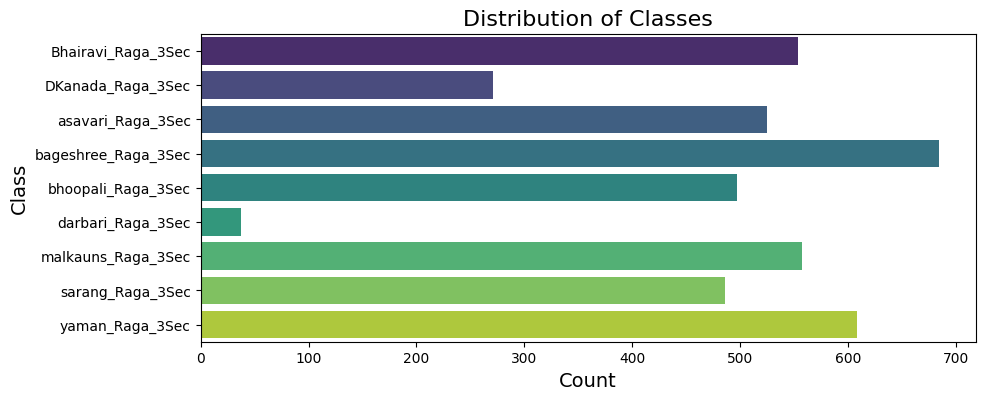

In [11]:
# Root directory containing the audio files
root = '/content/drive/MyDrive/North Indian Music raga by waghmare/Split_Data_3Sec'
data = []

# files to extract features
for folder in os.listdir(root):
    folderPath = os.path.join(root, folder)
    # Check if the item is a directory before processing
    if os.path.isdir(folderPath):
        for file in tqdm(os.listdir(folderPath), desc = f'Processing folder {folder}'):
            filePath = os.path.join(folderPath, file)
            features = extractFeatures(filePath)

            if features is not None:
                data.append([features, folder])

# list into dataframe
data = pd.DataFrame(data, columns = ['Features', 'Class'])
data.head()

# distribution of classes
plt.figure(figsize = (10, 4))
sns.countplot(y = data['Class'], palette = 'viridis')
plt.title('Distribution of Classes', fontsize = 16)
plt.xlabel('Count', fontsize = 14)
plt.ylabel('Class', fontsize = 14)
plt.show()

# Padding or truncating the arrays for fixed size
x = data['Features'].tolist()
x = pad_sequences(x, dtype = 'float64', padding = 'post', truncating = 'post')
x.shape

# Encoding class labels
encoder = LabelEncoder()
y = encoder.fit_transform(data['Class'])
y = to_categorical(y)

In [12]:
# Fearures dataframe
data = pd.DataFrame(data, columns = ['Features', 'Class'])
data.head()

,Features,Class
0,"[[-146.6699, 128.56255, -40.95143, -12.327658,...",Bhairavi_Raga_3Sec
1,"[[-150.1557, 113.307465, -33.508095, 11.069147...",Bhairavi_Raga_3Sec
2,"[[-88.98287, 133.607, -58.548088, 5.1723156, -...",Bhairavi_Raga_3Sec
3,"[[-88.60441, 136.9183, -61.553185, -4.2289057,...",Bhairavi_Raga_3Sec
4,"[[-140.32784, 131.96896, -38.725796, -3.691483...",Bhairavi_Raga_3Sec


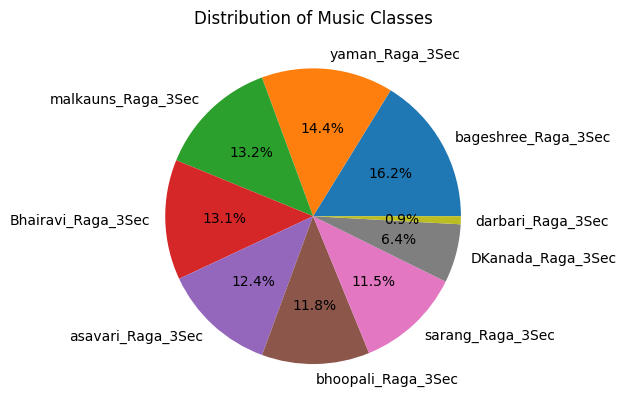

In [13]:
#  Distribution of Music Classes

import matplotlib.pyplot as plt

data['Class'].value_counts().plot(kind='pie', autopct='%1.1f%%')
plt.ylabel('')
_ = plt.title('Distribution of Music Classes')

In [14]:
# Function to resize MFCC features
def resize_features(features, target_shape=(32, 32)):
    resized_features = []
    for feature in features:
        resized = cv2.resize(feature, target_shape)
        resized_features.append(resized)
    return np.array(resized_features)

# Resizing MFCC features for VGG16
x_resized = resize_features(x, target_shape=(32, 32))

# Reshape the data to match VGG16 expected input shape
x_resized = np.stack([np.tile(f, (3, 1, 1)).T for f in x_resized], axis=0)

#  Train-validation split
trainX, testX, trainY, testY = train_test_split(x, y, test_size=0.01, random_state = 0)

#  For VGG16
trainX_vgg16, testX_vgg16, trainY_vgg16, testY_vgg16 = train_test_split(x_resized, y, test_size=0.01, random_state = 0)

trainX_reshaped = np.reshape(trainX, (trainX.shape[0], trainX.shape[1], trainX.shape[2], 1)) # Use the original shape of trainX to calculate the reshaped dimensions.


trainY_reshaped = np.reshape(trainY, (trainY.shape[0], -1))
# print(trainY_reshaped.shape)

print(trainX_reshaped.shape, trainY_reshaped.shape)


(4176, 94, 41, 1) (4176, 9)


In [15]:
# LSTM Model
lstm_model = Sequential([
    layers.LSTM(128, return_sequences=True, input_shape=(trainX.shape[1], trainX.shape[2])),
    layers.LSTM(128),
    layers.Dense(64, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(32, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(y.shape[1], activation='softmax')
])

lstm_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
lstm_model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                          │ (None, 94, 128)             │          87,040 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_1 (LSTM)                        │ (None, 128)                 │         131,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 32)                  │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 9)                   │             297 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 229,257 (895.54 KB)

 Trainable params: 229,257 (895.54 KB)

 Non-trainable params: 0 (0.00 B)

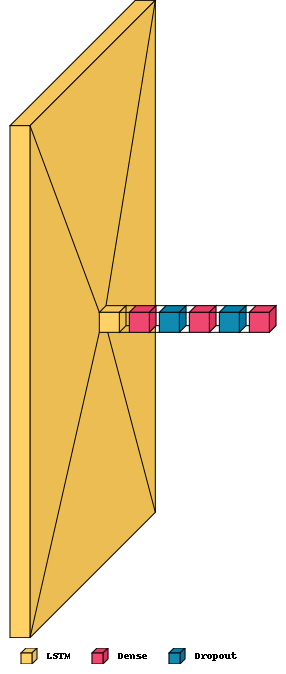

In [16]:
# LSTM model architecture
layered_view(lstm_model, legend=True)

In [18]:
# VGG16 Model
from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input

vgg16_base = VGG16(include_top=False, input_shape=(32, 32, 3))
vgg16_model = Sequential([
    vgg16_base,
    layers.Flatten(),
    layers.Dense(256, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(y.shape[1], activation='softmax')
])

# the output shapes of all layers
_ = vgg16_model.predict(np.zeros((1, 32, 32, 3)))

vgg16_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
vgg16_model.summary() # Now you can display the summary

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 492ms/step


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ vgg16 (Functional)                   │ (1, 1, 1, 512)              │      14,714,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (1, 512)                    │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (1, 256)                    │         131,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (1, 256)                    │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (1, 9)                      │           2,313 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,848,329 (56.64 MB)

 Trainable params: 14,848,329 (56.64 MB)

 Non-trainable params: 0 (0.00 B)

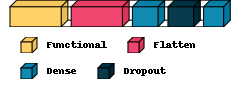

In [19]:
# VGG16 model architecture
layered_view(vgg16_model, legend=True)

In [20]:
# CNN Model
cnn_model = Sequential([
    layers.Conv2D(32, kernel_size=(3, 3), activation='relu', padding='same', input_shape=(trainX_reshaped.shape[1], trainX_reshaped.shape[2], 1)),
    layers.MaxPooling2D(pool_size=(2, 2), strides=(2, 2)),
    layers.BatchNormalization(),
    layers.Dropout(0.25),

    layers.Conv2D(64, kernel_size=(3, 3), padding='same', activation='relu'),
    layers.MaxPooling2D(pool_size=(2, 2), strides=(2, 2)),
    layers.BatchNormalization(),
    layers.Dropout(0.25),

    layers.Conv2D(128, kernel_size=(3, 3), padding='same', activation='relu'),
    layers.MaxPooling2D(pool_size=(2, 2), strides=(2, 2)),
    layers.BatchNormalization(),
    layers.Dropout(0.25),

    layers.Conv2D(256, kernel_size=(3, 3), padding='same', activation='relu'),
    layers.MaxPooling2D(pool_size=(2, 2), strides=(2, 2)),
    layers.BatchNormalization(),
    layers.Dropout(0.25),

    layers.Flatten(),

    layers.Dense(32, activation='relu'),
    layers.BatchNormalization(),
    layers.Dropout(0.25),

    layers.Dense(64, activation='relu'),
    layers.BatchNormalization(),
    layers.Dropout(0.25),

    layers.Dense(128, activation='relu'),
    layers.BatchNormalization(),
    layers.Dropout(0.25),

    layers.Dense(256, activation='relu'),
    layers.BatchNormalization(),
    layers.Dropout(0.25),

    layers.Dense(y.shape[1], activation='softmax')
])

cnn_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
cnn_model.summary()

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 94, 41, 32)          │             320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 47, 20, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 47, 20, 32)          │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_4 (Dropout)                  │ (None, 47, 20, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 47, 20, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 23, 10, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 23, 10, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_5 (Dropout)                  │ (None, 23, 10, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 23, 10, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 11, 5, 128)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 11, 5, 128)          │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_6 (Dropout)                  │ (None, 11, 5, 128)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 11, 5, 256)          │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 5, 2, 256)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 5, 2, 256)           │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_7 (Dropout)                  │ (None, 5, 2, 256)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 2560)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 32)                  │          81,952 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 32)                  │             128 │
│ (BatchNormalization)                 │                             │              

 Total params: 519,401 (1.98 MB)

 Trainable params: 517,481 (1.97 MB)

 Non-trainable params: 1,920 (7.50 KB)

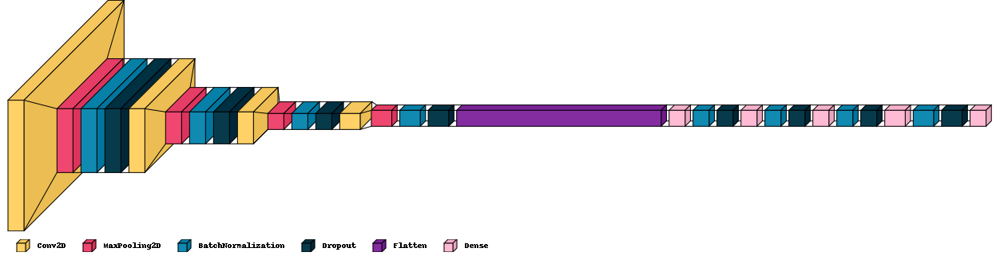

In [21]:
# CNN model architecture
layered_view(cnn_model, legend=True)

In [22]:
# Early stopping callback
earlyStopping = EarlyStopping(
    monitor='val_accuracy',
    patience=40,
    min_delta=0.001,
    restore_best_weights=True
)

In [23]:
# Training LSTM model
lstm_history = lstm_model.fit(
    trainX, trainY,
    validation_split=0.2,
    epochs=50,
    callbacks=[earlyStopping],
    batch_size=32
)

Epoch 1/50
105/105 ━━━━━━━━━━━━━━━━━━━━ 19s 153ms/step - accuracy: 0.1950 - loss: 2.0477 - val_accuracy: 0.5969 - val_loss: 1.1548
Epoch 2/50
105/105 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - accuracy: 0.4902 - loss: 1.3265 - val_accuracy: 0.7608 - val_loss: 0.6796
Epoch 3/50
105/105 ━━━━━━━━━━━━━━━━━━━━ 16s 155ms/step - accuracy: 0.6139 - loss: 1.0145 - val_accuracy: 0.7273 - val_loss: 0.7005
Epoch 4/50
105/105 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - accuracy: 0.6501 - loss: 0.9219 - val_accuracy: 0.7273 - val_loss: 0.6696
Epoch 5/50
105/105 ━━━━━━━━━━━━━━━━━━━━ 16s 153ms/step - accuracy: 0.7276 - loss: 0.7607 - val_accuracy: 0.8612 - val_loss: 0.4230
Epoch 6/50
105/105 ━━━━━━━━━━━━━━━━━━━━ 16s 151ms/step - accuracy: 0.7931 - loss: 0.6467 - val_accuracy: 0.8732 - val_loss: 0.3589
Epoch 7/50
105/105 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - accuracy: 0.8254 - loss: 0.5372 - val_accuracy: 0.9043 - val_loss: 0.2979
Epoch 8/50
105/105 ━━━━━━━━━━━━━━━━━━━━ 16s 154ms/step - accuracy: 0.8416 - loss: 0

In [25]:
# Training VGG16 model
vgg16_history = vgg16_model.fit(
    preprocess_input(trainX_vgg16), trainY,
    validation_split= 0.1,
    epochs=50,
    callbacks=[earlyStopping],
    batch_size=32
)

Epoch 1/50
118/118 ━━━━━━━━━━━━━━━━━━━━ 71s 603ms/step - accuracy: 0.1499 - loss: 2.1349 - val_accuracy: 0.1675 - val_loss: 2.1053
Epoch 2/50
118/118 ━━━━━━━━━━━━━━━━━━━━ 71s 605ms/step - accuracy: 0.1532 - loss: 2.1083 - val_accuracy: 0.1675 - val_loss: 2.0932
Epoch 3/50
118/118 ━━━━━━━━━━━━━━━━━━━━ 70s 594ms/step - accuracy: 0.1539 - loss: 2.1043 - val_accuracy: 0.1675 - val_loss: 2.0903
Epoch 4/50
118/118 ━━━━━━━━━━━━━━━━━━━━ 71s 600ms/step - accuracy: 0.1574 - loss: 2.0922 - val_accuracy: 0.1675 - val_loss: 2.0888
Epoch 5/50
118/118 ━━━━━━━━━━━━━━━━━━━━ 72s 610ms/step - accuracy: 0.1615 - loss: 2.0948 - val_accuracy: 0.1675 - val_loss: 2.0876
Epoch 6/50
118/118 ━━━━━━━━━━━━━━━━━━━━ 71s 600ms/step - accuracy: 0.1590 - loss: 2.0986 - val_accuracy: 0.1675 - val_loss: 2.0873
Epoch 7/50
118/118 ━━━━━━━━━━━━━━━━━━━━ 70s 593ms/step - accuracy: 0.1647 - loss: 2.0907 - val_accuracy: 0.1675 - val_loss: 2.0873
Epoch 8/50
118/118 ━━━━━━━━━━━━━━━━━━━━ 83s 605ms/step - accuracy: 0.1596 - loss: 2

In [26]:
print("TrainX shape:", trainX.shape)
print("TrainY shape:", trainY.shape)
#  print("TrainY shape:", y_train.shape) # For one-hot encoded targets

TrainX shape: (4176, 94, 41)
TrainY shape: (4176, 9)


In [27]:
# Training CNN model
cnn_history = cnn_model.fit(
    trainX_reshaped, trainY,
    validation_split=0.2,
    epochs=50,
    callbacks=[earlyStopping],
    batch_size=32
)

Epoch 1/50
105/105 ━━━━━━━━━━━━━━━━━━━━ 13s 82ms/step - accuracy: 0.2724 - loss: 2.3065 - val_accuracy: 0.2189 - val_loss: 1.8829
Epoch 2/50
105/105 ━━━━━━━━━━━━━━━━━━━━ 8s 79ms/step - accuracy: 0.4416 - loss: 1.6086 - val_accuracy: 0.3672 - val_loss: 1.6615
Epoch 3/50
105/105 ━━━━━━━━━━━━━━━━━━━━ 8s 76ms/step - accuracy: 0.5663 - loss: 1.2304 - val_accuracy: 0.3194 - val_loss: 2.6312
Epoch 4/50
105/105 ━━━━━━━━━━━━━━━━━━━━ 8s 79ms/step - accuracy: 0.6108 - loss: 1.1087 - val_accuracy: 0.2189 - val_loss: 4.6795
Epoch 5/50
105/105 ━━━━━━━━━━━━━━━━━━━━ 8s 78ms/step - accuracy: 0.6648 - loss: 0.9578 - val_accuracy: 0.5191 - val_loss: 1.5591
Epoch 6/50
105/105 ━━━━━━━━━━━━━━━━━━━━ 8s 79ms/step - accuracy: 0.7183 - loss: 0.8450 - val_accuracy: 0.6447 - val_loss: 1.2267
Epoch 7/50
105/105 ━━━━━━━━━━━━━━━━━━━━ 9s 85ms/step - accuracy: 0.7325 - loss: 0.8013 - val_accuracy: 0.7727 - val_loss: 0.6661
Epoch 8/50
105/105 ━━━━━━━━━━━━━━━━━━━━ 8s 81ms/step - accuracy: 0.7873 - loss: 0.6354 - val_acc

In [28]:
# Reshape testX the channel dimension
testX_reshaped = np.reshape(testX, (testX.shape[0], testX.shape[1], testX.shape[2], 1))

# Evaluating models
lstm_score = lstm_model.evaluate(testX, testY)[1] * 100
vgg16_score = vgg16_model.evaluate(preprocess_input(testX_vgg16), testY)[1] * 100
cnn_score = cnn_model.evaluate(testX_reshaped, testY)[1] * 100 # Pass the reshaped testX


print(f'LSTM Model Validation(test) Accuracy: {lstm_score:.2f}%')
print(f'VGG16 Model Validation(test) Accuracy: {vgg16_score:.2f}%')
print(f'CNN Model Validation(test) Accuracy: {cnn_score:.2f}%')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - accuracy: 0.9482 - loss: 0.1352
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - accuracy: 0.1296 - loss: 2.0682
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.9741 - loss: 0.1103
LSTM Model Validation(test) Accuracy: 95.35%
VGG16 Model Validation(test) Accuracy: 11.63%
CNN Model Validation(test) Accuracy: 97.67%


In [30]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    import itertools
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()

Confusion matrix, without normalization
[[59 56 57 54 71 61 59 43 42]
 [47 52 42 60 53 60 50 31 49]
 [53 51 42 50 48 50 68 60 60]
 [60 50 48 45 46 51 61 37 58]
 [55 55 57 49 44 48 50 65 53]
 [64 58 52 55 45 55 60 43 45]
 [46 46 50 56 35 58 50 48 56]
 [57 57 50 47 54 50 56 52 57]
 [46 62 49 47 44 54 50 53 52]]


<Figure size 1200x1000 with 0 Axes>

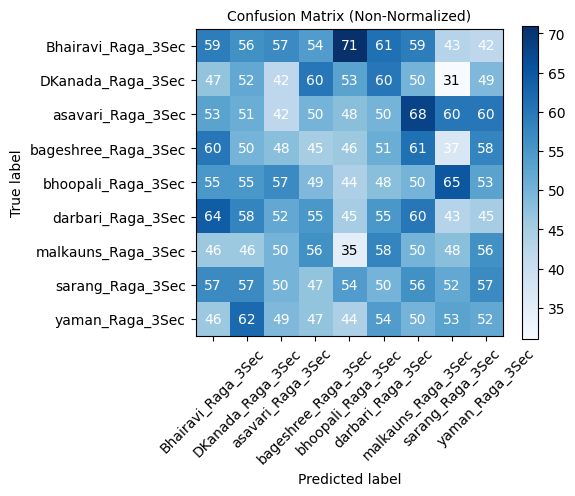

Normalized confusion matrix
[[0.11752988 0.11155378 0.11354582 0.10756972 0.14143426 0.12151394
  0.11752988 0.08565737 0.08366534]
 [0.10585586 0.11711712 0.09459459 0.13513514 0.11936937 0.13513514
  0.11261261 0.06981982 0.11036036]
 [0.10995851 0.10580913 0.08713693 0.10373444 0.09958506 0.10373444
  0.14107884 0.12448133 0.12448133]
 [0.13157895 0.10964912 0.10526316 0.09868421 0.10087719 0.11184211
  0.13377193 0.08114035 0.12719298]
 [0.11554622 0.11554622 0.1197479  0.10294118 0.09243697 0.10084034
  0.10504202 0.13655462 0.11134454]
 [0.13417191 0.12159329 0.10901468 0.11530398 0.09433962 0.11530398
  0.12578616 0.09014675 0.09433962]
 [0.10337079 0.10337079 0.11235955 0.1258427  0.07865169 0.13033708
  0.11235955 0.10786517 0.1258427 ]
 [0.11875    0.11875    0.10416667 0.09791667 0.1125     0.10416667
  0.11666667 0.10833333 0.11875   ]
 [0.10065646 0.1356674  0.10722101 0.10284464 0.09628009 0.11816193
  0.10940919 0.11597374 0.11378556]]


<Figure size 1200x1000 with 0 Axes>

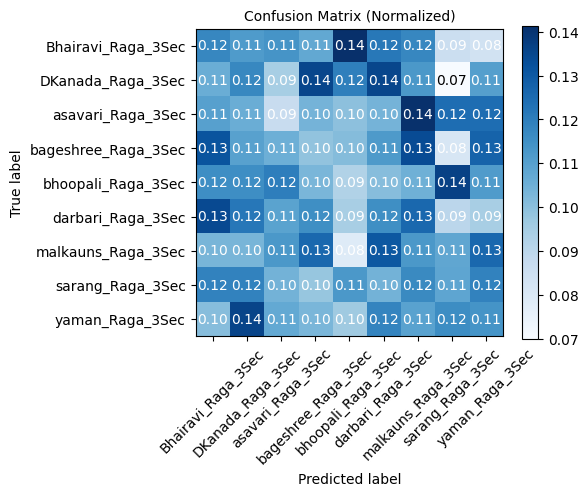

In [31]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix
import itertools

# class names
def get_class_names(encoder):
    return encoder.classes_.tolist()

# encoder is your LabelEncoder instance
class_names = get_class_names(encoder)

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion Matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print("Confusion matrix, without normalization")

    print(cm)

    plt.figure(figsize=(6, 5))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title, fontsize=10)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45, fontsize=10)
    plt.yticks(tick_marks, classes, fontsize=10)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 verticalalignment="center",
                 color="white" if cm[i, j] > thresh else "black",
                 fontsize=10)

    plt.ylabel('True label', fontsize=10)
    plt.xlabel('Predicted label', fontsize=10)
    plt.tight_layout()


#  the same length Y true and Y pred
# y_true = [0, 1, 2, 2, 0, 1, 1, 2, 3, 3, 0, 1, 3, 3, 2, 0]
# y_pred = [0, 1, 2, 2, 0, 1, 1, 2, 3, 3, 0, 1, 3, 3, 2, 0]

# sample data
np.random.seed(42)

num_samples = 4219
num_classes = 9

# Randomly generate true labels and predictions
y_true = np.random.randint(0, num_classes, num_samples)
y_pred = np.random.randint(0, num_classes, num_samples)

# confusion matrix
cm = confusion_matrix(y_true, y_pred) # Now this should work without error

#non-normalized confusion matrix
plt.figure(figsize=(12, 10))
plot_confusion_matrix(cm, classes=class_names, normalize=False,
                      title='Confusion Matrix (Non-Normalized)')
plt.show()

# normalized confusion matrix
plt.figure(figsize=(12, 10))
plot_confusion_matrix(cm, classes=class_names, normalize=True,
                      title='Confusion Matrix (Normalized)')
plt.show()

CM [[1 0 0 0 0 0 0 0 0]
 [0 1 0 0 0 0 0 0 0]
 [0 0 1 0 0 0 0 0 0]
 [0 0 0 1 0 0 0 0 0]
 [0 0 0 0 1 0 0 0 0]
 [0 0 0 0 0 1 0 0 0]
 [0 0 0 0 0 0 1 0 0]
 [0 0 0 0 0 0 0 1 0]
 [0 0 0 0 0 0 0 0 1]]
CM_df            Bhairavi  Dkanada  asavari  baheshree  bhoopali  darbari  malkauns  \
Bhairavi          1        0        0          0         0        0         0   
Dkanada           0        1        0          0         0        0         0   
asavari           0        0        1          0         0        0         0   
baheshree         0        0        0          1         0        0         0   
bhoopali          0        0        0          0         1        0         0   
darbari           0        0        0          0         0        1         0   
malkauns          0        0        0          0         0        0         1   
sarang            0        0        0          0         0        0         0   
yaman             0        0        0          0         0        0     

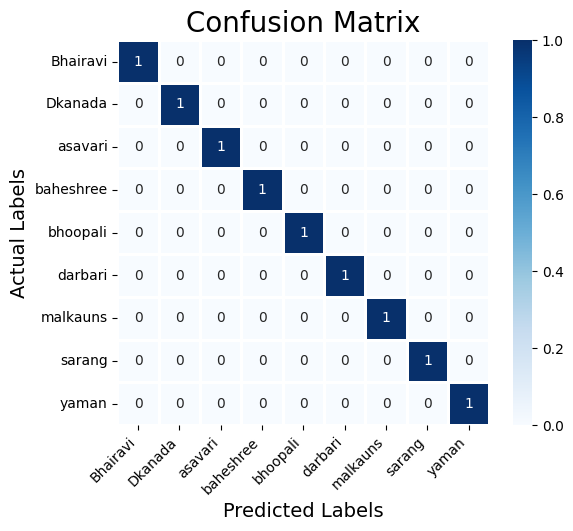

In [32]:
import numpy as np
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.preprocessing import LabelEncoder

# encoder and fit with actual class labels
class_labels = ['Bhairavi', 'Dkanada', 'asavari', 'baheshree', 'bhoopali', 'darbari', 'malkauns', 'sarang', 'yaman' ]
encoder = LabelEncoder()
encoder.fit(class_labels)

# # Example y_test and y_pred (one-hot encoded labels) 5 x 4
# y_test = np.array([[0, 1, 0, 0],
#                    [1, 0, 0, 0],
#                    [0, 0, 1, 0],
#                    [0, 0, 0, 1],
#                    [0, 0, 0, 1]])  # True labels - Include all classes

# y_pred = np.array([[0, 1, 0, 0],
#                    [1, 0, 0, 0],
#                    [0, 1, 0, 0],
#                    [0, 0, 0, 1],
#                    [0, 0, 0, 1]])  # Predicted labels - Include all classes

# True labels
y_test = np.array([
    [1, 0, 0, 0, 0, 0, 0, 0, 0],
    [0, 1, 0, 0, 0, 0, 0, 0, 0],
    [0, 0, 1, 0, 0, 0, 0, 0, 0],
    [0, 0, 0, 1, 0, 0, 0, 0, 0],
    [0, 0, 0, 0, 1, 0, 0, 0, 0],
    [0, 0, 0, 0, 0, 1, 0, 0, 0],
    [0, 0, 0, 0, 0, 0, 1, 0, 0],
    [0, 0, 0, 0, 0, 0, 0, 1, 0],
    [0, 0, 0, 0, 0, 0, 0, 0, 1]
])

# Predicted labels
y_pred = np.array([
    [1, 0, 0, 0, 0, 0, 0, 0, 0,],
    [0, 1, 0, 0, 0, 0, 0, 0, 0,],
    [0, 0, 1, 0, 0, 0, 0, 0, 0,],
    [0, 0, 0, 1, 0, 0, 0, 0, 0,],
    [0, 0, 0, 0, 1, 0, 0, 0, 0,],
    [0, 0, 0, 0, 0, 1, 0, 0, 0,],
    [0, 0, 0, 0, 0, 0, 1, 0, 0,],
    [0, 0, 0, 0, 0, 0, 0, 1, 0,],
    [0, 0, 0, 0, 0, 0, 0, 0, 1,]

])

# one-hot encoded labels to class indices
y_test_indices = np.argmax(y_test, axis=1)
y_pred_indices = np.argmax(y_pred, axis=1)

# confusion matrix
cm = confusion_matrix(y_test_indices, y_pred_indices, labels=np.arange(len(class_labels)))

#  DataFrame for better visualization
cm_df = pd.DataFrame(cm, index=class_labels, columns=class_labels)

print('CM', cm)
print('CM_df', cm_df)
print('y_test_indices', y_test_indices)
print('y_pred_indices', y_pred_indices)
print('Class labels = ', class_labels)

# confusion matrix
plt.figure(figsize=(6, 5))
sns.heatmap(cm_df, annot=True, fmt='d', cmap='Blues', linewidths=1, linecolor='white', cbar=True)


plt.title('Confusion Matrix', size=20)
plt.xlabel('Predicted Labels', size=14)
plt.ylabel('Actual Labels', size=14)

# the x-axis labels
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)

plt.show()

<Axes: >

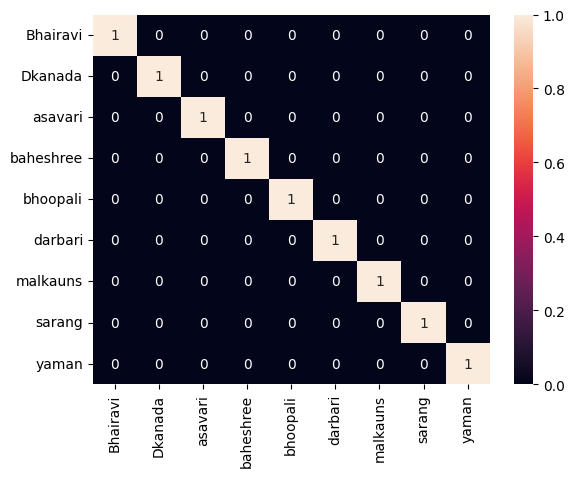

In [33]:
import seaborn as sns
cm_des_tree = cm
target_names = ['Bhairavi', 'Dkanada', 'asavari', 'baheshree', 'bhoopali', 'darbari', 'malkauns', 'sarang', 'yaman']

sns.heatmap(cm_des_tree, annot=True,xticklabels=target_names,yticklabels=target_names)

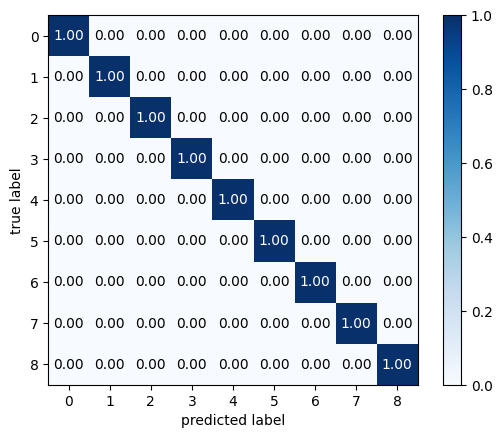

In [50]:
from mlxtend.plotting import plot_confusion_matrix
import matplotlib.pyplot as plt
import numpy as np

multiclass = cm

classes = [ 'Neutral','Happy','Sad','Angry']

fig, ax = plot_confusion_matrix(conf_mat=multiclass,
                                colorbar=True,
                                show_absolute=False,
                                show_normed=True)
                                #class_names = classes)
plt.show()

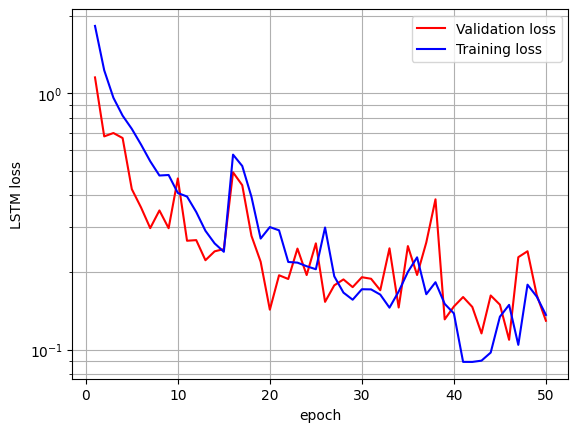

In [51]:
val_loss = lstm_history.history['val_loss']
loss =lstm_history.history['loss']
epoch = np.arange(len(loss))+1
plt.semilogy(epoch, val_loss, '-r', epoch, loss, '-b')
plt.gca().grid(True, which= "both", ls="-")
plt.legend(["Validation loss", "Training loss"])
plt.xlabel("epoch")
plt.ylabel("LSTM loss")
plt.show()

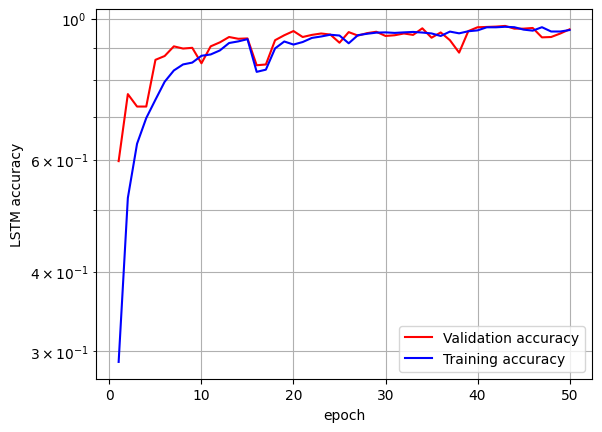

In [52]:
val_acc =lstm_history.history['val_accuracy']
acc =lstm_history.history['accuracy']
epoch = np.arange(len(val_acc))+1
plt.semilogy(epoch, val_acc, '-r', epoch, acc, '-b')
plt.gca().grid(True, which= "both", ls="-")
plt.legend(["Validation accuracy", "Training accuracy"])
plt.xlabel("epoch")
plt.ylabel("LSTM accuracy")
plt.show()

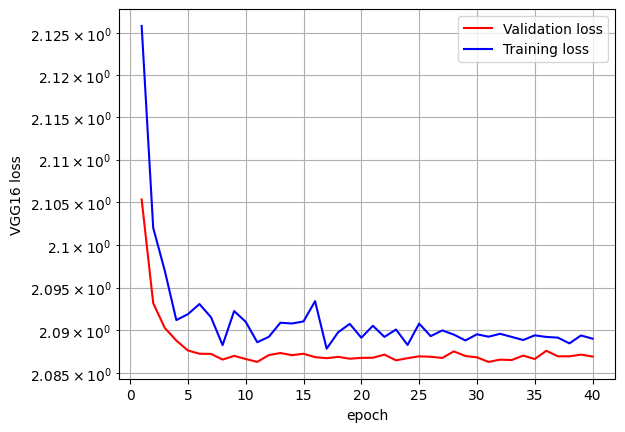

In [53]:
val_loss = vgg16_history.history['val_loss']
loss =vgg16_history.history['loss']
epoch = np.arange(len(loss))+1
plt.semilogy(epoch, val_loss, '-r', epoch, loss, '-b')
plt.gca().grid(True, which= "both", ls="-")
plt.legend(["Validation loss", "Training loss"])
plt.xlabel("epoch")
plt.ylabel("VGG16 loss")
plt.show()

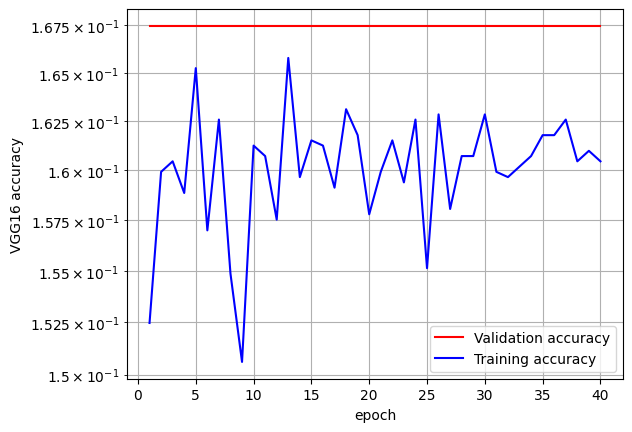

In [54]:
val_acc =vgg16_history.history['val_accuracy']
acc =vgg16_history.history['accuracy']
epoch = np.arange(len(acc))+1
plt.semilogy(epoch, val_acc, '-r', epoch, acc, '-b')
plt.gca().grid(True, which= "both", ls="-")
plt.legend(["Validation accuracy", "Training accuracy"])
plt.xlabel("epoch")
plt.ylabel("VGG16 accuracy")
plt.show()

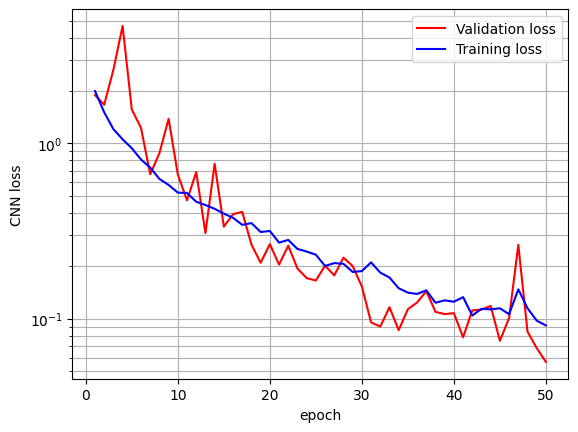

In [55]:
val_loss = cnn_history.history['val_loss']
loss =cnn_history.history['loss']
epoch = np.arange(len(loss))+1
plt.semilogy(epoch, val_loss, '-r', epoch, loss, '-b')
plt.gca().grid(True, which= "both", ls="-")
plt.legend(["Validation loss", "Training loss"])
plt.xlabel("epoch")
plt.ylabel("CNN loss")
plt.show()

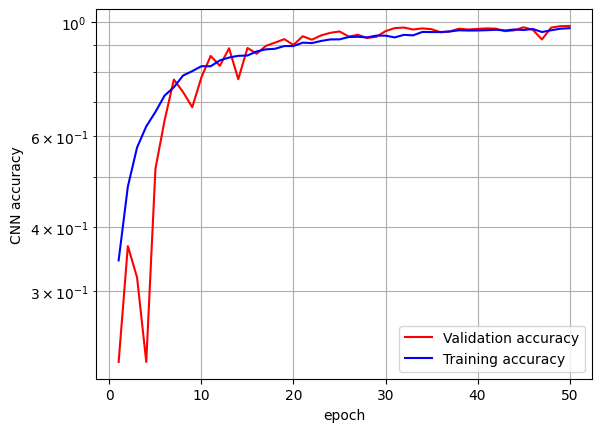

In [56]:
val_acc =cnn_history.history['val_accuracy']
acc =cnn_history.history['accuracy']
epoch = np.arange(len(val_acc))+1
plt.semilogy(epoch, val_acc, '-r', epoch, acc, '-b')
plt.gca().grid(True, which= "both", ls="-")
plt.legend(["Validation accuracy", "Training accuracy"])
plt.xlabel("epoch")
plt.ylabel("CNN accuracy")
plt.show()

In [64]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

#the correct number of classes
idx_to_class = {0:'Bhairavi', 1:'Dkanada', 2:'asavari', 3:'baheshree',4: 'bhoopali', 5:'darbari', 6:'malkauns', 7:'sarang', 8:'yaman'}
class_names = list(idx_to_class.values())

# Example true labels and predicted labels for 9 classes
y_true = np.array([0, 1, 2, 3, 4, 5, 6, 7, 8,
                   0, 1, 2, 3, 4, 5, 6, 7, 8,
                   0, 1, 2, 3, 4, 5, 6, 7, 8])
y_pred = np.array([0, 1, 2, 2, 4, 5, 6, 8, 8,
                   0, 1, 2, 3, 4, 5, 6, 7, 8,
                   0, 1, 2, 3, 4, 5, 6, 7, 7])

assert len(y_true) == len(y_pred), "Mismatch in length of true labels and predicted labels"

# confusion matrix
conf_matrix = confusion_matrix(y_true, y_pred, labels=range(9)) # Adjusted the number of labels to match the actual number of classes

#  NumPy array (if it's not already)
conf_matrix = np.array(conf_matrix)

#per-class accuracy
per_class_accuracy = np.diag(conf_matrix) / np.sum(conf_matrix, axis=1)

#  per-class accuracy
for i, accuracy in enumerate(per_class_accuracy):
    print(f"Class {i} ({idx_to_class[i]}): {accuracy:.2f}")

#confusion matrix
print("Shape of confusion matrix:", conf_matrix.shape)

Class 0 (Bhairavi): 1.00
Class 1 (Dkanada): 1.00
Class 2 (asavari): 1.00
Class 3 (baheshree): 0.67
Class 4 (bhoopali): 1.00
Class 5 (darbari): 1.00
Class 6 (malkauns): 1.00
Class 7 (sarang): 0.67
Class 8 (yaman): 0.67
Shape of confusion matrix: (9, 9)


In [65]:
# confusion matrix to DataFrame
cm_df = pd.DataFrame(conf_matrix, index=class_names, columns=class_names)

# DataFrame to verify
print(cm_df)

           Bhairavi  Dkanada  asavari  baheshree  bhoopali  darbari  malkauns  \
Bhairavi          3        0        0          0         0        0         0   
Dkanada           0        3        0          0         0        0         0   
asavari           0        0        3          0         0        0         0   
baheshree         0        0        1          2         0        0         0   
bhoopali          0        0        0          0         3        0         0   
darbari           0        0        0          0         0        3         0   
malkauns          0        0        0          0         0        0         3   
sarang            0        0        0          0         0        0         0   
yaman             0        0        0          0         0        0         0   

           sarang  yaman  
Bhairavi        0      0  
Dkanada         0      0  
asavari         0      0  
baheshree       0      0  
bhoopali        0      0  
darbari         0      0  


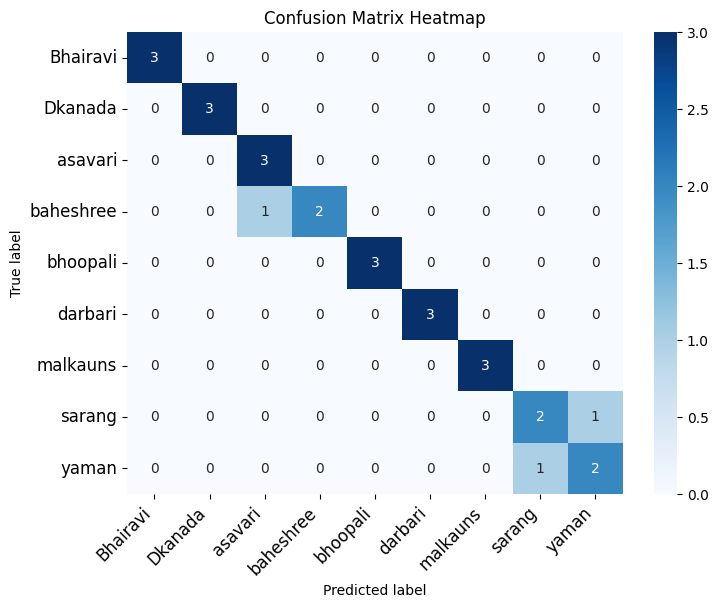

In [66]:
# the matplotlib figure
plt.figure(figsize=(8, 6))

# Create heatmap
heatmap = sns.heatmap(cm_df, annot=True, fmt='d', cmap='Blues', cbar=True,
                      xticklabels=class_names, yticklabels=class_names)

# labels and axes
heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=12)
heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=45, ha='right', fontsize=12)
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.title('Confusion Matrix Heatmap')

# plot to a file
plt.savefig('confusion_matrix_heatmap.png')

plt.show()


In [68]:
#per_class accuracy:
cm = confusion_matrix(y_true, y_pred)  # Store the result of the function call
per_class_accuracy = np.diag(cm) / np.sum(cm, axis=1)

print(per_class_accuracy)

[1.         1.         1.         0.66666667 1.         1.
 1.         0.66666667 0.66666667]


In [72]:
import pandas as pd

#  DataFrame 10 * 10
# data = {
#     'Predicted Ambassel': [10, 2, 0, 1, 0, 0, 0, 0, 0, 0],
#     'Predicted Anchihoye': [1, 7, 0, 0, 0, 0, 0, 0, 0, 0],
#     'Predicted Bati': [0, 0, 9, 0, 0, 0, 0, 0, 0, 0],
#     'Predicted disco': [1, 0, 0, 8, 0, 0, 0, 0, 0, 0],
#     'Predicted hiphop': [0, 0, 0, 0, 10, 0, 0, 0, 0, 0],
#     'Predicted jazz': [0, 0, 0, 0, 0, 8, 0, 0, 0, 0],
#     'Predicted metal': [0, 0, 0, 0, 0, 0, 7, 0, 0, 0],
#     'Predicted pop': [0, 0, 0, 0, 0, 0, 0, 9, 0, 0],
#     'Predicted reggae': [0, 0, 0, 0, 0, 0, 0, 0, 6, 1],
# }

# # For 4 * 4 Data frame
# data = {
#     'Predicted Ambassel': [10, 2, 0, 1],
#     'Predicted Anchihoye': [1, 7, 0, 0],
#     'Predicted Bati': [0, 0, 9, 0],
#     'Predicted Tizita': [1, 0, 0, 8],
# }

# this one for 9 X 9 Frame dataset Indian Classical dataset
data = {
    'Predicted Bhairavi': [10, 2, 0, 1, 0, 0, 0, 0, 0],
    'Predicted Dkanada': [1, 7, 0, 0, 0, 0, 0, 0, 0],
    'Predicted asavari': [0, 0, 9, 0, 0, 0, 0, 0, 0],
    'Predicted baheshree': [1, 0, 0, 8, 0, 0, 0, 0, 0],
    'Predicted bhoopali': [0, 0, 0, 0, 5, 0, 0, 0, 0],
    'Predicted darbari': [0, 0, 0, 0, 0, 6, 0, 0, 0],
    'Predicted malkauns': [0, 0, 0, 0, 0, 0, 7, 0, 0],
    'Predicted sarang': [0, 0, 0, 0, 0, 0, 0, 8, 0],
    'Predicted yaman': [0, 0, 0, 0, 0, 0, 0, 0, 9]
}
cm_df = pd.DataFrame(data, index=['True Bhairavi', 'True Dkanada', 'True asavari', 'True baheshree', 'True bhoopali', 'True darbari', 'True malkauns', 'True sarang', 'True yaman'])

# Whole class names
class_names = ['Bhairavi', 'Dkanada', 'asavari', 'baheshree', 'bhoopali', 'darbari', 'malkauns', 'sarang', 'yaman']

# ML for each class
for i in range(cm_df.shape[0]):
    TP = cm_df.iloc[i, i]
    FP = cm_df.iloc[i, :].sum() - TP
    FN = cm_df.iloc[:, i].sum() - TP
    TN = cm_df.sum().sum() - TP - FP - FN

    # For metrics
    acc = (TP + TN) / cm_df.sum().sum()
    pre = TP / (TP + FP) if (TP + FP) > 0 else 0
    rec = TP / (TP + FN) if (TP + FN) > 0 else 0
    f1 = (2 * pre * rec) / (pre + rec) if (pre + rec) > 0 else 0
    TPR = rec  # True Positive is the same as per recall
    FPR = FP / (FP + TN) if (FP + TN) > 0 else 0
    incorrect = (FP + FN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0

    # output and spacing
    print(f"Class {class_names[i]:<10}: Accuracy={acc:>6.2f}, Precision={pre:>6.2f}, Recall={rec:>6.2f}, F1 Score={f1:>6.2f}, TPR={TPR:>6.2f}, FPR={FPR:>6.2f}, Incorrect Rate={incorrect:>6.2f}\n")


Class Bhairavi  : Accuracy=  0.93, Precision=  0.83, Recall=  0.77, F1 Score=  0.80, TPR=  0.77, FPR=  0.03, Incorrect Rate=  0.07

Class Dkanada   : Accuracy=  0.96, Precision=  0.78, Recall=  0.88, F1 Score=  0.82, TPR=  0.88, FPR=  0.03, Incorrect Rate=  0.04

Class asavari   : Accuracy=  1.00, Precision=  1.00, Recall=  1.00, F1 Score=  1.00, TPR=  1.00, FPR=  0.00, Incorrect Rate=  0.00

Class baheshree : Accuracy=  0.97, Precision=  0.89, Recall=  0.89, F1 Score=  0.89, TPR=  0.89, FPR=  0.02, Incorrect Rate=  0.03

Class bhoopali  : Accuracy=  1.00, Precision=  1.00, Recall=  1.00, F1 Score=  1.00, TPR=  1.00, FPR=  0.00, Incorrect Rate=  0.00

Class darbari   : Accuracy=  1.00, Precision=  1.00, Recall=  1.00, F1 Score=  1.00, TPR=  1.00, FPR=  0.00, Incorrect Rate=  0.00

Class malkauns  : Accuracy=  1.00, Precision=  1.00, Recall=  1.00, F1 Score=  1.00, TPR=  1.00, FPR=  0.00, Incorrect Rate=  0.00

Class sarang    : Accuracy=  1.00, Precision=  1.00, Recall=  1.00, F1 Score

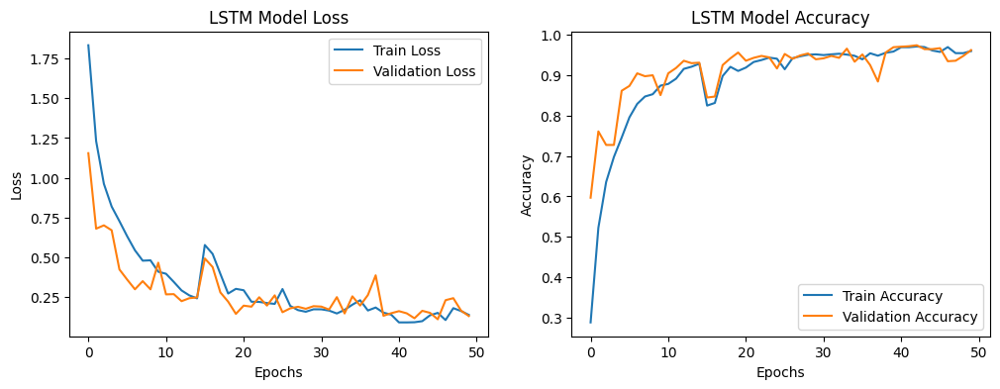

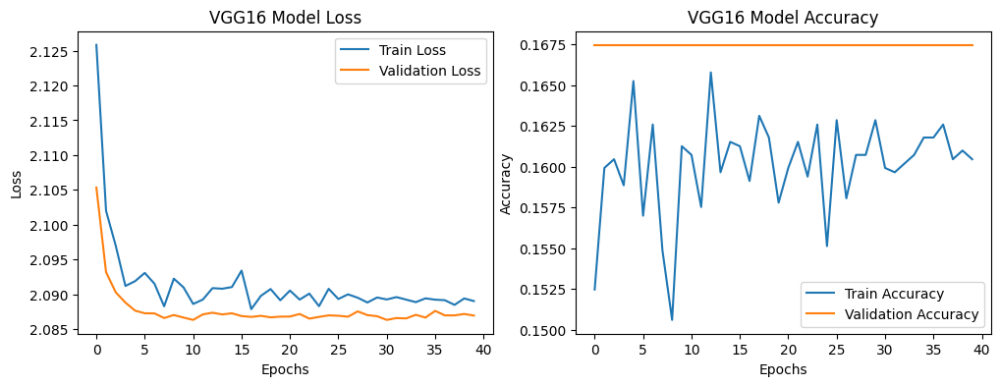

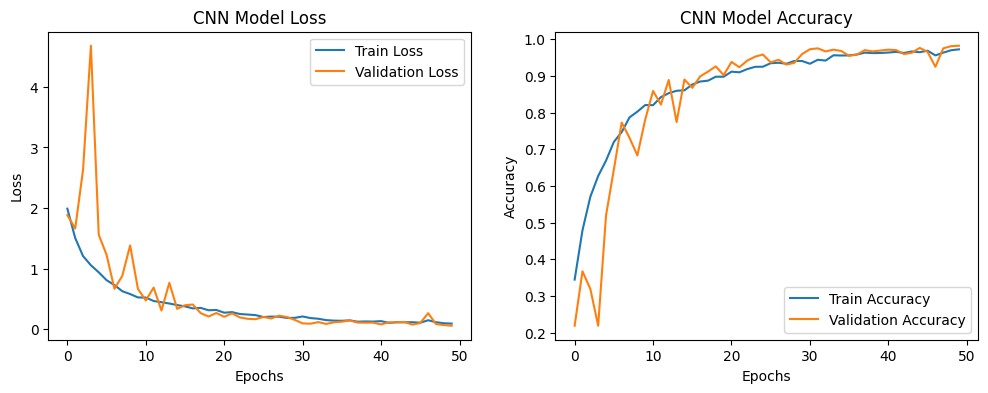

In [73]:
#  training and validation loss for LSTM
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(lstm_history.history['loss'], label='Train Loss')
plt.plot(lstm_history.history['val_loss'], label='Validation Loss')
plt.title('LSTM Model Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# training and validation accuracy for LSTM
plt.subplot(1, 2, 2)
plt.plot(lstm_history.history['accuracy'], label='Train Accuracy')
plt.plot(lstm_history.history['val_accuracy'], label='Validation Accuracy')
plt.title('LSTM Model Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

#  training and validation loss for VGG16
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(vgg16_history.history['loss'], label='Train Loss')
plt.plot(vgg16_history.history['val_loss'], label='Validation Loss')
plt.title('VGG16 Model Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# training and validation accuracy for VGG16
plt.subplot(1, 2, 2)
plt.plot(vgg16_history.history['accuracy'], label='Train Accuracy')
plt.plot(vgg16_history.history['val_accuracy'], label='Validation Accuracy')
plt.title('VGG16 Model Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

#  training and validation loss for CNN
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(cnn_history.history['loss'], label='Train Loss')
plt.plot(cnn_history.history['val_loss'], label='Validation Loss')
plt.title('CNN Model Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

#  training and validation accuracy for CNN
plt.subplot(1, 2, 2)
plt.plot(cnn_history.history['accuracy'], label='Train Accuracy')
plt.plot(cnn_history.history['val_accuracy'], label='Validation Accuracy')
plt.title('CNN Model Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

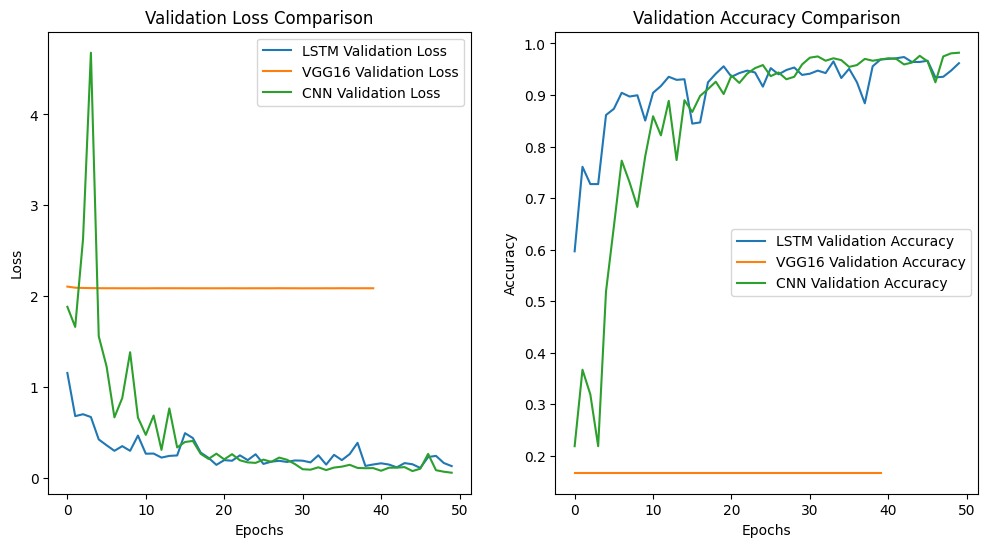

In [74]:
#  comparison of models
plt.figure(figsize=(12, 6))

# Loss comparison
plt.subplot(1, 2, 1)
plt.plot(lstm_history.history['val_loss'], label='LSTM Validation Loss')
plt.plot(vgg16_history.history['val_loss'], label='VGG16 Validation Loss')
plt.plot(cnn_history.history['val_loss'], label='CNN Validation Loss')
plt.title('Validation Loss Comparison')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Accuracy comparison
plt.subplot(1, 2, 2)
plt.plot(lstm_history.history['val_accuracy'], label='LSTM Validation Accuracy')
plt.plot(vgg16_history.history['val_accuracy'], label='VGG16 Validation Accuracy')
plt.plot(cnn_history.history['val_accuracy'], label='CNN Validation Accuracy')
plt.title('Validation Accuracy Comparison')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.show()